In [7]:
import numpy as np
import jax
import jax.numpy as jnp
from jax import grad, jit, vmap, value_and_grad
from jax import random
from jax import lax
import math
import sys
from random import randint
import itertools
from jax import jacfwd, jacrev
from subprocess import call
import matplotlib.pyplot as plt


# Generate key which is used to generate random numbers
key = random.PRNGKey(0)
key2 = jax.random.PRNGKey(2)
from jax.example_libraries import stax
from jax.example_libraries.stax import (BatchNorm, Conv, Dense, Flatten, 
                                   MaxPool, Relu, LogSoftmax)

from jax.scipy.special import logsumexp
from jax.example_libraries import optimizers
from jax.nn import (relu, log_softmax, softmax, softplus, sigmoid, elu,
                    leaky_relu, selu, gelu)
from jax.nn.initializers import glorot_normal, normal, ones, zeros

In [8]:
#Setup of NN a layer
def Dense1(out_dim, W_init=glorot_normal(), b_init=normal()):
    def init_fun(rng, input_shape):
        output_shape = input_shape[:-1] + (out_dim,)
        k1, k2 = random.split(rng)
        W, b = W_init(k1, (input_shape[-1], out_dim))+W_init(k2, (input_shape[-1], out_dim))*1j, b_init(k2, (out_dim,))+b_init(k1, (out_dim,))*1j
        return output_shape, (W, b)
    def apply_fun(params, inputs, **kwargs):
        W, b = params
        return jnp.dot(inputs, W) + b
    return init_fun, apply_fun

#ReLU activation function for real and imaginary parts separately
def comprelu(x):
    a=jnp.real(x)
    b=jnp.imag(x)
    a=relu(a)
    b=relu(b)
    return a+b*1j

def elementwise(fun, **fun_kwargs):
    init_fun = lambda rng, input_shape: (input_shape, ())
    apply_fun = lambda params, inputs, **kwargs: fun(inputs, **fun_kwargs)
    return init_fun, apply_fun

compRelu=elementwise(comprelu)

In [9]:
#Random Input generation from fundamental domain
def ComplexInput(lamb):
    mean1=0
    sd1=0.25
    y=np.random.exponential(lamb,size=(1))
    x=np.random.normal(mean1, sd1, size=(1))
    while x**2 + y**2<1 or y<0 or x<-0.5 or x>0.5:
        x=np.random.normal(mean1, sd1, size=(1))
        y=np.random.exponential(lamb,size=(1))
    return x+y*1j

#percentage difference between j(z) and j(z'), where z and z' are related by Sl(2,Z)
def percentageloss(x,y):
    return 100*(jnp.abs(x)-jnp.abs(y))/jnp.abs(y)


#Loss to impose normalizatin condition
def init_loss(params,batch):
    inputs, targs,m = batch
    predictions=net_apply(params, inputs)
    diff12=(jnp.abs(predictions[0]))**2 + (jnp.abs(predictions[1]-1+0*1j))**2
    return diff12[0]


#Loss to impose SL(2,z) invariance
def loss(params, batch):
    inputs, targs,m = batch
    predictions = net_apply(params, inputs)
    targets=net_apply(params, targs)
    diff=predictions - targets
    return jnp.sum((jnp.abs(diff)**2))


#Loss to impose holomorphy
def holo_loss(params, batch):
    inputs, targs,m = batch
    f1 = lambda inputs: net_apply(params,inputs)
    f2=lambda targs: net_apply(params, targs)
    i1=jax.jvp(f1, (inputs,), (np.ones(inputs.shape)+0*1j,))[1]
    i2=jax.jvp(f1, (inputs,), (0-np.ones(inputs.shape)*1j,))[1]
    o1=jax.jvp(f2, (targs,), (np.ones(targs.shape)+0*1j,))[1]
    o2=jax.jvp(f2, (targs,), (0-np.ones(targs.shape)*1j,))[1]
    loss1=i1-i2*1j
    loss2=o1-o2*1j
    return jnp.sum((jnp.abs(loss1))**2)+jnp.sum((jnp.abs(loss2))**2)


#total loss
def total_loss(params,batch):
    c=loss(params,batch)+holo_loss(params,batch)+init_loss(params,batch)
    print(c)
    return c


def randomat(x,interval):
    low=-interval
    high=interval
    y=[[0 ,0  ],[0  , 0 ]]
    y[0][0]=randint(low,high)
    y[0][1]=randint(low,high)
    y[1][0]=randint(low,high)
    y[1][1]=randint(low,high)
    return (y[0][0]*x + y[0][1]),y

#tranfroming an input by an SL(2,z) transformation
def trans(x,interval):
    low=-interval
    high=interval
    y=[[0 ,0  ],[0  , 0 ]]
    while y[0][0]*y[1][1]-y[0][1]*y[1][0]!=1:
        y[0][0]=randint(low,high)
        y[0][1]=randint(low,high)
        y[1][0]=randint(low,high)
        y[1][1]=randint(low,high)
    return (y[0][0]*x + y[0][1])/(y[1][0]*x + y[1][1]),y

#Some check functions (not important)
def trans2(y,x):
    return (y[0][0]*x + y[0][1])/(y[1][0]*x + y[1][1])


def sl2check(batch_size,mats):
    in3=np.zeros((batch_size,1))+0*1j
    sl2=np.zeros((batch_size,1))+0*1j
    for i in range (batch_size):
        in3[i][0]=ComplexInput()
    for i in range (batch_size):
        sl2[i][0]=trans2(mats[i],in3[i][0])
    return in3, sl2

#generating a batch inputs and their sl(2,z) counterparts
def gen(batch_size,n,lamb):
    inputs=np.zeros((batch_size,1))+0*1j
    sl2ztr=np.zeros((batch_size,1))+0*1j
    mats=[]
    inputs[0][0]=jnp.exp(1j*2*math.pi/3)
    inputs[1][0]=1j
    for i in range (2,batch_size):
        inputs[i][0]=ComplexInput(lamb)
    for i in range (batch_size):
        sl2ztr[i][0],c=trans(inputs[i][0],n)
        mats.append(c)  
    return (inputs,sl2ztr,mats)


def sl2check2(batch_size,n):
    in3=np.zeros((batch_size,1))+0*1j
    sl2=np.zeros((batch_size,1))+0*1j
    for i in range (batch_size):
        in3[i][0]=ComplexInput()
    for i in range (batch_size):
        sl2[i][0]=trans(in3[i][0],n)
    return in3, sl2


#Parameters update
def step(i, opt_state, batch):
    params1 = get_params(opt_state)
    losss=total_loss(params1,batch)
    g = grad(total_loss)(params1, batch)
    return opt_update(i, g, opt_state),losss



In [10]:
num_epochs = 100000
stepsize=1e-4
batch_size=50
n=10
steps=1

In [11]:
#Training function
def NN(batch_size,num_epochs,n,params,lo):
    opt_state = opt_init(params)
    losss=10
    arr=[10,100,1000,10000]
    for j in range(steps):
        data_generator = ( gen(batch_size,n,arr[randint(0,3)]) for _ in range(num_epochs))
        itercount = itertools.count()
        while losss>lo:
            c=next(data_generator)
            opt_state,losss= step(next(itercount), opt_state, c)
            inputs,sl2ztr,m=c
            x1=net_apply(get_params(opt_state), sl2ztr)
            y1=net_apply(get_params(opt_state), inputs)
            y=percentageloss(x1,y1)
            x=np.arange(len(y))
            plt.scatter(x, y)
            plt.show()
    net_params = get_params(opt_state)
    return net_params,data_generator

#Slight variations but not implemented in the code yet
def NNmat(batch_size,num_epochs,n,params,mats,lo):
    opt_state = opt_init(params)
    losss=10
    for j in range(steps):
        inputs=np.zeros((batch_size,1))+0*1j
        sl2ztr=np.zeros((batch_size,1))+0*1j
        inputs[0][0]=jnp.exp(1j*2*math.pi/3)
        inputs[1][0]=1j
        for i in range (2,batch_size):
            inputs[i][0]=ComplexInput()
        for i in range (batch_size):
            sl2ztr[i][0]=trans2(mats[i],inputs[i][0])
        print(inputs)
        print(sl2ztr)
        data_generator = ((inputs, sl2ztr) for _ in range(num_epochs))
        itercount = itertools.count()
        while losss>lo:
            opt_state,losss= step(next(itercount), opt_state, next(data_generator))
    net_params = get_params(opt_state)
    x1=net_apply(net_params, sl2ztr)
    y1=net_apply(net_params, inputs)
    y=percentageloss(x1,y1)
    print(y)
    x=np.arange(len(y))
    plt.scatter(x, y)
    plt.show()
    return net_params,inputs,sl2ztr

def NNin(batch_size,num_epochs,n,params,inputs,lo):
    opt_state = opt_init(params)
    losss=10
    for j in range(steps):
        sl2ztr=np.zeros((batch_size,1))+0*1j
        mats=[]
        for i in range (batch_size):
            sl2ztr[i][0],c=trans(inputs[i][0],n)
            mats.append(c)
        print(inputs)
        print(sl2ztr)
        data_generator = ((inputs, sl2ztr) for _ in range(num_epochs))
        itercount = itertools.count()
        while losss>lo:
            opt_state,losss= step(next(itercount), opt_state, next(data_generator))
    net_params = get_params(opt_state)
    x1=net_apply(net_params, sl2ztr)
    y1=net_apply(net_params, inputs)
    y=percentageloss(x1,y1)
    print(y)
    x=np.arange(len(y))
    plt.scatter(x, y)
    plt.show()
    return net_params,sl2ztr,mats
    


In [12]:
#Creation of Feed Forward NN
net_init, net_apply = stax.serial(
    Dense1(256), compRelu,
    Dense1(256), compRelu,
    Dense1(256), Flatten,
    Dense1(256), compRelu,
    Dense1(1)
)








#First run
rng = random.PRNGKey(0)
in_shape = (-1,1)
out_shape, net_params = net_init(rng, in_shape)
opt_init, opt_update, get_params = optimizers.adam(step_size=stepsize)
#run only up until this cell. After that, go to the last cell to load the current trained parameters. 
#After they have loaded, DON'T run the next 4 cells, as they are the training steps. Took me around 30-45 mins per cell to get good training

20115.268
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(20115.268, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x133a16c10>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x135d88040; to 'JaxprTracer' at 0x135aebf60>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x135aff7c0>, ctx=JaxprEqnContext(compute_type=None, threefry

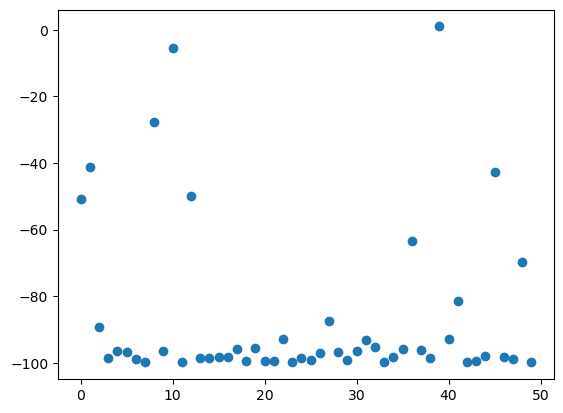

2182592.0
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(2182592., dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15a8d8550>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a8e8400; to 'JaxprTracer' at 0x15a8e8360>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15a8e4bb0>, ctx=JaxprEqnContext(compute_type=None, threefry_

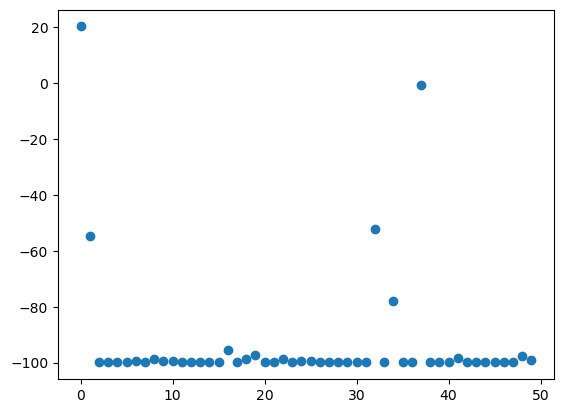

203312510.0
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(2.0331251e+08, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158424eb0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x1584a7330; to 'JaxprTracer' at 0x1584a73d0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1339ba620>, ctx=JaxprEqnContext(compute_type=None, th

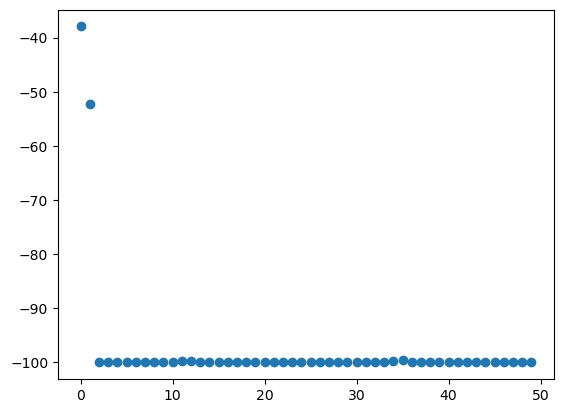

13367.697
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13367.697, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15a8f4740>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a901530; to 'JaxprTracer' at 0x15a901490>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15a8e5ea0>, ctx=JaxprEqnContext(compute_type=None, threefry

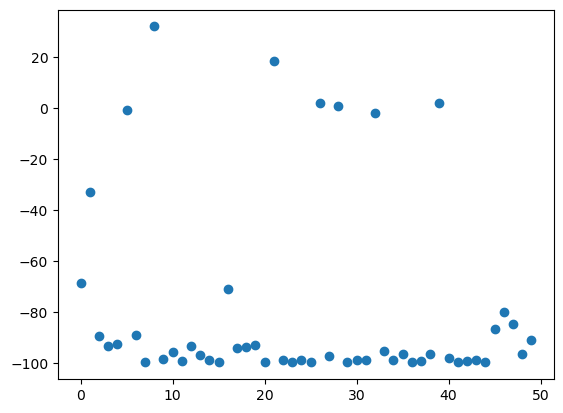

128.38358
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(128.38358, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15a8fc7e0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a935d50; to 'JaxprTracer' at 0x15a935cb0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15a8e5c30>, ctx=JaxprEqnContext(compute_type=None, threefry

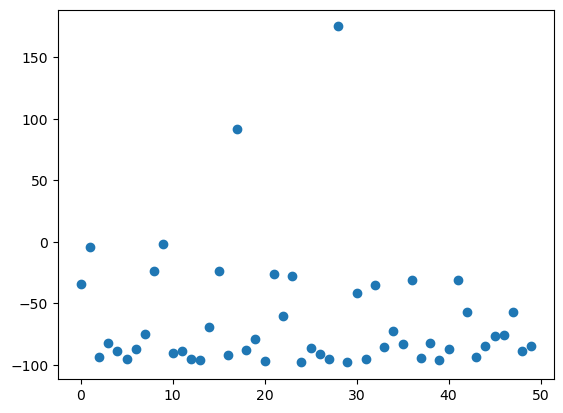

13993.991
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13993.991, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15a93c880>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15849dad0; to 'JaxprTracer' at 0x15849da30>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15a8e73a0>, ctx=JaxprEqnContext(compute_type=None, threefry

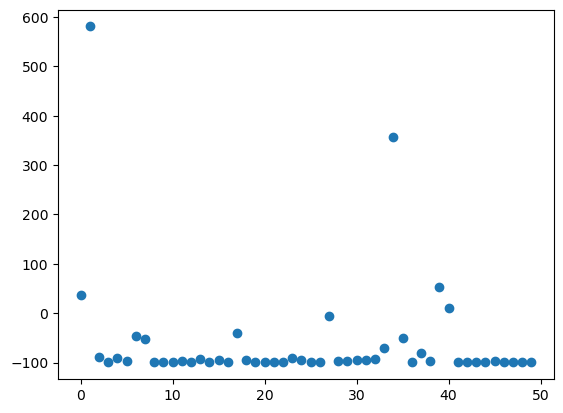

31856.02
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(31856.02, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15a9596b0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab39580; to 'JaxprTracer' at 0x15ab394e0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ab30dc0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

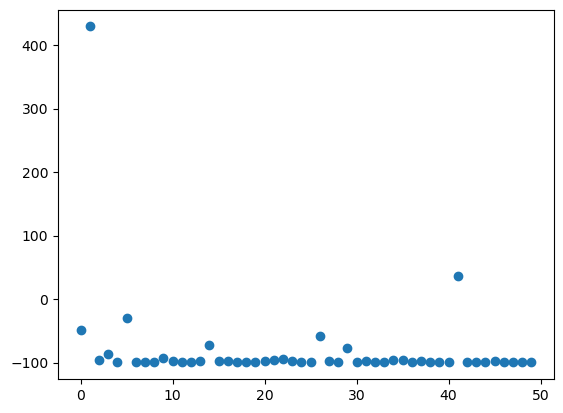

163.06752
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(163.06752, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab51750>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab59c10; to 'JaxprTracer' at 0x15ab59b70>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ab30d90>, ctx=JaxprEqnContext(compute_type=None, threefry

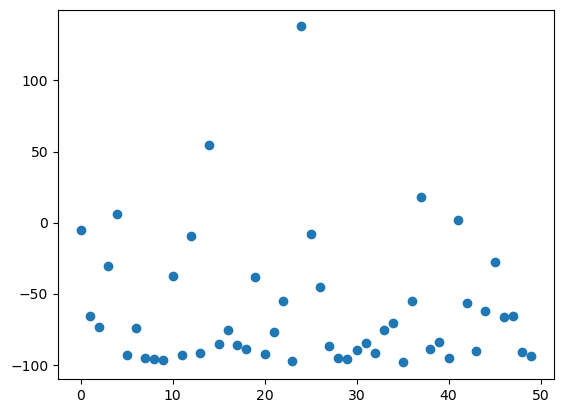

13666.204
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13666.204, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab523d0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15abc45e0; to 'JaxprTracer' at 0x15abc4540>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ab33130>, ctx=JaxprEqnContext(compute_type=None, threefry

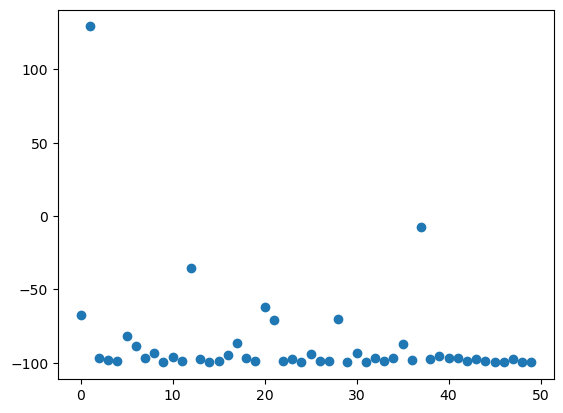

132766340.0
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(1.3276634e+08, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab50910>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15abc6930; to 'JaxprTracer' at 0x15abc6890>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ab33bb0>, ctx=JaxprEqnContext(compute_type=None, th

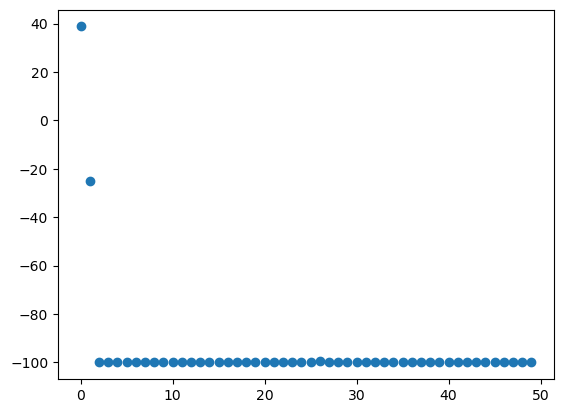

912011.8
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(912011.8, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab532a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15acab740; to 'JaxprTracer' at 0x15acab6a0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15aca5660>, ctx=JaxprEqnContext(compute_type=None, threefry_p

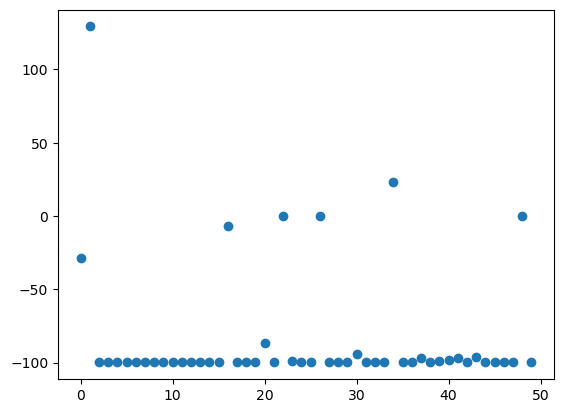

6194.905
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(6194.905, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab50cb0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15acd5530; to 'JaxprTracer' at 0x15acd5490>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15aca60e0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

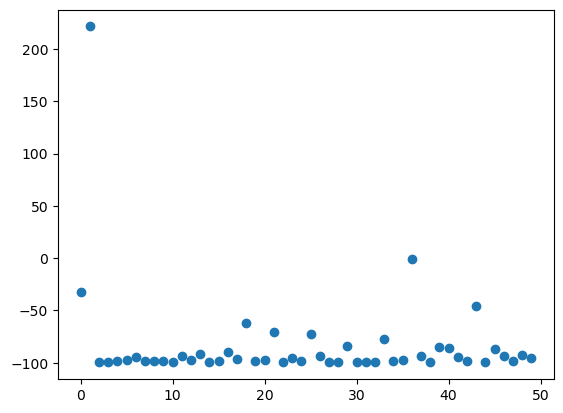

145.2432
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(145.2432, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ad3c110>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ad2e5c0; to 'JaxprTracer' at 0x15ad2e520>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15aca7af0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

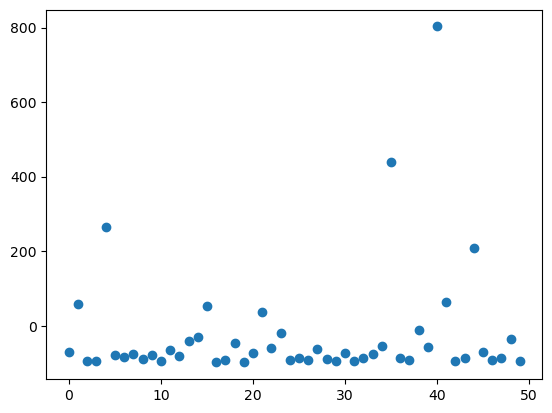

131.68253
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(131.68253, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ad501b0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ad2f830; to 'JaxprTracer' at 0x15ad2f790>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad1c550>, ctx=JaxprEqnContext(compute_type=None, threefry

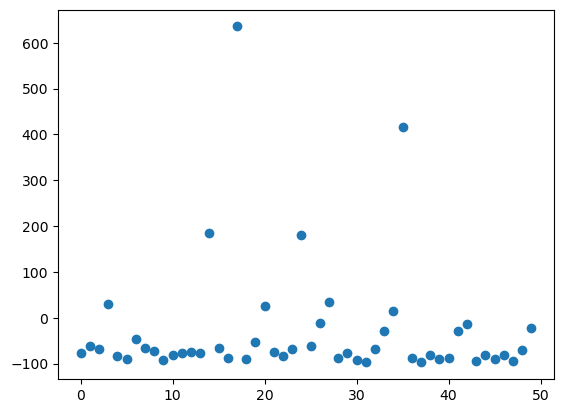

9461.164
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(9461.164, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158425150>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a5c15d0; to 'JaxprTracer' at 0x15a5c0c20>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15aca4550>, ctx=JaxprEqnContext(compute_type=None, threefry_p

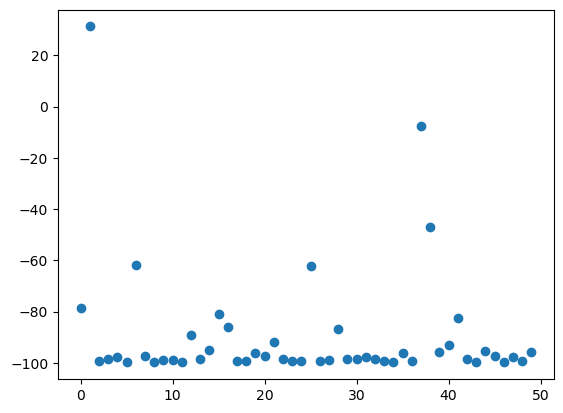

152.44789
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(152.44789, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab52200>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a5ae110; to 'JaxprTracer' at 0x15a5ae4d0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ab312a0>, ctx=JaxprEqnContext(compute_type=None, threefry

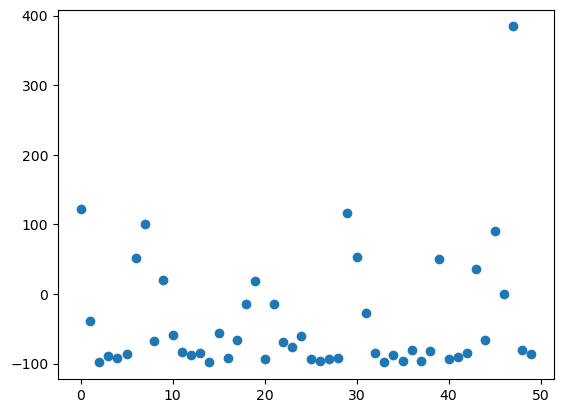

4928.9746
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(4928.9746, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab52be0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a8c2110; to 'JaxprTracer' at 0x15a8c2c50>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ab32ad0>, ctx=JaxprEqnContext(compute_type=None, threefry

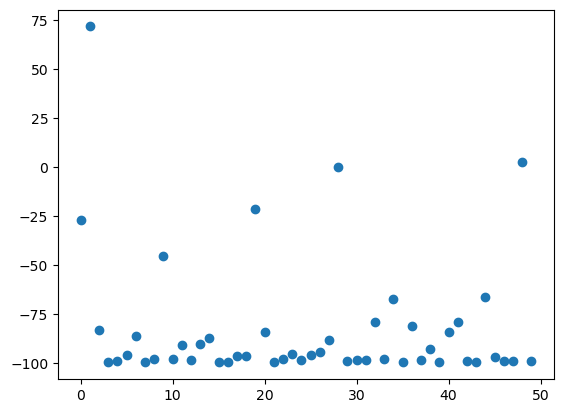

1442401.4
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(1442401.4, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab533a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a8e9800; to 'JaxprTracer' at 0x15a8e9580>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ab329e0>, ctx=JaxprEqnContext(compute_type=None, threefry

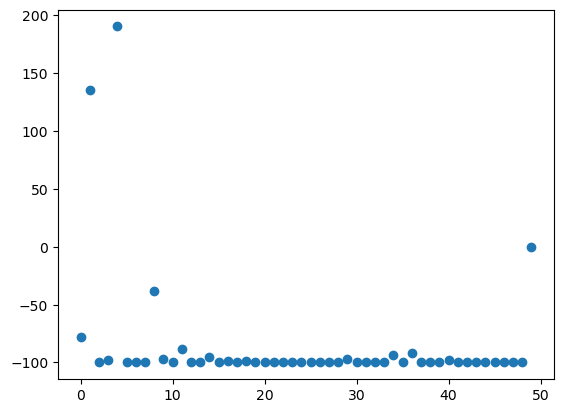

114723816.0
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(1.14723816e+08, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab52cd0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ac95940; to 'JaxprTracer' at 0x15ac95850>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15a9a59f0>, ctx=JaxprEqnContext(compute_type=None, t

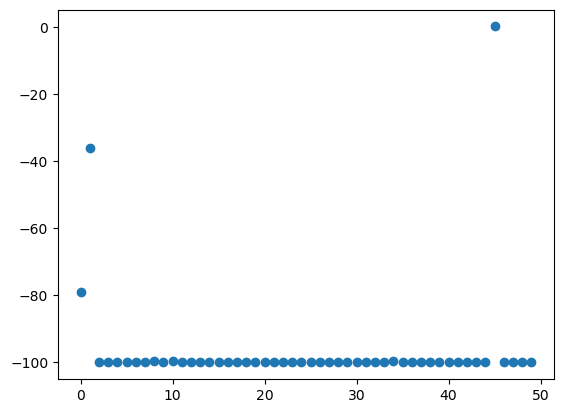

86.454216
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(86.454216, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab51dd0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab38f90; to 'JaxprTracer' at 0x15ab3bd30>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15a9a64d0>, ctx=JaxprEqnContext(compute_type=None, threefry

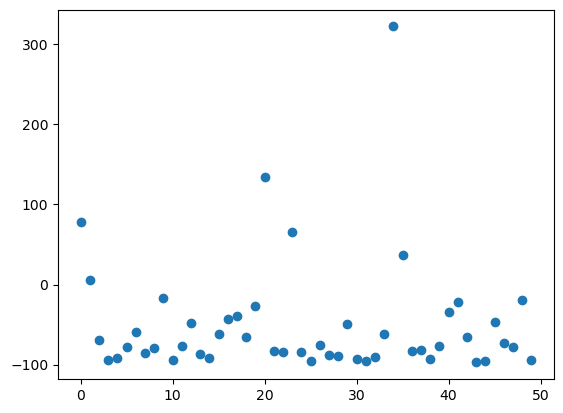

156713120.0
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(1.5671312e+08, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab500b0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15abaa4d0; to 'JaxprTracer' at 0x15aba8040>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15a9a6e90>, ctx=JaxprEqnContext(compute_type=None, th

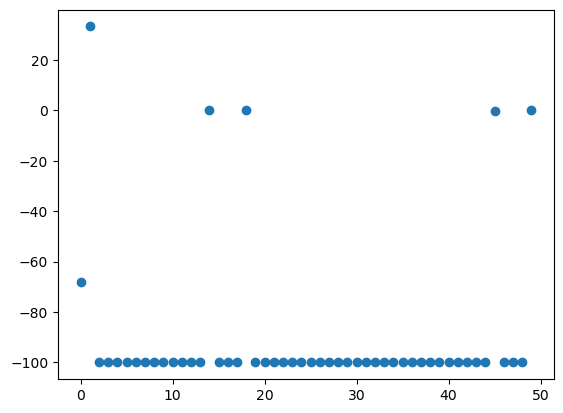

580896.94
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(580896.94, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab500c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15aba8db0; to 'JaxprTracer' at 0x15aba9300>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15a9a7910>, ctx=JaxprEqnContext(compute_type=None, threefry

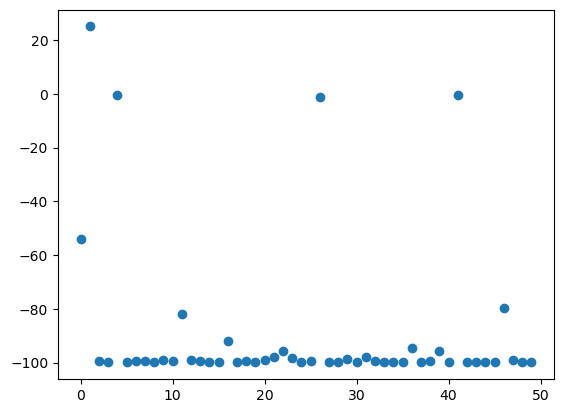

12287.609
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12287.609, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab50c80>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ad0fd30; to 'JaxprTracer' at 0x15ad0e2a0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad482b0>, ctx=JaxprEqnContext(compute_type=None, threefry

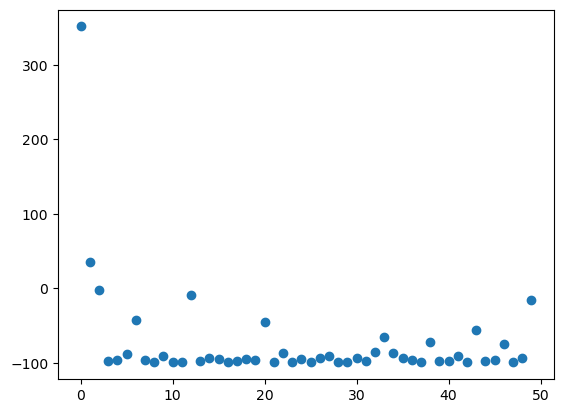

427503.84
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(427503.84, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab50550>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ad45cb0; to 'JaxprTracer' at 0x15ad45c10>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad71c60>, ctx=JaxprEqnContext(compute_type=None, threefry

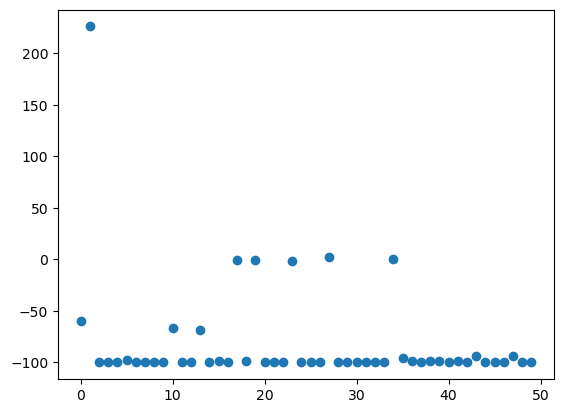

5303.945
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(5303.945, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1321dc910>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab598f0; to 'JaxprTracer' at 0x15ab58360>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15aca4b20>, ctx=JaxprEqnContext(compute_type=None, threefry_p

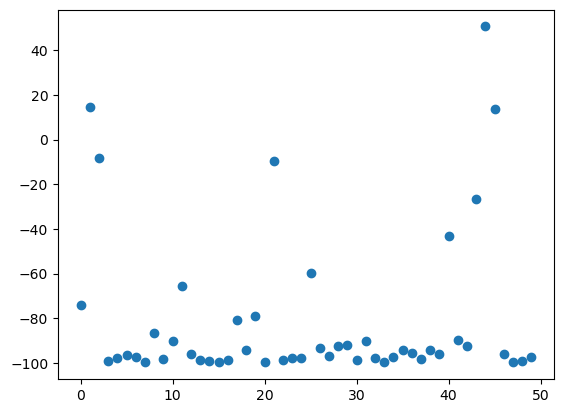

70140810.0
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(70140808., dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab51110>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15abb4d60; to 'JaxprTracer' at 0x15abb5850>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15a58df90>, ctx=JaxprEqnContext(compute_type=None, threefr

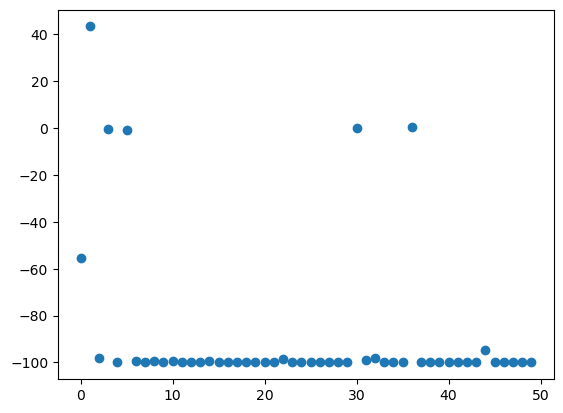

5320.2954
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(5320.2954, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab528b0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a5ac810; to 'JaxprTracer' at 0x15a5ae890>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15a58d4e0>, ctx=JaxprEqnContext(compute_type=None, threefry

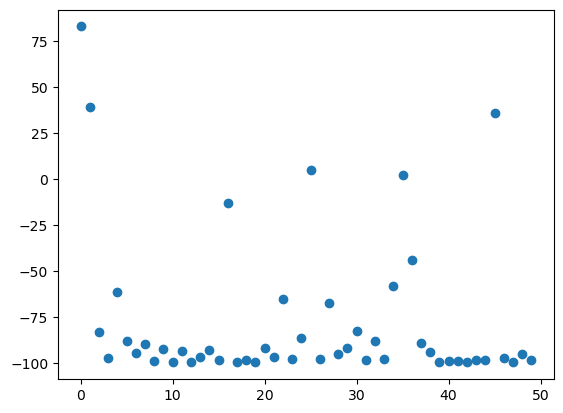

377601.88
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(377601.88, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab52140>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a936020; to 'JaxprTracer' at 0x15a934270>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad70220>, ctx=JaxprEqnContext(compute_type=None, threefry

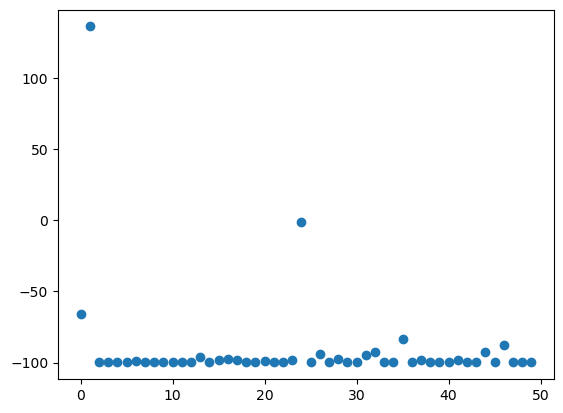

68669736.0
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(68669736., dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab521a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a5c29d0; to 'JaxprTracer' at 0x15a5c2a20>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad71e40>, ctx=JaxprEqnContext(compute_type=None, threefr

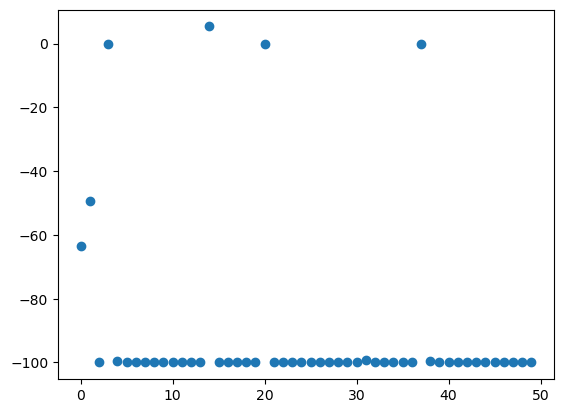

336197.0
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(336197., dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab52370>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a569fd0; to 'JaxprTracer' at 0x15a56a750>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad72a40>, ctx=JaxprEqnContext(compute_type=None, threefry_pa

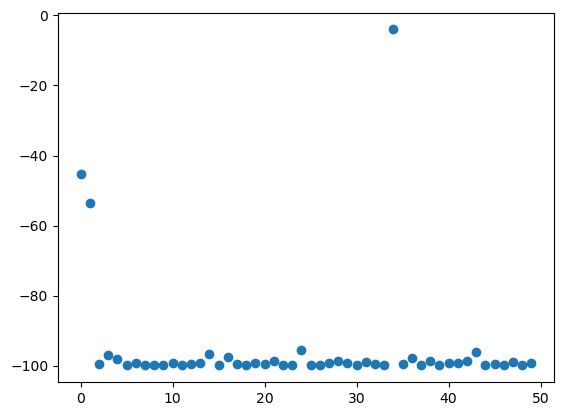

481605.38
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(481605.38, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab519a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a9735b0; to 'JaxprTracer' at 0x15a972fc0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad73460>, ctx=JaxprEqnContext(compute_type=None, threefry

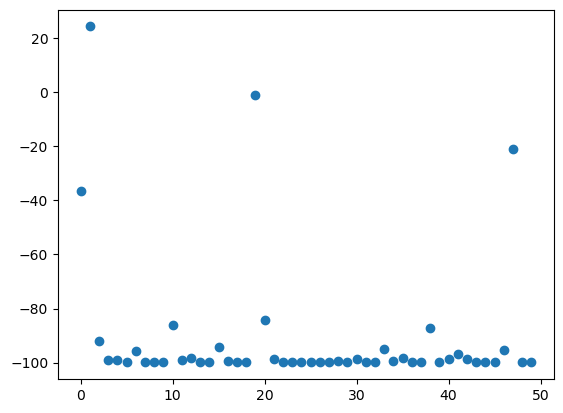

342782.16
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(342782.16, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab50950>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a93b1f0; to 'JaxprTracer' at 0x15a939df0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad28ee0>, ctx=JaxprEqnContext(compute_type=None, threefry

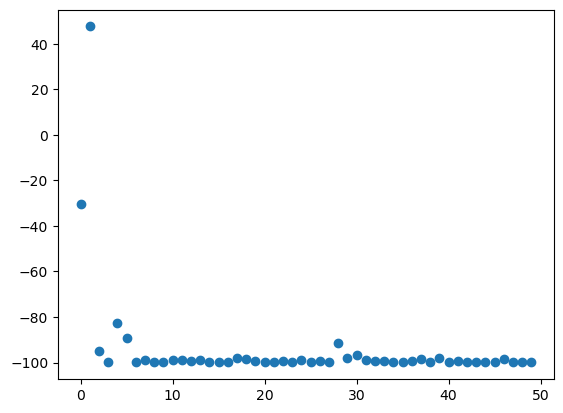

15242438.0
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15242438., dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab503f0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a903420; to 'JaxprTracer' at 0x15a903ab0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad299c0>, ctx=JaxprEqnContext(compute_type=None, threefr

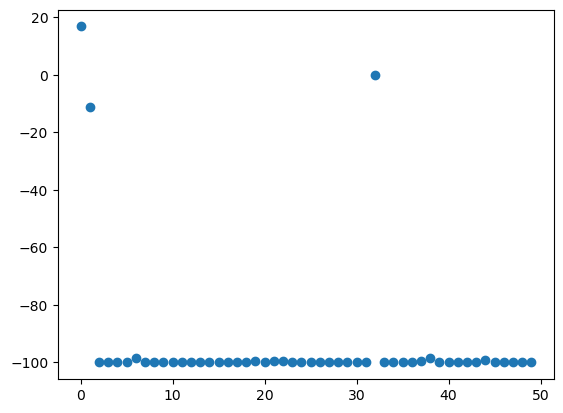

21277854.0
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(21277854., dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab50350>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab3b970; to 'JaxprTracer' at 0x15ab3b150>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad2b3d0>, ctx=JaxprEqnContext(compute_type=None, threefr

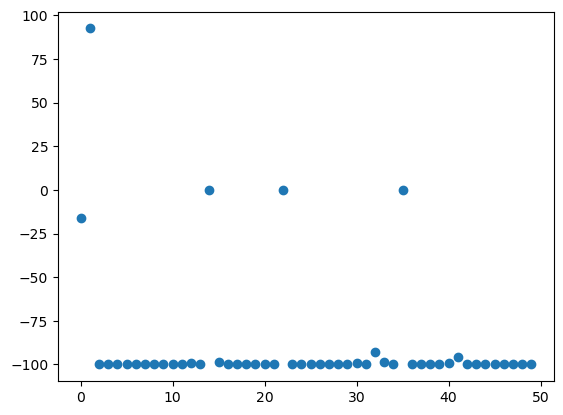

22364016.0
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(22364016., dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab53bb0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ad59670; to 'JaxprTracer' at 0x15ad595d0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad2beb0>, ctx=JaxprEqnContext(compute_type=None, threefr

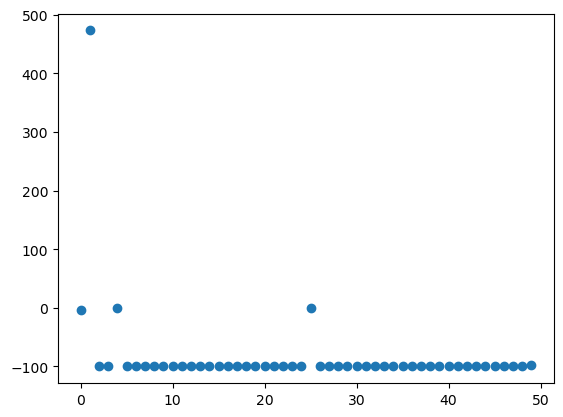

19738052.0
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(19738052., dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab50f10>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a9867a0; to 'JaxprTracer' at 0x15a987240>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad2a020>, ctx=JaxprEqnContext(compute_type=None, threefr

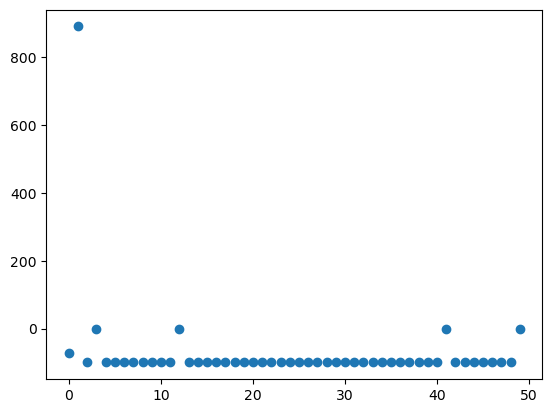

6621461.5
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(6621461.5, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab51940>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab5a890; to 'JaxprTracer' at 0x15ab5b510>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad29600>, ctx=JaxprEqnContext(compute_type=None, threefry

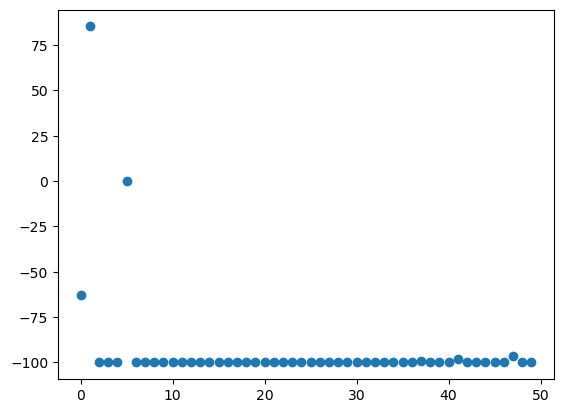

160075.88
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(160075.88, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab50930>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a8c24d0; to 'JaxprTracer' at 0x15a8c19e0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad38b80>, ctx=JaxprEqnContext(compute_type=None, threefry

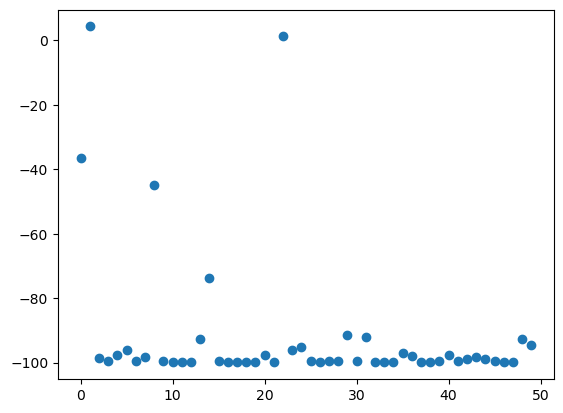

81958.62
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(81958.62, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab50d00>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a599c10; to 'JaxprTracer' at 0x15a598c70>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad39660>, ctx=JaxprEqnContext(compute_type=None, threefry_p

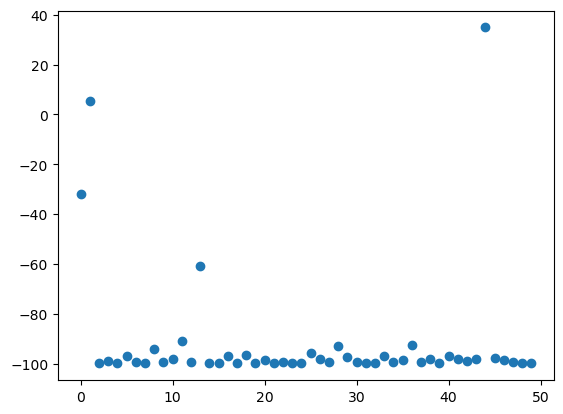

9691699.0
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(9691699., dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab50590>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a9396c0; to 'JaxprTracer' at 0x15a939bc0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad3b100>, ctx=JaxprEqnContext(compute_type=None, threefry_

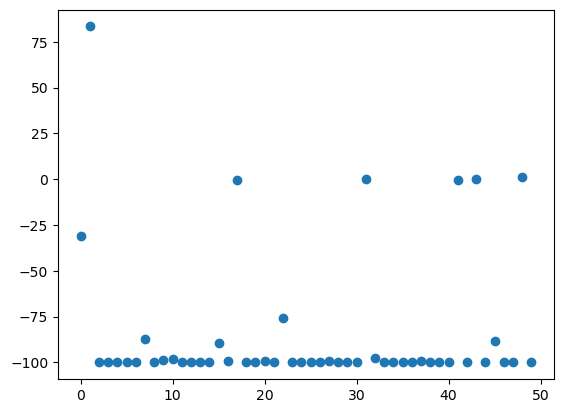

21.232224
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(21.232224, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c3b0740>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c3bb060; to 'JaxprTracer' at 0x15c3bafc0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3bcca0>, ctx=JaxprEqnContext(compute_type=None, threefry

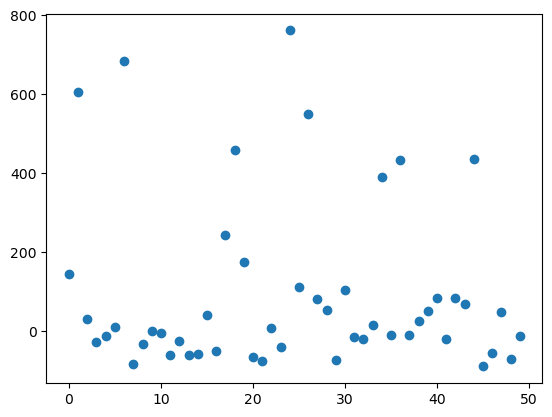

447.65298
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(447.65298, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c3f07e0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ace06d0; to 'JaxprTracer' at 0x15ace0630>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3bd780>, ctx=JaxprEqnContext(compute_type=None, threefry

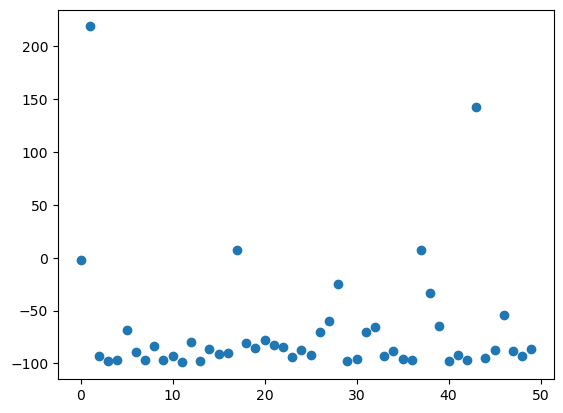

15.230286
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.230286, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c3ed580>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c44ce00; to 'JaxprTracer' at 0x15c44cd60>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3bf220>, ctx=JaxprEqnContext(compute_type=None, threefry

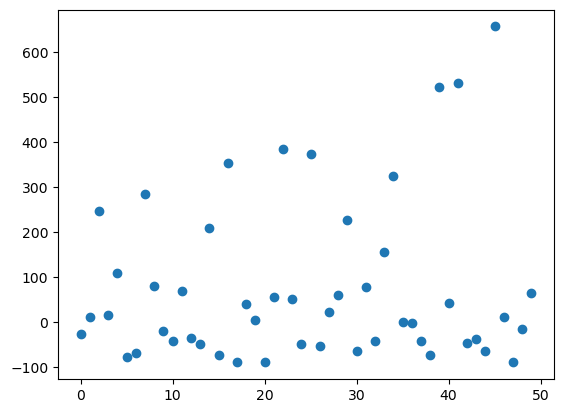

163.11305
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(163.11305, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c471620>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c46b470; to 'JaxprTracer' at 0x15c46b3d0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3bfd00>, ctx=JaxprEqnContext(compute_type=None, threefry

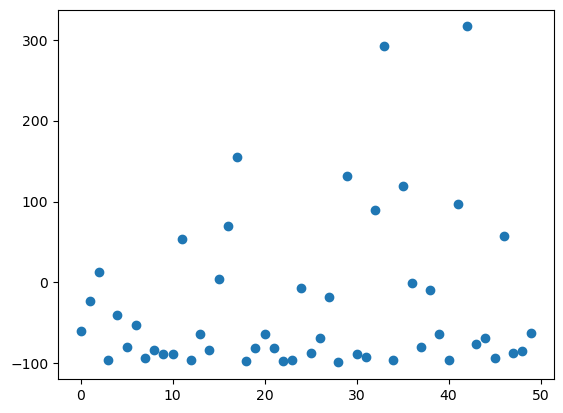

9136.991
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(9136.991, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab534a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ad4c6d0; to 'JaxprTracer' at 0x15ad4ede0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15a52f190>, ctx=JaxprEqnContext(compute_type=None, threefry_p

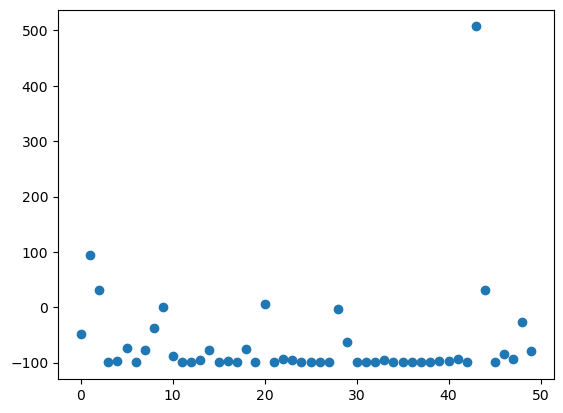

15.892428
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.892428, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab51260>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c428ef0; to 'JaxprTracer' at 0x15c42a070>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15a9a7760>, ctx=JaxprEqnContext(compute_type=None, threefry

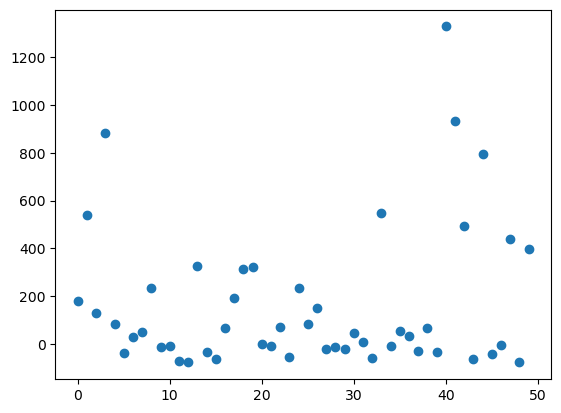

7957.916
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(7957.916, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab50360>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab6e5c0; to 'JaxprTracer' at 0x15ab6cae0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15a9a4be0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

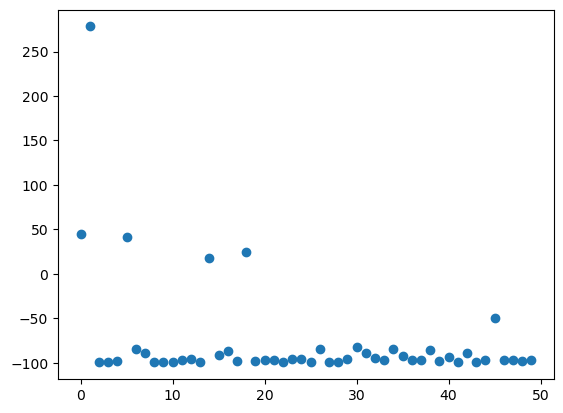

7345.048
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(7345.048, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158426bf0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a580630; to 'JaxprTracer' at 0x15a583420>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ab33160>, ctx=JaxprEqnContext(compute_type=None, threefry_p

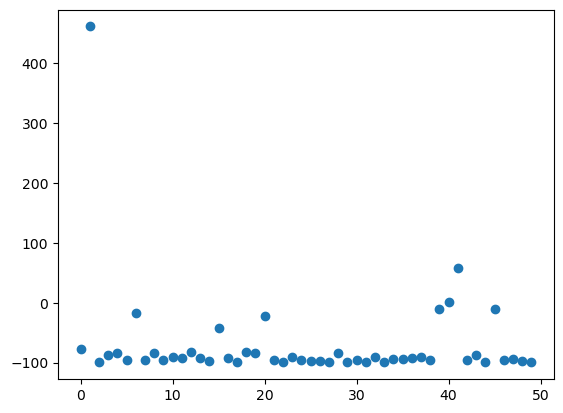

16.213795
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.213795, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158424e80>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ad2dbc0; to 'JaxprTracer' at 0x15ad2d6c0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ab33010>, ctx=JaxprEqnContext(compute_type=None, threefry

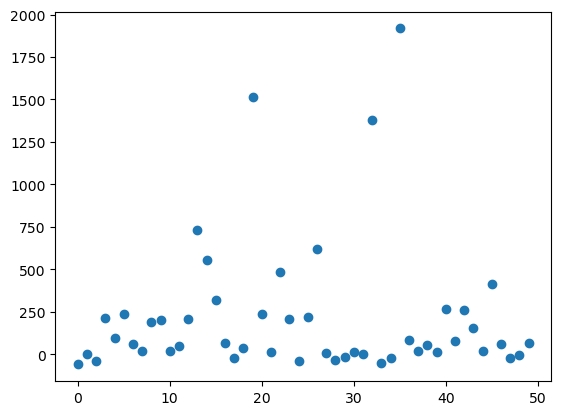

25.73153
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(25.73153, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1584257e0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a5ae2f0; to 'JaxprTracer' at 0x15a5ac270>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c64c5e0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

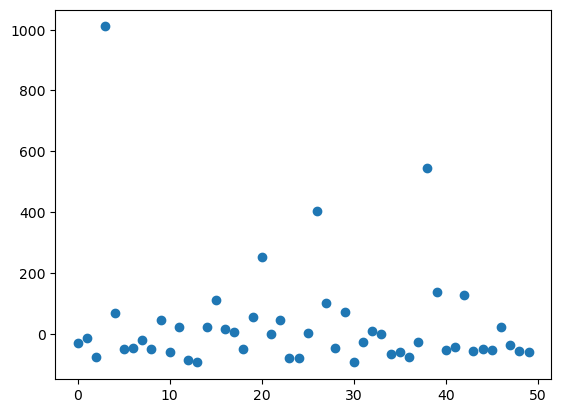

21.462656
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(21.462656, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158425170>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15aba8270; to 'JaxprTracer' at 0x15aba9d50>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c64d120>, ctx=JaxprEqnContext(compute_type=None, threefry

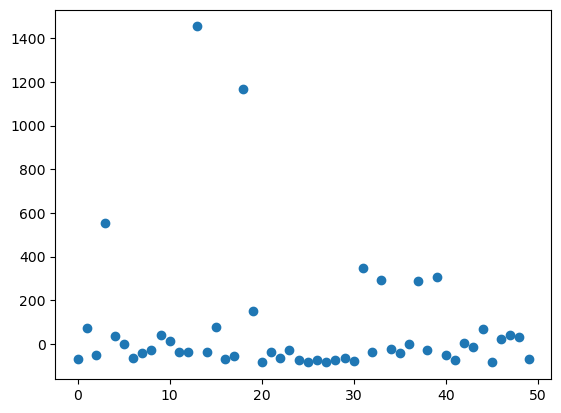

20.363054
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(20.363054, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158425f40>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15acaa2f0; to 'JaxprTracer' at 0x15acaaf70>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c64db40>, ctx=JaxprEqnContext(compute_type=None, threefry

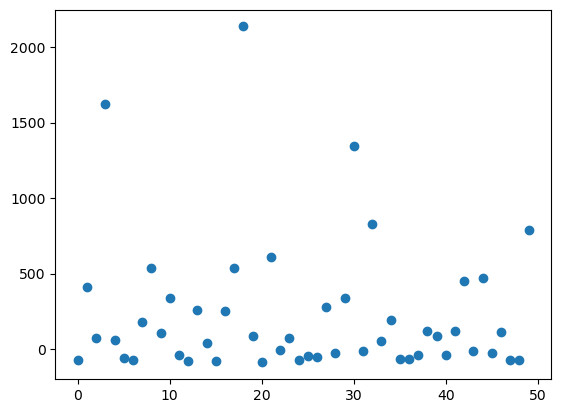

150.04231
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(150.04231, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c4500a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a91ce50; to 'JaxprTracer' at 0x15a91ca40>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c64f460>, ctx=JaxprEqnContext(compute_type=None, threefry

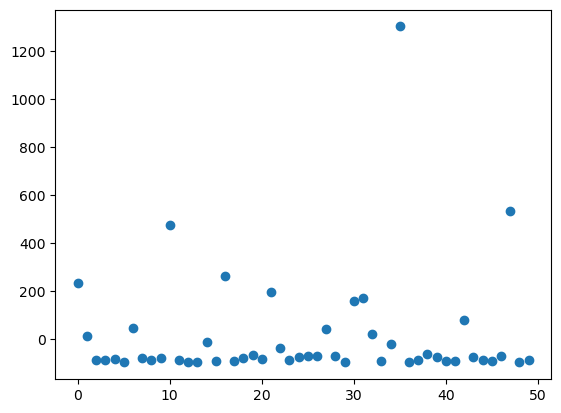

17.045727
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.045727, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c408140>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ac26b60; to 'JaxprTracer' at 0x15ac26f20>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c64ff40>, ctx=JaxprEqnContext(compute_type=None, threefry

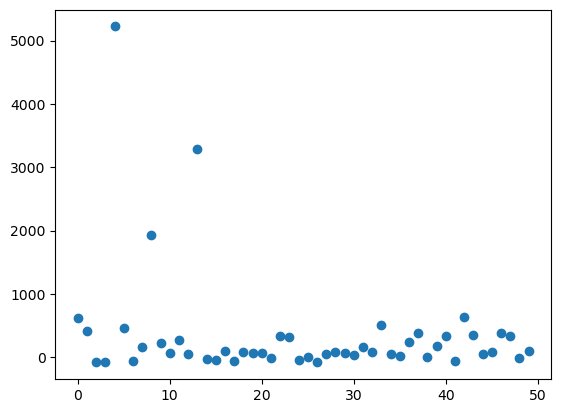

251.21147
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(251.21147, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c460e50>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a9722a0; to 'JaxprTracer' at 0x15a971e90>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3f1930>, ctx=JaxprEqnContext(compute_type=None, threefry

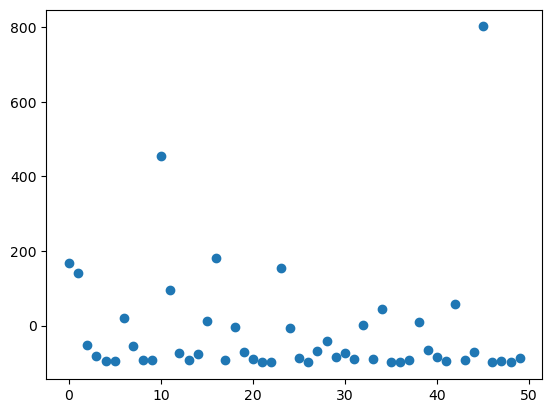

46205.59
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(46205.59, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c604ef0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a972a70; to 'JaxprTracer' at 0x15a971530>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3f2410>, ctx=JaxprEqnContext(compute_type=None, threefry_p

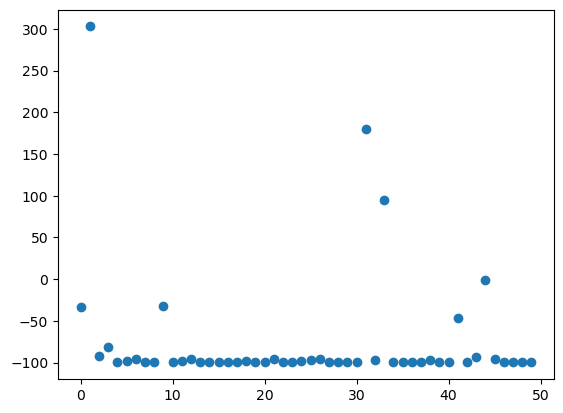

28.844746
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(28.844746, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158427170>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a96e570; to 'JaxprTracer' at 0x15a96c8b0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x135a55720>, ctx=JaxprEqnContext(compute_type=None, threefry

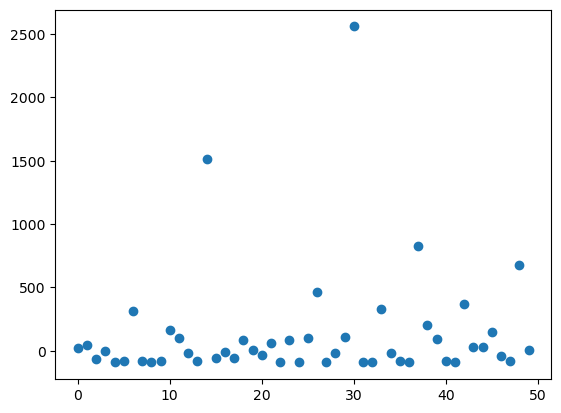

1449.7147
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(1449.7147, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab53720>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15acd6430; to 'JaxprTracer' at 0x15acd7970>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15a565780>, ctx=JaxprEqnContext(compute_type=None, threefry

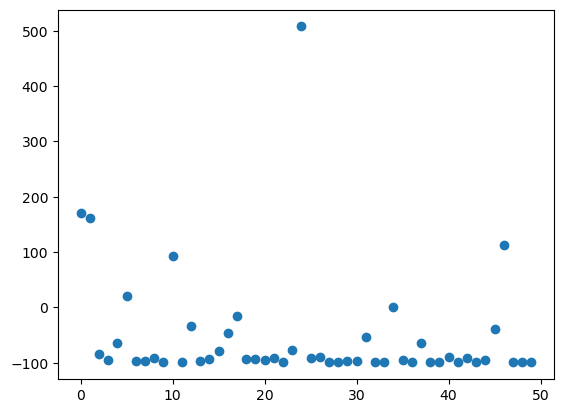

177511.14
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(177511.14, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab50570>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a5d5030; to 'JaxprTracer' at 0x15a5d4d10>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3f0e20>, ctx=JaxprEqnContext(compute_type=None, threefry

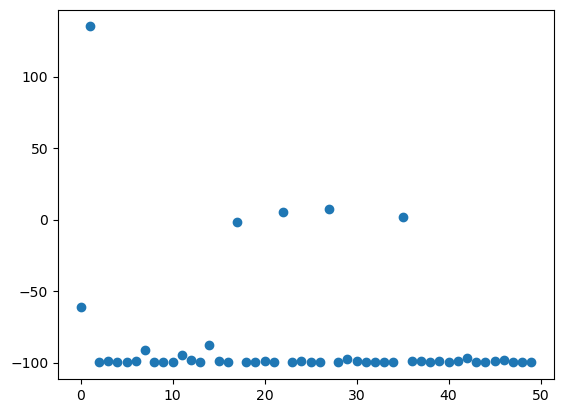

2188.9421
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(2188.9421, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab52e70>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c38eac0; to 'JaxprTracer' at 0x15c38fec0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3f2800>, ctx=JaxprEqnContext(compute_type=None, threefry

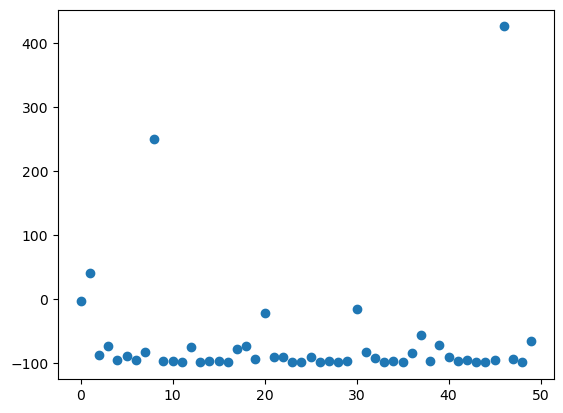

2338.829
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(2338.829, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab51c70>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c3f7b00; to 'JaxprTracer' at 0x15c3f4810>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3f33a0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

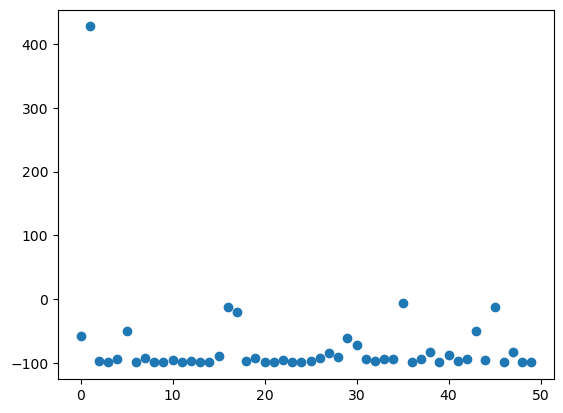

12.145657
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12.145657, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab52d40>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab6f560; to 'JaxprTracer' at 0x15ab6d530>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3f3dc0>, ctx=JaxprEqnContext(compute_type=None, threefry

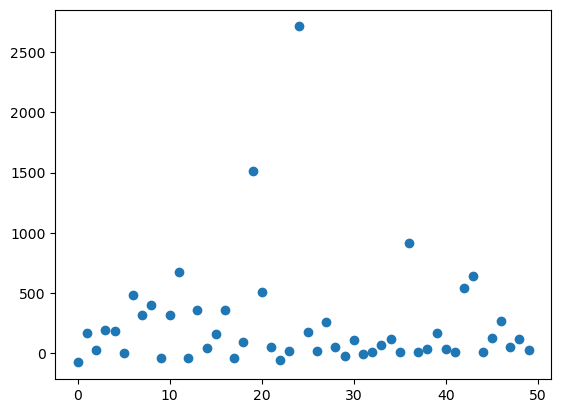

2853.4163
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(2853.4163, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c604410>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ad4e250; to 'JaxprTracer' at 0x15ad4cef0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c461810>, ctx=JaxprEqnContext(compute_type=None, threefry

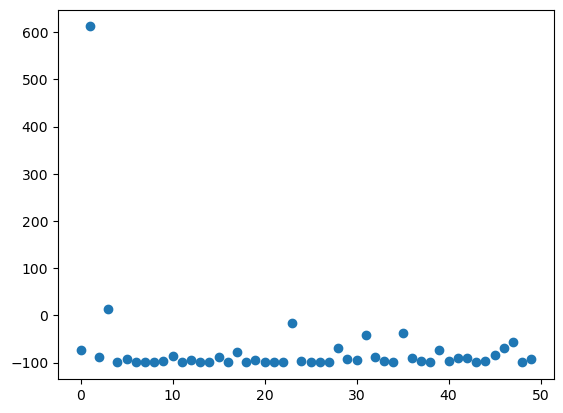

3507.3796
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(3507.3796, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c4704b0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c394220; to 'JaxprTracer' at 0x15c395350>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c4622f0>, ctx=JaxprEqnContext(compute_type=None, threefry

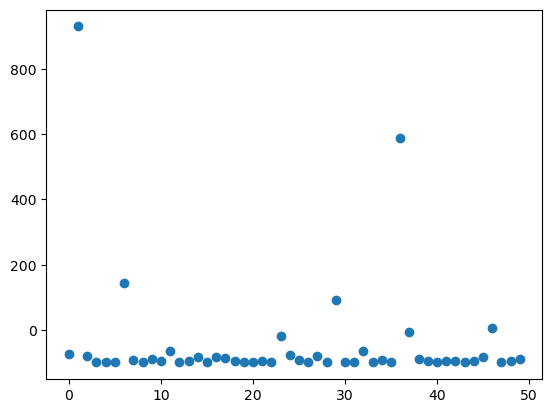

344262.3
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(344262.3, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c615130>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c643ab0; to 'JaxprTracer' at 0x15c640950>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c463c10>, ctx=JaxprEqnContext(compute_type=None, threefry_p

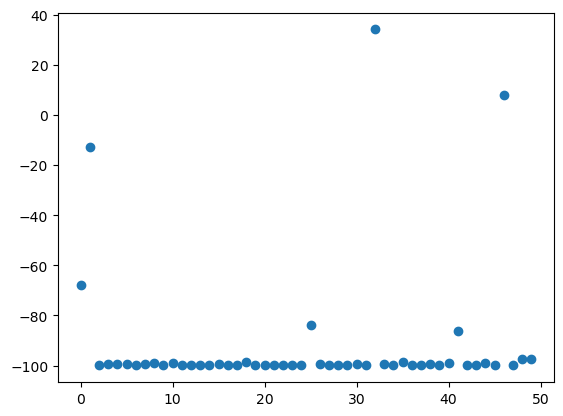

2572.0554
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(2572.0554, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6211d0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15abb54e0; to 'JaxprTracer' at 0x15abb4fe0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c614670>, ctx=JaxprEqnContext(compute_type=None, threefry

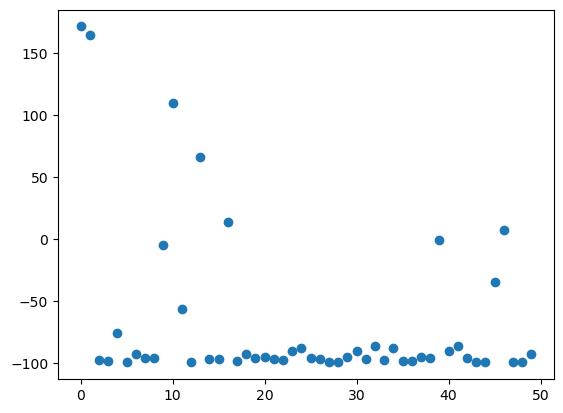

76.24011
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(76.24011, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c679ee0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6a5210; to 'JaxprTracer' at 0x15c6a5170>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c6160b0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

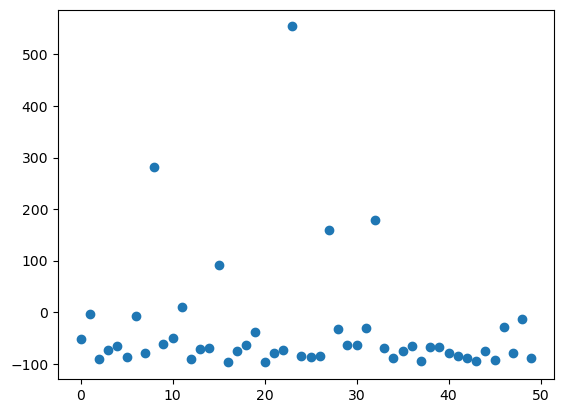

497020.3
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(497020.3, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6b9f80>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6a75b0; to 'JaxprTracer' at 0x15c6a7510>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c616b90>, ctx=JaxprEqnContext(compute_type=None, threefry_p

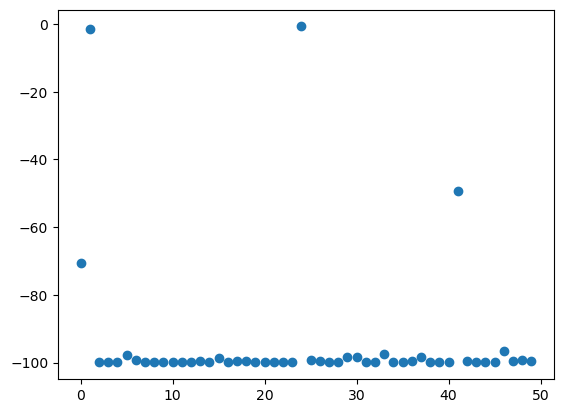

81.68493
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(81.68493, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab51ba0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a930c20; to 'JaxprTracer' at 0x15a930fe0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3f14e0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

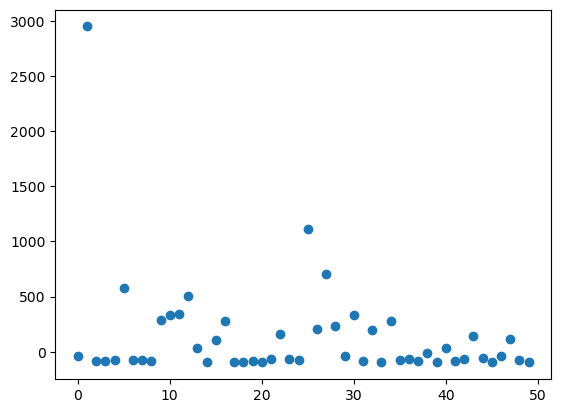

1994.0537
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(1994.0537, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab51cd0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15849f6f0; to 'JaxprTracer' at 0x15849fa60>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3f3940>, ctx=JaxprEqnContext(compute_type=None, threefry

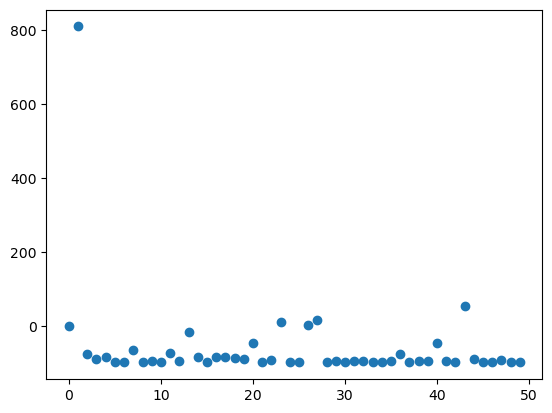

4410.8267
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(4410.8267, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab50330>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15abc53f0; to 'JaxprTracer' at 0x15abc6e80>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c615810>, ctx=JaxprEqnContext(compute_type=None, threefry

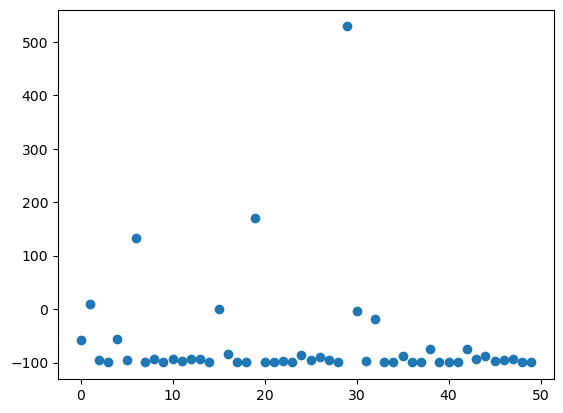

341473.38
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(341473.38, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab539a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a91e980; to 'JaxprTracer' at 0x15a91e8e0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c6167d0>, ctx=JaxprEqnContext(compute_type=None, threefry

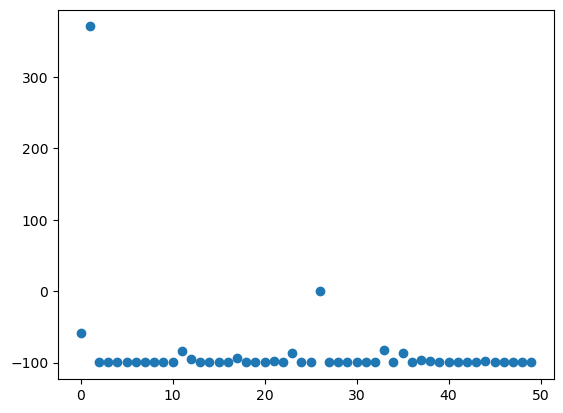

95.12183
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(95.12183, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6889c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c68ec00; to 'JaxprTracer' at 0x15c68ea20>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c617ca0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

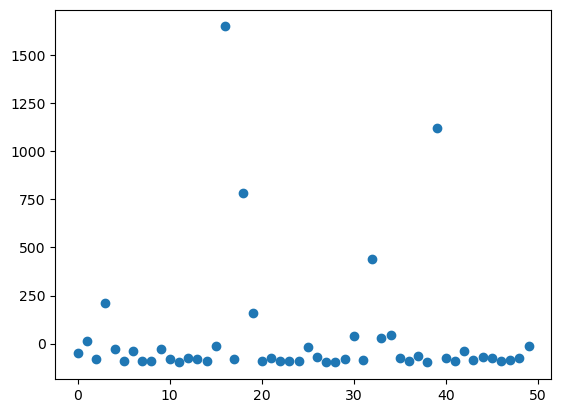

18.402714
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(18.402714, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6b0a60>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c418c70; to 'JaxprTracer' at 0x15c419ee0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c674700>, ctx=JaxprEqnContext(compute_type=None, threefry

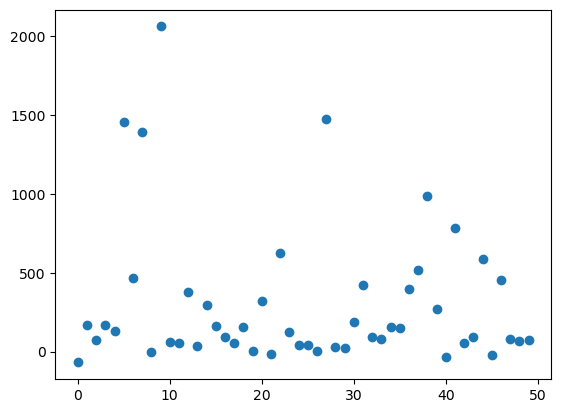

13.835331
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.835331, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6d56e0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c46b740; to 'JaxprTracer' at 0x15c469d50>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c6760b0>, ctx=JaxprEqnContext(compute_type=None, threefry

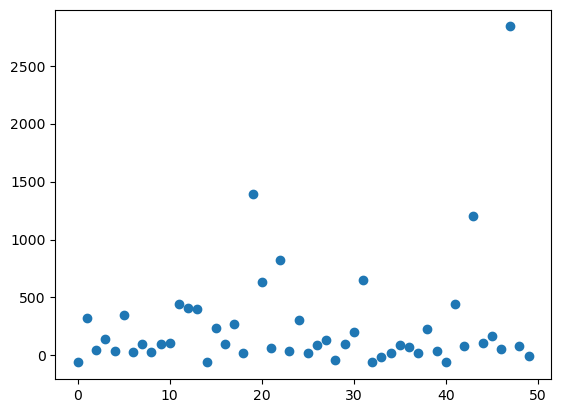

15.152389
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.152389, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c685780>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c46a930; to 'JaxprTracer' at 0x15c469030>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c676b90>, ctx=JaxprEqnContext(compute_type=None, threefry

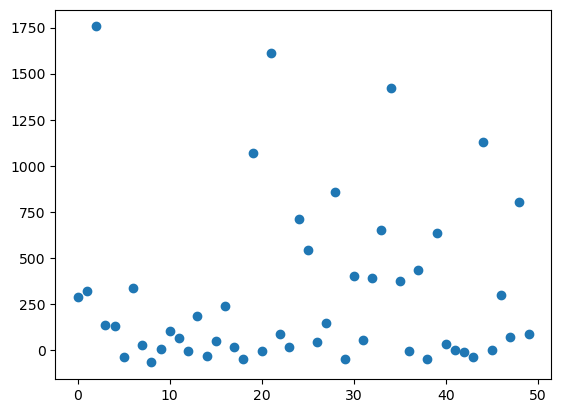

71.917816
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(71.917816, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c684a40>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15abb5b70; to 'JaxprTracer' at 0x15abb7ec0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c6775b0>, ctx=JaxprEqnContext(compute_type=None, threefry

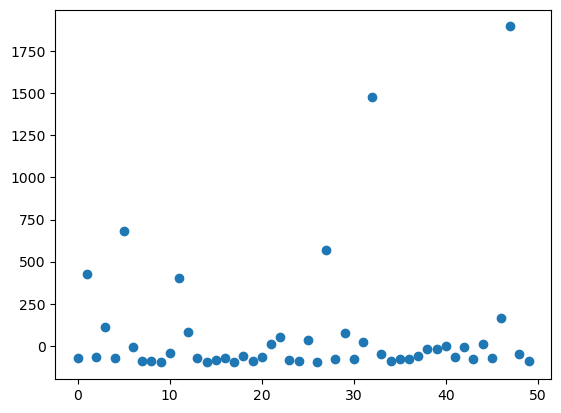

58.183712
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(58.183712, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c686650>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15d35c900; to 'JaxprTracer' at 0x15d35c860>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d351120>, ctx=JaxprEqnContext(compute_type=None, threefry

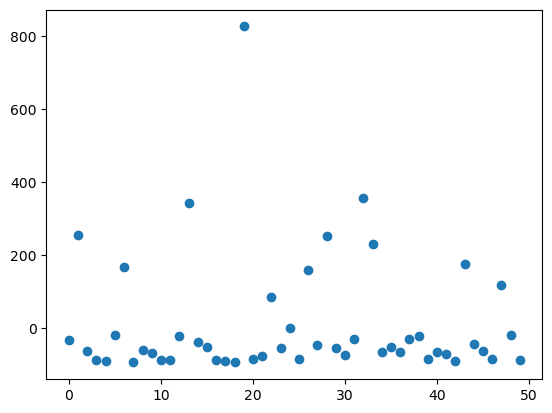

271587.3
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(271587.3, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158427800>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a949030; to 'JaxprTracer' at 0x15a94be20>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x135ac3640>, ctx=JaxprEqnContext(compute_type=None, threefry_p

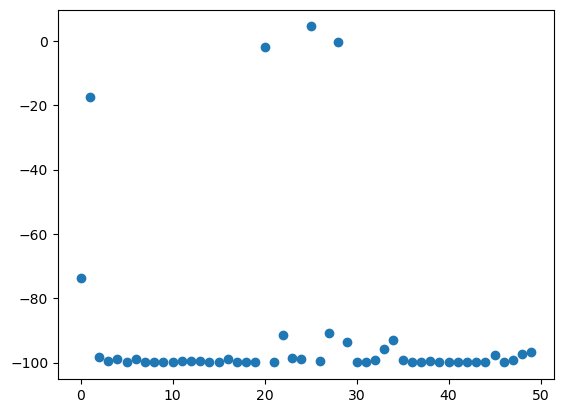

54.567333
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(54.567333, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab519e0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c3f77e0; to 'JaxprTracer' at 0x15c3f6340>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1339a0040>, ctx=JaxprEqnContext(compute_type=None, threefry

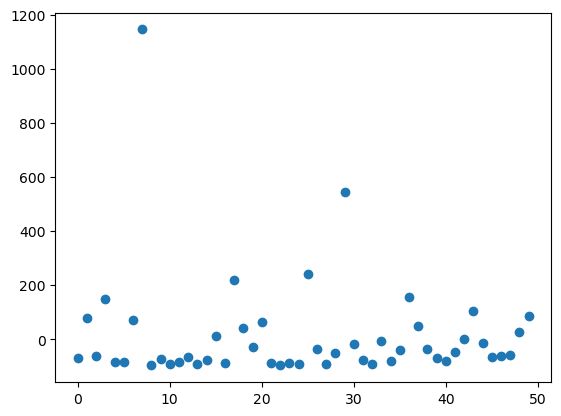

344519.56
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(344519.56, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab512e0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a901080; to 'JaxprTracer' at 0x15a902a20>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c616920>, ctx=JaxprEqnContext(compute_type=None, threefry

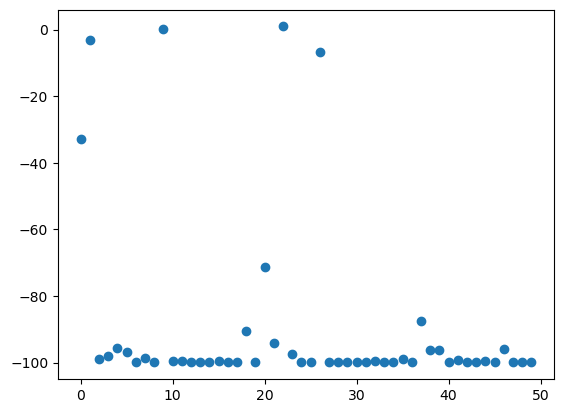

22.91817
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(22.91817, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab52e30>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c395760; to 'JaxprTracer' at 0x15c396b10>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c6170a0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

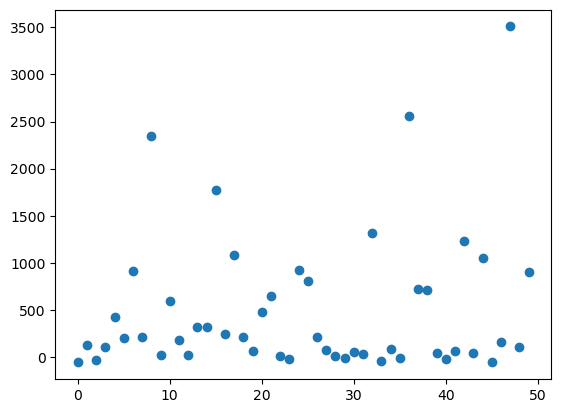

2237.237
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(2237.237, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6862b0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ac97bf0; to 'JaxprTracer' at 0x15ac96e80>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d351a20>, ctx=JaxprEqnContext(compute_type=None, threefry_p

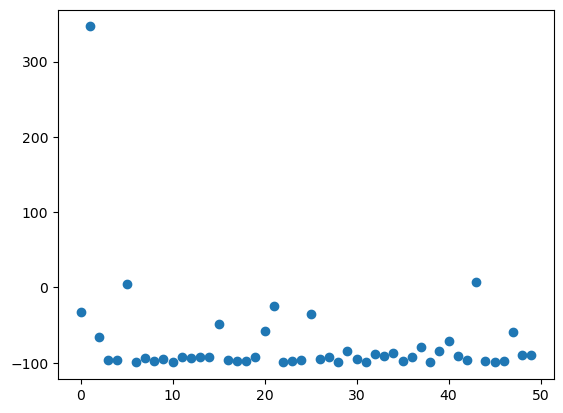

34.316162
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(34.316162, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c684330>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ac265c0; to 'JaxprTracer' at 0x15ac24680>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d351f60>, ctx=JaxprEqnContext(compute_type=None, threefry

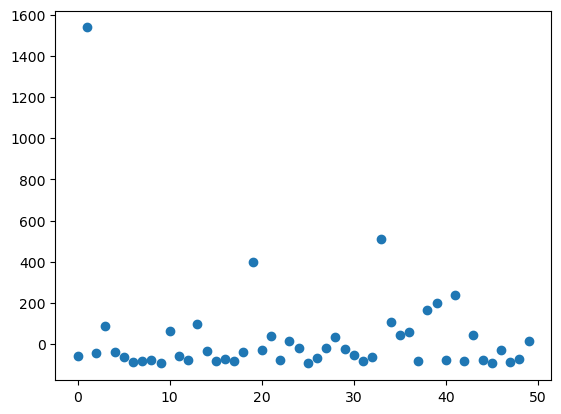

16.014374
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.014374, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6855e0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a971670; to 'JaxprTracer' at 0x15a970450>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d352980>, ctx=JaxprEqnContext(compute_type=None, threefry

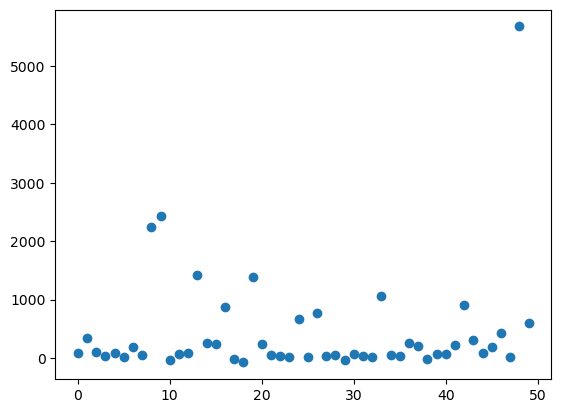

17.38886
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.38886, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c685260>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c3a2cf0; to 'JaxprTracer' at 0x15c3a2b60>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d3643d0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

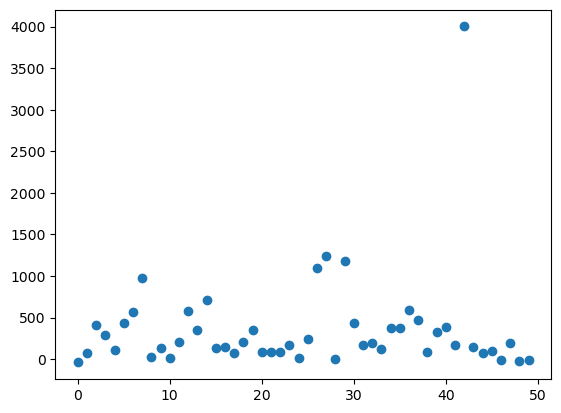

33.045227
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(33.045227, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c685550>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c642160; to 'JaxprTracer' at 0x15c643290>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d364eb0>, ctx=JaxprEqnContext(compute_type=None, threefry

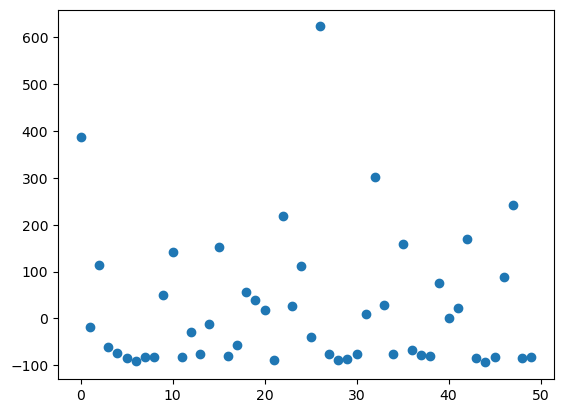

1988.007
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(1988.007, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c684e50>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c633c90; to 'JaxprTracer' at 0x15c632430>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d366980>, ctx=JaxprEqnContext(compute_type=None, threefry_p

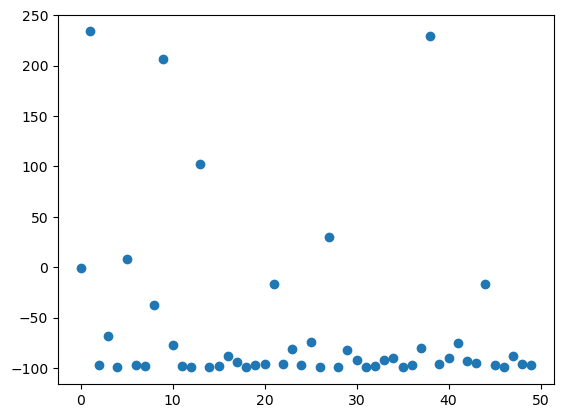

102843.68
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(102843.68, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c685c60>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15d35c6d0; to 'JaxprTracer' at 0x15d35c3b0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d367460>, ctx=JaxprEqnContext(compute_type=None, threefry

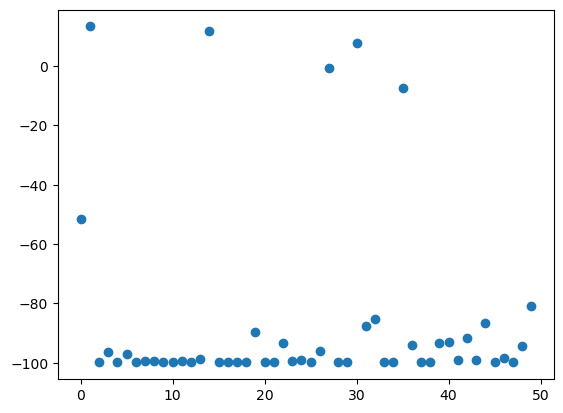

163072.9
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(163072.9, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c687130>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15d3f0680; to 'JaxprTracer' at 0x15d3f05e0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d3e4e20>, ctx=JaxprEqnContext(compute_type=None, threefry_p

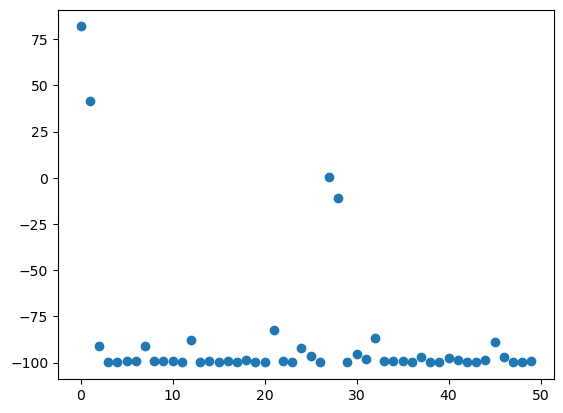

12.658897
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12.658897, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab50d20>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ac95170; to 'JaxprTracer' at 0x15ac96110>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d3644f0>, ctx=JaxprEqnContext(compute_type=None, threefry

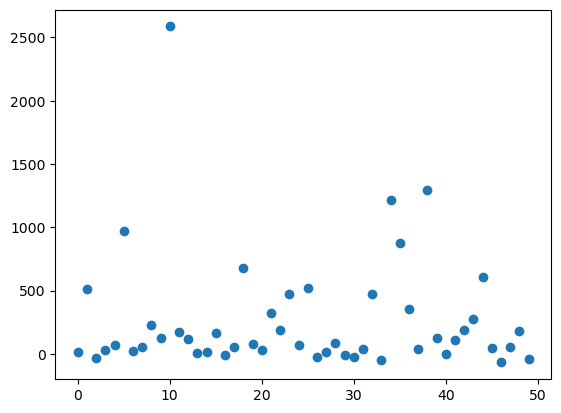

31.189505
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(31.189505, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158425800>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c4193a0; to 'JaxprTracer' at 0x15c41bb50>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c616350>, ctx=JaxprEqnContext(compute_type=None, threefry

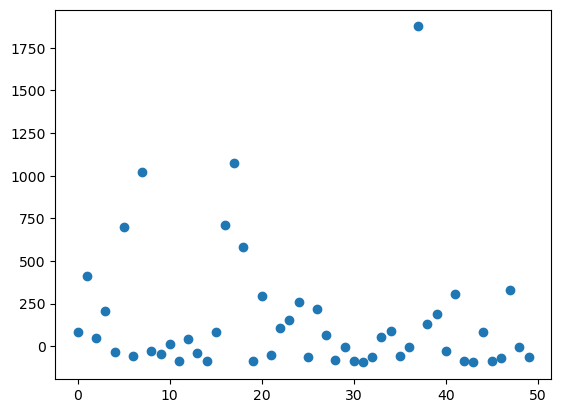

27.50472
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(27.50472, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1584278a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a5982c0; to 'JaxprTracer' at 0x15a598400>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d351b10>, ctx=JaxprEqnContext(compute_type=None, threefry_p

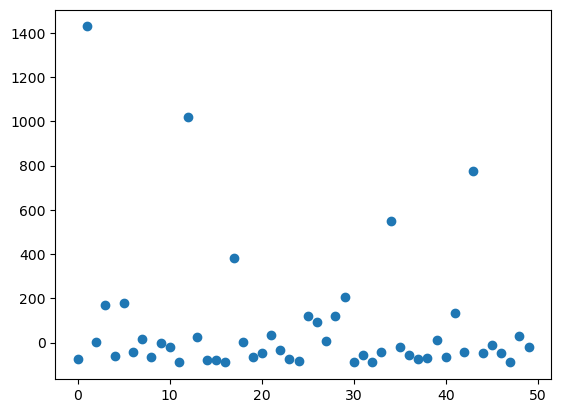

109783.8
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(109783.8, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1584279a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c3f66b0; to 'JaxprTracer' at 0x15c3f57b0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d3507f0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

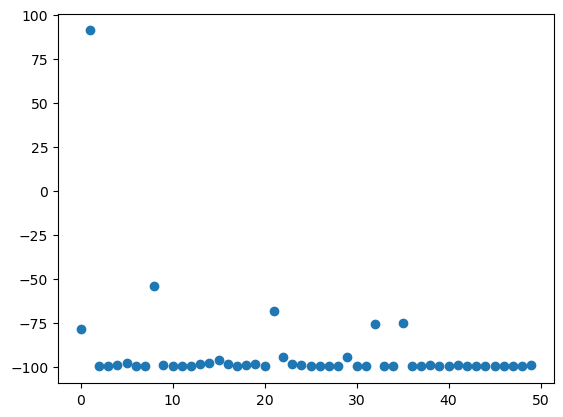

106313.695
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(106313.695, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab51d80>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a582e30; to 'JaxprTracer' at 0x15a582340>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d352ce0>, ctx=JaxprEqnContext(compute_type=None, threef

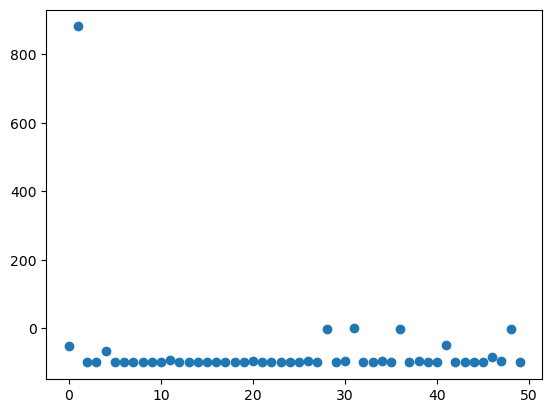

88858.71
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(88858.71, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158426760>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a94ab10; to 'JaxprTracer' at 0x15a94b330>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d3e4a60>, ctx=JaxprEqnContext(compute_type=None, threefry_p

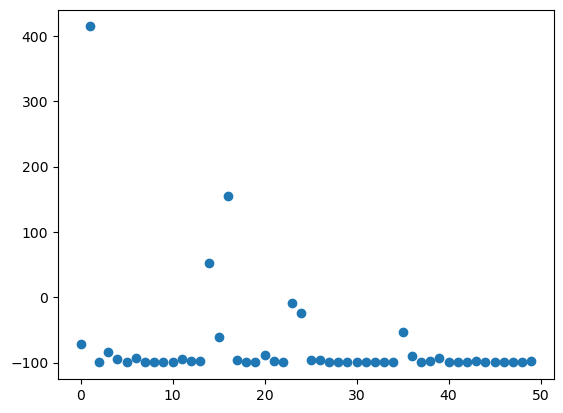

639.6003
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(639.6003, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c685890>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6fe9d0; to 'JaxprTracer' at 0x15c6fe1b0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d3e62c0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

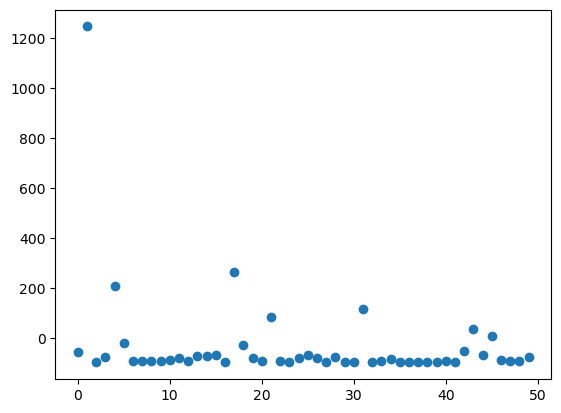

550.91077
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(550.91077, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c685620>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6ff9c0; to 'JaxprTracer' at 0x15c6fe660>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d3e6da0>, ctx=JaxprEqnContext(compute_type=None, threefry

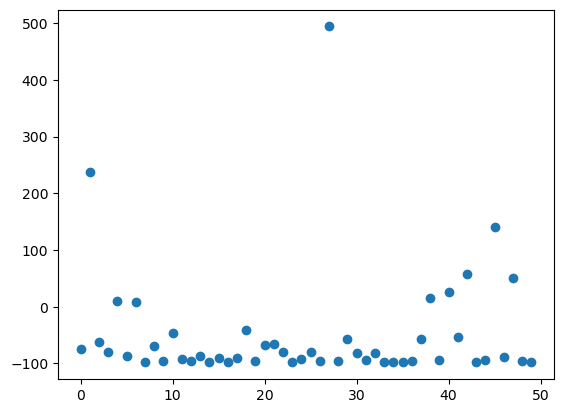

13.53915
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.53915, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c685de0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a8d6110; to 'JaxprTracer' at 0x15a8d5ad0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d39c820>, ctx=JaxprEqnContext(compute_type=None, threefry_p

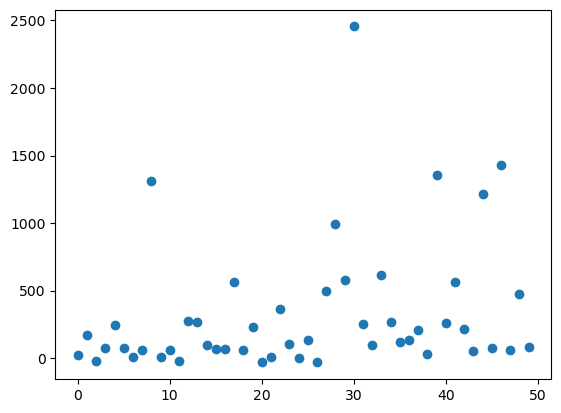

13.344516
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.344516, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c685910>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c38e480; to 'JaxprTracer' at 0x15c38d0d0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d39d300>, ctx=JaxprEqnContext(compute_type=None, threefry

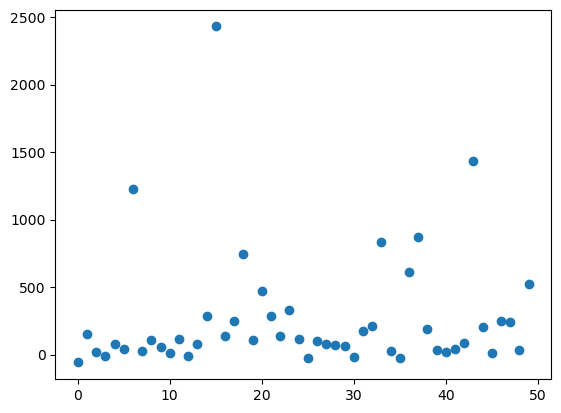

15.0226965
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.0226965, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6842e0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15d3d6890; to 'JaxprTracer' at 0x15d3d6840>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d39ec80>, ctx=JaxprEqnContext(compute_type=None, threef

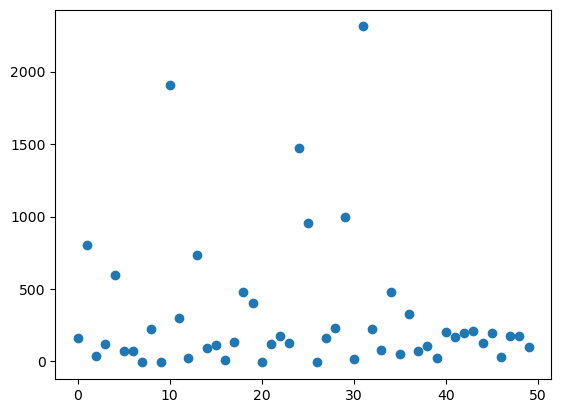

155.51639
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(155.51639, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c686c20>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c3a2660; to 'JaxprTracer' at 0x15c3a04f0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d39f760>, ctx=JaxprEqnContext(compute_type=None, threefry

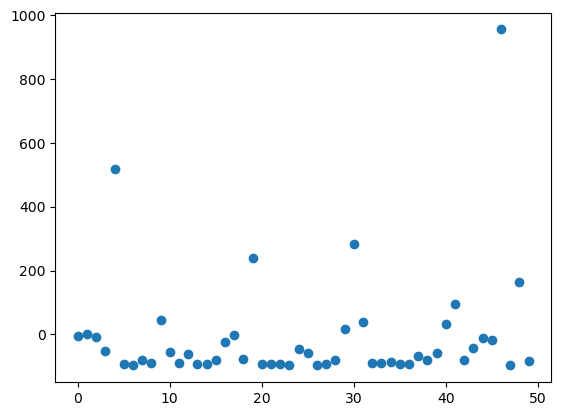

12.071235
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12.071235, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab521f0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6a5850; to 'JaxprTracer' at 0x15c6a6b60>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d351930>, ctx=JaxprEqnContext(compute_type=None, threefry

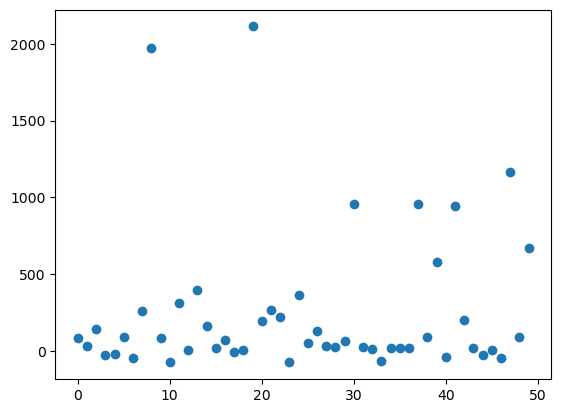

5050.2227
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(5050.2227, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c684910>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab7fb50; to 'JaxprTracer' at 0x15ab7f060>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d39c070>, ctx=JaxprEqnContext(compute_type=None, threefry

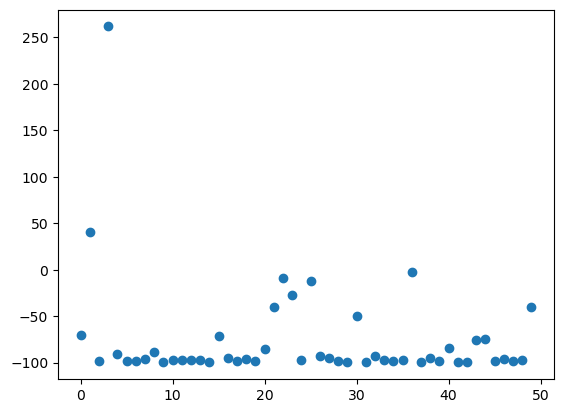

6720.816
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(6720.816, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c684610>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c42b150; to 'JaxprTracer' at 0x15c428450>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d39f010>, ctx=JaxprEqnContext(compute_type=None, threefry_p

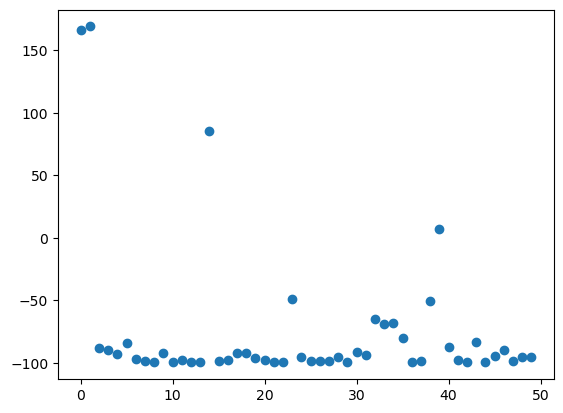

16.81794
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.81794, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c684750>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a8c3d30; to 'JaxprTracer' at 0x15a8c0d60>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d39f9a0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

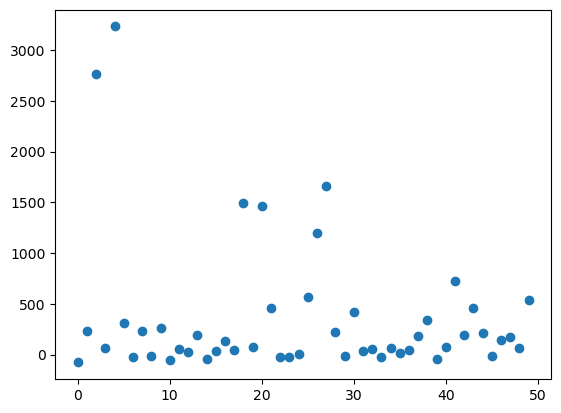

1130.5211
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(1130.5211, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c687280>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a8b93a0; to 'JaxprTracer' at 0x15a8b8450>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d421900>, ctx=JaxprEqnContext(compute_type=None, threefry

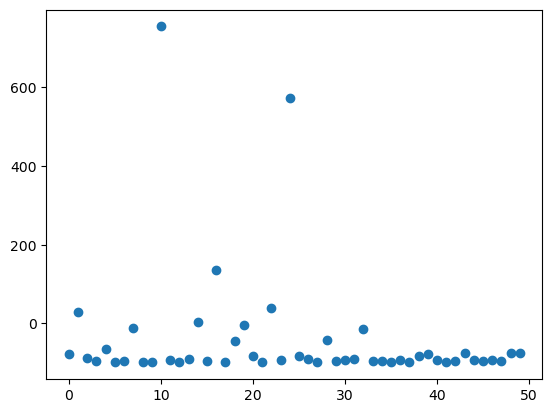

21.928722
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(21.928722, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c684570>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab9d490; to 'JaxprTracer' at 0x15ab9e0c0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d4223e0>, ctx=JaxprEqnContext(compute_type=None, threefry

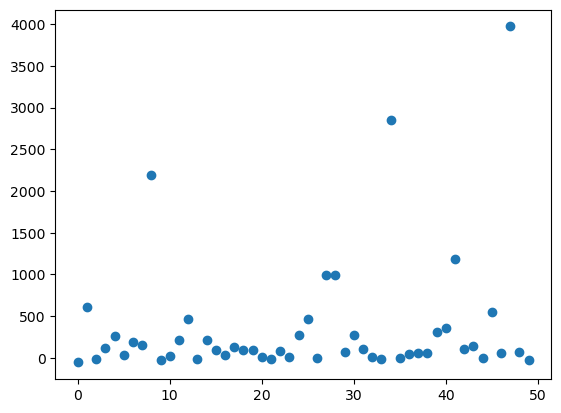

14.383985
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.383985, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c686740>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c12390; to 'JaxprTracer' at 0x162c122f0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d423f10>, ctx=JaxprEqnContext(compute_type=None, threefry

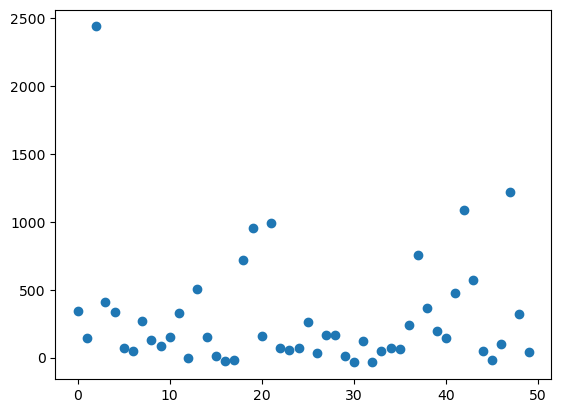

116.406746
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(116.406746, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6851b0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c13c40; to 'JaxprTracer' at 0x162c13ba0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162c40970>, ctx=JaxprEqnContext(compute_type=None, threef

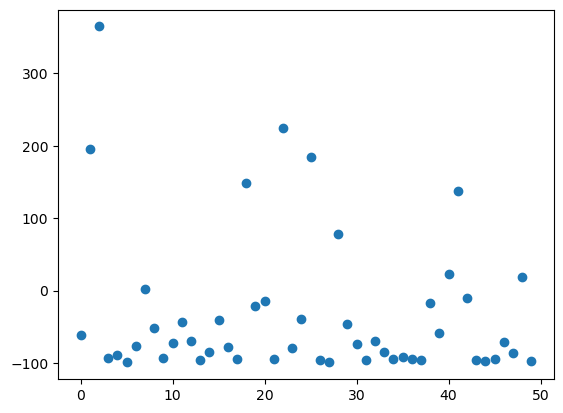

13.263292
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.263292, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6841d0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c46070; to 'JaxprTracer' at 0x162c45fd0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162c41390>, ctx=JaxprEqnContext(compute_type=None, threefry

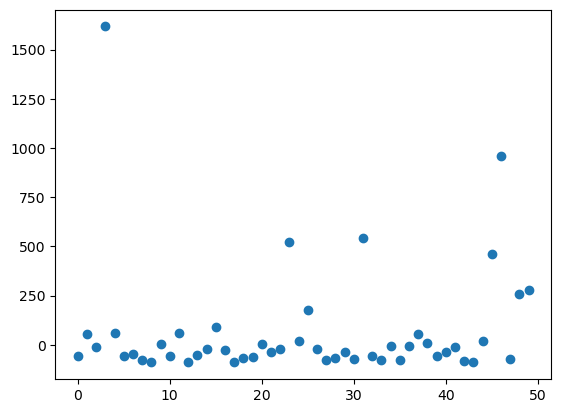

447.42108
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(447.42108, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c687d90>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162ca29d0; to 'JaxprTracer' at 0x162ca2930>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162c42ef0>, ctx=JaxprEqnContext(compute_type=None, threefry

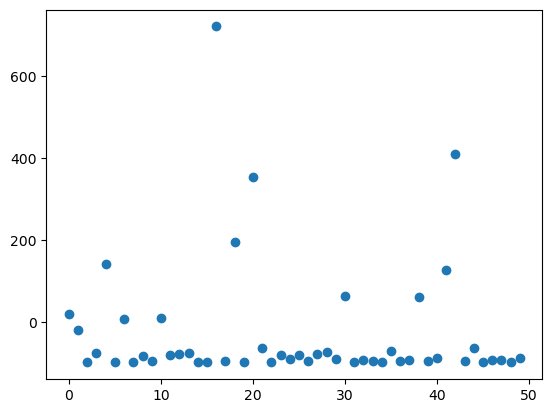

11.536775
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(11.536775, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x162cbc0e0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c90540; to 'JaxprTracer' at 0x162c904a0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162c439d0>, ctx=JaxprEqnContext(compute_type=None, threefry

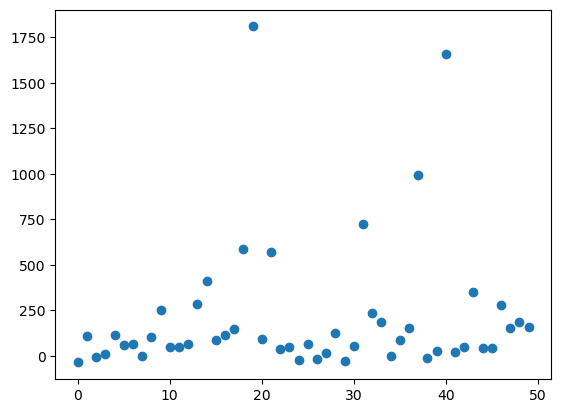

650.25726
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(650.25726, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c684130>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c68dc60; to 'JaxprTracer' at 0x15c68db20>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15aca4310>, ctx=JaxprEqnContext(compute_type=None, threefry

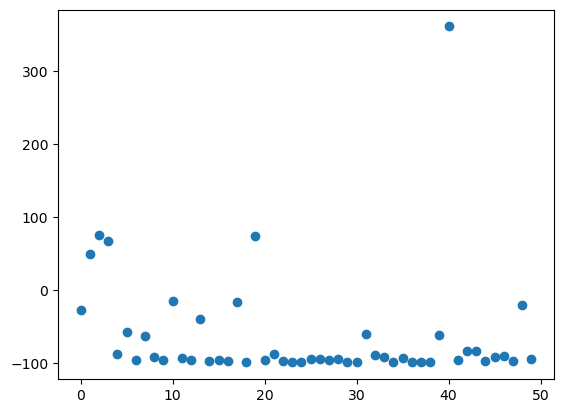

13.274002
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.274002, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c685700>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c104f0; to 'JaxprTracer' at 0x162c11210>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d367580>, ctx=JaxprEqnContext(compute_type=None, threefry

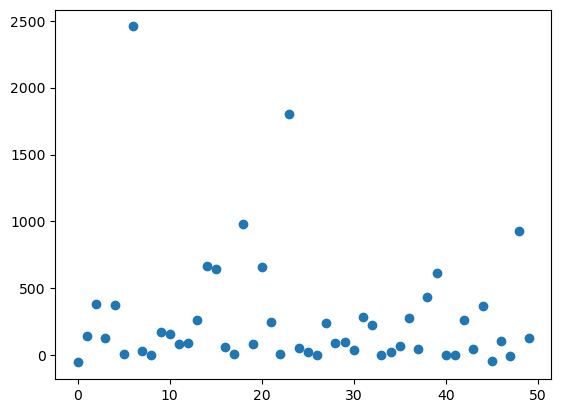

2071.098
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(2071.098, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6859c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15d3d4a40; to 'JaxprTracer' at 0x15d3d7ab0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c463940>, ctx=JaxprEqnContext(compute_type=None, threefry_p

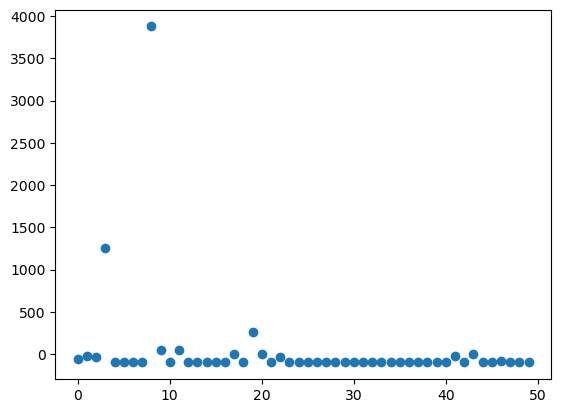

30.738167
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(30.738167, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158426170>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6010d0; to 'JaxprTracer' at 0x15c601ad0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3bd780>, ctx=JaxprEqnContext(compute_type=None, threefry

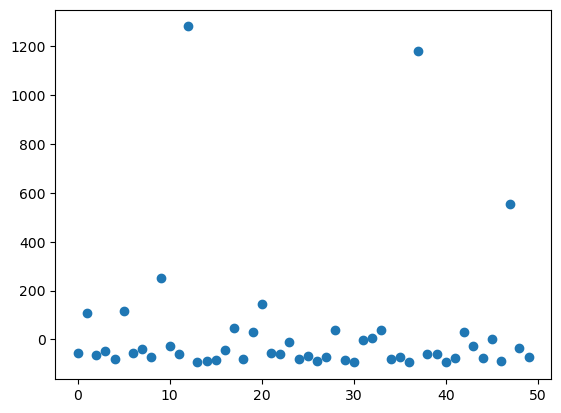

16.617691
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.617691, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158426360>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c38ff60; to 'JaxprTracer' at 0x15c38f9c0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3bfcd0>, ctx=JaxprEqnContext(compute_type=None, threefry

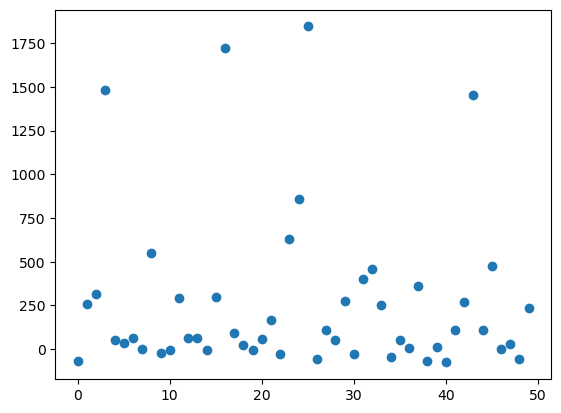

2887.514
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(2887.514, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1584278b0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a5ac450; to 'JaxprTracer' at 0x15a5ae660>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3bc9a0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

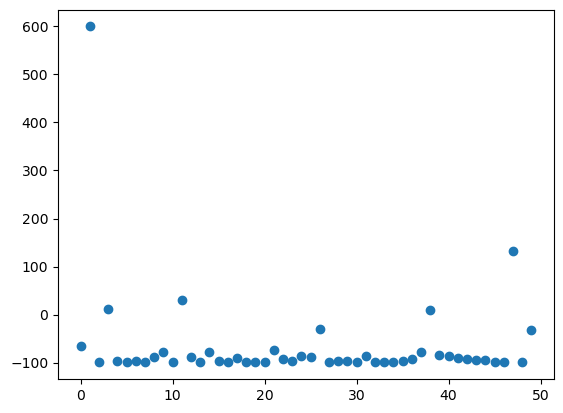

28.042896
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(28.042896, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c686a40>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c46acf0; to 'JaxprTracer' at 0x15c468e00>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1649043d0>, ctx=JaxprEqnContext(compute_type=None, threefry

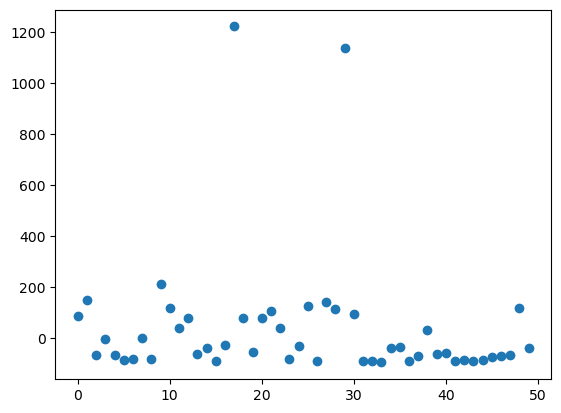

2483.6475
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(2483.6475, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab51950>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c3bafc0; to 'JaxprTracer' at 0x15c3bb830>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164905900>, ctx=JaxprEqnContext(compute_type=None, threefry

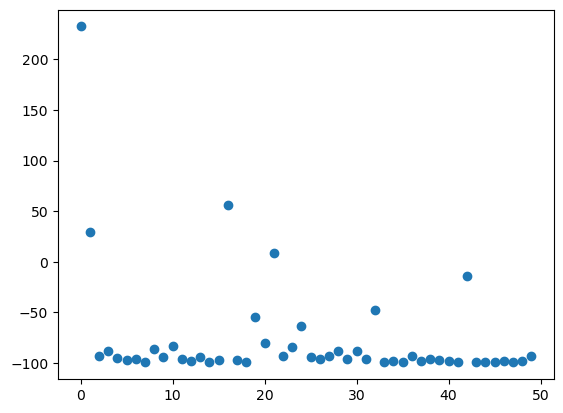

2463.6067
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(2463.6067, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab51260>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6a5620; to 'JaxprTracer' at 0x15c6a4bd0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1649073a0>, ctx=JaxprEqnContext(compute_type=None, threefry

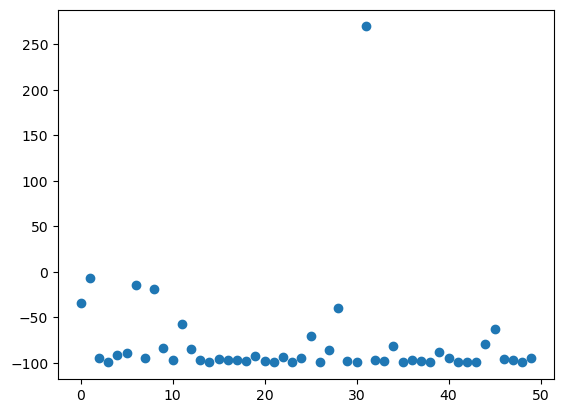

17.989489
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.989489, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab53dc0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a5d6750; to 'JaxprTracer' at 0x15a5d58f0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164907e80>, ctx=JaxprEqnContext(compute_type=None, threefry

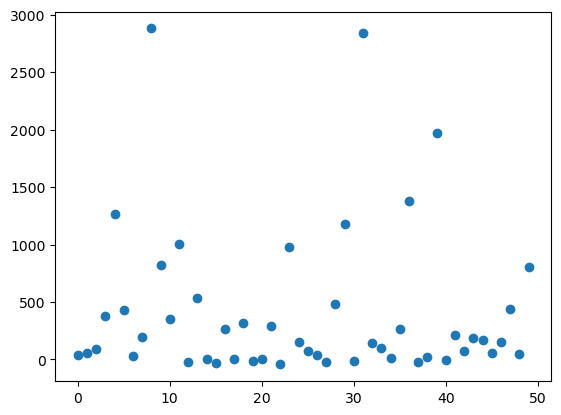

17.216845
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.216845, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab53aa0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a9010d0; to 'JaxprTracer' at 0x15a900c20>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162c95900>, ctx=JaxprEqnContext(compute_type=None, threefry

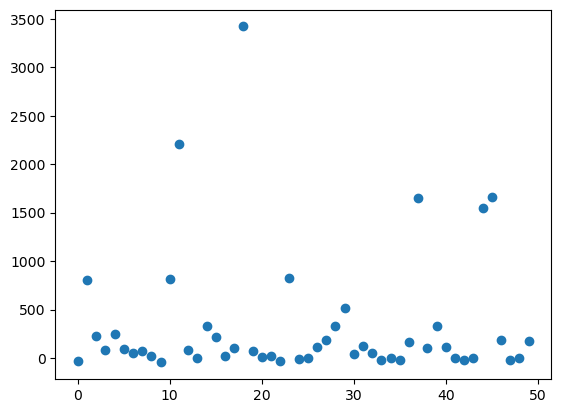

38.214096
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(38.214096, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6845c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x1584ae700; to 'JaxprTracer' at 0x1584ae0c0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162c963e0>, ctx=JaxprEqnContext(compute_type=None, threefry

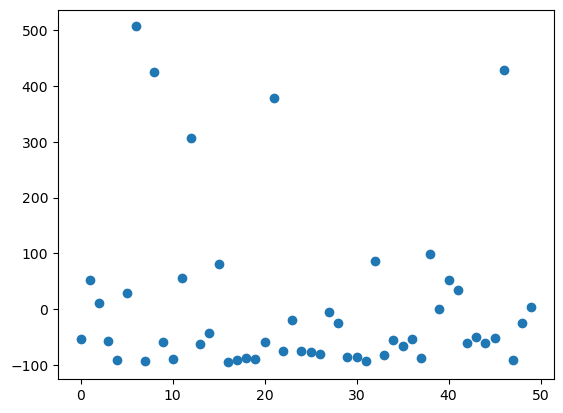

3794.516
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(3794.516, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158425b30>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a948ef0; to 'JaxprTracer' at 0x15a948360>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ab31780>, ctx=JaxprEqnContext(compute_type=None, threefry_p

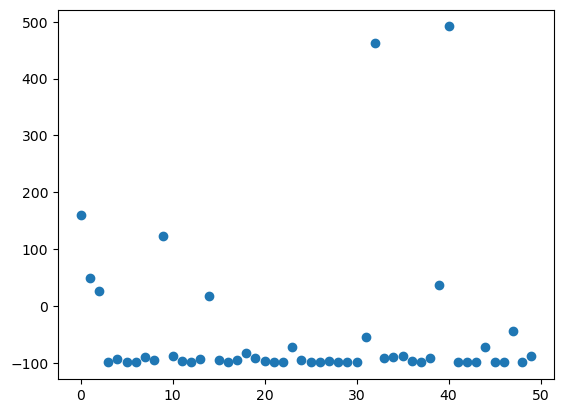

12.068914
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12.068914, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c686060>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a5afd30; to 'JaxprTracer' at 0x15a5ae520>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15d39d6f0>, ctx=JaxprEqnContext(compute_type=None, threefry

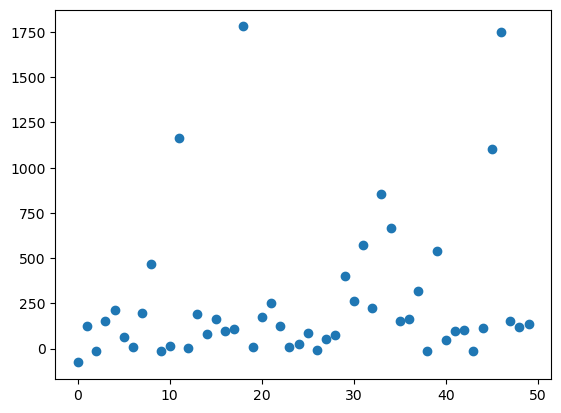

1961.2268
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(1961.2268, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6862a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a8ebbf0; to 'JaxprTracer' at 0x15a8e8040>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162c946a0>, ctx=JaxprEqnContext(compute_type=None, threefry

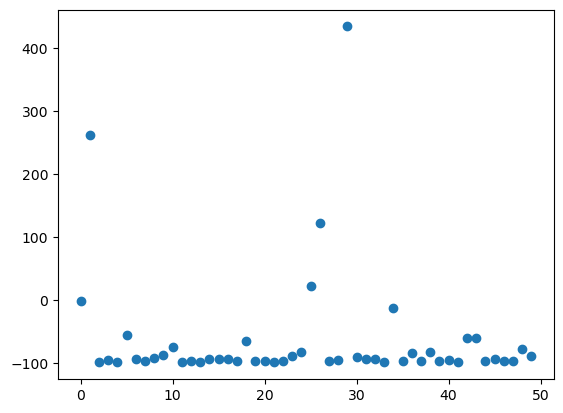

32.447414
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(32.447414, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6875e0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab9cf90; to 'JaxprTracer' at 0x15ab9e480>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162c95930>, ctx=JaxprEqnContext(compute_type=None, threefry

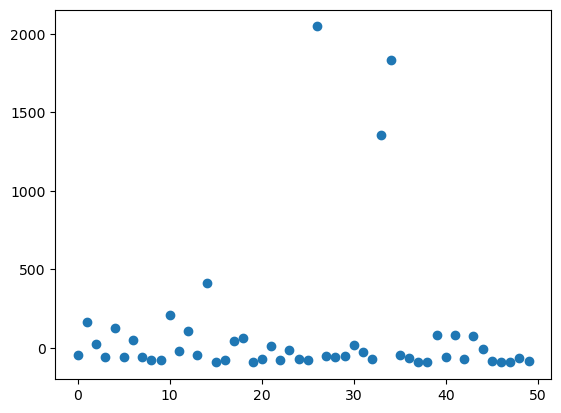

8.655493
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(8.655493, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab535b0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15d3d6980; to 'JaxprTracer' at 0x15d3d71f0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162c970a0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

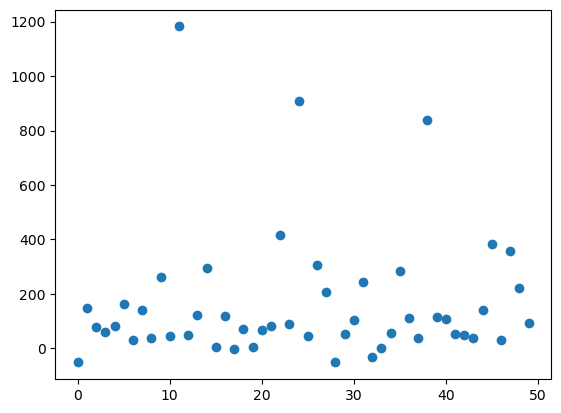

12.745322
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12.745322, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab53aa0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6fc9f0; to 'JaxprTracer' at 0x15c6fe070>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162c97b80>, ctx=JaxprEqnContext(compute_type=None, threefry

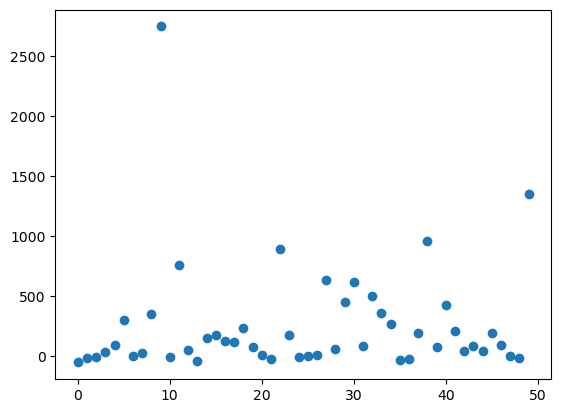

19.902477
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(19.902477, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab508f0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c68fec0; to 'JaxprTracer' at 0x15c68df30>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162cbd540>, ctx=JaxprEqnContext(compute_type=None, threefry

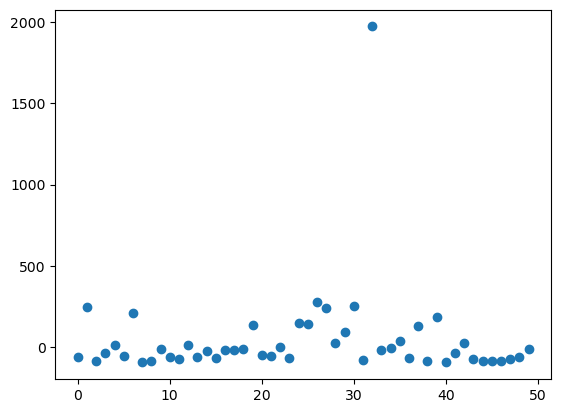

22.742527
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(22.742527, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab53fc0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x1584a4540; to 'JaxprTracer' at 0x1584a5c10>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162cbe020>, ctx=JaxprEqnContext(compute_type=None, threefry

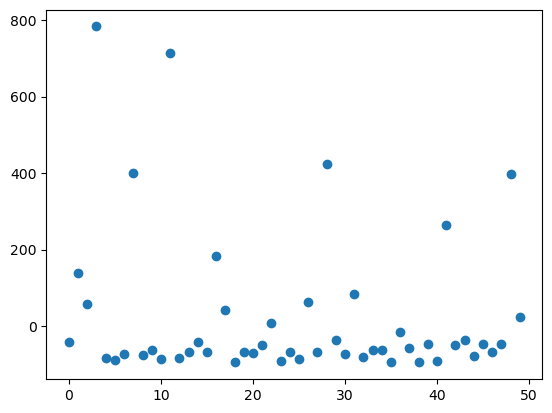

14.095191
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.095191, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab53a60>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab5b970; to 'JaxprTracer' at 0x15ab593a0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162cbf910>, ctx=JaxprEqnContext(compute_type=None, threefry

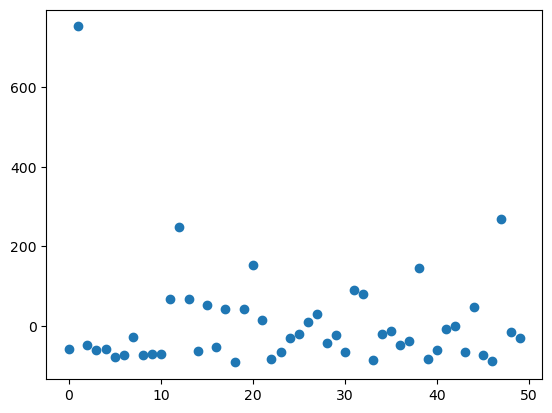

779.9831
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(779.9831, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6840c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab5b100; to 'JaxprTracer' at 0x15ab5a520>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164924370>, ctx=JaxprEqnContext(compute_type=None, threefry_p

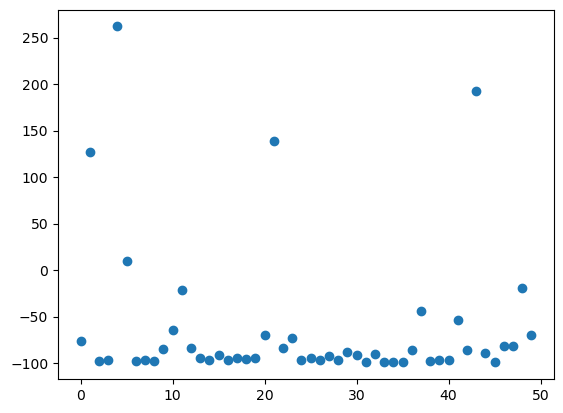

16.08622
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.08622, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164948be0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x16496a9d0; to 'JaxprTracer' at 0x16496a930>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164925ed0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

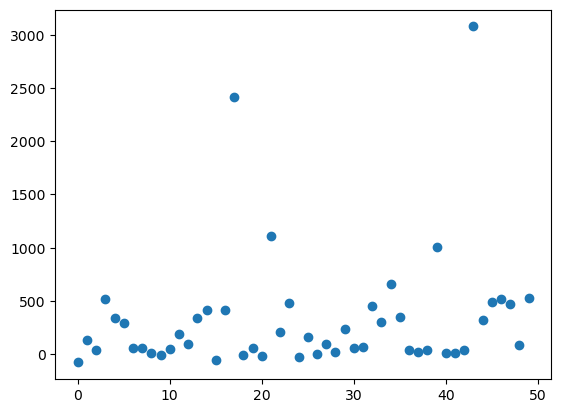

515.843
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(515.843, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164970c80>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164938f40; to 'JaxprTracer' at 0x164938ea0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1649269b0>, ctx=JaxprEqnContext(compute_type=None, threefry_par

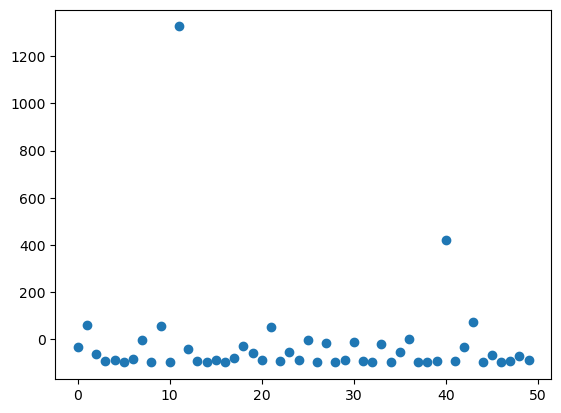

20.208763
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(20.208763, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x16499cd20>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x16493a6b0; to 'JaxprTracer' at 0x16493a610>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1649273d0>, ctx=JaxprEqnContext(compute_type=None, threefry

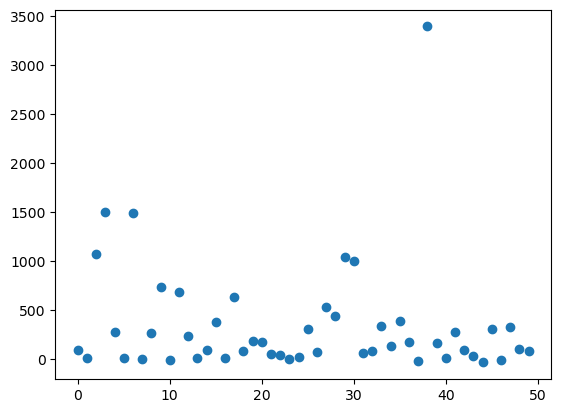

20.765856
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(20.765856, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab518d0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15d3c1850; to 'JaxprTracer' at 0x15d3c2b60>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15ad70e20>, ctx=JaxprEqnContext(compute_type=None, threefry

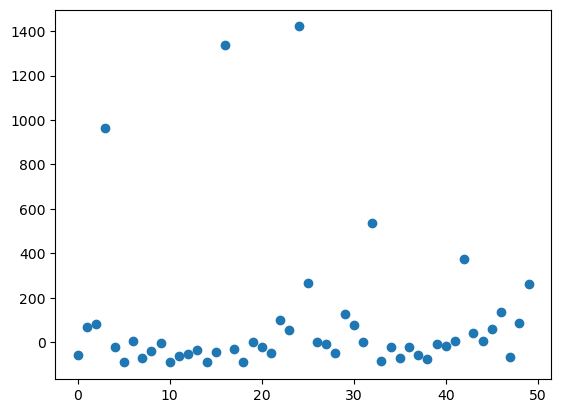

17.535465
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.535465, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c686460>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab5a890; to 'JaxprTracer' at 0x15ab5a7a0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3be530>, ctx=JaxprEqnContext(compute_type=None, threefry

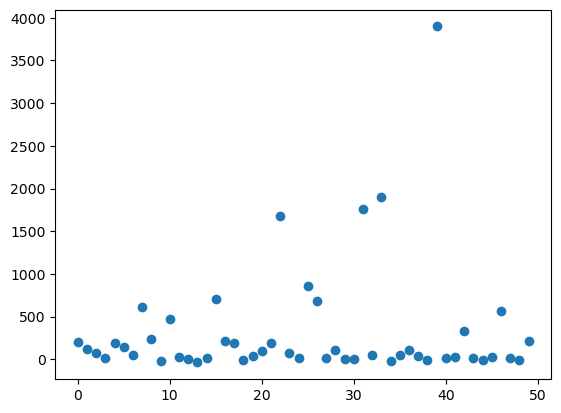

657.1256
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(657.1256, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c685400>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c7eb10; to 'JaxprTracer' at 0x162c7fe70>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3bc4c0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

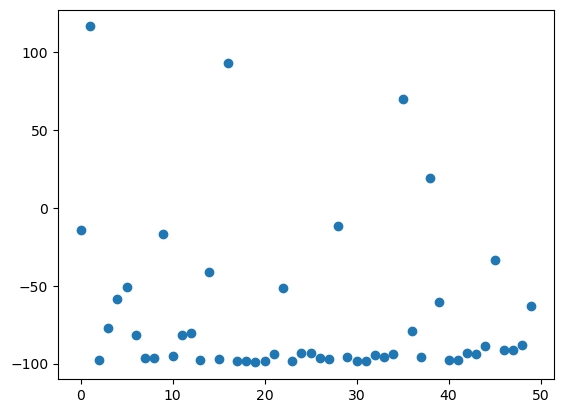

484.14722
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(484.14722, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6868e0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c3f4f90; to 'JaxprTracer' at 0x15c3f44a0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164906d10>, ctx=JaxprEqnContext(compute_type=None, threefry

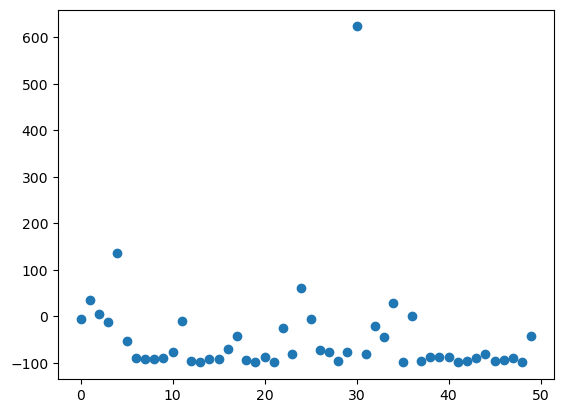

16.348913
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.348913, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c687930>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab7d350; to 'JaxprTracer' at 0x15ab7d710>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1649046a0>, ctx=JaxprEqnContext(compute_type=None, threefry

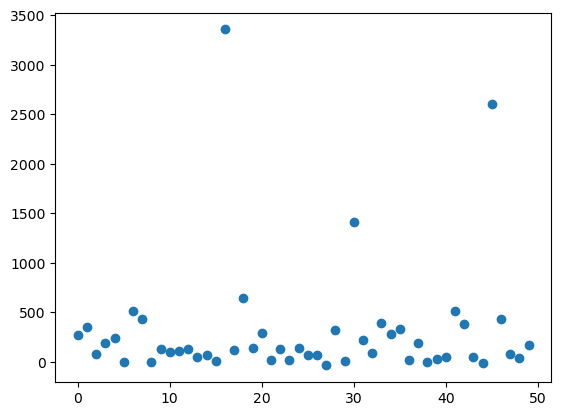

124.92346
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(124.92346, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c685e10>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15d35d8a0; to 'JaxprTracer' at 0x15d35d850>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164904280>, ctx=JaxprEqnContext(compute_type=None, threefry

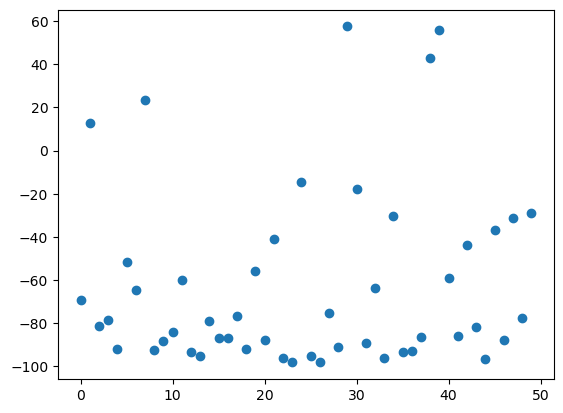

13.027695
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.027695, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158427f70>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a94ae80; to 'JaxprTracer' at 0x15a94a8e0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164ca9b70>, ctx=JaxprEqnContext(compute_type=None, threefry

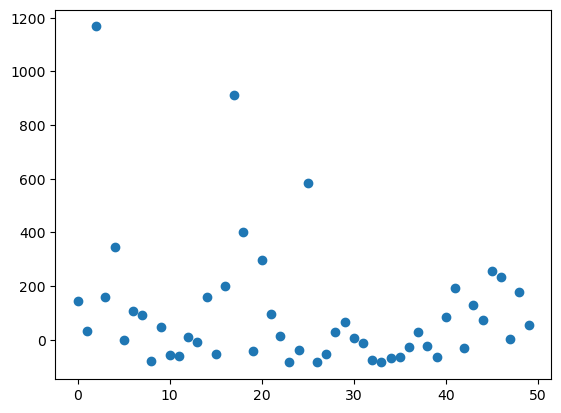

189.0624
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(189.0624, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6860d0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a8eb100; to 'JaxprTracer' at 0x15a8e8db0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164caa740>, ctx=JaxprEqnContext(compute_type=None, threefry_p

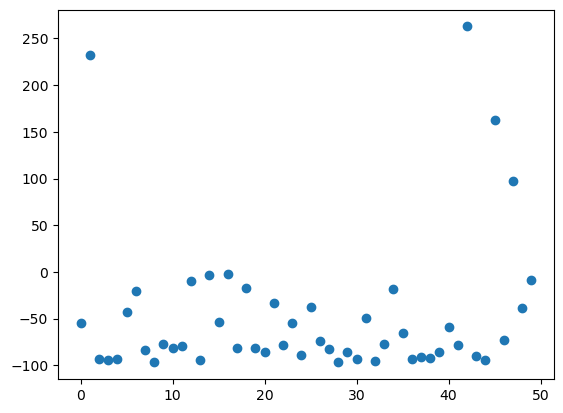

13.590449
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.590449, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1649d4920>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a582200; to 'JaxprTracer' at 0x15a5811c0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164cabee0>, ctx=JaxprEqnContext(compute_type=None, threefry

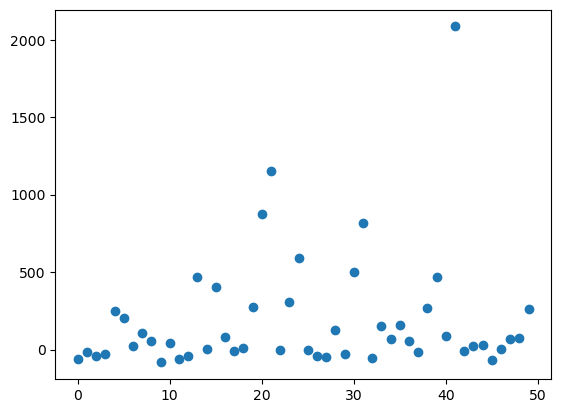

10.662062
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(10.662062, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1649a09c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15849e520; to 'JaxprTracer' at 0x15849dcb0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16499cb80>, ctx=JaxprEqnContext(compute_type=None, threefry

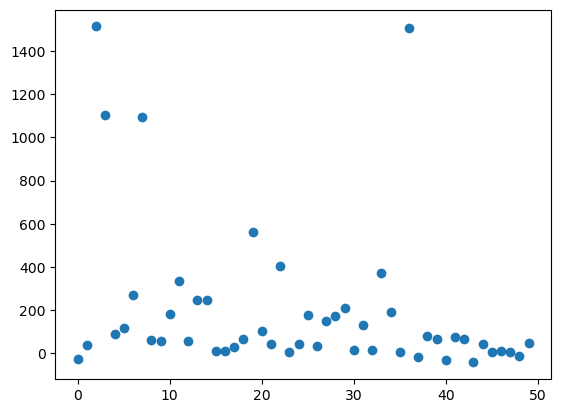

13.954102
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.954102, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1649c97f0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a599d50; to 'JaxprTracer' at 0x15a59afc0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16499e710>, ctx=JaxprEqnContext(compute_type=None, threefry

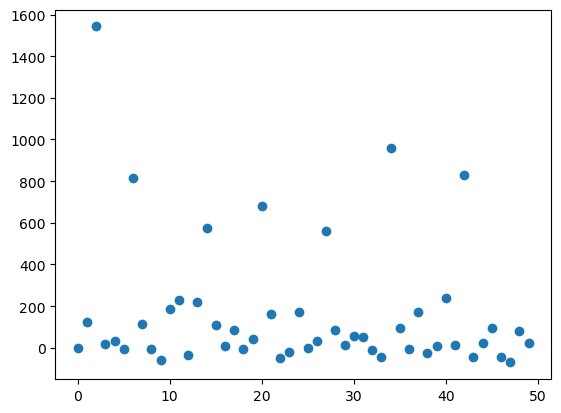

32.00194
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(32.00194, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164cb9890>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x1649fc900; to 'JaxprTracer' at 0x1649fcdb0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16499f1f0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

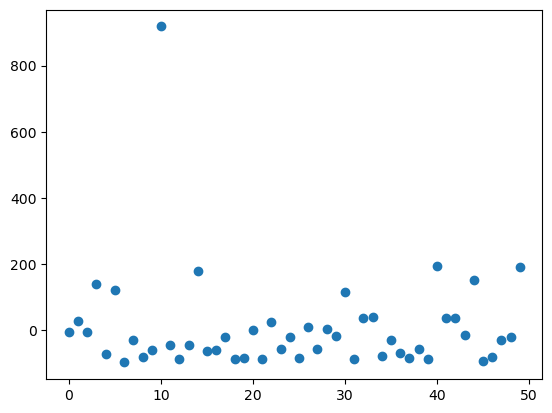

26.658072
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(26.658072, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164cba510>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d34860; to 'JaxprTracer' at 0x164d347c0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d30b20>, ctx=JaxprEqnContext(compute_type=None, threefry

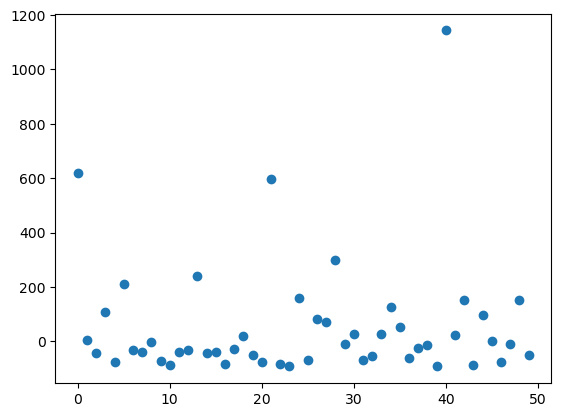

19.338522
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(19.338522, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d5a5b0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d36610; to 'JaxprTracer' at 0x164d36570>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d31600>, ctx=JaxprEqnContext(compute_type=None, threefry

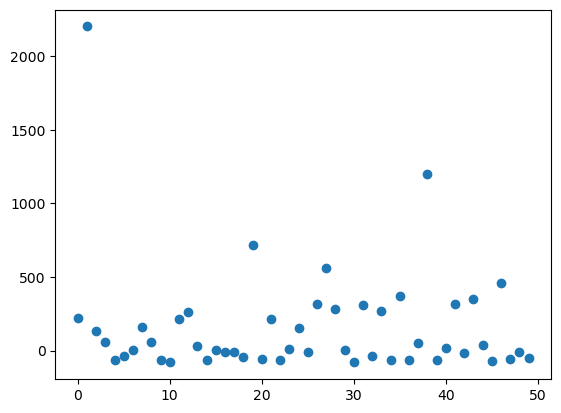

13.131863
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.131863, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c684150>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15d3b4b30; to 'JaxprTracer' at 0x15d3b5e40>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16499fb80>, ctx=JaxprEqnContext(compute_type=None, threefry

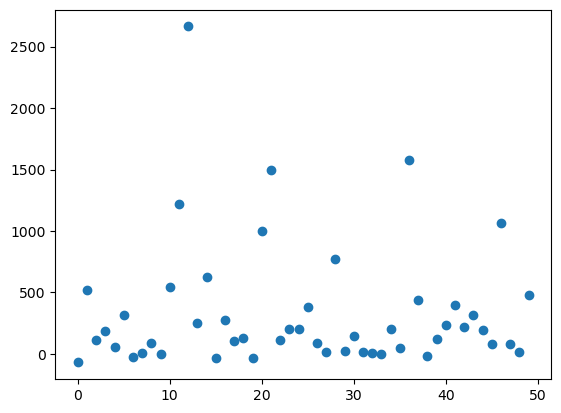

15.375912
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.375912, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6873b0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15abb6840; to 'JaxprTracer' at 0x15abb53f0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164caaa70>, ctx=JaxprEqnContext(compute_type=None, threefry

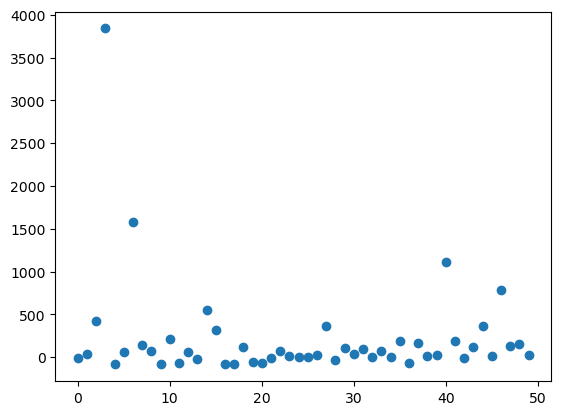

8.636804
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(8.636804, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158426980>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164938a40; to 'JaxprTracer' at 0x164939d50>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164906ce0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

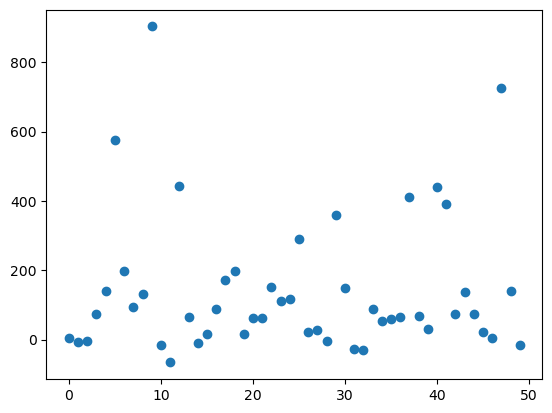

12.541205
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12.541205, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1584276e0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x1649cfc40; to 'JaxprTracer' at 0x1649cc4a0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164905ba0>, ctx=JaxprEqnContext(compute_type=None, threefry

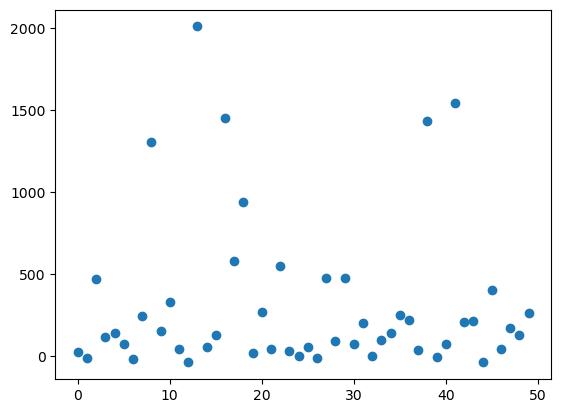

14.921721
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.921721, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158426800>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c6a390; to 'JaxprTracer' at 0x162c69d50>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d30a60>, ctx=JaxprEqnContext(compute_type=None, threefry

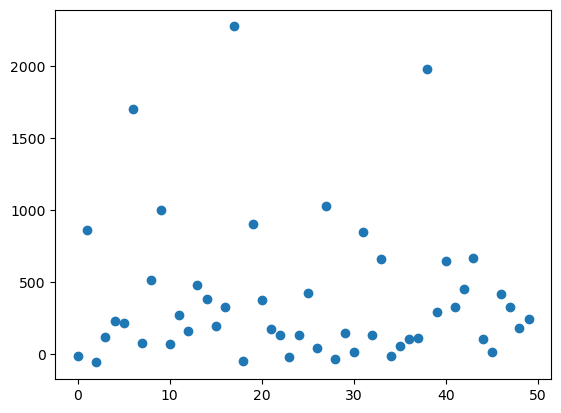

27.630486
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(27.630486, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d780c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a599120; to 'JaxprTracer' at 0x15a598220>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d314b0>, ctx=JaxprEqnContext(compute_type=None, threefry

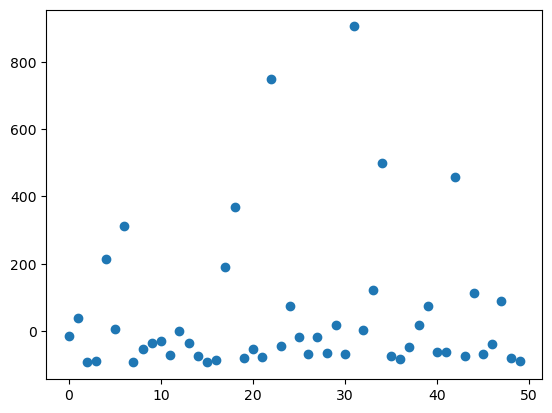

42.537277
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(42.537277, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d58d40>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x1649ff6f0; to 'JaxprTracer' at 0x1649fc2c0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d337f0>, ctx=JaxprEqnContext(compute_type=None, threefry

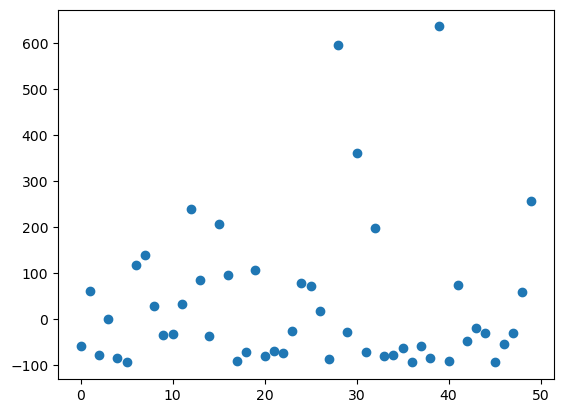

29.155403
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(29.155403, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d78de0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab3b4c0; to 'JaxprTracer' at 0x15ab3a390>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164cc4250>, ctx=JaxprEqnContext(compute_type=None, threefry

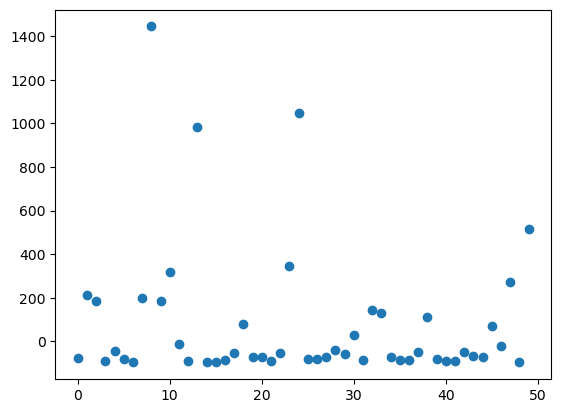

25.166658
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(25.166658, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d18e80>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d0f380; to 'JaxprTracer' at 0x164d0e980>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d50c70>, ctx=JaxprEqnContext(compute_type=None, threefry

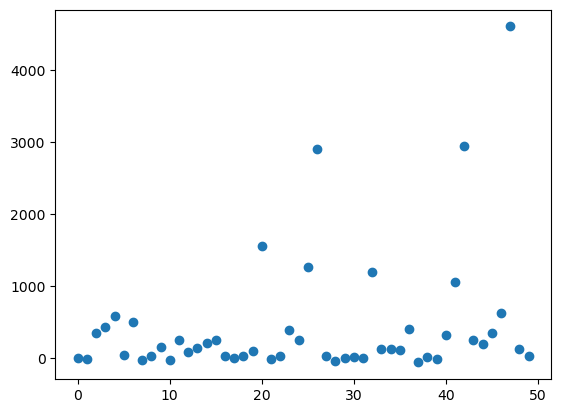

14.787221
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.787221, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164ccdb00>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d357b0; to 'JaxprTracer' at 0x164d36160>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d526b0>, ctx=JaxprEqnContext(compute_type=None, threefry

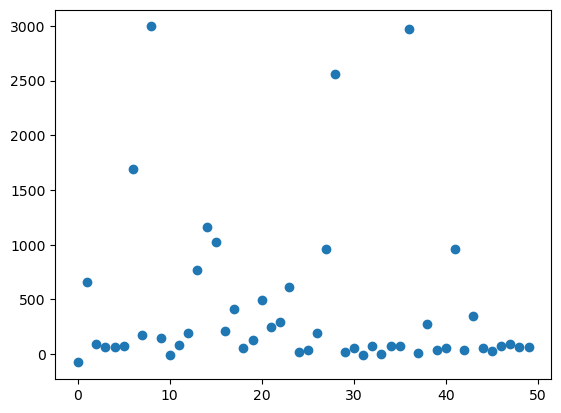

19.280499
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(19.280499, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d65ba0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d36ac0; to 'JaxprTracer' at 0x164d36a20>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d53190>, ctx=JaxprEqnContext(compute_type=None, threefry

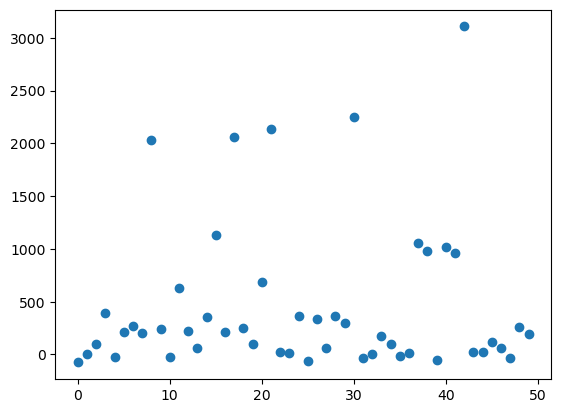

50.67136
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(50.67136, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158426e60>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x13221d440; to 'JaxprTracer' at 0x13221cb80>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c3f0280>, ctx=JaxprEqnContext(compute_type=None, threefry_p

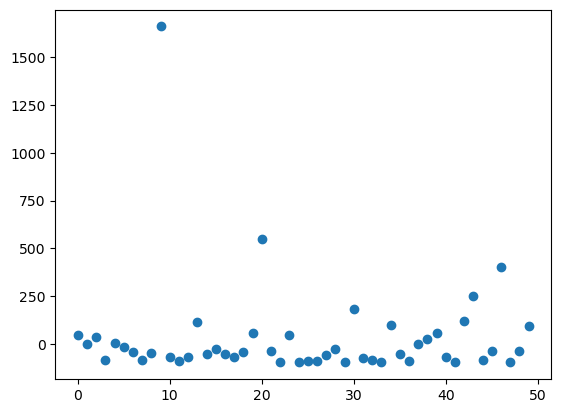

9.133767
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(9.133767, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c686d20>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab5a3e0; to 'JaxprTracer' at 0x15ab5a7f0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162cbf310>, ctx=JaxprEqnContext(compute_type=None, threefry_p

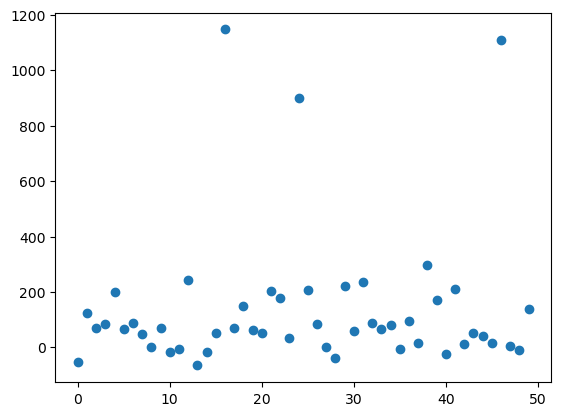

16.504753
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.504753, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c687090>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c3a1da0; to 'JaxprTracer' at 0x15c3a1210>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162cbf2b0>, ctx=JaxprEqnContext(compute_type=None, threefry

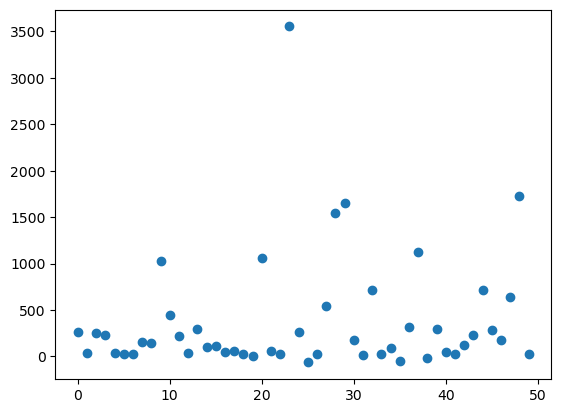

24.10341
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(24.10341, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c687e50>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a8d5da0; to 'JaxprTracer' at 0x15a8d7330>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162c43820>, ctx=JaxprEqnContext(compute_type=None, threefry_p

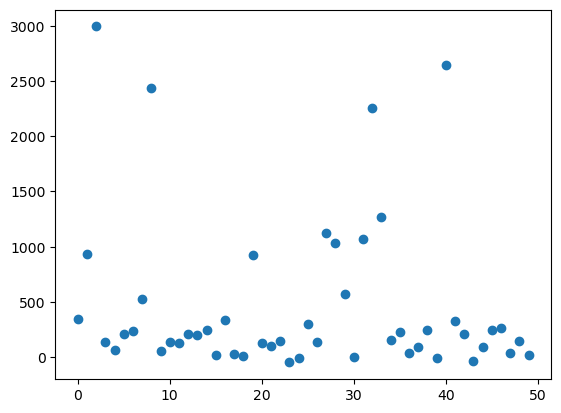

14.27626
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.27626, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6867a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x1649cc4f0; to 'JaxprTracer' at 0x1649cc680>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162c413f0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

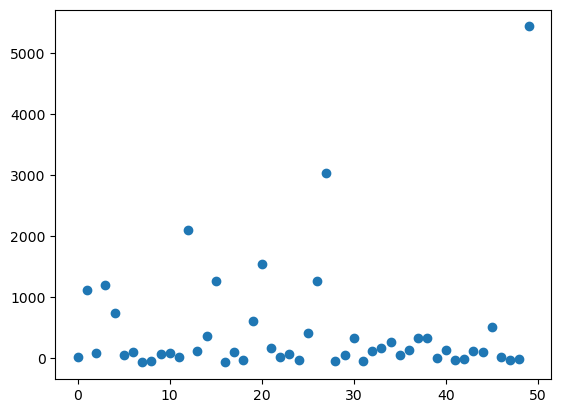

70.07572
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(70.07572, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6855d0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6ff1a0; to 'JaxprTracer' at 0x15c6fc360>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15a8e40d0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

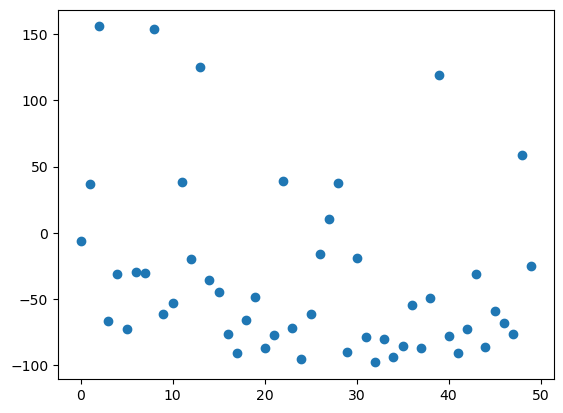

14.843838
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.843838, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c686590>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ad0db20; to 'JaxprTracer' at 0x15ad0ec00>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d98700>, ctx=JaxprEqnContext(compute_type=None, threefry

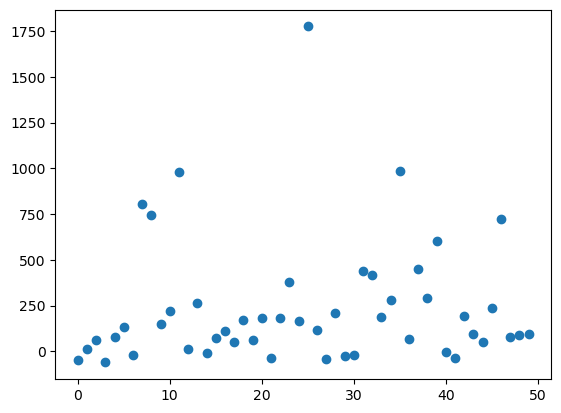

12.8899145
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12.8899145, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d64a90>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab6d080; to 'JaxprTracer' at 0x15ab6fd80>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d9a440>, ctx=JaxprEqnContext(compute_type=None, threef

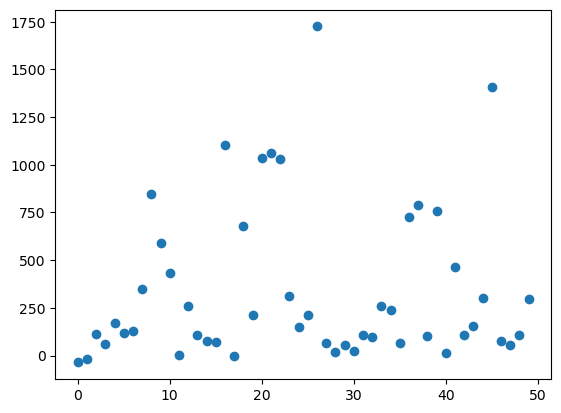

15.020975
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.020975, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d68b30>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ac96de0; to 'JaxprTracer' at 0x15ac941d0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d9ae60>, ctx=JaxprEqnContext(compute_type=None, threefry

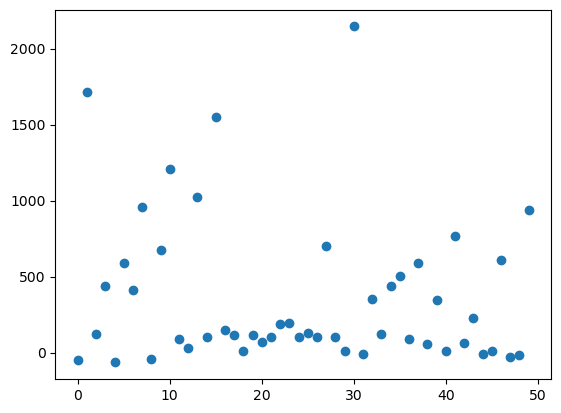

11.580467
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(11.580467, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d68bd0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x1649e4220; to 'JaxprTracer' at 0x1649e4e00>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d9ac80>, ctx=JaxprEqnContext(compute_type=None, threefry

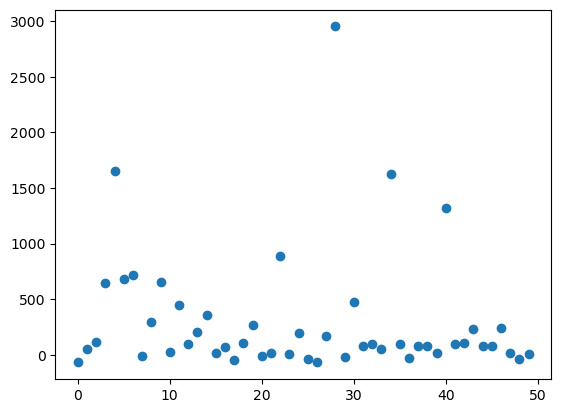

14.683205
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.683205, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d61970>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15849e660; to 'JaxprTracer' at 0x15849ea70>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d95420>, ctx=JaxprEqnContext(compute_type=None, threefry

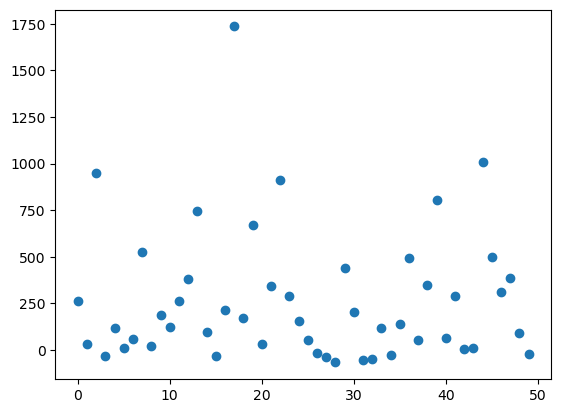

10.140349
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(10.140349, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d65a10>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x1584af380; to 'JaxprTracer' at 0x1584aca90>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d95f00>, ctx=JaxprEqnContext(compute_type=None, threefry

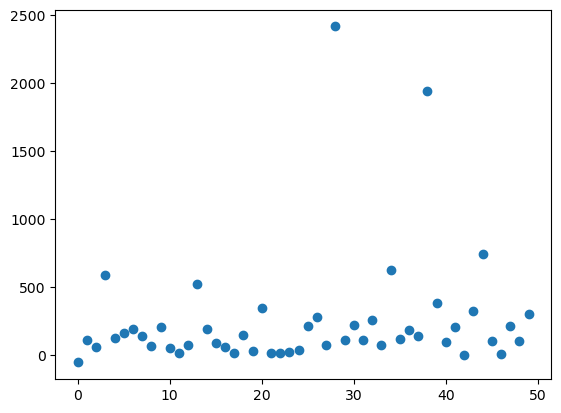

30.487448
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(30.487448, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d66720>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d8ebb0; to 'JaxprTracer' at 0x164d8eb10>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d978b0>, ctx=JaxprEqnContext(compute_type=None, threefry

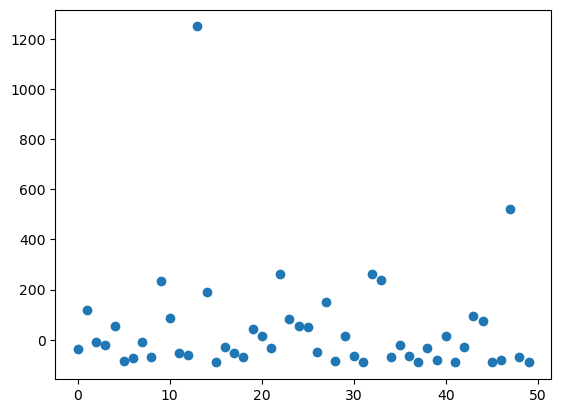

17.445694
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.445694, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d64da0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x165c08d60; to 'JaxprTracer' at 0x165c08cc0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c2c310>, ctx=JaxprEqnContext(compute_type=None, threefry

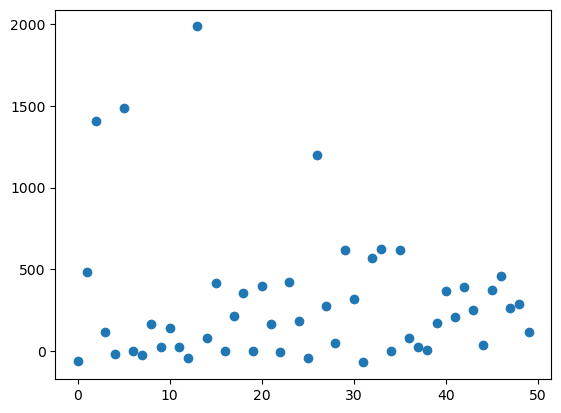

23.699665
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(23.699665, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c684c10>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d01260; to 'JaxprTracer' at 0x164d01df0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d95090>, ctx=JaxprEqnContext(compute_type=None, threefry

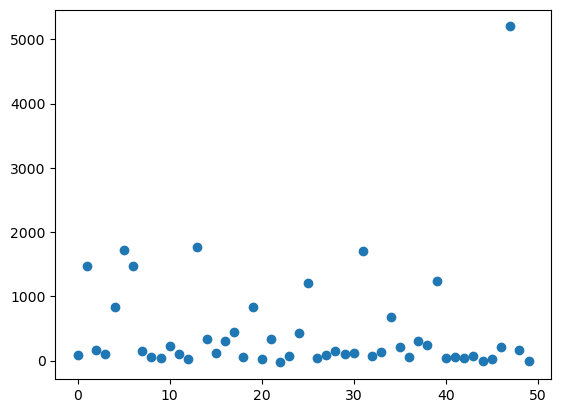

17.861753
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.861753, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c686460>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d0eb60; to 'JaxprTracer' at 0x164d0c4a0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d9bee0>, ctx=JaxprEqnContext(compute_type=None, threefry

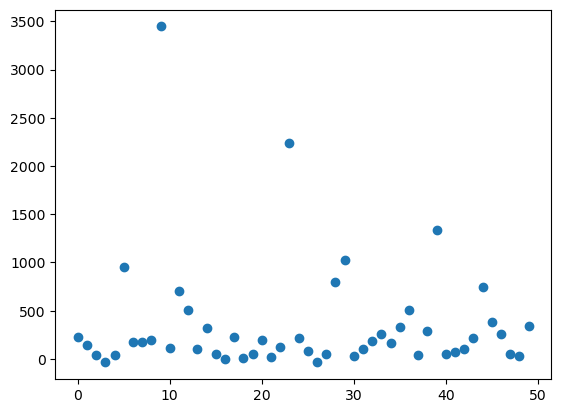

21.620993
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(21.620993, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d64450>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c68c2c0; to 'JaxprTracer' at 0x15c68c860>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d987c0>, ctx=JaxprEqnContext(compute_type=None, threefry

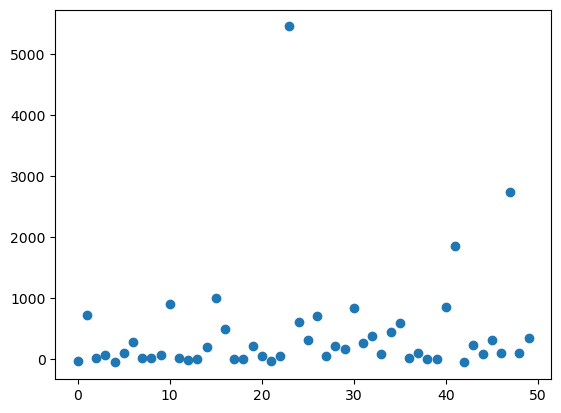

10.130722
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(10.130722, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d669c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c806d0; to 'JaxprTracer' at 0x162c810d0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d99ea0>, ctx=JaxprEqnContext(compute_type=None, threefry

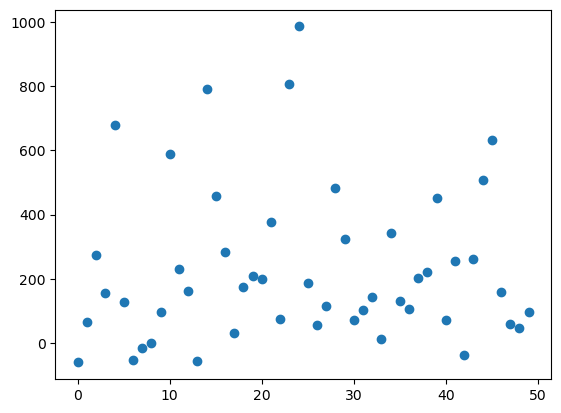

19.506657
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(19.506657, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d66480>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6a4e50; to 'JaxprTracer' at 0x15c6a4ea0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c11120>, ctx=JaxprEqnContext(compute_type=None, threefry

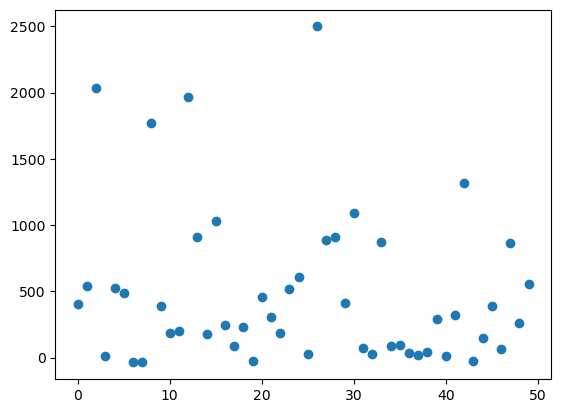

15.303631
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.303631, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d66a40>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d12480; to 'JaxprTracer' at 0x164d12980>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c11c00>, ctx=JaxprEqnContext(compute_type=None, threefry

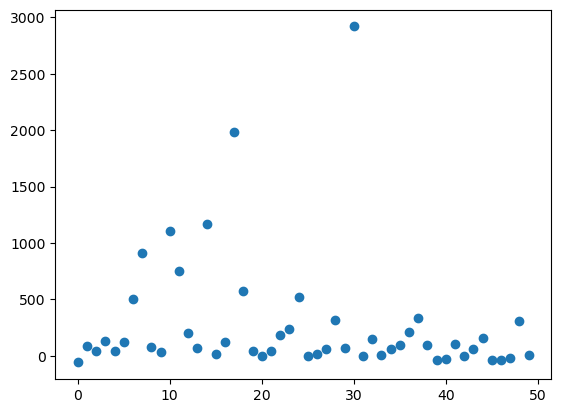

28.152786
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(28.152786, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d640c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15d35d8f0; to 'JaxprTracer' at 0x15d35ee30>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c13640>, ctx=JaxprEqnContext(compute_type=None, threefry

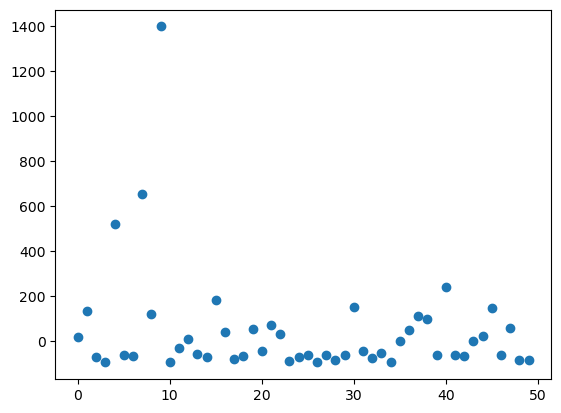

43.52975
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(43.52975, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d66e60>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c67b2e0; to 'JaxprTracer' at 0x15c678220>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c13520>, ctx=JaxprEqnContext(compute_type=None, threefry_p

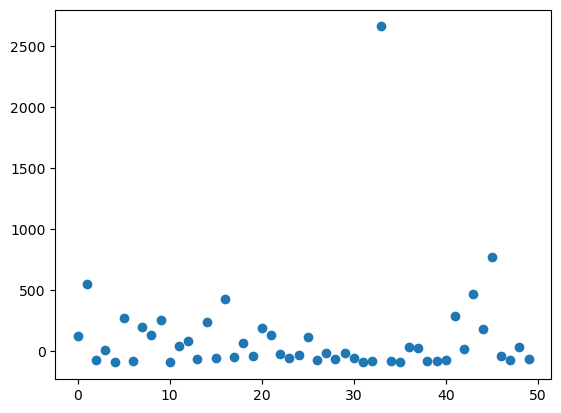

26.114265
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(26.114265, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d65b30>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c47380; to 'JaxprTracer' at 0x162c452b0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c15ae0>, ctx=JaxprEqnContext(compute_type=None, threefry

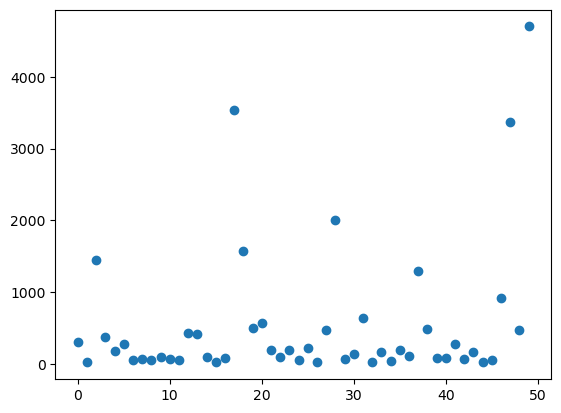

17.479082
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.479082, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d651a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c47a60; to 'JaxprTracer' at 0x162c444a0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c165c0>, ctx=JaxprEqnContext(compute_type=None, threefry

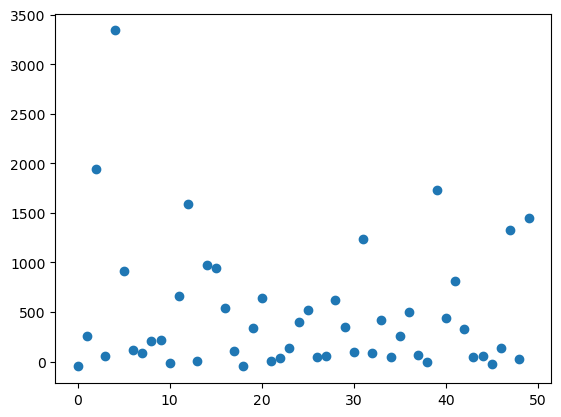

23.910624
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(23.910624, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d66180>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x165c31800; to 'JaxprTracer' at 0x165c31760>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c16fe0>, ctx=JaxprEqnContext(compute_type=None, threefry

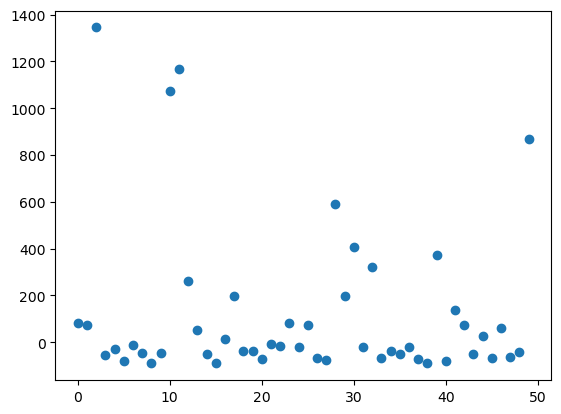

19.454926
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(19.454926, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d67a00>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x165c9eb60; to 'JaxprTracer' at 0x165c9eac0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165cacb50>, ctx=JaxprEqnContext(compute_type=None, threefry

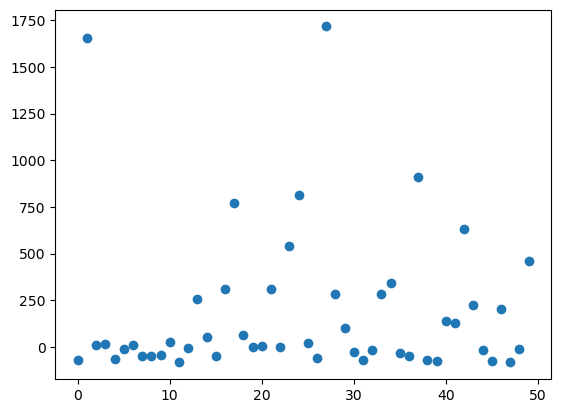

11.888071
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(11.888071, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c687be0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15d35d5d0; to 'JaxprTracer' at 0x15d35fa10>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d52f20>, ctx=JaxprEqnContext(compute_type=None, threefry

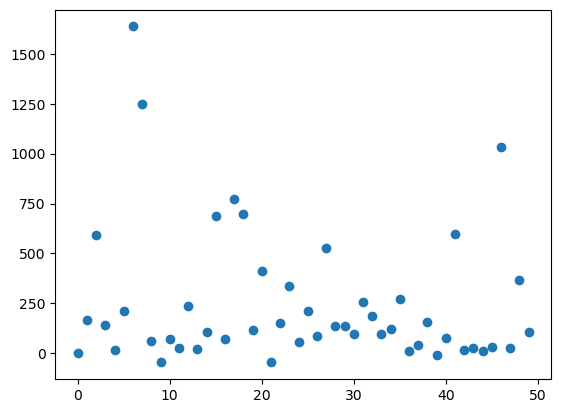

26.013155
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(26.013155, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6879f0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d34c20; to 'JaxprTracer' at 0x164d35300>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d52380>, ctx=JaxprEqnContext(compute_type=None, threefry

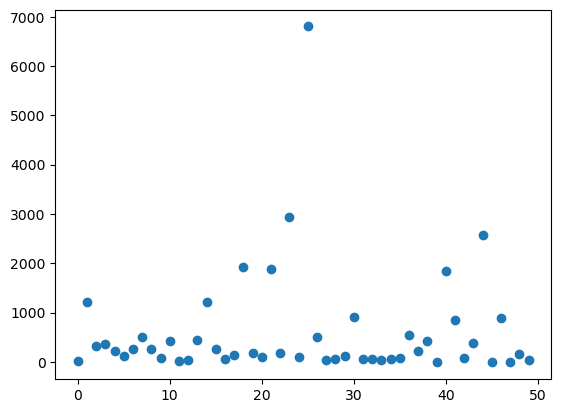

13.967597
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.967597, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c685990>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c80d10; to 'JaxprTracer' at 0x162c815d0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d335b0>, ctx=JaxprEqnContext(compute_type=None, threefry

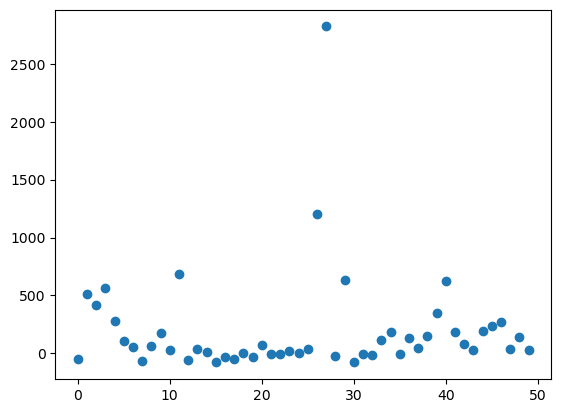

17.225277
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.225277, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6848c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ad4cea0; to 'JaxprTracer' at 0x15ad4ee80>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x164d302e0>, ctx=JaxprEqnContext(compute_type=None, threefry

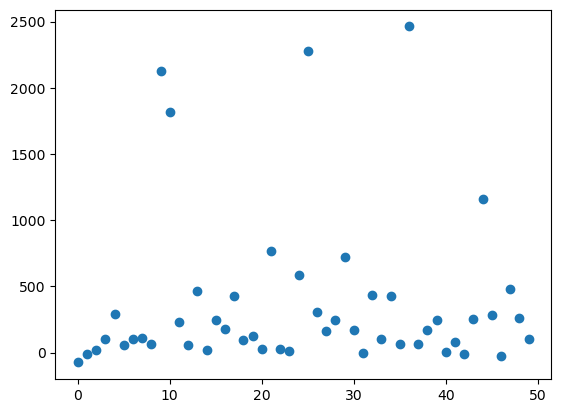

11.532329
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(11.532329, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d656a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a8d6430; to 'JaxprTracer' at 0x15a8d7100>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c677a60>, ctx=JaxprEqnContext(compute_type=None, threefry

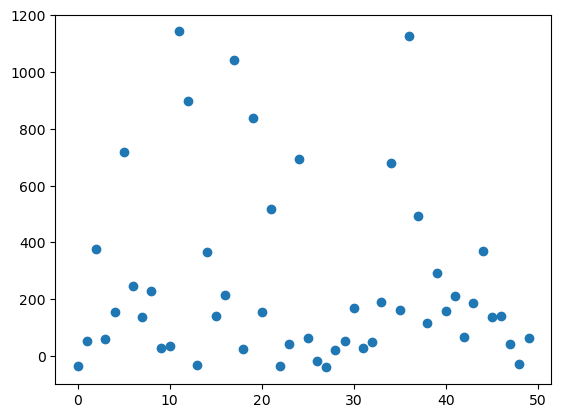

14.804982
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.804982, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d656a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab388b0; to 'JaxprTracer' at 0x15ab3aed0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c676cb0>, ctx=JaxprEqnContext(compute_type=None, threefry

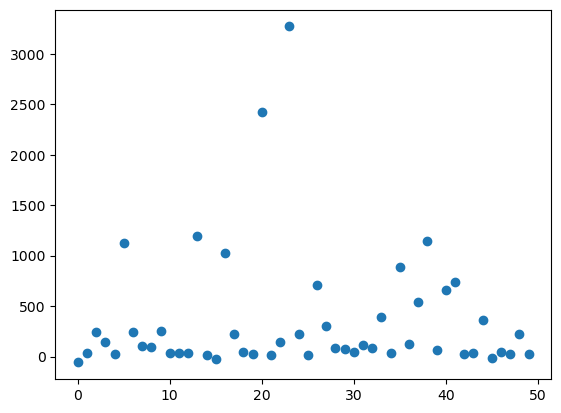

13.776563
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.776563, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d65c60>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c7c540; to 'JaxprTracer' at 0x162c7fa10>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165cae1d0>, ctx=JaxprEqnContext(compute_type=None, threefry

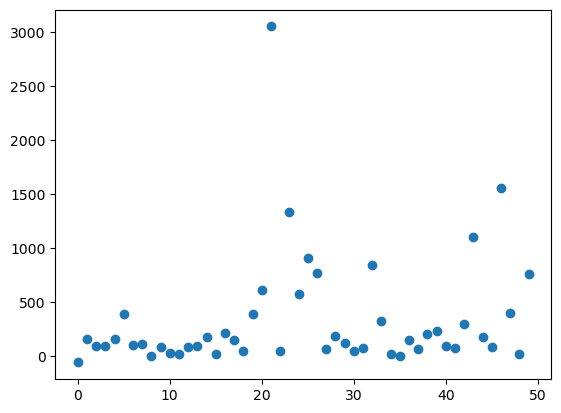

11.983969
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(11.983969, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d64610>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162cd3d80; to 'JaxprTracer' at 0x162cd1490>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165caecb0>, ctx=JaxprEqnContext(compute_type=None, threefry

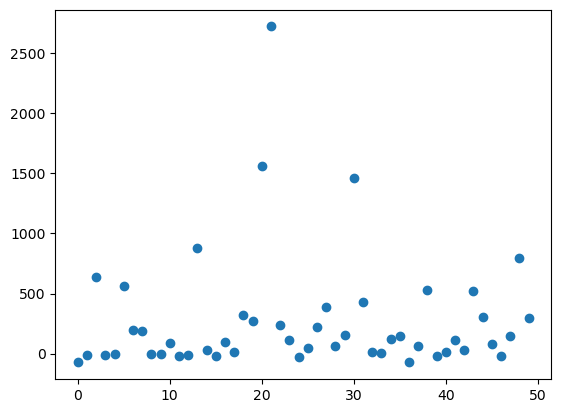

19.26929
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(19.26929, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d66c50>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162cd3830; to 'JaxprTracer' at 0x162cd2570>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165caf6d0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

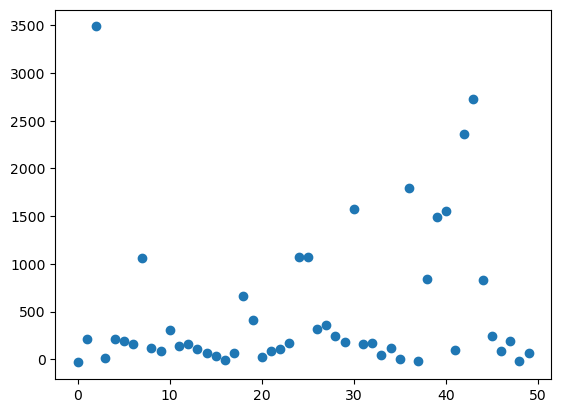

9.84773
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(9.84773, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d66300>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a5c1850; to 'JaxprTracer' at 0x15a5c23e0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c011e0>, ctx=JaxprEqnContext(compute_type=None, threefry_par

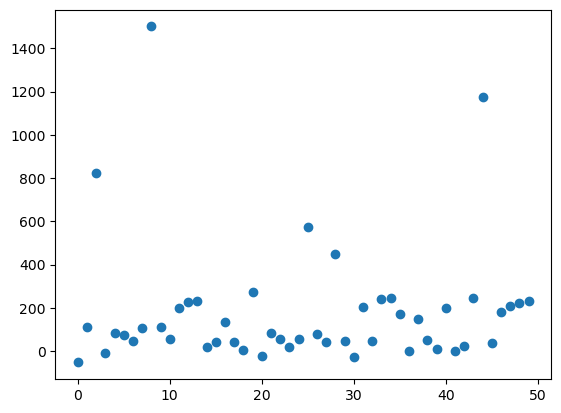

15.222708
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.222708, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d66670>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a5d4b30; to 'JaxprTracer' at 0x15a5d58f0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c01cc0>, ctx=JaxprEqnContext(compute_type=None, threefry

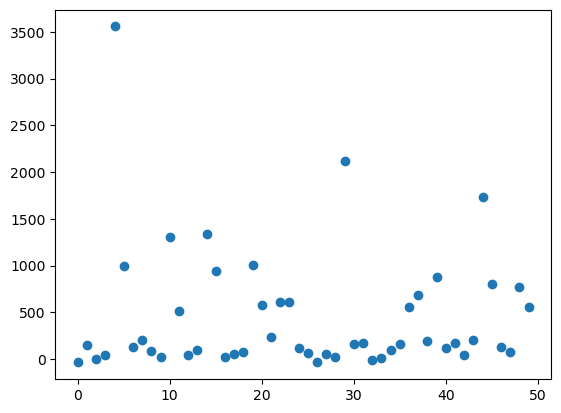

13.218441
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.218441, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d645a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c46340; to 'JaxprTracer' at 0x162c461b0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c03760>, ctx=JaxprEqnContext(compute_type=None, threefry

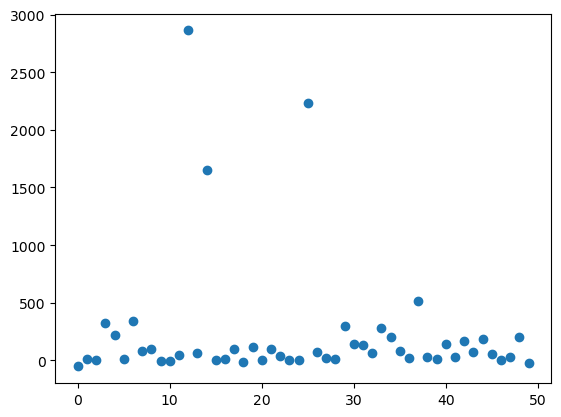

15.009317
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.009317, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d64c80>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d0fce0; to 'JaxprTracer' at 0x164d0c360>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165cc41f0>, ctx=JaxprEqnContext(compute_type=None, threefry

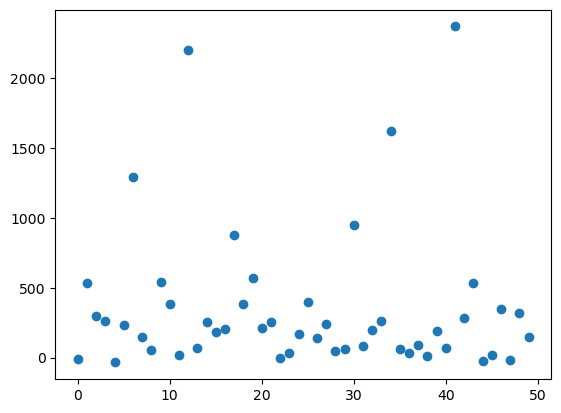

17.464413
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.464413, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c686f80>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d8dcb0; to 'JaxprTracer' at 0x164d8d8a0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c01990>, ctx=JaxprEqnContext(compute_type=None, threefry

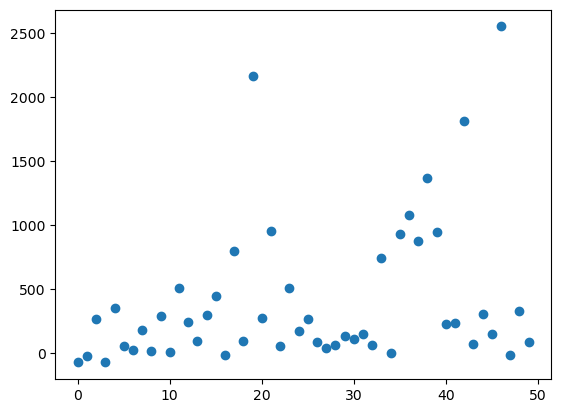

18.744331
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(18.744331, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d666d0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c12de0; to 'JaxprTracer' at 0x162c13290>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165cafac0>, ctx=JaxprEqnContext(compute_type=None, threefry

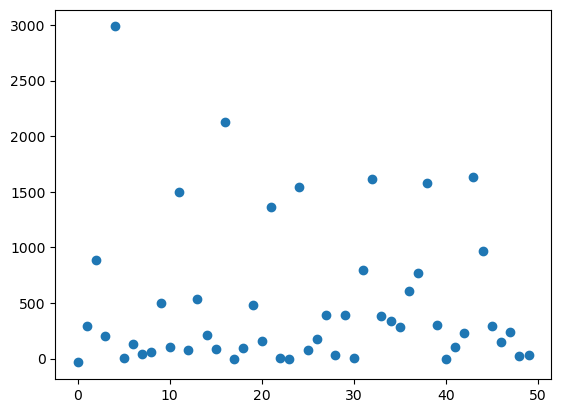

10.106579
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(10.106579, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d65bd0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x165c1eed0; to 'JaxprTracer' at 0x165c1df30>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165caebf0>, ctx=JaxprEqnContext(compute_type=None, threefry

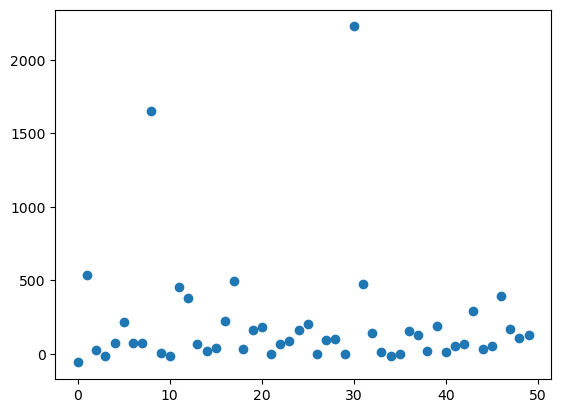

14.651524
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.651524, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d665d0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15d35e0c0; to 'JaxprTracer' at 0x15d35ec50>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165cae140>, ctx=JaxprEqnContext(compute_type=None, threefry

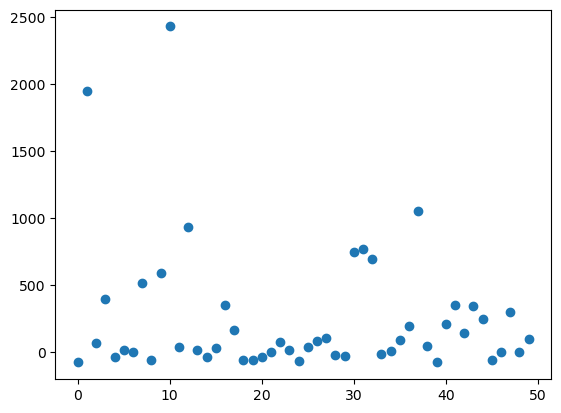

49.540325
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(49.540325, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d67970>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15d3c1760; to 'JaxprTracer' at 0x15d3c1ad0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165ca0ee0>, ctx=JaxprEqnContext(compute_type=None, threefry

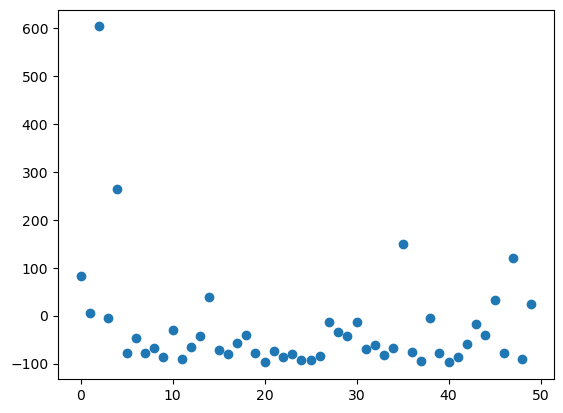

54.742813
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(54.742813, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d64370>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a932e80; to 'JaxprTracer' at 0x15a930310>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165ca19c0>, ctx=JaxprEqnContext(compute_type=None, threefry

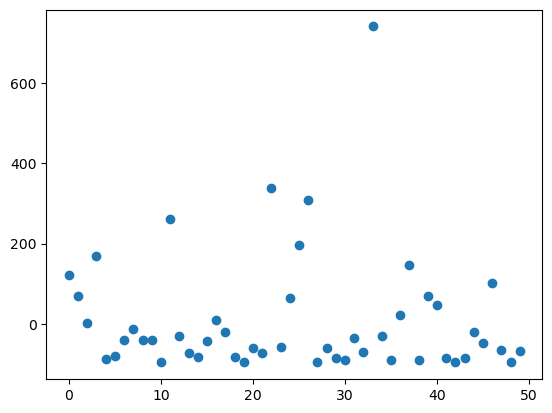

24.564194
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(24.564194, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d66e00>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab6d530; to 'JaxprTracer' at 0x15ab6cbd0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165ca3220>, ctx=JaxprEqnContext(compute_type=None, threefry

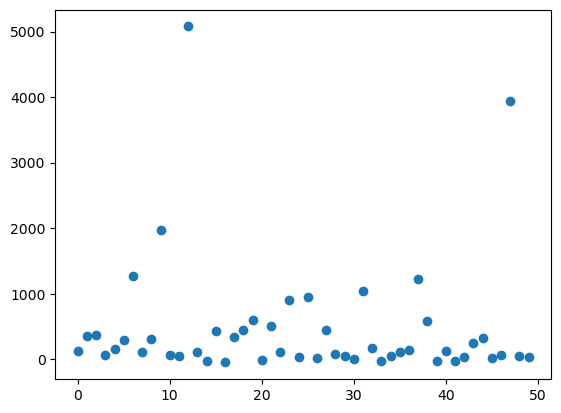

29.213861
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(29.213861, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d642b0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15abc6d40; to 'JaxprTracer' at 0x15abc4b30>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165ca3d00>, ctx=JaxprEqnContext(compute_type=None, threefry

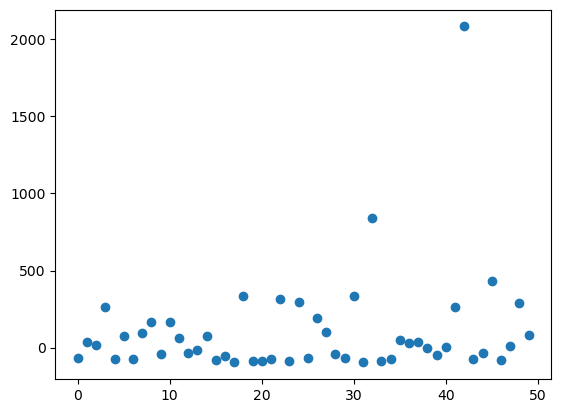

15.626986
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.626986, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d661a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c444a0; to 'JaxprTracer' at 0x162c44d60>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c25630>, ctx=JaxprEqnContext(compute_type=None, threefry

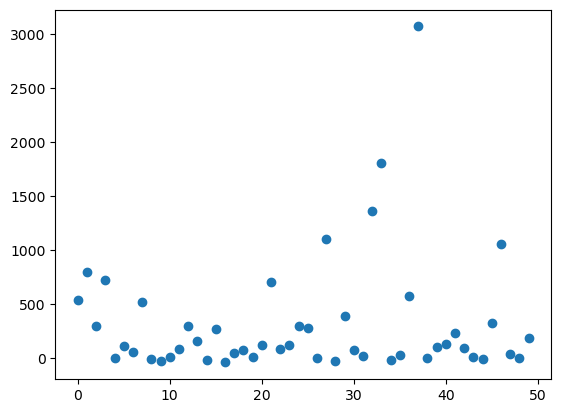

9.289119
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(9.289119, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d647c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15aca8ef0; to 'JaxprTracer' at 0x15aca9670>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c26110>, ctx=JaxprEqnContext(compute_type=None, threefry_p

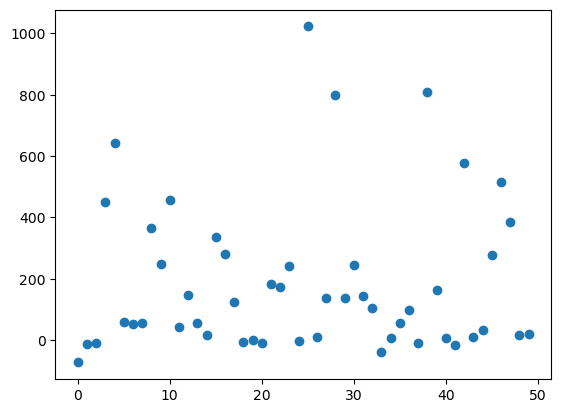

14.643643
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.643643, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d673c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a583920; to 'JaxprTracer' at 0x15a583240>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c264a0>, ctx=JaxprEqnContext(compute_type=None, threefry

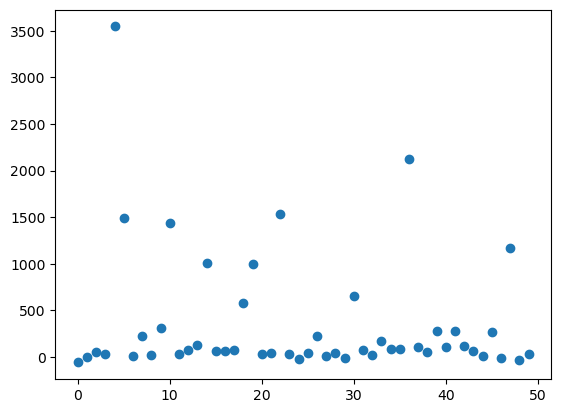

15.177475
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.177475, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x167bf0790>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167c05080; to 'JaxprTracer' at 0x167c04fe0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c086a0>, ctx=JaxprEqnContext(compute_type=None, threefry

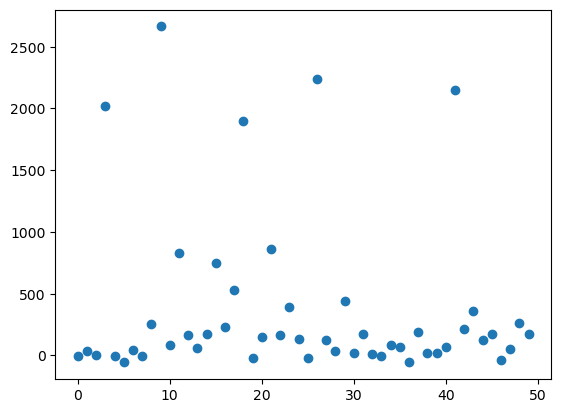

14.800633
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.800633, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x167be8830>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167c12930; to 'JaxprTracer' at 0x167c12890>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c210c0>, ctx=JaxprEqnContext(compute_type=None, threefry

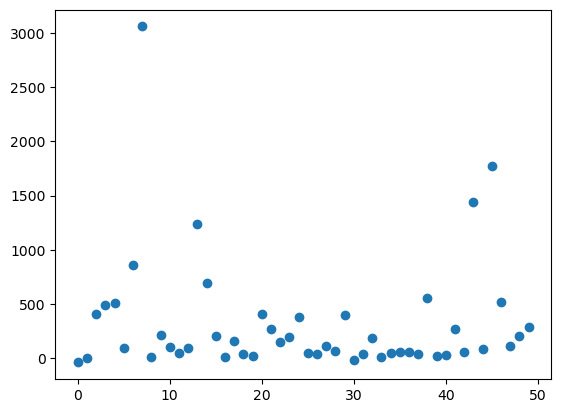

15.162005
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.162005, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c686450>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c631670; to 'JaxprTracer' at 0x15c632e80>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x162cbd630>, ctx=JaxprEqnContext(compute_type=None, threefry

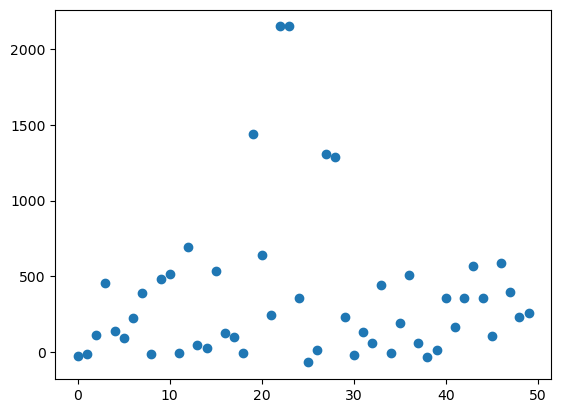

15.604243
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.604243, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d65a90>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6a4f40; to 'JaxprTracer' at 0x15c6a68e0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c250f0>, ctx=JaxprEqnContext(compute_type=None, threefry

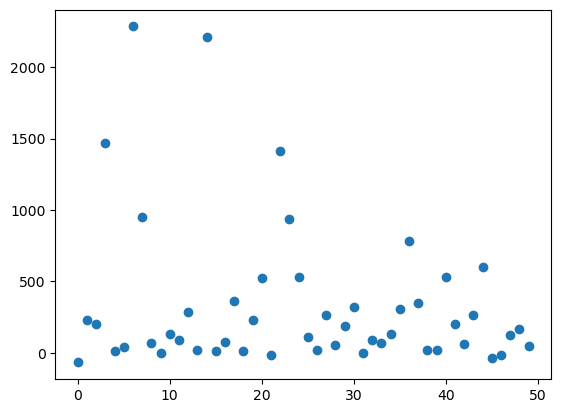

16.988945
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.988945, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d64520>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x165c307c0; to 'JaxprTracer' at 0x165c31850>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c27b80>, ctx=JaxprEqnContext(compute_type=None, threefry

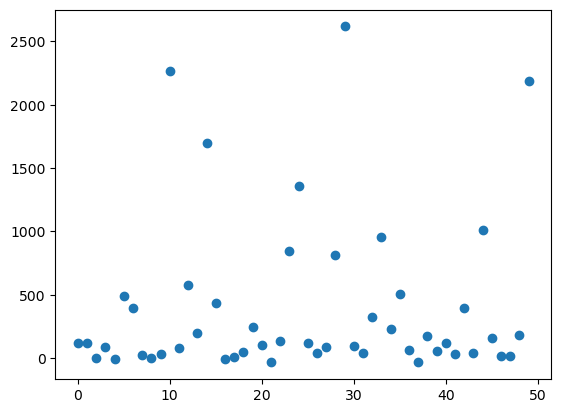

11.330556
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(11.330556, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d66dd0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c3baf70; to 'JaxprTracer' at 0x15c3b8900>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c20af0>, ctx=JaxprEqnContext(compute_type=None, threefry

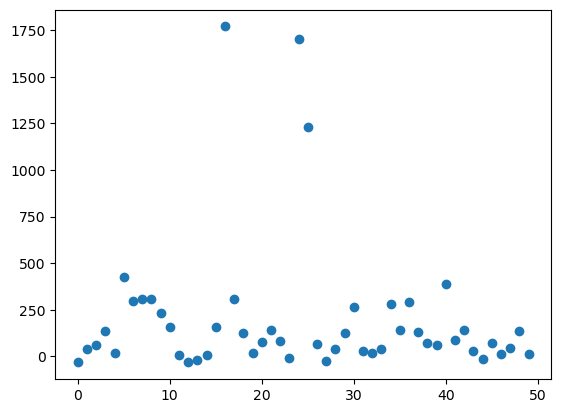

22.089165
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(22.089165, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d66140>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x165c831f0; to 'JaxprTracer' at 0x165c80e00>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c21960>, ctx=JaxprEqnContext(compute_type=None, threefry

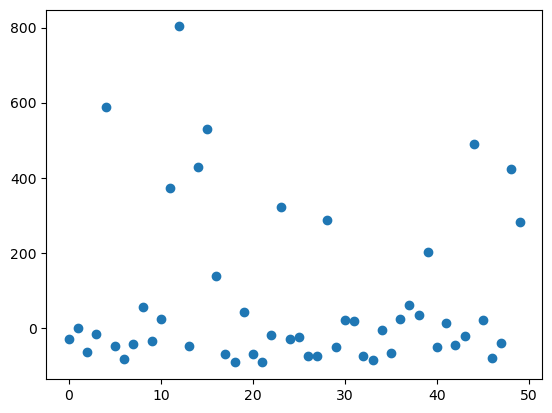

14.709131
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.709131, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d64b40>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d345e0; to 'JaxprTracer' at 0x164d36de0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c22e60>, ctx=JaxprEqnContext(compute_type=None, threefry

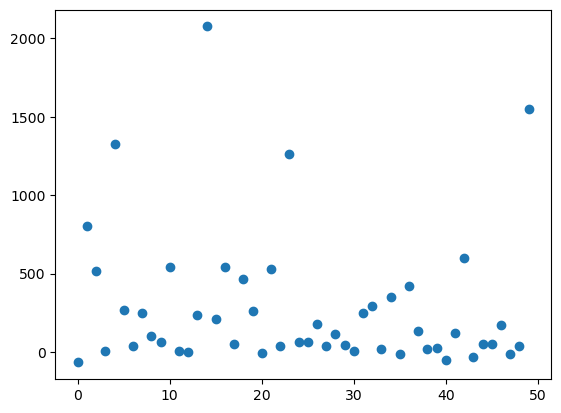

16.784946
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.784946, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d678a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d8ef20; to 'JaxprTracer' at 0x164d8f740>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c23940>, ctx=JaxprEqnContext(compute_type=None, threefry

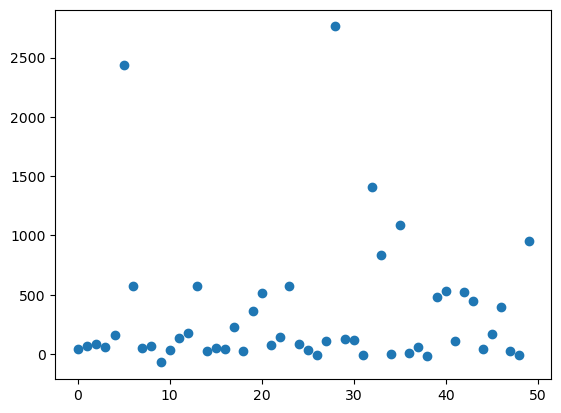

15.754445
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.754445, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x167c3c150>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167bec9f0; to 'JaxprTracer' at 0x167bec770>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c11300>, ctx=JaxprEqnContext(compute_type=None, threefry

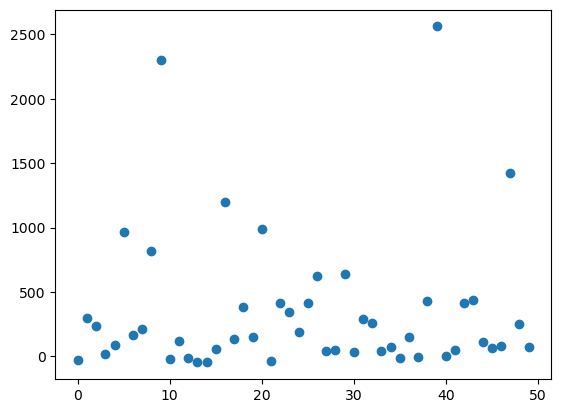

20.513548
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(20.513548, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x167c301f0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167bed7b0; to 'JaxprTracer' at 0x167bede40>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c11de0>, ctx=JaxprEqnContext(compute_type=None, threefry

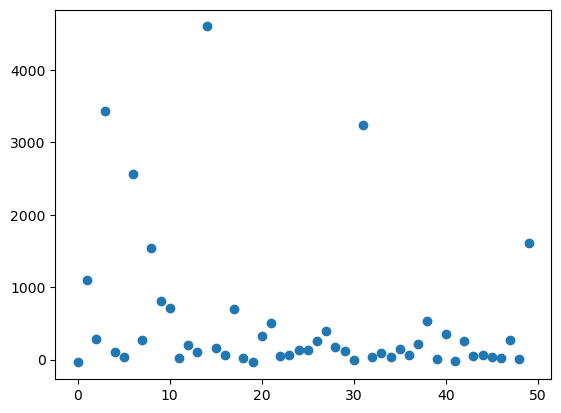

19.777948
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(19.777948, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x167be0290>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x1649ccae0; to 'JaxprTracer' at 0x1649ce570>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c12800>, ctx=JaxprEqnContext(compute_type=None, threefry

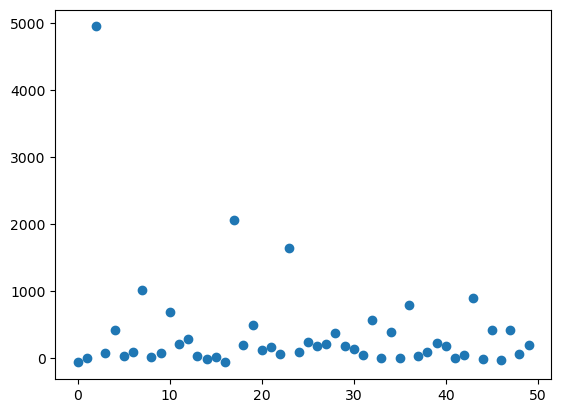

13.805852
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.805852, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x167c38fa0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167c5a2f0; to 'JaxprTracer' at 0x167c5a250>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c60250>, ctx=JaxprEqnContext(compute_type=None, threefry

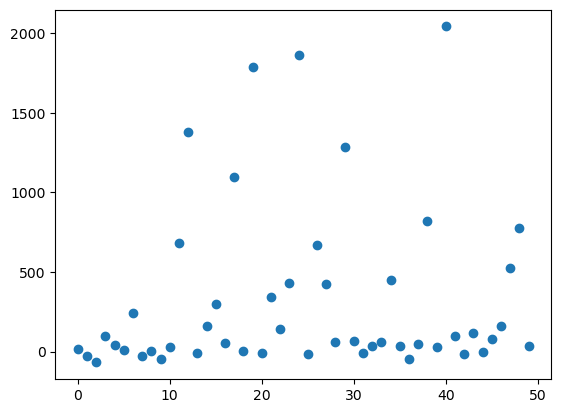

23.437424
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(23.437424, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x167c61040>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167c5bf10; to 'JaxprTracer' at 0x167c5be70>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167be0c70>, ctx=JaxprEqnContext(compute_type=None, threefry

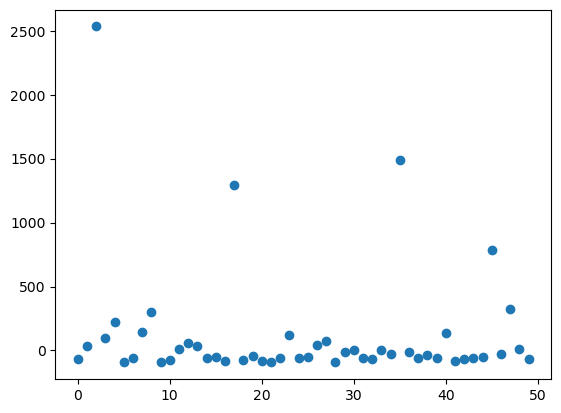

21.88034
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(21.88034, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x167c4dd50>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x169914450; to 'JaxprTracer' at 0x1699143b0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167be26e0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

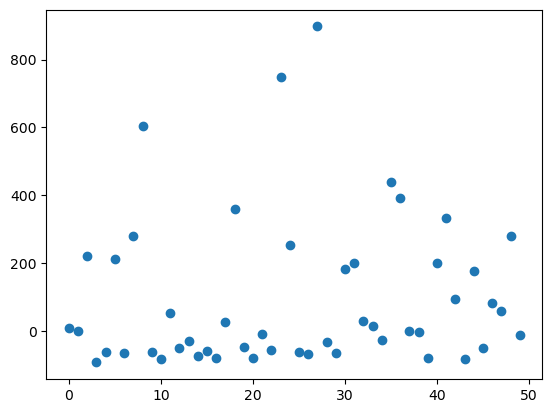

13.15929
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.15929, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c687600>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d00ae0; to 'JaxprTracer' at 0x164d032e0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x15c4637c0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

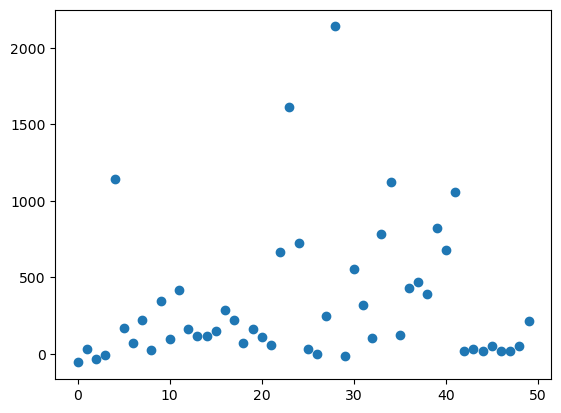

13.975407
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.975407, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab53480>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab3a520; to 'JaxprTracer' at 0x15ab3ab10>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165ca28f0>, ctx=JaxprEqnContext(compute_type=None, threefry

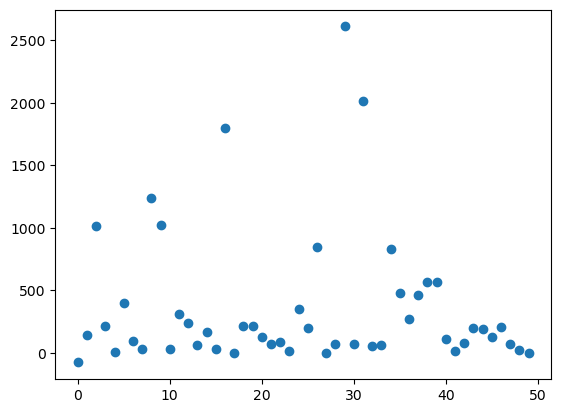

21.330553
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(21.330553, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d67260>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x16494ee80; to 'JaxprTracer' at 0x16494fab0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c13c70>, ctx=JaxprEqnContext(compute_type=None, threefry

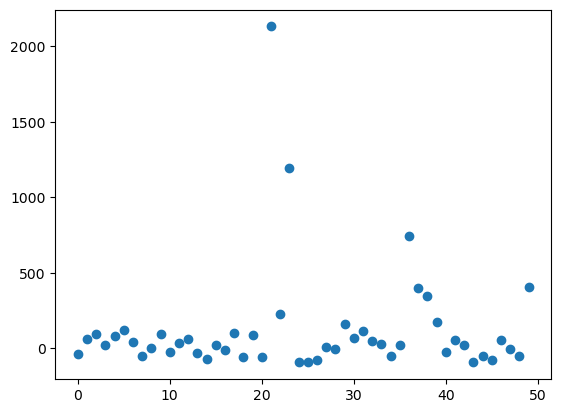

16.648067
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.648067, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d65d30>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ac10ae0; to 'JaxprTracer' at 0x15ac12840>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c13fa0>, ctx=JaxprEqnContext(compute_type=None, threefry

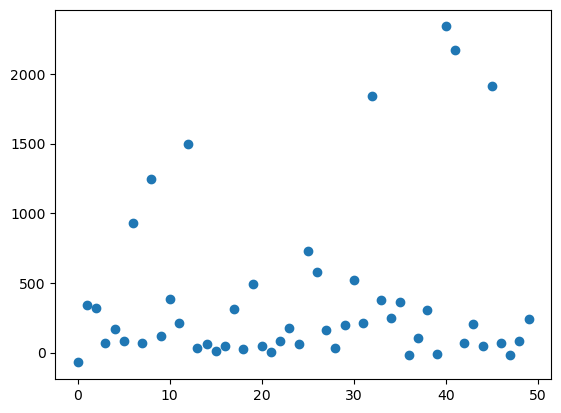

19.18541
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(19.18541, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d64600>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164955300; to 'JaxprTracer' at 0x164954f40>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167be0340>, ctx=JaxprEqnContext(compute_type=None, threefry_p

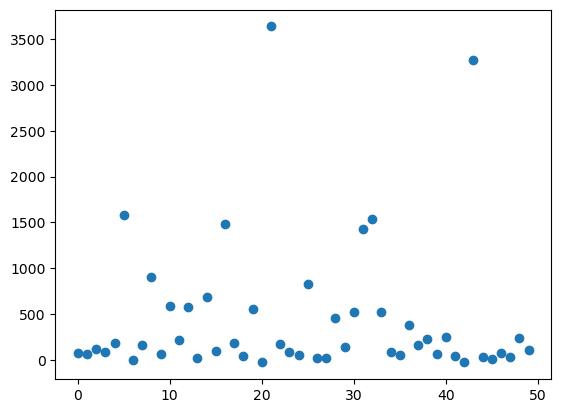

21.473347
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(21.473347, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d64fd0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c46a160; to 'JaxprTracer' at 0x15c46ba60>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167be1390>, ctx=JaxprEqnContext(compute_type=None, threefry

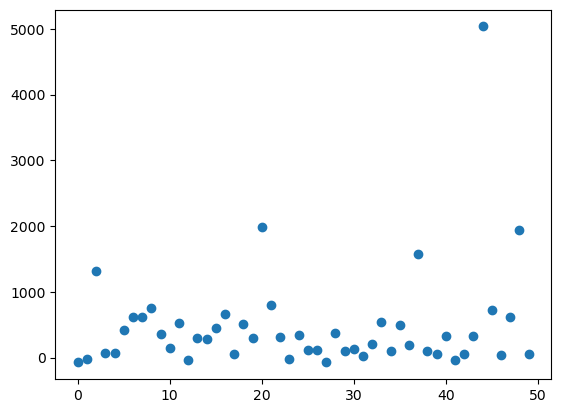

14.739948
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.739948, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d64eb0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c643920; to 'JaxprTracer' at 0x15c640090>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167be1d50>, ctx=JaxprEqnContext(compute_type=None, threefry

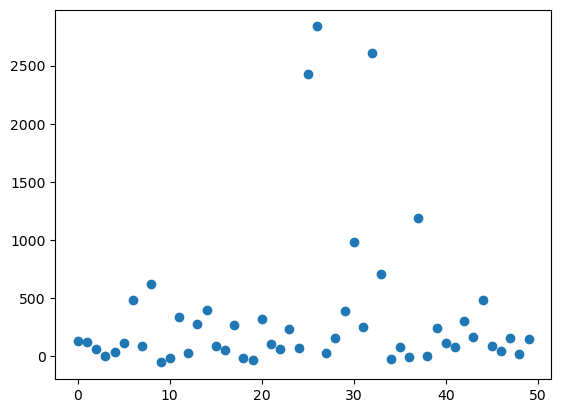

18.350224
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(18.350224, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d67e10>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c38c5e0; to 'JaxprTracer' at 0x15c38e430>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167be3580>, ctx=JaxprEqnContext(compute_type=None, threefry

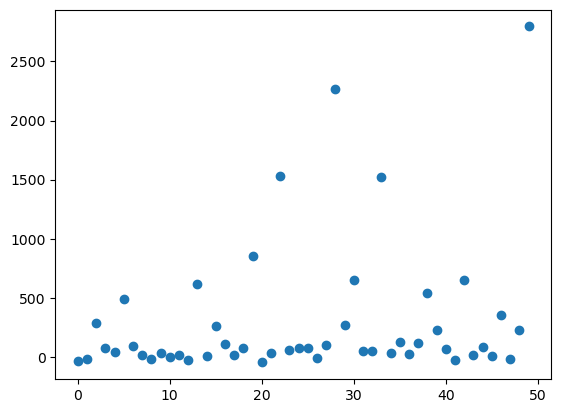

16.36383
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.36383, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d64ed0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a4eb7e0; to 'JaxprTracer' at 0x15a4e8360>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167be3f10>, ctx=JaxprEqnContext(compute_type=None, threefry_p

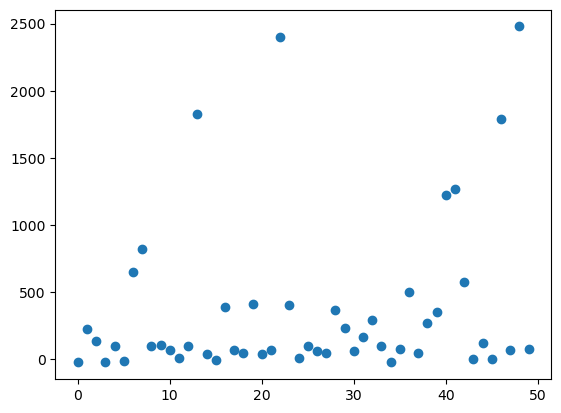

13.803072
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.803072, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d661d0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167bec270; to 'JaxprTracer' at 0x167befc90>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c61a50>, ctx=JaxprEqnContext(compute_type=None, threefry

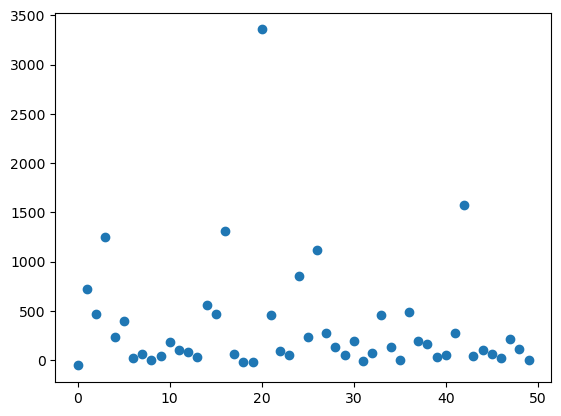

16.4911
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.4911, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d65e50>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167bee070; to 'JaxprTracer' at 0x167bed710>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c62530>, ctx=JaxprEqnContext(compute_type=None, threefry_par

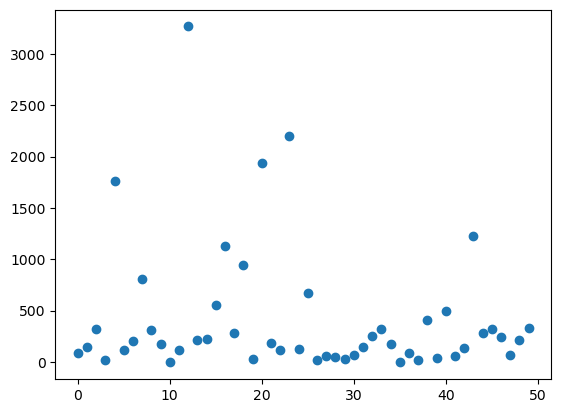

15.938421
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.938421, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c685460>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a5c23e0; to 'JaxprTracer' at 0x15a5c1940>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c62f50>, ctx=JaxprEqnContext(compute_type=None, threefry

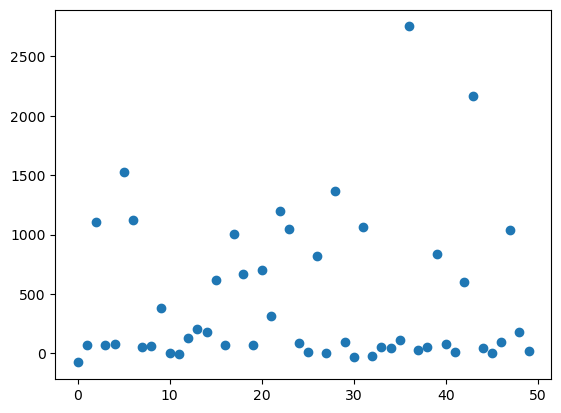

15.510325
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.510325, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x167be8c90>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x165c82750; to 'JaxprTracer' at 0x165c807c0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699389d0>, ctx=JaxprEqnContext(compute_type=None, threefry

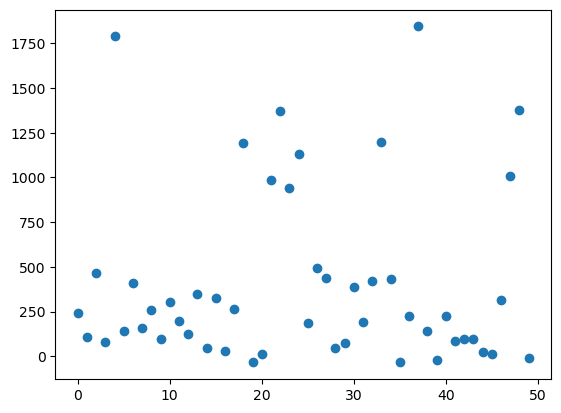

17.801256
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.801256, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c685b50>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c60c310; to 'JaxprTracer' at 0x15c60d300>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c03970>, ctx=JaxprEqnContext(compute_type=None, threefry

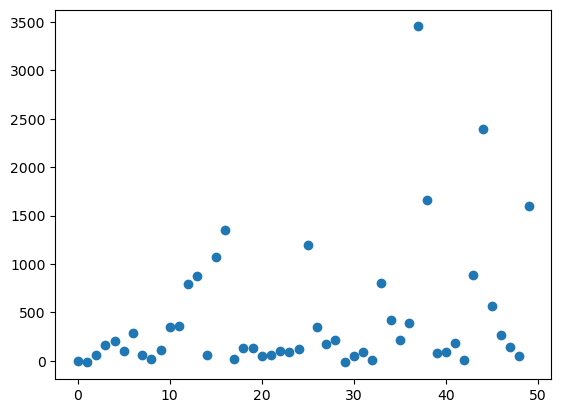

14.739755
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.739755, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158426380>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6a4770; to 'JaxprTracer' at 0x15c6a4c20>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167c11b40>, ctx=JaxprEqnContext(compute_type=None, threefry

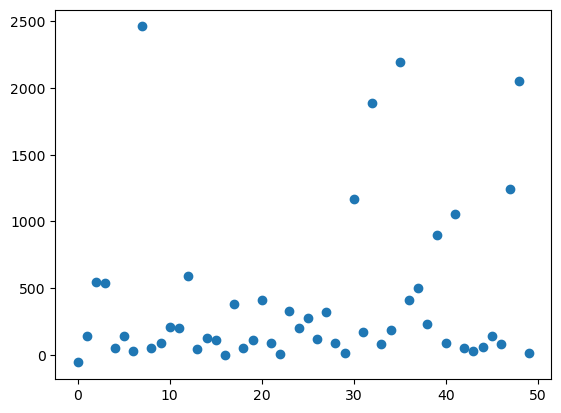

16.059967
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.059967, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d65ab0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a8bb650; to 'JaxprTracer' at 0x15a8ba020>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167be04c0>, ctx=JaxprEqnContext(compute_type=None, threefry

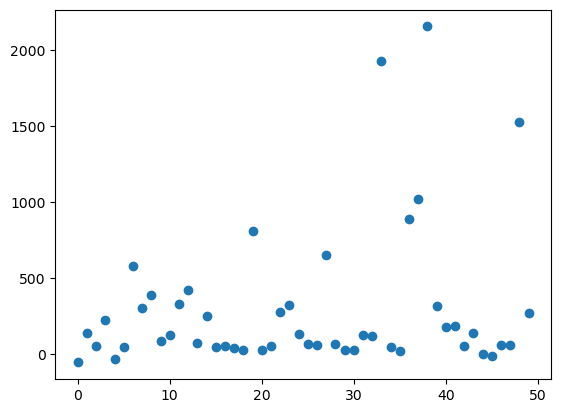

15.009383
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.009383, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d64370>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x165c31850; to 'JaxprTracer' at 0x165c33240>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x167be2350>, ctx=JaxprEqnContext(compute_type=None, threefry

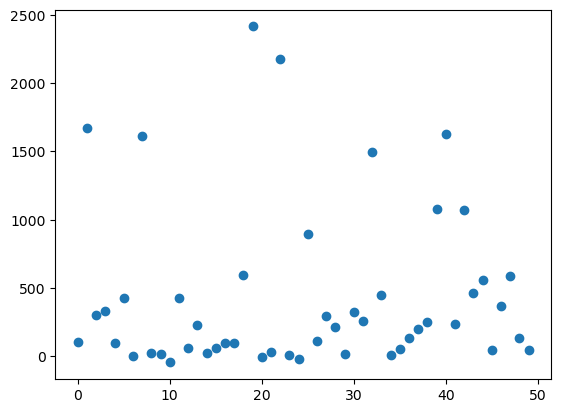

16.880672
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.880672, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d67010>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab6d3f0; to 'JaxprTracer' at 0x15ab6f420>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x169938d00>, ctx=JaxprEqnContext(compute_type=None, threefry

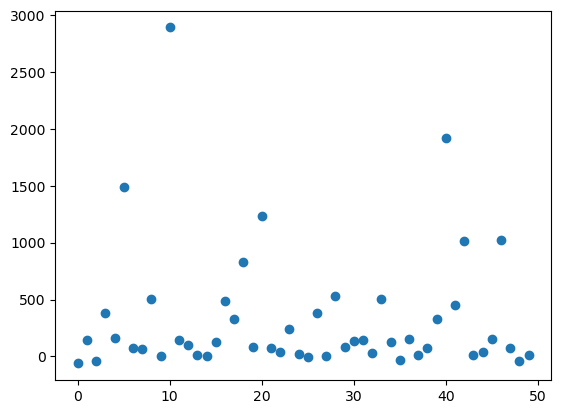

21.013784
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(21.013784, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d65770>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167cb15d0; to 'JaxprTracer' at 0x167cb2ed0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x169939600>, ctx=JaxprEqnContext(compute_type=None, threefry

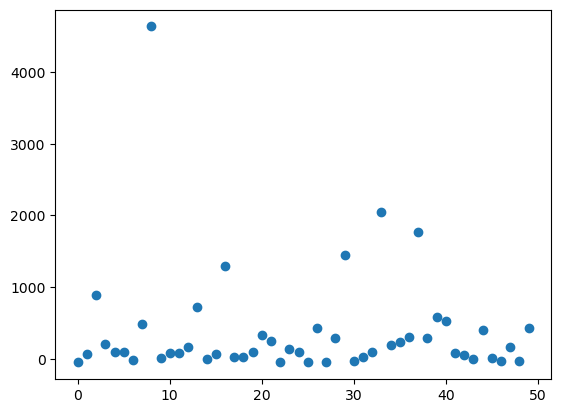

14.73019
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.73019, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d67760>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c12fc0; to 'JaxprTracer' at 0x162c13240>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16993a0b0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

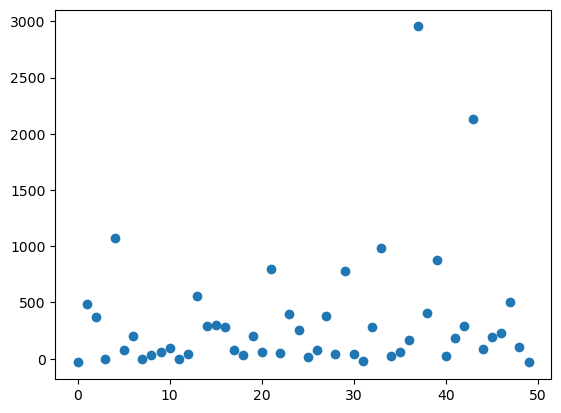

15.713183
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.713183, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d67270>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c642430; to 'JaxprTracer' at 0x15c643510>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16993aad0>, ctx=JaxprEqnContext(compute_type=None, threefry

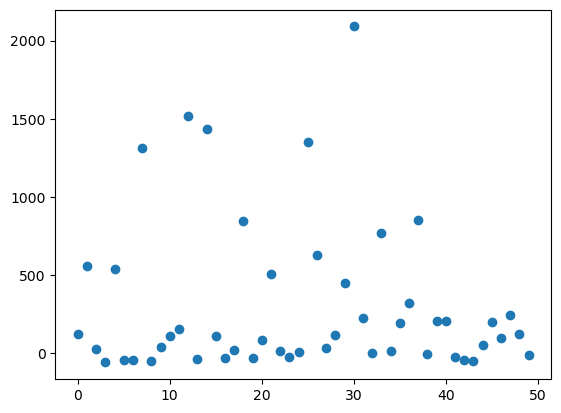

13.823406
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.823406, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d67d80>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab39210; to 'JaxprTracer' at 0x15ab38b30>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16993b4f0>, ctx=JaxprEqnContext(compute_type=None, threefry

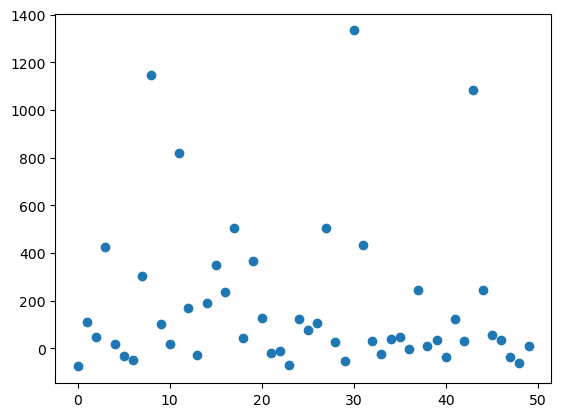

12.39506
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12.39506, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d65820>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c67b470; to 'JaxprTracer' at 0x15c679850>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x169925060>, ctx=JaxprEqnContext(compute_type=None, threefry_p

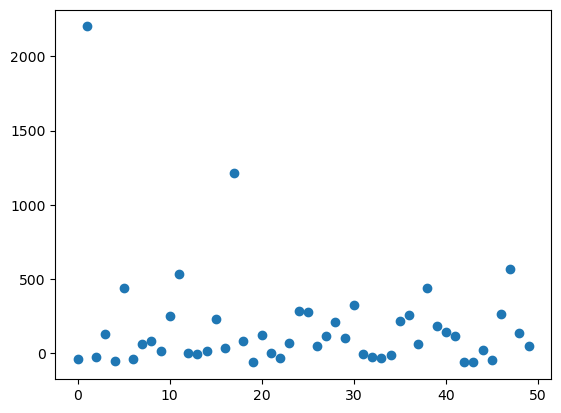

14.806969
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.806969, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d66720>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ad2d9e0; to 'JaxprTracer' at 0x15ad2c860>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x169925b40>, ctx=JaxprEqnContext(compute_type=None, threefry

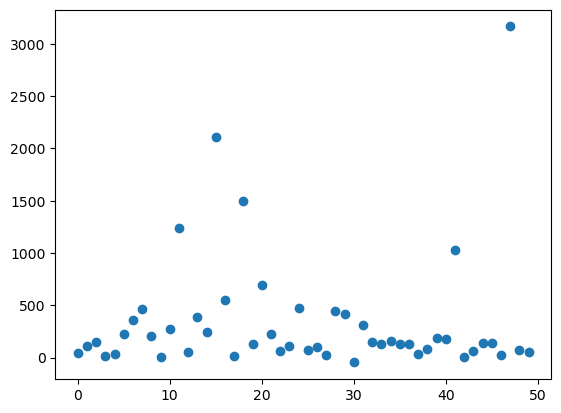

14.52976
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.52976, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699149e0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c42bc40; to 'JaxprTracer' at 0x15c42a750>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x169927550>, ctx=JaxprEqnContext(compute_type=None, threefry_p

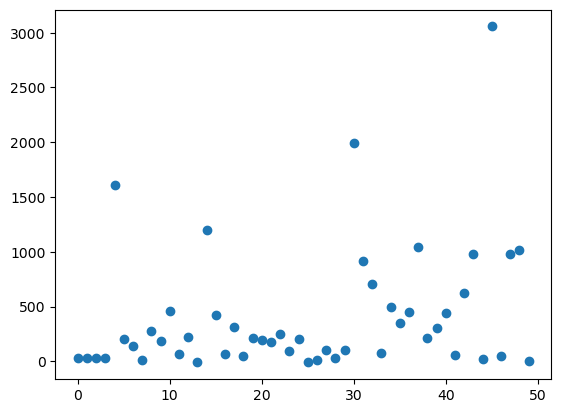

10.063952
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(10.063952, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x16992ca80>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15d3d7a10; to 'JaxprTracer' at 0x15d3d5d50>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x169927ee0>, ctx=JaxprEqnContext(compute_type=None, threefry

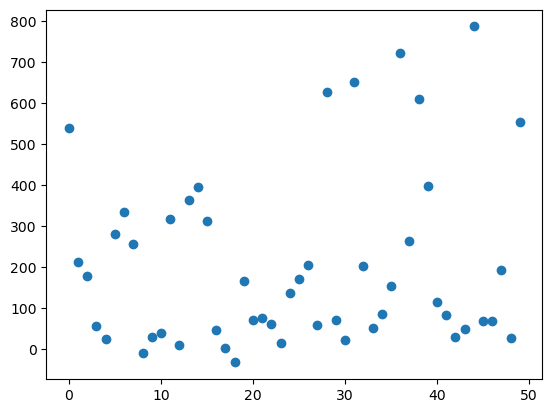

17.31567
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.31567, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d66270>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d8ee80; to 'JaxprTracer' at 0x164d8e8e0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165cafe80>, ctx=JaxprEqnContext(compute_type=None, threefry_p

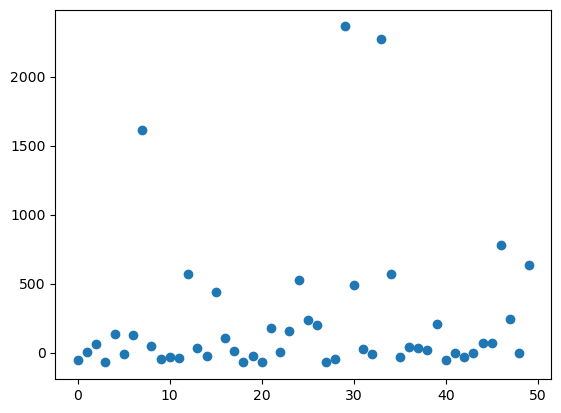

15.015762
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.015762, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6858a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164954090; to 'JaxprTracer' at 0x164955bc0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16993a440>, ctx=JaxprEqnContext(compute_type=None, threefry

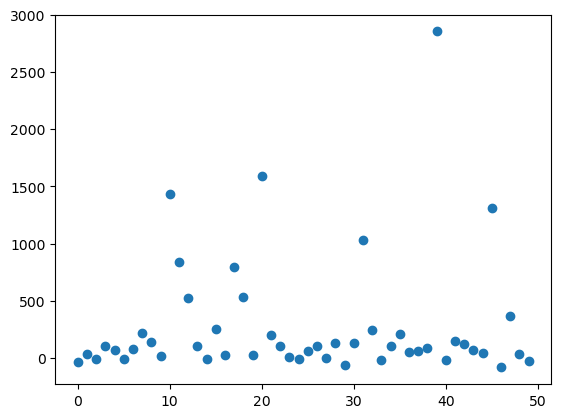

18.076994
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(18.076994, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c686080>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x165c506d0; to 'JaxprTracer' at 0x165c529d0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x169939270>, ctx=JaxprEqnContext(compute_type=None, threefry

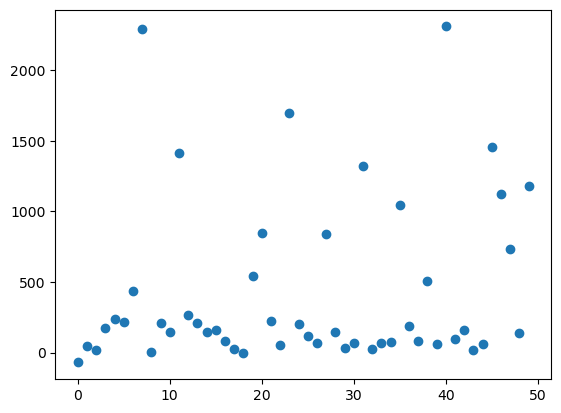

9.70067
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(9.70067, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158427b80>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab6cc20; to 'JaxprTracer' at 0x15ab6f560>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16992c4f0>, ctx=JaxprEqnContext(compute_type=None, threefry_par

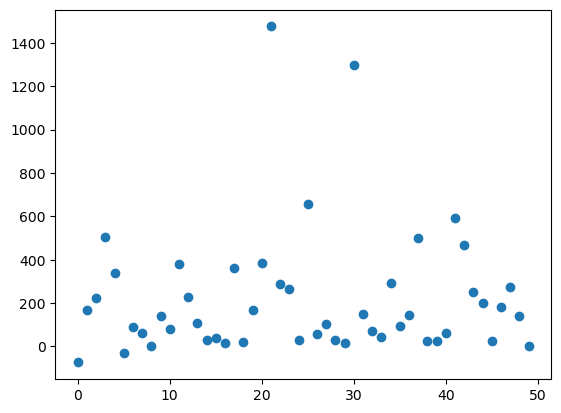

13.300273
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.300273, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d66880>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a996700; to 'JaxprTracer' at 0x15a996930>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16992cfd0>, ctx=JaxprEqnContext(compute_type=None, threefry

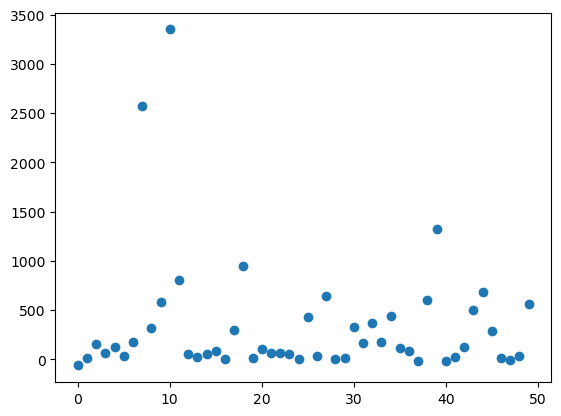

24.931631
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(24.931631, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x158427190>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d0d4e0; to 'JaxprTracer' at 0x164d0f8d0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16992d9f0>, ctx=JaxprEqnContext(compute_type=None, threefry

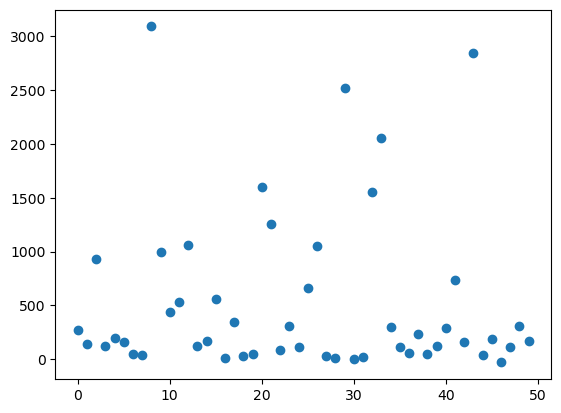

12.443802
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12.443802, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15ab504d0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c7f4c0; to 'JaxprTracer' at 0x162c7de40>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16992f490>, ctx=JaxprEqnContext(compute_type=None, threefry

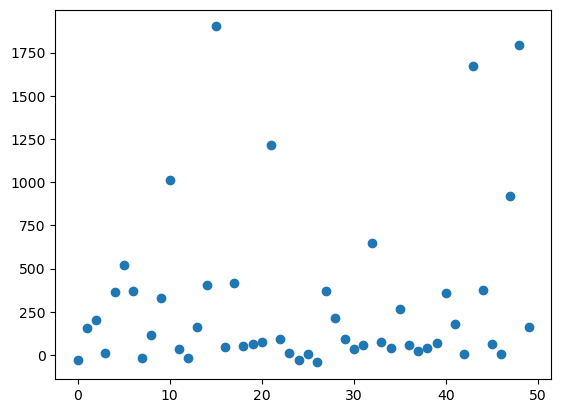

13.841458
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.841458, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699440d0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x1649ff470; to 'JaxprTracer' at 0x1649fdc10>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16992ff70>, ctx=JaxprEqnContext(compute_type=None, threefry

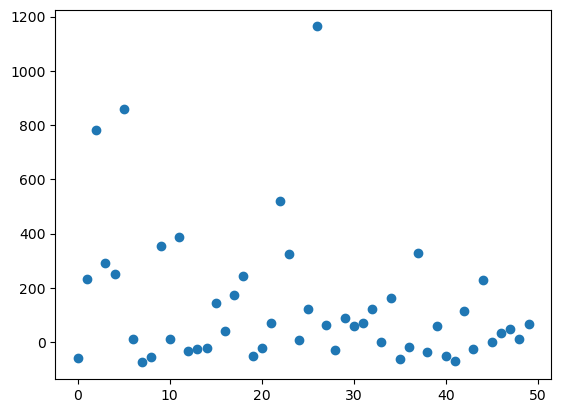

12.347511
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12.347511, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x169930e70>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a5c1940; to 'JaxprTracer' at 0x15a5c0950>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699159f0>, ctx=JaxprEqnContext(compute_type=None, threefry

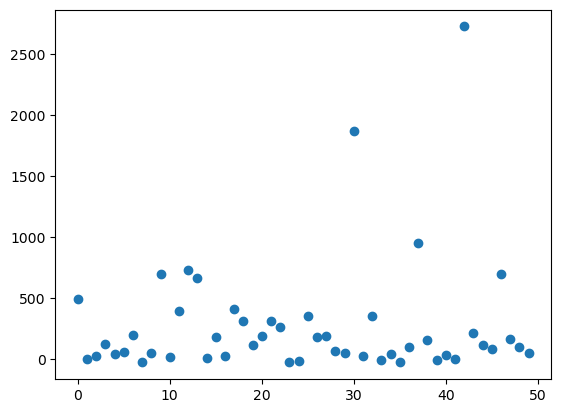

13.839218
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.839218, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x16994cf10>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c60d300; to 'JaxprTracer' at 0x15c60de90>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699164d0>, ctx=JaxprEqnContext(compute_type=None, threefry

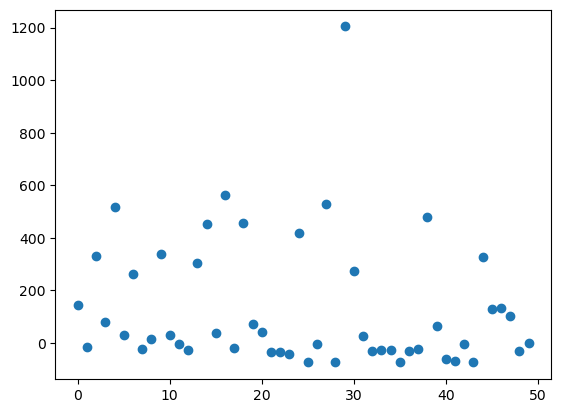

10.412406
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(10.412406, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x169959cb0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167c153a0; to 'JaxprTracer' at 0x167c169d0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x169917ee0>, ctx=JaxprEqnContext(compute_type=None, threefry

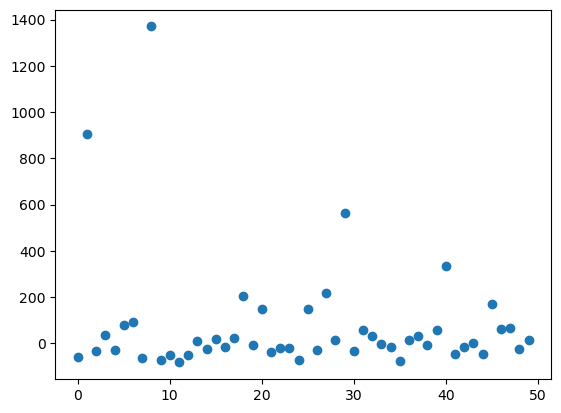

14.282549
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.282549, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x169945d50>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167c149f0; to 'JaxprTracer' at 0x167c15ee0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x169960940>, ctx=JaxprEqnContext(compute_type=None, threefry

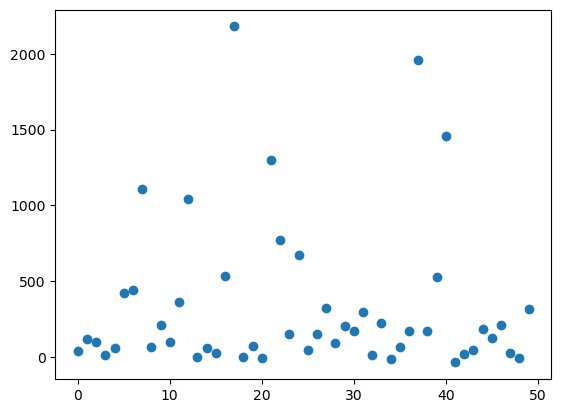

19.632591
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(19.632591, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x169945010>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c68f650; to 'JaxprTracer' at 0x15c68f9c0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x169979360>, ctx=JaxprEqnContext(compute_type=None, threefry

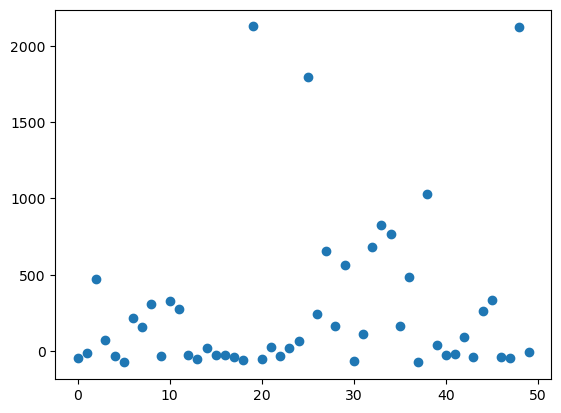

8.957277
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(8.957277, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x169946a70>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x1699b25c0; to 'JaxprTracer' at 0x1699b2520>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16997ad70>, ctx=JaxprEqnContext(compute_type=None, threefry_p

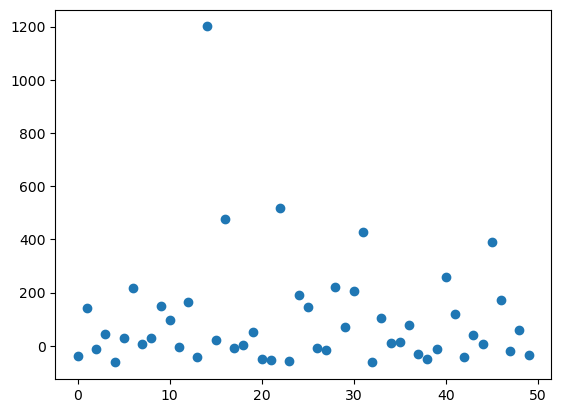

14.531184
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.531184, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d67460>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c602b60; to 'JaxprTracer' at 0x15c601440>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x169916b00>, ctx=JaxprEqnContext(compute_type=None, threefry

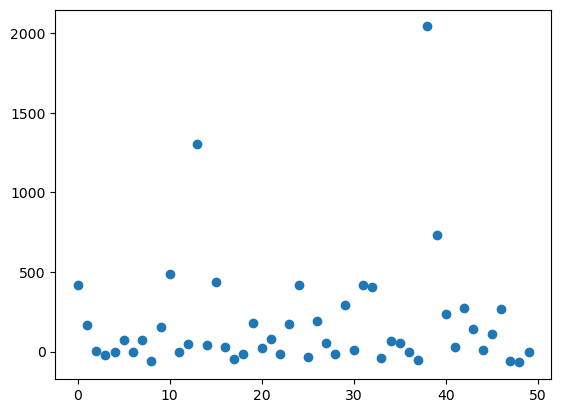

15.2789755
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.2789755, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d64180>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d8f600; to 'JaxprTracer' at 0x164d8ddf0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x169939390>, ctx=JaxprEqnContext(compute_type=None, threef

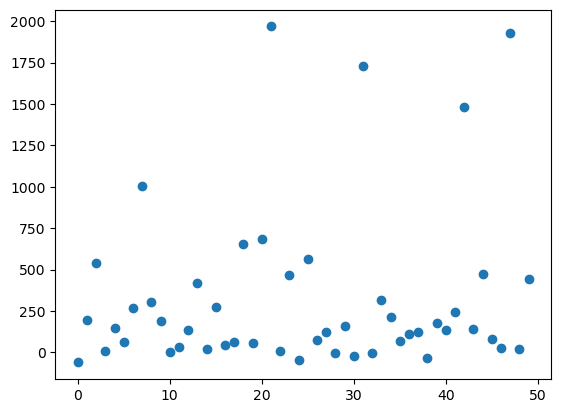

19.700851
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(19.700851, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d654e0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6a6930; to 'JaxprTracer' at 0x15c6a5300>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16993b010>, ctx=JaxprEqnContext(compute_type=None, threefry

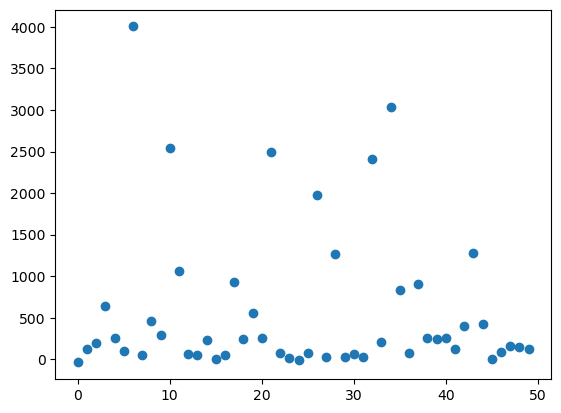

18.091722
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(18.091722, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d65b30>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d7cae0; to 'JaxprTracer' at 0x164d7dd50>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16993a920>, ctx=JaxprEqnContext(compute_type=None, threefry

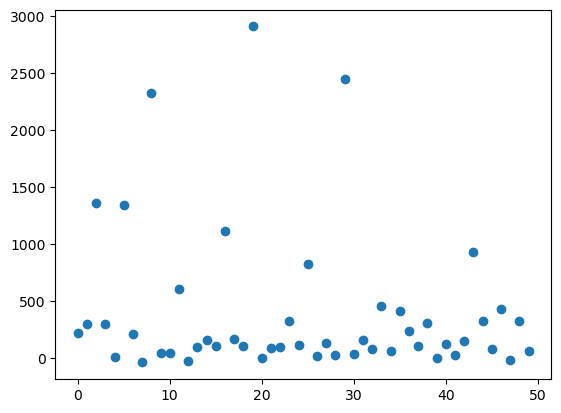

14.573111
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.573111, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d655d0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a8ba200; to 'JaxprTracer' at 0x15a8bbbf0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x169978bb0>, ctx=JaxprEqnContext(compute_type=None, threefry

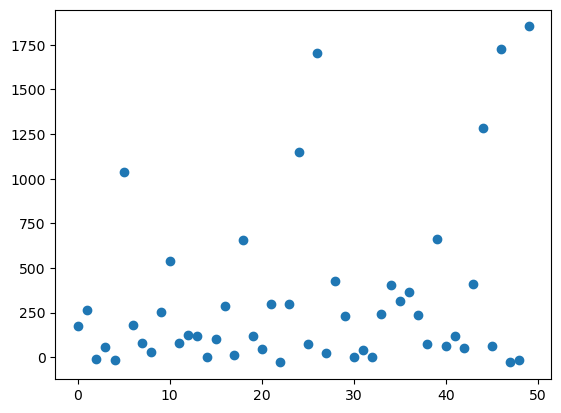

19.524176
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(19.524176, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d66d80>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x16493a4d0; to 'JaxprTracer' at 0x1649385e0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x169979120>, ctx=JaxprEqnContext(compute_type=None, threefry

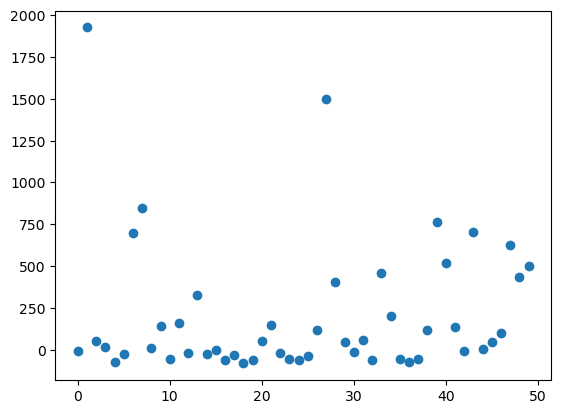

16.336151
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.336151, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x16997cb30>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x1649558f0; to 'JaxprTracer' at 0x164954810>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699c0460>, ctx=JaxprEqnContext(compute_type=None, threefry

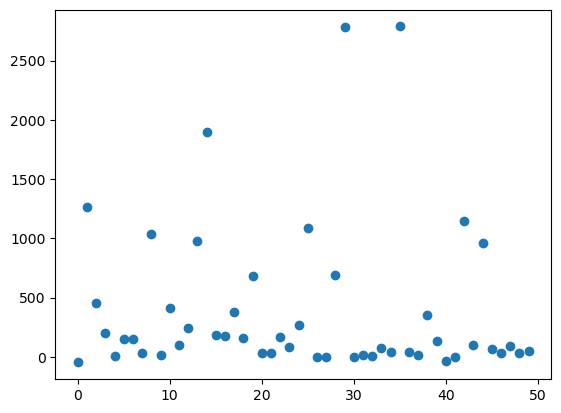

25.129538
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(25.129538, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c4bd0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c38eac0; to 'JaxprTracer' at 0x15c38d0d0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699c0f40>, ctx=JaxprEqnContext(compute_type=None, threefry

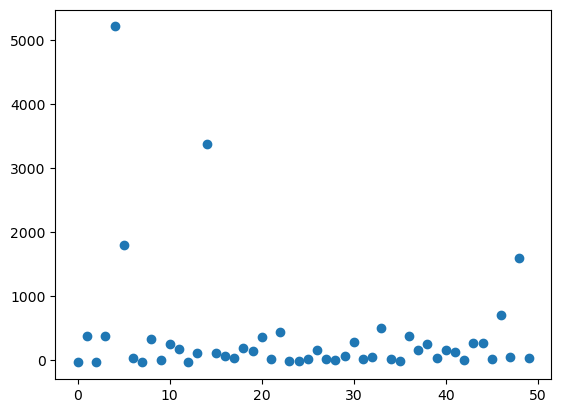

15.101609
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.101609, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x16996cc70>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ad2d800; to 'JaxprTracer' at 0x15ad2db20>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699c1960>, ctx=JaxprEqnContext(compute_type=None, threefry

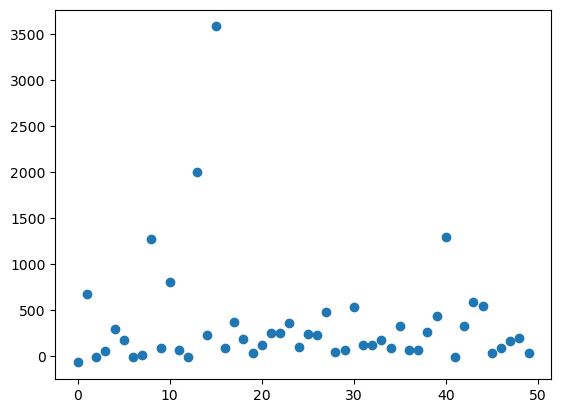

14.324751
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.324751, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c5aa0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c3a27f0; to 'JaxprTracer' at 0x15c3a01d0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699c3460>, ctx=JaxprEqnContext(compute_type=None, threefry

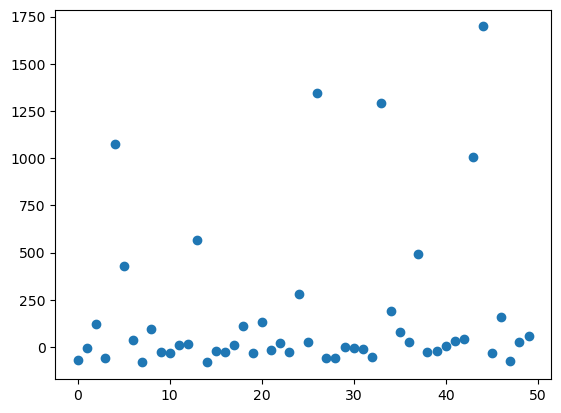

10.561936
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(10.561936, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c9b40>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167bec0e0; to 'JaxprTracer' at 0x167bec810>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699c3e80>, ctx=JaxprEqnContext(compute_type=None, threefry

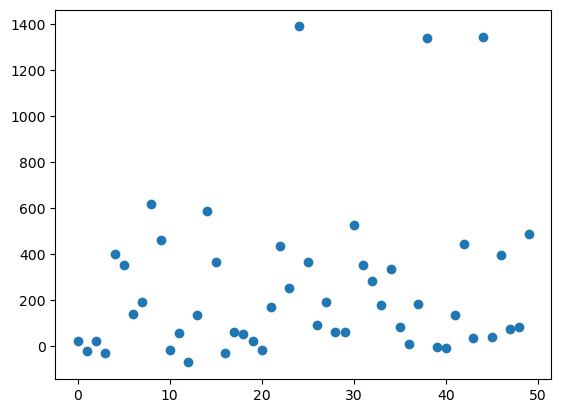

19.611494
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(19.611494, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699ca970>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x16999bdd0; to 'JaxprTracer' at 0x16999bf10>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699d19f0>, ctx=JaxprEqnContext(compute_type=None, threefry

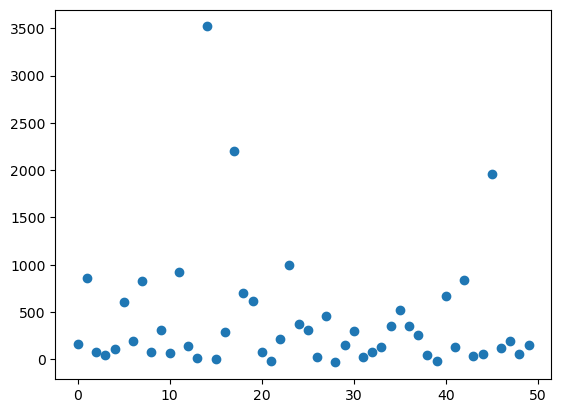

12.420672
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12.420672, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c9430>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x16999b6f0; to 'JaxprTracer' at 0x169999d50>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699d24d0>, ctx=JaxprEqnContext(compute_type=None, threefry

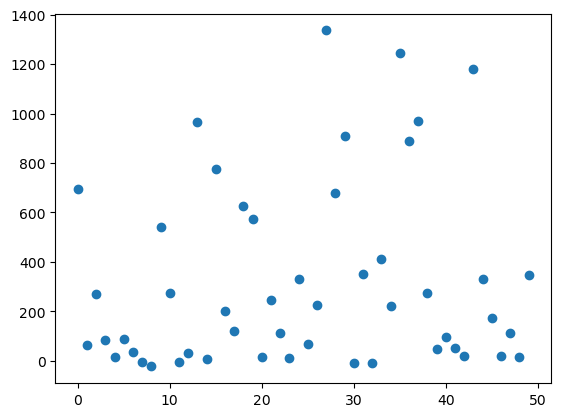

11.513486
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(11.513486, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c684760>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x165c52160; to 'JaxprTracer' at 0x165c51300>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x165c029b0>, ctx=JaxprEqnContext(compute_type=None, threefry

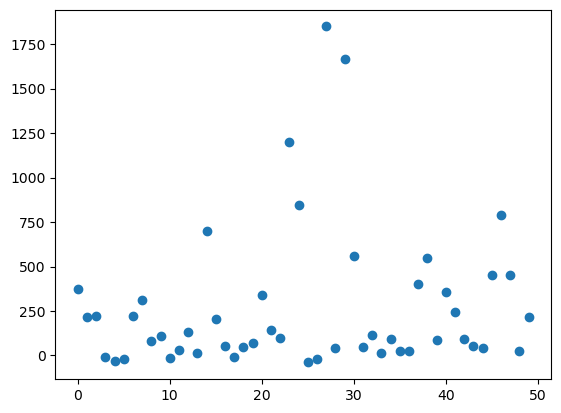

18.971472
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(18.971472, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d660f0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164d8c4f0; to 'JaxprTracer' at 0x164d8d800>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16997a140>, ctx=JaxprEqnContext(compute_type=None, threefry

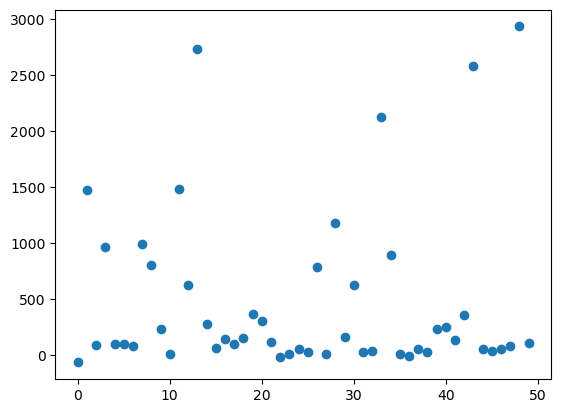

15.800277
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.800277, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d678b0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab9f6f0; to 'JaxprTracer' at 0x15ab9ff10>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699794b0>, ctx=JaxprEqnContext(compute_type=None, threefry

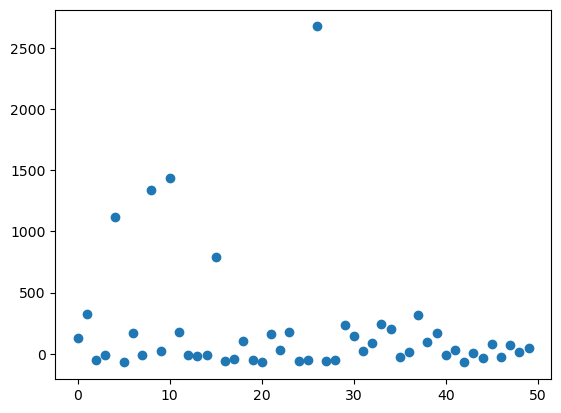

17.752377
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.752377, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d64ca0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6a7f10; to 'JaxprTracer' at 0x15c6a5e40>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699d0160>, ctx=JaxprEqnContext(compute_type=None, threefry

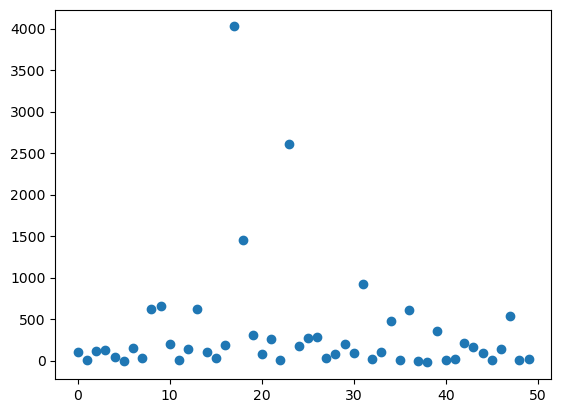

14.692057
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.692057, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c9d60>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c13240; to 'JaxprTracer' at 0x162c135b0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699d0190>, ctx=JaxprEqnContext(compute_type=None, threefry

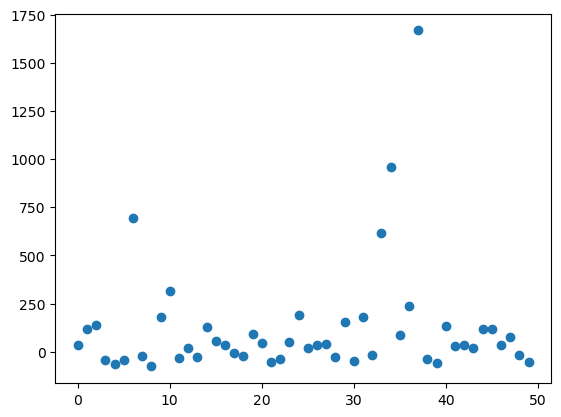

13.550863
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.550863, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699ca4c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c68ffb0; to 'JaxprTracer' at 0x15c68f920>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699d2fe0>, ctx=JaxprEqnContext(compute_type=None, threefry

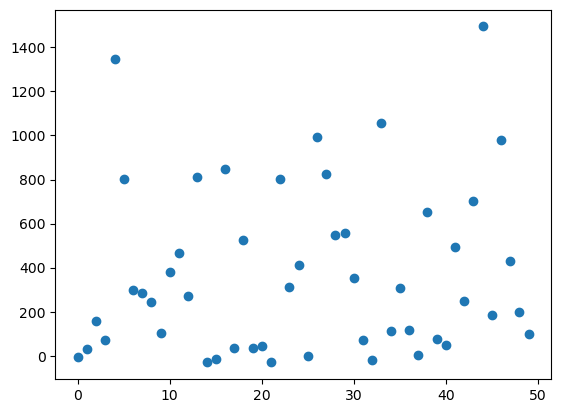

23.520485
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(23.520485, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c8220>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164955170; to 'JaxprTracer' at 0x164955c10>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699f4af0>, ctx=JaxprEqnContext(compute_type=None, threefry

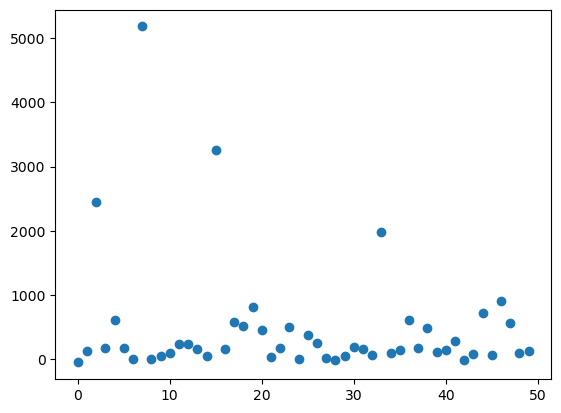

10.991933
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(10.991933, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c90c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167cb0220; to 'JaxprTracer' at 0x167cb3010>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699f5510>, ctx=JaxprEqnContext(compute_type=None, threefry

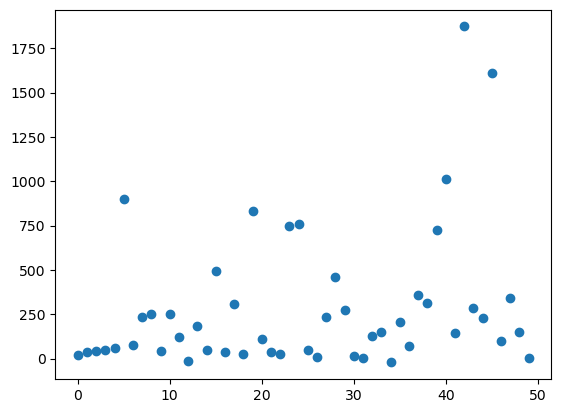

20.320086
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(20.320086, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c98c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167cb08b0; to 'JaxprTracer' at 0x167cb2480>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699f5f00>, ctx=JaxprEqnContext(compute_type=None, threefry

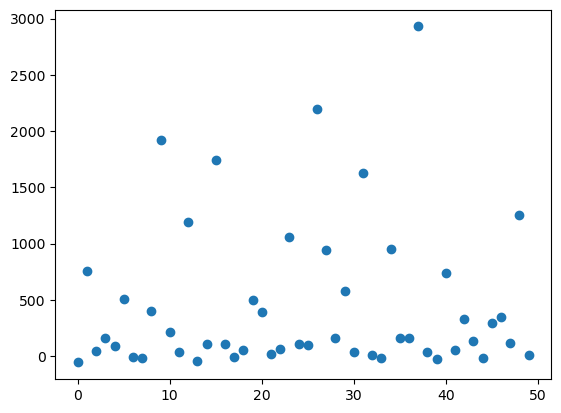

16.12302
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.12302, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c98d0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15ab6ca90; to 'JaxprTracer' at 0x15ab6f5b0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699f7bb0>, ctx=JaxprEqnContext(compute_type=None, threefry_p

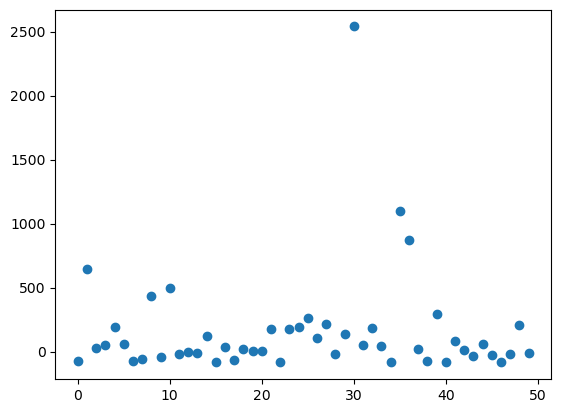

16.008413
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(16.008413, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699ca920>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167ca1620; to 'JaxprTracer' at 0x167ca1b20>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16995c490>, ctx=JaxprEqnContext(compute_type=None, threefry

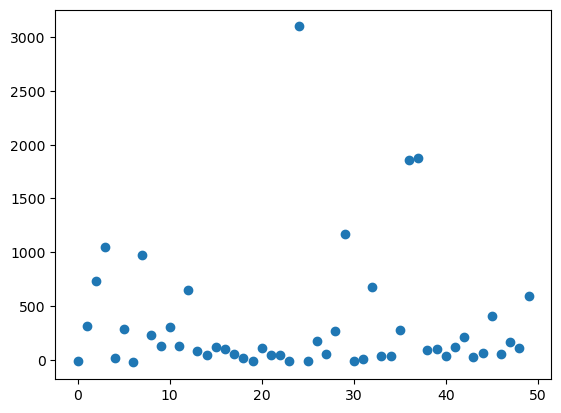

35.315357
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(35.315357, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699cb2b0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x16a912a70; to 'JaxprTracer' at 0x16a9129d0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a905f60>, ctx=JaxprEqnContext(compute_type=None, threefry

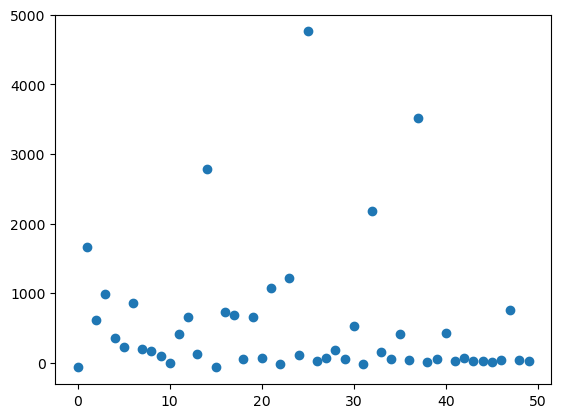

10.761705
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(10.761705, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699ca4d0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x16a913c40; to 'JaxprTracer' at 0x16a913ba0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a906a40>, ctx=JaxprEqnContext(compute_type=None, threefry

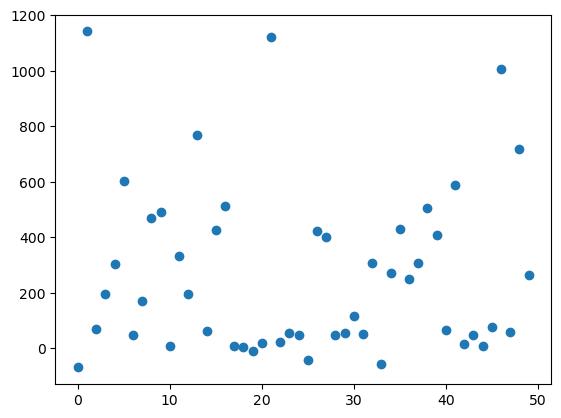

18.15698
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(18.15698, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x16a980120>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x16a98c450; to 'JaxprTracer' at 0x16a98c3b0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a988460>, ctx=JaxprEqnContext(compute_type=None, threefry_p

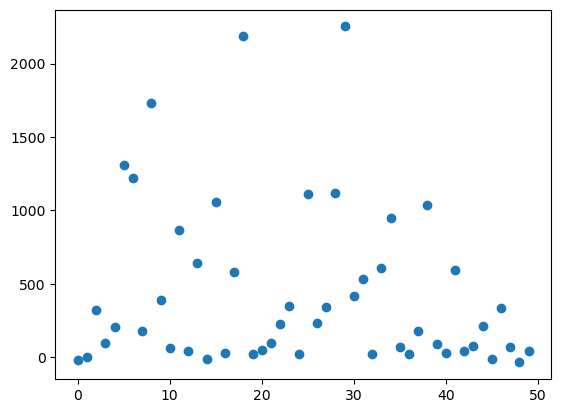

14.225006
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.225006, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x16a9a81c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x16a98ddf0; to 'JaxprTracer' at 0x16a98dd50>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a9883d0>, ctx=JaxprEqnContext(compute_type=None, threefry

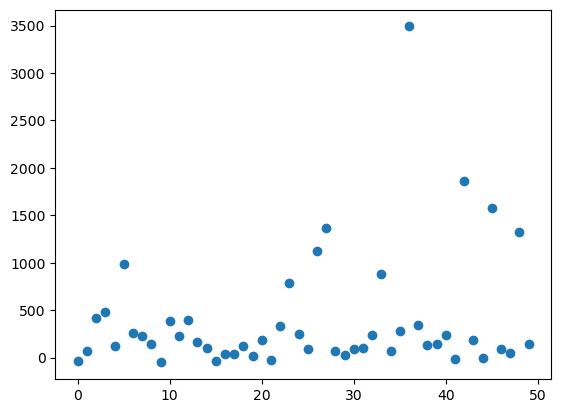

10.853912
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(10.853912, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d674c0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a8ea7a0; to 'JaxprTracer' at 0x15a8e9490>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a904cd0>, ctx=JaxprEqnContext(compute_type=None, threefry

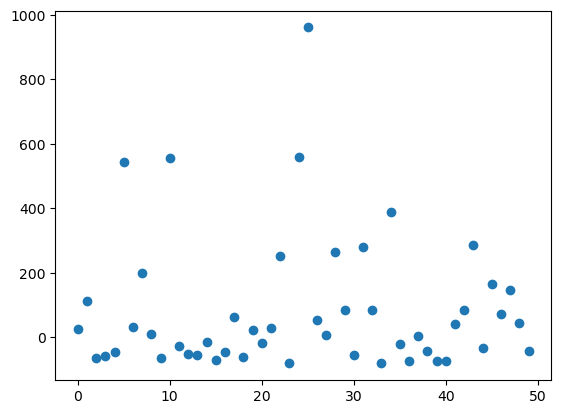

11.699683
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(11.699683, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x164d67290>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a933830; to 'JaxprTracer' at 0x15a9316c0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16992ff10>, ctx=JaxprEqnContext(compute_type=None, threefry

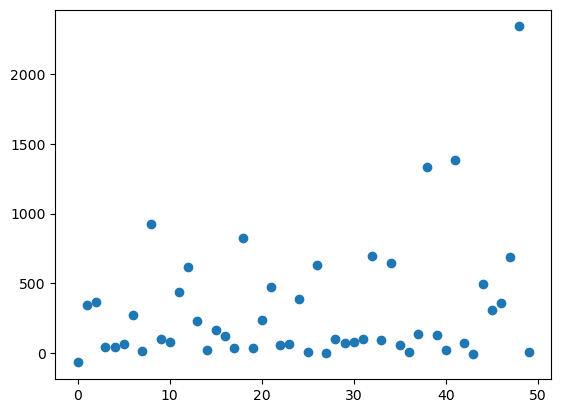

15.453368
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.453368, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699ca1d0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167c36840; to 'JaxprTracer' at 0x167c362f0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699d24a0>, ctx=JaxprEqnContext(compute_type=None, threefry

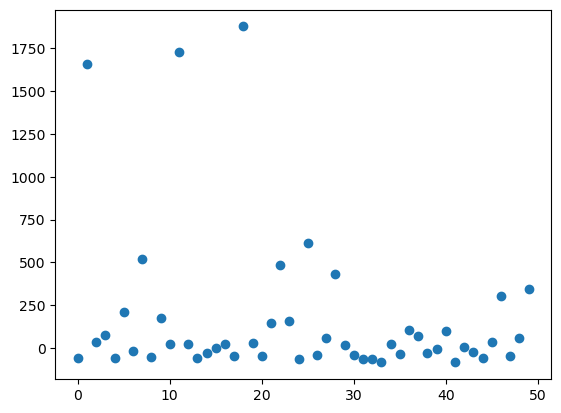

12.084647
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12.084647, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c98a0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162ca1d00; to 'JaxprTracer' at 0x162ca2ed0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x1699d1cf0>, ctx=JaxprEqnContext(compute_type=None, threefry

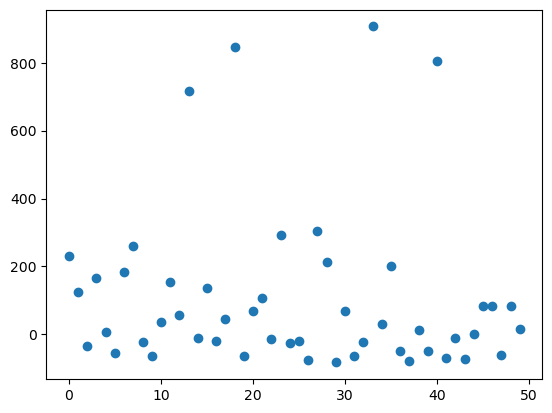

19.685963
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(19.685963, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699ca480>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x165c314e0; to 'JaxprTracer' at 0x165c30400>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a988bb0>, ctx=JaxprEqnContext(compute_type=None, threefry

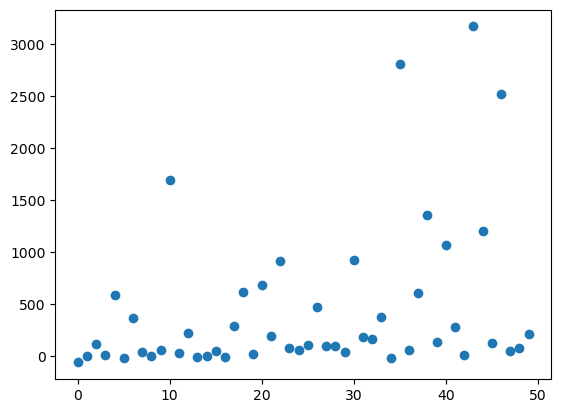

17.582005
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.582005, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c8e70>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a96f6f0; to 'JaxprTracer' at 0x16999b6f0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a9893c0>, ctx=JaxprEqnContext(compute_type=None, threefry

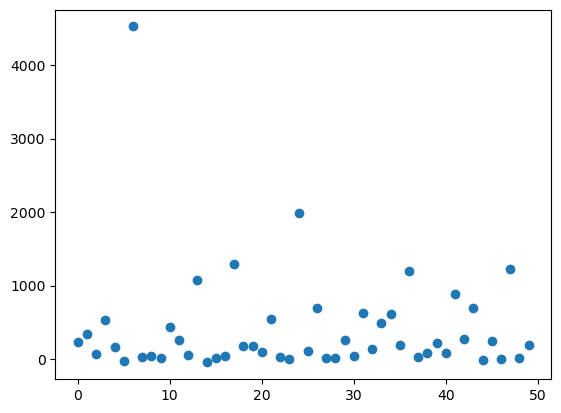

10.806772
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(10.806772, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c9b20>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x16a962610; to 'JaxprTracer' at 0x16a9628e0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a98af80>, ctx=JaxprEqnContext(compute_type=None, threefry

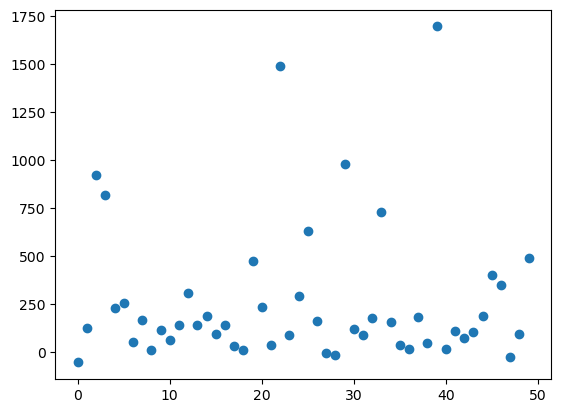

15.087587
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(15.087587, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699cac10>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x16a963830; to 'JaxprTracer' at 0x16a9637e0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a98b9a0>, ctx=JaxprEqnContext(compute_type=None, threefry

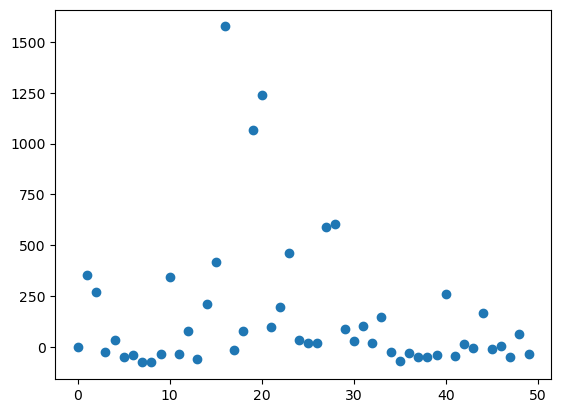

13.4325905
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.4325905, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c9cc0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x164ccdd50; to 'JaxprTracer' at 0x164cccbd0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a9443d0>, ctx=JaxprEqnContext(compute_type=None, threef

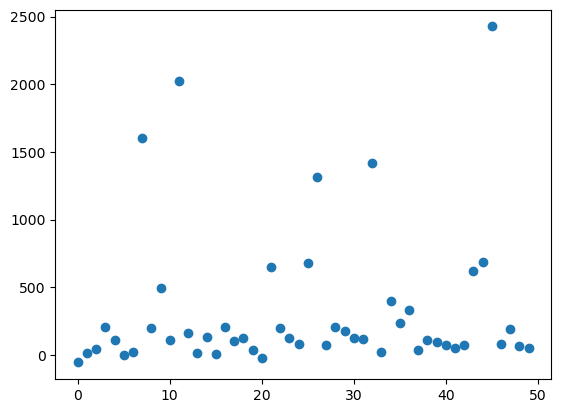

13.107121
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.107121, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c8c80>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167ca1f80; to 'JaxprTracer' at 0x167ca19e0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a921ea0>, ctx=JaxprEqnContext(compute_type=None, threefry

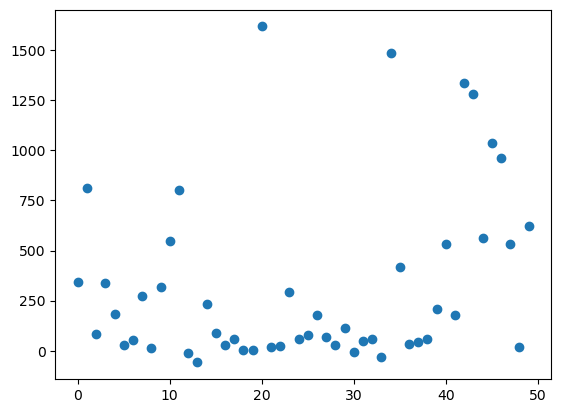

13.776404
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(13.776404, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c9220>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167ca0e00; to 'JaxprTracer' at 0x167ca0b80>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a922980>, ctx=JaxprEqnContext(compute_type=None, threefry

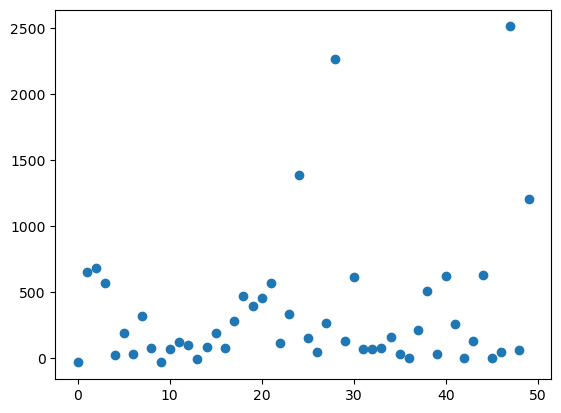

17.078175
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.078175, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x16a980310>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x16a9bcdb0; to 'JaxprTracer' at 0x16a9bcd10>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a9c4370>, ctx=JaxprEqnContext(compute_type=None, threefry

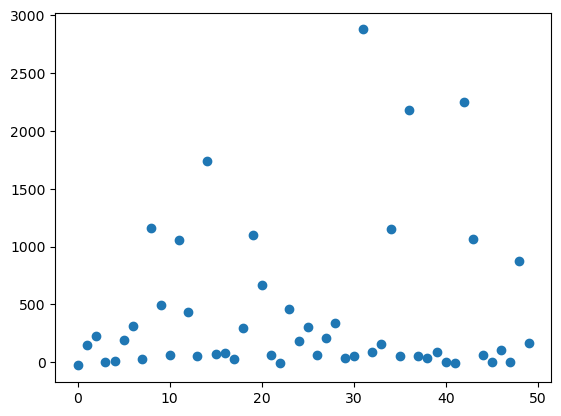

23.445023
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(23.445023, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x16a9b83b0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x16a9bf470; to 'JaxprTracer' at 0x16a9bf3d0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a9d8d90>, ctx=JaxprEqnContext(compute_type=None, threefry

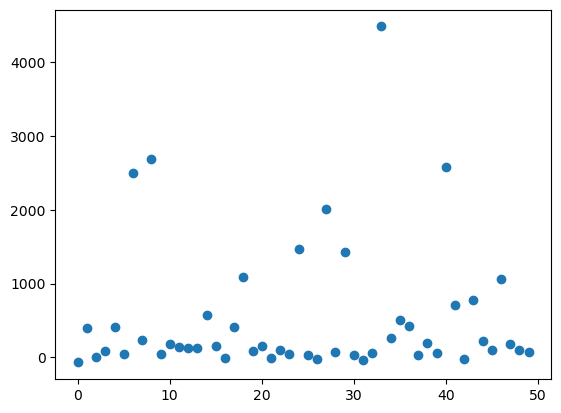

22.368177
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(22.368177, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x15c6840e0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15acd7100; to 'JaxprTracer' at 0x15acd5260>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a9897e0>, ctx=JaxprEqnContext(compute_type=None, threefry

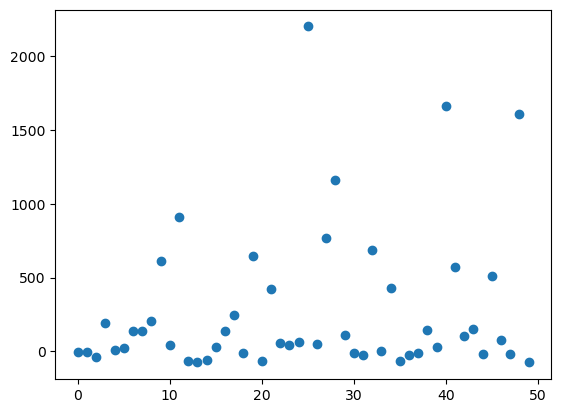

14.066798
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(14.066798, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c8810>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x162c113f0; to 'JaxprTracer' at 0x162c121b0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a923c40>, ctx=JaxprEqnContext(compute_type=None, threefry

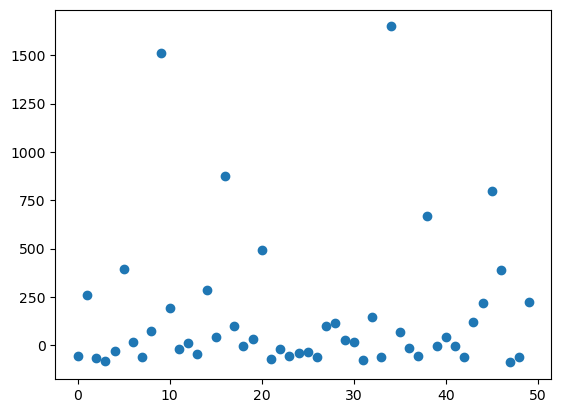

12.417955
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12.417955, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699caa20>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167c34270; to 'JaxprTracer' at 0x167c37420>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a921270>, ctx=JaxprEqnContext(compute_type=None, threefry

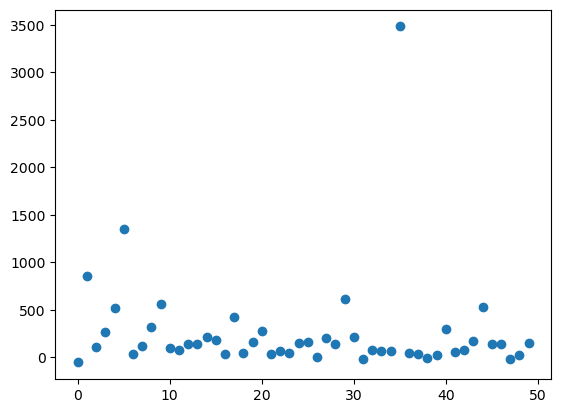

17.550728
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(17.550728, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699ca310>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x1649ceac0; to 'JaxprTracer' at 0x1649ce520>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a9d80a0>, ctx=JaxprEqnContext(compute_type=None, threefry

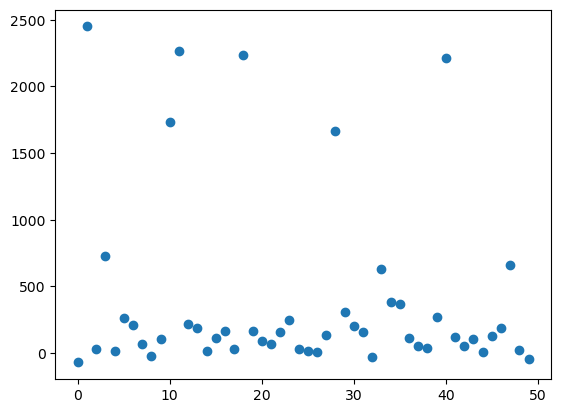

11.068324
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(11.068324, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699ca020>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c60f7e0; to 'JaxprTracer' at 0x15c60f790>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a9d9780>, ctx=JaxprEqnContext(compute_type=None, threefry

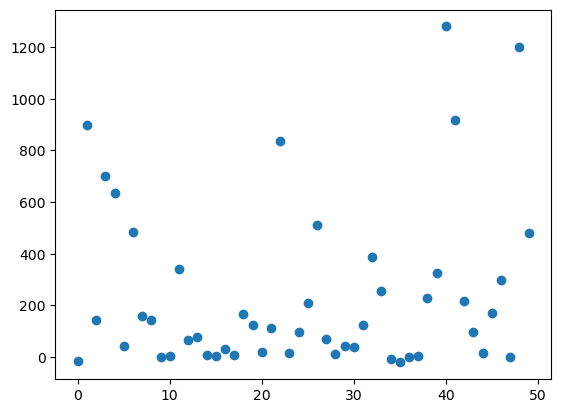

8.571518
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(8.571518, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c9d10>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15a8d5fd0; to 'JaxprTracer' at 0x15a8d5800>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a9d9a20>, ctx=JaxprEqnContext(compute_type=None, threefry_p

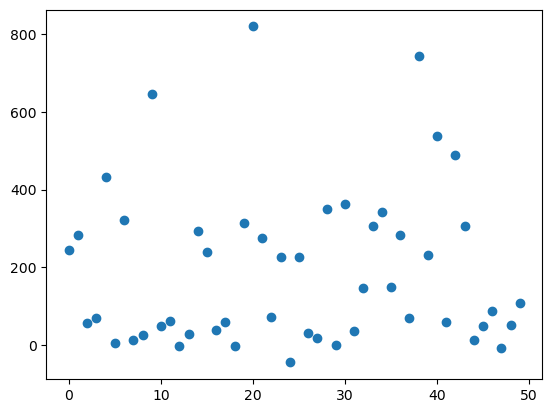

12.653318
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12.653318, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699c8730>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6a4f40; to 'JaxprTracer' at 0x15c6a4b80>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a9db340>, ctx=JaxprEqnContext(compute_type=None, threefry

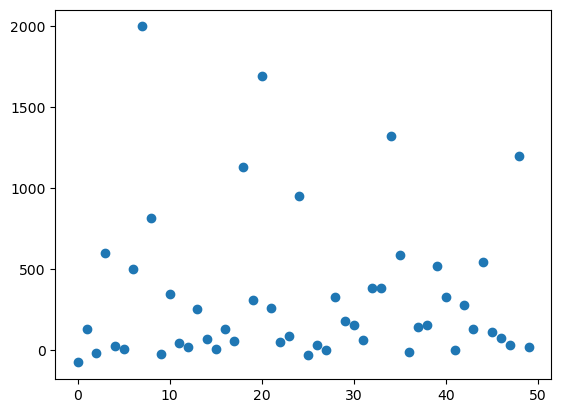

10.77896
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(10.77896, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699cb080>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x15c6fdb20; to 'JaxprTracer' at 0x15c6ffbf0>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a9dbe20>, ctx=JaxprEqnContext(compute_type=None, threefry_p

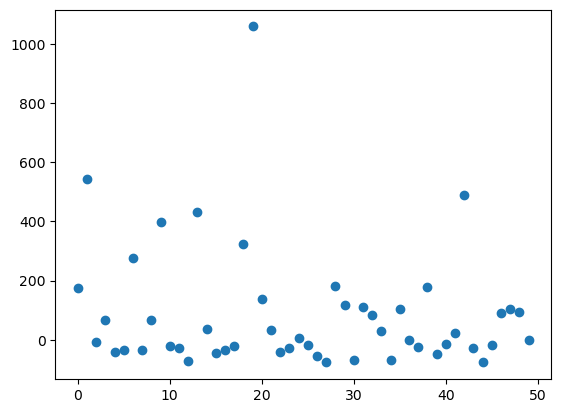

12.42939
Traced<ShapedArray(float32[])>with<JVPTrace> with
  primal = Array(12.42939, dtype=float32)
  tangent = Traced<ShapedArray(float32[])>with<JaxprTrace> with
    pval = (ShapedArray(float32[]), None)
    recipe = JaxprEqnRecipe(eqn_id=<object object at 0x1699cabb0>, in_tracers=(Traced<ShapedArray(float32[]):JaxprTrace>, Traced<ShapedArray(float32[]):JaxprTrace>), out_tracer_refs=[<weakref at 0x167bc9850; to 'JaxprTracer' at 0x167bcb560>], out_avals=[ShapedArray(float32[])], primitive=pjit, params={'jaxpr': { lambda ; a:f32[] b:f32[]. let c:f32[] = add a b in (c,) }, 'in_shardings': (UnspecifiedValue, UnspecifiedValue), 'out_shardings': (UnspecifiedValue,), 'in_layouts': (None, None), 'out_layouts': (None,), 'resource_env': None, 'donated_invars': (False, False), 'name': 'add', 'keep_unused': False, 'inline': True, 'compiler_options_kvs': ()}, effects=set(), source_info=<jax._src.source_info_util.SourceInfo object at 0x16a9f9810>, ctx=JaxprEqnContext(compute_type=None, threefry_p

KeyboardInterrupt: 

In [15]:
new_params,data_generator=NN(batch_size,num_epochs,n,net_params,5)
#Didn't plot here as this was not a low enough loss

In [ ]:
#Second run 
opt_init, opt_update, get_params = optimizers.adam(step_size=1e-5)
new2_params,data_generator2=NN(batch_size,num_epochs,n,new_params,2)
#We see that by the end the NN has learned some features as the percentage loss has decreased.
#Y axis is perecentage loss between output given by the NN for the initial inputs and the ouput given by the NN for the SL(2,z) transformations of those inputs
#x axis is just labeliing the points. There are 50 points in a batch

2.4100442
Traced<ConcreteArray(2.4100442)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4100442, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


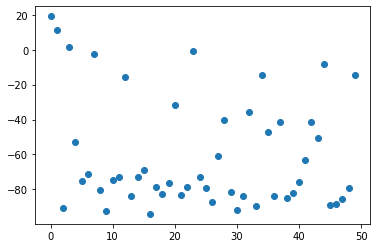

50.914333
Traced<ConcreteArray(50.914333)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(50.914333, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


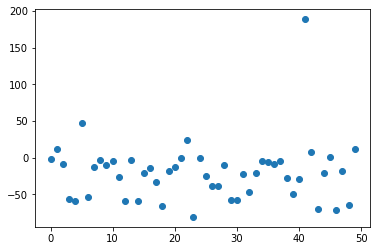

25951.182
Traced<ConcreteArray(25951.182)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(25951.182, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


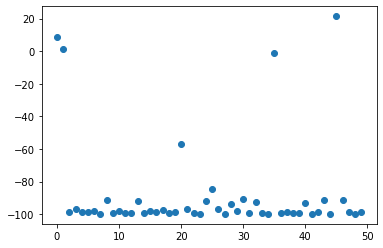

97976.375
Traced<ConcreteArray(97976.375)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(97976.375, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


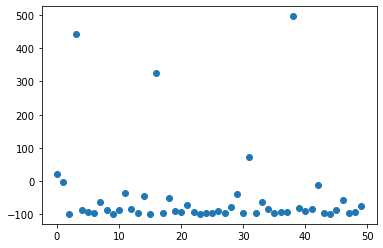

3.6988494
Traced<ConcreteArray(3.6988494)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6988494, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


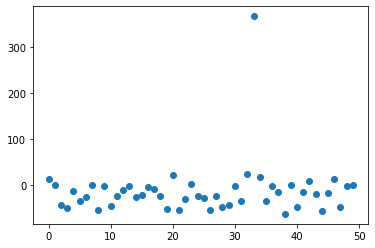

312.16275
Traced<ConcreteArray(312.16275)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(312.16275, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


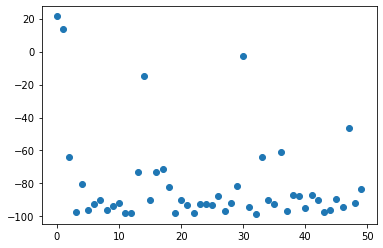

103095.555
Traced<ConcreteArray(103095.555)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(103095.555, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


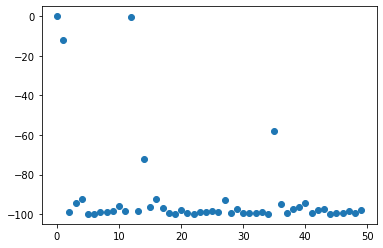

4.5545664
Traced<ConcreteArray(4.5545664)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.5545664, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


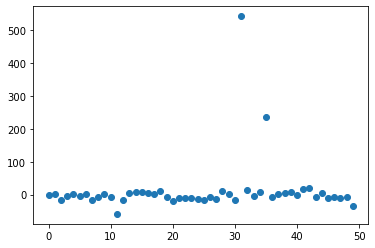

5.9079885
Traced<ConcreteArray(5.9079885)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.9079885, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


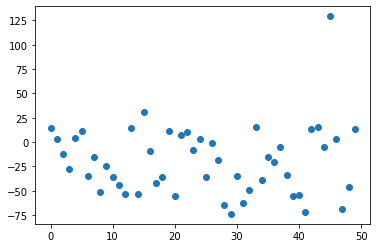

2.848479
Traced<ConcreteArray(2.848479)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.848479, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


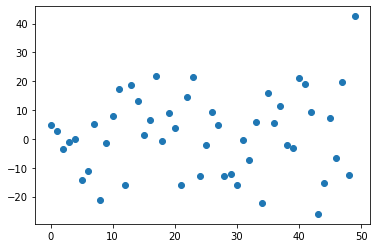

5.959555
Traced<ConcreteArray(5.959555)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.959555, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


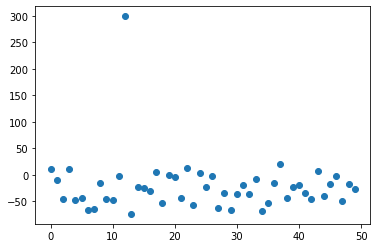

131.52357
Traced<ConcreteArray(131.52357)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(131.52357, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


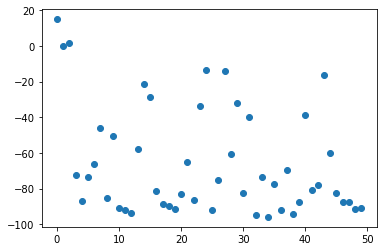

5.294634
Traced<ConcreteArray(5.294634)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.294634, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


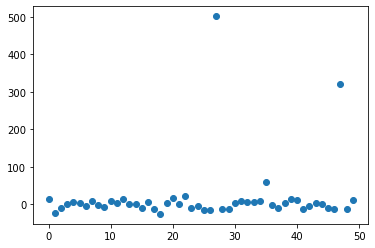

3.3125458
Traced<ConcreteArray(3.3125458)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3125458, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


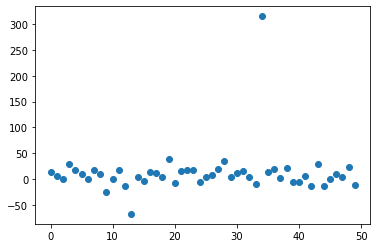

2.7133954
Traced<ConcreteArray(2.7133954)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7133954, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


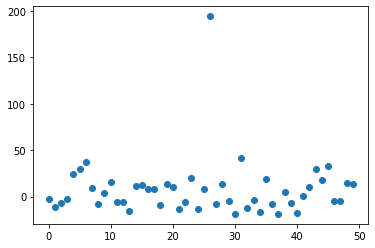

7.3373365
Traced<ConcreteArray(7.3373365)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.3373365, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


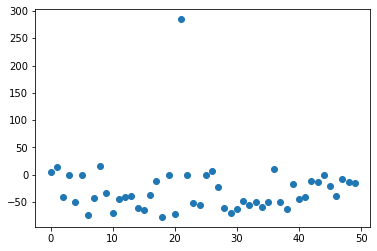

3.9402156
Traced<ConcreteArray(3.9402156)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9402156, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


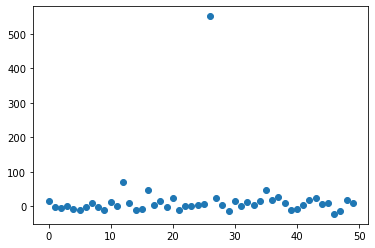

4.581871
Traced<ConcreteArray(4.581871)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.581871, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


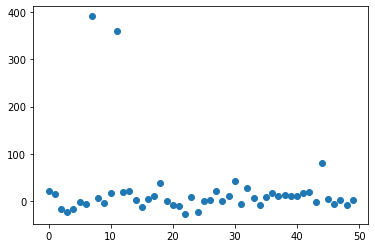

39128.527
Traced<ConcreteArray(39128.527)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(39128.527, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


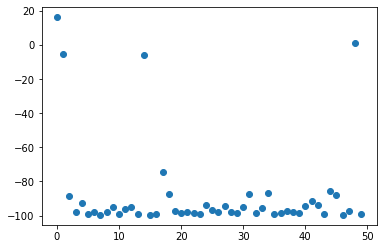

23045.889
Traced<ConcreteArray(23045.889)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(23045.889, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


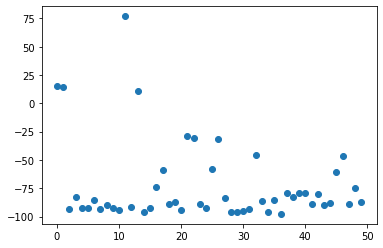

3.9434707
Traced<ConcreteArray(3.9434707)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9434707, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


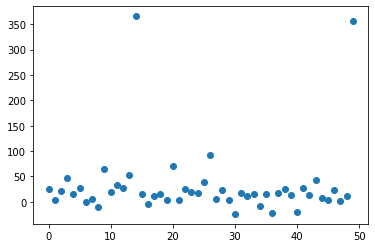

4.072048
Traced<ConcreteArray(4.072048)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.072048, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


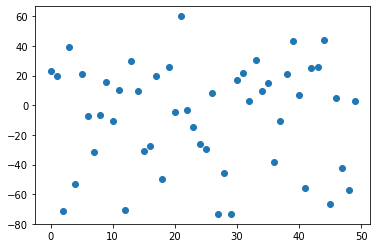

7.2937274
Traced<ConcreteArray(7.2937274)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.2937274, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


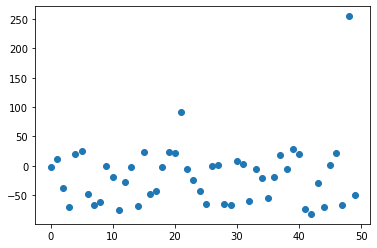

3.8791487
Traced<ConcreteArray(3.8791487)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8791487, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


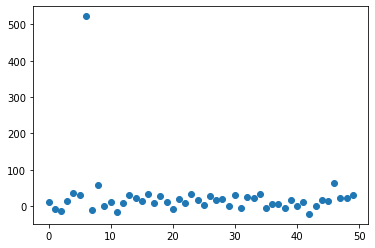

31.467083
Traced<ConcreteArray(31.467083)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(31.467083, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


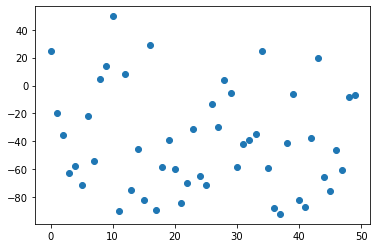

215857.84
Traced<ConcreteArray(215857.84)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(215857.84, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


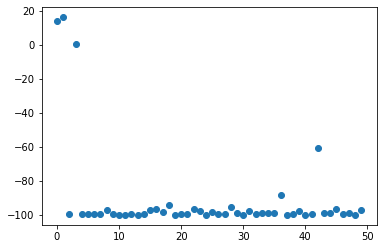

102159.59
Traced<ConcreteArray(102159.59)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(102159.59, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


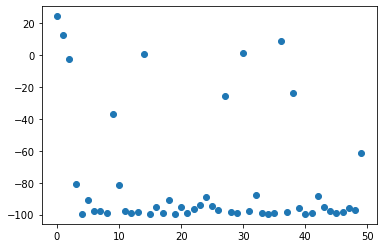

161.18848
Traced<ConcreteArray(161.18848)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(161.18848, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


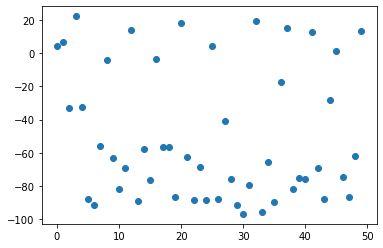

5.764051
Traced<ConcreteArray(5.764051)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.764051, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


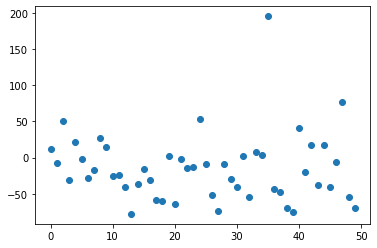

4.137534
Traced<ConcreteArray(4.137534)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.137534, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


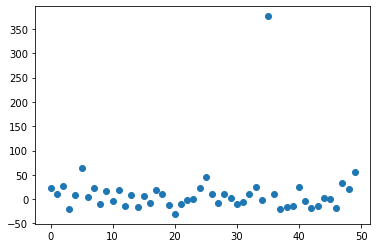

266195.7
Traced<ConcreteArray(266195.7)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(266195.7, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


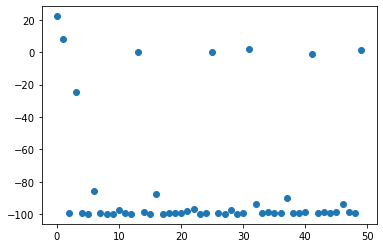

1867.7188
Traced<ConcreteArray(1867.7188)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1867.7188, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


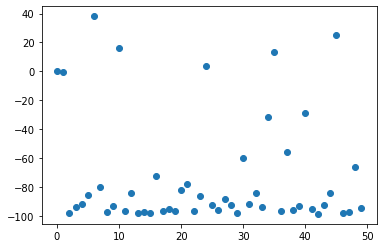

959.2744
Traced<ConcreteArray(959.2744)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(959.2744, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


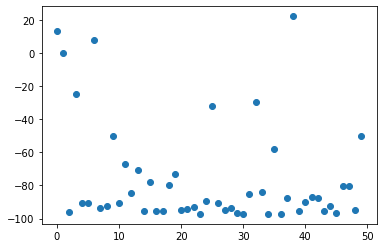

11.916706
Traced<ConcreteArray(11.916706)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(11.916706, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


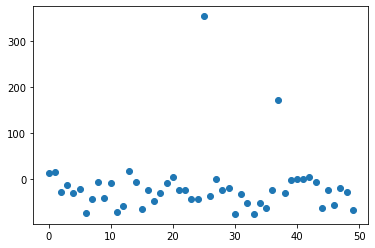

7.161379
Traced<ConcreteArray(7.161379)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.161379, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


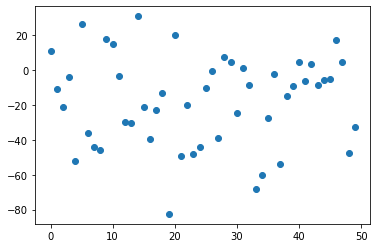

6.4125295
Traced<ConcreteArray(6.4125295)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.4125295, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


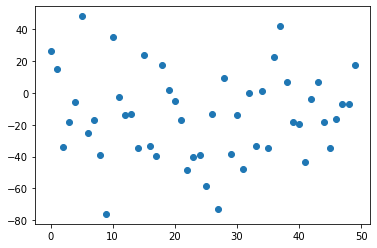

10802.341
Traced<ConcreteArray(10802.341)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(10802.341, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


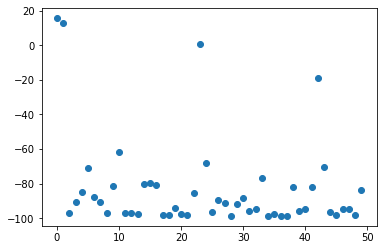

3.7536259
Traced<ConcreteArray(3.7536259)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.7536259, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


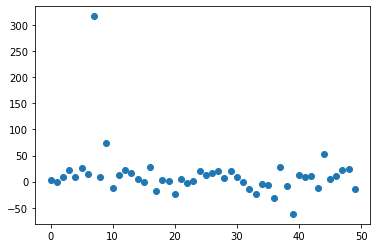

5693.681
Traced<ConcreteArray(5693.681)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5693.681, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


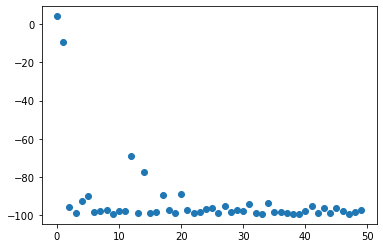

12428.999
Traced<ConcreteArray(12428.999)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(12428.999, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


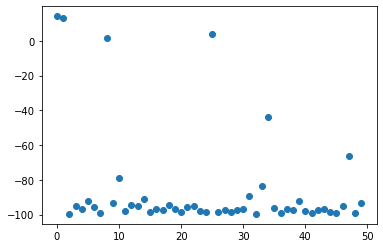

20411.346
Traced<ConcreteArray(20411.346)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(20411.346, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


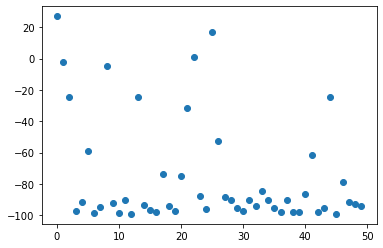

2.9422162
Traced<ConcreteArray(2.9422162)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9422162, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


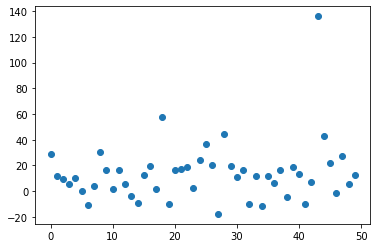

10.497549
Traced<ConcreteArray(10.497549)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(10.497549, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


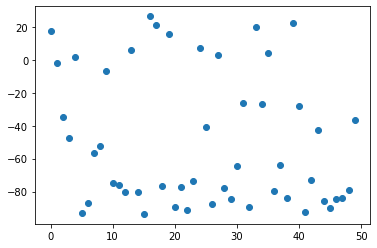

4.8026247
Traced<ConcreteArray(4.8026247)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.8026247, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


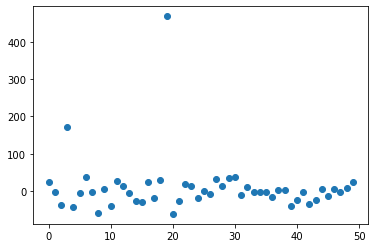

4.415893
Traced<ConcreteArray(4.415893)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.415893, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


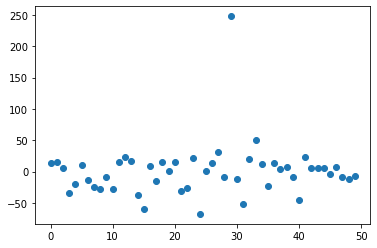

535.7142
Traced<ConcreteArray(535.7142)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(535.7142, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


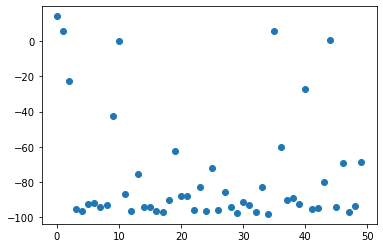

77996.125
Traced<ConcreteArray(77996.125)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(77996.125, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


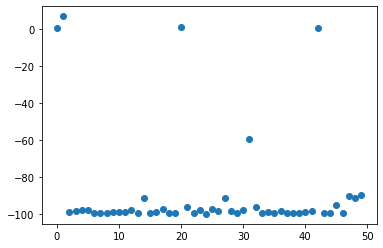

41733.355
Traced<ConcreteArray(41733.355)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(41733.355, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


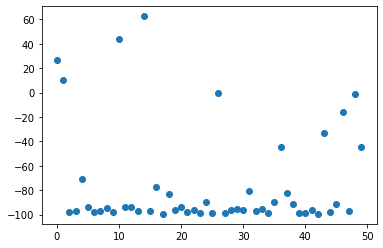

2.6472452
Traced<ConcreteArray(2.6472452)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6472452, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


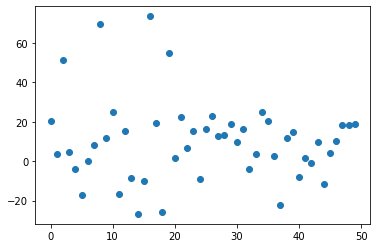

63688.67
Traced<ConcreteArray(63688.67)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(63688.67, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


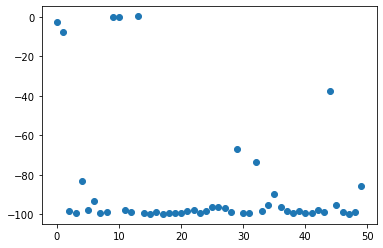

2.9713445
Traced<ConcreteArray(2.9713445)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9713445, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


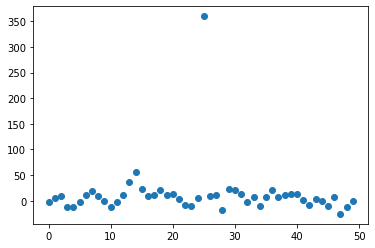

16.049572
Traced<ConcreteArray(16.049572)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(16.049572, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


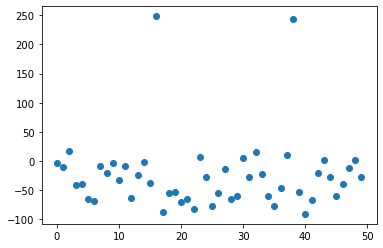

182378.5
Traced<ConcreteArray(182378.5)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(182378.5, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


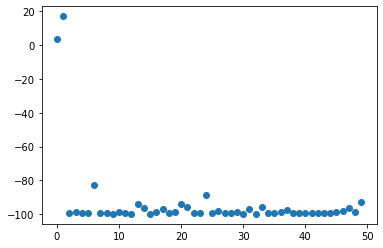

7.5921097
Traced<ConcreteArray(7.5921097)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.5921097, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


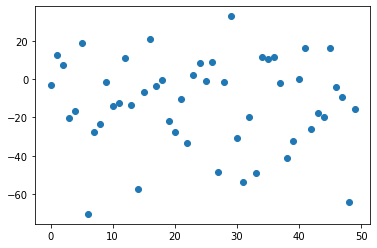

3.1312263
Traced<ConcreteArray(3.1312263)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1312263, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


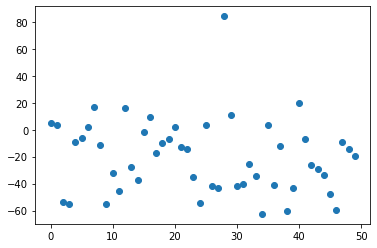

10349.32
Traced<ConcreteArray(10349.32)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(10349.32, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


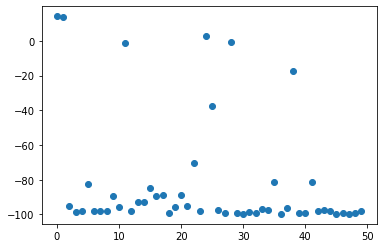

16106.819
Traced<ConcreteArray(16106.819)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(16106.819, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


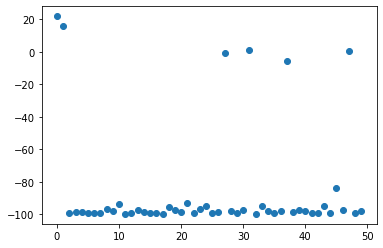

45513.547
Traced<ConcreteArray(45513.547)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(45513.547, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


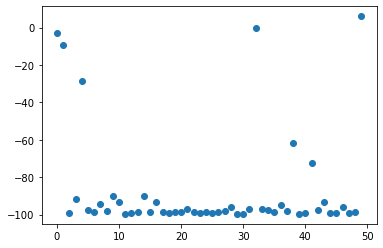

5.9248896
Traced<ConcreteArray(5.9248896)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.9248896, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


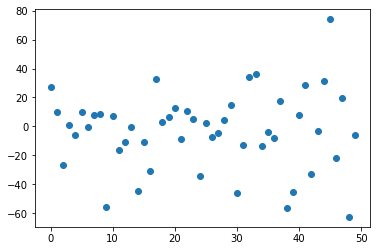

21841.121
Traced<ConcreteArray(21841.121)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(21841.121, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


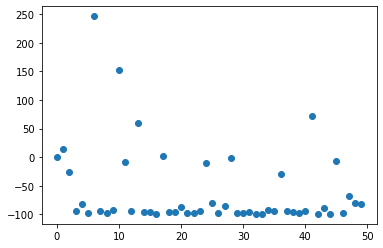

2976.3352
Traced<ConcreteArray(2976.3352)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2976.3352, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


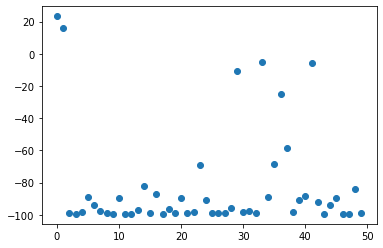

3.3109741
Traced<ConcreteArray(3.3109741)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3109741, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


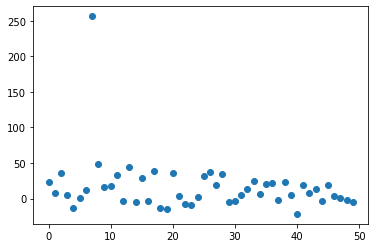

2.5522988
Traced<ConcreteArray(2.5522988)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5522988, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


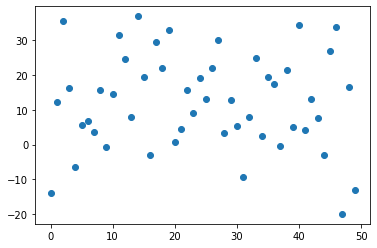

114816.05
Traced<ConcreteArray(114816.05)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(114816.05, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


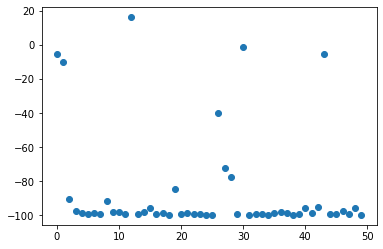

334.54083
Traced<ConcreteArray(334.54083)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(334.54083, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


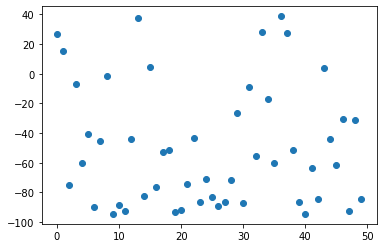

16094.109
Traced<ConcreteArray(16094.109)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(16094.109, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


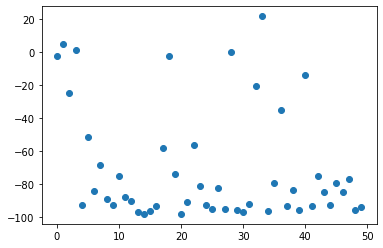

2.9954722
Traced<ConcreteArray(2.9954722)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9954722, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


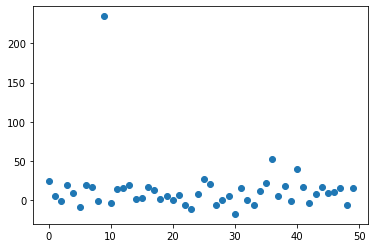

3.0030284
Traced<ConcreteArray(3.0030284)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0030284, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


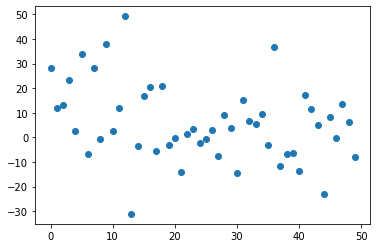

568.31226
Traced<ConcreteArray(568.31226)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(568.31226, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


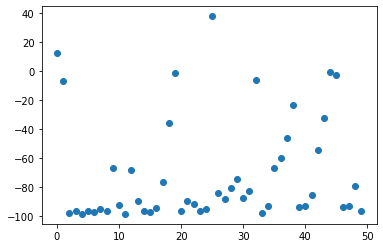

1077.9263
Traced<ConcreteArray(1077.9263)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1077.9263, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


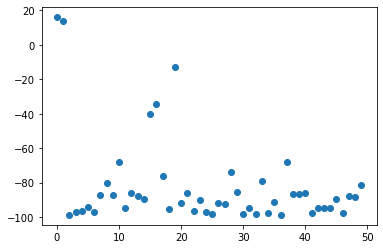

137549.92
Traced<ConcreteArray(137549.92)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(137549.92, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


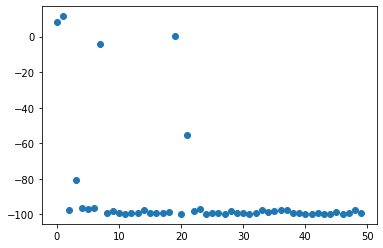

11.761789
Traced<ConcreteArray(11.761789)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(11.761789, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


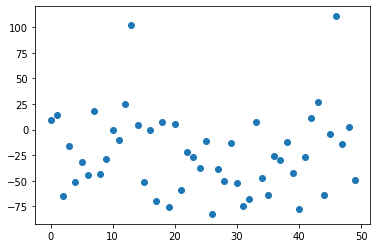

1507.2687
Traced<ConcreteArray(1507.2687)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1507.2687, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


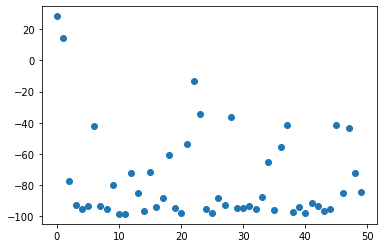

6.769058
Traced<ConcreteArray(6.769058)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.769058, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


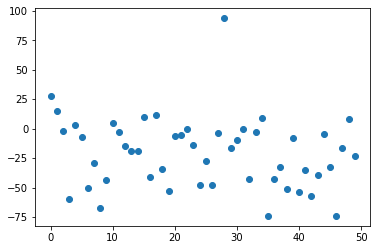

599.04926
Traced<ConcreteArray(599.04926)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(599.04926, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


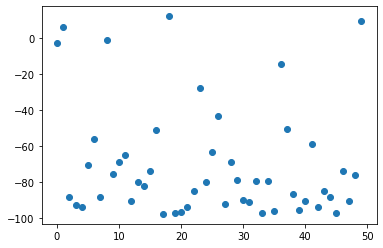

37307.46
Traced<ConcreteArray(37307.46)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(37307.46, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


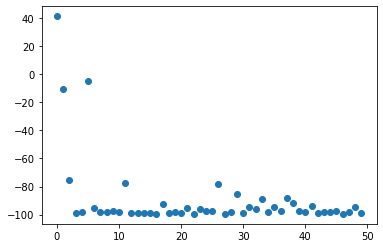

20953.73
Traced<ConcreteArray(20953.73)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(20953.73, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


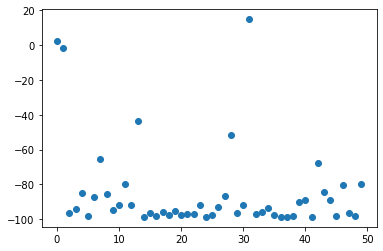

2.723725
Traced<ConcreteArray(2.723725)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.723725, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


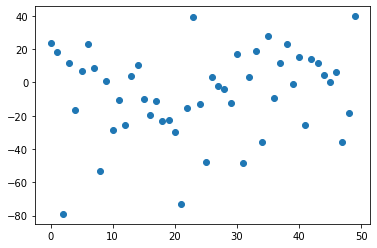

34764.176
Traced<ConcreteArray(34764.176)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(34764.176, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


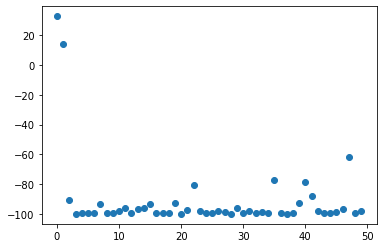

12.149471
Traced<ConcreteArray(12.149471)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(12.149471, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


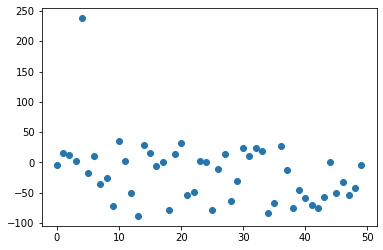

70598.65
Traced<ConcreteArray(70598.65)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(70598.65, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


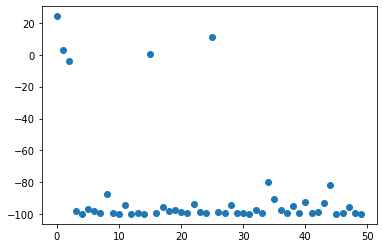

552.9564
Traced<ConcreteArray(552.9564)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(552.9564, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


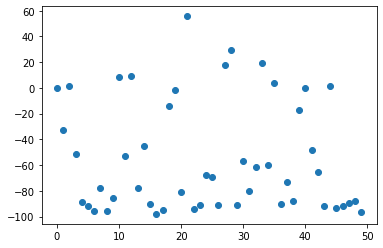

26075.643
Traced<ConcreteArray(26075.643)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(26075.643, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


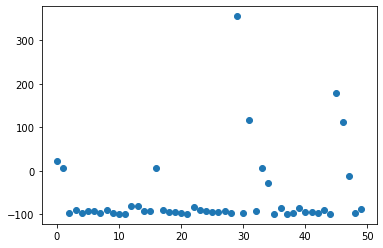

1786.0985
Traced<ConcreteArray(1786.0985)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1786.0985, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


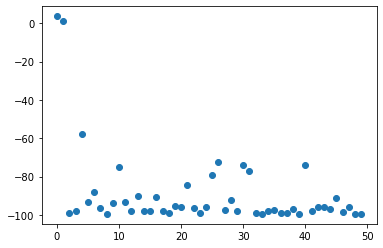

3.269637
Traced<ConcreteArray(3.269637)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.269637, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


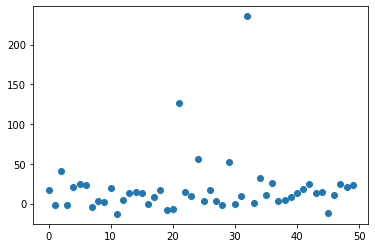

44766.836
Traced<ConcreteArray(44766.836)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(44766.836, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


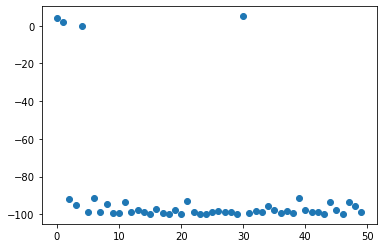

3.4810133
Traced<ConcreteArray(3.4810133)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4810133, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


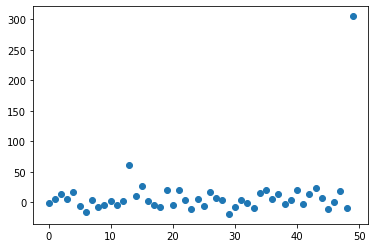

594.84357
Traced<ConcreteArray(594.84357)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(594.84357, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


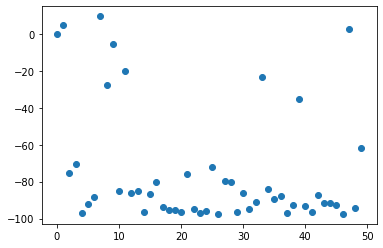

2.8915975
Traced<ConcreteArray(2.8915975)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8915975, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


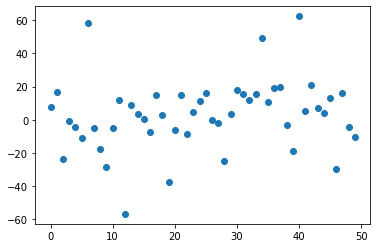

1079.7826
Traced<ConcreteArray(1079.7826)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1079.7826, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


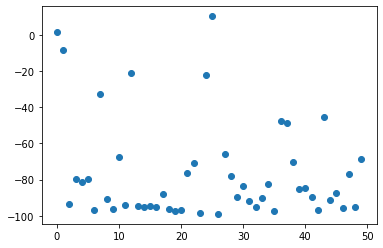

63684.625
Traced<ConcreteArray(63684.625)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(63684.625, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


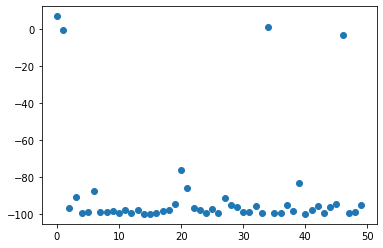

20550.096
Traced<ConcreteArray(20550.096)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(20550.096, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


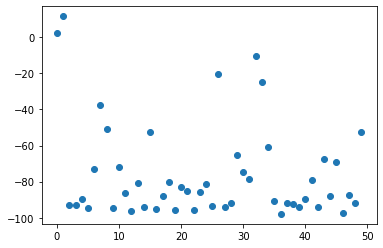

7.346487
Traced<ConcreteArray(7.346487)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.346487, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


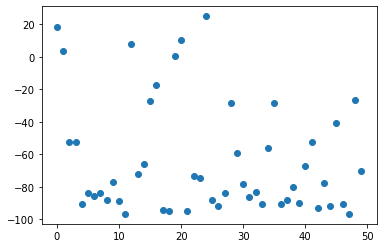

146.3361
Traced<ConcreteArray(146.3361)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(146.3361, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


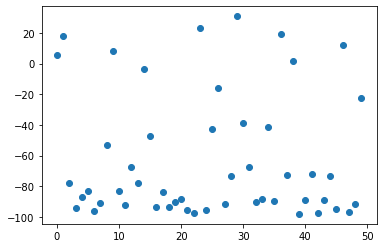

504.27914
Traced<ConcreteArray(504.27914)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(504.27914, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


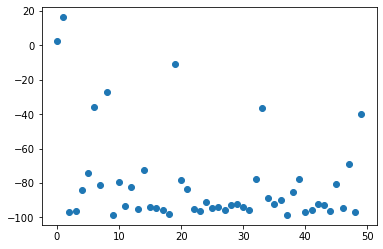

1554.8285
Traced<ConcreteArray(1554.8285)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1554.8285, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


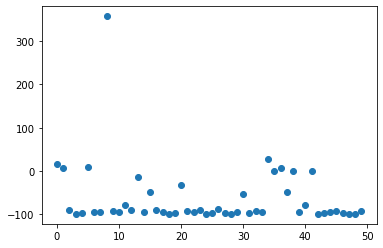

2568.1392
Traced<ConcreteArray(2568.1392)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2568.1392, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


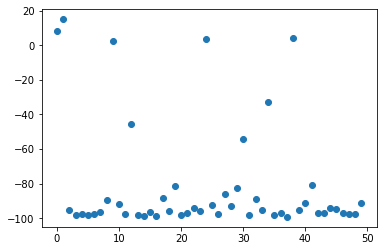

2814.8494
Traced<ConcreteArray(2814.8494)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2814.8494, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


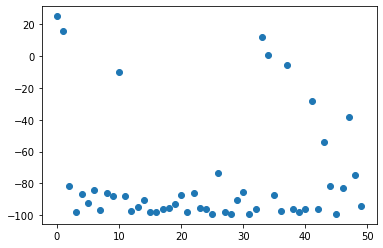

94.16079
Traced<ConcreteArray(94.16079)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(94.16079, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


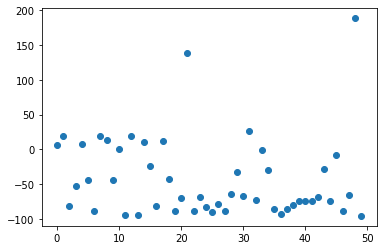

62.501255
Traced<ConcreteArray(62.501255)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(62.501255, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


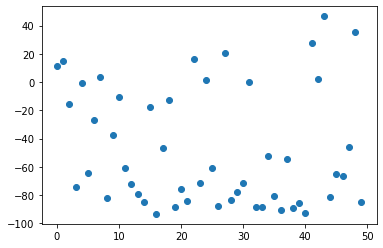

50.401928
Traced<ConcreteArray(50.401928)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(50.401928, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


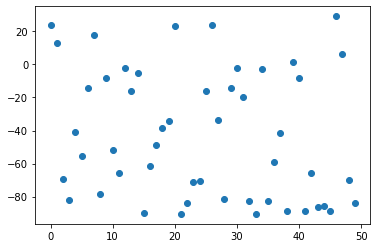

42.229958
Traced<ConcreteArray(42.229958)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(42.229958, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


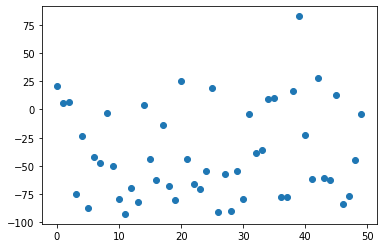

587519.1
Traced<ConcreteArray(587519.1)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(587519.1, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


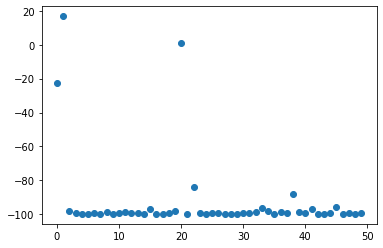

2.8970273
Traced<ConcreteArray(2.8970273)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8970273, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


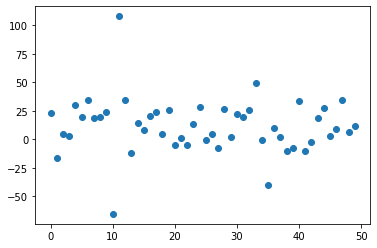

4.208645
Traced<ConcreteArray(4.208645)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.208645, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


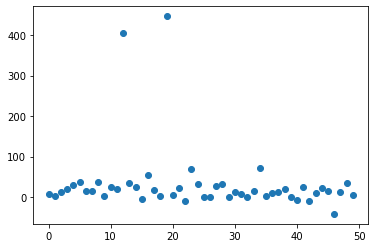

4.098957
Traced<ConcreteArray(4.098957)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.098957, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


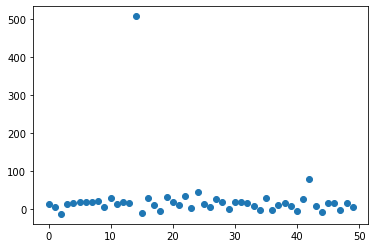

66.83913
Traced<ConcreteArray(66.83913)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(66.83913, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


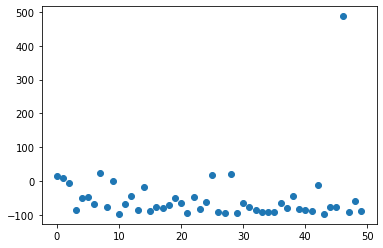

4.2083645
Traced<ConcreteArray(4.2083645)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.2083645, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


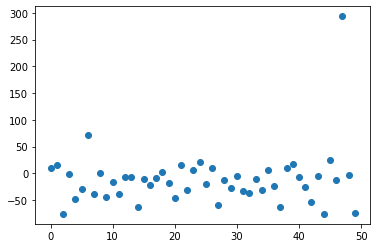

73773.516
Traced<ConcreteArray(73773.516)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(73773.516, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


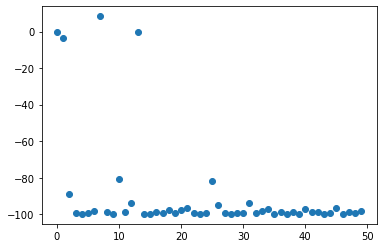

4.9272156
Traced<ConcreteArray(4.9272156)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.9272156, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


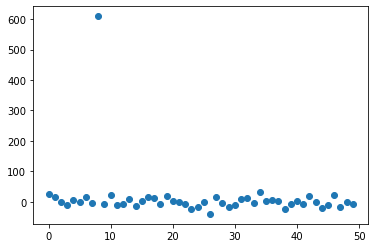

2.7628746
Traced<ConcreteArray(2.7628746)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7628746, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


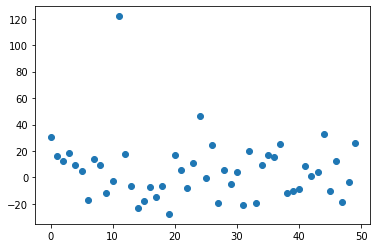

426.12753
Traced<ConcreteArray(426.12753)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(426.12753, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


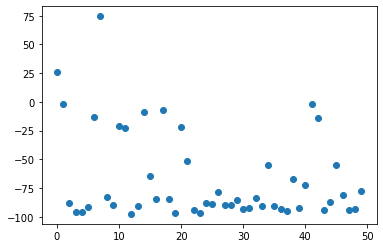

476.27072
Traced<ConcreteArray(476.27072)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(476.27072, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


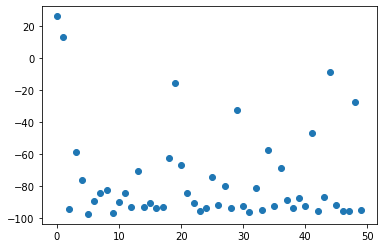

3.4115205
Traced<ConcreteArray(3.4115205)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4115205, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


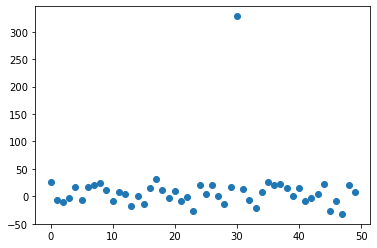

8.497378
Traced<ConcreteArray(8.497378)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(8.497378, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


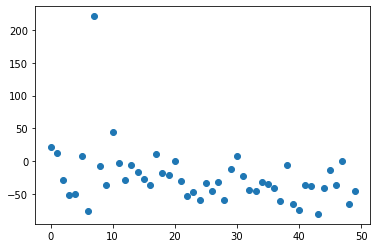

10.691734
Traced<ConcreteArray(10.691734)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(10.691734, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


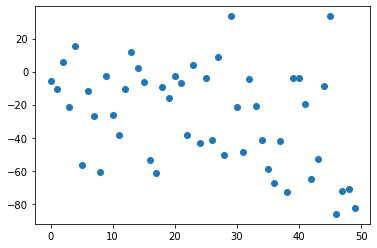

794.53253
Traced<ConcreteArray(794.53253)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(794.53253, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


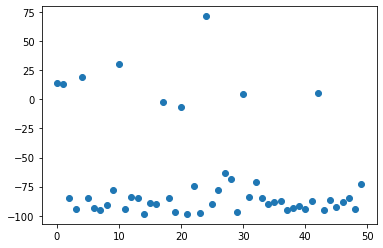

4.4901724
Traced<ConcreteArray(4.4901724)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.4901724, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


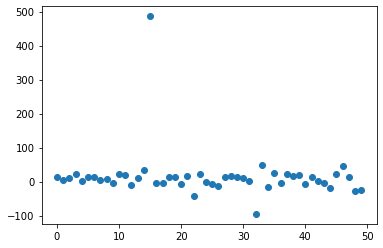

90358.555
Traced<ConcreteArray(90358.555)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(90358.555, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


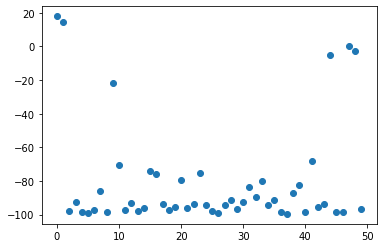

31.41663
Traced<ConcreteArray(31.41663)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(31.41663, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


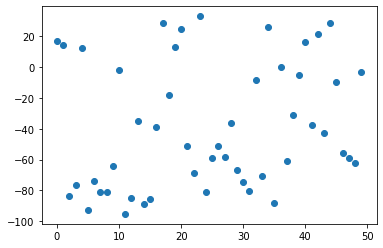

5980.715
Traced<ConcreteArray(5980.715)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5980.715, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


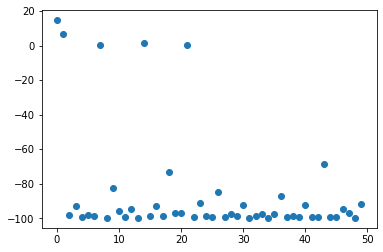

414.5793
Traced<ConcreteArray(414.5793)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(414.5793, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


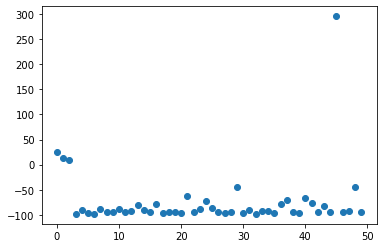

12.040587
Traced<ConcreteArray(12.040587)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(12.040587, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


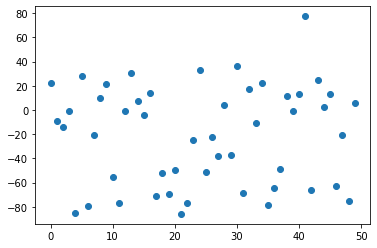

1222.1145
Traced<ConcreteArray(1222.1145)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1222.1145, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


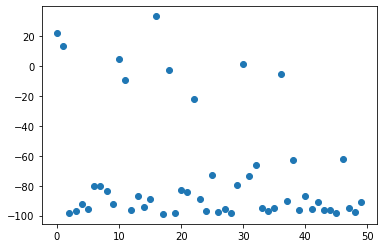

233094.73
Traced<ConcreteArray(233094.73)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(233094.73, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


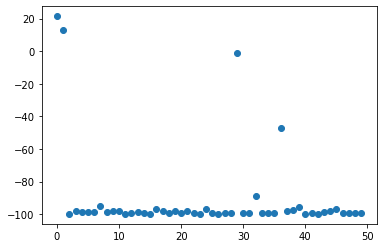

12.283662
Traced<ConcreteArray(12.283662)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(12.283662, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


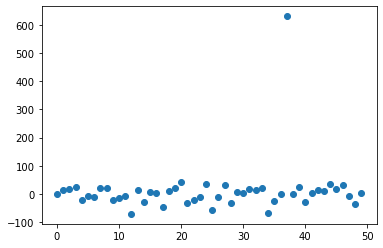

5.161808
Traced<ConcreteArray(5.161808)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.161808, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


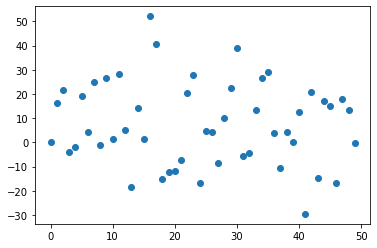

32.130344
Traced<ConcreteArray(32.130344)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(32.130344, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


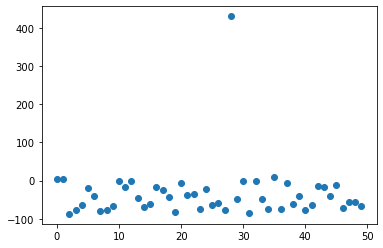

1152.3413
Traced<ConcreteArray(1152.3413)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1152.3413, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


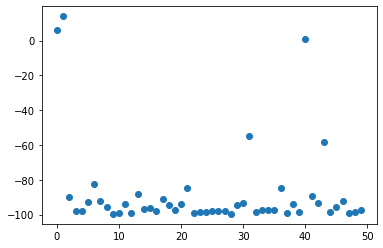

22464.92
Traced<ConcreteArray(22464.92)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(22464.92, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


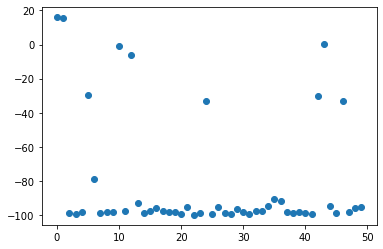

14605.179
Traced<ConcreteArray(14605.179)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(14605.179, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


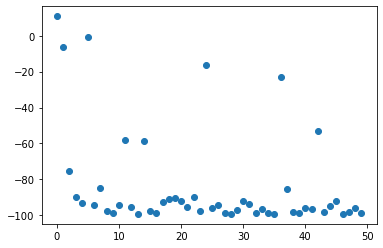

3.4366217
Traced<ConcreteArray(3.4366217)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4366217, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


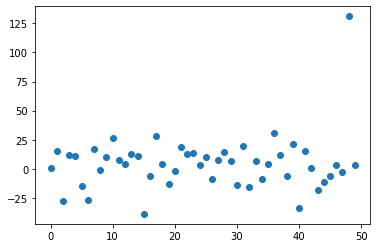

1556.226
Traced<ConcreteArray(1556.226)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1556.226, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


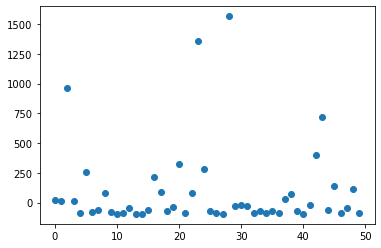

2.5697534
Traced<ConcreteArray(2.5697534)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5697534, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


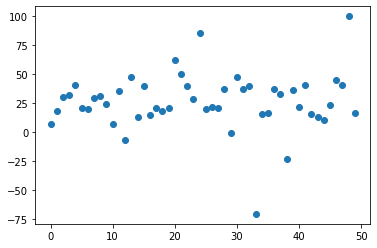

3273.6921
Traced<ConcreteArray(3273.6921)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3273.6921, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


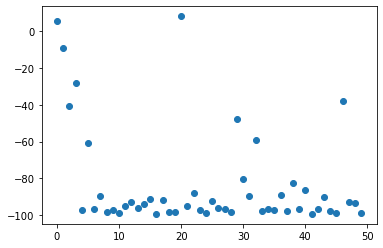

6292.862
Traced<ConcreteArray(6292.862)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6292.862, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


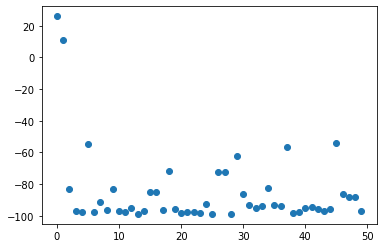

23.752352
Traced<ConcreteArray(23.752352)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(23.752352, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


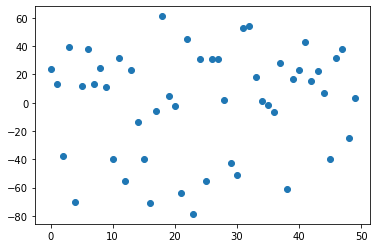

665.92035
Traced<ConcreteArray(665.92035)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(665.92035, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


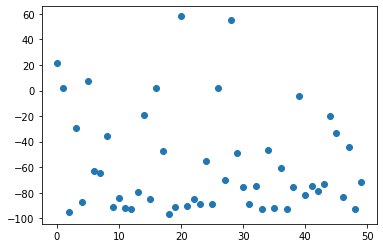

2.4287622
Traced<ConcreteArray(2.4287622)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4287622, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


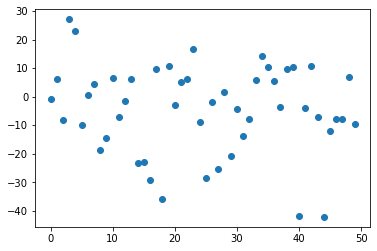

982.84515
Traced<ConcreteArray(982.84515)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(982.84515, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


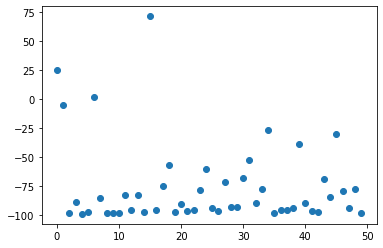

2.49974
Traced<ConcreteArray(2.49974)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.49974, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


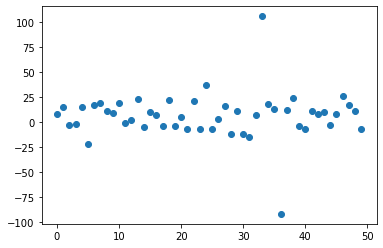

33.49949
Traced<ConcreteArray(33.49949)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(33.49949, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


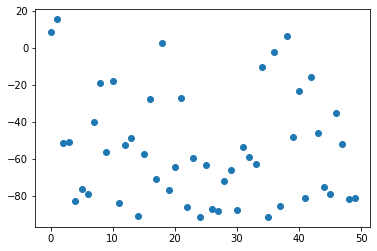

3.9078074
Traced<ConcreteArray(3.9078074)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9078074, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


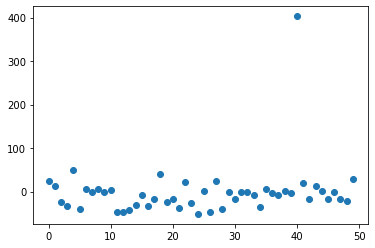

8451.443
Traced<ConcreteArray(8451.443)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(8451.443, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


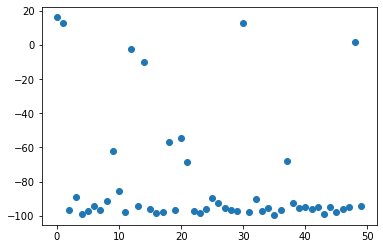

58.58583
Traced<ConcreteArray(58.58583)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(58.58583, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


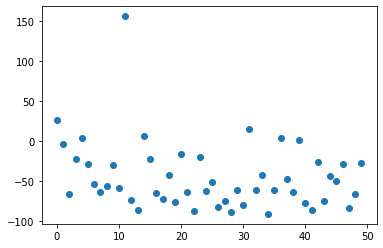

2.6186788
Traced<ConcreteArray(2.6186788)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6186788, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


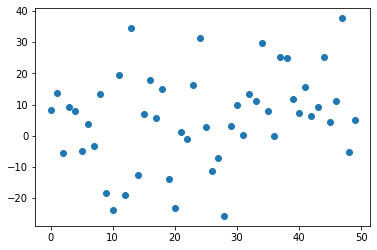

2.6595097
Traced<ConcreteArray(2.6595097)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6595097, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


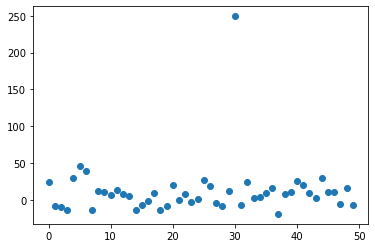

181.76549
Traced<ConcreteArray(181.76549)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(181.76549, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


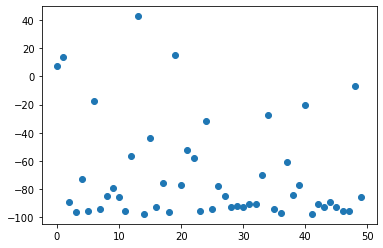

2.7903106
Traced<ConcreteArray(2.7903106)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7903106, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


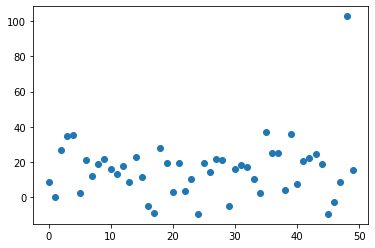

3.3765368
Traced<ConcreteArray(3.3765368)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3765368, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


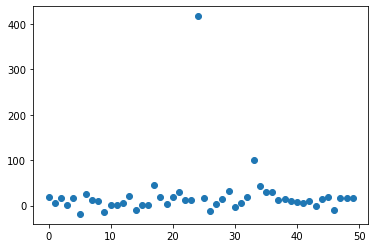

3.8232114
Traced<ConcreteArray(3.8232114)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8232114, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


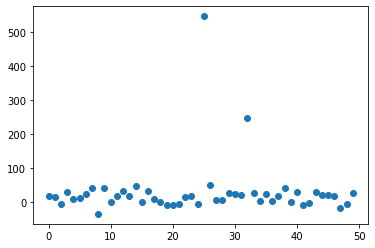

44.267498
Traced<ConcreteArray(44.267498)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(44.267498, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


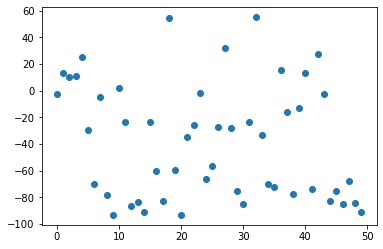

126.190956
Traced<ConcreteArray(126.190956)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(126.190956, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


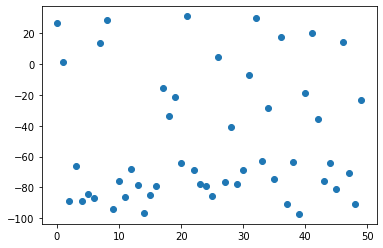

3.3511314
Traced<ConcreteArray(3.3511314)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3511314, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


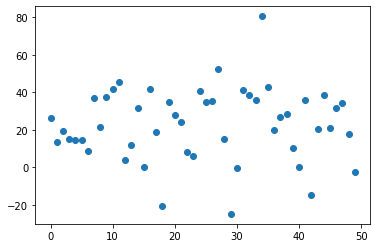

74.30671
Traced<ConcreteArray(74.30671)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(74.30671, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


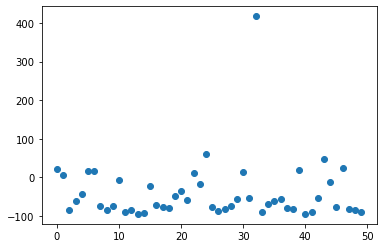

6.775769
Traced<ConcreteArray(6.775769)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.775769, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


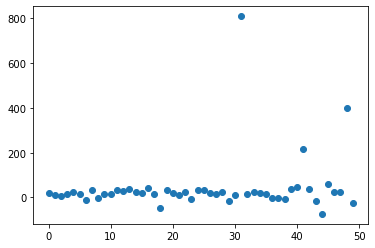

4.3283777
Traced<ConcreteArray(4.3283777)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.3283777, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


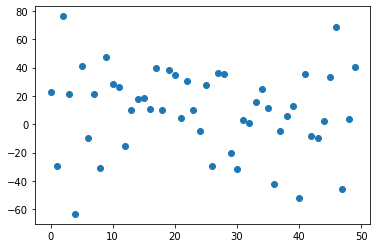

4.564957
Traced<ConcreteArray(4.564957)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.564957, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


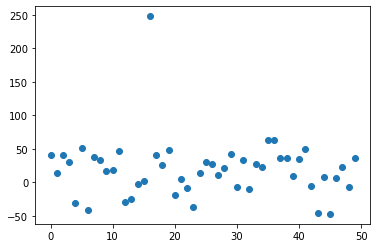

3.9235814
Traced<ConcreteArray(3.9235814)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9235814, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


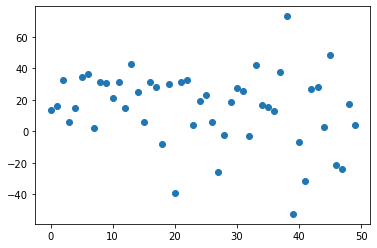

14787.935
Traced<ConcreteArray(14787.935)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(14787.935, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


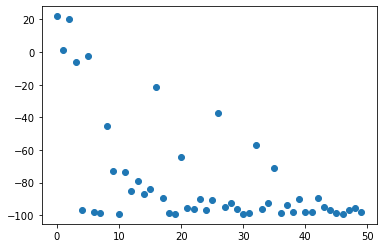

51.46453
Traced<ConcreteArray(51.46453)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(51.46453, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


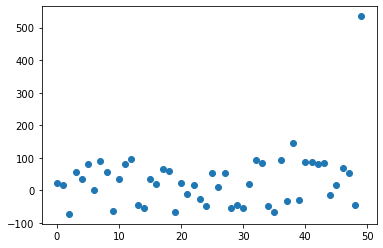

555.4102
Traced<ConcreteArray(555.4102)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(555.4102, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


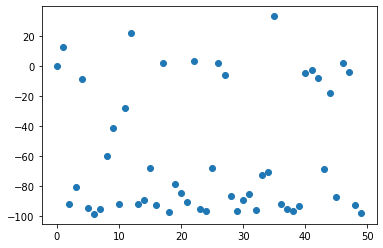

1588.1891
Traced<ConcreteArray(1588.1891)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1588.1891, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


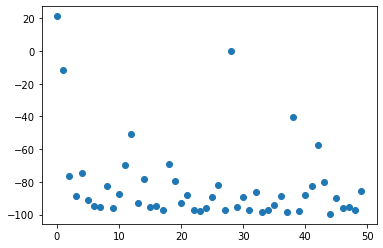

2.2262006
Traced<ConcreteArray(2.2262006)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2262006, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


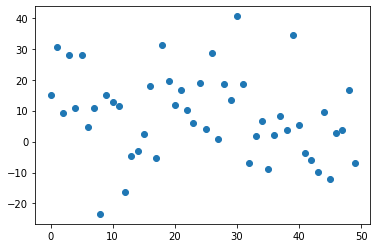

2.74903
Traced<ConcreteArray(2.74903)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.74903, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


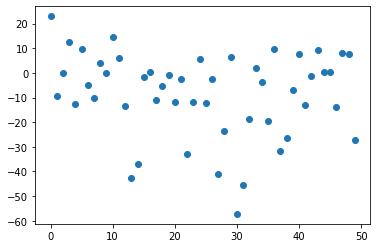

2.712627
Traced<ConcreteArray(2.712627)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.712627, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


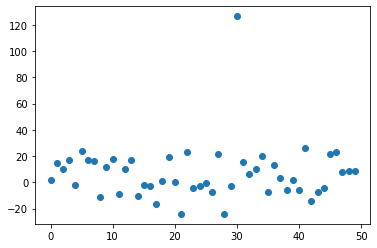

14767.512
Traced<ConcreteArray(14767.512)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(14767.512, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


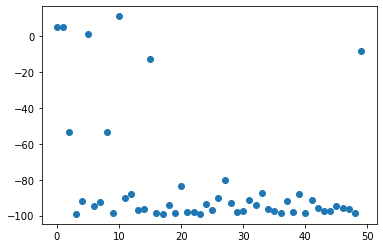

18.471113
Traced<ConcreteArray(18.471113)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(18.471113, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


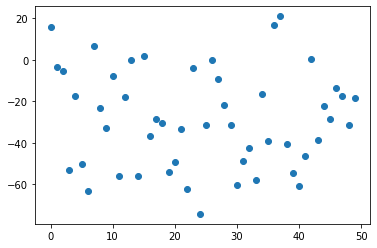

522.1671
Traced<ConcreteArray(522.1671)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(522.1671, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


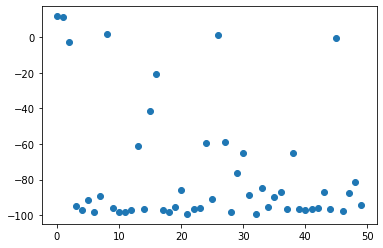

2.7629814
Traced<ConcreteArray(2.7629814)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7629814, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


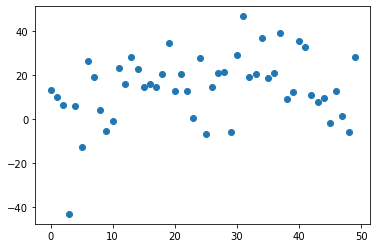

4.9935546
Traced<ConcreteArray(4.9935546)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.9935546, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


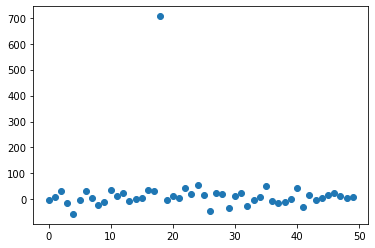

157.50244
Traced<ConcreteArray(157.50244)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(157.50244, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


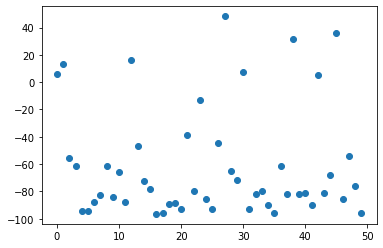

2.5798612
Traced<ConcreteArray(2.5798612)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5798612, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


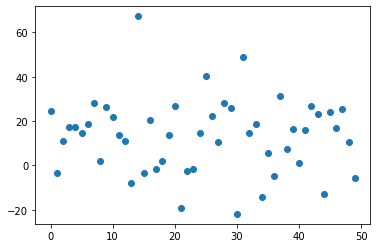

39823.75
Traced<ConcreteArray(39823.75)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(39823.75, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


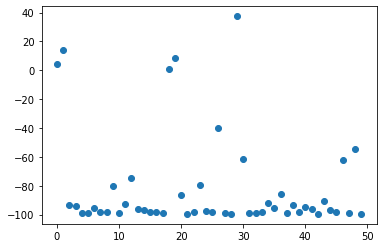

8242.58
Traced<ConcreteArray(8242.58)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(8242.58, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


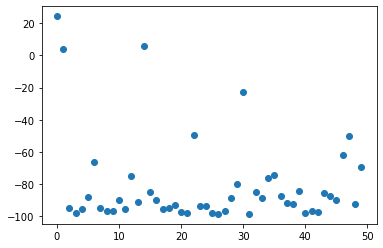

967.2705
Traced<ConcreteArray(967.2705)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(967.2705, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


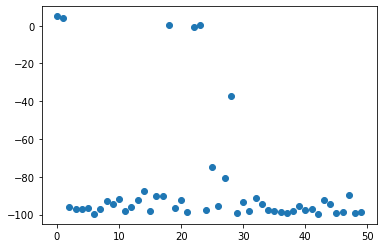

12373.404
Traced<ConcreteArray(12373.404)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(12373.404, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


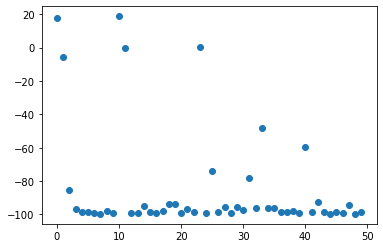

3.8983116
Traced<ConcreteArray(3.8983116)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8983116, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


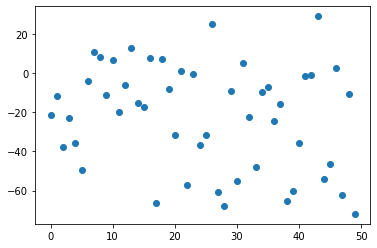

22610.656
Traced<ConcreteArray(22610.656)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(22610.656, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


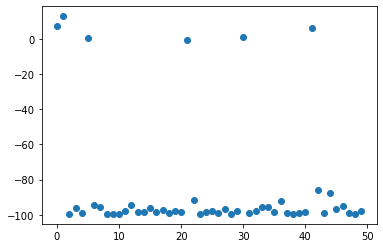

7.108956
Traced<ConcreteArray(7.108956)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.108956, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


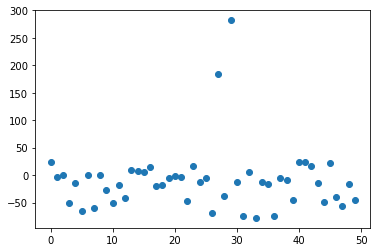

332.82263
Traced<ConcreteArray(332.82263)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(332.82263, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


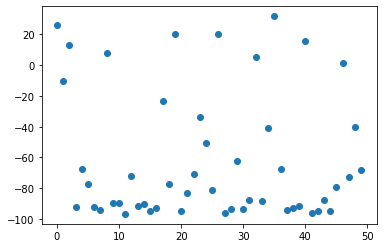

2.8809338
Traced<ConcreteArray(2.8809338)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8809338, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


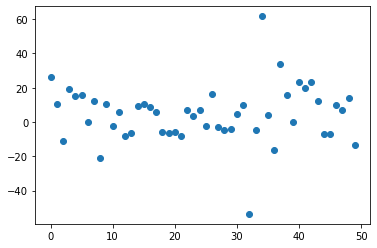

2.5241382
Traced<ConcreteArray(2.5241382)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5241382, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


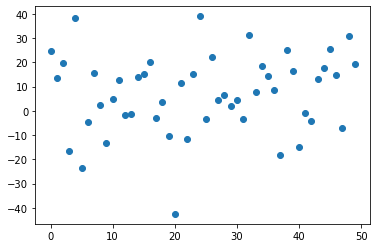

3.0821464
Traced<ConcreteArray(3.0821464)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0821464, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


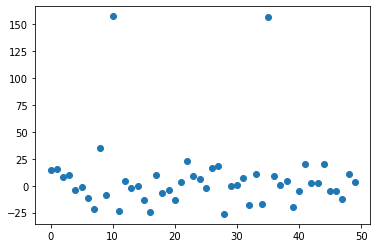

2.545909
Traced<ConcreteArray(2.545909)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.545909, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


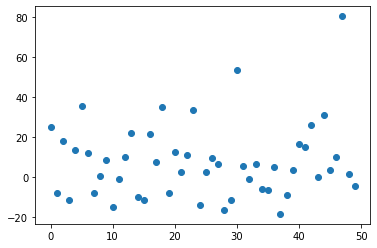

12212.033
Traced<ConcreteArray(12212.033)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(12212.033, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


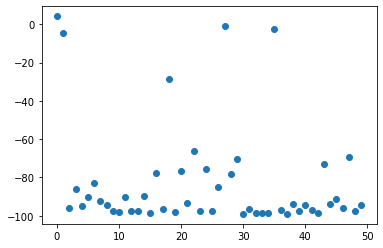

2.6873355
Traced<ConcreteArray(2.6873355)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6873355, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


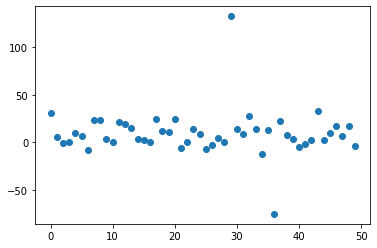

2.6978025
Traced<ConcreteArray(2.6978025)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6978025, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


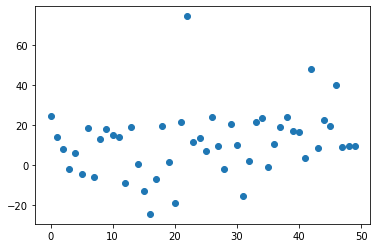

47.813652
Traced<ConcreteArray(47.813652)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(47.813652, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


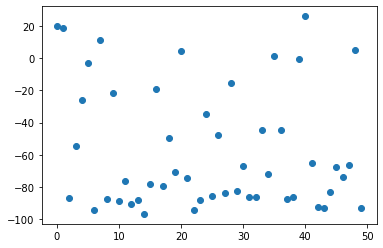

3.302194
Traced<ConcreteArray(3.302194)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.302194, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


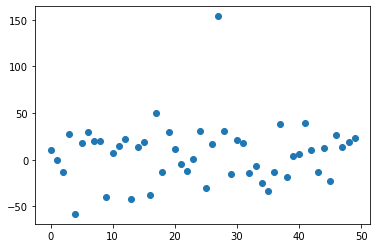

146.13103
Traced<ConcreteArray(146.13103)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(146.13103, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


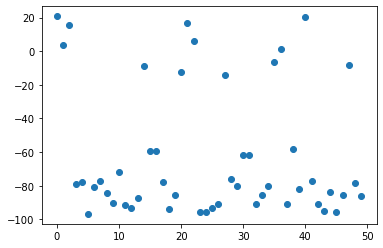

3.1594276
Traced<ConcreteArray(3.1594276)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1594276, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


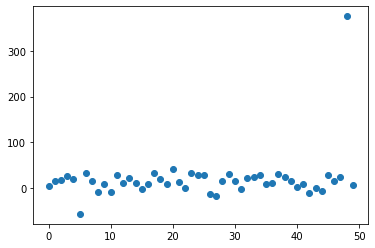

61900.473
Traced<ConcreteArray(61900.473)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(61900.473, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


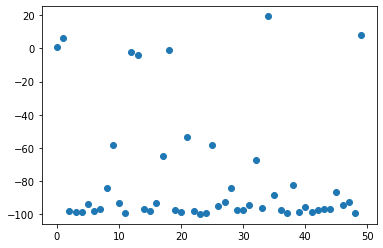

5.067274
Traced<ConcreteArray(5.067274)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.067274, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


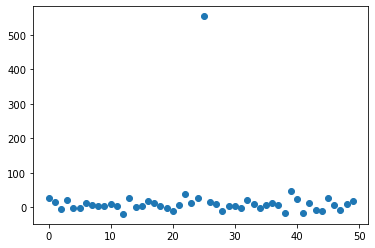

10.879897
Traced<ConcreteArray(10.879897)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(10.879897, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


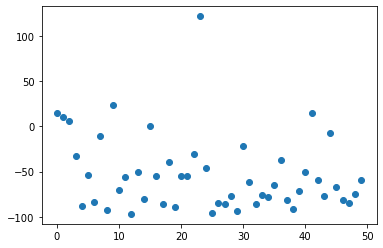

2.8168907
Traced<ConcreteArray(2.8168907)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8168907, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


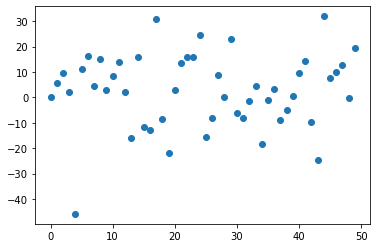

50687.457
Traced<ConcreteArray(50687.457)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(50687.457, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


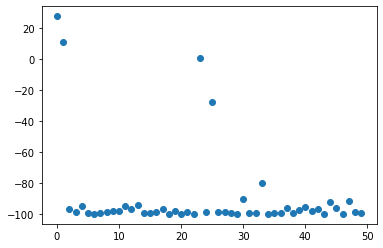

2.65269
Traced<ConcreteArray(2.65269)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.65269, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


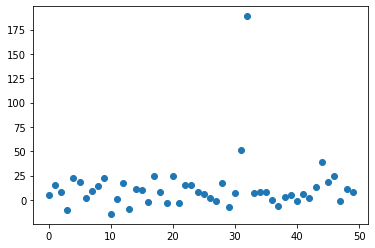

19898.0
Traced<ConcreteArray(19898.0)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(19898., dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


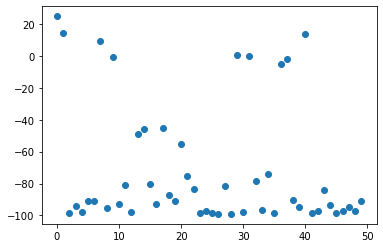

2.6735847
Traced<ConcreteArray(2.6735847)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6735847, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


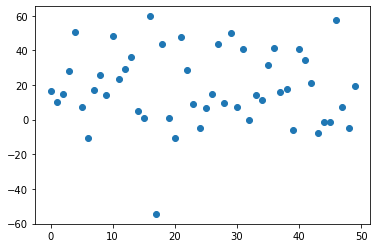

937.38855
Traced<ConcreteArray(937.38855)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(937.38855, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


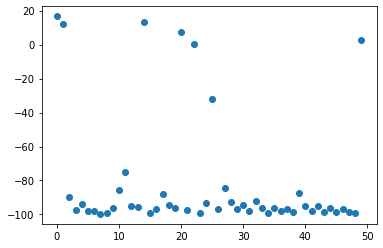

113.544945
Traced<ConcreteArray(113.544945)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(113.544945, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


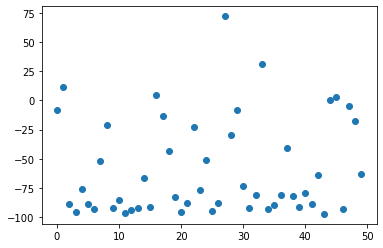

92.060524
Traced<ConcreteArray(92.060524)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(92.060524, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


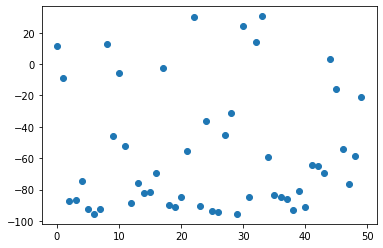

7.9075828
Traced<ConcreteArray(7.9075828)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.9075828, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


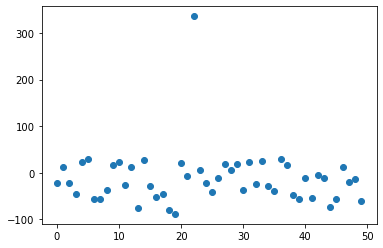

8.590906
Traced<ConcreteArray(8.590906)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(8.590906, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


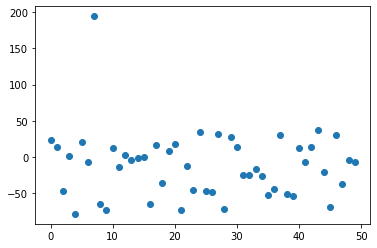

9.355338
Traced<ConcreteArray(9.355338)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(9.355338, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


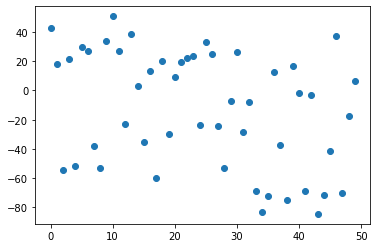

14.954285
Traced<ConcreteArray(14.954285)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(14.954285, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


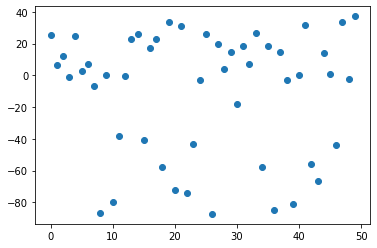

93673.086
Traced<ConcreteArray(93673.086)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(93673.086, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


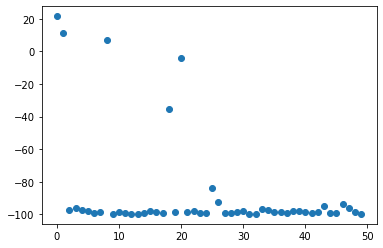

3.250204
Traced<ConcreteArray(3.250204)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.250204, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


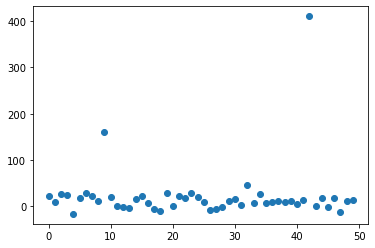

2.7205553
Traced<ConcreteArray(2.7205553)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7205553, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


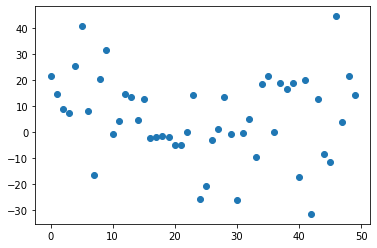

2.411475
Traced<ConcreteArray(2.411475)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.411475, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


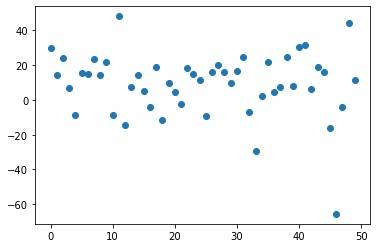

4.2475276
Traced<ConcreteArray(4.2475276)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.2475276, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


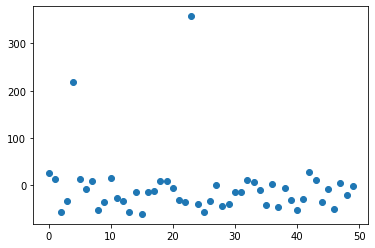

2.5754423
Traced<ConcreteArray(2.5754423)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5754423, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


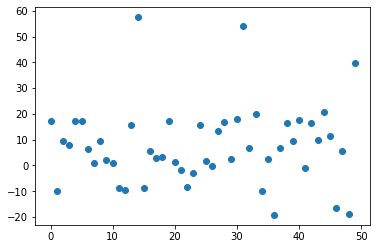

503.92212
Traced<ConcreteArray(503.92212)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(503.92212, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


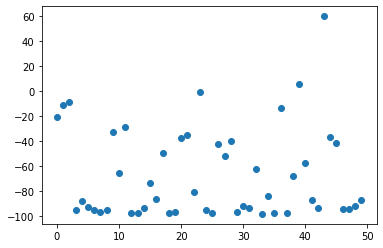

22.261696
Traced<ConcreteArray(22.261696)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(22.261696, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


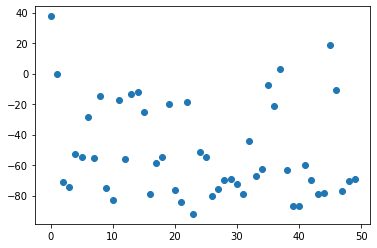

3.291985
Traced<ConcreteArray(3.291985)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.291985, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


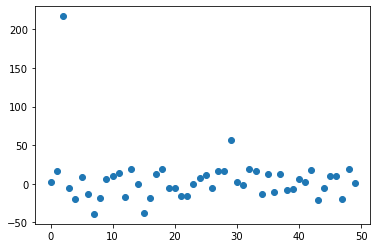

102012.84
Traced<ConcreteArray(102012.84)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(102012.84, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


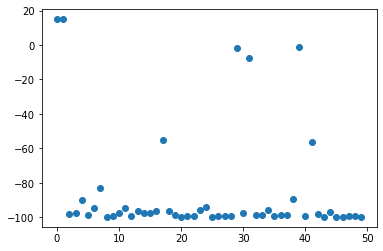

86447.67
Traced<ConcreteArray(86447.67)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(86447.67, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


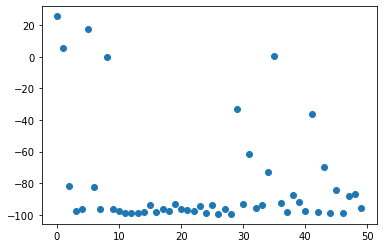

55.912674
Traced<ConcreteArray(55.912674)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(55.912674, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


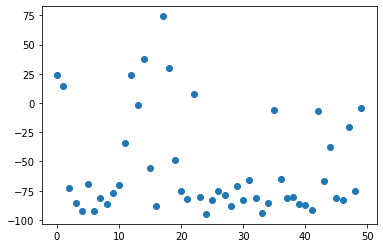

5.0563
Traced<ConcreteArray(5.0563)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.0563, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


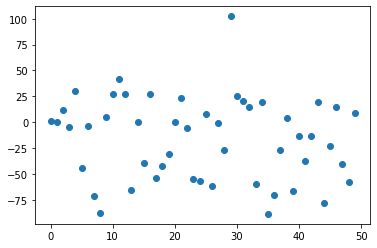

4.461647
Traced<ConcreteArray(4.461647)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.461647, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


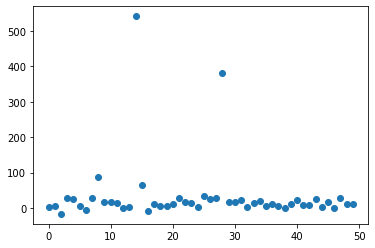

3.0580173
Traced<ConcreteArray(3.0580173)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0580173, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


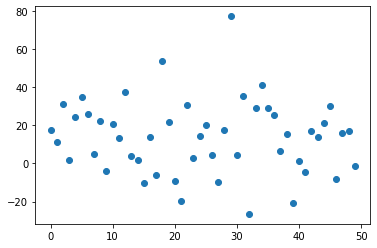

2580.1445
Traced<ConcreteArray(2580.1445)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2580.1445, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


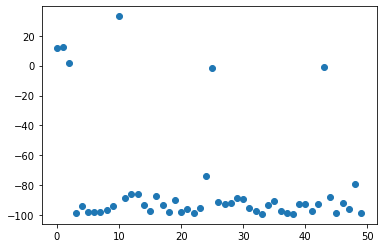

3.572532
Traced<ConcreteArray(3.572532)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.572532, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


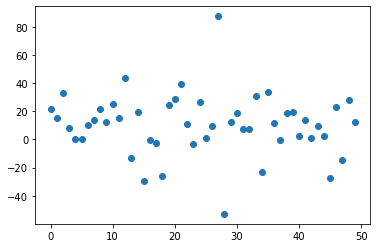

62.91336
Traced<ConcreteArray(62.91336)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(62.91336, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


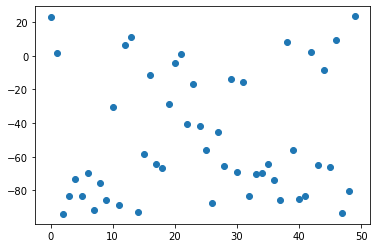

93.538185
Traced<ConcreteArray(93.538185)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(93.538185, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


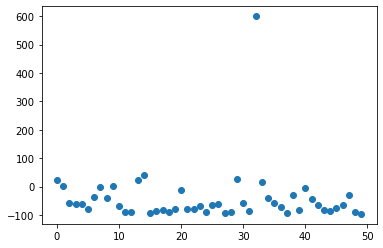

3.622095
Traced<ConcreteArray(3.622095)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.622095, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


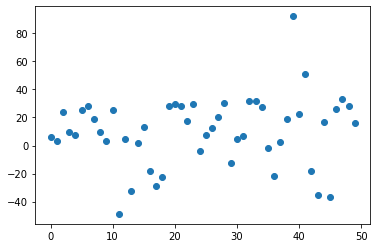

18091.404
Traced<ConcreteArray(18091.404)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(18091.404, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


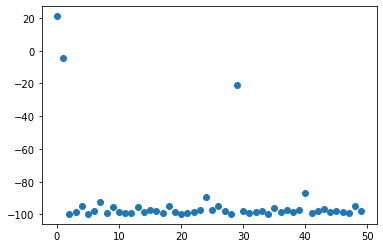

5.1716275
Traced<ConcreteArray(5.1716275)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.1716275, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


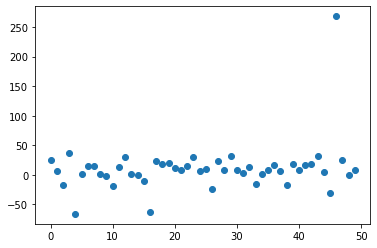

4.481675
Traced<ConcreteArray(4.481675)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.481675, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


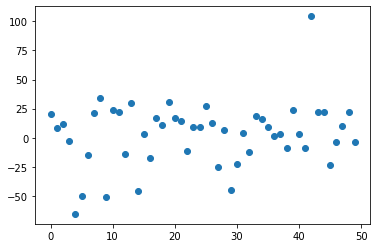

30868.965
Traced<ConcreteArray(30868.965)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(30868.965, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


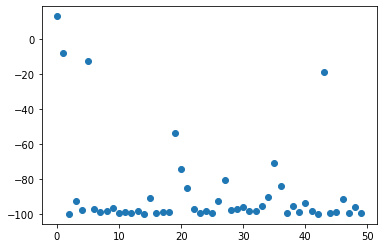

1592482.8
Traced<ConcreteArray(1592482.8)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1592482.8, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


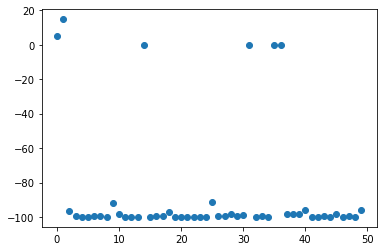

6817.672
Traced<ConcreteArray(6817.672)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6817.672, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


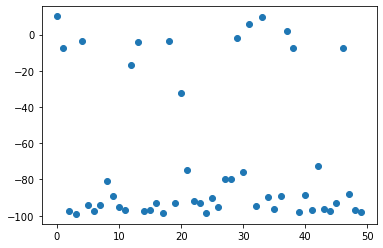

18.877151
Traced<ConcreteArray(18.877151)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(18.877151, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


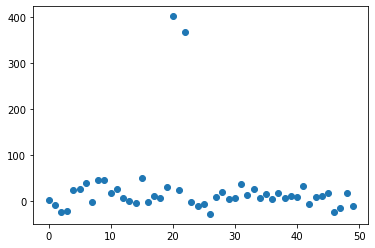

9072.42
Traced<ConcreteArray(9072.42)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(9072.42, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


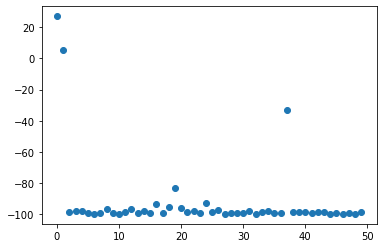

165231.11
Traced<ConcreteArray(165231.11)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(165231.11, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


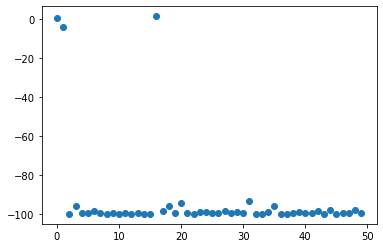

2857.4556
Traced<ConcreteArray(2857.4556)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2857.4556, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


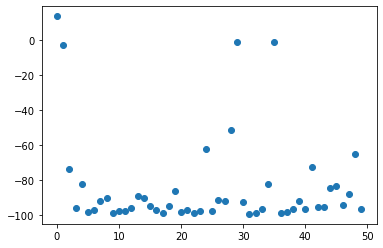

2.8868093
Traced<ConcreteArray(2.8868093)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8868093, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


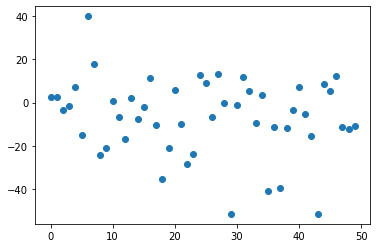

874025.0
Traced<ConcreteArray(874025.0)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(874025., dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


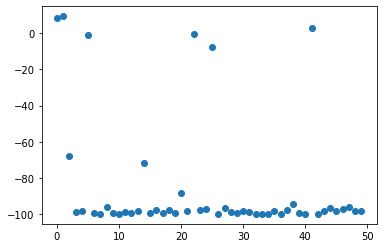

3.44767
Traced<ConcreteArray(3.44767)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.44767, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


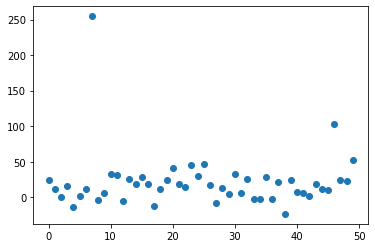

10857.647
Traced<ConcreteArray(10857.647)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(10857.647, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


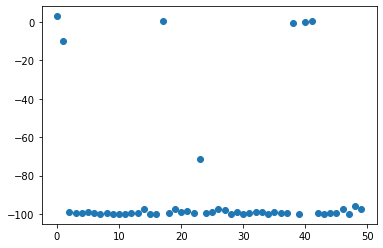

1190.7369
Traced<ConcreteArray(1190.7369)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1190.7369, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


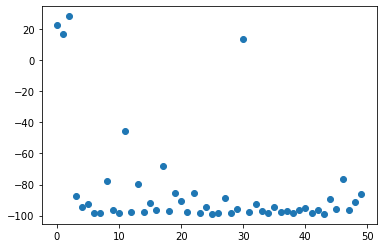

4640.314
Traced<ConcreteArray(4640.314)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4640.314, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


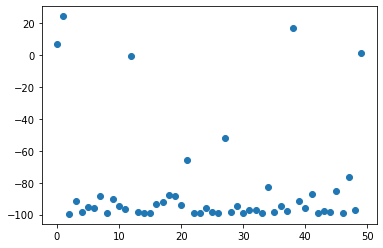

3.288659
Traced<ConcreteArray(3.288659)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.288659, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


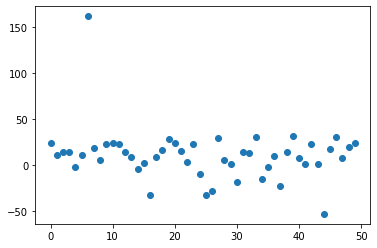

98.22439
Traced<ConcreteArray(98.22439)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(98.22439, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


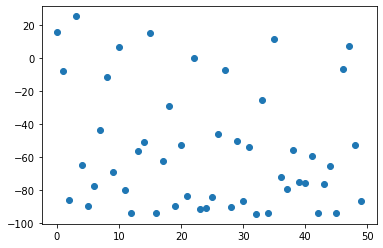

3.79011
Traced<ConcreteArray(3.79011)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.79011, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


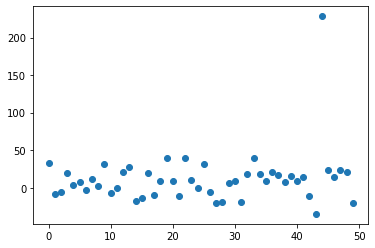

2008744.6
Traced<ConcreteArray(2008744.6)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2008744.6, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


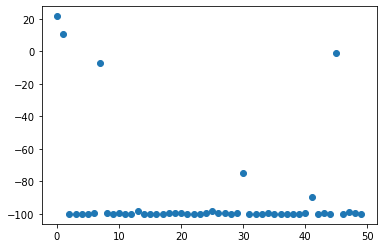

3.662271
Traced<ConcreteArray(3.662271)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.662271, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


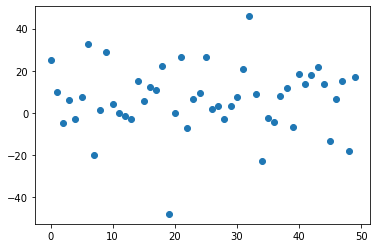

1034173.56
Traced<ConcreteArray(1034173.56)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1034173.56, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


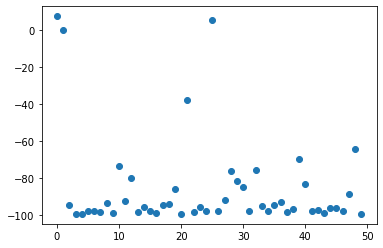

3961.0266
Traced<ConcreteArray(3961.0266)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3961.0266, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


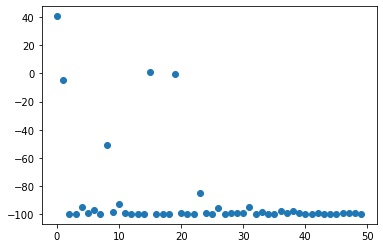

52.97265
Traced<ConcreteArray(52.97265)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(52.97265, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


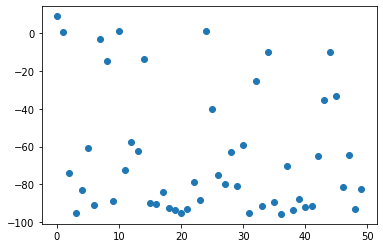

5.330261
Traced<ConcreteArray(5.330261)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.330261, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


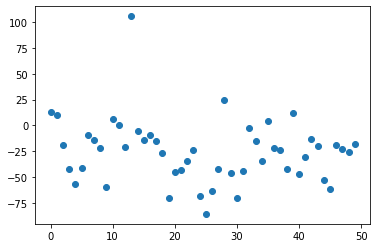

225.78764
Traced<ConcreteArray(225.78764)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(225.78764, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


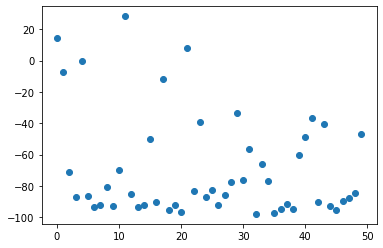

36209.18
Traced<ConcreteArray(36209.18)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(36209.18, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


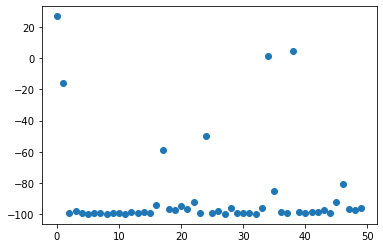

55751.605
Traced<ConcreteArray(55751.605)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(55751.605, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


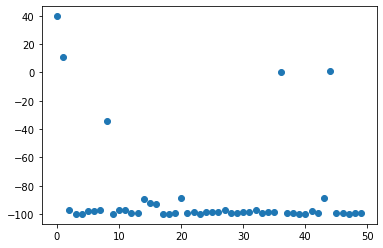

10734251.0
Traced<ConcreteArray(10734251.0)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(10734251., dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


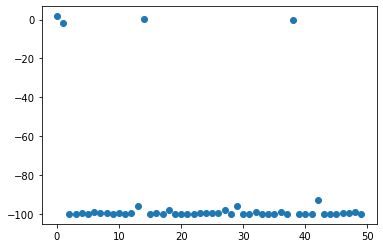

78867.016
Traced<ConcreteArray(78867.016)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(78867.016, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


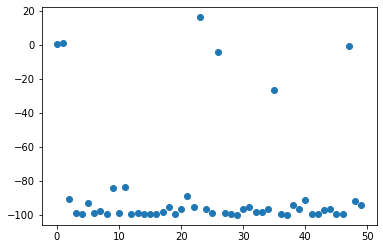

6.2171474
Traced<ConcreteArray(6.2171474)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.2171474, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


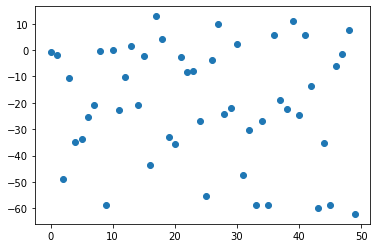

2886569.2
Traced<ConcreteArray(2886569.2)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2886569.2, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


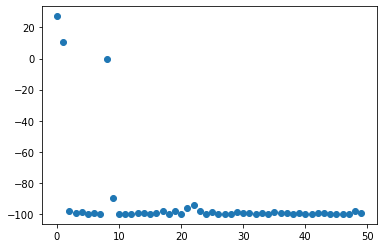

439211.47
Traced<ConcreteArray(439211.47)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(439211.47, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


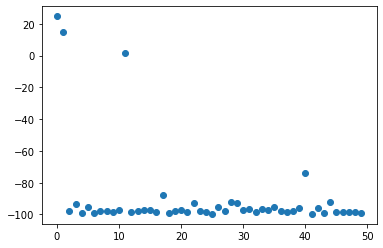

227.8763
Traced<ConcreteArray(227.8763)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(227.8763, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


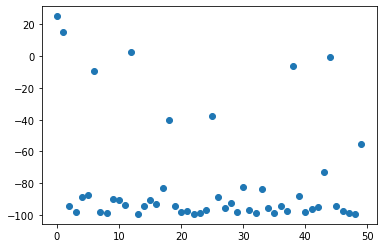

2.733284
Traced<ConcreteArray(2.733284)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.733284, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


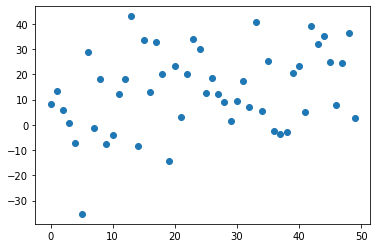

189.28474
Traced<ConcreteArray(189.28474)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(189.28474, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


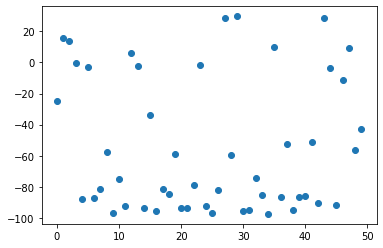

10.619188
Traced<ConcreteArray(10.619188)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(10.619188, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


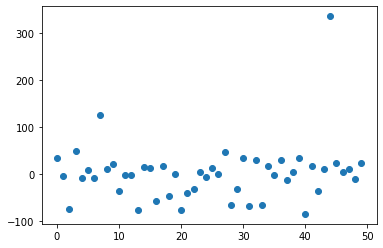

270.90762
Traced<ConcreteArray(270.90762)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(270.90762, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


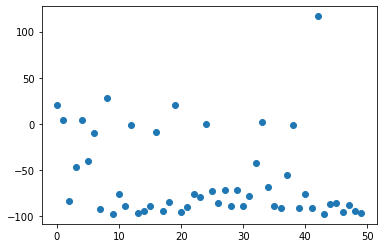

7978904.0
Traced<ConcreteArray(7978904.0)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7978904., dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


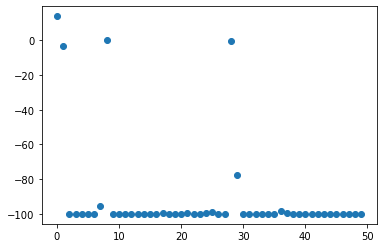

8.927975
Traced<ConcreteArray(8.927975)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(8.927975, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


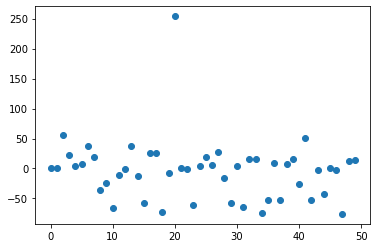

4336608.0
Traced<ConcreteArray(4336608.0)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4336608., dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


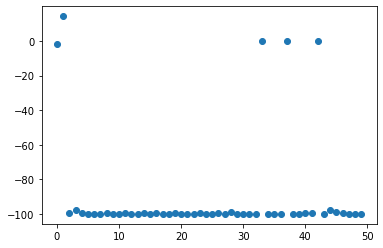

49978.65
Traced<ConcreteArray(49978.65)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(49978.65, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


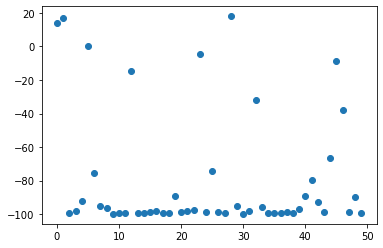

5.7239447
Traced<ConcreteArray(5.7239447)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.7239447, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


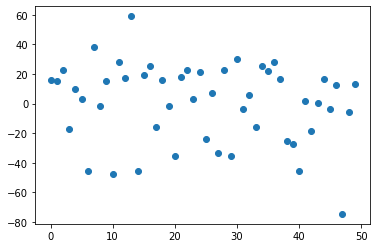

5.7681575
Traced<ConcreteArray(5.7681575)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.7681575, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


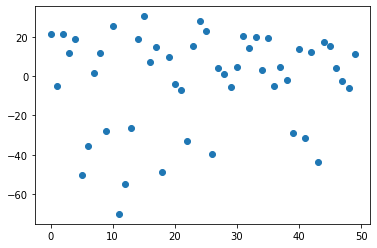

4.668898
Traced<ConcreteArray(4.668898)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.668898, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


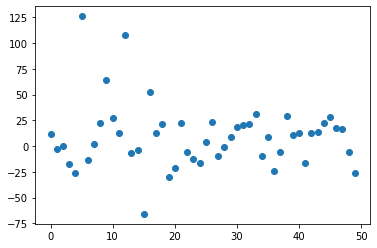

3.3104377
Traced<ConcreteArray(3.3104377)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3104377, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


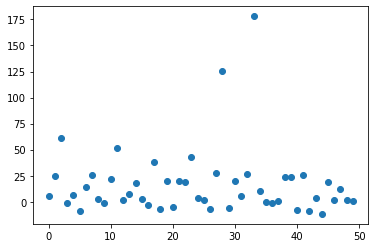

6162.0933
Traced<ConcreteArray(6162.0933)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6162.0933, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


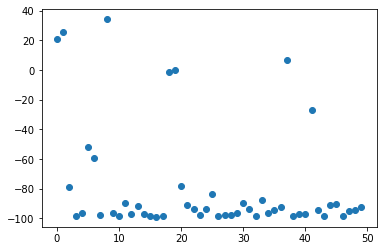

435413.28
Traced<ConcreteArray(435413.28)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(435413.28, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


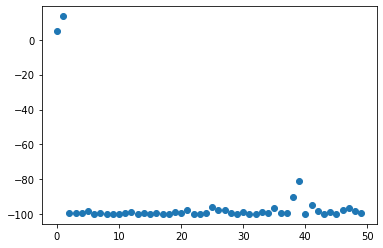

206464.84
Traced<ConcreteArray(206464.84)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(206464.84, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


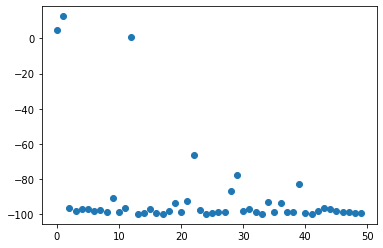

3.3341436
Traced<ConcreteArray(3.3341436)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3341436, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


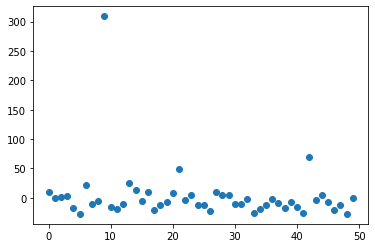

10.796977
Traced<ConcreteArray(10.796977)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(10.796977, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


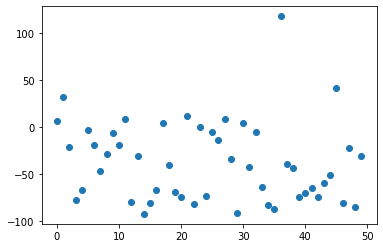

33.75214
Traced<ConcreteArray(33.75214)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(33.75214, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


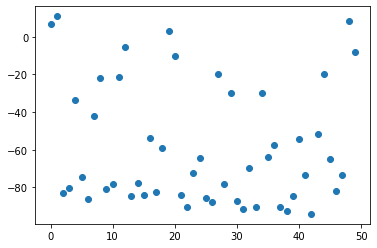

471697.12
Traced<ConcreteArray(471697.12)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(471697.12, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


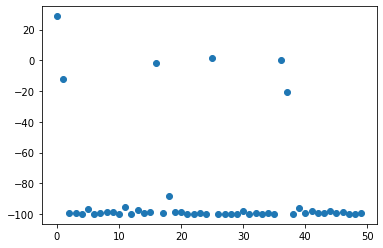

595514.94
Traced<ConcreteArray(595514.94)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(595514.94, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


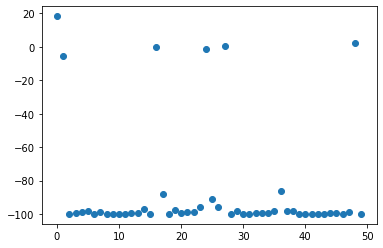

833437.3
Traced<ConcreteArray(833437.3)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(833437.3, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


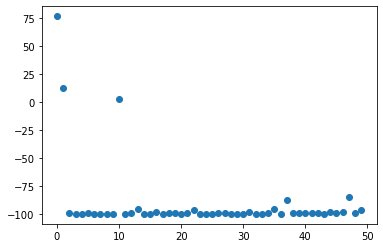

4.2396154
Traced<ConcreteArray(4.2396154)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.2396154, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


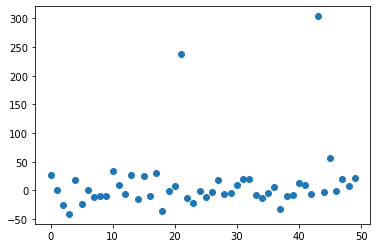

3.677359
Traced<ConcreteArray(3.677359)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.677359, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


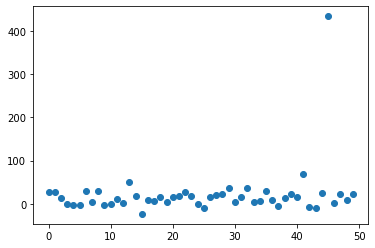

3.058256
Traced<ConcreteArray(3.058256)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.058256, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


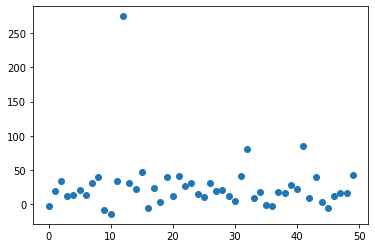

3.6077023
Traced<ConcreteArray(3.6077023)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6077023, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


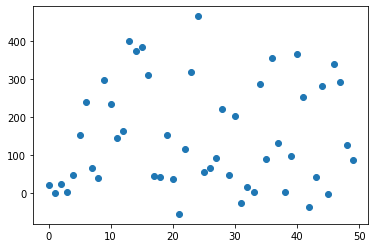

62664.58
Traced<ConcreteArray(62664.58)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(62664.58, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


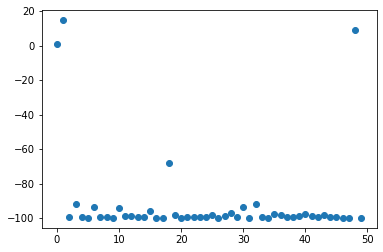

2.530416
Traced<ConcreteArray(2.530416)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.530416, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


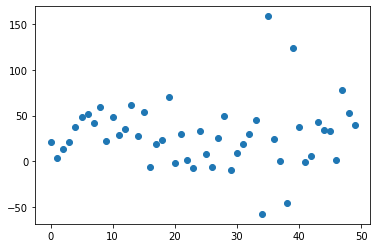

100001.414
Traced<ConcreteArray(100001.414)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(100001.414, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


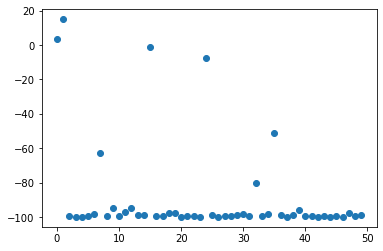

15.05818
Traced<ConcreteArray(15.05818)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(15.05818, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


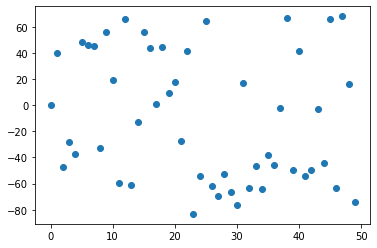

1728.0854
Traced<ConcreteArray(1728.0854)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1728.0854, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


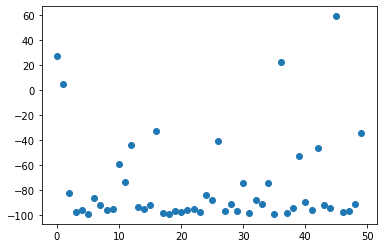

2.6475933
Traced<ConcreteArray(2.6475933)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6475933, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


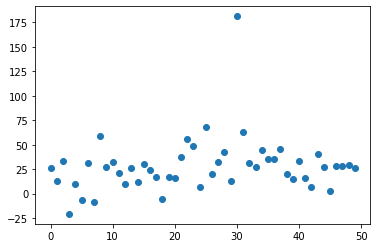

3.2899878
Traced<ConcreteArray(3.2899878)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2899878, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


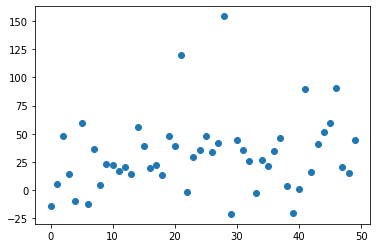

31.442902
Traced<ConcreteArray(31.442902)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(31.442902, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


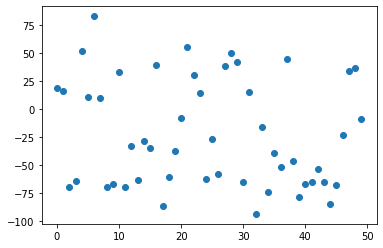

3.043675
Traced<ConcreteArray(3.043675)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.043675, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


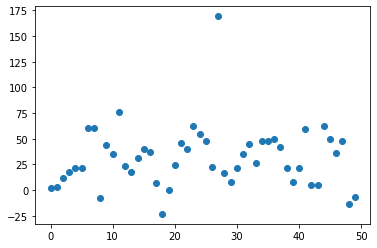

3.5296896
Traced<ConcreteArray(3.5296896)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5296896, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


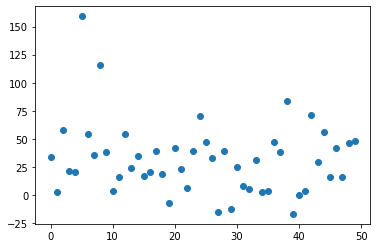

3.3072596
Traced<ConcreteArray(3.3072596)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3072596, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


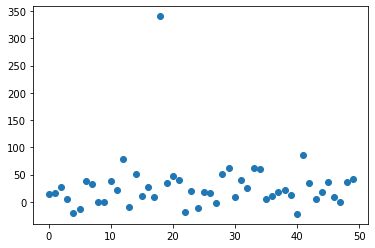

28.876125
Traced<ConcreteArray(28.876125)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(28.876125, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


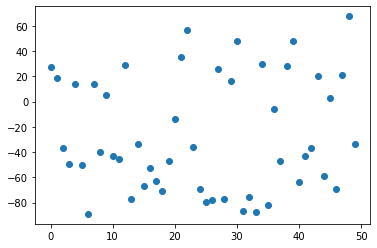

229511.9
Traced<ConcreteArray(229511.9)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(229511.9, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


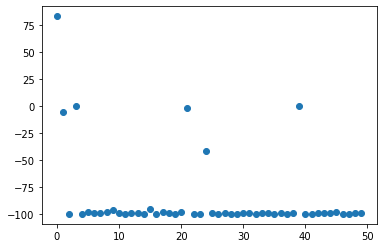

4.310756
Traced<ConcreteArray(4.310756)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.310756, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


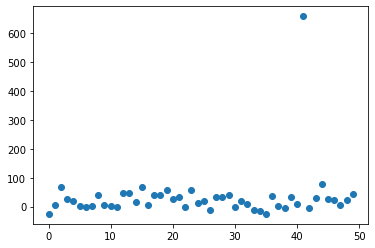

2.6635048
Traced<ConcreteArray(2.6635048)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6635048, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


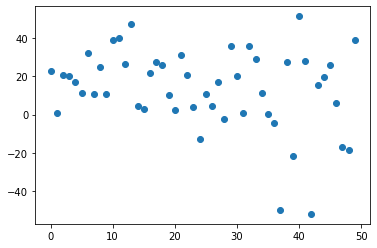

2421.7007
Traced<ConcreteArray(2421.7007)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2421.7007, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


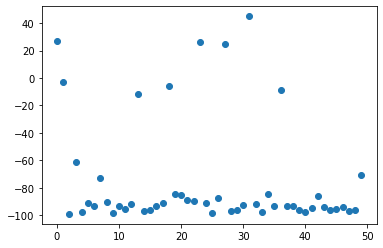

29.401613
Traced<ConcreteArray(29.401613)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(29.401613, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


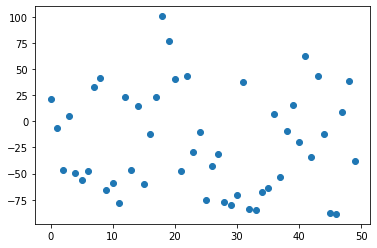

116345.52
Traced<ConcreteArray(116345.52)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(116345.52, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


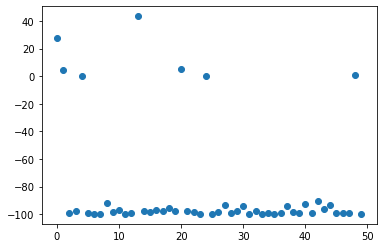

14.145219
Traced<ConcreteArray(14.145219)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(14.145219, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


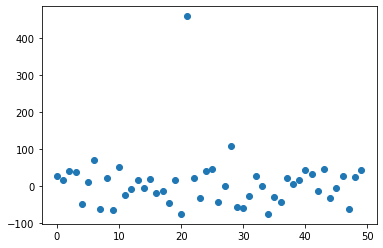

42443.133
Traced<ConcreteArray(42443.133)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(42443.133, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


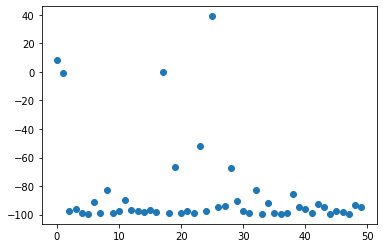

9865.072
Traced<ConcreteArray(9865.072)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(9865.072, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


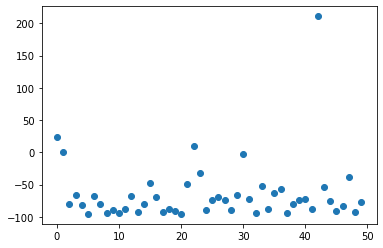

213.98666
Traced<ConcreteArray(213.98666)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(213.98666, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


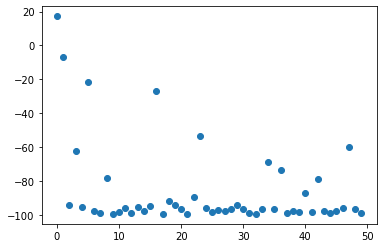

7253.357
Traced<ConcreteArray(7253.357)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7253.357, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


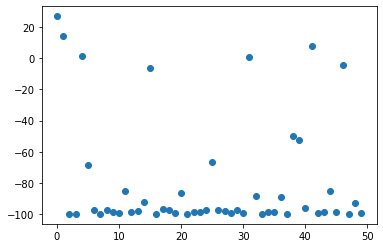

7.661012
Traced<ConcreteArray(7.661012)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.661012, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


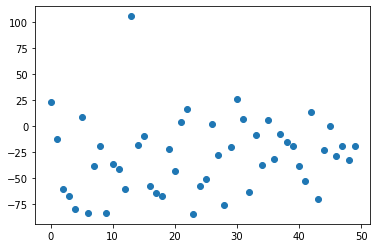

9.705512
Traced<ConcreteArray(9.705512)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(9.705512, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


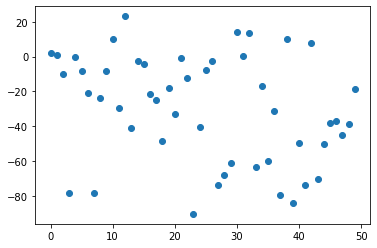

57442.555
Traced<ConcreteArray(57442.555)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(57442.555, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


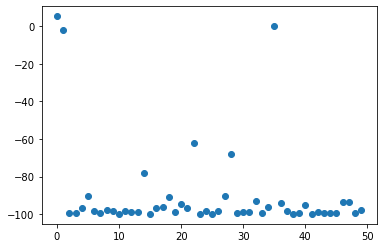

60822.42
Traced<ConcreteArray(60822.42)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(60822.42, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


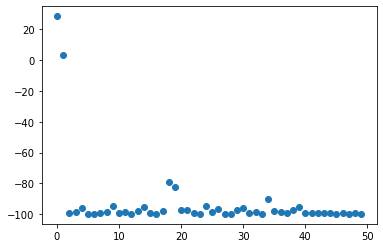

1146.6831
Traced<ConcreteArray(1146.6831)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1146.6831, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


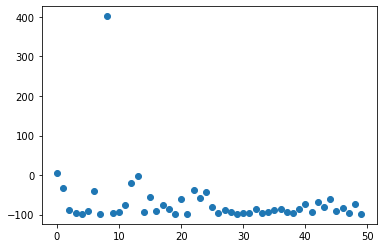

1472.1465
Traced<ConcreteArray(1472.1465)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1472.1465, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


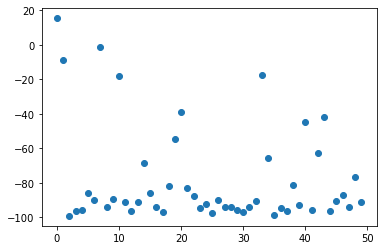

4.5643935
Traced<ConcreteArray(4.5643935)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.5643935, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


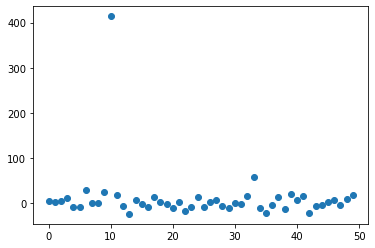

4.0578628
Traced<ConcreteArray(4.0578628)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.0578628, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


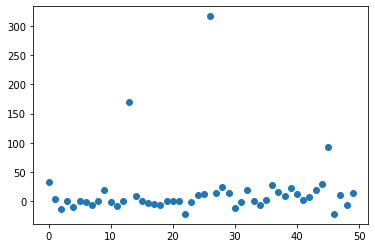

700.46
Traced<ConcreteArray(700.46)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(700.46, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


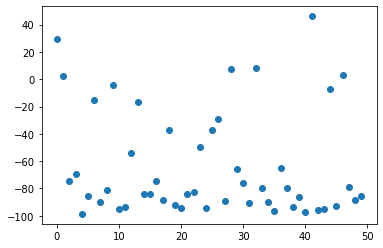

3.3472712
Traced<ConcreteArray(3.3472712)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3472712, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


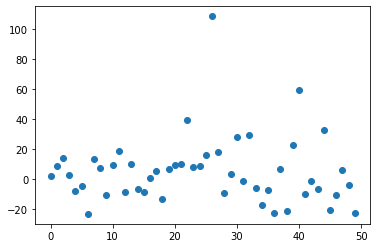

555.85345
Traced<ConcreteArray(555.85345)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(555.85345, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


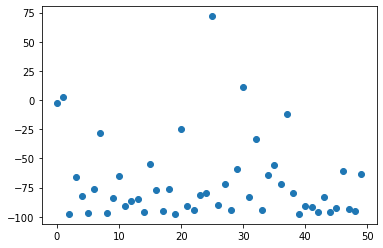

48741.992
Traced<ConcreteArray(48741.992)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(48741.992, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


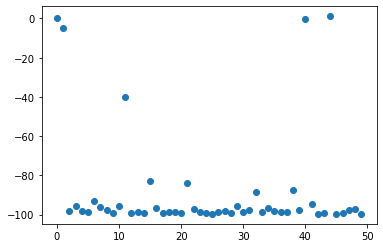

16671.232
Traced<ConcreteArray(16671.232)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(16671.232, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


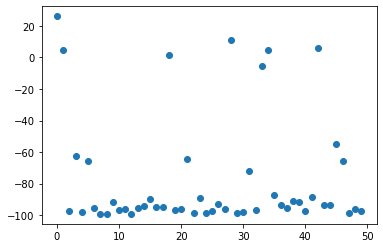

2.6194153
Traced<ConcreteArray(2.6194153)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6194153, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


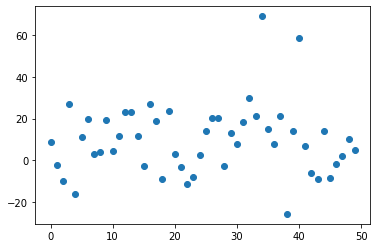

54.38375
Traced<ConcreteArray(54.38375)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(54.38375, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


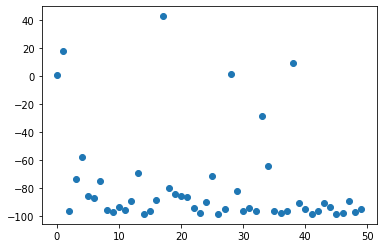

2.723458
Traced<ConcreteArray(2.723458)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.723458, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


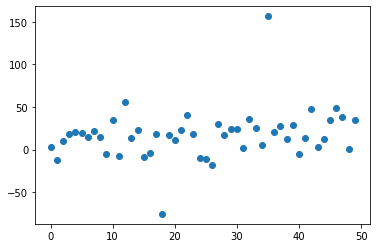

7941.6245
Traced<ConcreteArray(7941.6245)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7941.6245, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


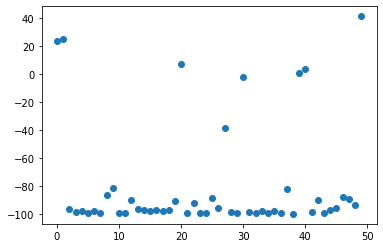

19940.438
Traced<ConcreteArray(19940.438)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(19940.438, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


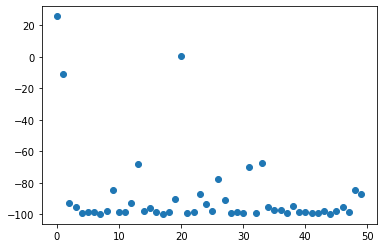

4.987583
Traced<ConcreteArray(4.987583)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.987583, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


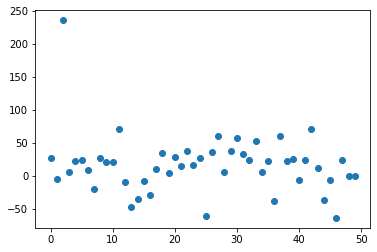

17567.328
Traced<ConcreteArray(17567.328)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(17567.328, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


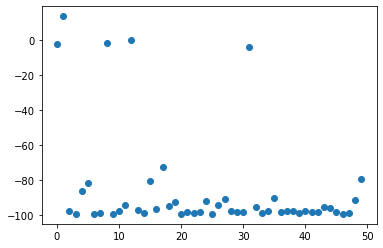

5.1199074
Traced<ConcreteArray(5.1199074)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.1199074, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


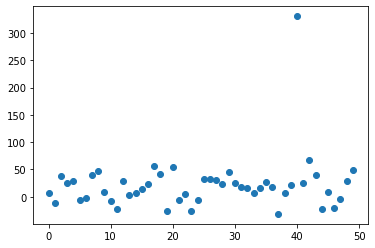

68.46159
Traced<ConcreteArray(68.46159)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(68.46159, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


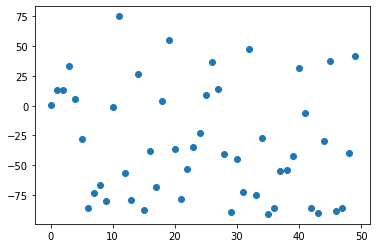

6210.7827
Traced<ConcreteArray(6210.7827)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6210.7827, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


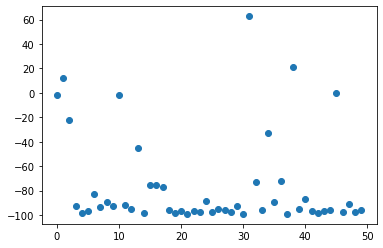

43.865547
Traced<ConcreteArray(43.865547)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(43.865547, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


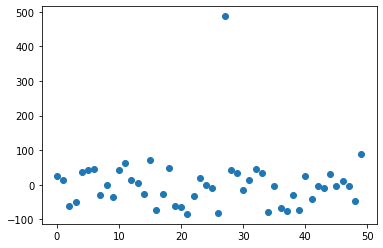

1057.7742
Traced<ConcreteArray(1057.7742)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1057.7742, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


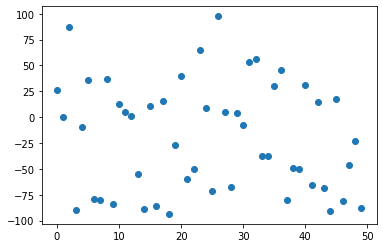

3.5680954
Traced<ConcreteArray(3.5680954)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5680954, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


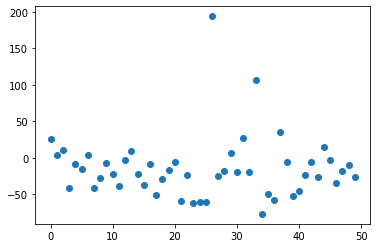

2.6825752
Traced<ConcreteArray(2.6825752)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6825752, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


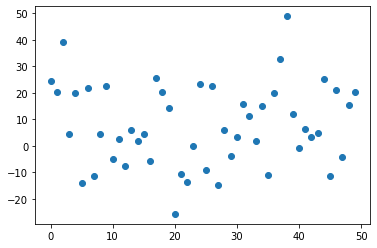

2.6057103
Traced<ConcreteArray(2.6057103)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6057103, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


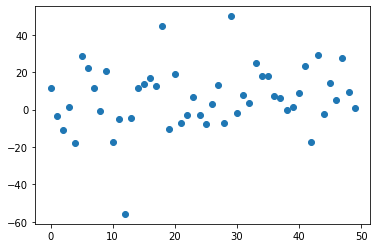

3407.3958
Traced<ConcreteArray(3407.3958)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3407.3958, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


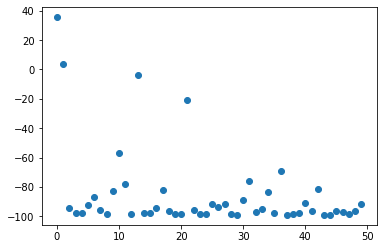

4396.071
Traced<ConcreteArray(4396.071)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4396.071, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


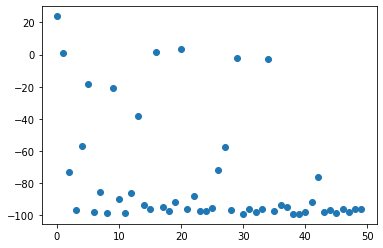

5322.5566
Traced<ConcreteArray(5322.5566)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5322.5566, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


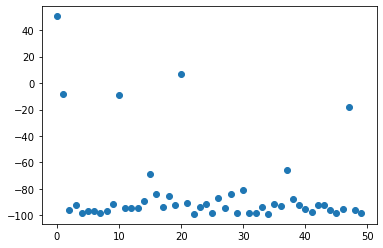

2234.2139
Traced<ConcreteArray(2234.2139)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2234.2139, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


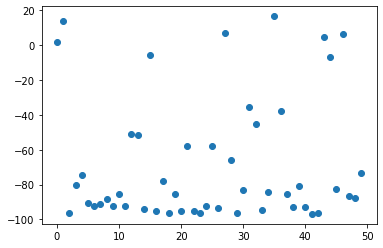

7.1276293
Traced<ConcreteArray(7.1276293)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.1276293, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


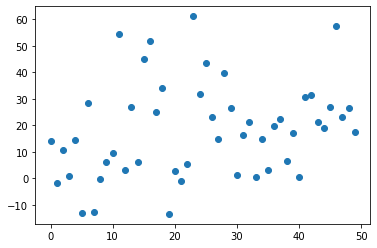

8.349168
Traced<ConcreteArray(8.349168)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(8.349168, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


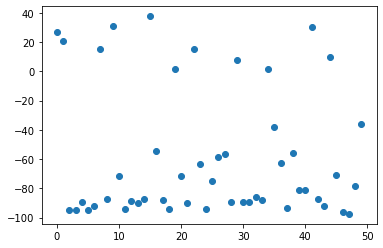

645.1623
Traced<ConcreteArray(645.1623)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(645.1623, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


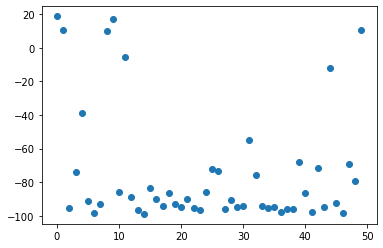

595.1026
Traced<ConcreteArray(595.1026)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(595.1026, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


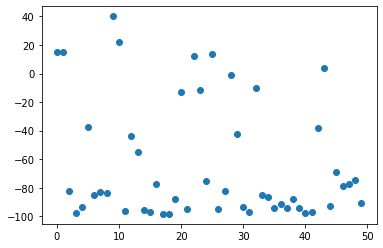

2.680036
Traced<ConcreteArray(2.680036)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.680036, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


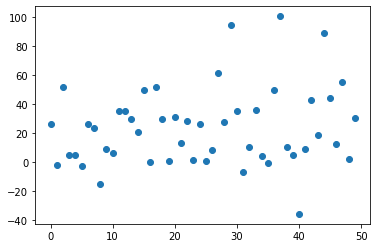

31.231335
Traced<ConcreteArray(31.231335)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(31.231335, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


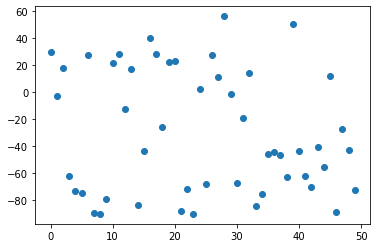

4651.6865
Traced<ConcreteArray(4651.6865)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4651.6865, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


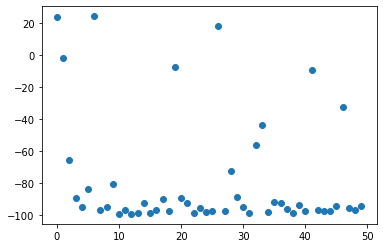

4198.6577
Traced<ConcreteArray(4198.6577)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4198.6577, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


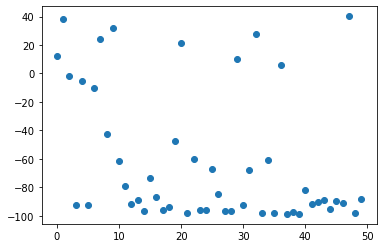

3.3596454
Traced<ConcreteArray(3.3596454)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3596454, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


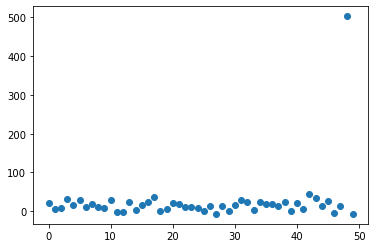

7.487839
Traced<ConcreteArray(7.487839)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.487839, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


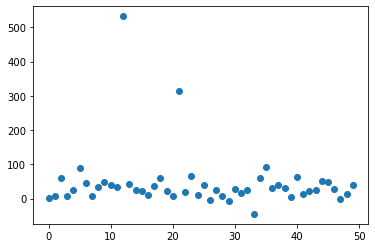

3.08651
Traced<ConcreteArray(3.08651)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.08651, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


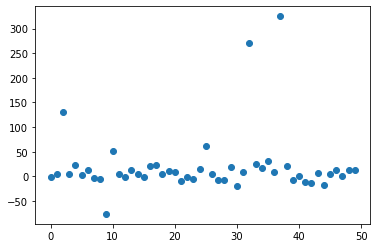

3.951863
Traced<ConcreteArray(3.951863)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.951863, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


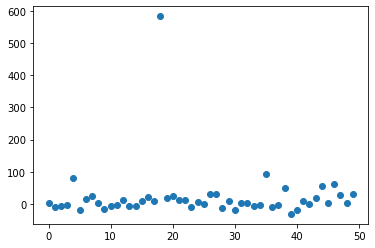

2.518319
Traced<ConcreteArray(2.518319)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.518319, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


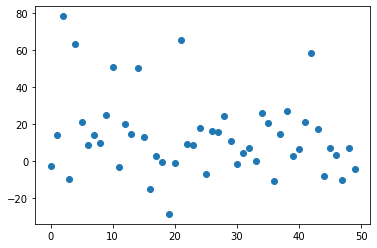

3.0309286
Traced<ConcreteArray(3.0309286)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0309286, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


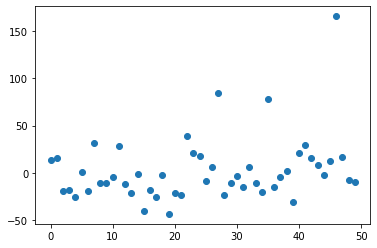

2.859538
Traced<ConcreteArray(2.859538)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.859538, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


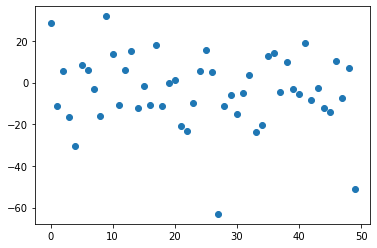

4763.7275
Traced<ConcreteArray(4763.7275)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4763.7275, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


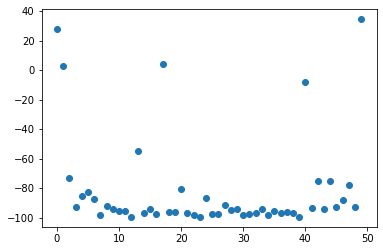

22.117004
Traced<ConcreteArray(22.117004)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(22.117004, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


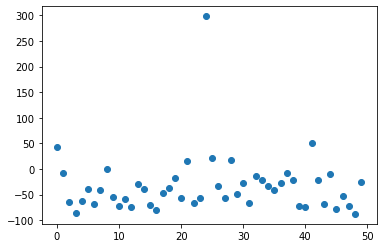

3.8144114
Traced<ConcreteArray(3.8144114)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8144114, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


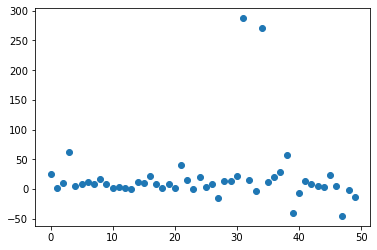

2.840292
Traced<ConcreteArray(2.840292)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.840292, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


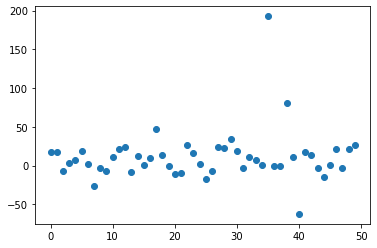

1455.602
Traced<ConcreteArray(1455.602)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1455.602, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


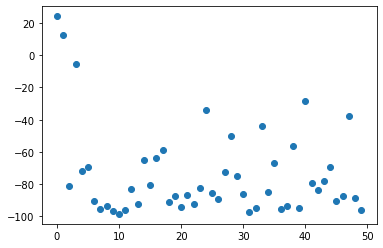

2.4228451
Traced<ConcreteArray(2.4228451)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4228451, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


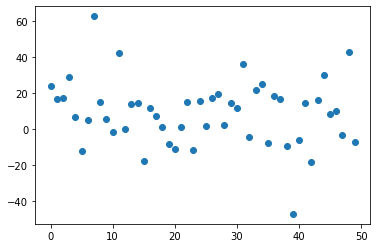

183.07677
Traced<ConcreteArray(183.07677)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(183.07677, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


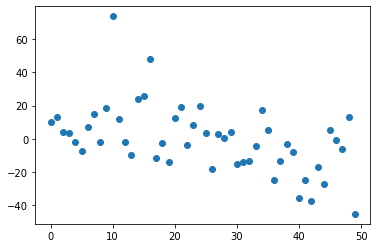

2.2908053
Traced<ConcreteArray(2.2908053)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2908053, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


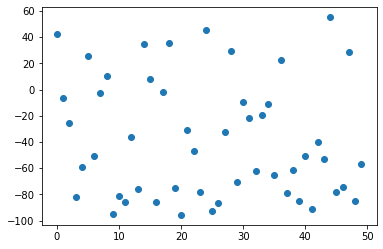

106.20331
Traced<ConcreteArray(106.20331)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(106.20331, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


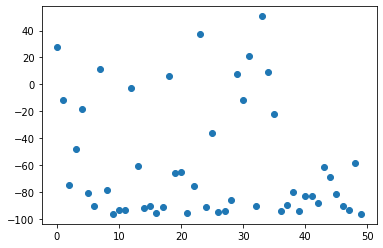

2.760468
Traced<ConcreteArray(2.760468)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.760468, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


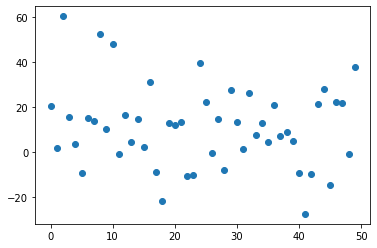

2.4322429
Traced<ConcreteArray(2.4322429)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4322429, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


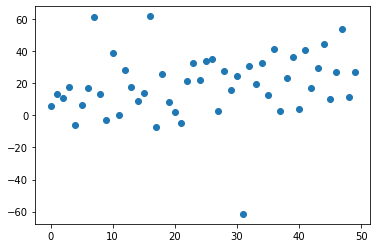

2478.3008
Traced<ConcreteArray(2478.3008)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2478.3008, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


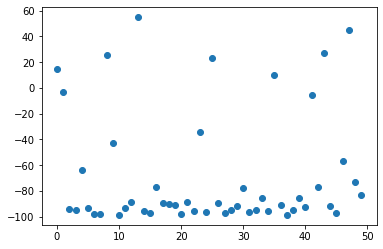

1148.9818
Traced<ConcreteArray(1148.9818)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1148.9818, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


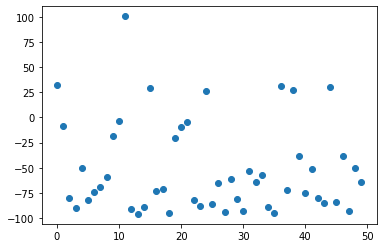

2.492436
Traced<ConcreteArray(2.492436)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.492436, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


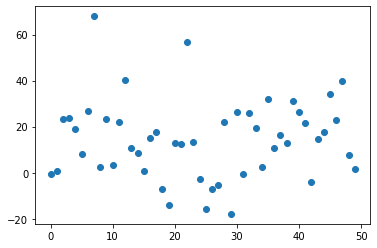

3.2067492
Traced<ConcreteArray(3.2067492)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2067492, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


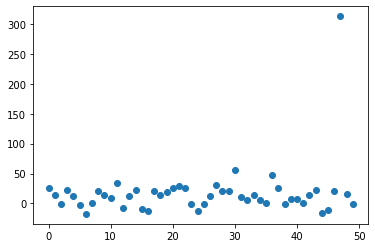

336.17145
Traced<ConcreteArray(336.17145)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(336.17145, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


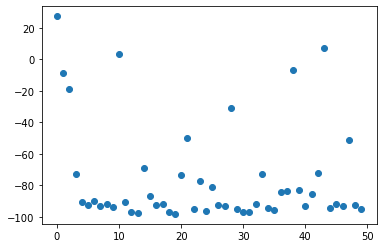

844.2461
Traced<ConcreteArray(844.2461)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(844.2461, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


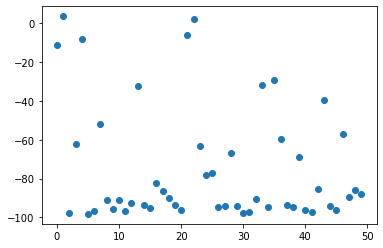

10.814124
Traced<ConcreteArray(10.814124)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(10.814124, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


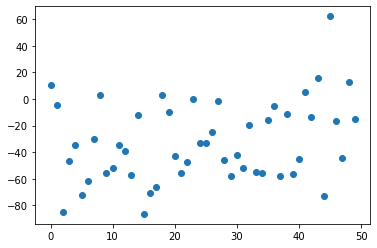

7.830083
Traced<ConcreteArray(7.830083)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.830083, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


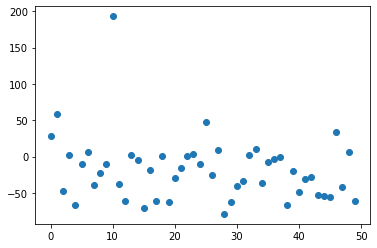

749.98285
Traced<ConcreteArray(749.98285)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(749.98285, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


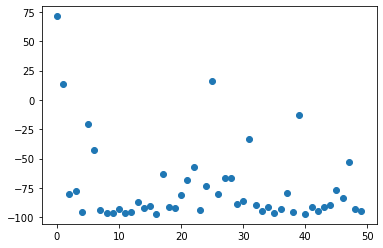

300.75464
Traced<ConcreteArray(300.75464)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(300.75464, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


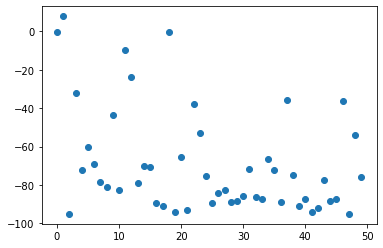

2.6810927
Traced<ConcreteArray(2.6810927)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6810927, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


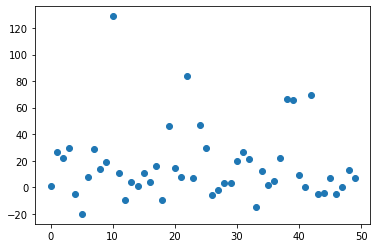

3.8786232
Traced<ConcreteArray(3.8786232)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8786232, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


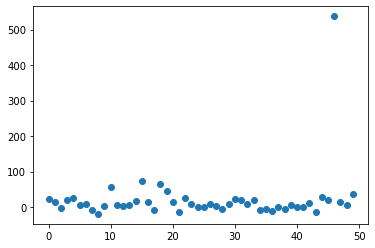

15.463673
Traced<ConcreteArray(15.463673)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(15.463673, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


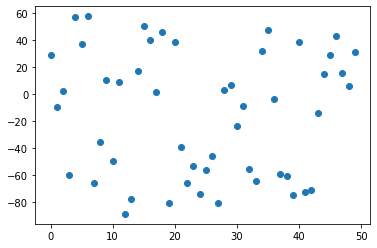

10.971283
Traced<ConcreteArray(10.971283)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(10.971283, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


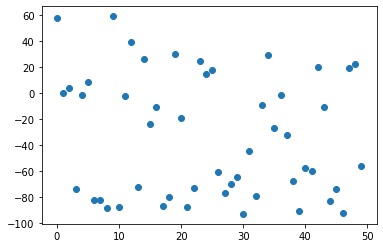

3.9735925
Traced<ConcreteArray(3.9735925)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9735925, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


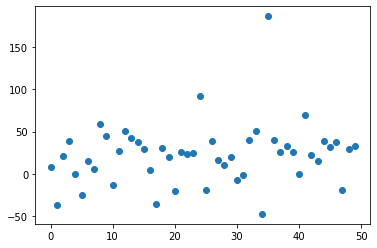

4.778714
Traced<ConcreteArray(4.778714)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.778714, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


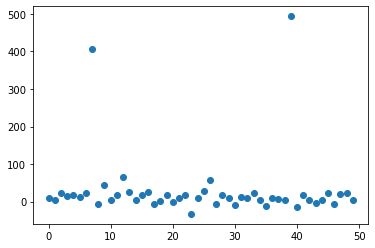

2.8840978
Traced<ConcreteArray(2.8840978)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8840978, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


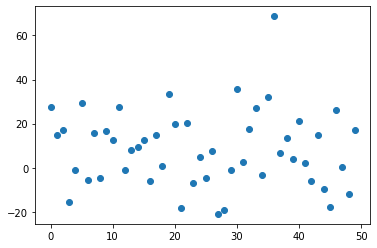

2.6562672
Traced<ConcreteArray(2.6562672)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6562672, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


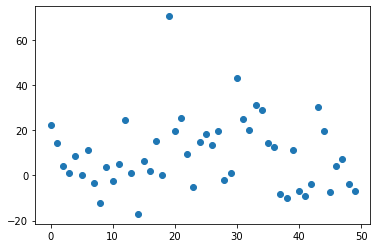

7.362408
Traced<ConcreteArray(7.362408)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.362408, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


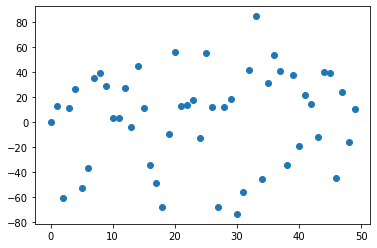

2.4427955
Traced<ConcreteArray(2.4427955)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4427955, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


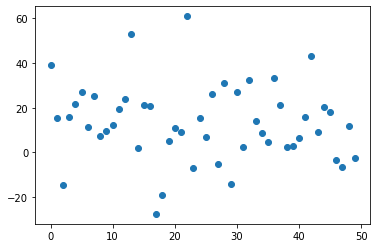

545.835
Traced<ConcreteArray(545.835)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(545.835, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


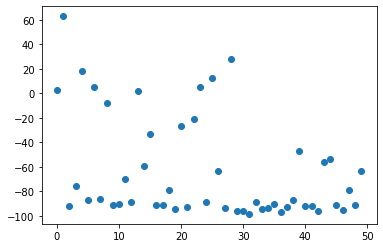

4.8049026
Traced<ConcreteArray(4.8049026)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.8049026, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


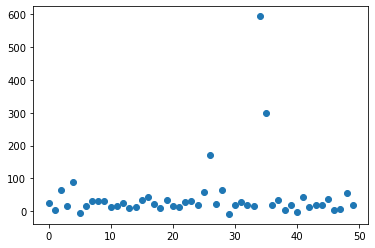

3.305657
Traced<ConcreteArray(3.305657)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.305657, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


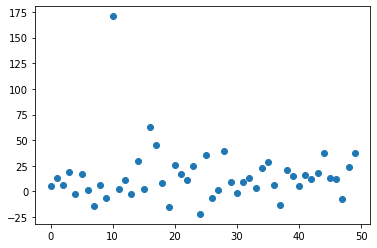

2.7388754
Traced<ConcreteArray(2.7388754)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7388754, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


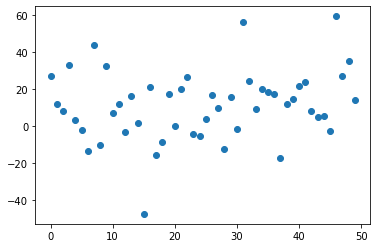

2.9374452
Traced<ConcreteArray(2.9374452)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9374452, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


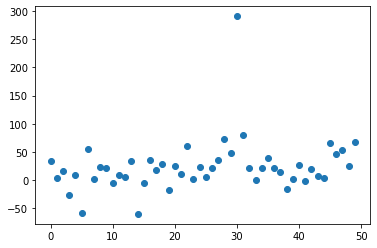

2.8747673
Traced<ConcreteArray(2.8747673)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8747673, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


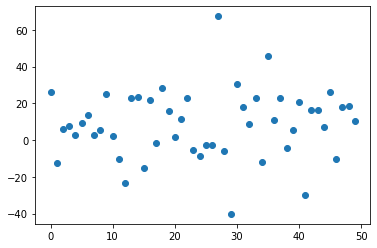

4.2789025
Traced<ConcreteArray(4.2789025)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.2789025, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


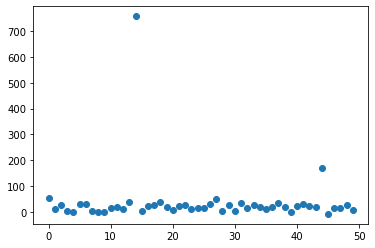

734.1751
Traced<ConcreteArray(734.1751)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(734.1751, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


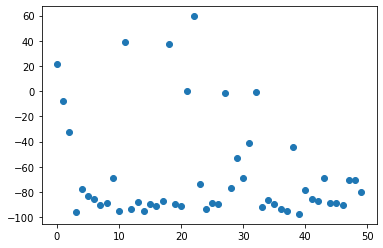

5.1243696
Traced<ConcreteArray(5.1243696)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.1243696, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


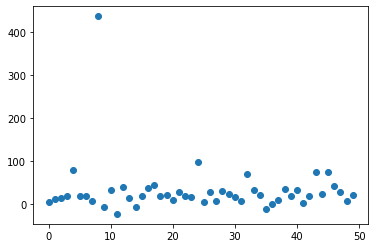

3.8032763
Traced<ConcreteArray(3.8032763)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8032763, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


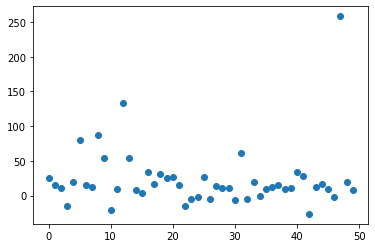

2.9079528
Traced<ConcreteArray(2.9079528)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9079528, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


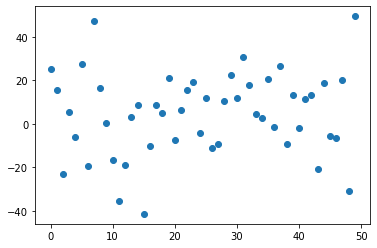

13.730318
Traced<ConcreteArray(13.730318)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(13.730318, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


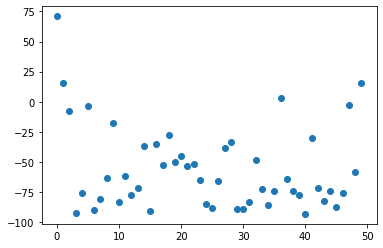

57.60472
Traced<ConcreteArray(57.60472)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(57.60472, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


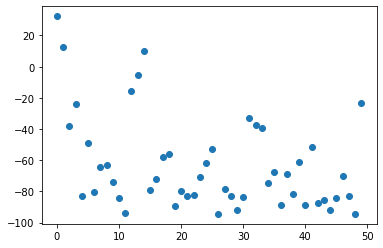

4.1021547
Traced<ConcreteArray(4.1021547)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.1021547, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


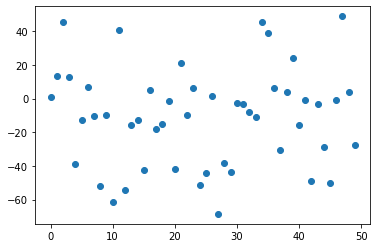

3.8725133
Traced<ConcreteArray(3.8725133)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8725133, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


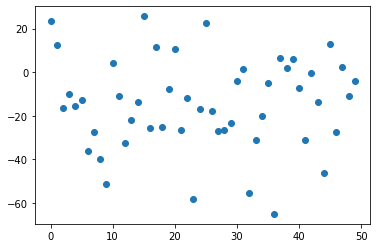

3.2432284
Traced<ConcreteArray(3.2432284)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2432284, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


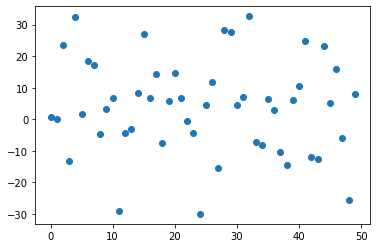

2.223781
Traced<ConcreteArray(2.223781)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.223781, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


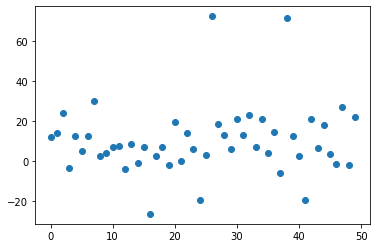

2.41403
Traced<ConcreteArray(2.41403)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.41403, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


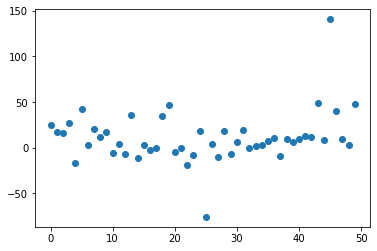

2.427257
Traced<ConcreteArray(2.427257)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.427257, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


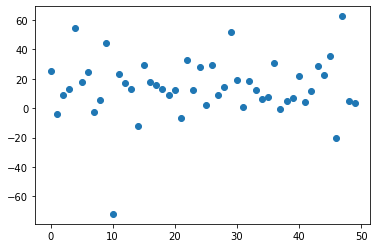

3.2941427
Traced<ConcreteArray(3.2941427)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2941427, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


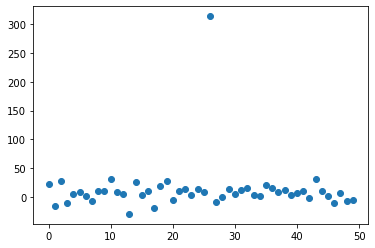

258.04077
Traced<ConcreteArray(258.04077)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(258.04077, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


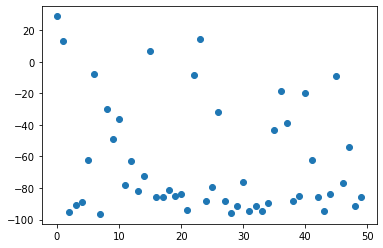

5.7195315
Traced<ConcreteArray(5.7195315)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.7195315, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


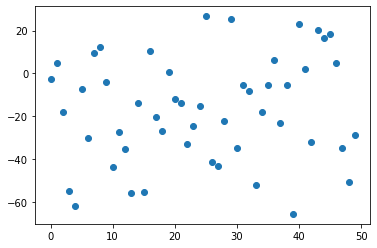

5.3875422
Traced<ConcreteArray(5.3875422)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.3875422, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


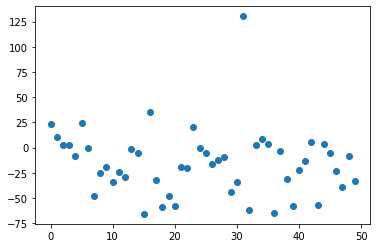

2.863716
Traced<ConcreteArray(2.863716)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.863716, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


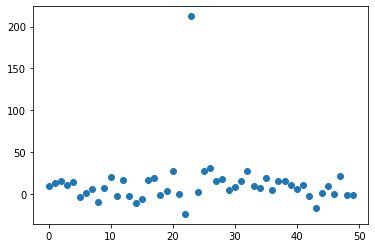

2.8997846
Traced<ConcreteArray(2.8997846)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8997846, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


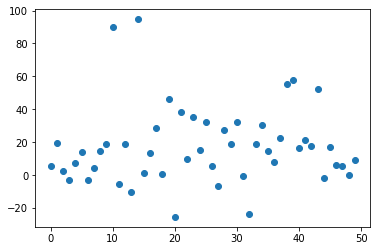

2.9355366
Traced<ConcreteArray(2.9355366)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9355366, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


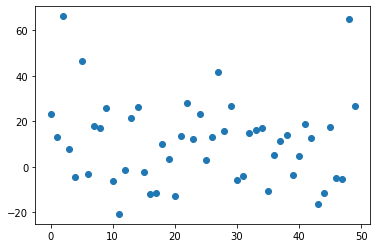

2.60174
Traced<ConcreteArray(2.60174)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.60174, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


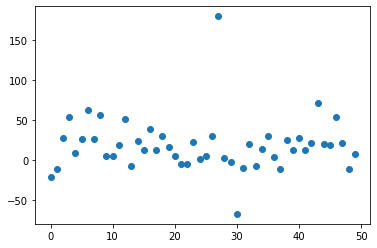

2.4161794
Traced<ConcreteArray(2.4161794)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4161794, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


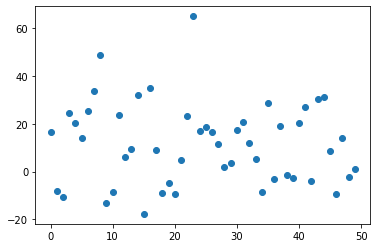

3.6671524
Traced<ConcreteArray(3.6671524)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6671524, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


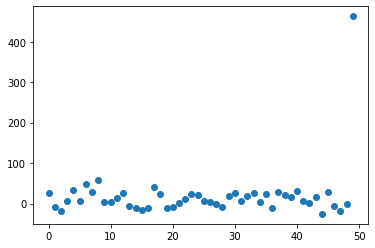

4.3571253
Traced<ConcreteArray(4.3571253)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.3571253, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


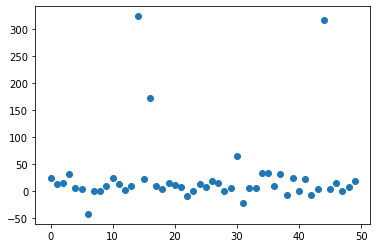

35.82467
Traced<ConcreteArray(35.82467)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(35.82467, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


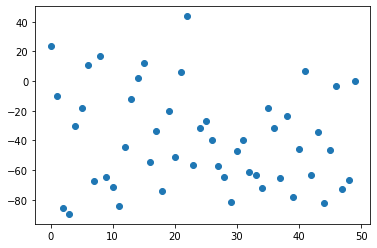

2.9795654
Traced<ConcreteArray(2.9795654)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9795654, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


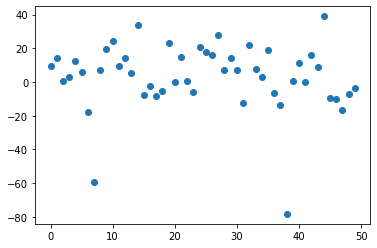

3.610598
Traced<ConcreteArray(3.610598)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.610598, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


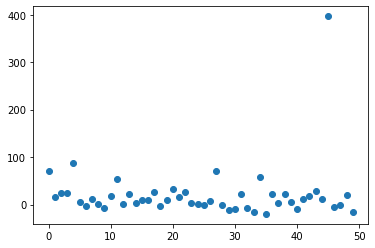

2.5568204
Traced<ConcreteArray(2.5568204)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5568204, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


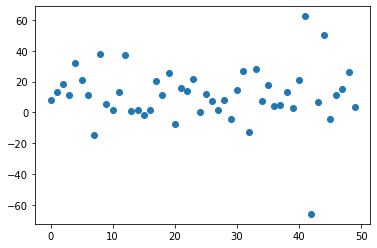

2.2710402
Traced<ConcreteArray(2.2710402)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2710402, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


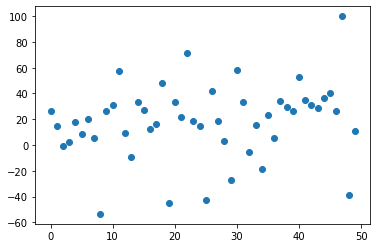

3.635203
Traced<ConcreteArray(3.635203)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.635203, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


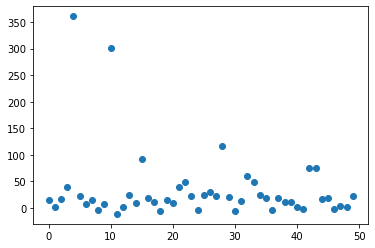

3.0145216
Traced<ConcreteArray(3.0145216)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0145216, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


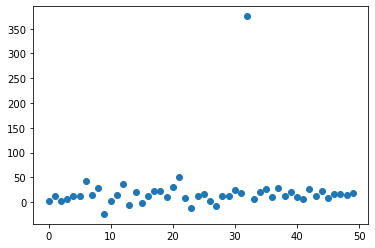

2.7488985
Traced<ConcreteArray(2.7488985)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7488985, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


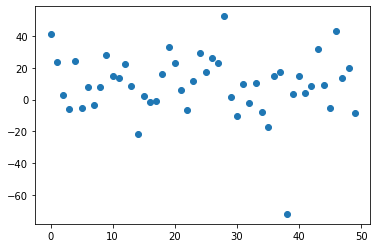

2.610471
Traced<ConcreteArray(2.610471)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.610471, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


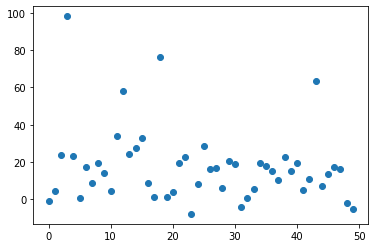

2.7326803
Traced<ConcreteArray(2.7326803)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7326803, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


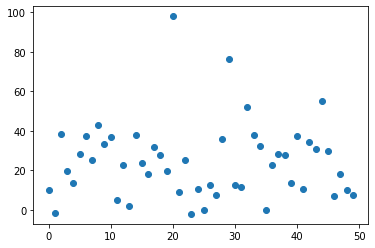

2.8026147
Traced<ConcreteArray(2.8026147)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8026147, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


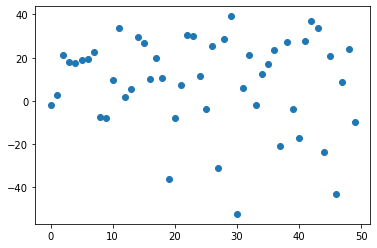

3.3947406
Traced<ConcreteArray(3.3947406)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3947406, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


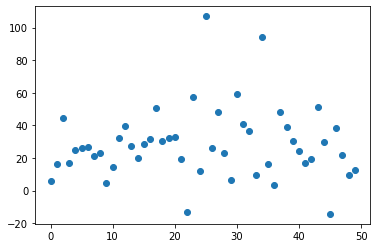

67.75591
Traced<ConcreteArray(67.75591)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(67.75591, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


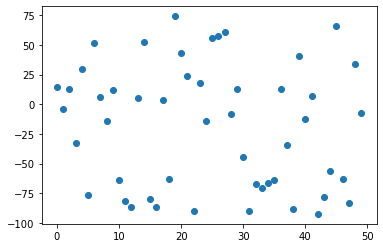

2.4232616
Traced<ConcreteArray(2.4232616)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4232616, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


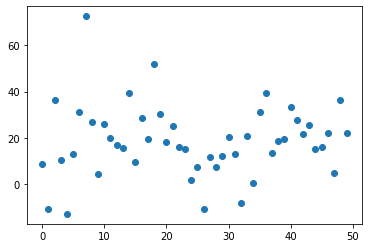

11.653639
Traced<ConcreteArray(11.653639)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(11.653639, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


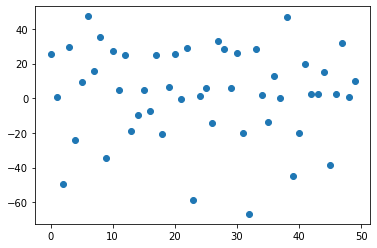

3.5834315
Traced<ConcreteArray(3.5834315)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5834315, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


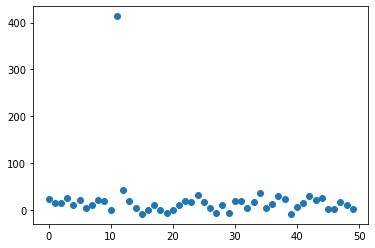

4.3075037
Traced<ConcreteArray(4.3075037)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.3075037, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


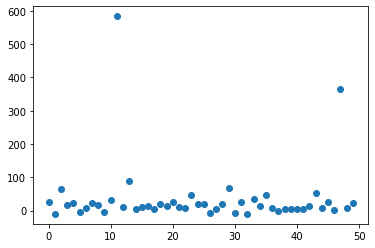

2.585053
Traced<ConcreteArray(2.585053)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.585053, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


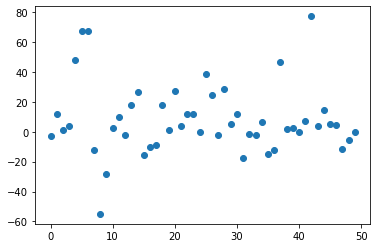

2.822392
Traced<ConcreteArray(2.822392)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.822392, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


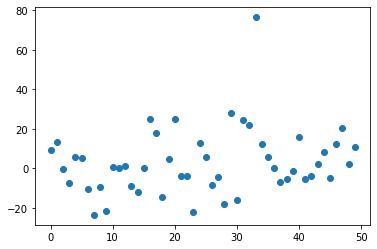

12.226498
Traced<ConcreteArray(12.226498)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(12.226498, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


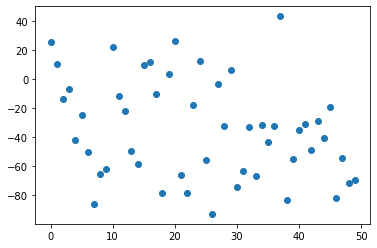

4.732666
Traced<ConcreteArray(4.732666)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.732666, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


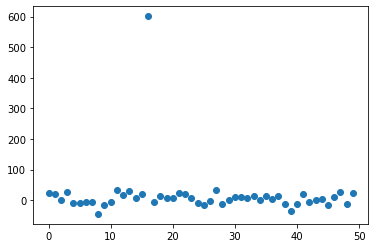

3.9028816
Traced<ConcreteArray(3.9028816)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9028816, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


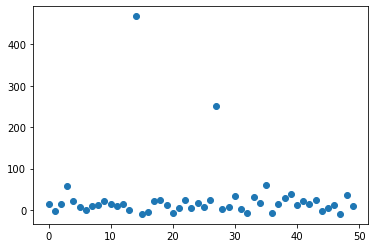

13.2524605
Traced<ConcreteArray(13.2524605)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(13.2524605, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


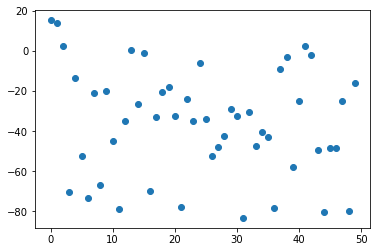

2.4891195
Traced<ConcreteArray(2.4891195)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4891195, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


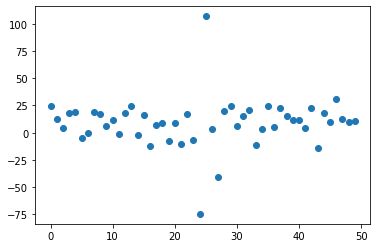

2.956149
Traced<ConcreteArray(2.956149)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.956149, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


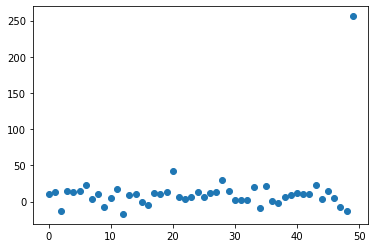

3.1778884
Traced<ConcreteArray(3.1778884)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1778884, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


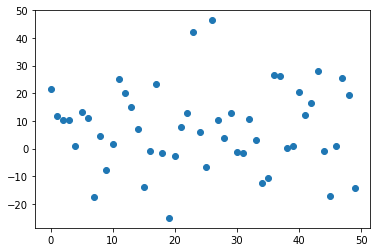

7.2819233
Traced<ConcreteArray(7.2819233)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.2819233, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


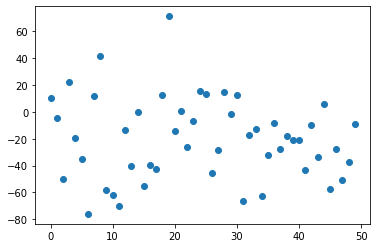

2.8996475
Traced<ConcreteArray(2.8996475)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8996475, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


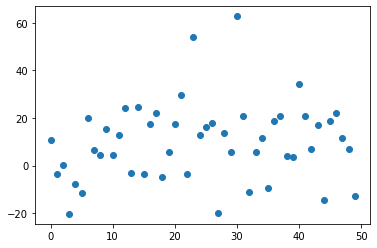

5.20864
Traced<ConcreteArray(5.20864)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.20864, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


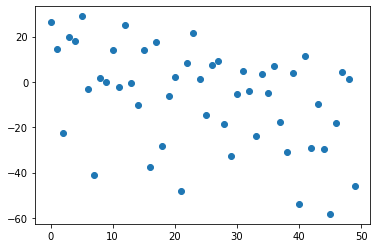

2.82717
Traced<ConcreteArray(2.82717)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.82717, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


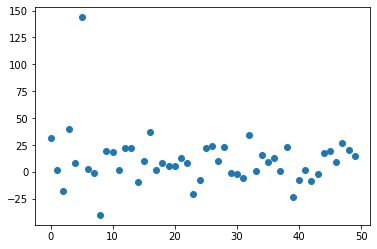

2.7431436
Traced<ConcreteArray(2.7431436)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7431436, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


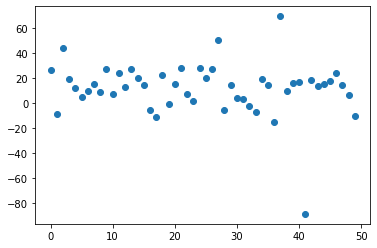

4.166098
Traced<ConcreteArray(4.166098)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.166098, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


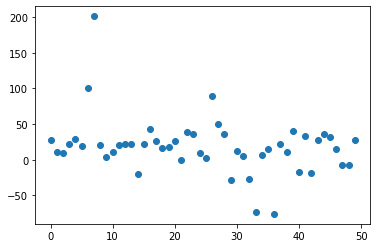

2.6663558
Traced<ConcreteArray(2.6663558)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6663558, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


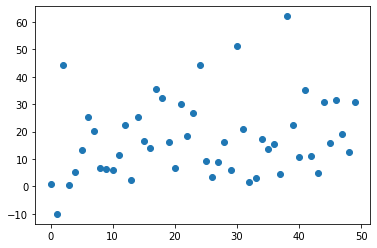

2.6451955
Traced<ConcreteArray(2.6451955)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6451955, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


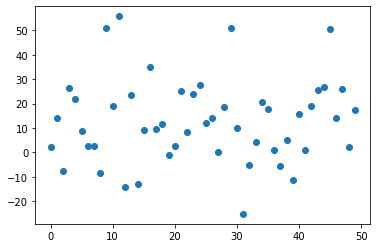

2.5146189
Traced<ConcreteArray(2.5146189)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5146189, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


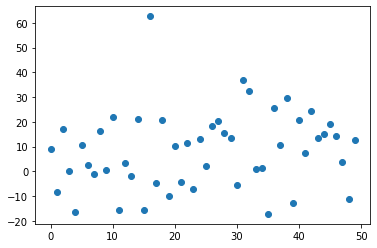

11.407063
Traced<ConcreteArray(11.407063)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(11.407063, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


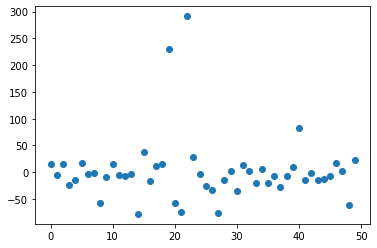

2.335829
Traced<ConcreteArray(2.335829)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.335829, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


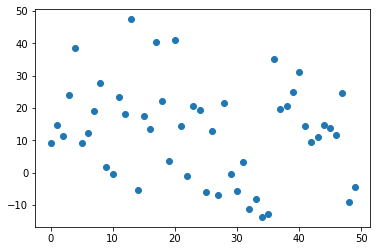

4.849113
Traced<ConcreteArray(4.849113)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.849113, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


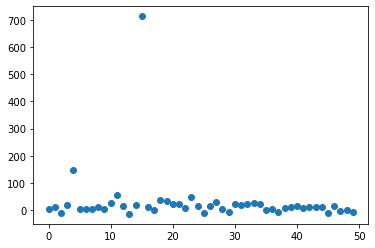

3.9150805
Traced<ConcreteArray(3.9150805)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9150805, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


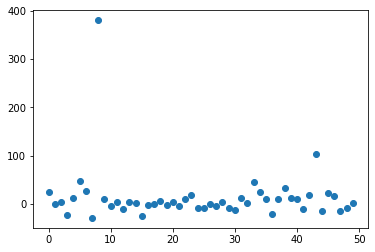

3.4215484
Traced<ConcreteArray(3.4215484)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4215484, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


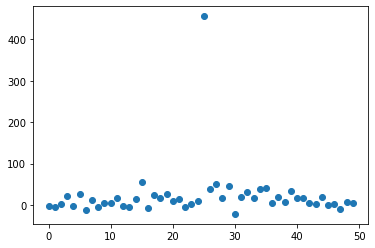

4.5433435
Traced<ConcreteArray(4.5433435)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.5433435, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


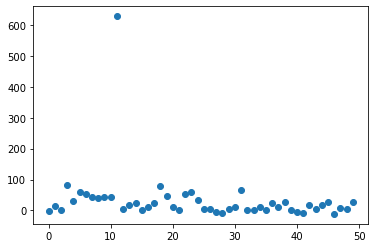

2.6317687
Traced<ConcreteArray(2.6317687)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6317687, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


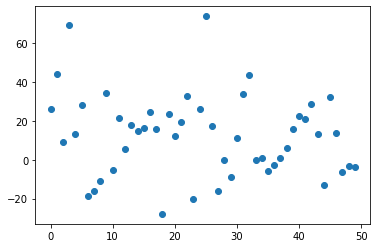

20.354626
Traced<ConcreteArray(20.354626)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(20.354626, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


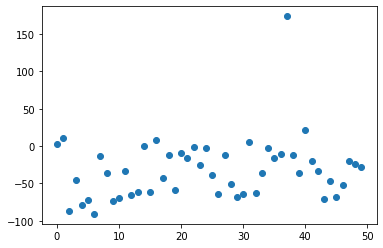

2.7003226
Traced<ConcreteArray(2.7003226)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7003226, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


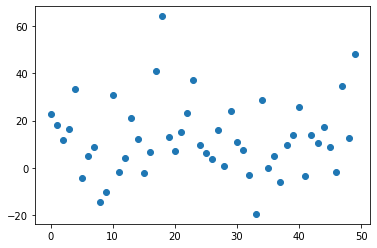

2.6909108
Traced<ConcreteArray(2.6909108)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6909108, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


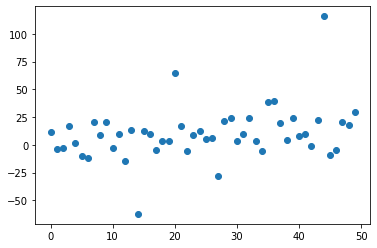

2.991211
Traced<ConcreteArray(2.991211)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.991211, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


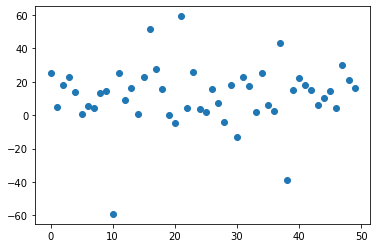

4.854264
Traced<ConcreteArray(4.854264)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.854264, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


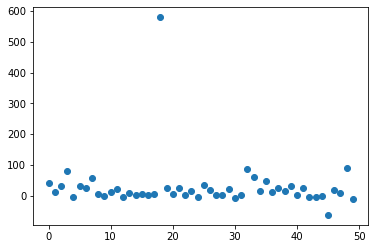

2.6719651
Traced<ConcreteArray(2.6719651)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6719651, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


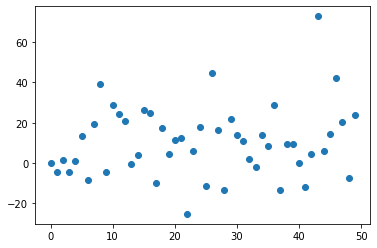

2.7140248
Traced<ConcreteArray(2.7140248)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7140248, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


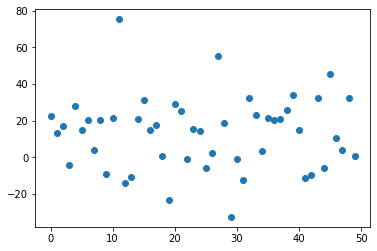

2.2989435
Traced<ConcreteArray(2.2989435)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2989435, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


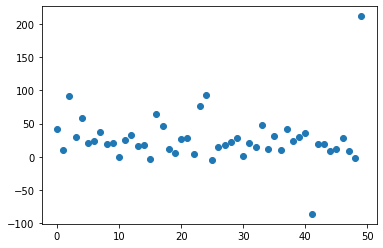

2.3581877
Traced<ConcreteArray(2.3581877)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3581877, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


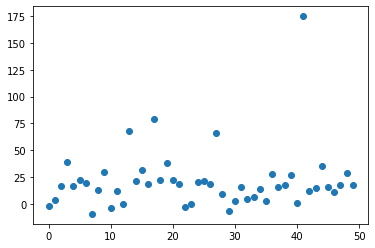

3.9073436
Traced<ConcreteArray(3.9073436)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9073436, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


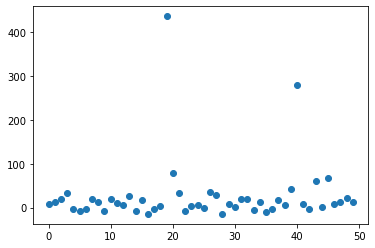

3.1420348
Traced<ConcreteArray(3.1420348)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1420348, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


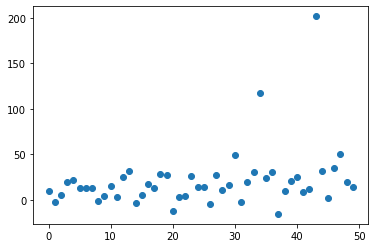

3.1442208
Traced<ConcreteArray(3.1442208)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1442208, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


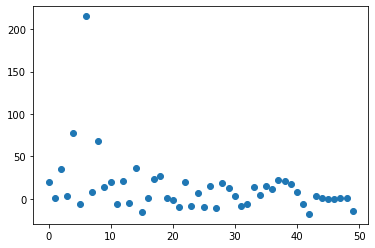

3.0216548
Traced<ConcreteArray(3.0216548)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0216548, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


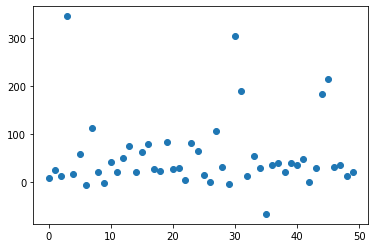

22.261719
Traced<ConcreteArray(22.261719)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(22.261719, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


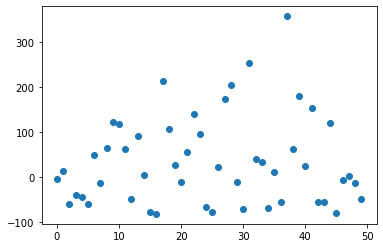

2.2989545
Traced<ConcreteArray(2.2989545)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2989545, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


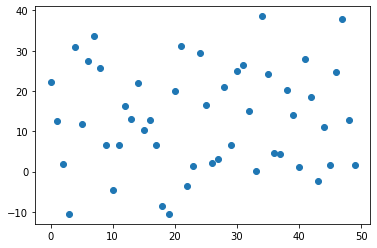

4.3697543
Traced<ConcreteArray(4.3697543)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.3697543, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


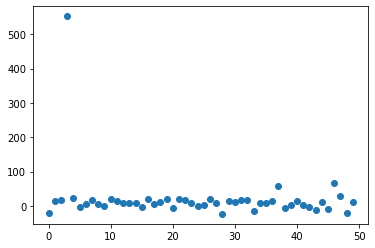

2.595036
Traced<ConcreteArray(2.595036)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.595036, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


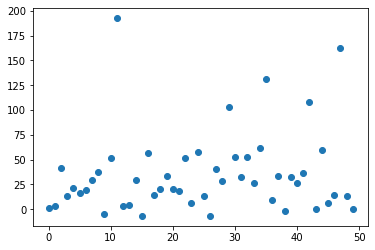

2.5981045
Traced<ConcreteArray(2.5981045)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5981045, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


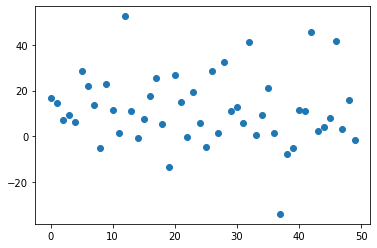

2.6274173
Traced<ConcreteArray(2.6274173)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6274173, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


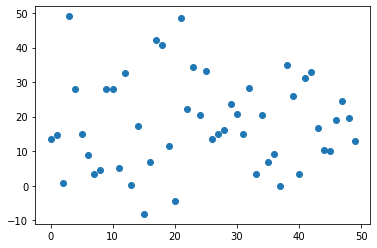

2.5712104
Traced<ConcreteArray(2.5712104)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5712104, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


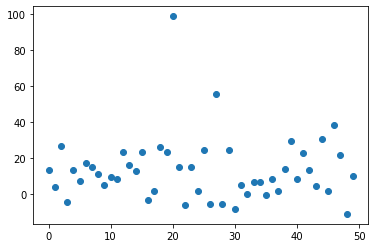

3.458753
Traced<ConcreteArray(3.458753)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.458753, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


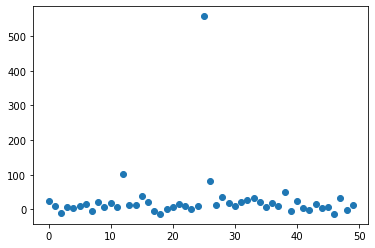

2.9493003
Traced<ConcreteArray(2.9493003)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9493003, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


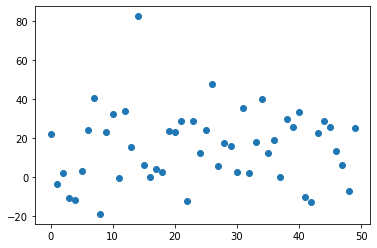

4.365372
Traced<ConcreteArray(4.365372)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.365372, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


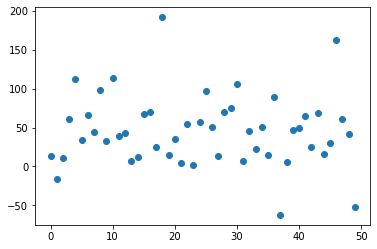

2.6052055
Traced<ConcreteArray(2.6052055)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6052055, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


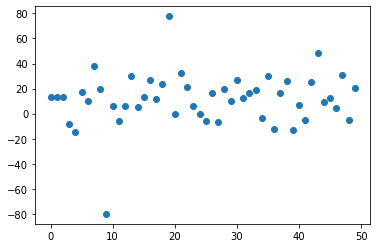

4.574293
Traced<ConcreteArray(4.574293)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.574293, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


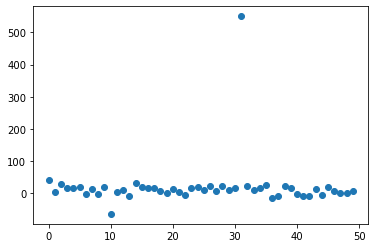

2.8521225
Traced<ConcreteArray(2.8521225)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8521225, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


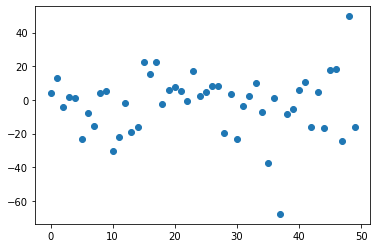

2.063115
Traced<ConcreteArray(2.063115)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.063115, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


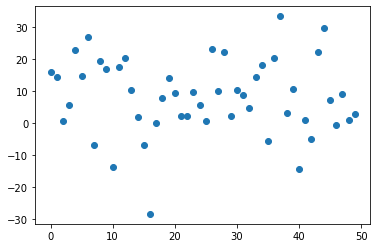

2.7806091
Traced<ConcreteArray(2.7806091)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7806091, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


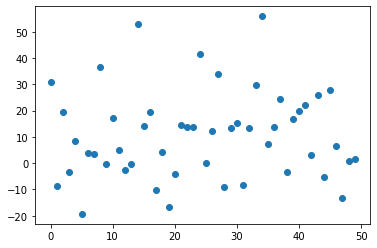

2.7961655
Traced<ConcreteArray(2.7961655)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7961655, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


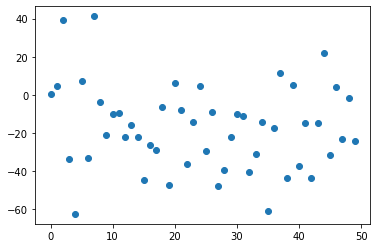

3.3301435
Traced<ConcreteArray(3.3301435)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3301435, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


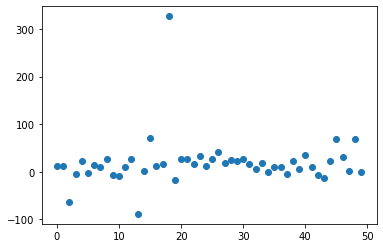

2.404455
Traced<ConcreteArray(2.404455)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.404455, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


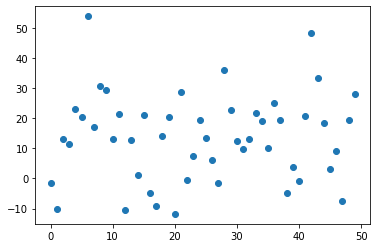

2.2741666
Traced<ConcreteArray(2.2741666)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2741666, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


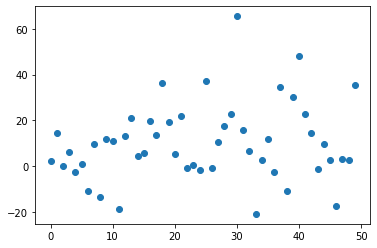

3.488206
Traced<ConcreteArray(3.488206)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.488206, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


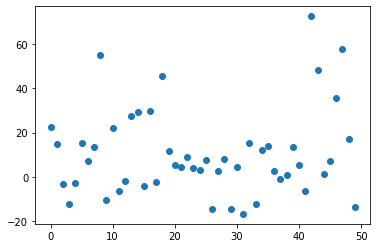

2.6930878
Traced<ConcreteArray(2.6930878)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6930878, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


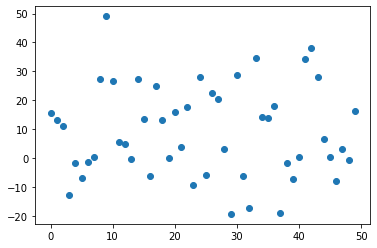

2.6938639
Traced<ConcreteArray(2.6938639)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6938639, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


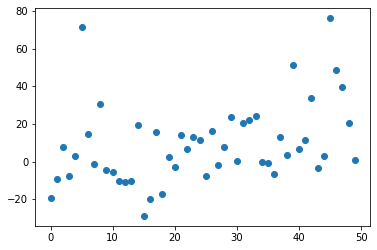

2.2283616
Traced<ConcreteArray(2.2283616)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2283616, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


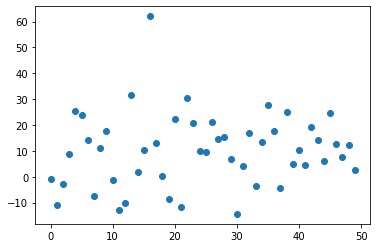

2.5729418
Traced<ConcreteArray(2.5729418)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5729418, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


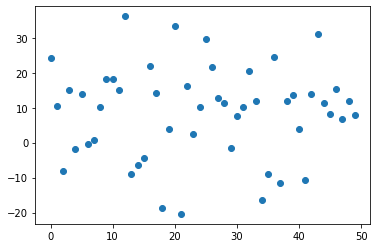

2.7295272
Traced<ConcreteArray(2.7295272)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7295272, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


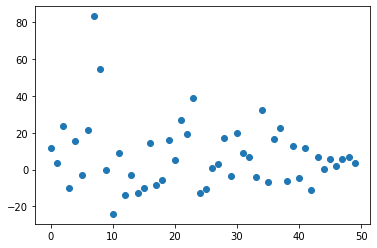

6.23747
Traced<ConcreteArray(6.23747)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.23747, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


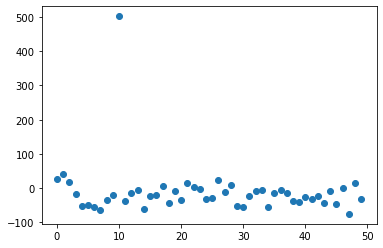

3.124609
Traced<ConcreteArray(3.124609)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.124609, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


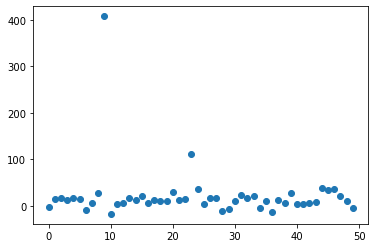

2.883409
Traced<ConcreteArray(2.883409)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.883409, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


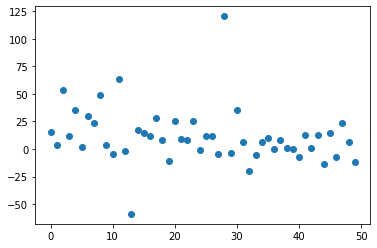

2.6582065
Traced<ConcreteArray(2.6582065)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6582065, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


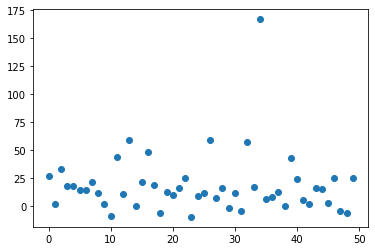

2.8862722
Traced<ConcreteArray(2.8862722)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8862722, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


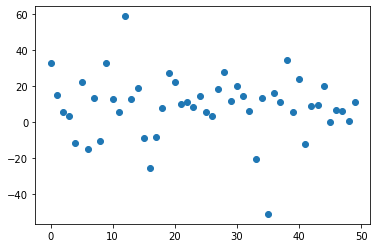

2.4114528
Traced<ConcreteArray(2.4114528)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4114528, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


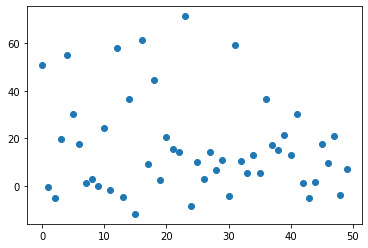

2.843815
Traced<ConcreteArray(2.843815)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.843815, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


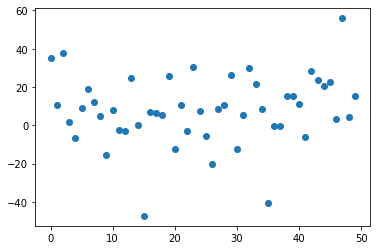

2.1773767
Traced<ConcreteArray(2.1773767)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1773767, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


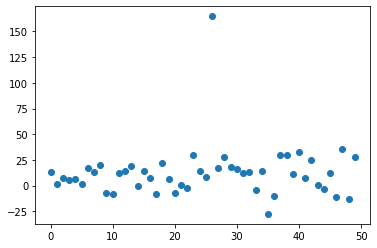

3.160462
Traced<ConcreteArray(3.160462)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.160462, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


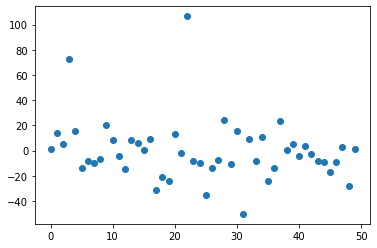

3.1514032
Traced<ConcreteArray(3.1514032)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1514032, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


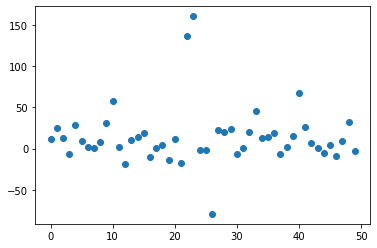

3.6106424
Traced<ConcreteArray(3.6106424)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6106424, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


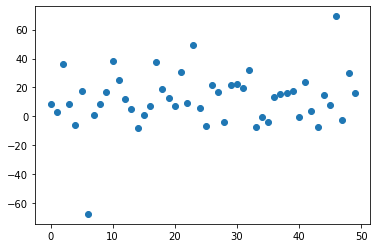

2.8029017
Traced<ConcreteArray(2.8029017)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8029017, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


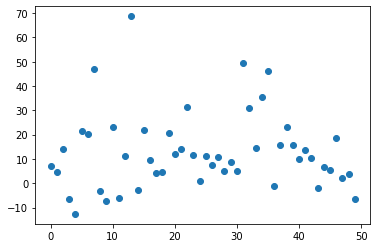

2.783977
Traced<ConcreteArray(2.783977)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.783977, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


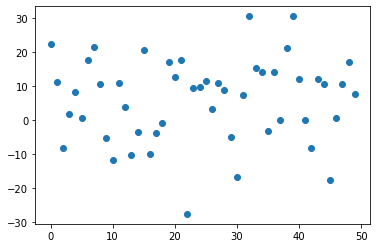

2.7874384
Traced<ConcreteArray(2.7874384)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7874384, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


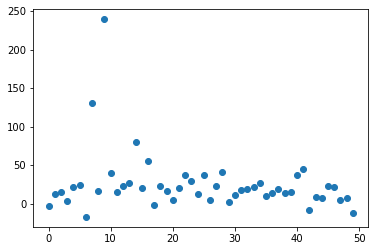

2.8411646
Traced<ConcreteArray(2.8411646)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8411646, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


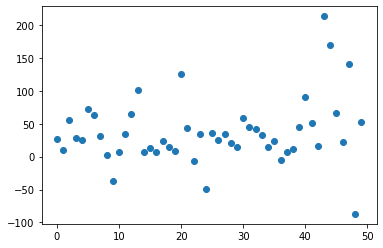

3.0208702
Traced<ConcreteArray(3.0208702)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0208702, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


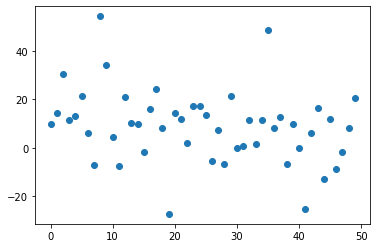

2.8700795
Traced<ConcreteArray(2.8700795)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8700795, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


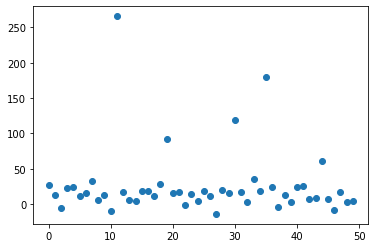

2.9149723
Traced<ConcreteArray(2.9149723)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9149723, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


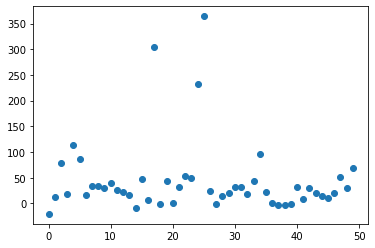

2.7165983
Traced<ConcreteArray(2.7165983)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7165983, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


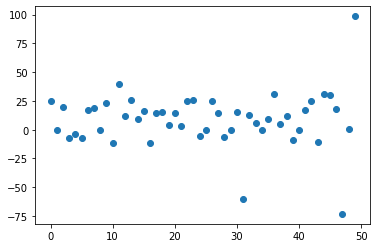

5.329341
Traced<ConcreteArray(5.329341)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.329341, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


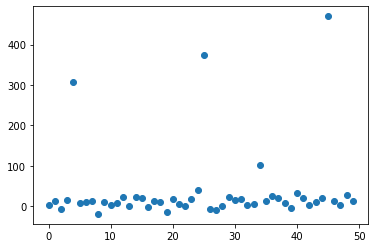

3.2053869
Traced<ConcreteArray(3.2053869)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2053869, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


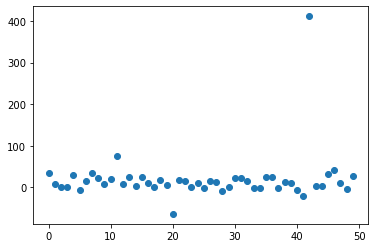

3.7476506
Traced<ConcreteArray(3.7476506)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.7476506, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


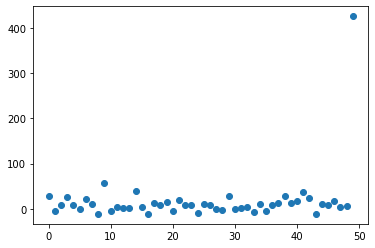

3.7965436
Traced<ConcreteArray(3.7965436)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.7965436, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


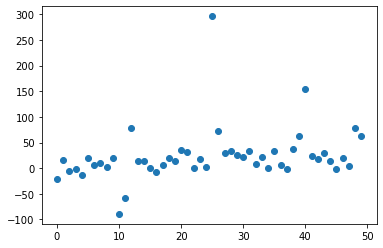

2.7401733
Traced<ConcreteArray(2.7401733)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7401733, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


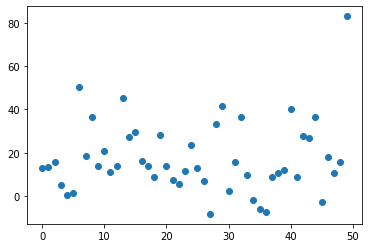

3.129416
Traced<ConcreteArray(3.129416)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.129416, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


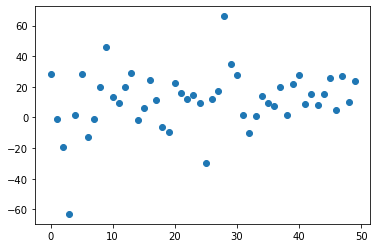

3.6175869
Traced<ConcreteArray(3.6175869)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6175869, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


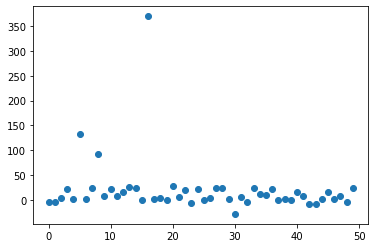

2.091011
Traced<ConcreteArray(2.091011)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.091011, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


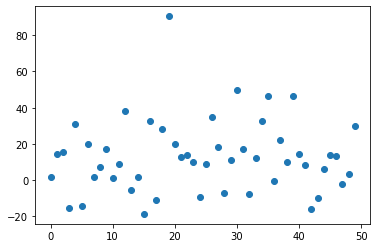

2.6729765
Traced<ConcreteArray(2.6729765)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6729765, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


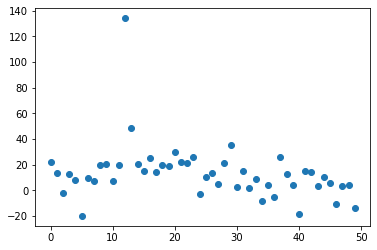

3.7190163
Traced<ConcreteArray(3.7190163)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.7190163, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


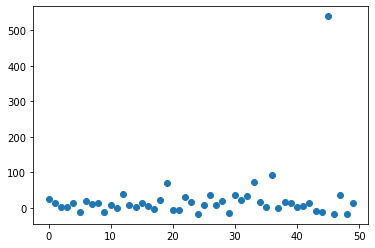

3.2586894
Traced<ConcreteArray(3.2586894)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2586894, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


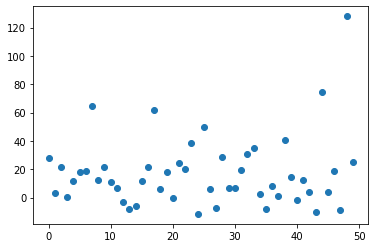

2.6205015
Traced<ConcreteArray(2.6205015)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6205015, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


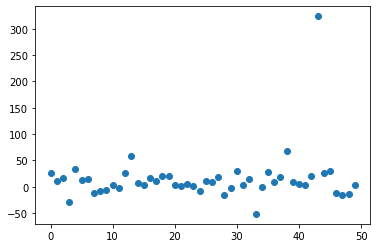

2.9396877
Traced<ConcreteArray(2.9396877)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9396877, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


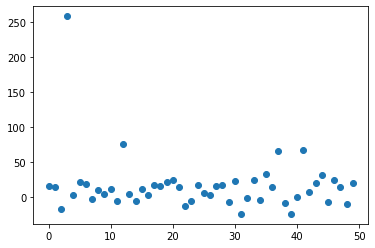

2.5078206
Traced<ConcreteArray(2.5078206)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5078206, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


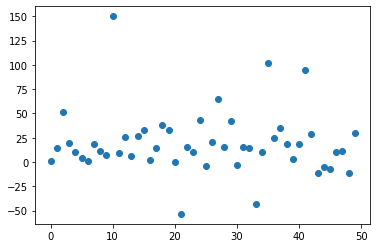

2.7289405
Traced<ConcreteArray(2.7289405)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7289405, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


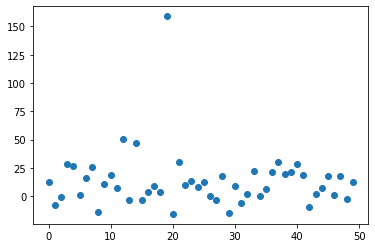

2.8383572
Traced<ConcreteArray(2.8383572)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8383572, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


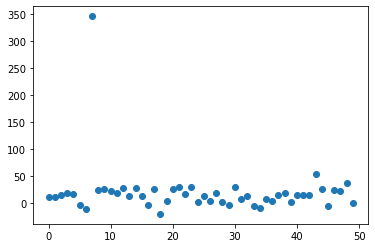

2.9809666
Traced<ConcreteArray(2.9809666)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9809666, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


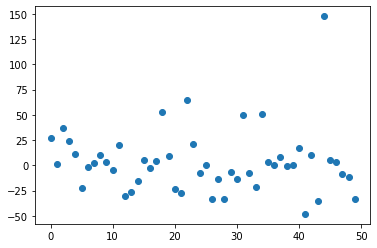

2.8103619
Traced<ConcreteArray(2.8103619)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8103619, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


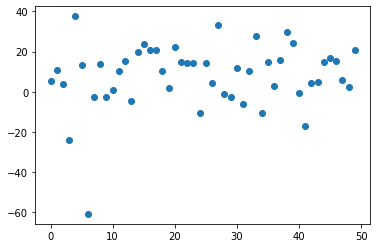

2.4847655
Traced<ConcreteArray(2.4847655)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4847655, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


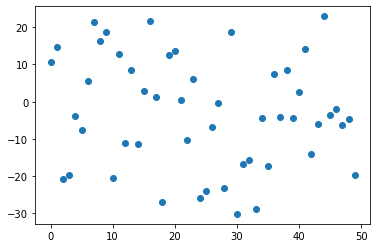

3.375329
Traced<ConcreteArray(3.375329)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.375329, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


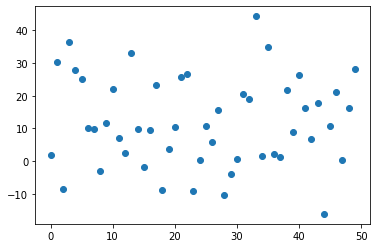

2.5459723
Traced<ConcreteArray(2.5459723)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5459723, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


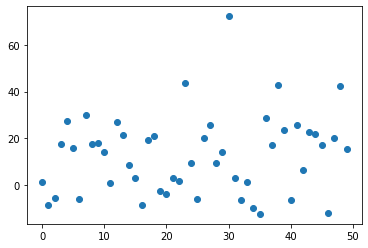

2.775515
Traced<ConcreteArray(2.775515)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.775515, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


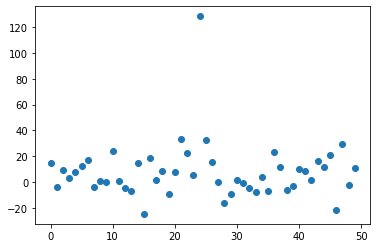

2.7960827
Traced<ConcreteArray(2.7960827)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7960827, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


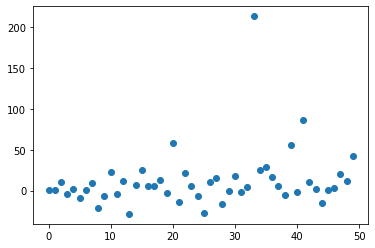

4.1855497
Traced<ConcreteArray(4.1855497)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.1855497, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


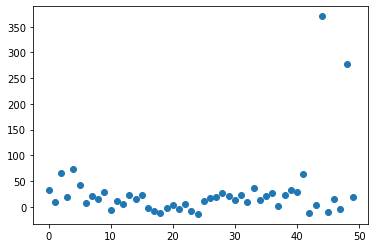

4.2729616
Traced<ConcreteArray(4.2729616)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.2729616, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


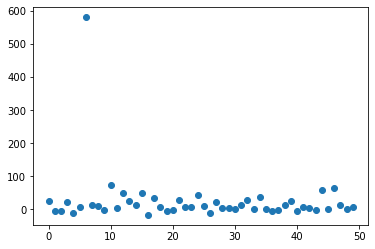

2.5908823
Traced<ConcreteArray(2.5908823)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5908823, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


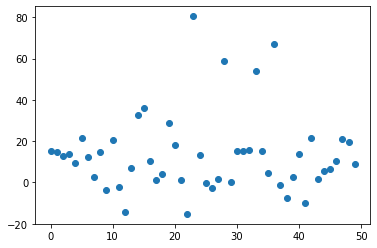

2.7012658
Traced<ConcreteArray(2.7012658)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7012658, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


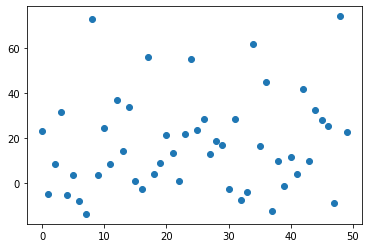

2.972176
Traced<ConcreteArray(2.972176)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.972176, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


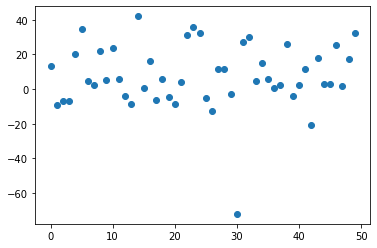

2.4843755
Traced<ConcreteArray(2.4843755)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4843755, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


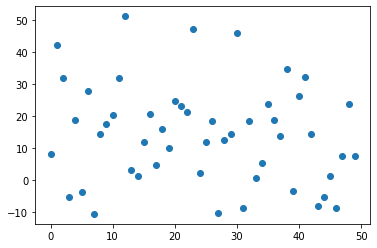

2.6378684
Traced<ConcreteArray(2.6378684)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6378684, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


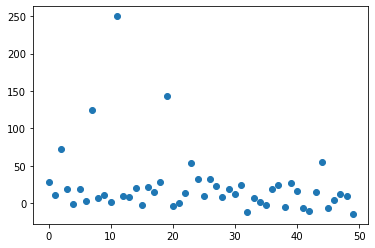

2.2607267
Traced<ConcreteArray(2.2607267)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2607267, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


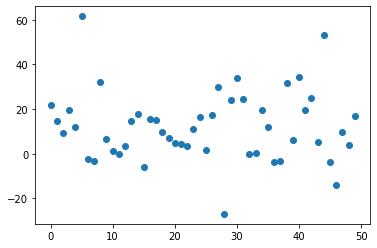

3.054842
Traced<ConcreteArray(3.054842)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.054842, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


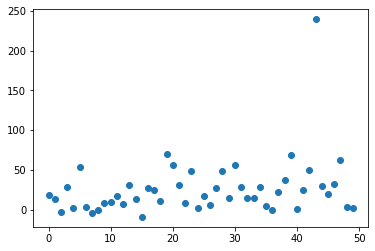

2.9367187
Traced<ConcreteArray(2.9367187)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9367187, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


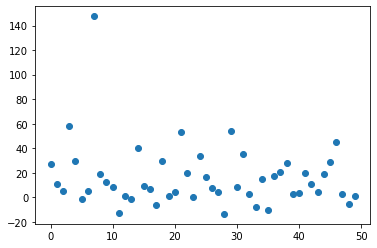

3.101708
Traced<ConcreteArray(3.101708)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.101708, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


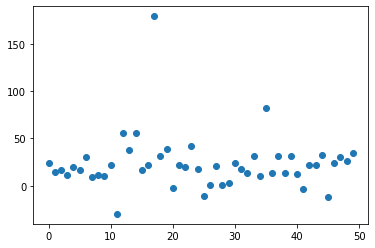

2.8788493
Traced<ConcreteArray(2.8788493)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8788493, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


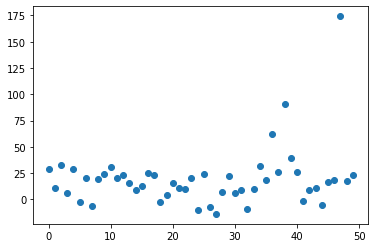

2.6801698
Traced<ConcreteArray(2.6801698)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6801698, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


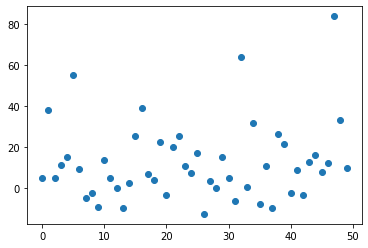

3.5669496
Traced<ConcreteArray(3.5669496)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5669496, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


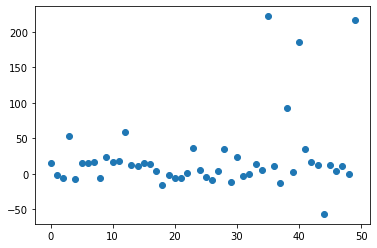

2.6558409
Traced<ConcreteArray(2.6558409)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6558409, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


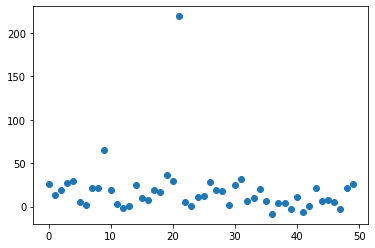

2.779841
Traced<ConcreteArray(2.779841)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.779841, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


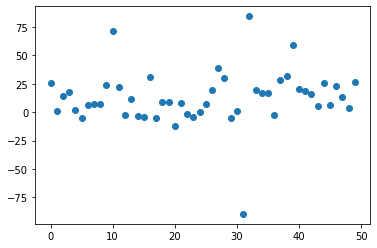

3.9734826
Traced<ConcreteArray(3.9734826)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9734826, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


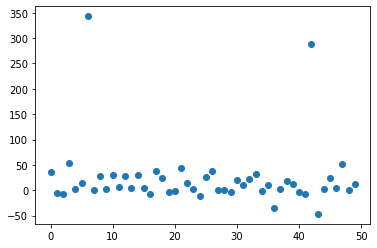

3.6836915
Traced<ConcreteArray(3.6836915)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6836915, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


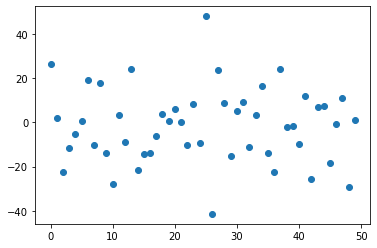

3.0250366
Traced<ConcreteArray(3.0250366)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0250366, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


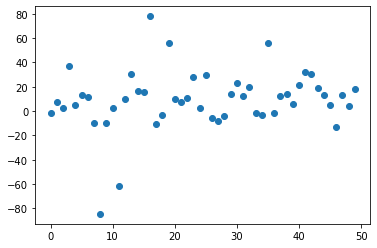

3.4118228
Traced<ConcreteArray(3.4118228)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4118228, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


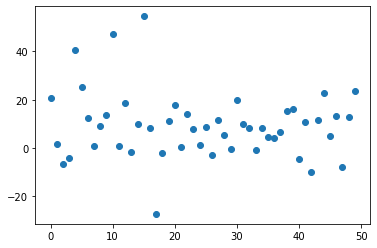

2.4864435
Traced<ConcreteArray(2.4864435)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4864435, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


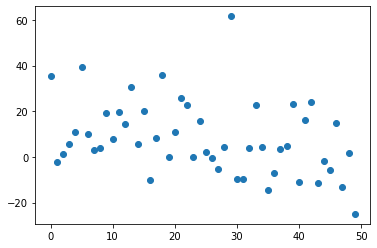

2.9038312
Traced<ConcreteArray(2.9038312)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9038312, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


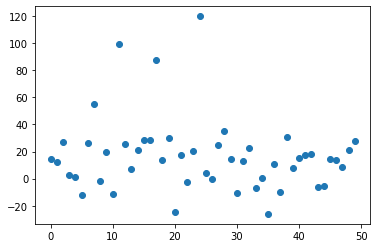

3.3151457
Traced<ConcreteArray(3.3151457)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3151457, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


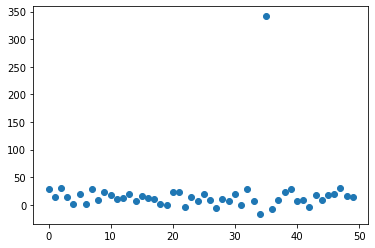

3.5239122
Traced<ConcreteArray(3.5239122)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5239122, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


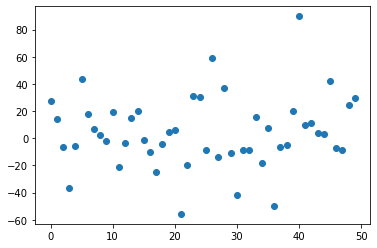

2.8433027
Traced<ConcreteArray(2.8433027)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8433027, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


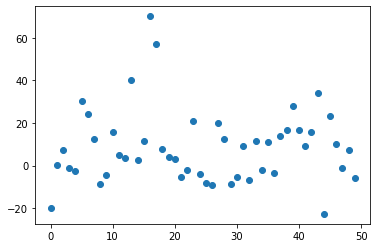

2.4240723
Traced<ConcreteArray(2.4240723)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4240723, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


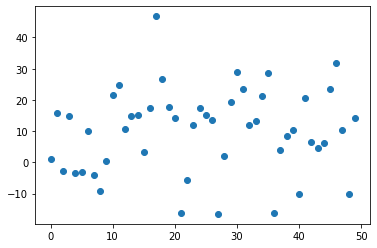

2.6361222
Traced<ConcreteArray(2.6361222)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6361222, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


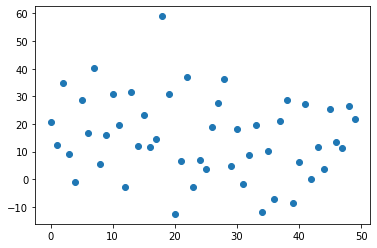

3.2117229
Traced<ConcreteArray(3.2117229)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2117229, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


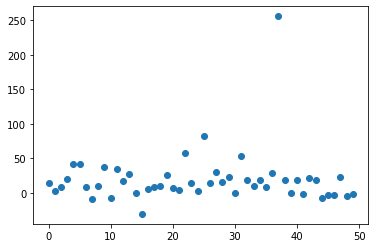

2.5432248
Traced<ConcreteArray(2.5432248)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5432248, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


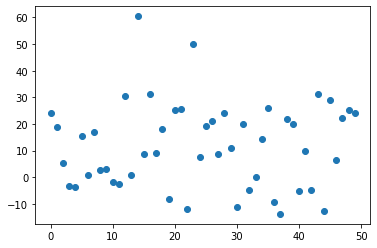

2.959599
Traced<ConcreteArray(2.959599)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.959599, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


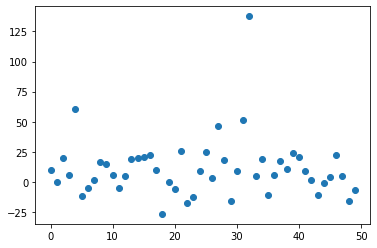

3.6243982
Traced<ConcreteArray(3.6243982)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6243982, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


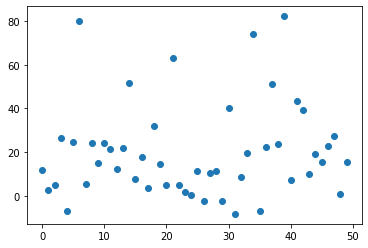

2.927729
Traced<ConcreteArray(2.927729)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.927729, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


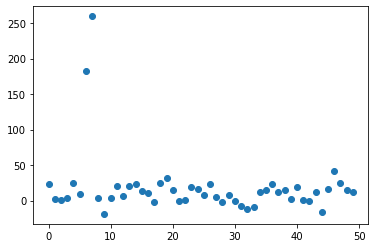

2.1613693
Traced<ConcreteArray(2.1613693)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1613693, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


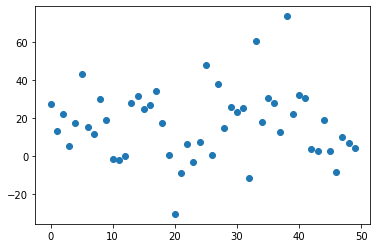

2.5600688
Traced<ConcreteArray(2.5600688)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5600688, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


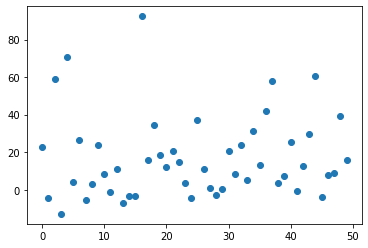

2.4109755
Traced<ConcreteArray(2.4109755)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4109755, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


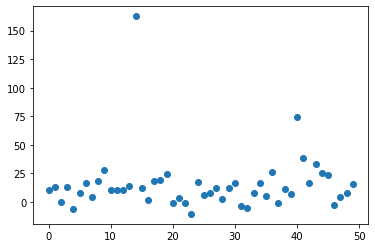

3.7472773
Traced<ConcreteArray(3.7472773)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.7472773, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


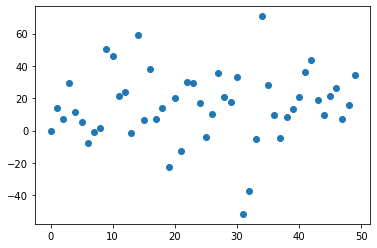

2.5879648
Traced<ConcreteArray(2.5879648)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5879648, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


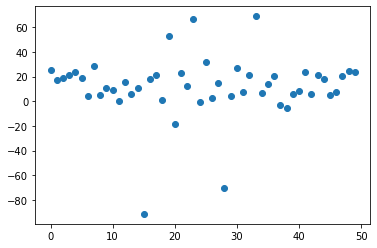

4.949516
Traced<ConcreteArray(4.949516)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.949516, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


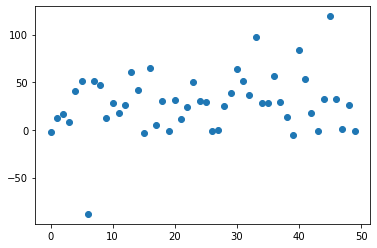

3.0191536
Traced<ConcreteArray(3.0191536)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0191536, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


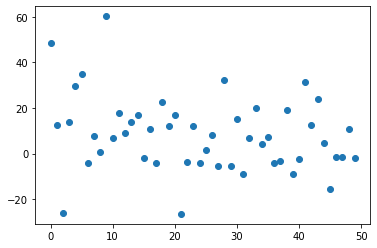

3.3843553
Traced<ConcreteArray(3.3843553)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3843553, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


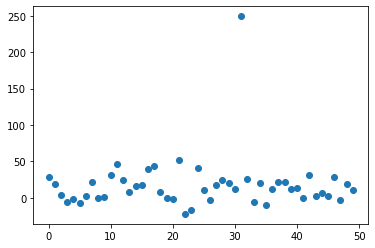

2.8265896
Traced<ConcreteArray(2.8265896)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8265896, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


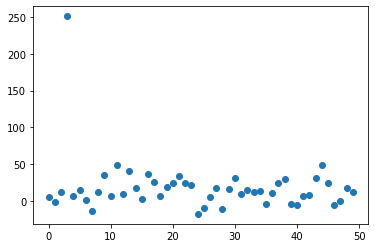

2.744121
Traced<ConcreteArray(2.744121)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.744121, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


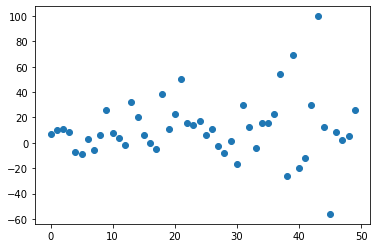

2.9741302
Traced<ConcreteArray(2.9741302)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9741302, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


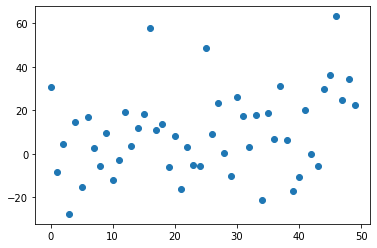

2.6702847
Traced<ConcreteArray(2.6702847)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6702847, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


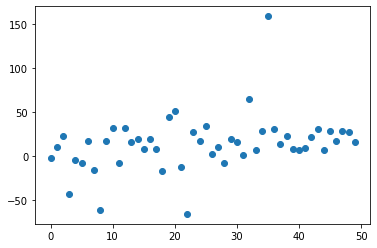

2.60381
Traced<ConcreteArray(2.60381)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.60381, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


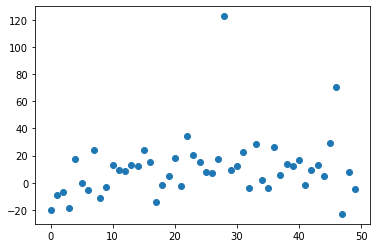

8.37945
Traced<ConcreteArray(8.37945)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(8.37945, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


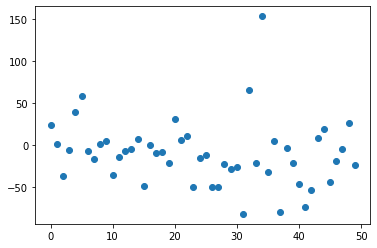

2.8839777
Traced<ConcreteArray(2.8839777)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8839777, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


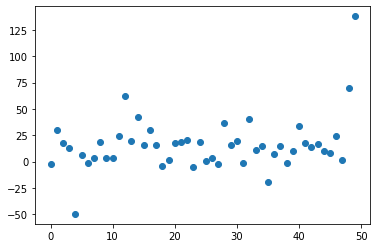

2.6892867
Traced<ConcreteArray(2.6892867)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6892867, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


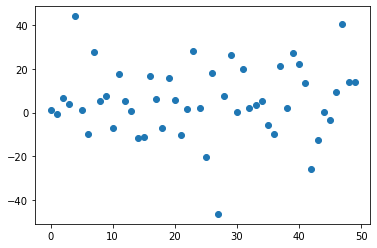

4.376807
Traced<ConcreteArray(4.376807)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.376807, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


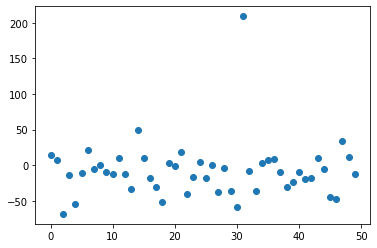

4.2911143
Traced<ConcreteArray(4.2911143)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.2911143, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


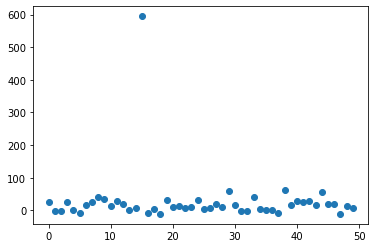

2.678988
Traced<ConcreteArray(2.678988)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.678988, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


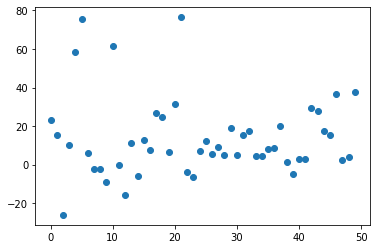

2.737605
Traced<ConcreteArray(2.737605)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.737605, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


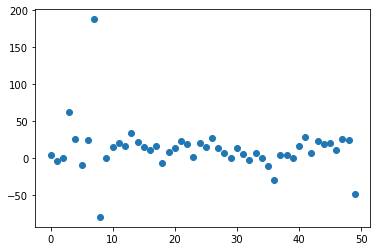

3.231269
Traced<ConcreteArray(3.231269)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.231269, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


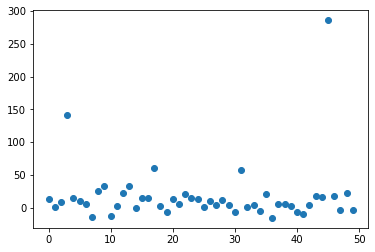

2.739411
Traced<ConcreteArray(2.739411)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.739411, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


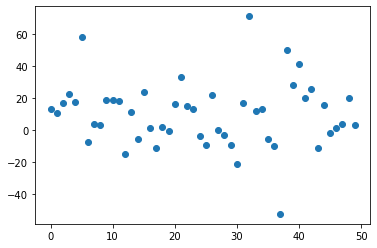

4.6491504
Traced<ConcreteArray(4.6491504)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.6491504, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


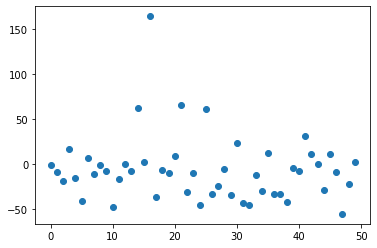

2.7133074
Traced<ConcreteArray(2.7133074)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7133074, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


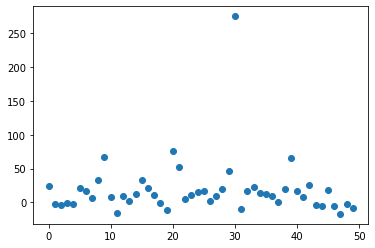

5.3664947
Traced<ConcreteArray(5.3664947)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.3664947, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


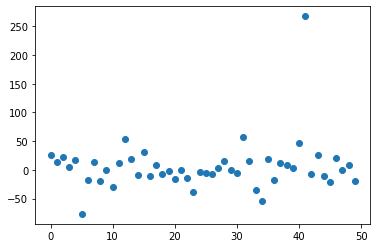

6.586465
Traced<ConcreteArray(6.586465)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.586465, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


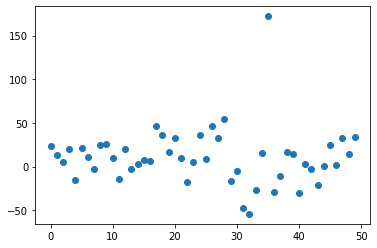

2.4206982
Traced<ConcreteArray(2.4206982)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4206982, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


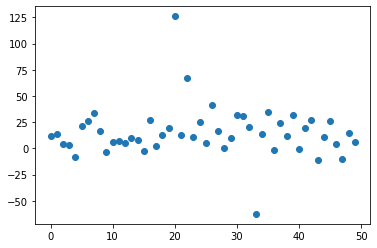

3.543738
Traced<ConcreteArray(3.543738)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.543738, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


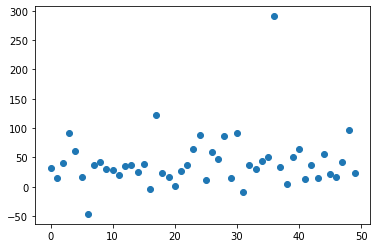

2.7801554
Traced<ConcreteArray(2.7801554)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7801554, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


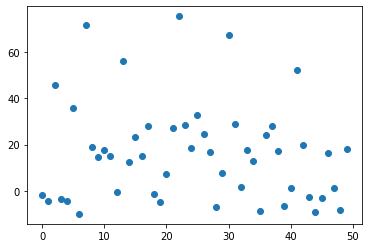

2.5920587
Traced<ConcreteArray(2.5920587)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5920587, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


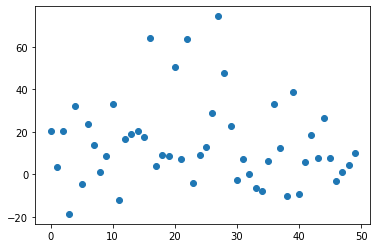

6.7528133
Traced<ConcreteArray(6.7528133)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.7528133, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


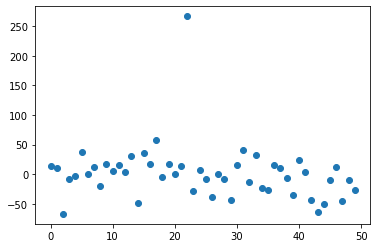

3.785688
Traced<ConcreteArray(3.785688)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.785688, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


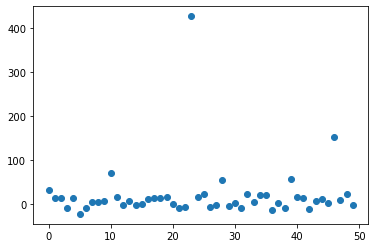

4.84147
Traced<ConcreteArray(4.84147)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.84147, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


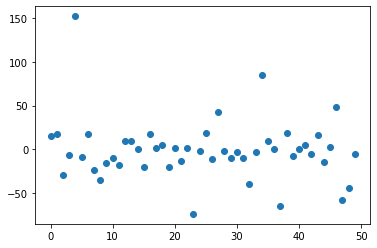

2.44154
Traced<ConcreteArray(2.44154)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.44154, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


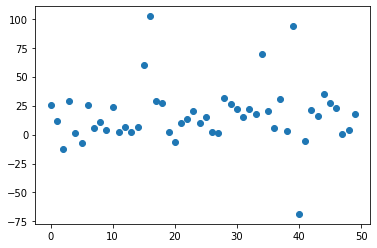

3.2674928
Traced<ConcreteArray(3.2674928)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2674928, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


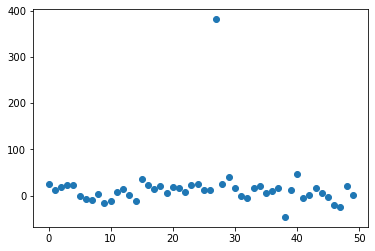

2.7243798
Traced<ConcreteArray(2.7243798)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7243798, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


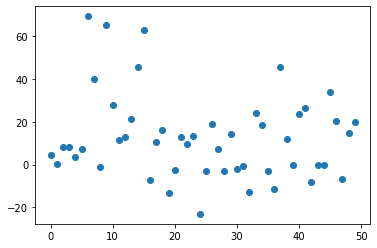

2.5613775
Traced<ConcreteArray(2.5613775)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5613775, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


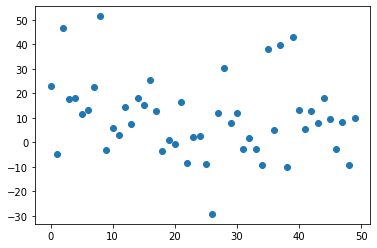

2.1755772
Traced<ConcreteArray(2.1755772)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1755772, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


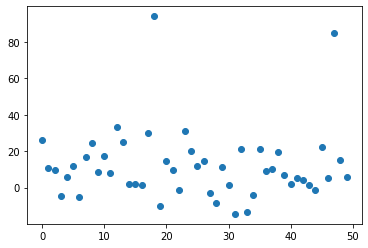

4.6042423
Traced<ConcreteArray(4.6042423)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.6042423, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


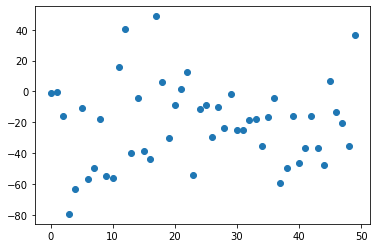

4.745193
Traced<ConcreteArray(4.745193)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.745193, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


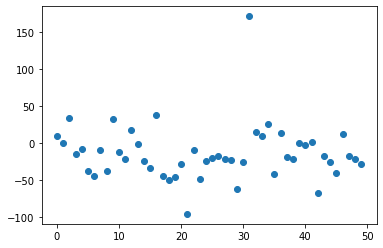

2.4684513
Traced<ConcreteArray(2.4684513)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4684513, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


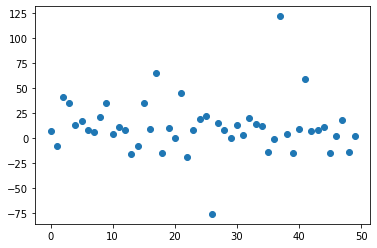

2.6194005
Traced<ConcreteArray(2.6194005)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6194005, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


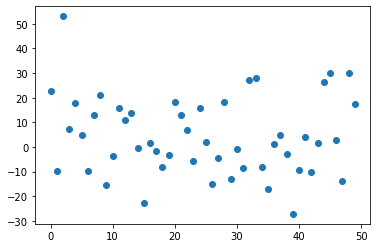

3.6333594
Traced<ConcreteArray(3.6333594)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6333594, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


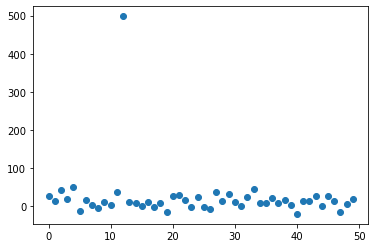

2.772752
Traced<ConcreteArray(2.772752)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.772752, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


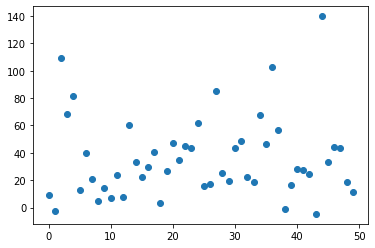

2.6456265
Traced<ConcreteArray(2.6456265)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6456265, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


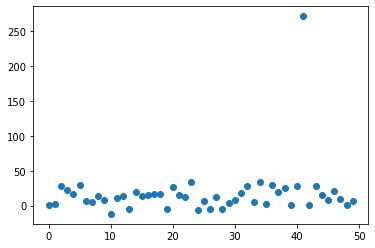

2.6910377
Traced<ConcreteArray(2.6910377)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6910377, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


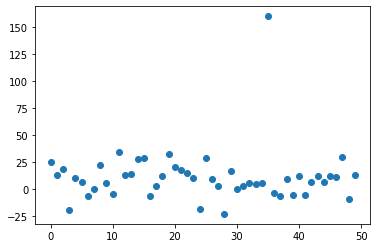

4.147932
Traced<ConcreteArray(4.147932)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.147932, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


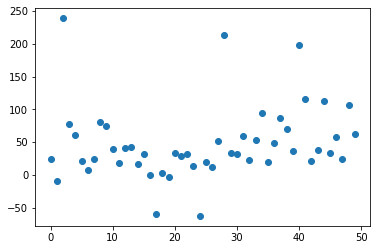

3.3268785
Traced<ConcreteArray(3.3268785)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3268785, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


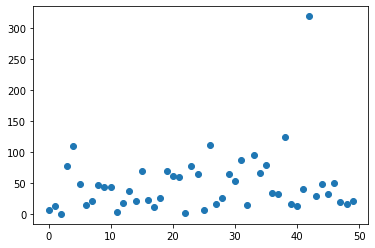

2.8651824
Traced<ConcreteArray(2.8651824)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8651824, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


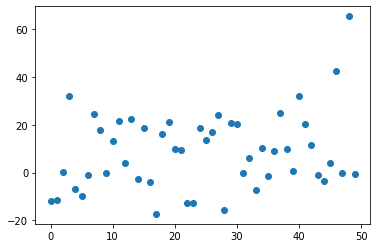

2.8566892
Traced<ConcreteArray(2.8566892)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8566892, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


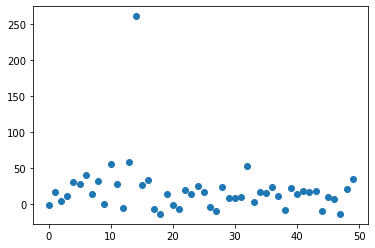

2.2883415
Traced<ConcreteArray(2.2883415)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2883415, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


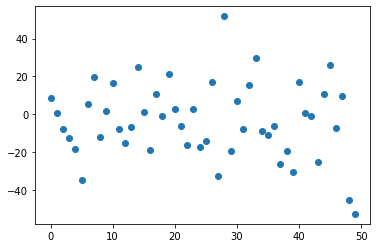

3.14421
Traced<ConcreteArray(3.14421)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.14421, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


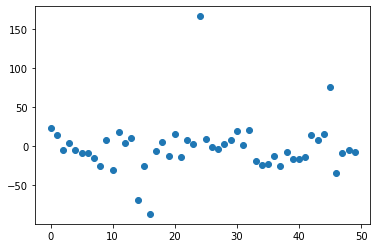

2.6594677
Traced<ConcreteArray(2.6594677)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6594677, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


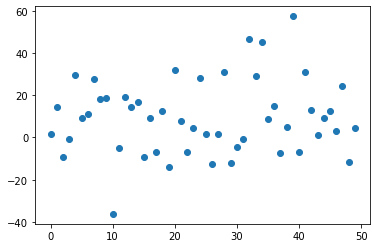

2.8448064
Traced<ConcreteArray(2.8448064)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8448064, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


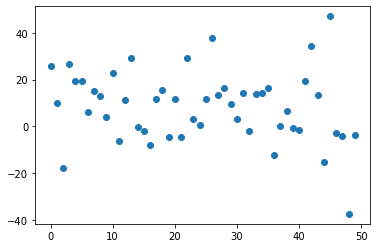

2.2836366
Traced<ConcreteArray(2.2836366)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2836366, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


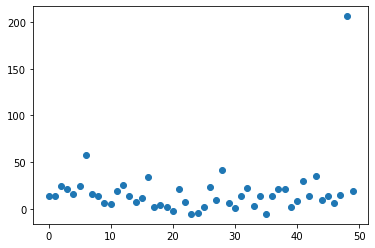

3.31357
Traced<ConcreteArray(3.31357)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.31357, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


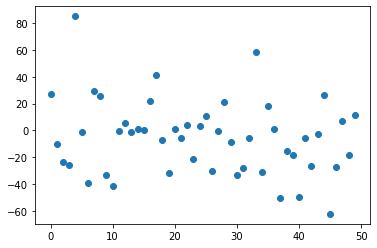

2.7299962
Traced<ConcreteArray(2.7299962)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7299962, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


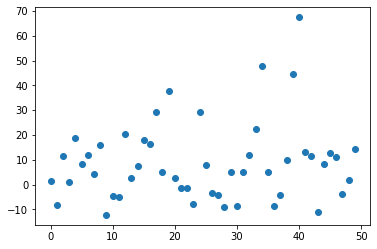

2.5982058
Traced<ConcreteArray(2.5982058)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5982058, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


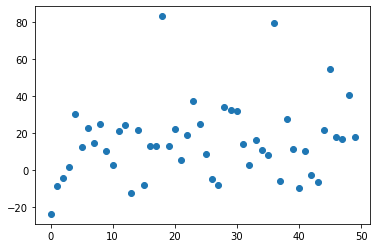

2.7046533
Traced<ConcreteArray(2.7046533)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7046533, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


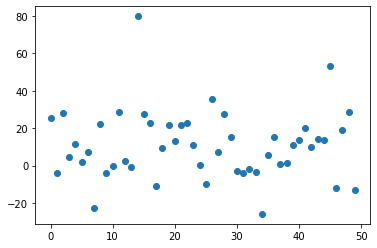

2.5465243
Traced<ConcreteArray(2.5465243)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5465243, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


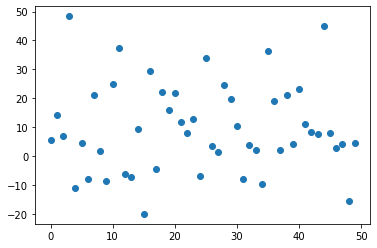

3.0785587
Traced<ConcreteArray(3.0785587)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0785587, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


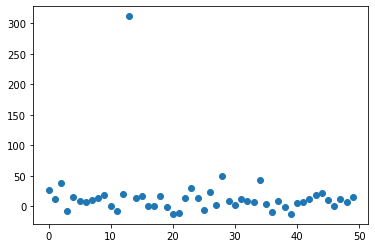

2.6697352
Traced<ConcreteArray(2.6697352)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6697352, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


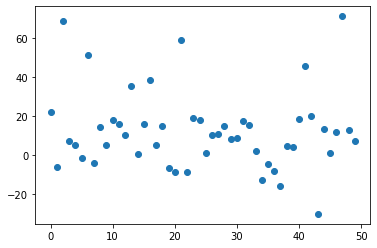

2.5839553
Traced<ConcreteArray(2.5839553)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5839553, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


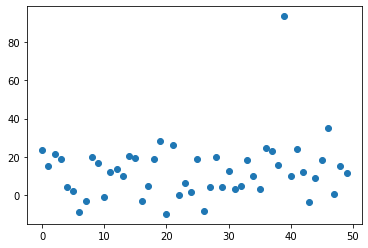

2.5604928
Traced<ConcreteArray(2.5604928)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5604928, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


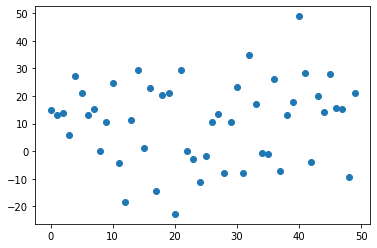

3.0430293
Traced<ConcreteArray(3.0430293)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0430293, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


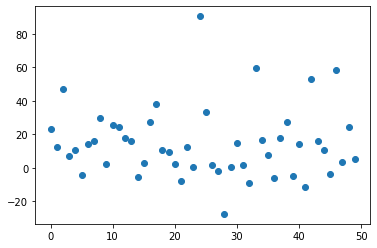

3.3030958
Traced<ConcreteArray(3.3030958)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3030958, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


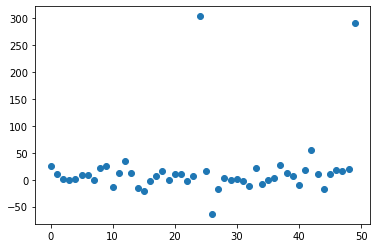

4.411414
Traced<ConcreteArray(4.411414)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.411414, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


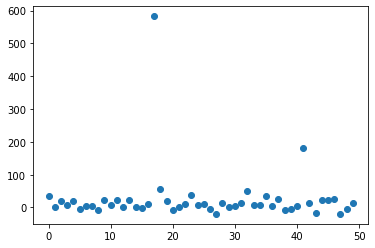

3.0046763
Traced<ConcreteArray(3.0046763)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0046763, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


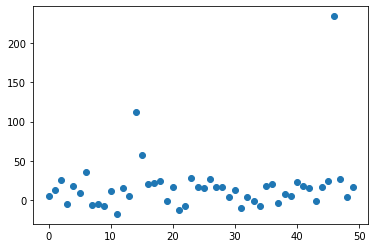

2.443704
Traced<ConcreteArray(2.443704)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.443704, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


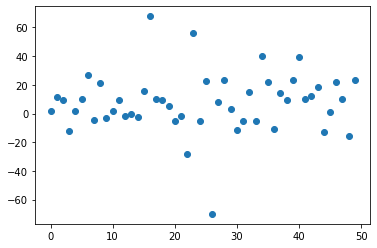

2.8662233
Traced<ConcreteArray(2.8662233)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8662233, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


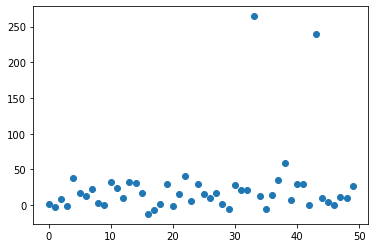

2.5589144
Traced<ConcreteArray(2.5589144)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5589144, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


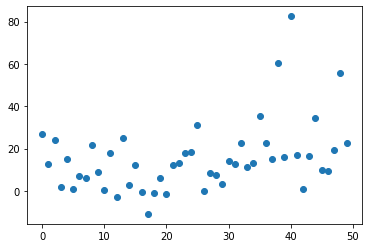

2.7309115
Traced<ConcreteArray(2.7309115)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7309115, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


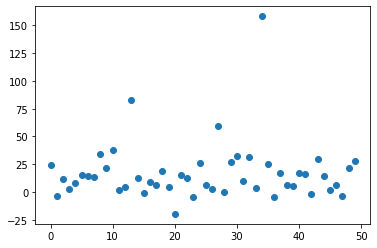

2.6203623
Traced<ConcreteArray(2.6203623)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6203623, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


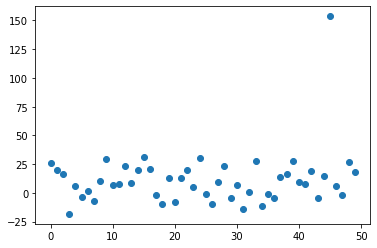

3.1374617
Traced<ConcreteArray(3.1374617)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1374617, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


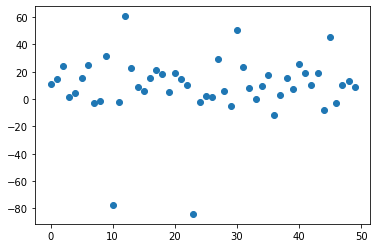

2.971295
Traced<ConcreteArray(2.971295)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.971295, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


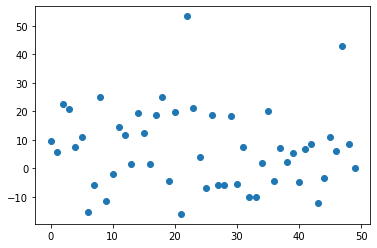

2.7299895
Traced<ConcreteArray(2.7299895)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7299895, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


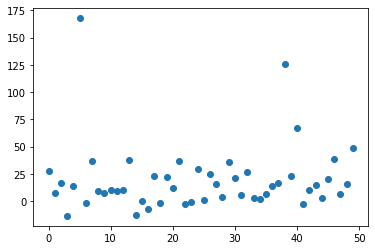

3.3648596
Traced<ConcreteArray(3.3648596)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3648596, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


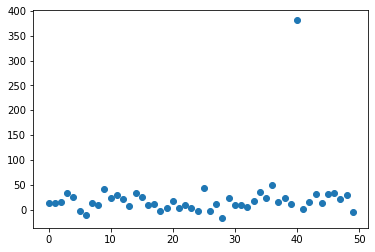

2.3498173
Traced<ConcreteArray(2.3498173)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3498173, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


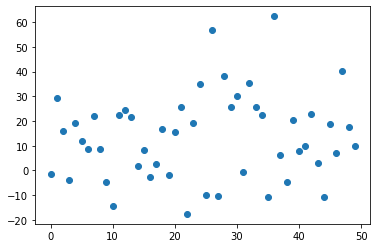

2.8157537
Traced<ConcreteArray(2.8157537)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8157537, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


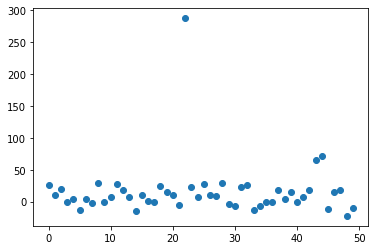

2.615726
Traced<ConcreteArray(2.615726)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.615726, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


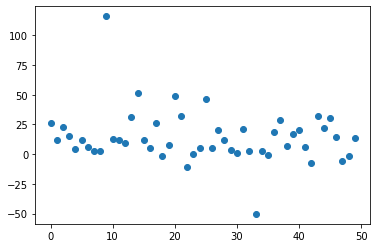

3.2458935
Traced<ConcreteArray(3.2458935)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2458935, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


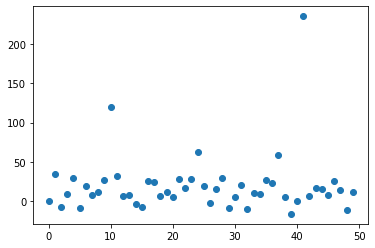

3.3247652
Traced<ConcreteArray(3.3247652)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3247652, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


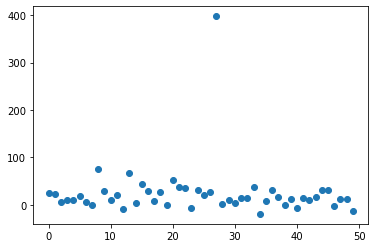

3.053835
Traced<ConcreteArray(3.053835)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.053835, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


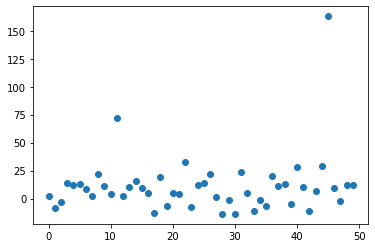

3.135431
Traced<ConcreteArray(3.135431)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.135431, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


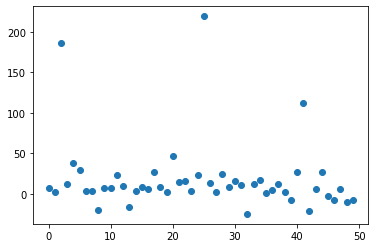

2.2906945
Traced<ConcreteArray(2.2906945)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2906945, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


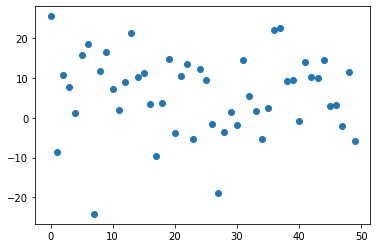

2.9072561
Traced<ConcreteArray(2.9072561)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9072561, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


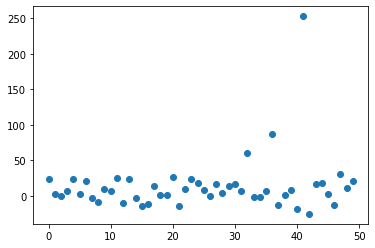

2.704997
Traced<ConcreteArray(2.704997)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.704997, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


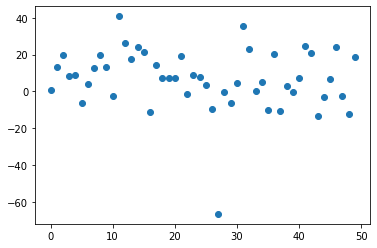

2.7557645
Traced<ConcreteArray(2.7557645)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7557645, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


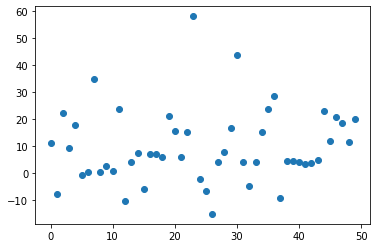

2.858543
Traced<ConcreteArray(2.858543)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.858543, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


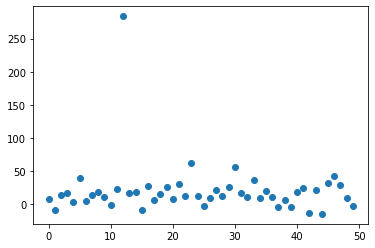

2.5855713
Traced<ConcreteArray(2.5855713)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5855713, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


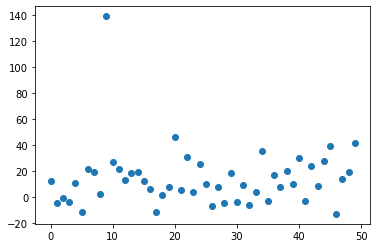

3.2112386
Traced<ConcreteArray(3.2112386)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2112386, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


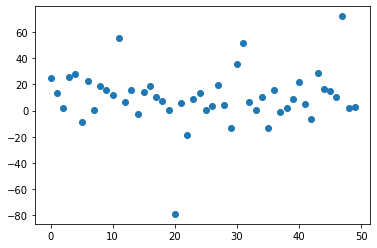

2.458831
Traced<ConcreteArray(2.458831)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.458831, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


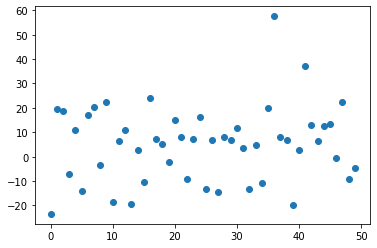

2.4548912
Traced<ConcreteArray(2.4548912)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4548912, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


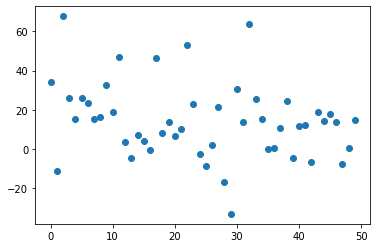

2.934133
Traced<ConcreteArray(2.934133)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.934133, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


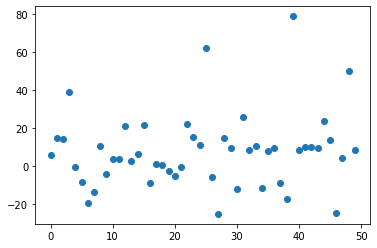

4.2710323
Traced<ConcreteArray(4.2710323)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.2710323, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


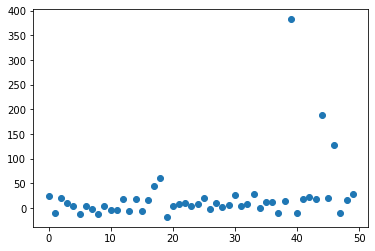

3.2569249
Traced<ConcreteArray(3.2569249)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2569249, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


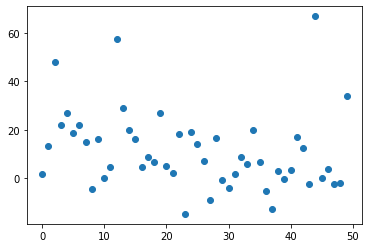

2.7734199
Traced<ConcreteArray(2.7734199)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7734199, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


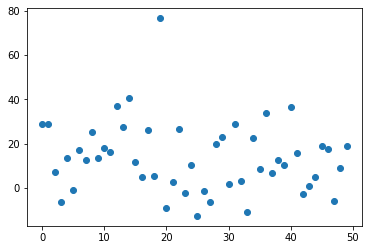

2.3395615
Traced<ConcreteArray(2.3395615)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3395615, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


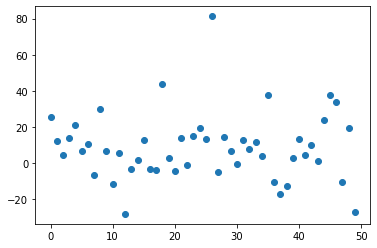

2.9234014
Traced<ConcreteArray(2.9234014)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9234014, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


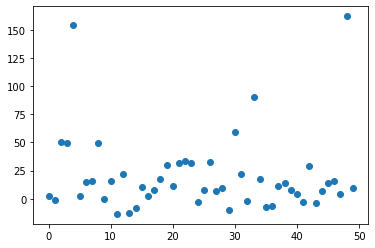

3.862548
Traced<ConcreteArray(3.862548)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.862548, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


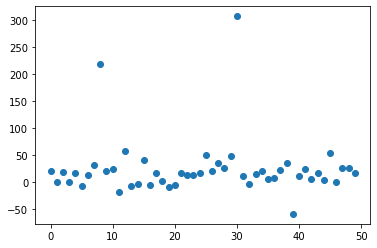

2.5372932
Traced<ConcreteArray(2.5372932)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5372932, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


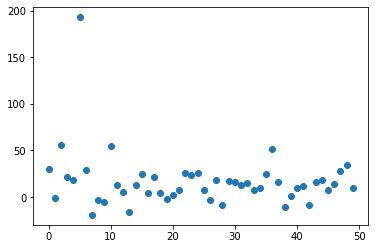

2.6493776
Traced<ConcreteArray(2.6493776)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6493776, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


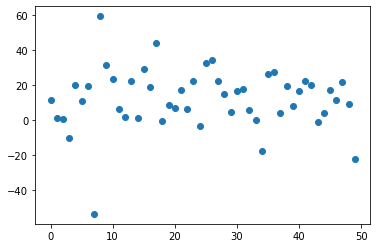

2.4114141
Traced<ConcreteArray(2.4114141)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4114141, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


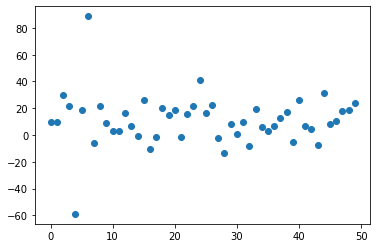

2.9738126
Traced<ConcreteArray(2.9738126)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9738126, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


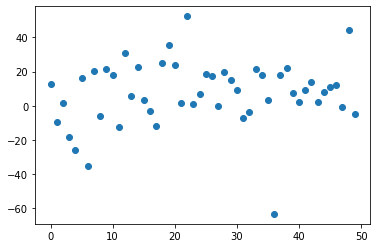

3.6408536
Traced<ConcreteArray(3.6408536)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6408536, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


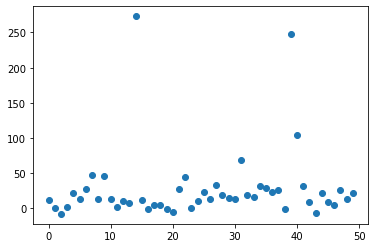

4.086558
Traced<ConcreteArray(4.086558)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.086558, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


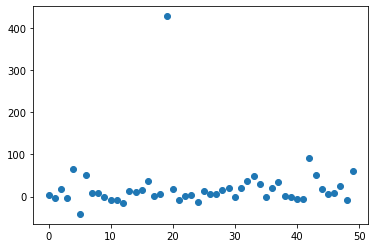

3.0106773
Traced<ConcreteArray(3.0106773)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0106773, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


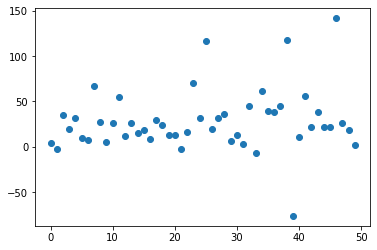

2.580152
Traced<ConcreteArray(2.580152)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.580152, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


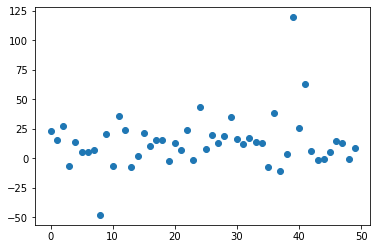

3.0268362
Traced<ConcreteArray(3.0268362)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0268362, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


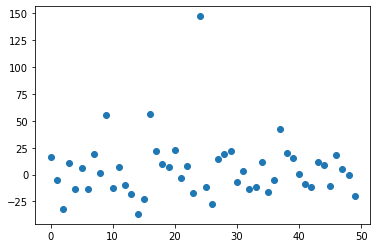

2.6950388
Traced<ConcreteArray(2.6950388)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6950388, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


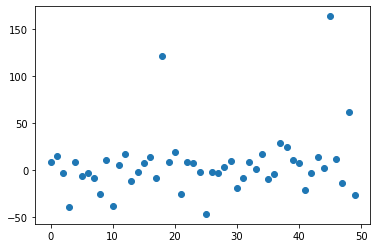

2.957054
Traced<ConcreteArray(2.957054)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.957054, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


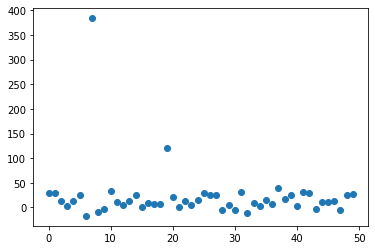

3.0784233
Traced<ConcreteArray(3.0784233)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0784233, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


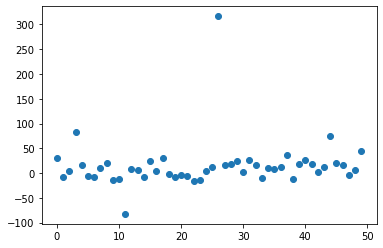

2.4847648
Traced<ConcreteArray(2.4847648)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4847648, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


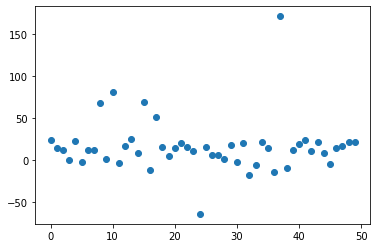

3.568304
Traced<ConcreteArray(3.568304)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.568304, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


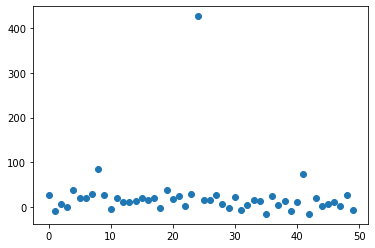

2.5866807
Traced<ConcreteArray(2.5866807)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5866807, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


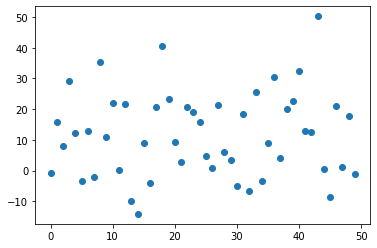

2.8375492
Traced<ConcreteArray(2.8375492)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8375492, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


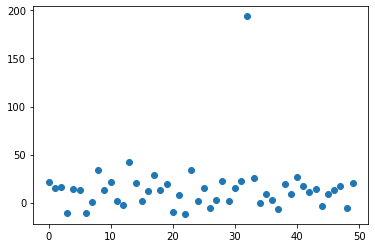

3.8165042
Traced<ConcreteArray(3.8165042)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8165042, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


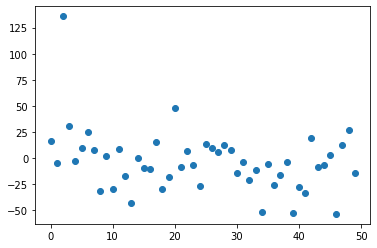

2.6649165
Traced<ConcreteArray(2.6649165)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6649165, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


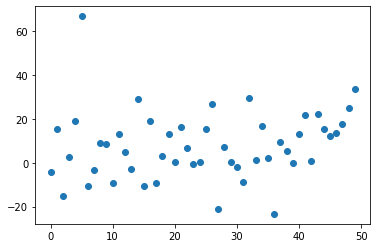

2.7413464
Traced<ConcreteArray(2.7413464)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7413464, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


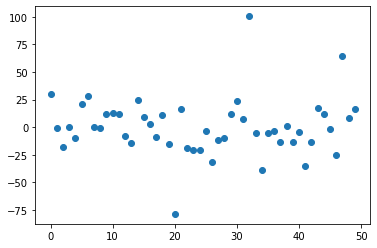

2.4686365
Traced<ConcreteArray(2.4686365)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4686365, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


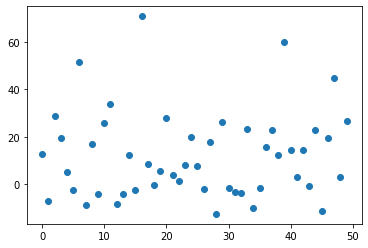

3.4752567
Traced<ConcreteArray(3.4752567)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4752567, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


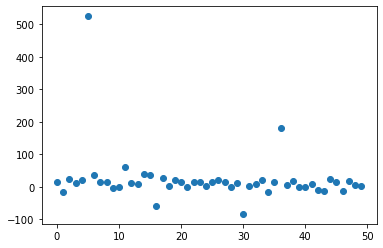

2.7586033
Traced<ConcreteArray(2.7586033)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7586033, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


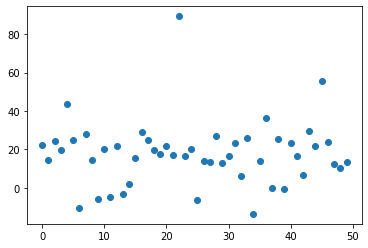

2.779898
Traced<ConcreteArray(2.779898)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.779898, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


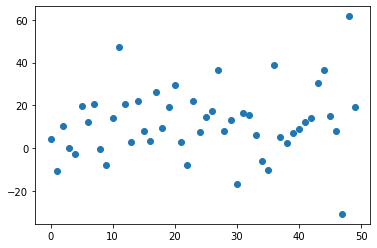

2.8671129
Traced<ConcreteArray(2.8671129)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8671129, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


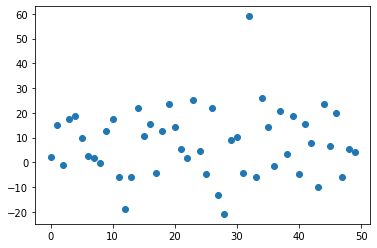

2.475473
Traced<ConcreteArray(2.475473)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.475473, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


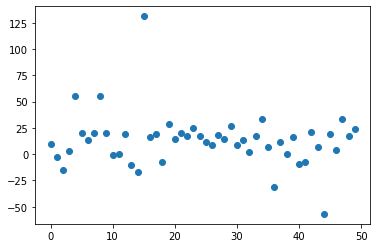

2.5479875
Traced<ConcreteArray(2.5479875)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5479875, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


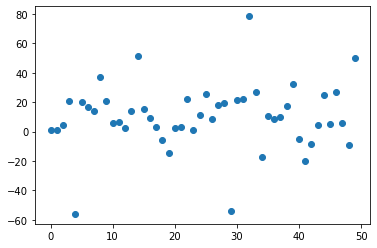

3.0536366
Traced<ConcreteArray(3.0536366)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0536366, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


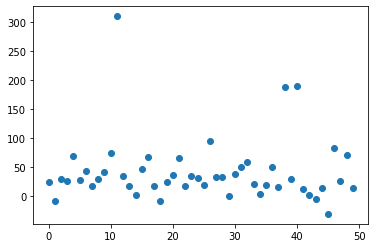

2.915285
Traced<ConcreteArray(2.915285)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.915285, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


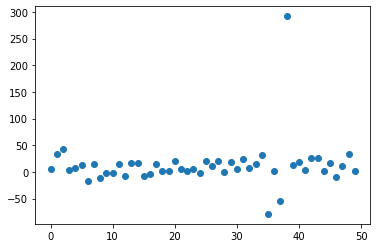

3.2195477
Traced<ConcreteArray(3.2195477)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2195477, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


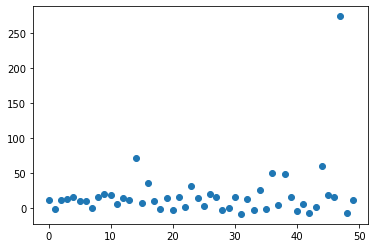

3.0724797
Traced<ConcreteArray(3.0724797)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0724797, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


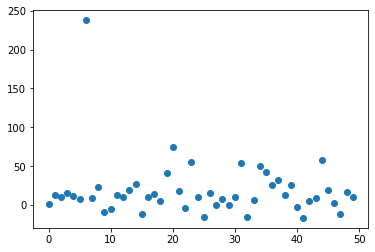

3.1734471
Traced<ConcreteArray(3.1734471)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1734471, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


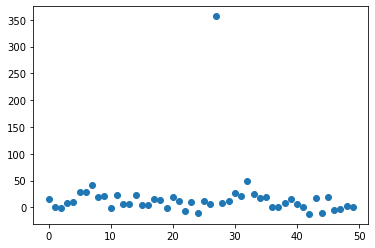

2.303496
Traced<ConcreteArray(2.303496)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.303496, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


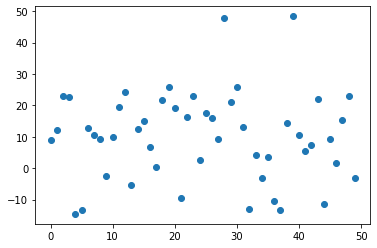

2.9727411
Traced<ConcreteArray(2.9727411)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9727411, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


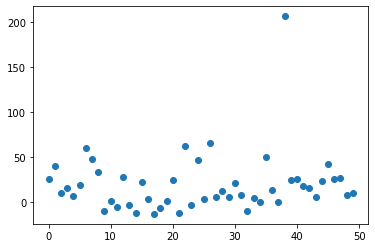

2.626227
Traced<ConcreteArray(2.626227)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.626227, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


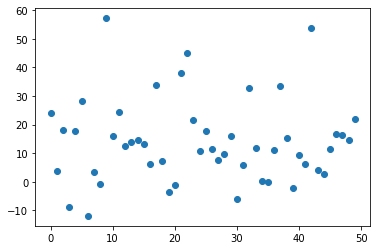

2.8421972
Traced<ConcreteArray(2.8421972)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8421972, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


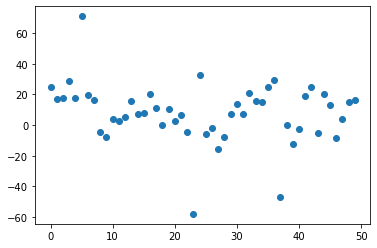

2.5596304
Traced<ConcreteArray(2.5596304)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5596304, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


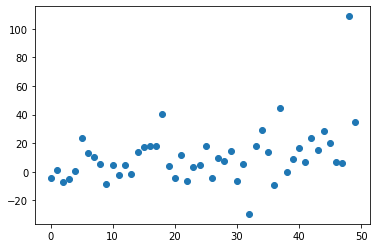

2.3427572
Traced<ConcreteArray(2.3427572)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3427572, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


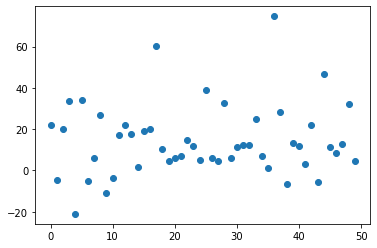

2.8035042
Traced<ConcreteArray(2.8035042)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8035042, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


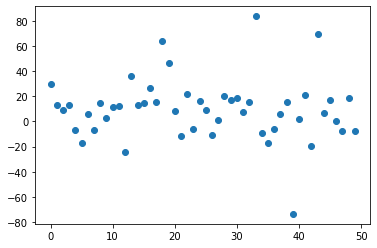

3.4716034
Traced<ConcreteArray(3.4716034)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4716034, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


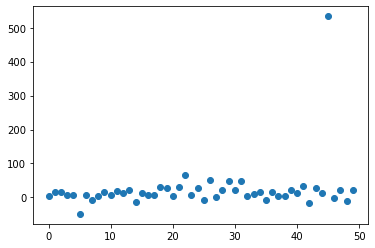

3.1357052
Traced<ConcreteArray(3.1357052)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1357052, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


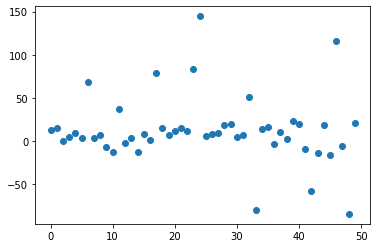

2.821513
Traced<ConcreteArray(2.821513)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.821513, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


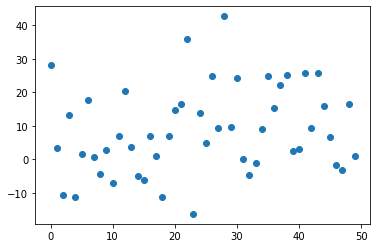

2.135917
Traced<ConcreteArray(2.135917)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.135917, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


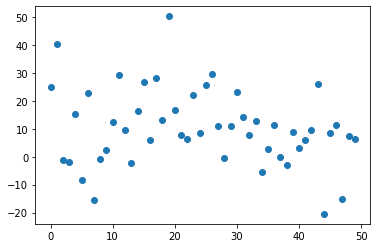

3.653934
Traced<ConcreteArray(3.653934)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.653934, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


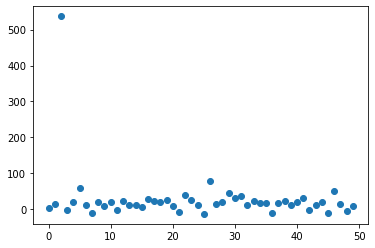

2.9944513
Traced<ConcreteArray(2.9944513)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9944513, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


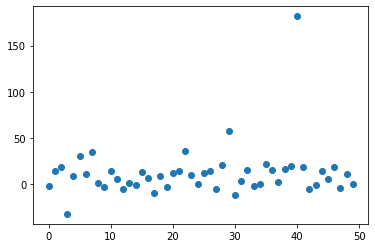

2.379449
Traced<ConcreteArray(2.379449)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.379449, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


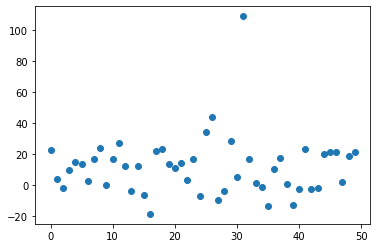

2.7695727
Traced<ConcreteArray(2.7695727)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7695727, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


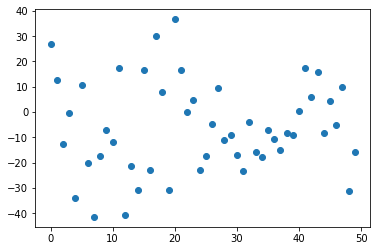

2.6511803
Traced<ConcreteArray(2.6511803)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6511803, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


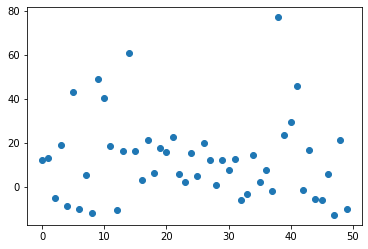

3.308326
Traced<ConcreteArray(3.308326)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.308326, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


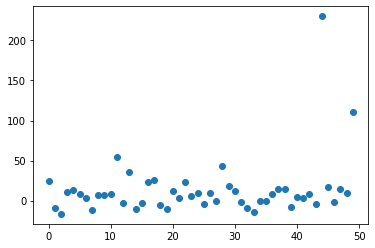

3.0667171
Traced<ConcreteArray(3.0667171)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0667171, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


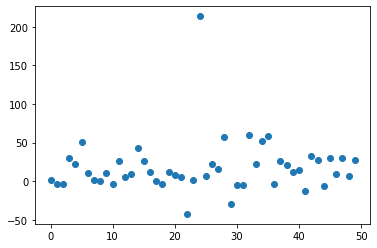

3.830454
Traced<ConcreteArray(3.830454)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.830454, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


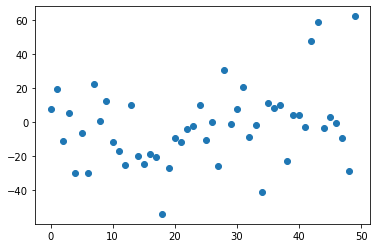

3.8480747
Traced<ConcreteArray(3.8480747)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8480747, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


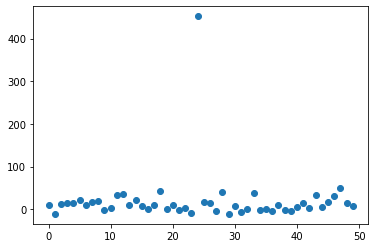

3.86403
Traced<ConcreteArray(3.86403)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.86403, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


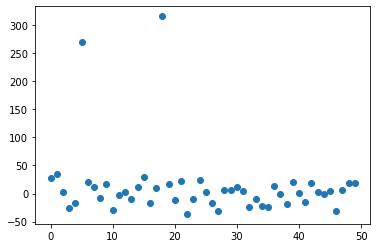

2.884439
Traced<ConcreteArray(2.884439)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.884439, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


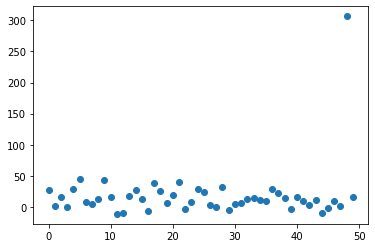

2.385689
Traced<ConcreteArray(2.385689)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.385689, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


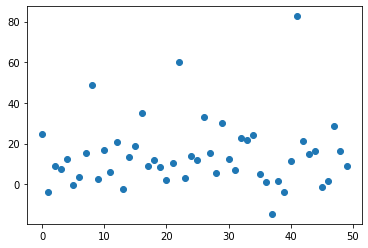

2.6312714
Traced<ConcreteArray(2.6312714)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6312714, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


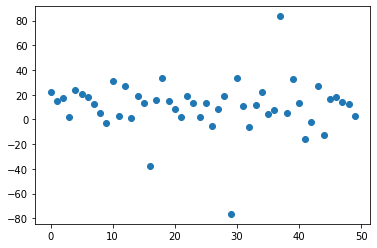

3.3405306
Traced<ConcreteArray(3.3405306)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3405306, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


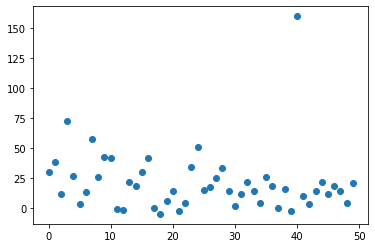

2.4824739
Traced<ConcreteArray(2.4824739)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4824739, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


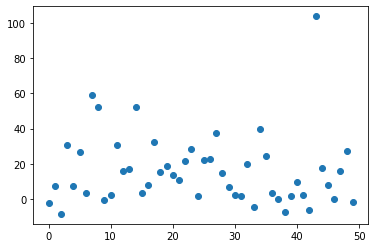

3.1808298
Traced<ConcreteArray(3.1808298)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1808298, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


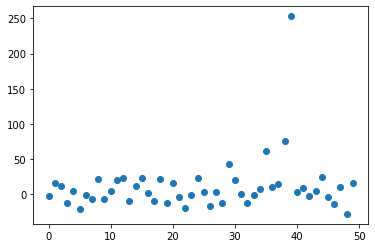

2.8607254
Traced<ConcreteArray(2.8607254)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8607254, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


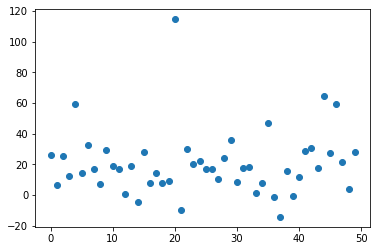

3.1005688
Traced<ConcreteArray(3.1005688)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1005688, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


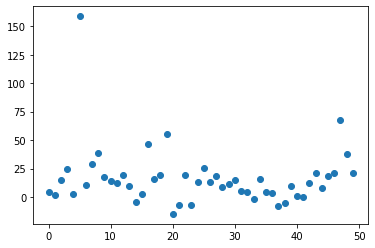

2.7584996
Traced<ConcreteArray(2.7584996)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7584996, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


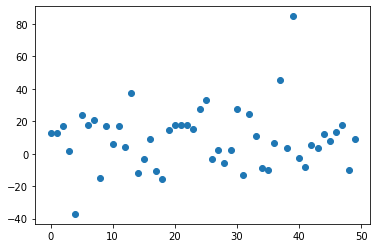

3.5553355
Traced<ConcreteArray(3.5553355)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5553355, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


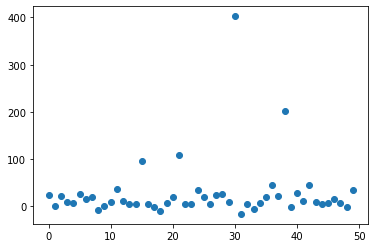

2.7458527
Traced<ConcreteArray(2.7458527)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7458527, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


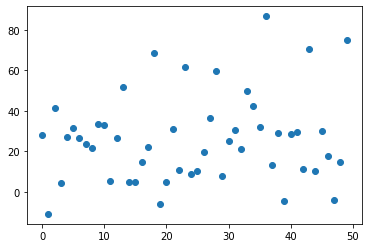

3.623142
Traced<ConcreteArray(3.623142)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.623142, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


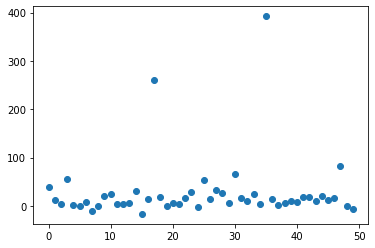

2.5677092
Traced<ConcreteArray(2.5677092)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5677092, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


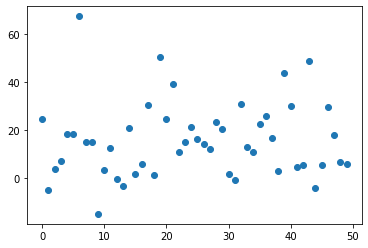

2.7025485
Traced<ConcreteArray(2.7025485)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7025485, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


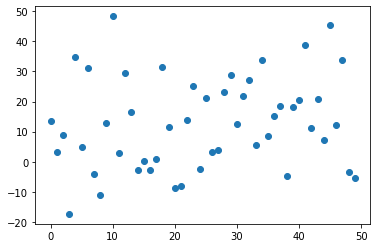

3.3763776
Traced<ConcreteArray(3.3763776)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3763776, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


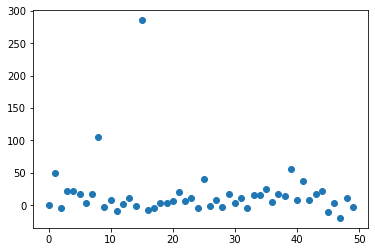

3.9308586
Traced<ConcreteArray(3.9308586)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9308586, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


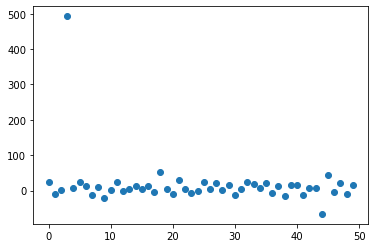

2.4043787
Traced<ConcreteArray(2.4043787)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4043787, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


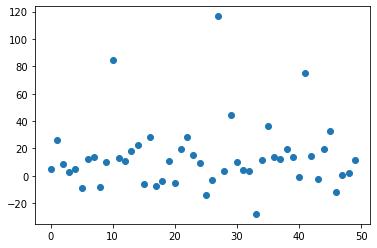

2.4650626
Traced<ConcreteArray(2.4650626)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4650626, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


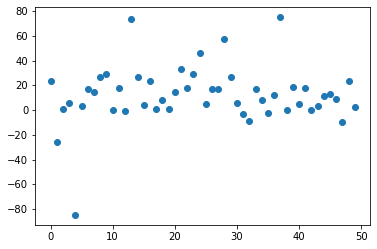

3.198614
Traced<ConcreteArray(3.198614)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.198614, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


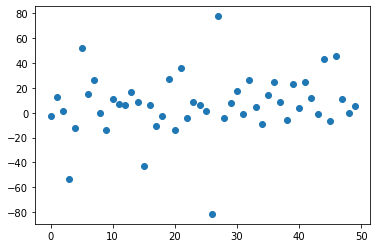

2.470809
Traced<ConcreteArray(2.470809)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.470809, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


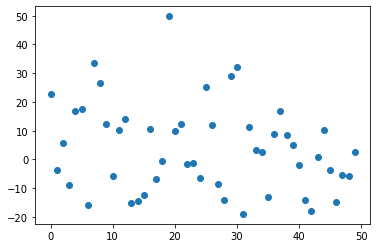

2.6233432
Traced<ConcreteArray(2.6233432)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6233432, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


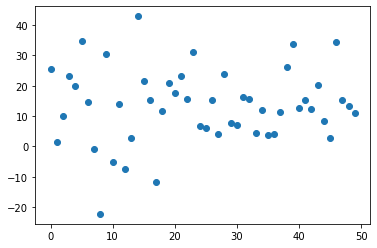

3.0403333
Traced<ConcreteArray(3.0403333)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0403333, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


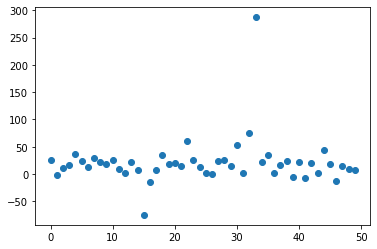

2.641449
Traced<ConcreteArray(2.641449)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.641449, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


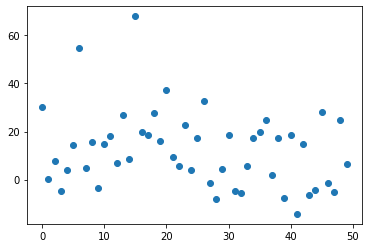

3.4724348
Traced<ConcreteArray(3.4724348)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4724348, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


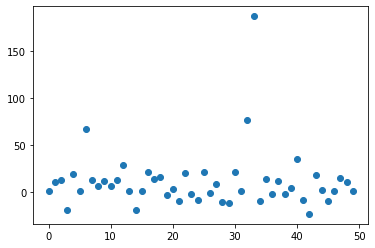

3.9446764
Traced<ConcreteArray(3.9446764)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9446764, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


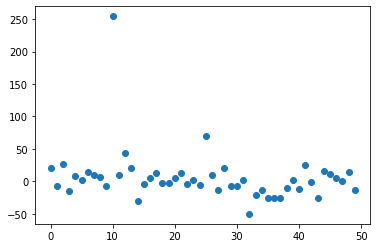

2.9932783
Traced<ConcreteArray(2.9932783)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9932783, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


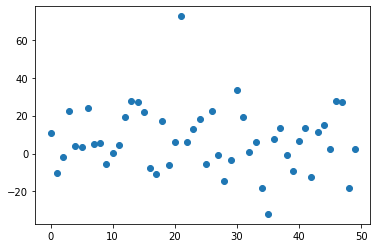

2.418056
Traced<ConcreteArray(2.418056)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.418056, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


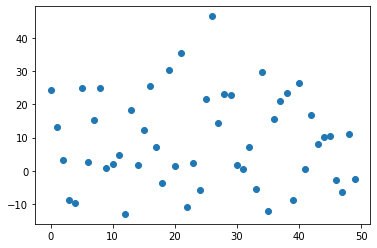

3.4978817
Traced<ConcreteArray(3.4978817)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4978817, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


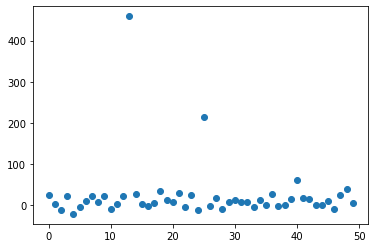

3.86218
Traced<ConcreteArray(3.86218)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.86218, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


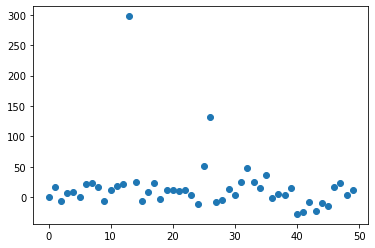

2.9709396
Traced<ConcreteArray(2.9709396)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9709396, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


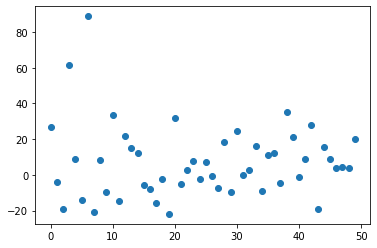

2.7168005
Traced<ConcreteArray(2.7168005)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7168005, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


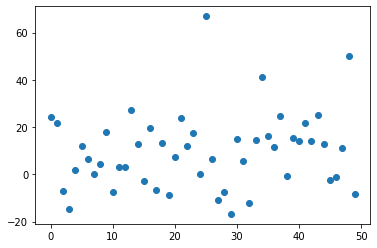

2.7161689
Traced<ConcreteArray(2.7161689)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7161689, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


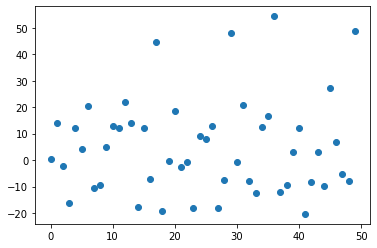

2.7181087
Traced<ConcreteArray(2.7181087)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7181087, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


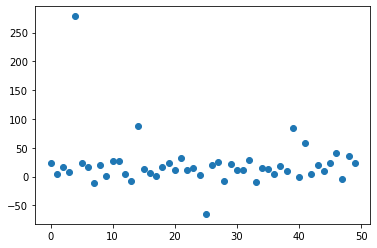

2.879982
Traced<ConcreteArray(2.879982)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.879982, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


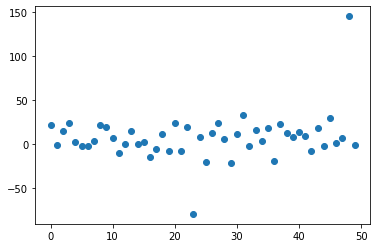

4.942468
Traced<ConcreteArray(4.942468)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.942468, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


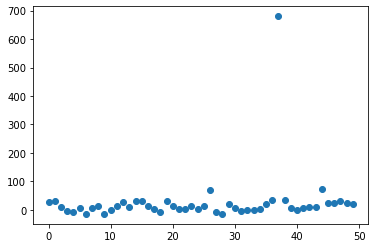

2.5161345
Traced<ConcreteArray(2.5161345)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5161345, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


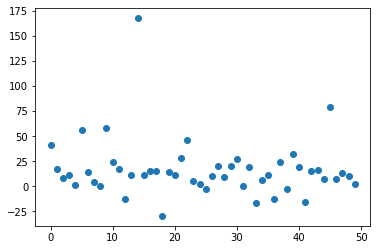

3.1406105
Traced<ConcreteArray(3.1406105)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1406105, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


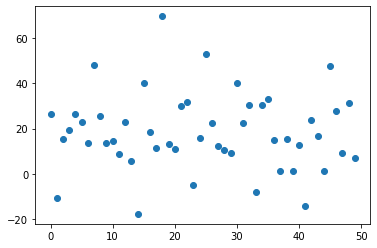

3.087829
Traced<ConcreteArray(3.087829)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.087829, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


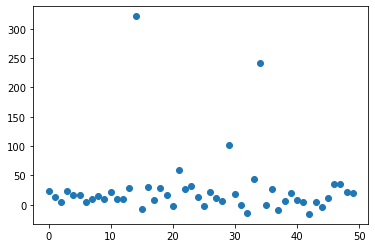

4.13826
Traced<ConcreteArray(4.13826)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.13826, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


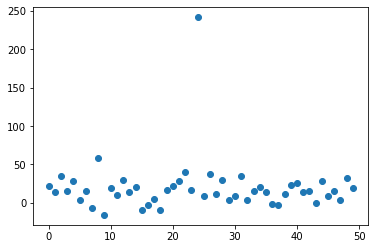

2.613038
Traced<ConcreteArray(2.613038)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.613038, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


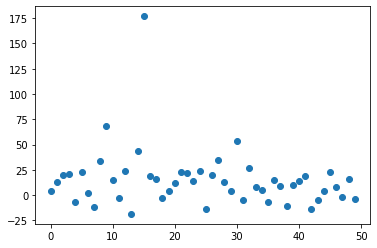

3.5901895
Traced<ConcreteArray(3.5901895)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5901895, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


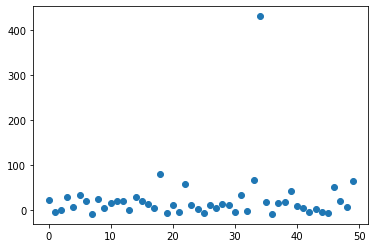

2.3729978
Traced<ConcreteArray(2.3729978)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3729978, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


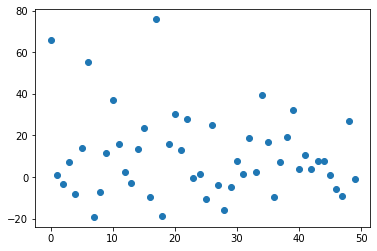

4.0466237
Traced<ConcreteArray(4.0466237)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.0466237, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


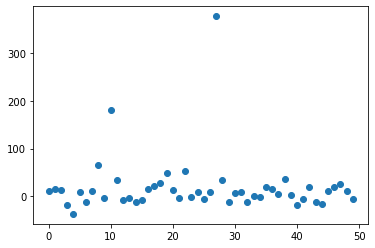

2.6279514
Traced<ConcreteArray(2.6279514)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6279514, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


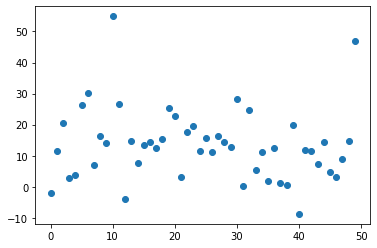

2.7042768
Traced<ConcreteArray(2.7042768)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7042768, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


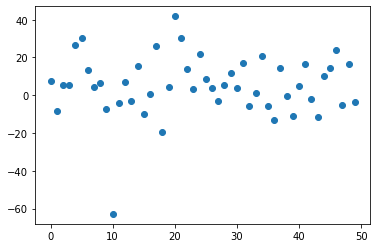

4.115837
Traced<ConcreteArray(4.115837)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.115837, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


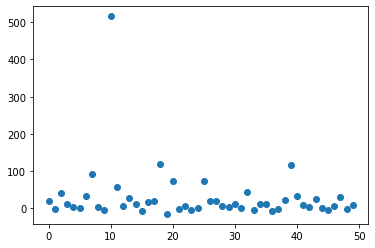

2.6765053
Traced<ConcreteArray(2.6765053)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6765053, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


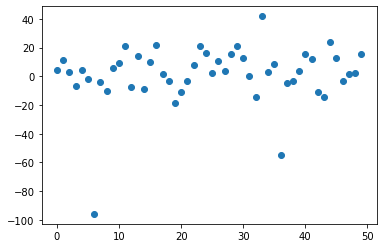

2.5436103
Traced<ConcreteArray(2.5436103)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5436103, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


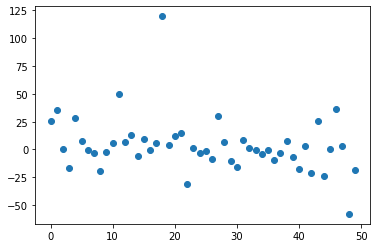

2.674704
Traced<ConcreteArray(2.674704)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.674704, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


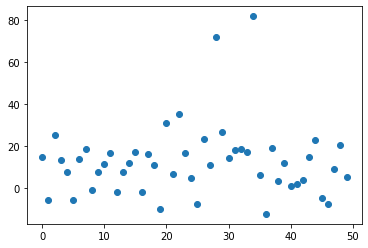

2.2940416
Traced<ConcreteArray(2.2940416)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2940416, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


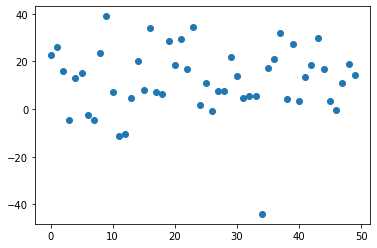

3.0407357
Traced<ConcreteArray(3.0407357)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0407357, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


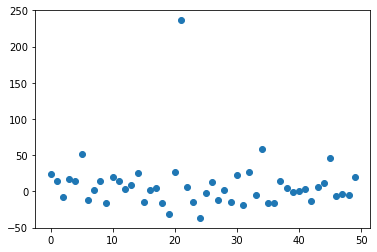

2.560333
Traced<ConcreteArray(2.560333)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.560333, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


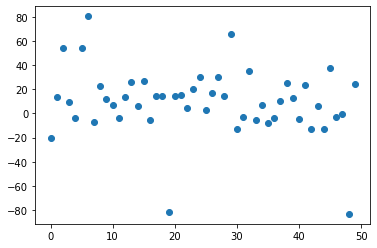

3.58891
Traced<ConcreteArray(3.58891)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.58891, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


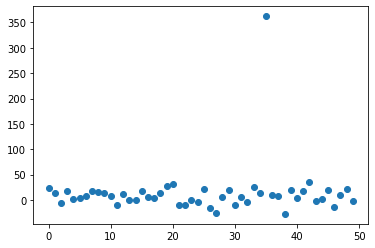

2.8896906
Traced<ConcreteArray(2.8896906)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8896906, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


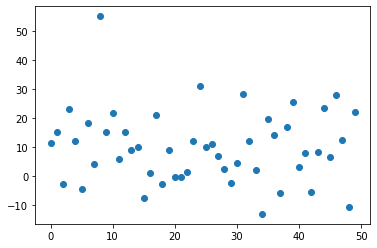

4.210477
Traced<ConcreteArray(4.210477)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.210477, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


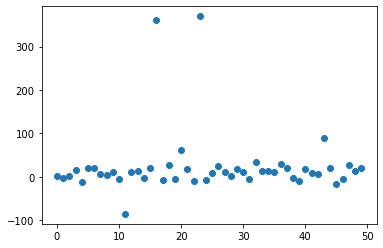

3.178198
Traced<ConcreteArray(3.178198)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.178198, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


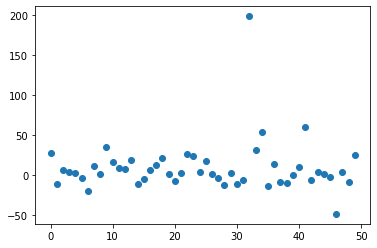

3.0066972
Traced<ConcreteArray(3.0066972)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0066972, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


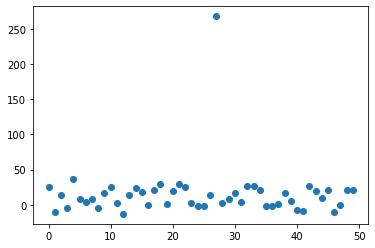

2.8705454
Traced<ConcreteArray(2.8705454)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8705454, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


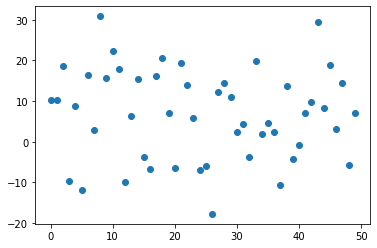

2.2999182
Traced<ConcreteArray(2.2999182)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2999182, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


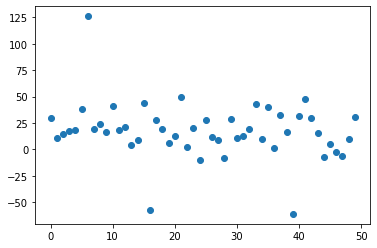

2.633611
Traced<ConcreteArray(2.633611)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.633611, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


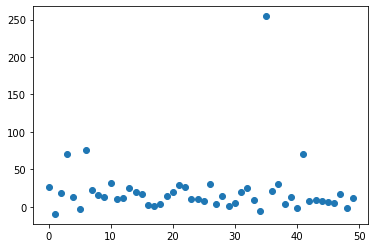

2.9738154
Traced<ConcreteArray(2.9738154)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9738154, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


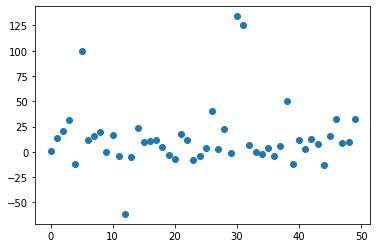

2.561108
Traced<ConcreteArray(2.561108)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.561108, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


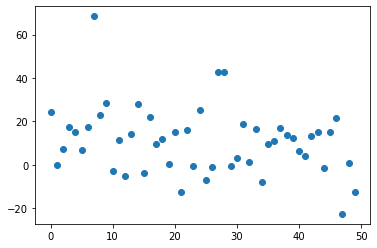

2.4943376
Traced<ConcreteArray(2.4943376)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4943376, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


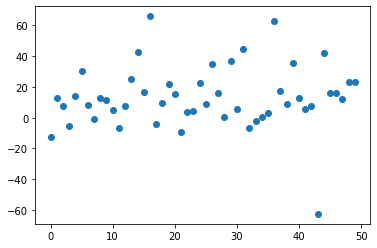

3.3640444
Traced<ConcreteArray(3.3640444)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3640444, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


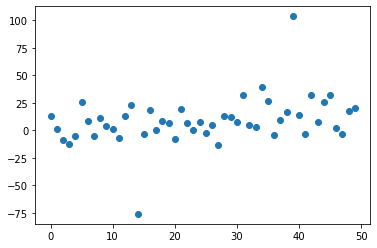

3.2365308
Traced<ConcreteArray(3.2365308)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2365308, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


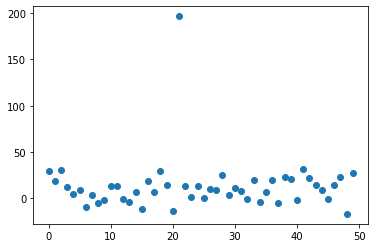

2.638627
Traced<ConcreteArray(2.638627)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.638627, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


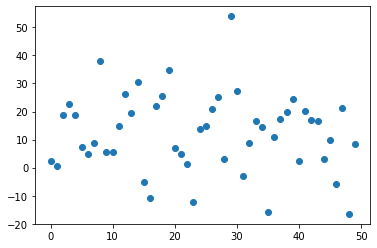

3.0447595
Traced<ConcreteArray(3.0447595)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0447595, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


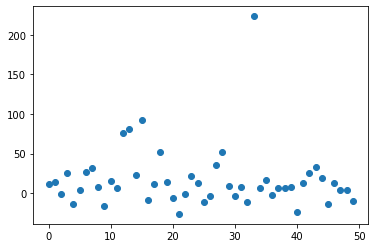

3.3230739
Traced<ConcreteArray(3.3230739)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3230739, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


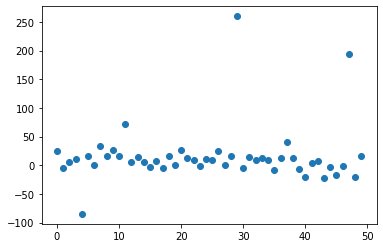

2.4601886
Traced<ConcreteArray(2.4601886)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4601886, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


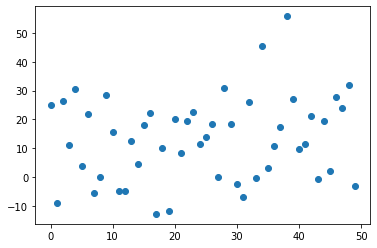

2.7101433
Traced<ConcreteArray(2.7101433)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7101433, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


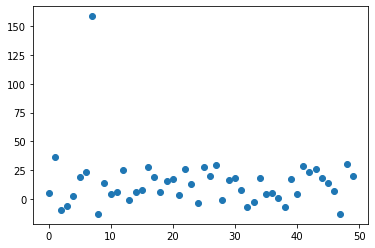

3.976283
Traced<ConcreteArray(3.976283)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.976283, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


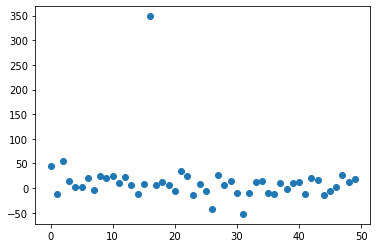

3.0383108
Traced<ConcreteArray(3.0383108)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0383108, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


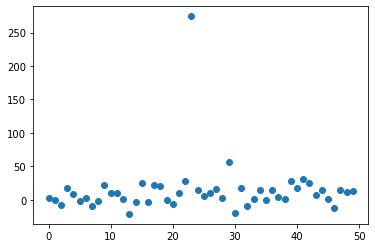

2.6386359
Traced<ConcreteArray(2.6386359)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6386359, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


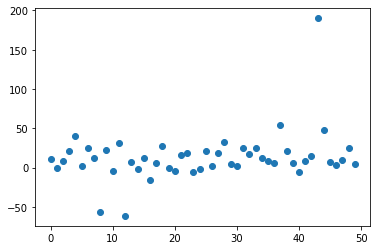

2.6035116
Traced<ConcreteArray(2.6035116)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6035116, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


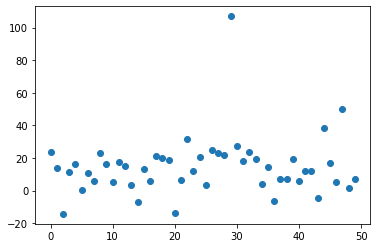

2.7730083
Traced<ConcreteArray(2.7730083)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7730083, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


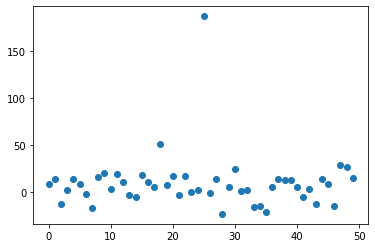

2.4266658
Traced<ConcreteArray(2.4266658)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4266658, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


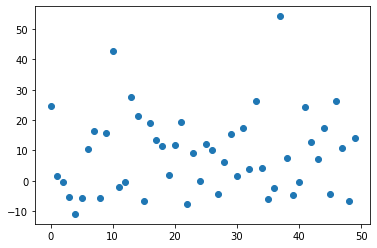

4.9380803
Traced<ConcreteArray(4.9380803)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.9380803, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


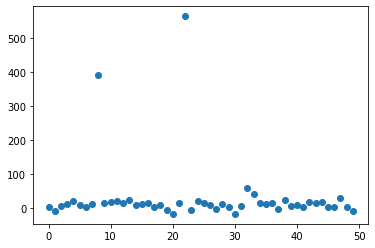

2.7830095
Traced<ConcreteArray(2.7830095)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7830095, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


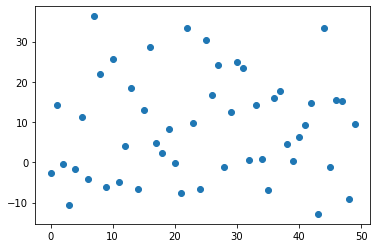

2.5989542
Traced<ConcreteArray(2.5989542)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5989542, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


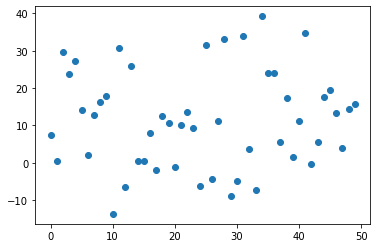

2.8385096
Traced<ConcreteArray(2.8385096)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8385096, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


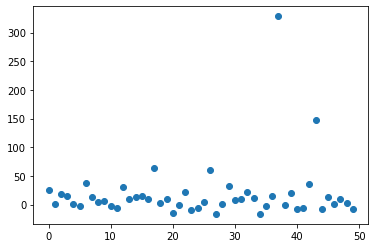

2.5302944
Traced<ConcreteArray(2.5302944)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5302944, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


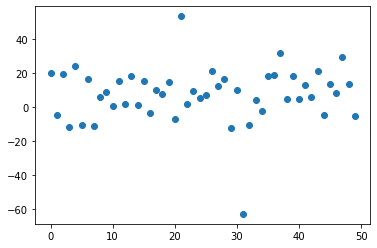

3.8274987
Traced<ConcreteArray(3.8274987)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8274987, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


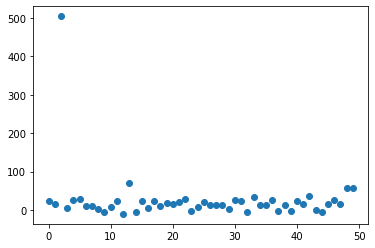

4.066014
Traced<ConcreteArray(4.066014)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.066014, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


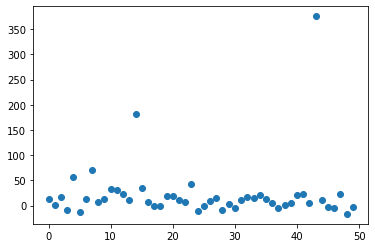

2.967269
Traced<ConcreteArray(2.967269)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.967269, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


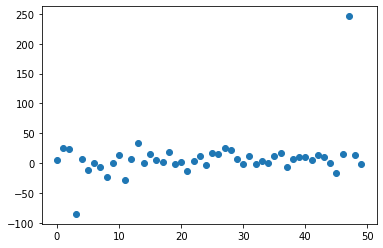

2.5030909
Traced<ConcreteArray(2.5030909)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5030909, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


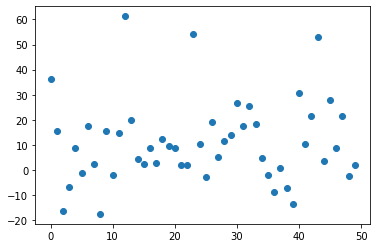

3.580129
Traced<ConcreteArray(3.580129)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.580129, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


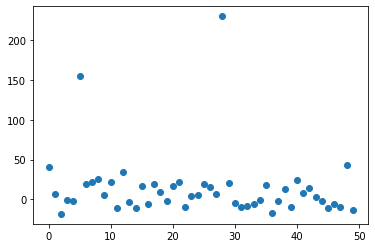

2.6183267
Traced<ConcreteArray(2.6183267)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6183267, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


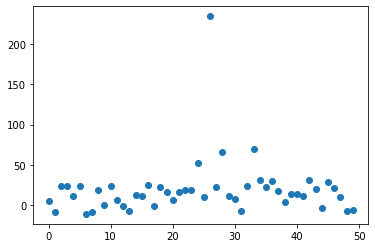

2.5141263
Traced<ConcreteArray(2.5141263)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5141263, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


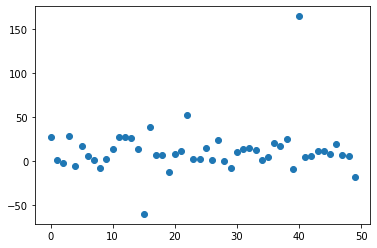

2.1822937
Traced<ConcreteArray(2.1822937)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1822937, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


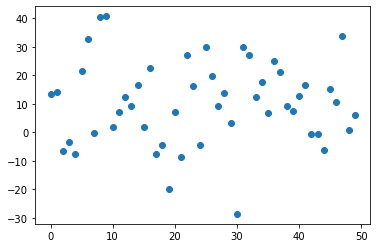

2.6325467
Traced<ConcreteArray(2.6325467)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6325467, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


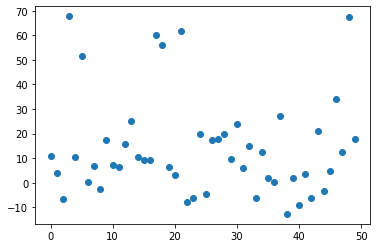

2.8003316
Traced<ConcreteArray(2.8003316)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8003316, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


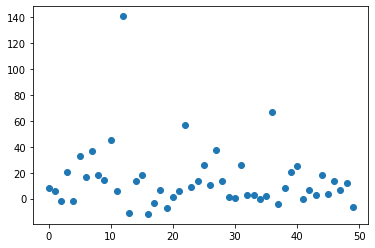

2.4564905
Traced<ConcreteArray(2.4564905)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4564905, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


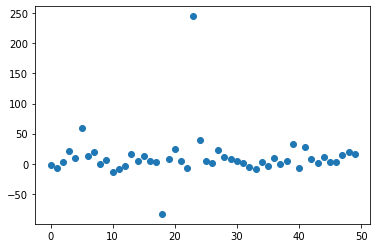

2.4310267
Traced<ConcreteArray(2.4310267)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4310267, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


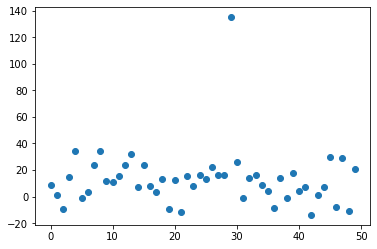

2.3438878
Traced<ConcreteArray(2.3438878)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3438878, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


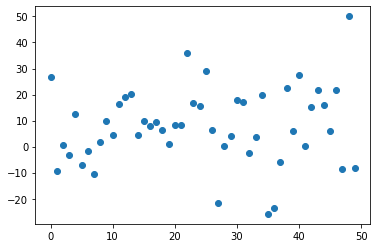

2.6012268
Traced<ConcreteArray(2.6012268)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6012268, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


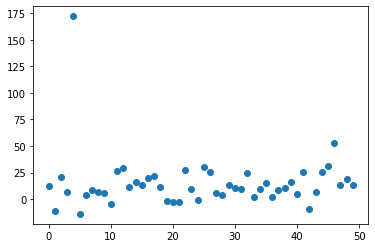

2.4227512
Traced<ConcreteArray(2.4227512)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4227512, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


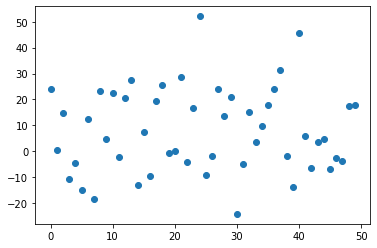

2.728181
Traced<ConcreteArray(2.728181)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.728181, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


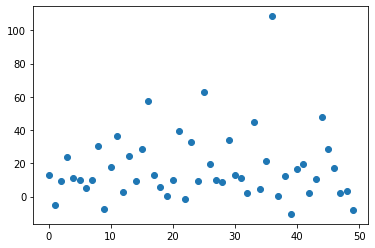

2.7073727
Traced<ConcreteArray(2.7073727)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7073727, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


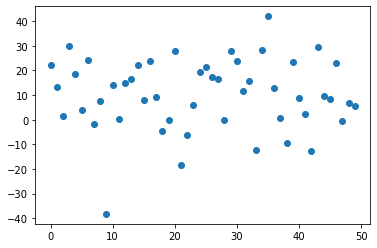

2.2484193
Traced<ConcreteArray(2.2484193)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2484193, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


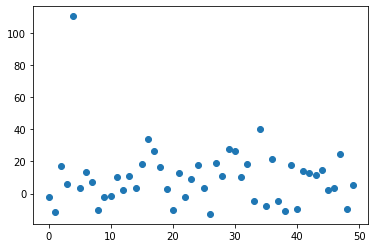

2.2720742
Traced<ConcreteArray(2.2720742)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2720742, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


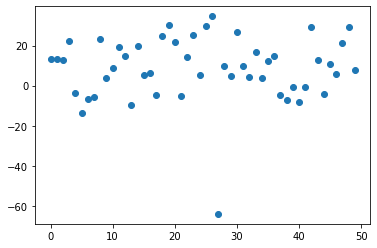

2.7211294
Traced<ConcreteArray(2.7211294)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7211294, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


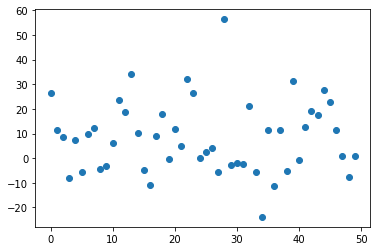

3.826816
Traced<ConcreteArray(3.826816)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.826816, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


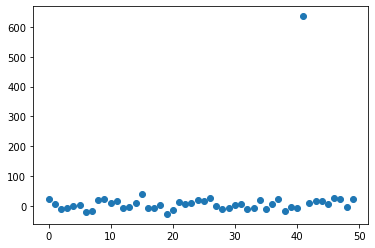

2.7523496
Traced<ConcreteArray(2.7523496)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7523496, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


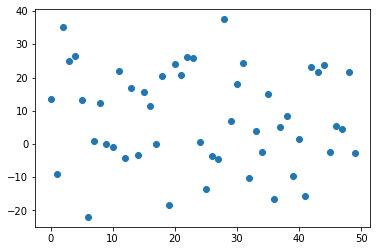

2.8728333
Traced<ConcreteArray(2.8728333)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8728333, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


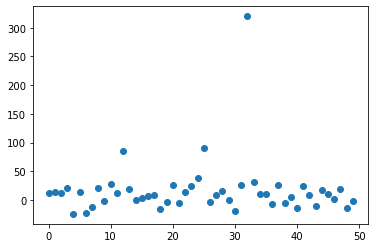

2.495661
Traced<ConcreteArray(2.495661)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.495661, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


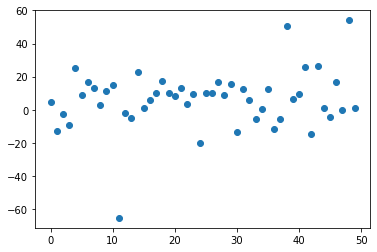

3.0350356
Traced<ConcreteArray(3.0350356)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0350356, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


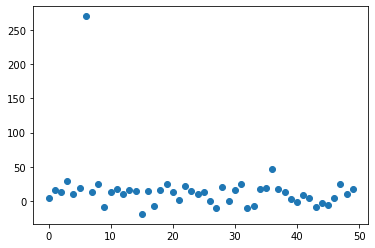

2.7590687
Traced<ConcreteArray(2.7590687)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7590687, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


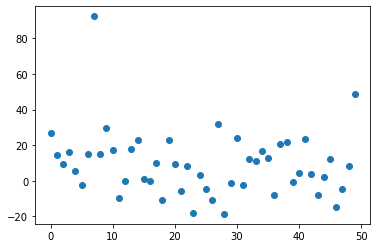

2.8259294
Traced<ConcreteArray(2.8259294)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8259294, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


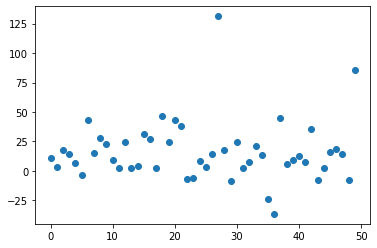

2.8073635
Traced<ConcreteArray(2.8073635)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8073635, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


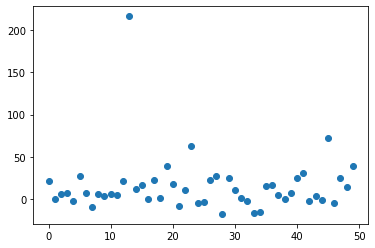

2.8028727
Traced<ConcreteArray(2.8028727)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8028727, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


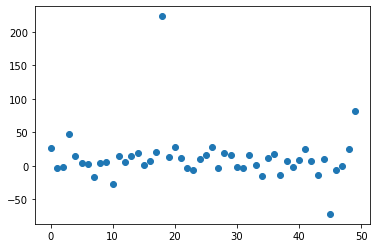

2.6453342
Traced<ConcreteArray(2.6453342)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6453342, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


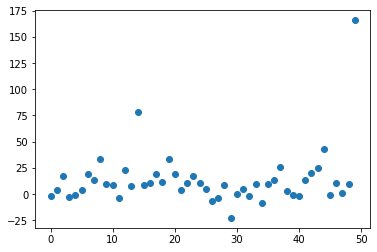

3.5599992
Traced<ConcreteArray(3.5599992)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5599992, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


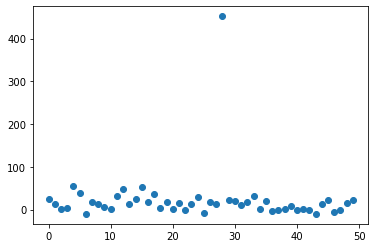

2.7524328
Traced<ConcreteArray(2.7524328)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7524328, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


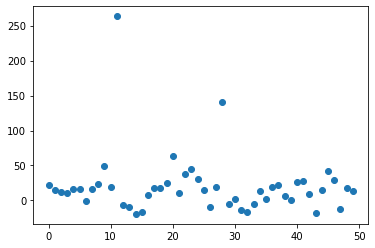

2.4104288
Traced<ConcreteArray(2.4104288)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4104288, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


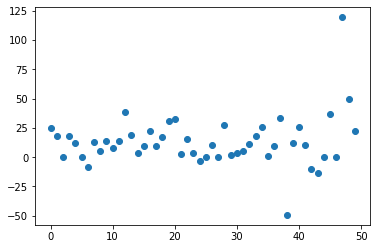

3.2262807
Traced<ConcreteArray(3.2262807)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2262807, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


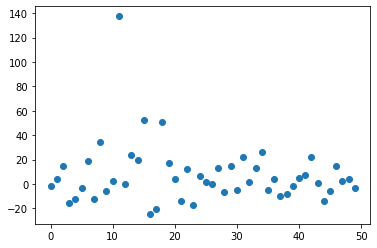

2.8444638
Traced<ConcreteArray(2.8444638)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8444638, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


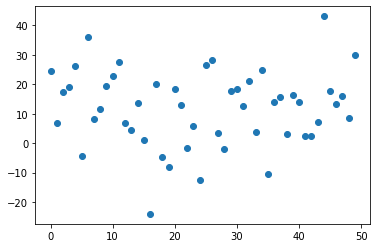

4.1756372
Traced<ConcreteArray(4.1756372)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.1756372, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


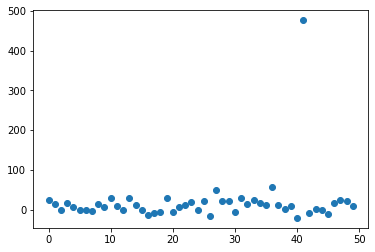

2.984028
Traced<ConcreteArray(2.984028)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.984028, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


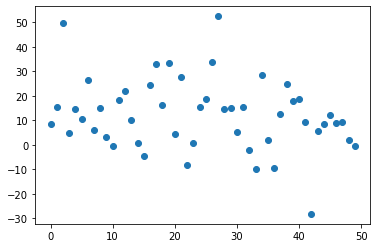

2.1293344
Traced<ConcreteArray(2.1293344)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1293344, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


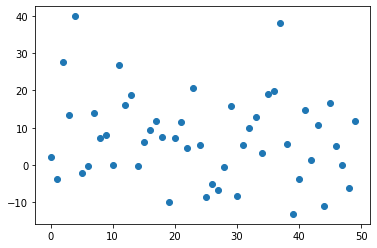

3.1785126
Traced<ConcreteArray(3.1785126)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1785126, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


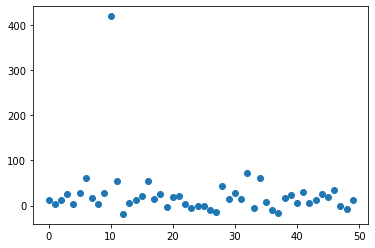

4.823808
Traced<ConcreteArray(4.823808)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.823808, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


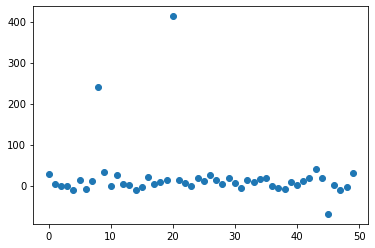

2.7105255
Traced<ConcreteArray(2.7105255)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7105255, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


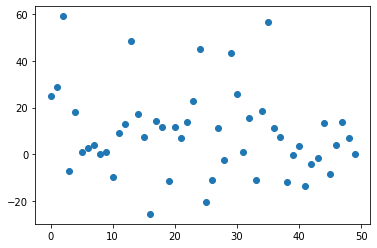

2.5887372
Traced<ConcreteArray(2.5887372)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5887372, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


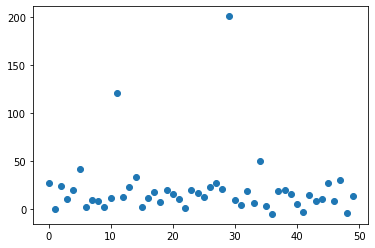

2.2528903
Traced<ConcreteArray(2.2528903)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2528903, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


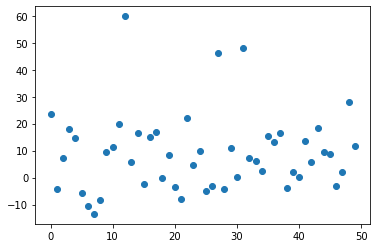

3.3445961
Traced<ConcreteArray(3.3445961)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3445961, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


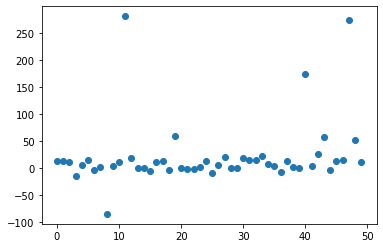

2.3439317
Traced<ConcreteArray(2.3439317)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3439317, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


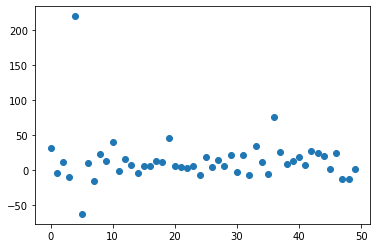

3.1060376
Traced<ConcreteArray(3.1060376)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1060376, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


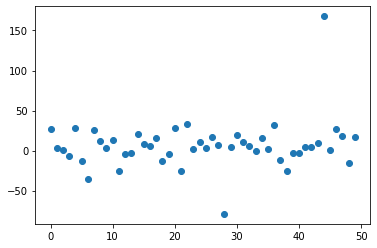

2.5328193
Traced<ConcreteArray(2.5328193)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5328193, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


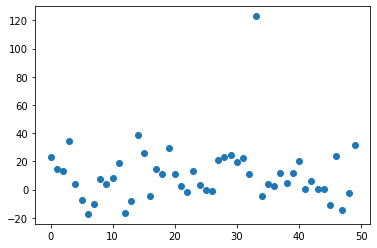

4.9743214
Traced<ConcreteArray(4.9743214)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.9743214, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


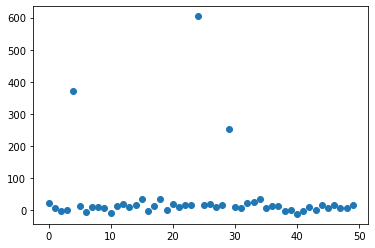

2.6914616
Traced<ConcreteArray(2.6914616)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6914616, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


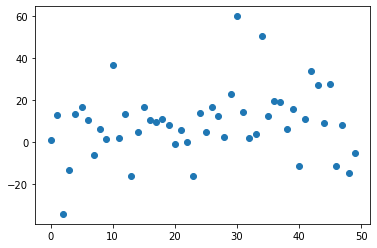

2.6387455
Traced<ConcreteArray(2.6387455)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6387455, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


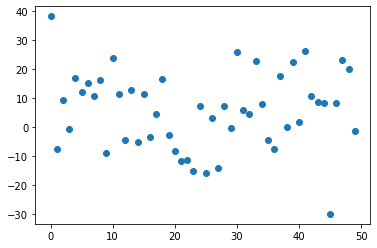

2.6232998
Traced<ConcreteArray(2.6232998)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6232998, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


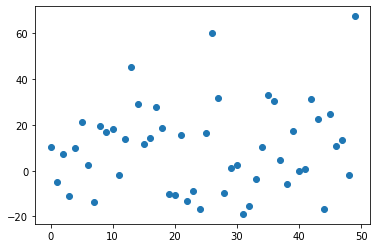

3.314647
Traced<ConcreteArray(3.314647)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.314647, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


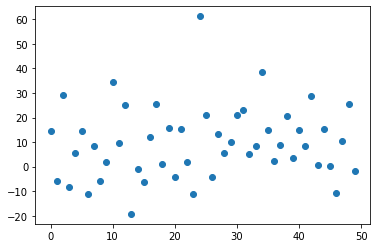

2.5813997
Traced<ConcreteArray(2.5813997)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5813997, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


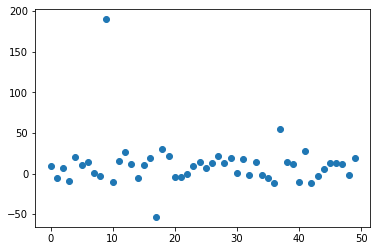

2.4509604
Traced<ConcreteArray(2.4509604)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4509604, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


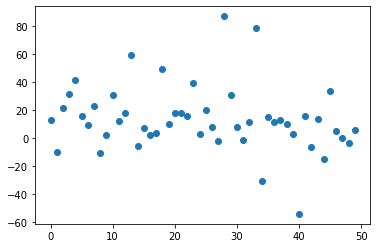

2.666934
Traced<ConcreteArray(2.666934)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.666934, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


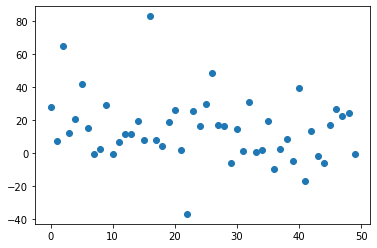

4.395454
Traced<ConcreteArray(4.395454)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.395454, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


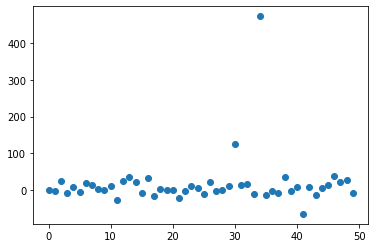

2.7814229
Traced<ConcreteArray(2.7814229)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7814229, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


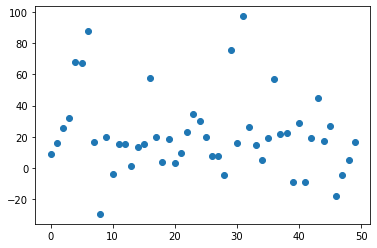

2.6645918
Traced<ConcreteArray(2.6645918)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6645918, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


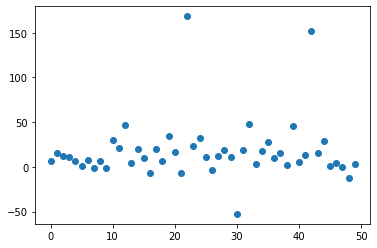

2.9245205
Traced<ConcreteArray(2.9245205)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9245205, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


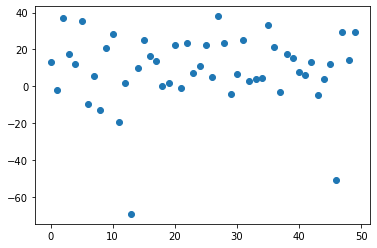

3.315839
Traced<ConcreteArray(3.315839)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.315839, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


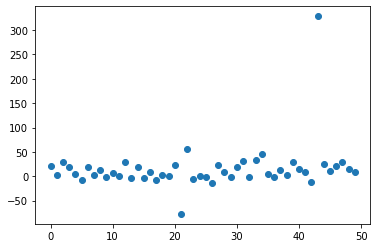

2.894275
Traced<ConcreteArray(2.894275)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.894275, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


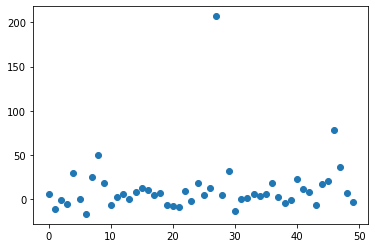

2.2404714
Traced<ConcreteArray(2.2404714)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2404714, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


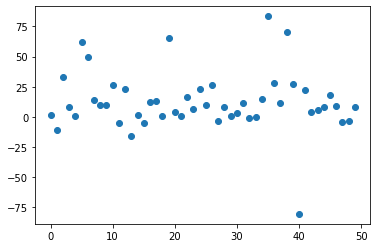

3.6882465
Traced<ConcreteArray(3.6882465)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6882465, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


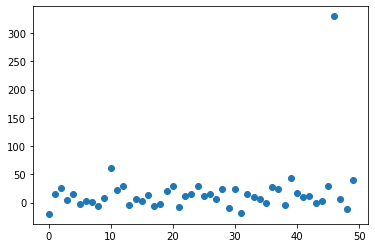

3.8773434
Traced<ConcreteArray(3.8773434)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8773434, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


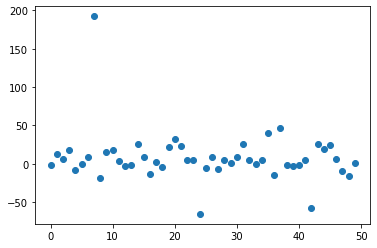

2.4088488
Traced<ConcreteArray(2.4088488)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4088488, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


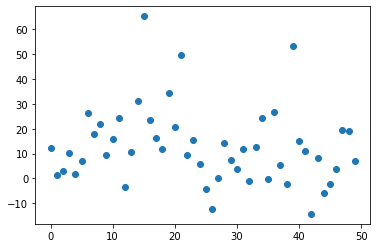

2.6468475
Traced<ConcreteArray(2.6468475)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6468475, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


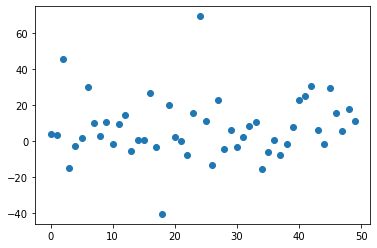

2.2258518
Traced<ConcreteArray(2.2258518)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2258518, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


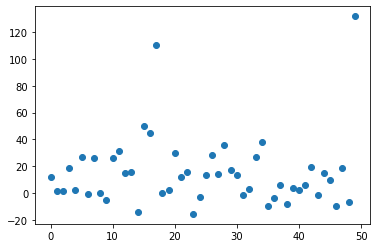

2.7294002
Traced<ConcreteArray(2.7294002)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7294002, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


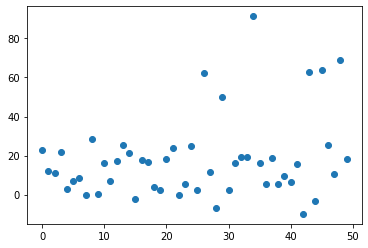

2.8598423
Traced<ConcreteArray(2.8598423)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8598423, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


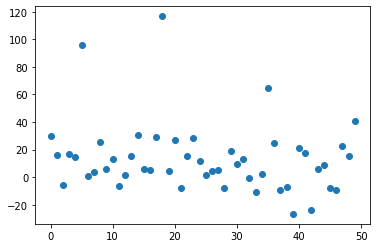

3.0386567
Traced<ConcreteArray(3.0386567)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0386567, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


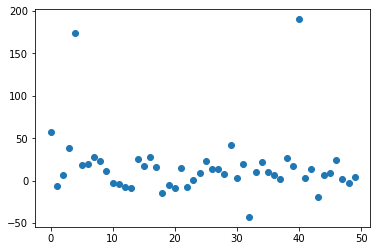

2.3937082
Traced<ConcreteArray(2.3937082)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3937082, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


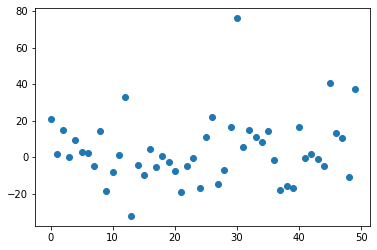

2.4094946
Traced<ConcreteArray(2.4094946)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4094946, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


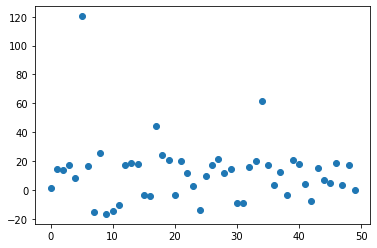

2.4461763
Traced<ConcreteArray(2.4461763)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4461763, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


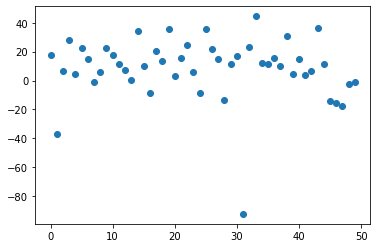

2.6429784
Traced<ConcreteArray(2.6429784)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6429784, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


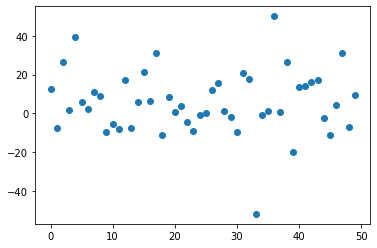

3.1452327
Traced<ConcreteArray(3.1452327)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1452327, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


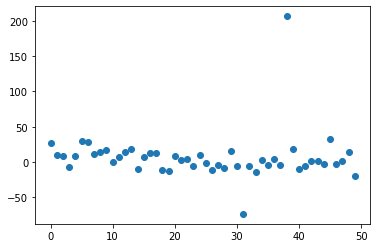

2.682235
Traced<ConcreteArray(2.682235)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.682235, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


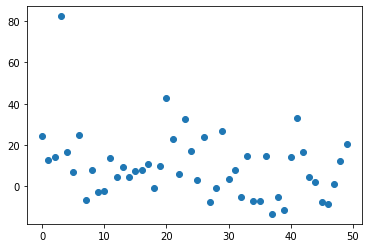

2.7328076
Traced<ConcreteArray(2.7328076)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7328076, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


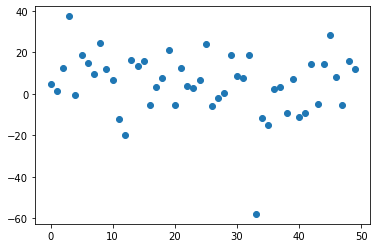

3.9641585
Traced<ConcreteArray(3.9641585)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9641585, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


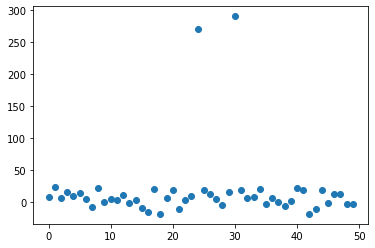

4.440925
Traced<ConcreteArray(4.440925)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.440925, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


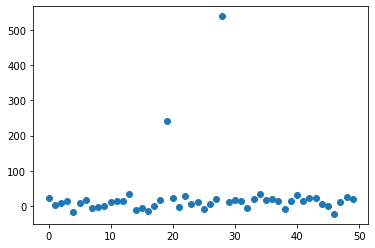

4.3933473
Traced<ConcreteArray(4.3933473)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.3933473, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


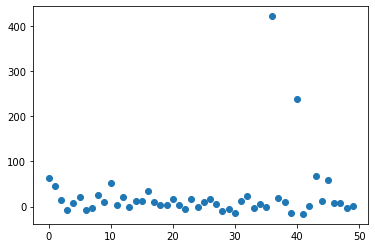

3.0648756
Traced<ConcreteArray(3.0648756)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0648756, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


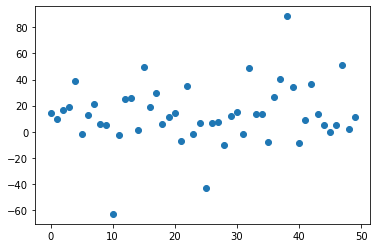

4.5247912
Traced<ConcreteArray(4.5247912)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.5247912, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


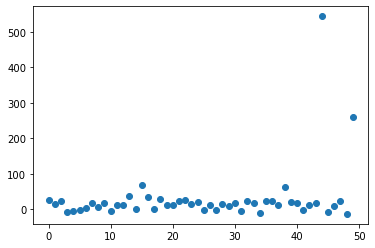

2.8364503
Traced<ConcreteArray(2.8364503)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8364503, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


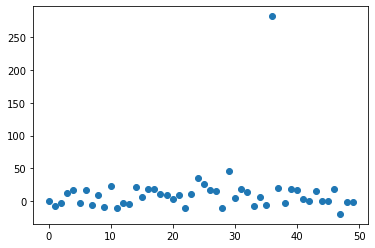

2.927341
Traced<ConcreteArray(2.927341)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.927341, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


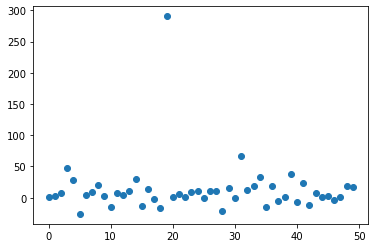

2.6388316
Traced<ConcreteArray(2.6388316)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6388316, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


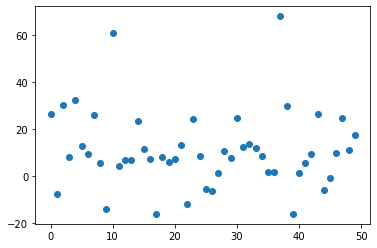

3.1529365
Traced<ConcreteArray(3.1529365)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1529365, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


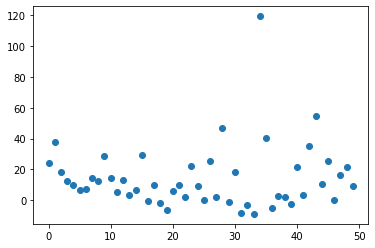

3.3483267
Traced<ConcreteArray(3.3483267)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3483267, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


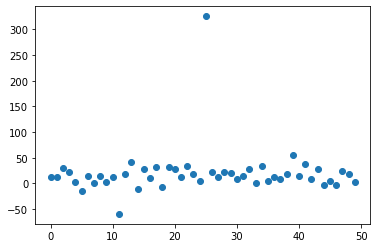

3.3998075
Traced<ConcreteArray(3.3998075)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3998075, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


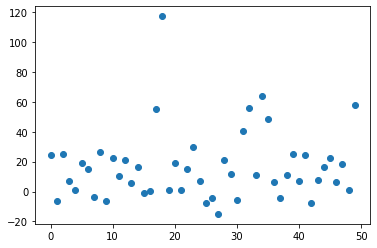

2.6162786
Traced<ConcreteArray(2.6162786)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6162786, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


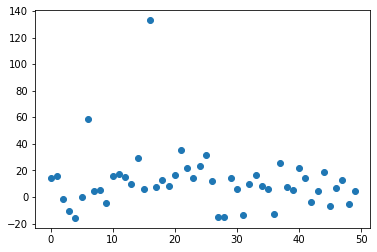

2.9447536
Traced<ConcreteArray(2.9447536)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9447536, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


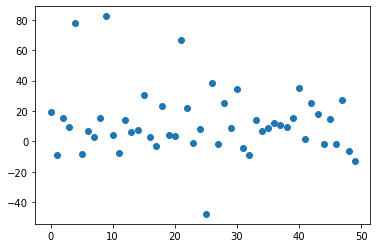

2.5861564
Traced<ConcreteArray(2.5861564)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5861564, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


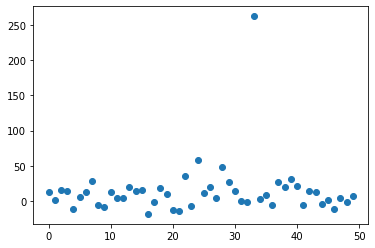

2.785952
Traced<ConcreteArray(2.785952)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.785952, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


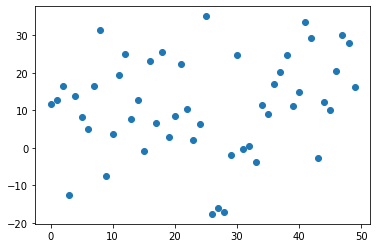

2.4504366
Traced<ConcreteArray(2.4504366)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4504366, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


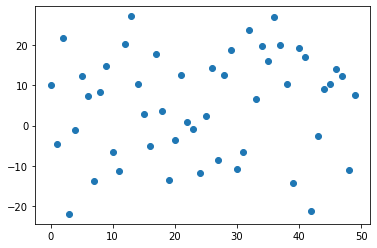

2.4551268
Traced<ConcreteArray(2.4551268)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4551268, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


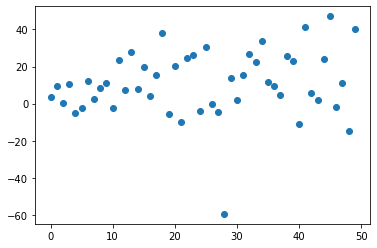

4.951678
Traced<ConcreteArray(4.951678)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.951678, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


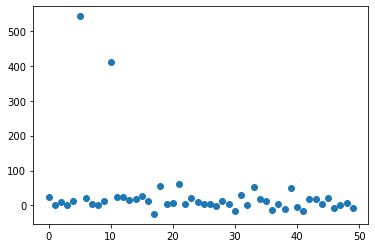

3.04462
Traced<ConcreteArray(3.04462)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.04462, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


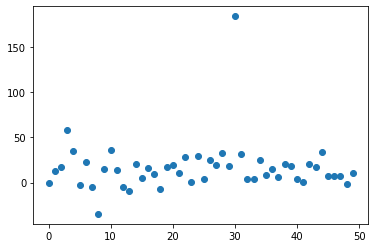

3.065249
Traced<ConcreteArray(3.065249)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.065249, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


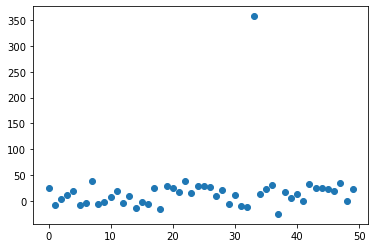

3.3608341
Traced<ConcreteArray(3.3608341)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3608341, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


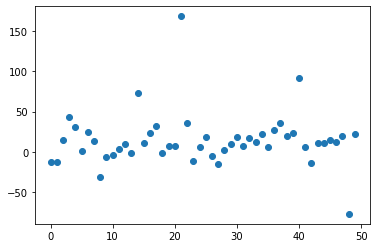

4.2869315
Traced<ConcreteArray(4.2869315)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.2869315, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


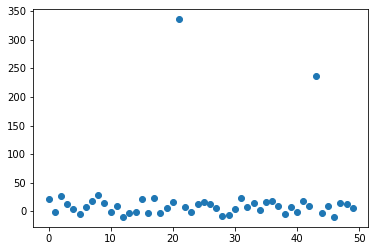

3.106649
Traced<ConcreteArray(3.106649)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.106649, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


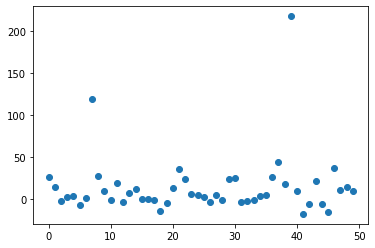

3.356673
Traced<ConcreteArray(3.356673)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.356673, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


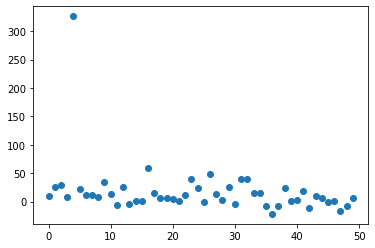

3.179914
Traced<ConcreteArray(3.179914)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.179914, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


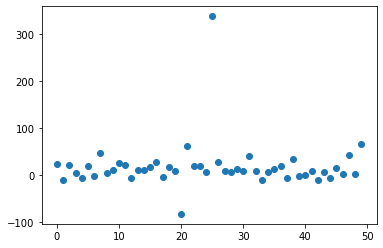

2.6337848
Traced<ConcreteArray(2.6337848)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6337848, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


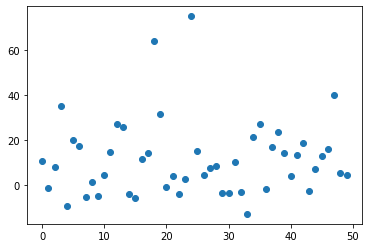

2.5777023
Traced<ConcreteArray(2.5777023)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5777023, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


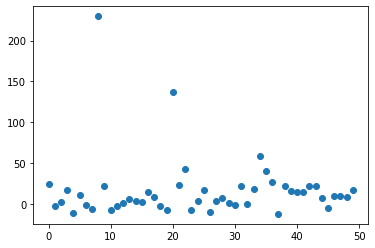

2.41653
Traced<ConcreteArray(2.41653)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.41653, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


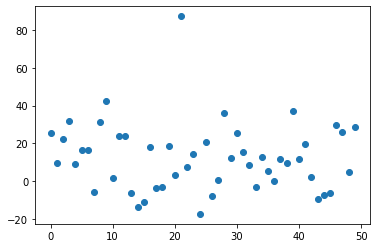

3.335869
Traced<ConcreteArray(3.335869)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.335869, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


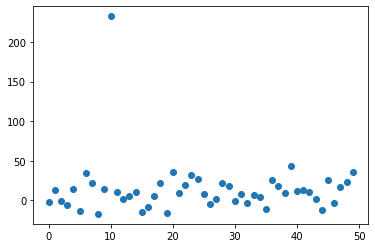

3.554635
Traced<ConcreteArray(3.554635)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.554635, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


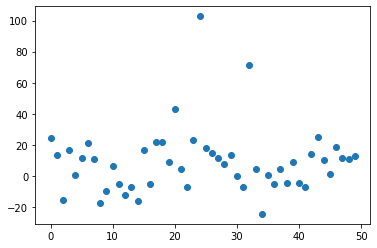

2.7483501
Traced<ConcreteArray(2.7483501)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7483501, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


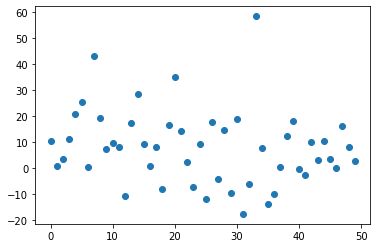

2.7250137
Traced<ConcreteArray(2.7250137)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7250137, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


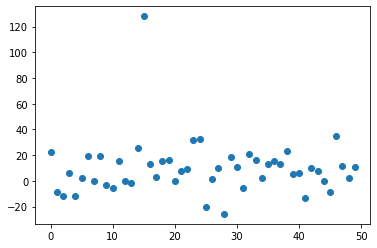

2.4724624
Traced<ConcreteArray(2.4724624)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4724624, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


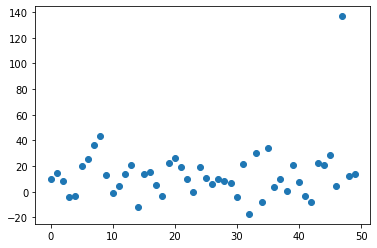

3.0320172
Traced<ConcreteArray(3.0320172)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0320172, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


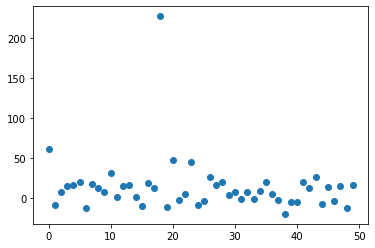

2.7163718
Traced<ConcreteArray(2.7163718)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7163718, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


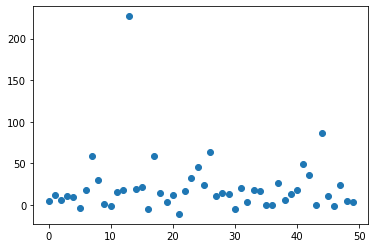

3.518577
Traced<ConcreteArray(3.518577)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.518577, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


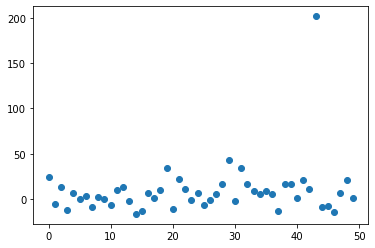

2.893449
Traced<ConcreteArray(2.893449)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.893449, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


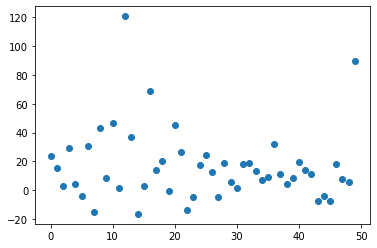

2.6709328
Traced<ConcreteArray(2.6709328)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6709328, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


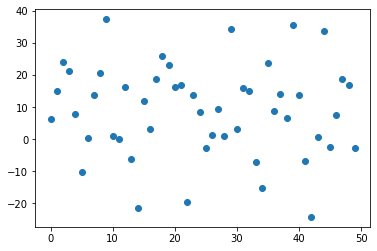

2.4956458
Traced<ConcreteArray(2.4956458)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4956458, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


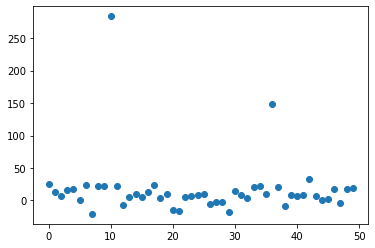

3.208653
Traced<ConcreteArray(3.208653)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.208653, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


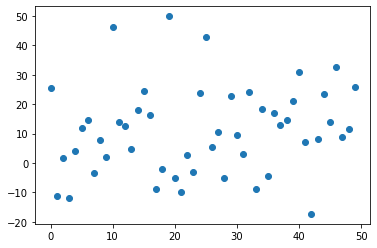

2.4120688
Traced<ConcreteArray(2.4120688)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4120688, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


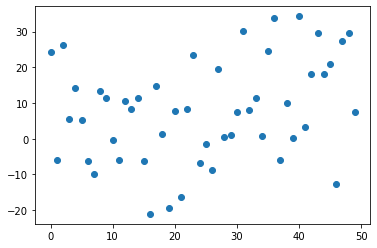

3.5419848
Traced<ConcreteArray(3.5419848)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5419848, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


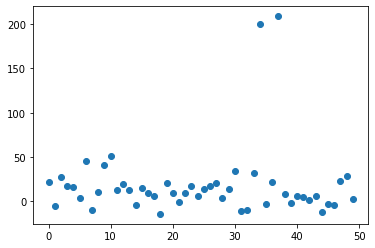

2.439223
Traced<ConcreteArray(2.439223)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.439223, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


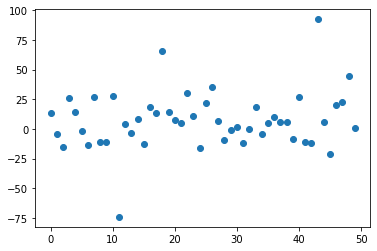

2.989227
Traced<ConcreteArray(2.989227)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.989227, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


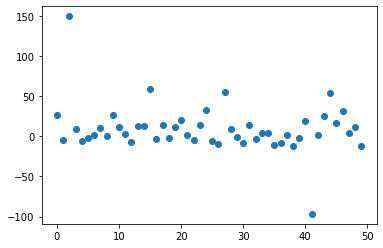

2.6920898
Traced<ConcreteArray(2.6920898)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6920898, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


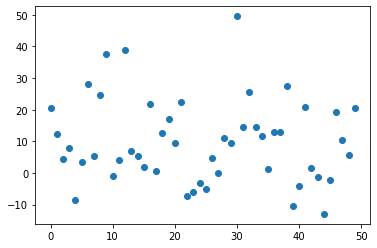

2.4169743
Traced<ConcreteArray(2.4169743)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4169743, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


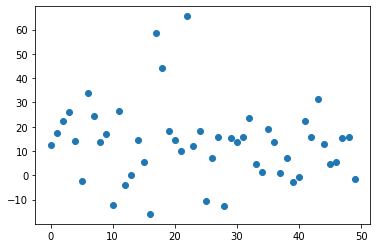

2.642364
Traced<ConcreteArray(2.642364)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.642364, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


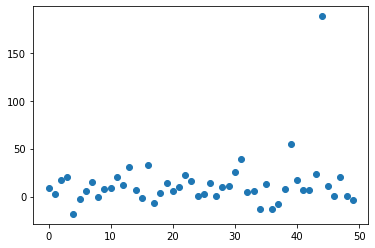

3.4006786
Traced<ConcreteArray(3.4006786)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4006786, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


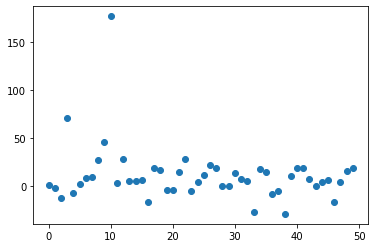

2.8470526
Traced<ConcreteArray(2.8470526)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8470526, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


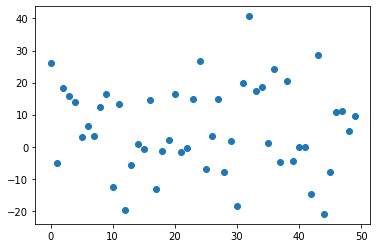

2.5943894
Traced<ConcreteArray(2.5943894)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5943894, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


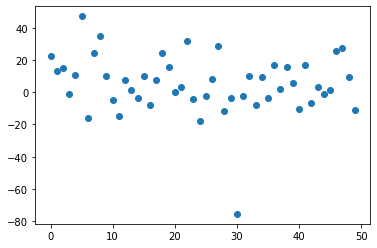

2.701766
Traced<ConcreteArray(2.701766)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.701766, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


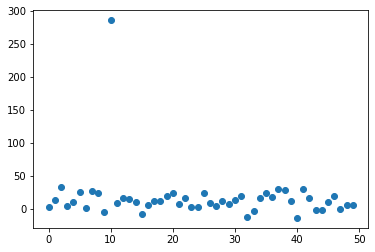

2.776733
Traced<ConcreteArray(2.776733)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.776733, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


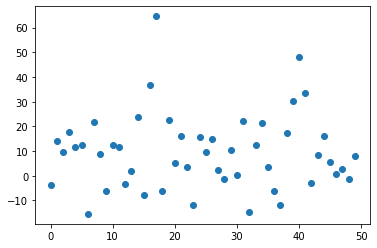

3.5549107
Traced<ConcreteArray(3.5549107)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5549107, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


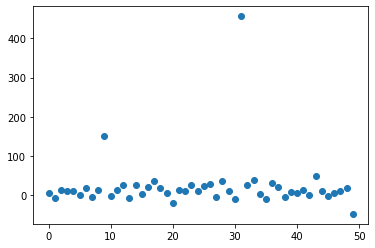

2.5296316
Traced<ConcreteArray(2.5296316)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5296316, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


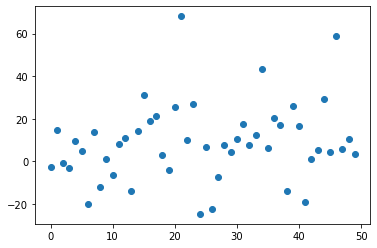

3.0401359
Traced<ConcreteArray(3.0401359)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0401359, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


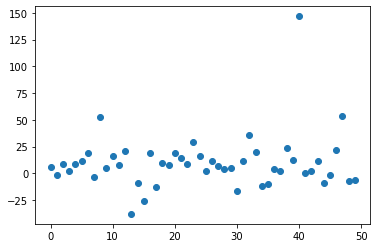

2.3461297
Traced<ConcreteArray(2.3461297)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3461297, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


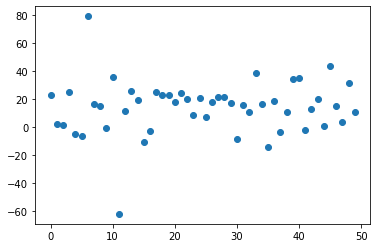

2.9303641
Traced<ConcreteArray(2.9303641)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9303641, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


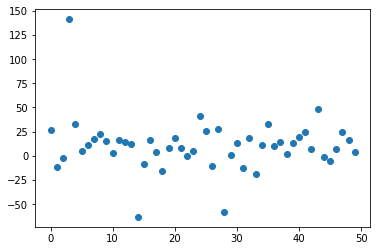

2.4718177
Traced<ConcreteArray(2.4718177)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4718177, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


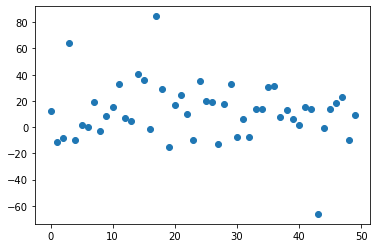

2.6269705
Traced<ConcreteArray(2.6269705)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6269705, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


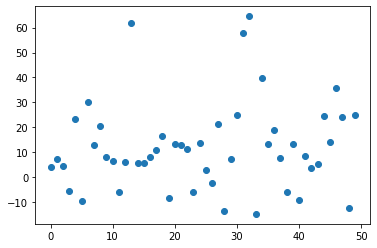

3.086776
Traced<ConcreteArray(3.086776)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.086776, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


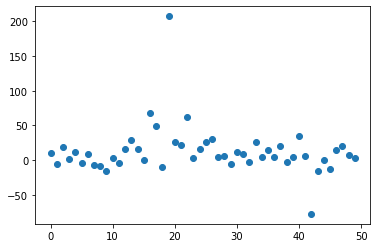

2.6463652
Traced<ConcreteArray(2.6463652)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6463652, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


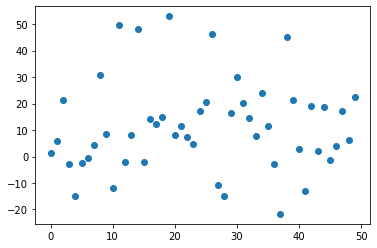

3.1556942
Traced<ConcreteArray(3.1556942)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1556942, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


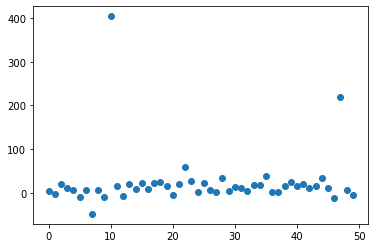

3.1084743
Traced<ConcreteArray(3.1084743)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1084743, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


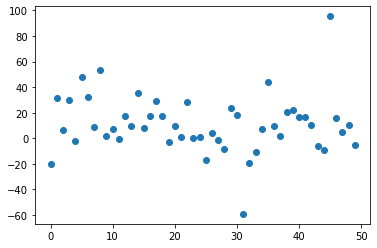

2.9117515
Traced<ConcreteArray(2.9117515)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9117515, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


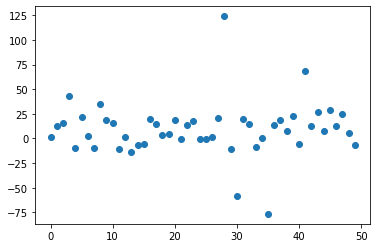

2.7949305
Traced<ConcreteArray(2.7949305)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7949305, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


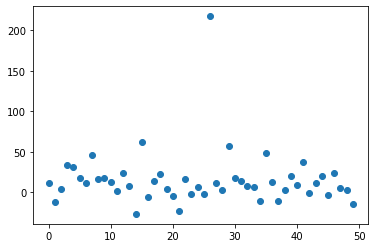

2.4821029
Traced<ConcreteArray(2.4821029)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4821029, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


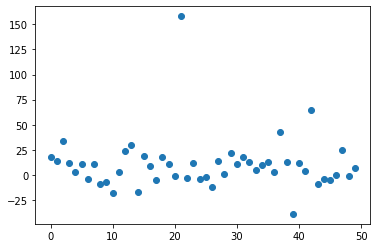

2.6420648
Traced<ConcreteArray(2.6420648)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6420648, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


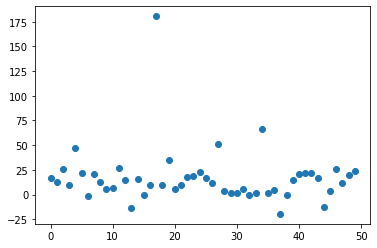

2.7426252
Traced<ConcreteArray(2.7426252)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7426252, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


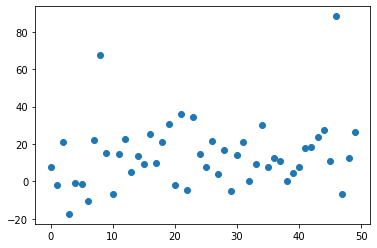

2.6226833
Traced<ConcreteArray(2.6226833)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6226833, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


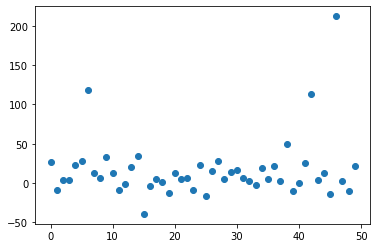

3.8769803
Traced<ConcreteArray(3.8769803)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8769803, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


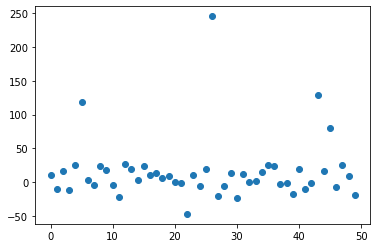

4.783256
Traced<ConcreteArray(4.783256)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.783256, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


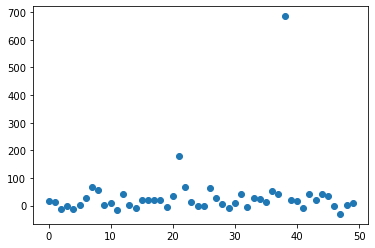

4.2691917
Traced<ConcreteArray(4.2691917)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.2691917, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


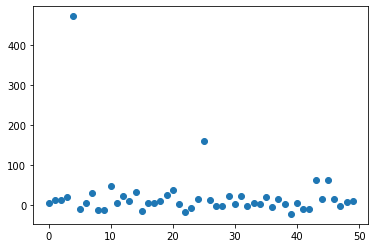

2.6642773
Traced<ConcreteArray(2.6642773)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6642773, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


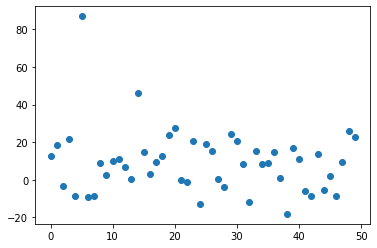

2.435705
Traced<ConcreteArray(2.435705)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.435705, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


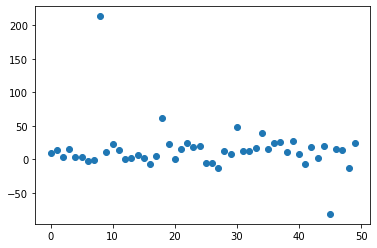

2.5647092
Traced<ConcreteArray(2.5647092)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5647092, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


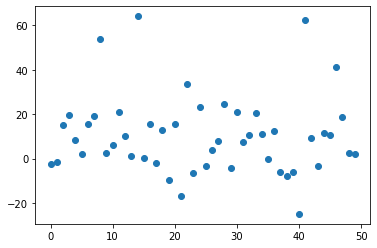

3.0396874
Traced<ConcreteArray(3.0396874)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0396874, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


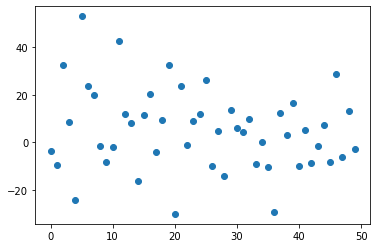

3.5590286
Traced<ConcreteArray(3.5590286)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5590286, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


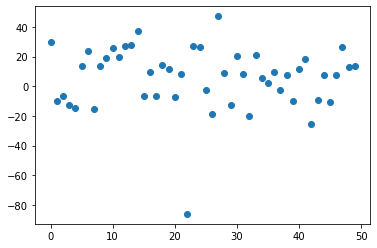

2.288112
Traced<ConcreteArray(2.288112)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.288112, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


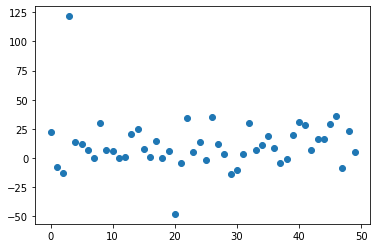

2.9944854
Traced<ConcreteArray(2.9944854)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9944854, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


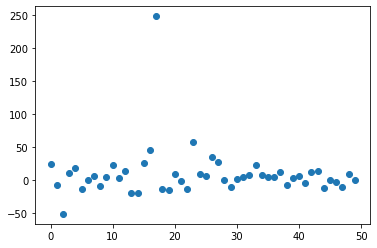

2.1838217
Traced<ConcreteArray(2.1838217)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1838217, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


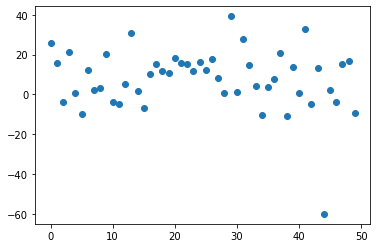

2.6518168
Traced<ConcreteArray(2.6518168)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6518168, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


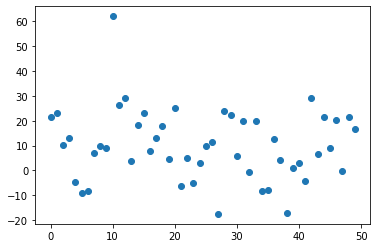

3.875101
Traced<ConcreteArray(3.875101)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.875101, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


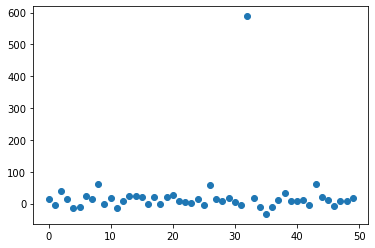

3.740004
Traced<ConcreteArray(3.740004)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.740004, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


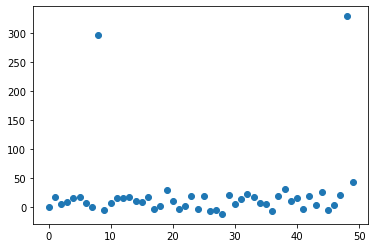

2.0885572
Traced<ConcreteArray(2.0885572)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.0885572, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


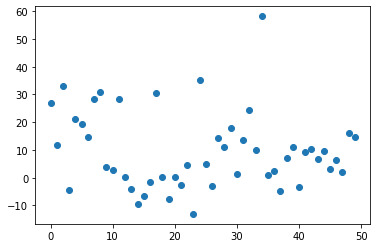

2.715961
Traced<ConcreteArray(2.715961)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.715961, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


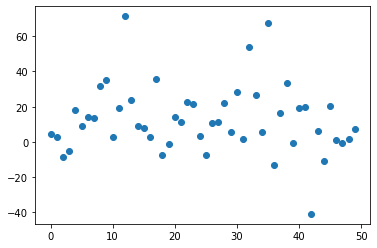

4.022504
Traced<ConcreteArray(4.022504)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.022504, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


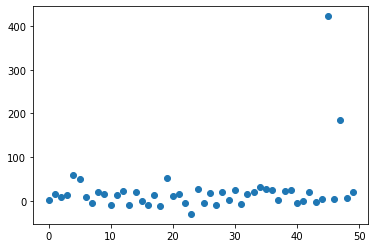

2.662713
Traced<ConcreteArray(2.662713)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.662713, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


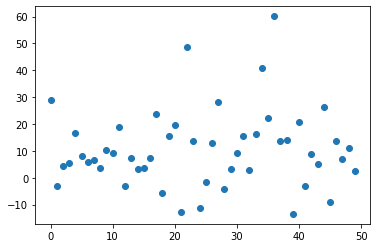

2.7731295
Traced<ConcreteArray(2.7731295)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7731295, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


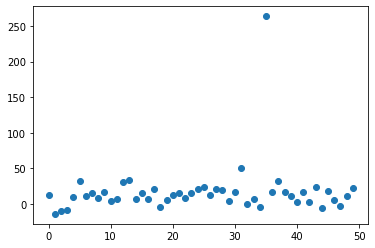

3.400566
Traced<ConcreteArray(3.400566)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.400566, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


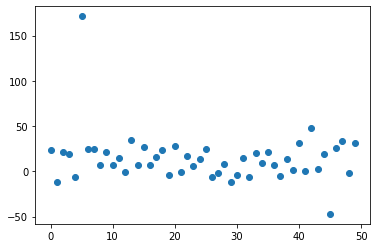

3.148211
Traced<ConcreteArray(3.148211)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.148211, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


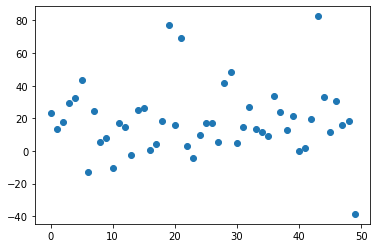

4.2206855
Traced<ConcreteArray(4.2206855)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.2206855, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


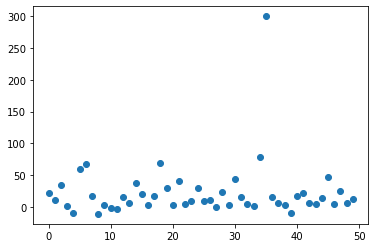

2.7977657
Traced<ConcreteArray(2.7977657)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7977657, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


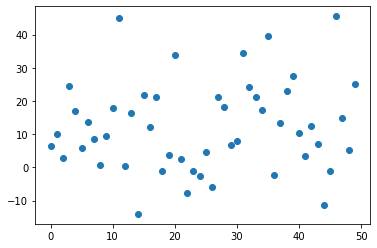

4.082005
Traced<ConcreteArray(4.082005)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.082005, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


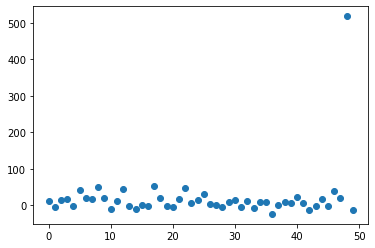

2.5707161
Traced<ConcreteArray(2.5707161)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5707161, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


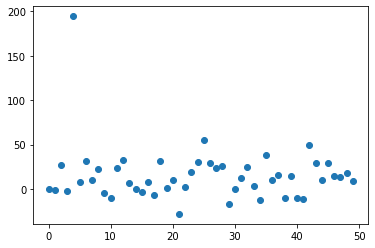

2.6941156
Traced<ConcreteArray(2.6941156)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6941156, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


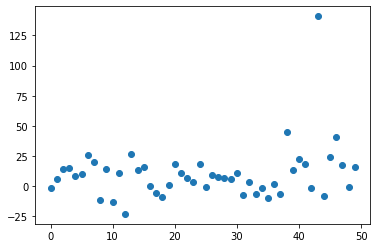

3.5612917
Traced<ConcreteArray(3.5612917)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5612917, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


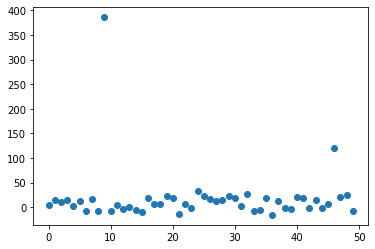

3.4968126
Traced<ConcreteArray(3.4968126)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4968126, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


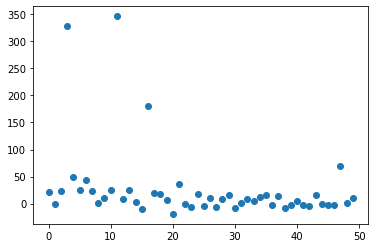

4.9712114
Traced<ConcreteArray(4.9712114)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.9712114, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


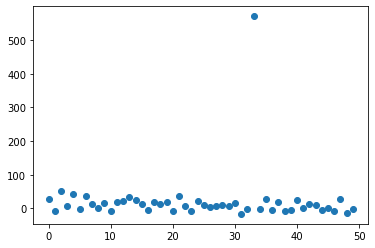

3.341125
Traced<ConcreteArray(3.341125)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.341125, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


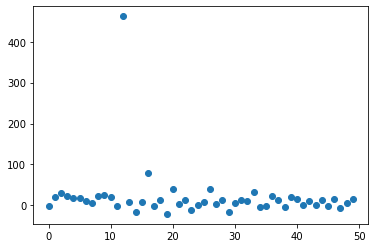

2.5533528
Traced<ConcreteArray(2.5533528)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5533528, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


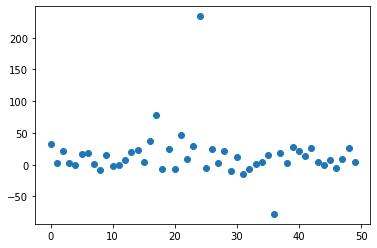

2.474724
Traced<ConcreteArray(2.474724)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.474724, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


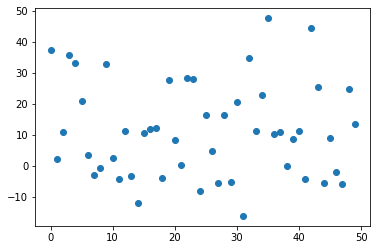

2.9447122
Traced<ConcreteArray(2.9447122)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9447122, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


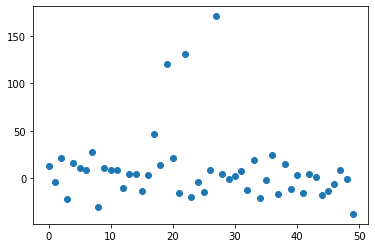

2.7512133
Traced<ConcreteArray(2.7512133)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7512133, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


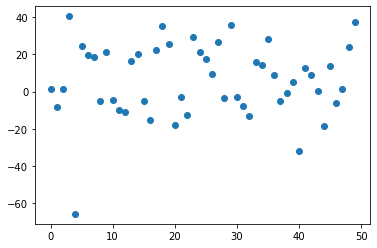

2.6816165
Traced<ConcreteArray(2.6816165)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6816165, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


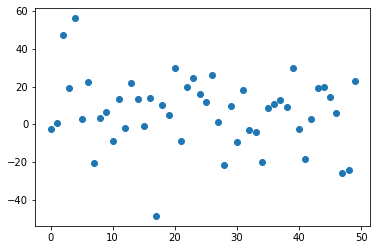

2.6962738
Traced<ConcreteArray(2.6962738)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6962738, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


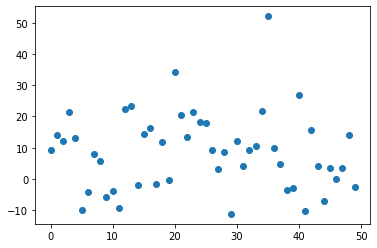

3.2229161
Traced<ConcreteArray(3.2229161)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2229161, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


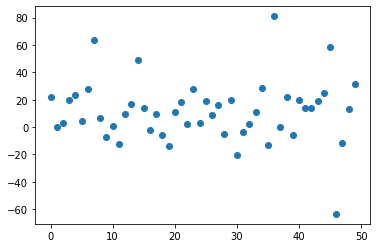

3.3399038
Traced<ConcreteArray(3.3399038)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3399038, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


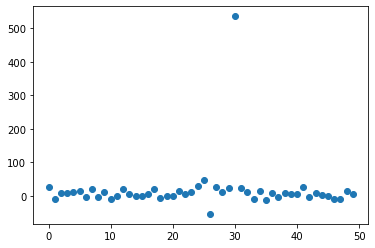

3.1119878
Traced<ConcreteArray(3.1119878)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1119878, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


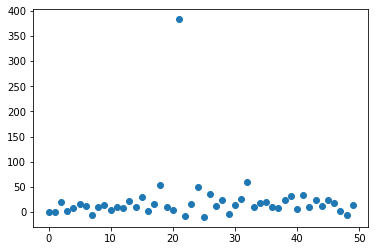

3.3050241
Traced<ConcreteArray(3.3050241)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3050241, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


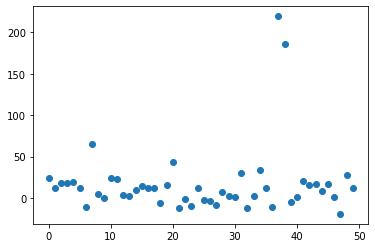

2.6468978
Traced<ConcreteArray(2.6468978)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6468978, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


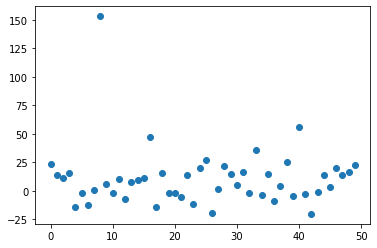

3.025736
Traced<ConcreteArray(3.025736)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.025736, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


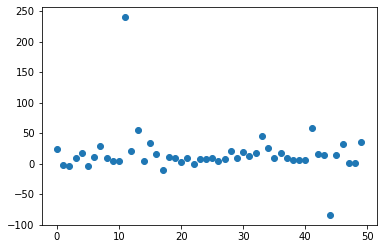

3.404087
Traced<ConcreteArray(3.404087)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.404087, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


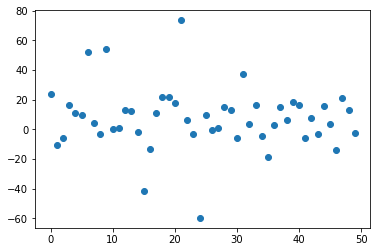

2.8038912
Traced<ConcreteArray(2.8038912)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8038912, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


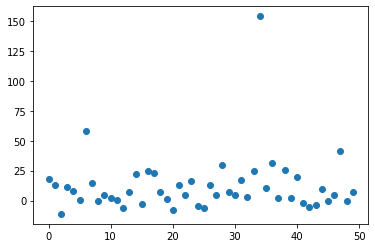

3.2020445
Traced<ConcreteArray(3.2020445)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2020445, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


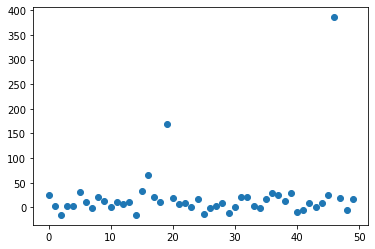

2.8666205
Traced<ConcreteArray(2.8666205)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8666205, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


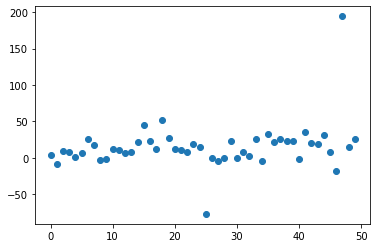

2.7223008
Traced<ConcreteArray(2.7223008)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7223008, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


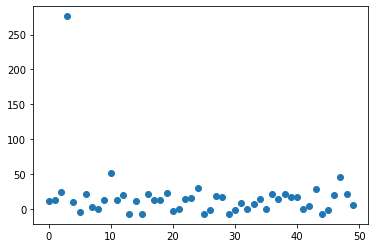

2.4660296
Traced<ConcreteArray(2.4660296)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4660296, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


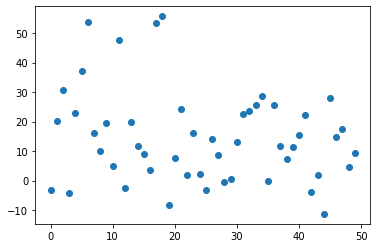

3.533483
Traced<ConcreteArray(3.533483)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.533483, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


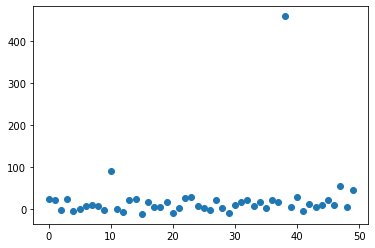

4.364136
Traced<ConcreteArray(4.364136)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.364136, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


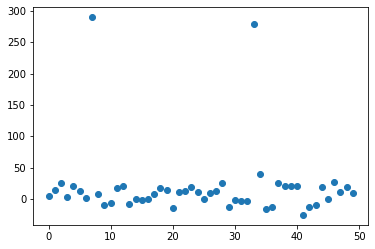

In [27]:
#Run 3. Now including lambda=10000, to train the network for a larger range of inputs
opt_init, opt_update, get_params = optimizers.adam(step_size=1e-5)
new3_params,data_generator3=NN(batch_size,num_epochs,n,new2_params,1.2)

2.3669076
Traced<ConcreteArray(2.3669076)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3669076, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


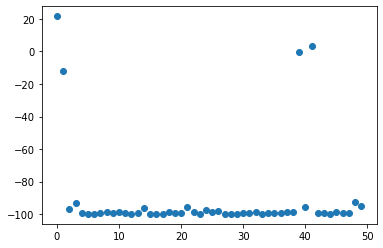

5517.229
Traced<ConcreteArray(5517.229)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5517.229, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


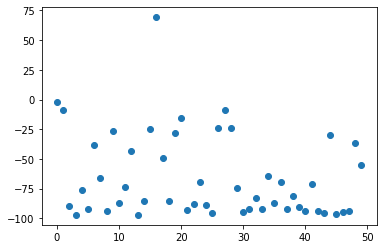

2.8322663
Traced<ConcreteArray(2.8322663)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8322663, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


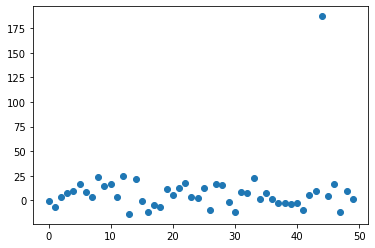

2.621479
Traced<ConcreteArray(2.621479)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.621479, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


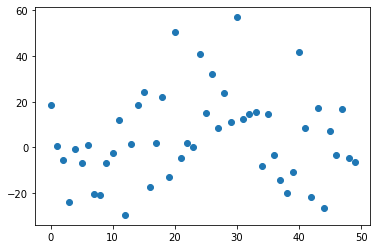

2690.1892
Traced<ConcreteArray(2690.1892)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2690.1892, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


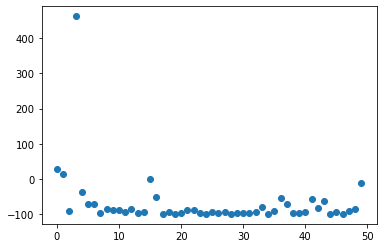

2097.5457
Traced<ConcreteArray(2097.5457)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2097.5457, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


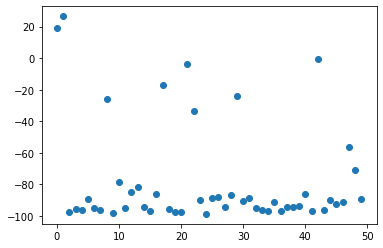

135659.7
Traced<ConcreteArray(135659.7)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(135659.7, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


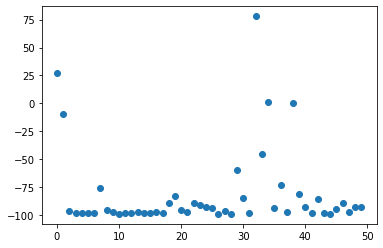

136.84831
Traced<ConcreteArray(136.84831)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(136.84831, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


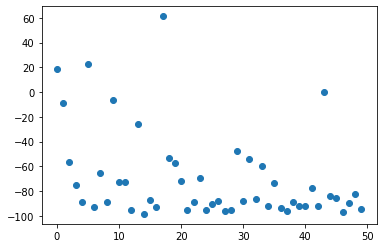

32096.895
Traced<ConcreteArray(32096.895)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(32096.895, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


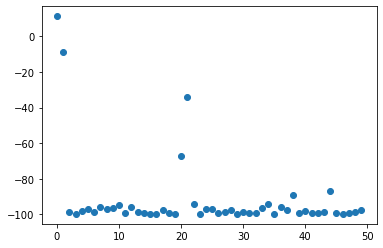

1014.40625
Traced<ConcreteArray(1014.40625)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1014.40625, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


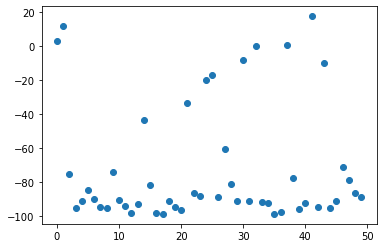

20.693499
Traced<ConcreteArray(20.693499)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(20.693499, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


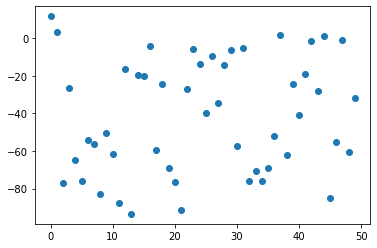

139876.67
Traced<ConcreteArray(139876.67)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(139876.67, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


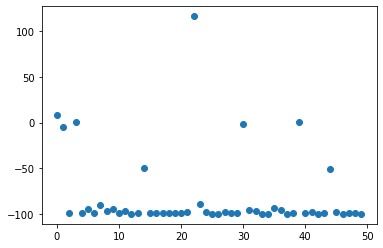

2.696721
Traced<ConcreteArray(2.696721)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.696721, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


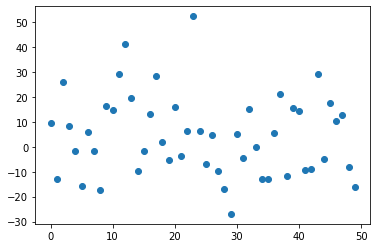

5.851239
Traced<ConcreteArray(5.851239)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.851239, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


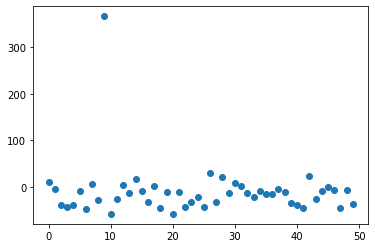

47.259644
Traced<ConcreteArray(47.259644)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(47.259644, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


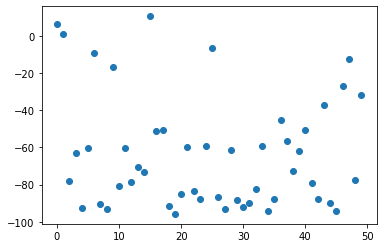

2.8014538
Traced<ConcreteArray(2.8014538)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8014538, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


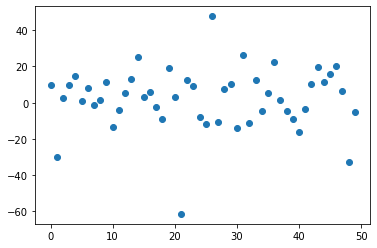

36536.582
Traced<ConcreteArray(36536.582)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(36536.582, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


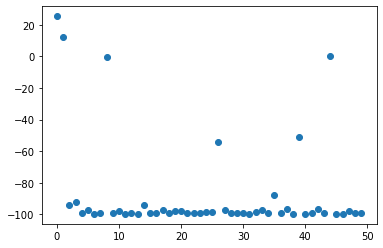

461.9003
Traced<ConcreteArray(461.9003)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(461.9003, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


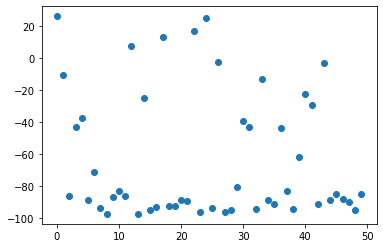

459.16647
Traced<ConcreteArray(459.16647)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(459.16647, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


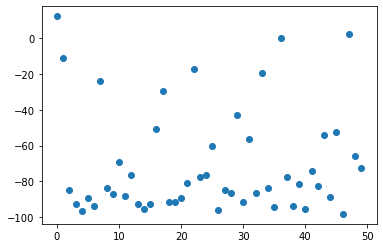

684.8587
Traced<ConcreteArray(684.8587)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(684.8587, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


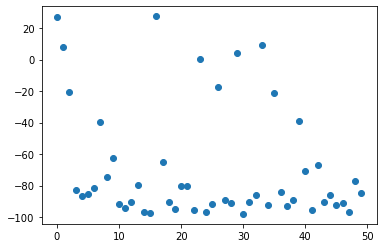

2.7536402
Traced<ConcreteArray(2.7536402)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7536402, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


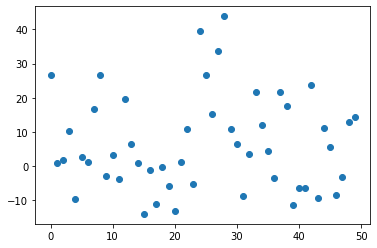

3.1677136
Traced<ConcreteArray(3.1677136)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1677136, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


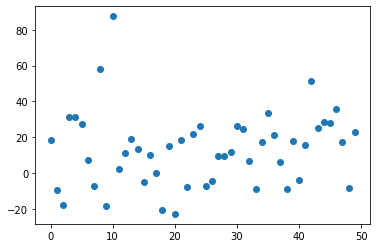

44763.523
Traced<ConcreteArray(44763.523)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(44763.523, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


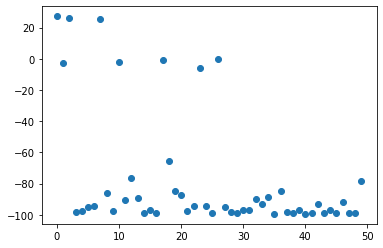

2.4907353
Traced<ConcreteArray(2.4907353)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4907353, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


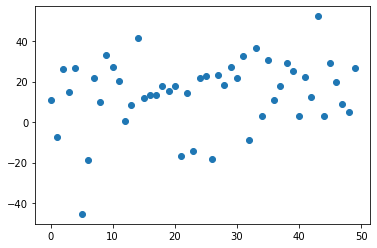

2.558227
Traced<ConcreteArray(2.558227)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.558227, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


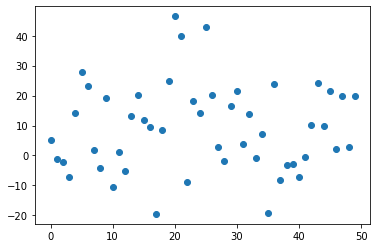

33763.996
Traced<ConcreteArray(33763.996)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(33763.996, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


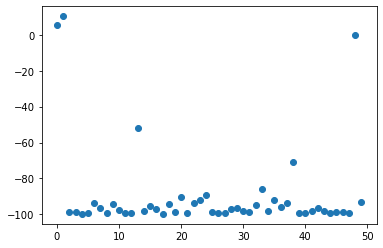

158.40184
Traced<ConcreteArray(158.40184)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(158.40184, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


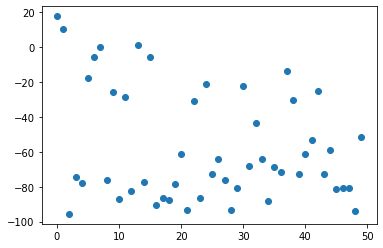

3.2582393
Traced<ConcreteArray(3.2582393)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2582393, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


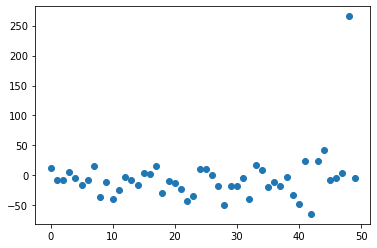

3.9003172
Traced<ConcreteArray(3.9003172)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9003172, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


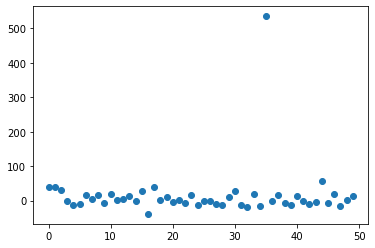

2.8904166
Traced<ConcreteArray(2.8904166)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8904166, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


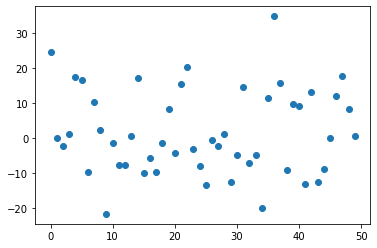

2.7176046
Traced<ConcreteArray(2.7176046)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7176046, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


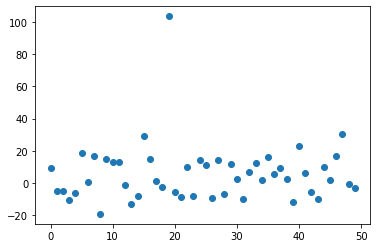

13606.825
Traced<ConcreteArray(13606.825)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(13606.825, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


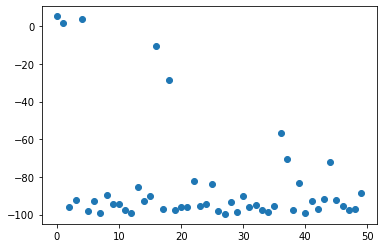

3.968366
Traced<ConcreteArray(3.968366)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.968366, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


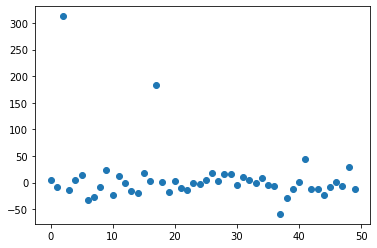

2.8226418
Traced<ConcreteArray(2.8226418)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8226418, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


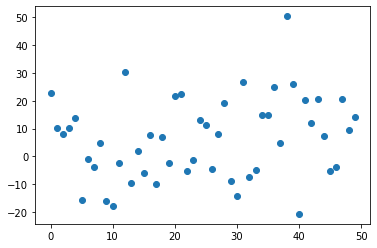

2.8757005
Traced<ConcreteArray(2.8757005)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8757005, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


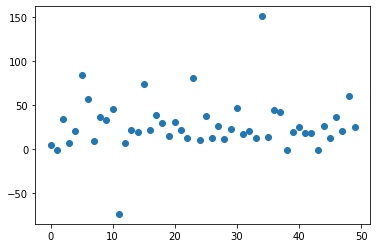

2.4259524
Traced<ConcreteArray(2.4259524)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4259524, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


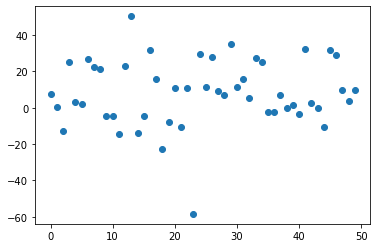

2.922882
Traced<ConcreteArray(2.922882)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.922882, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


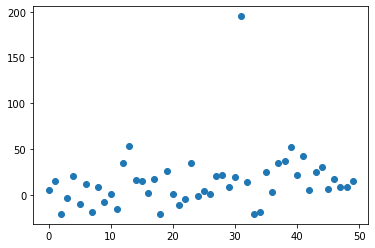

4.607828
Traced<ConcreteArray(4.607828)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.607828, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


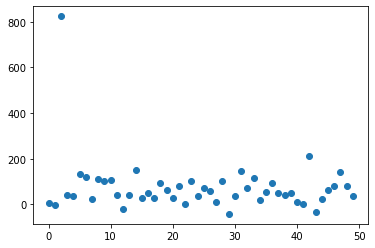

2.95508
Traced<ConcreteArray(2.95508)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.95508, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


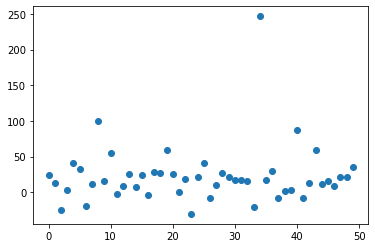

4.3696003
Traced<ConcreteArray(4.3696003)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.3696003, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


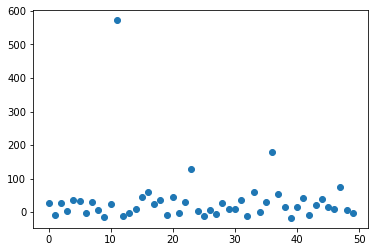

2.7923903
Traced<ConcreteArray(2.7923903)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7923903, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


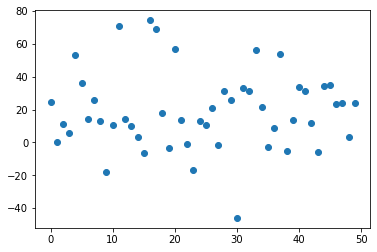

23694.072
Traced<ConcreteArray(23694.072)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(23694.072, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


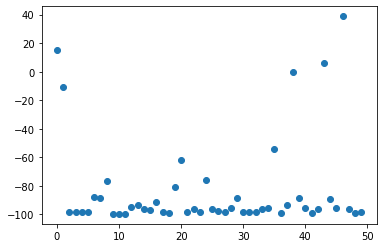

2.7480552
Traced<ConcreteArray(2.7480552)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7480552, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


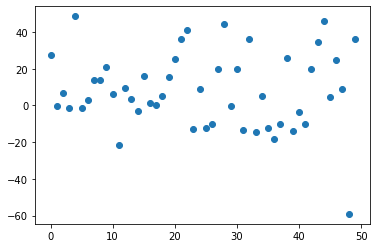

3.0999024
Traced<ConcreteArray(3.0999024)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0999024, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


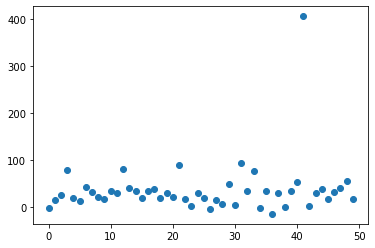

2367.3677
Traced<ConcreteArray(2367.3677)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2367.3677, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


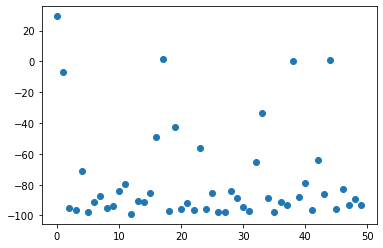

7.638674
Traced<ConcreteArray(7.638674)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.638674, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


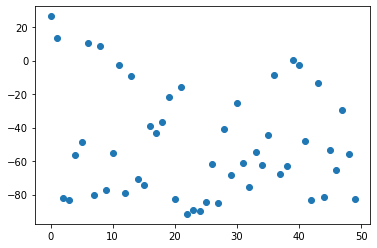

3.2776413
Traced<ConcreteArray(3.2776413)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2776413, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


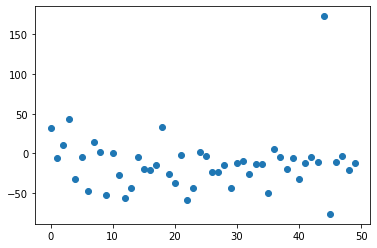

120.2639
Traced<ConcreteArray(120.2639)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(120.2639, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


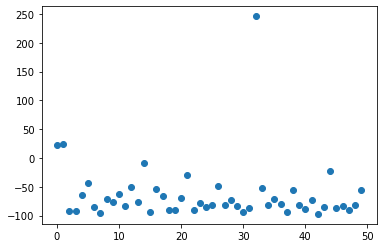

24528.05
Traced<ConcreteArray(24528.05)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(24528.05, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


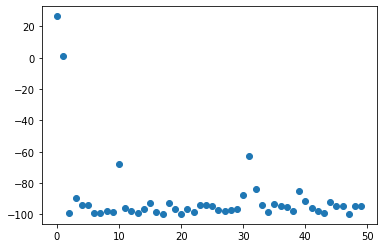

11755.21
Traced<ConcreteArray(11755.21)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(11755.21, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


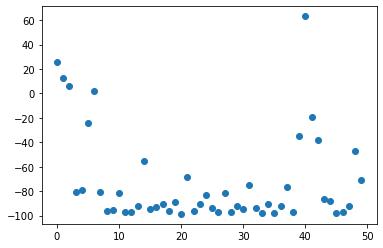

2.9767253
Traced<ConcreteArray(2.9767253)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9767253, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


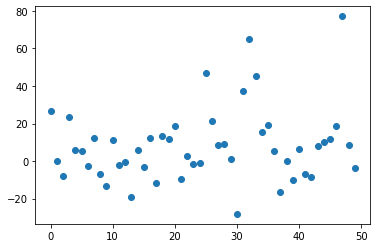

3.434269
Traced<ConcreteArray(3.434269)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.434269, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


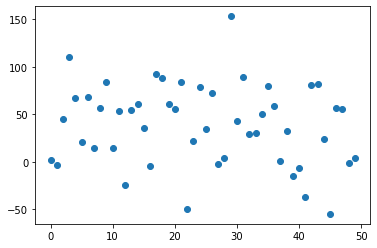

5.7541437
Traced<ConcreteArray(5.7541437)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.7541437, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


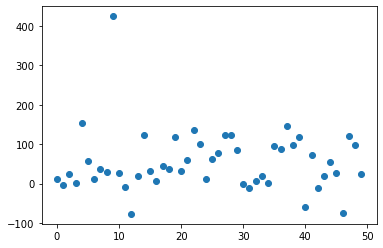

39591.934
Traced<ConcreteArray(39591.934)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(39591.934, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


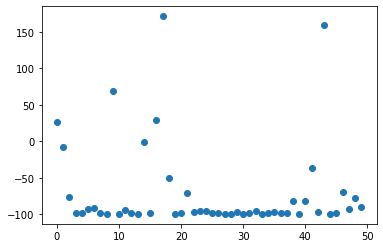

341.99942
Traced<ConcreteArray(341.99942)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(341.99942, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


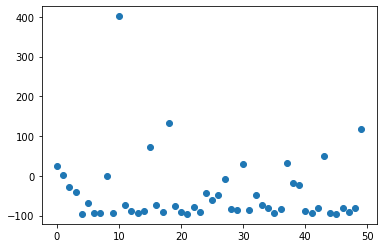

3.8172379
Traced<ConcreteArray(3.8172379)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8172379, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


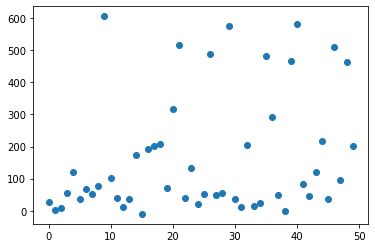

5.765826
Traced<ConcreteArray(5.765826)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.765826, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


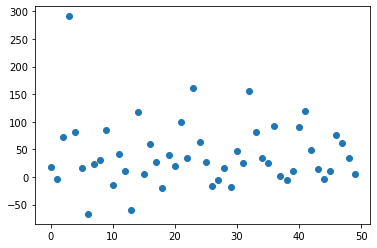

4.5283165
Traced<ConcreteArray(4.5283165)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.5283165, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


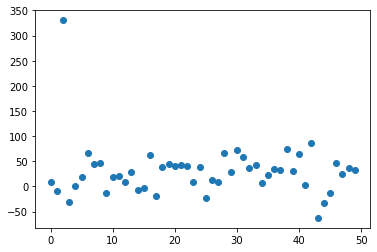

3.5444689
Traced<ConcreteArray(3.5444689)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5444689, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


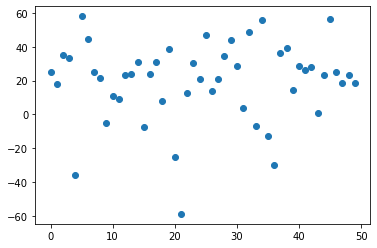

26274.844
Traced<ConcreteArray(26274.844)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(26274.844, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


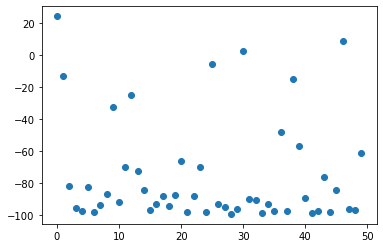

3746.871
Traced<ConcreteArray(3746.871)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3746.871, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


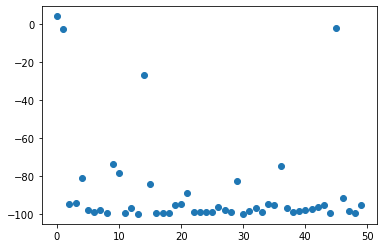

3.8714464
Traced<ConcreteArray(3.8714464)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8714464, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


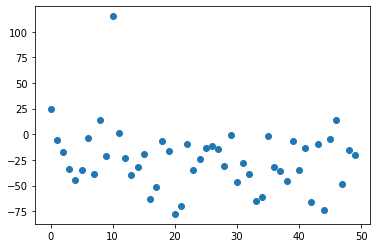

31807.295
Traced<ConcreteArray(31807.295)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(31807.295, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


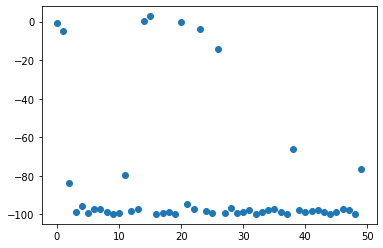

46334.1
Traced<ConcreteArray(46334.1)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(46334.1, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


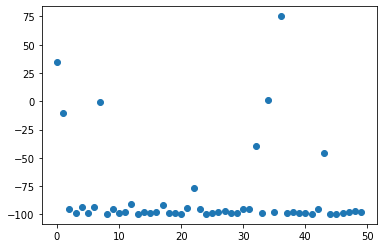

5.878832
Traced<ConcreteArray(5.878832)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.878832, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


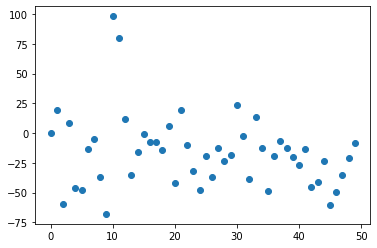

17094.158
Traced<ConcreteArray(17094.158)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(17094.158, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


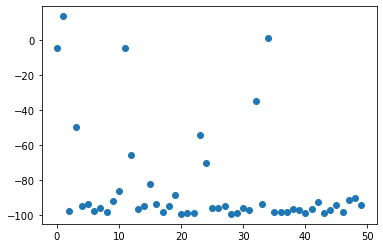

3.2252796
Traced<ConcreteArray(3.2252796)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2252796, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


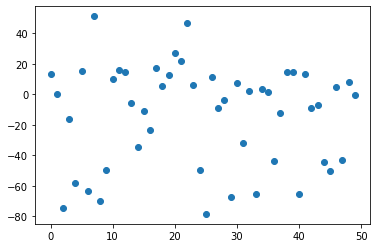

31955.174
Traced<ConcreteArray(31955.174)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(31955.174, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


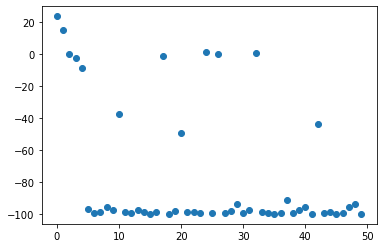

237.17877
Traced<ConcreteArray(237.17877)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(237.17877, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


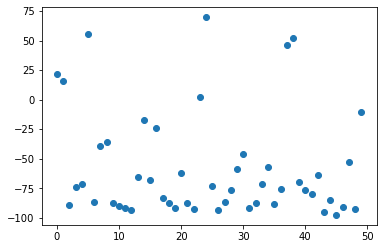

3.957387
Traced<ConcreteArray(3.957387)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.957387, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


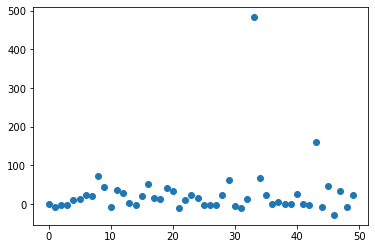

6.634031
Traced<ConcreteArray(6.634031)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.634031, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


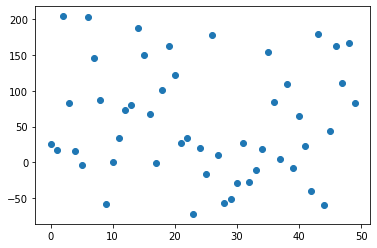

69068.84
Traced<ConcreteArray(69068.84)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(69068.84, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


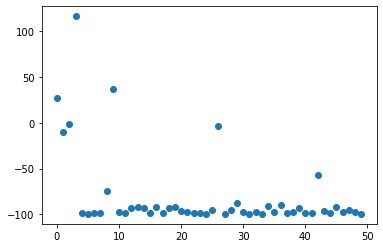

3.0784018
Traced<ConcreteArray(3.0784018)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0784018, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


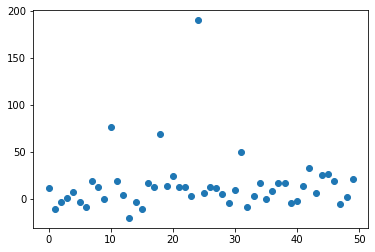

285.67767
Traced<ConcreteArray(285.67767)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(285.67767, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


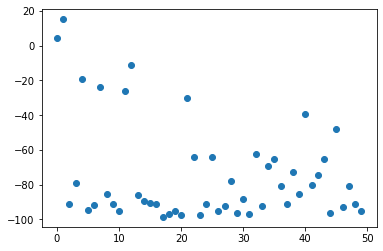

581.29193
Traced<ConcreteArray(581.29193)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(581.29193, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


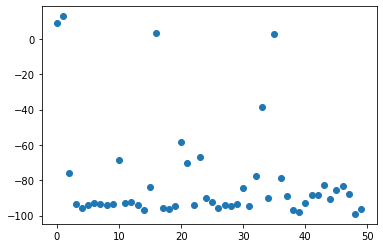

99627.49
Traced<ConcreteArray(99627.49)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(99627.49, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


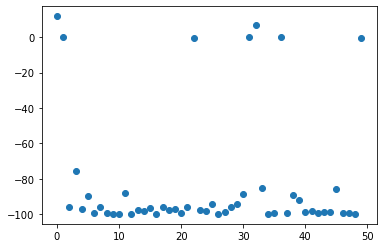

15.705497
Traced<ConcreteArray(15.705497)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(15.705497, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


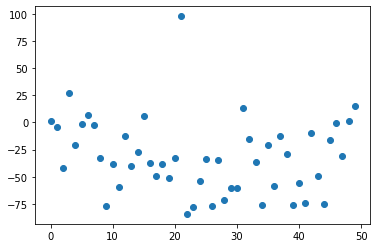

2.6387644
Traced<ConcreteArray(2.6387644)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6387644, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


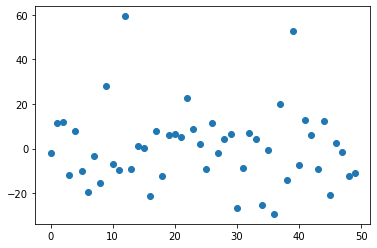

3.4925177
Traced<ConcreteArray(3.4925177)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4925177, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


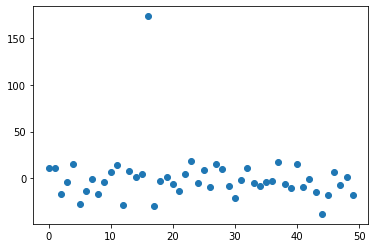

4.973775
Traced<ConcreteArray(4.973775)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.973775, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


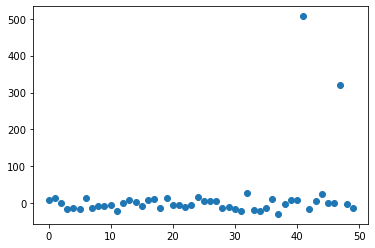

2.535957
Traced<ConcreteArray(2.535957)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.535957, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


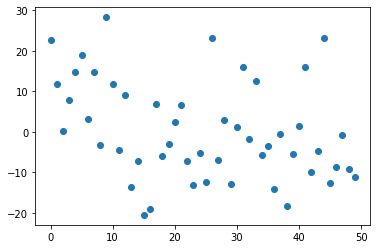

2.7752512
Traced<ConcreteArray(2.7752512)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7752512, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


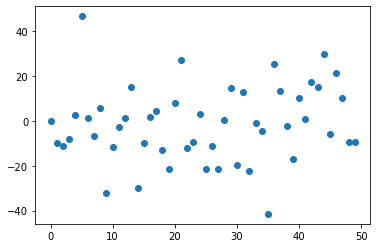

5.006202
Traced<ConcreteArray(5.006202)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.006202, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


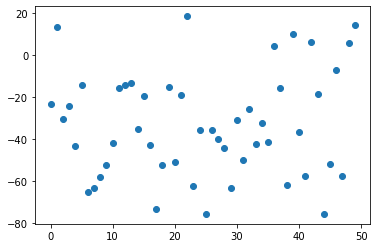

23869.633
Traced<ConcreteArray(23869.633)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(23869.633, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


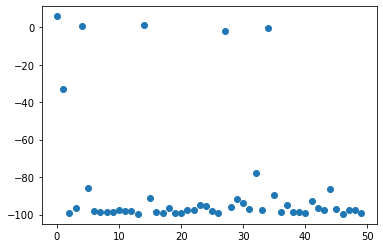

424.03552
Traced<ConcreteArray(424.03552)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(424.03552, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


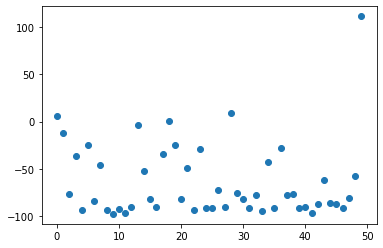

2.3042326
Traced<ConcreteArray(2.3042326)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3042326, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


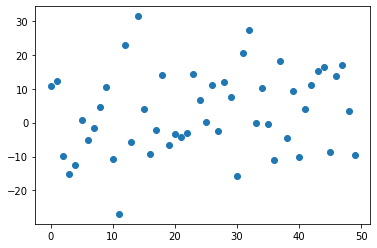

2.6595623
Traced<ConcreteArray(2.6595623)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6595623, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


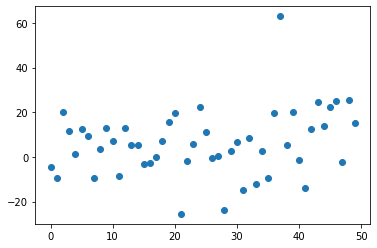

14255.34
Traced<ConcreteArray(14255.34)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(14255.34, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


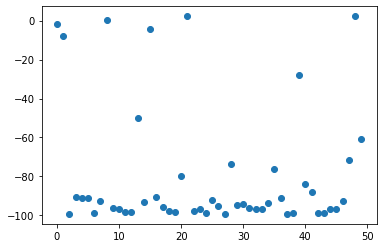

81.853096
Traced<ConcreteArray(81.853096)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(81.853096, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


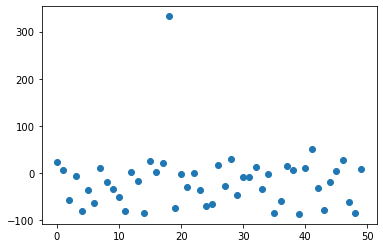

3.3292704
Traced<ConcreteArray(3.3292704)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3292704, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


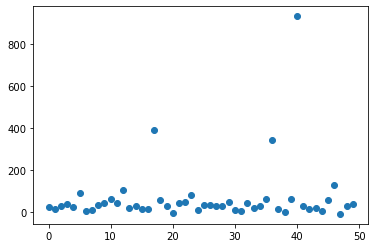

3.3306422
Traced<ConcreteArray(3.3306422)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3306422, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


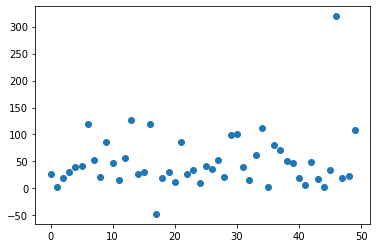

4819.0493
Traced<ConcreteArray(4819.0493)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4819.0493, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


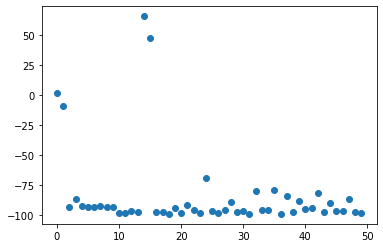

68.91966
Traced<ConcreteArray(68.91966)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(68.91966, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


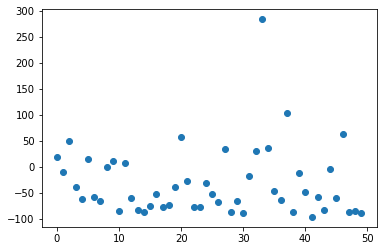

59.256775
Traced<ConcreteArray(59.256775)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(59.256775, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


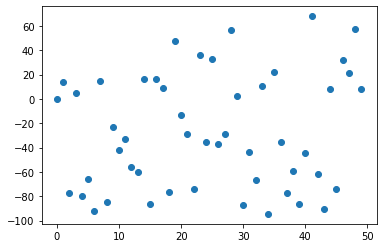

2.4238298
Traced<ConcreteArray(2.4238298)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4238298, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


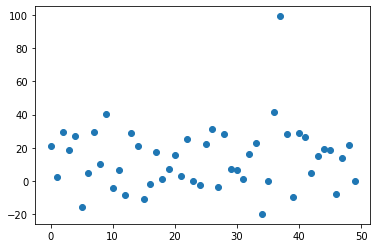

67.50849
Traced<ConcreteArray(67.50849)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(67.50849, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


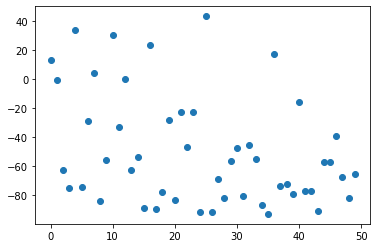

103.73408
Traced<ConcreteArray(103.73408)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(103.73408, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


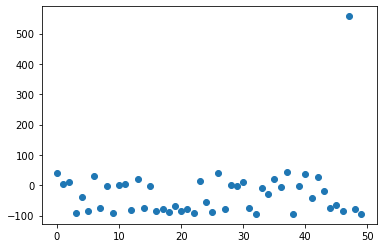

6654.3237
Traced<ConcreteArray(6654.3237)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6654.3237, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


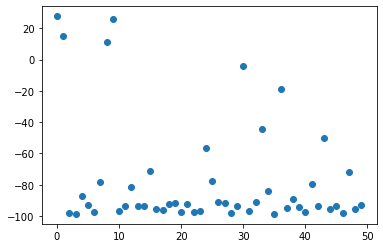

26.509851
Traced<ConcreteArray(26.509851)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(26.509851, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


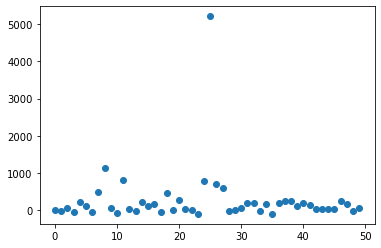

6.721916
Traced<ConcreteArray(6.721916)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.721916, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


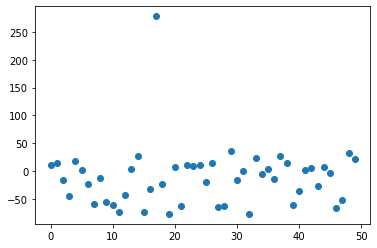

28.14356
Traced<ConcreteArray(28.14356)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(28.14356, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


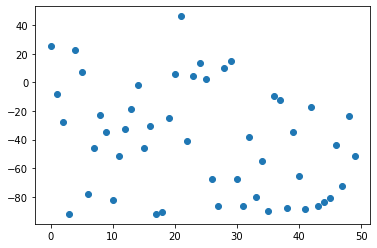

65.61544
Traced<ConcreteArray(65.61544)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(65.61544, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


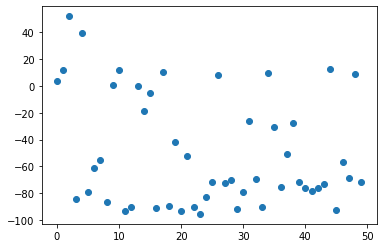

4.20297
Traced<ConcreteArray(4.20297)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.20297, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


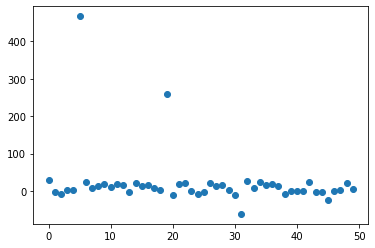

12785.157
Traced<ConcreteArray(12785.157)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(12785.157, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


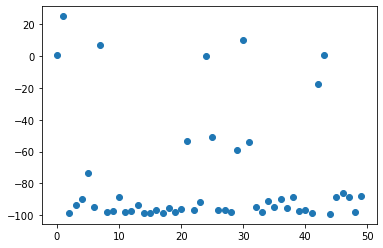

3.3990152
Traced<ConcreteArray(3.3990152)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3990152, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


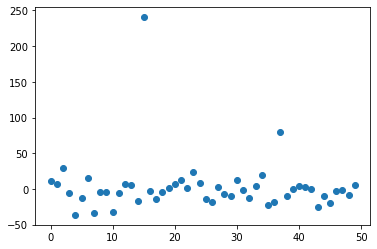

2.6250625
Traced<ConcreteArray(2.6250625)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6250625, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


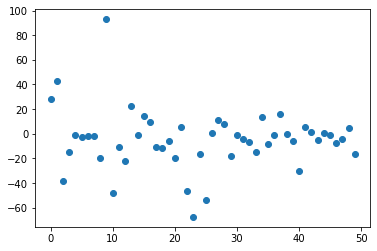

50.42077
Traced<ConcreteArray(50.42077)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(50.42077, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


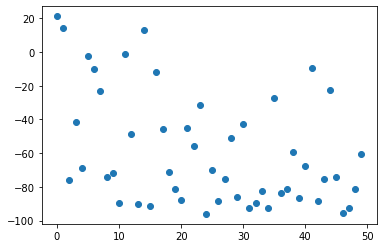

5.2494965
Traced<ConcreteArray(5.2494965)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.2494965, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


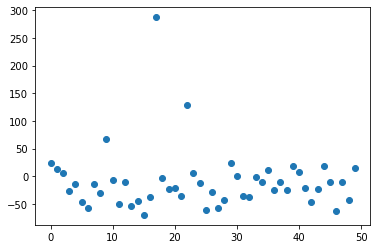

3.7244194
Traced<ConcreteArray(3.7244194)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.7244194, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


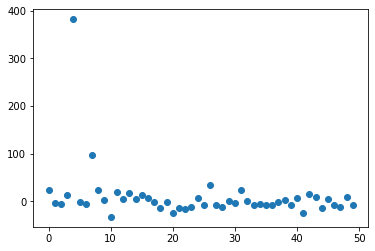

2.4854267
Traced<ConcreteArray(2.4854267)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4854267, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


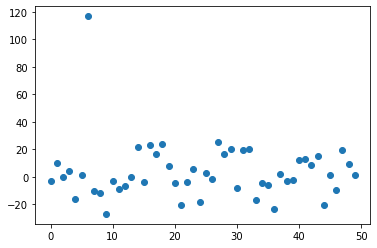

82430.78
Traced<ConcreteArray(82430.78)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(82430.78, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


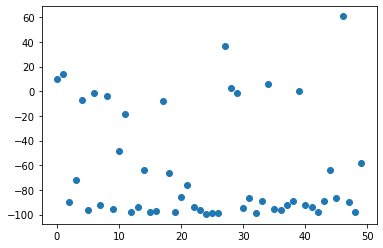

23.877657
Traced<ConcreteArray(23.877657)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(23.877657, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


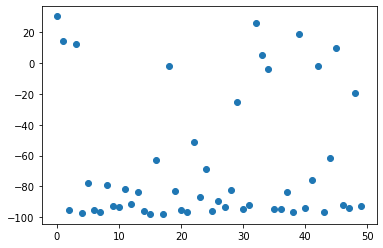

2.6942494
Traced<ConcreteArray(2.6942494)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6942494, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


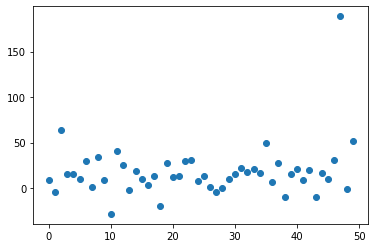

1872.0955
Traced<ConcreteArray(1872.0955)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1872.0955, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


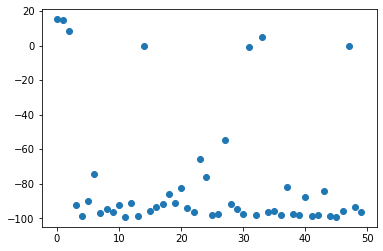

594004.0
Traced<ConcreteArray(594004.0)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(594004., dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


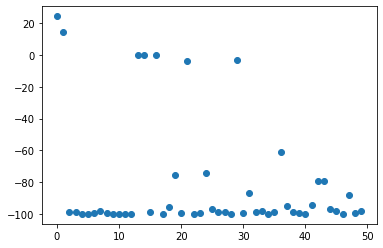

172686.42
Traced<ConcreteArray(172686.42)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(172686.42, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


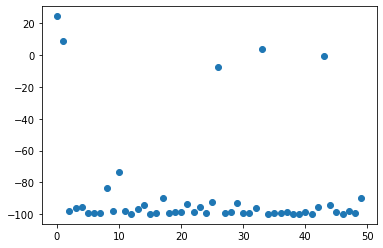

11.189859
Traced<ConcreteArray(11.189859)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(11.189859, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


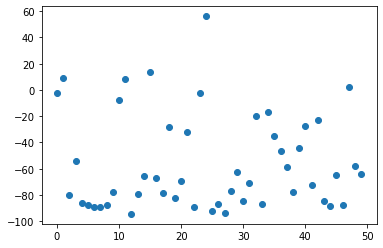

7312.7827
Traced<ConcreteArray(7312.7827)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7312.7827, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


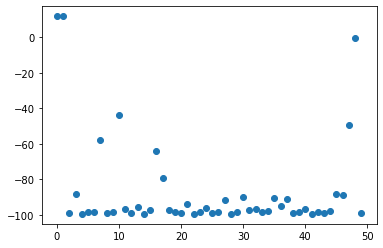

4.6697645
Traced<ConcreteArray(4.6697645)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.6697645, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


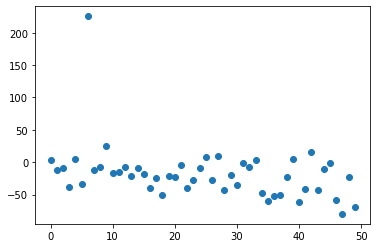

25120.404
Traced<ConcreteArray(25120.404)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(25120.404, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


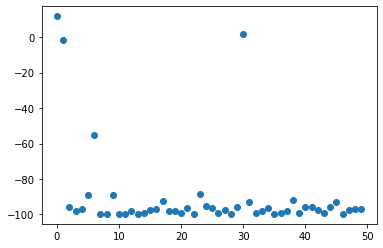

6.898733
Traced<ConcreteArray(6.898733)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.898733, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


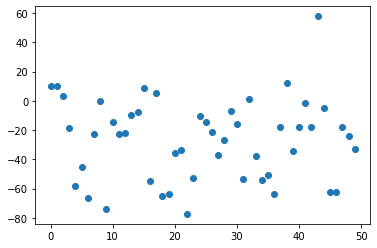

227.95486
Traced<ConcreteArray(227.95486)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(227.95486, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


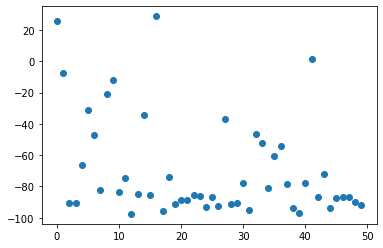

13.039374
Traced<ConcreteArray(13.039374)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(13.039374, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


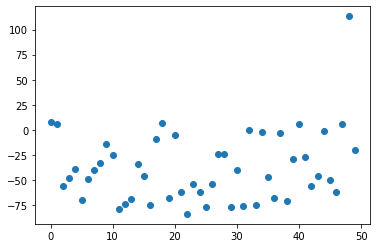

17.235226
Traced<ConcreteArray(17.235226)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(17.235226, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


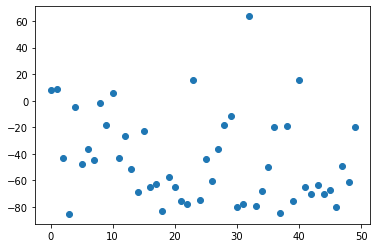

73279.83
Traced<ConcreteArray(73279.83)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(73279.83, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


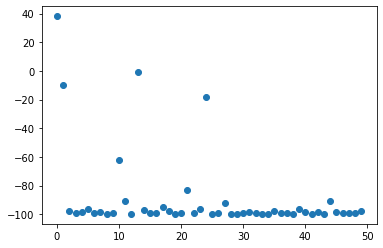

122304.2
Traced<ConcreteArray(122304.2)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(122304.2, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


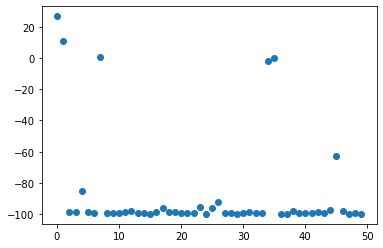

17.25068
Traced<ConcreteArray(17.25068)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(17.25068, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


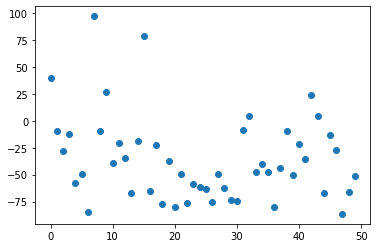

1884.3217
Traced<ConcreteArray(1884.3217)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1884.3217, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


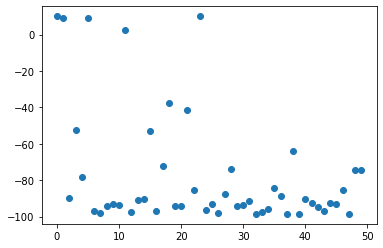

13830446.0
Traced<ConcreteArray(13830446.0)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(13830446., dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


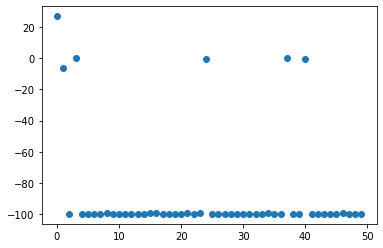

6606143.5
Traced<ConcreteArray(6606143.5)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6606143.5, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


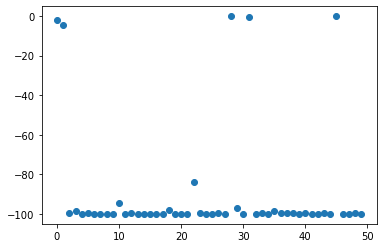

9252290.0
Traced<ConcreteArray(9252290.0)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(9252290., dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


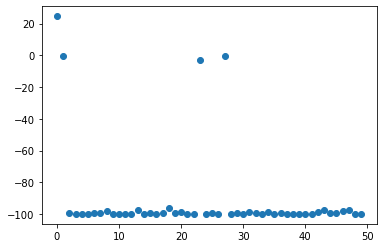

2326098.8
Traced<ConcreteArray(2326098.8)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2326098.8, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


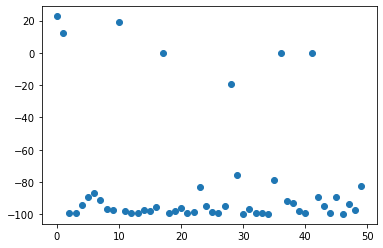

4.696784
Traced<ConcreteArray(4.696784)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.696784, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


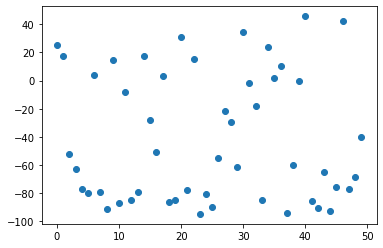

10411.865
Traced<ConcreteArray(10411.865)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(10411.865, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


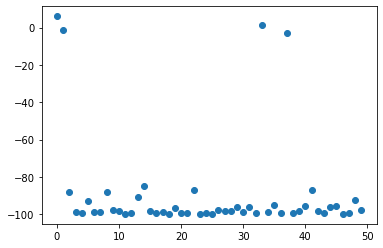

289.27805
Traced<ConcreteArray(289.27805)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(289.27805, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


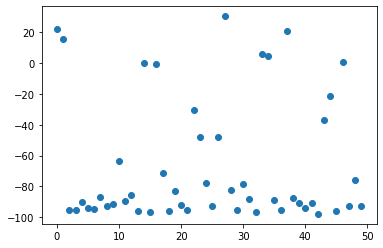

9.9480295
Traced<ConcreteArray(9.9480295)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(9.9480295, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


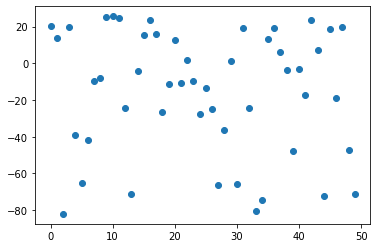

123339.086
Traced<ConcreteArray(123339.086)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(123339.086, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


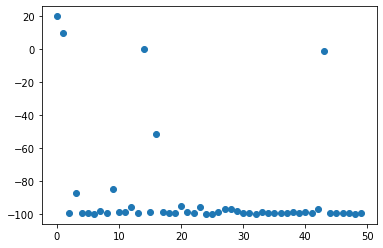

16.685102
Traced<ConcreteArray(16.685102)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(16.685102, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


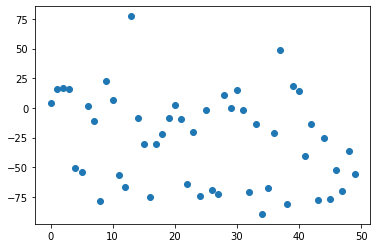

2740.6758
Traced<ConcreteArray(2740.6758)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2740.6758, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


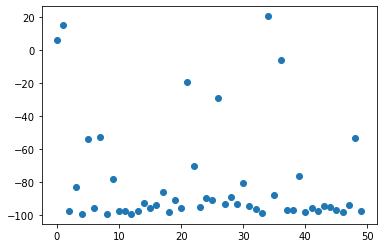

39297252.0
Traced<ConcreteArray(39297252.0)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(39297252., dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


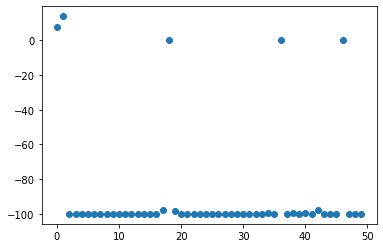

30.984905
Traced<ConcreteArray(30.984905)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(30.984905, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


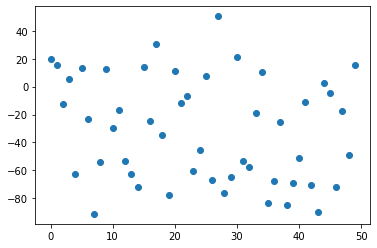

3714.4463
Traced<ConcreteArray(3714.4463)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3714.4463, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


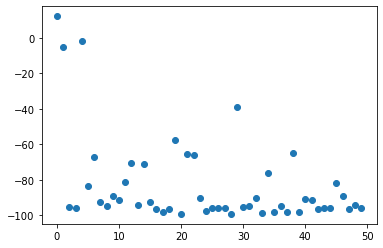

22.86818
Traced<ConcreteArray(22.86818)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(22.86818, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


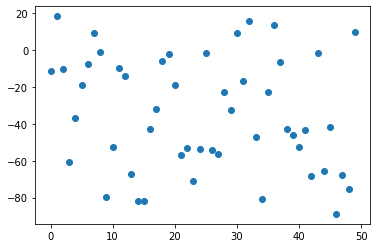

21641198.0
Traced<ConcreteArray(21641198.0)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(21641198., dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


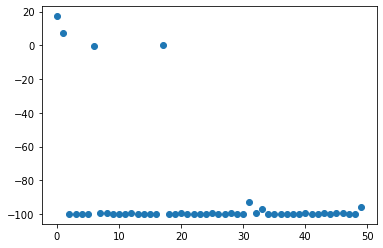

199923.27
Traced<ConcreteArray(199923.27)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(199923.27, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


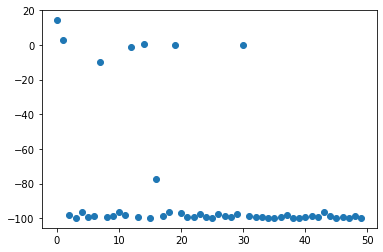

1365.1505
Traced<ConcreteArray(1365.1505)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1365.1505, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


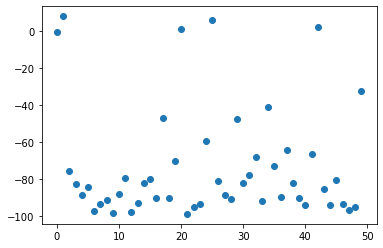

10.605573
Traced<ConcreteArray(10.605573)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(10.605573, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


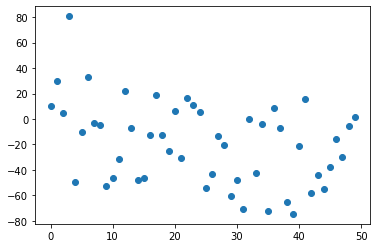

76970.18
Traced<ConcreteArray(76970.18)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(76970.18, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


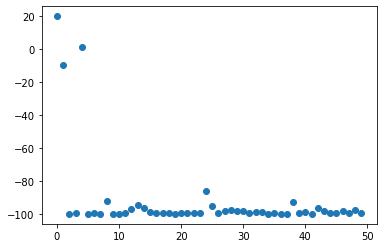

8199236.0
Traced<ConcreteArray(8199236.0)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(8199236., dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


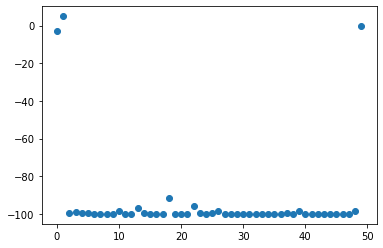

25336.146
Traced<ConcreteArray(25336.146)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(25336.146, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


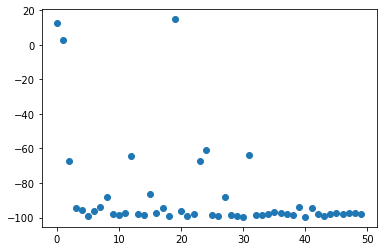

24519.035
Traced<ConcreteArray(24519.035)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(24519.035, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


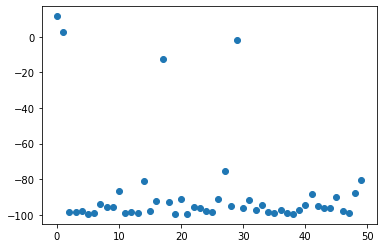

90.82025
Traced<ConcreteArray(90.82025)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(90.82025, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


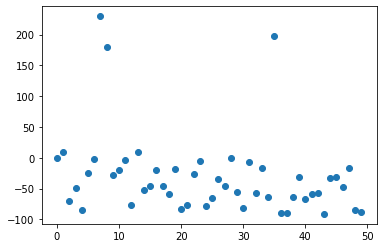

2.9344568
Traced<ConcreteArray(2.9344568)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9344568, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


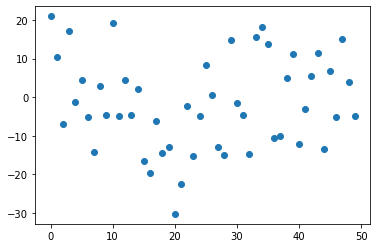

12.523144
Traced<ConcreteArray(12.523144)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(12.523144, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


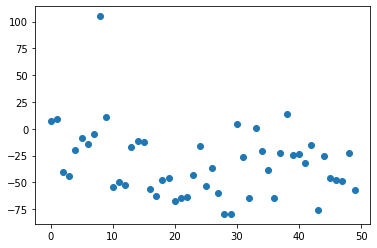

55410.93
Traced<ConcreteArray(55410.93)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(55410.93, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


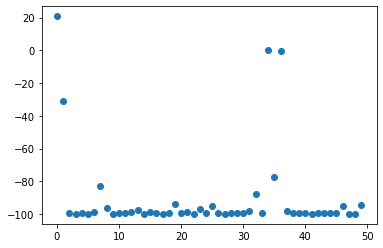

1667.8354
Traced<ConcreteArray(1667.8354)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1667.8354, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


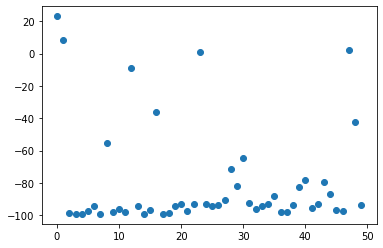

57.10565
Traced<ConcreteArray(57.10565)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(57.10565, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


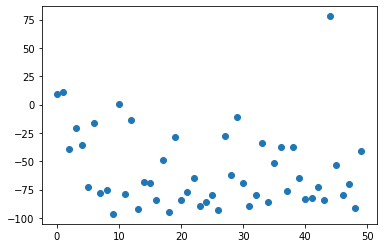

9433.077
Traced<ConcreteArray(9433.077)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(9433.077, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


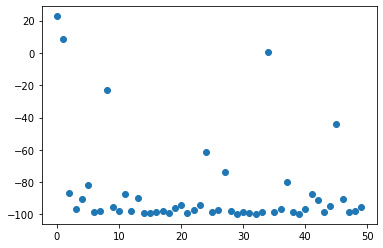

3.1598868
Traced<ConcreteArray(3.1598868)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1598868, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


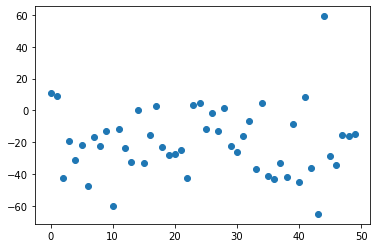

21415.85
Traced<ConcreteArray(21415.85)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(21415.85, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


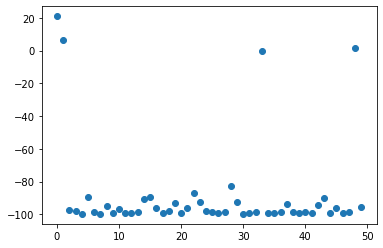

18812.564
Traced<ConcreteArray(18812.564)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(18812.564, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


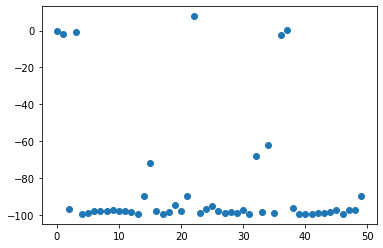

1778970.8
Traced<ConcreteArray(1778970.8)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1778970.8, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


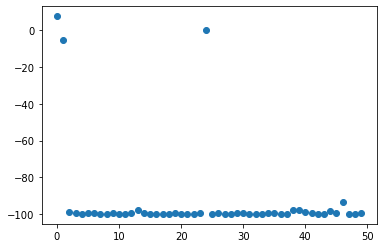

163.83562
Traced<ConcreteArray(163.83562)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(163.83562, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


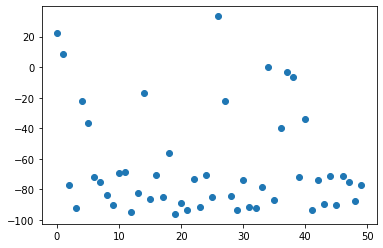

20325.73
Traced<ConcreteArray(20325.73)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(20325.73, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


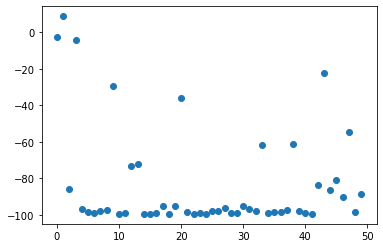

6.6453543
Traced<ConcreteArray(6.6453543)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.6453543, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


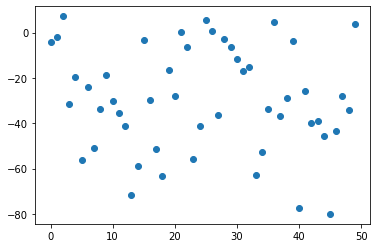

3.7021887
Traced<ConcreteArray(3.7021887)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.7021887, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


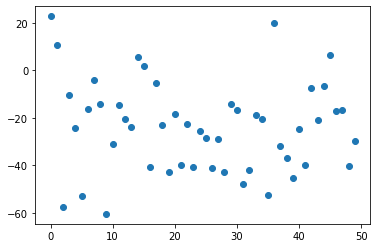

5.5375166
Traced<ConcreteArray(5.5375166)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.5375166, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


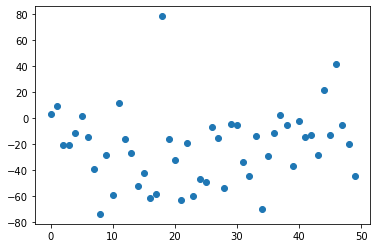

4.2443333
Traced<ConcreteArray(4.2443333)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.2443333, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


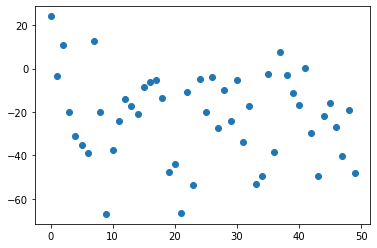

31156.229
Traced<ConcreteArray(31156.229)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(31156.229, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


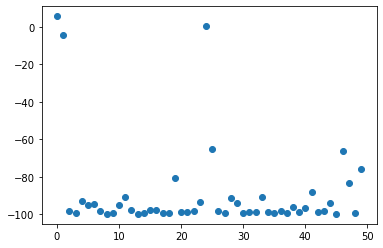

7.2899446
Traced<ConcreteArray(7.2899446)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.2899446, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


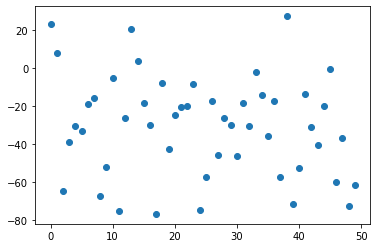

6.590725
Traced<ConcreteArray(6.590725)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.590725, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


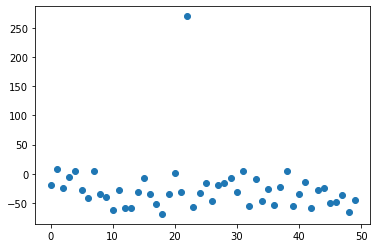

241.82642
Traced<ConcreteArray(241.82642)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(241.82642, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


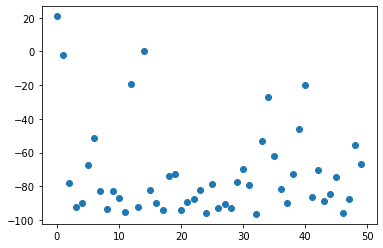

29526.277
Traced<ConcreteArray(29526.277)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(29526.277, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


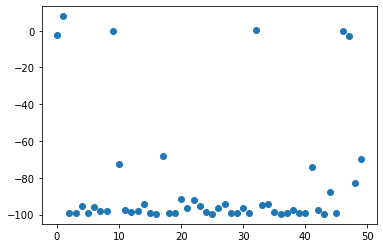

7.739157
Traced<ConcreteArray(7.739157)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.739157, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


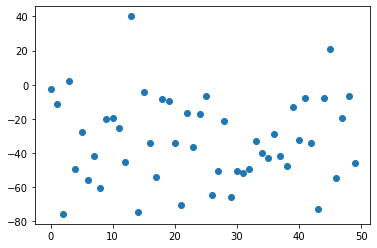

2420086.8
Traced<ConcreteArray(2420086.8)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2420086.8, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


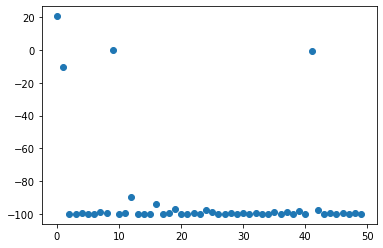

257.34366
Traced<ConcreteArray(257.34366)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(257.34366, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


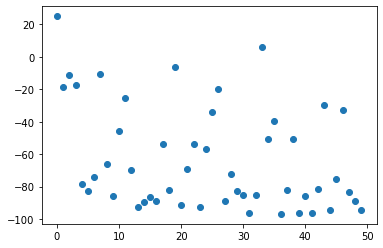

232.42287
Traced<ConcreteArray(232.42287)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(232.42287, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


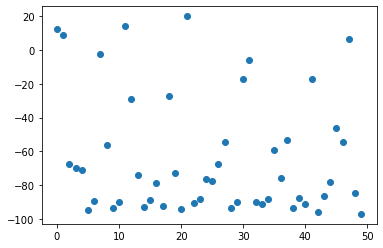

421.72464
Traced<ConcreteArray(421.72464)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(421.72464, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


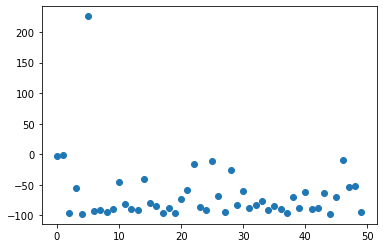

5.933404
Traced<ConcreteArray(5.933404)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.933404, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


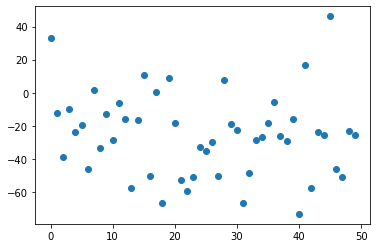

25022.453
Traced<ConcreteArray(25022.453)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(25022.453, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


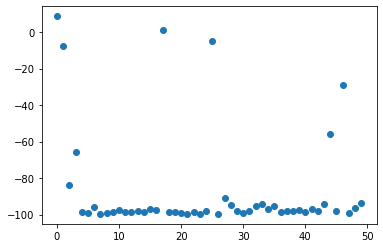

3133220.0
Traced<ConcreteArray(3133220.0)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3133220., dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


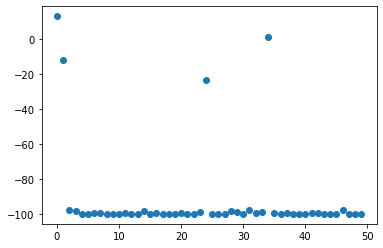

171.11644
Traced<ConcreteArray(171.11644)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(171.11644, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


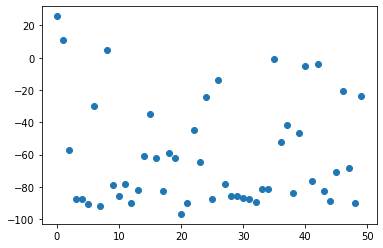

85.33683
Traced<ConcreteArray(85.33683)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(85.33683, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


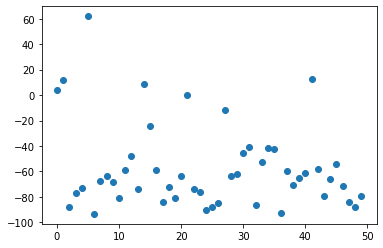

3.192415
Traced<ConcreteArray(3.192415)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.192415, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


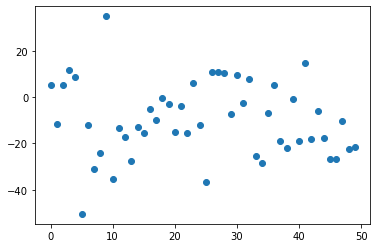

2.7349534
Traced<ConcreteArray(2.7349534)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7349534, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


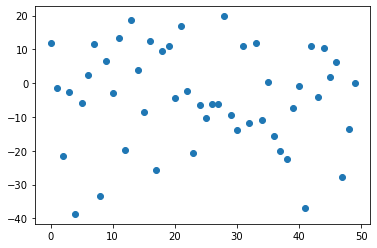

3.0289714
Traced<ConcreteArray(3.0289714)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0289714, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


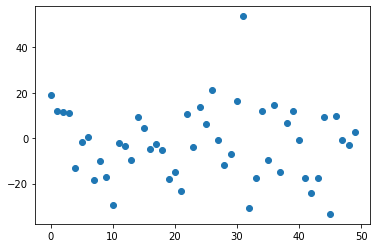

149139.05
Traced<ConcreteArray(149139.05)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(149139.05, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


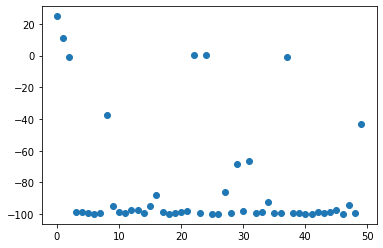

81901.97
Traced<ConcreteArray(81901.97)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(81901.97, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


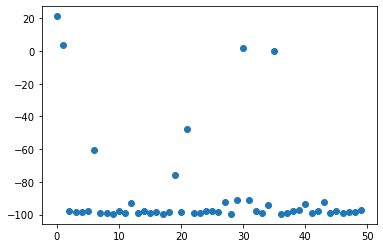

296.9639
Traced<ConcreteArray(296.9639)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(296.9639, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


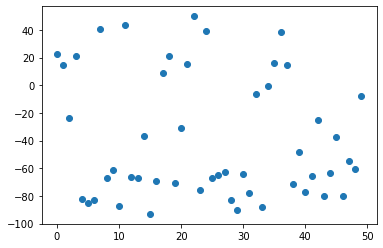

3796.8372
Traced<ConcreteArray(3796.8372)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3796.8372, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


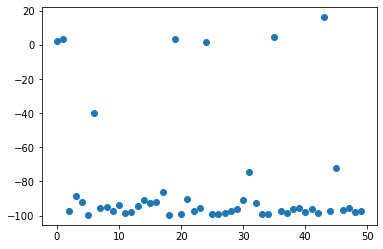

2.5241776
Traced<ConcreteArray(2.5241776)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5241776, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


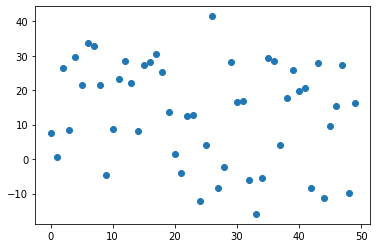

11.098601
Traced<ConcreteArray(11.098601)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(11.098601, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


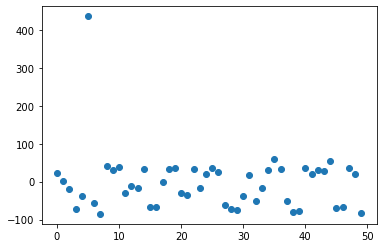

2.7131891
Traced<ConcreteArray(2.7131891)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7131891, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


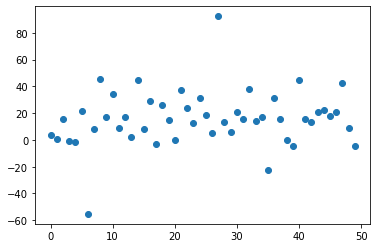

12.725296
Traced<ConcreteArray(12.725296)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(12.725296, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


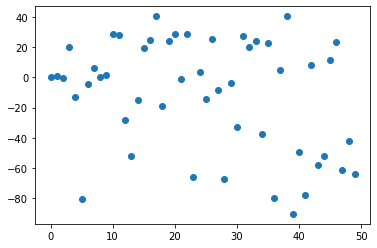

157377.03
Traced<ConcreteArray(157377.03)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(157377.03, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


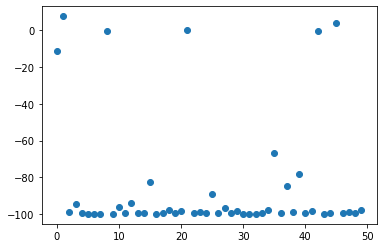

5663.13
Traced<ConcreteArray(5663.13)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5663.13, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


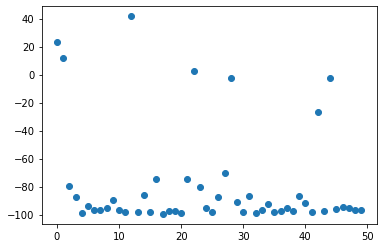

210885.28
Traced<ConcreteArray(210885.28)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(210885.28, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


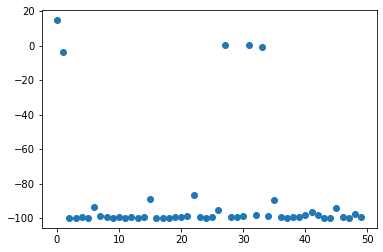

3034.37
Traced<ConcreteArray(3034.37)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3034.37, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


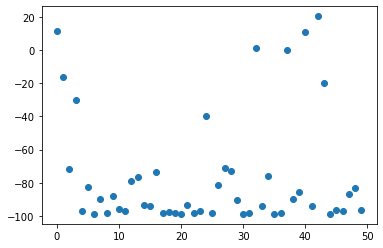

294743.8
Traced<ConcreteArray(294743.8)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(294743.8, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


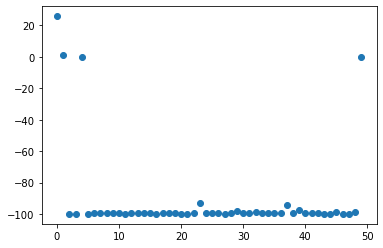

3.0116527
Traced<ConcreteArray(3.0116527)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0116527, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


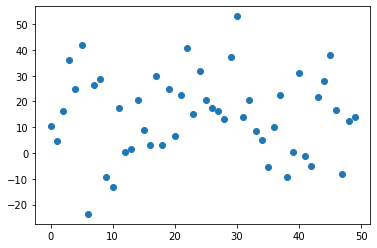

2.8928843
Traced<ConcreteArray(2.8928843)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8928843, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


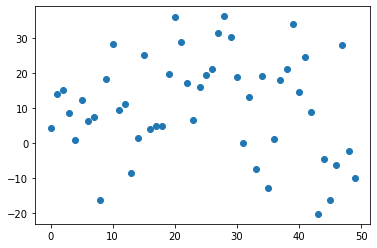

4.0544534
Traced<ConcreteArray(4.0544534)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.0544534, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


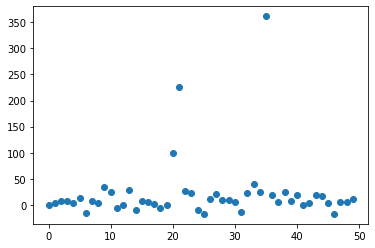

213237.61
Traced<ConcreteArray(213237.61)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(213237.61, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


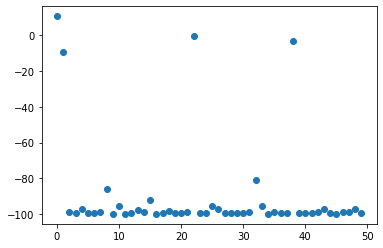

1325.8225
Traced<ConcreteArray(1325.8225)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1325.8225, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


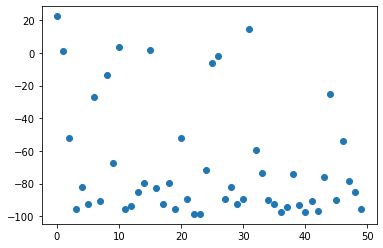

2.7759101
Traced<ConcreteArray(2.7759101)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7759101, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


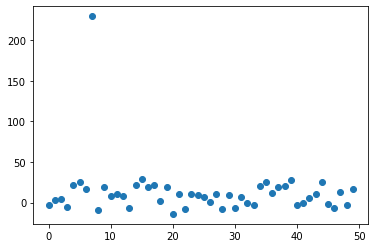

7.9070945
Traced<ConcreteArray(7.9070945)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.9070945, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


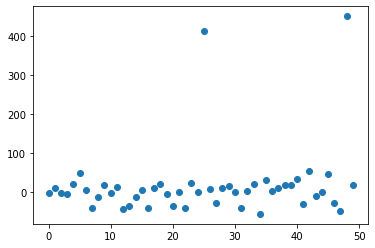

6.064908
Traced<ConcreteArray(6.064908)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.064908, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


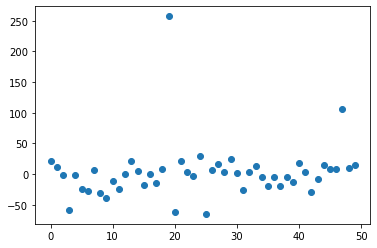

25292.604
Traced<ConcreteArray(25292.604)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(25292.604, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


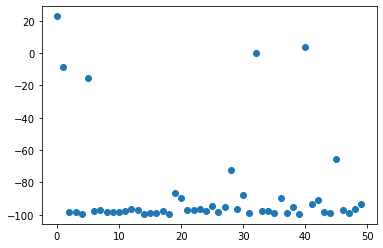

3.2315269
Traced<ConcreteArray(3.2315269)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2315269, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


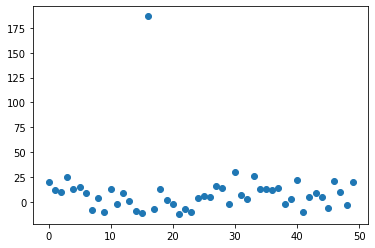

3.4351497
Traced<ConcreteArray(3.4351497)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4351497, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


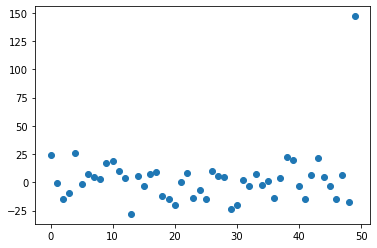

52.793755
Traced<ConcreteArray(52.793755)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(52.793755, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


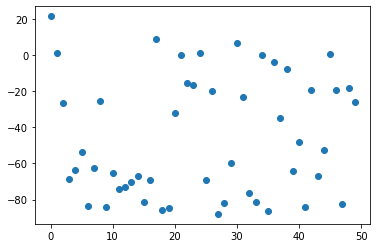

2.222887
Traced<ConcreteArray(2.222887)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.222887, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


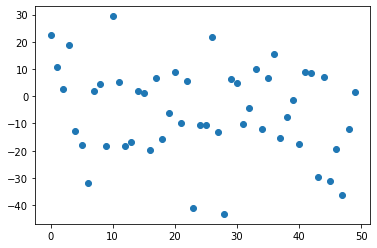

2017.693
Traced<ConcreteArray(2017.693)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2017.693, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


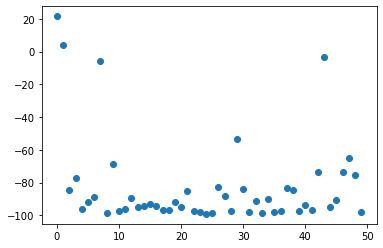

39.003826
Traced<ConcreteArray(39.003826)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(39.003826, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


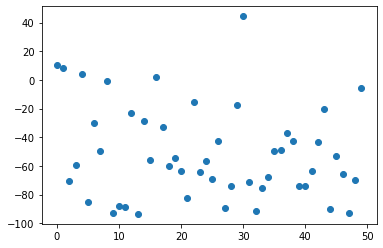

3.3709145
Traced<ConcreteArray(3.3709145)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3709145, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


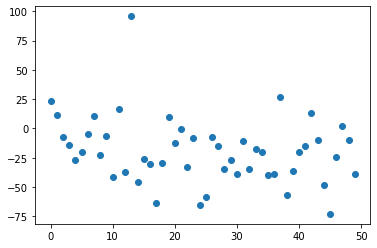

82.462296
Traced<ConcreteArray(82.462296)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(82.462296, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


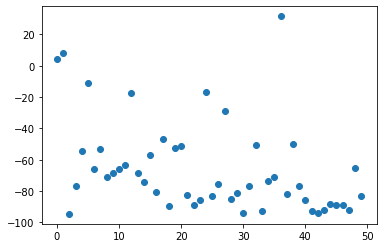

135.24617
Traced<ConcreteArray(135.24617)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(135.24617, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


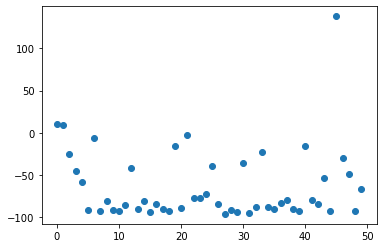

4.961418
Traced<ConcreteArray(4.961418)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.961418, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


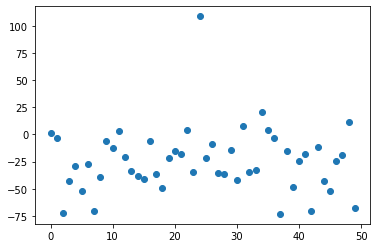

4.657579
Traced<ConcreteArray(4.657579)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.657579, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


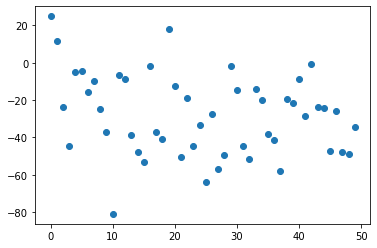

5.8124447
Traced<ConcreteArray(5.8124447)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.8124447, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


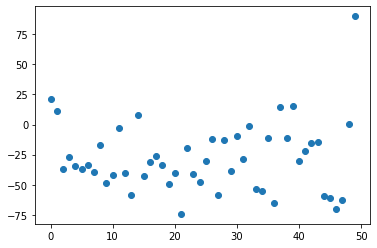

6.4180336
Traced<ConcreteArray(6.4180336)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.4180336, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


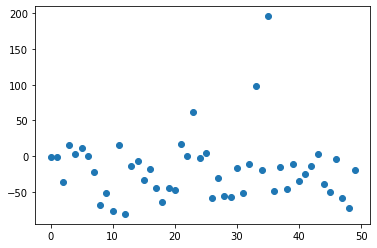

6.820096
Traced<ConcreteArray(6.820096)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.820096, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


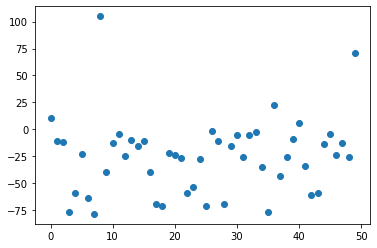

2.7993696
Traced<ConcreteArray(2.7993696)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7993696, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


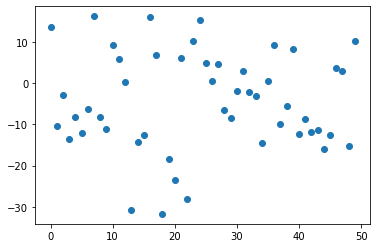

394.3042
Traced<ConcreteArray(394.3042)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(394.3042, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


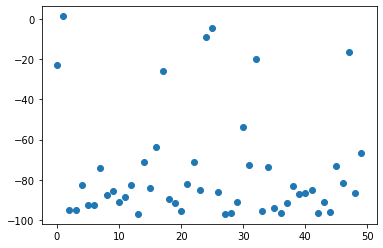

2.900372
Traced<ConcreteArray(2.900372)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.900372, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


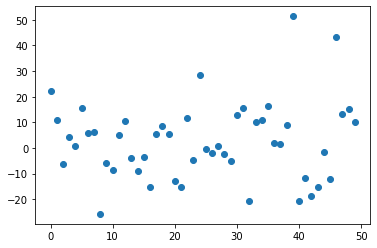

59544.67
Traced<ConcreteArray(59544.67)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(59544.67, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


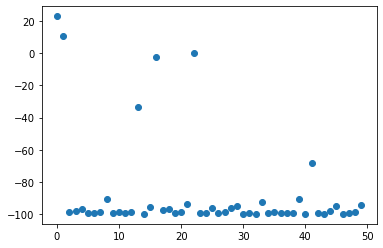

2.7786314
Traced<ConcreteArray(2.7786314)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7786314, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


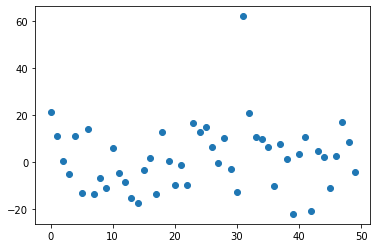

56047.05
Traced<ConcreteArray(56047.05)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(56047.05, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


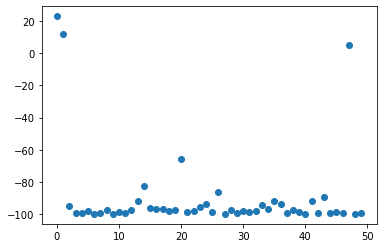

6.2624526
Traced<ConcreteArray(6.2624526)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.2624526, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


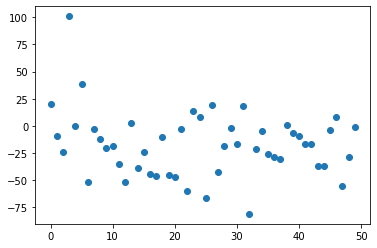

26946.9
Traced<ConcreteArray(26946.9)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(26946.9, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


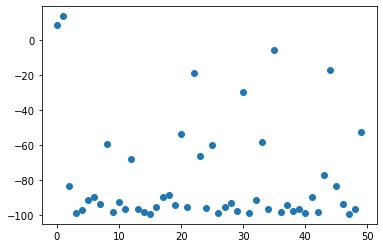

2.6271412
Traced<ConcreteArray(2.6271412)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6271412, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


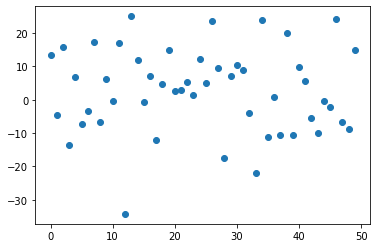

6.8012257
Traced<ConcreteArray(6.8012257)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.8012257, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


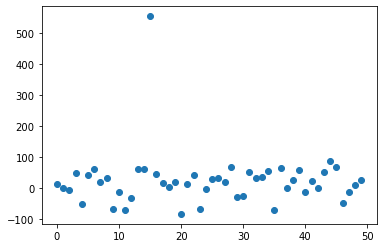

2.5474124
Traced<ConcreteArray(2.5474124)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5474124, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


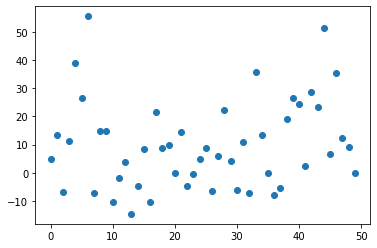

4.634082
Traced<ConcreteArray(4.634082)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.634082, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


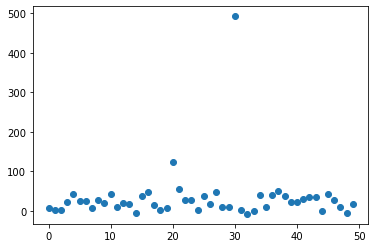

8898.432
Traced<ConcreteArray(8898.432)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(8898.432, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


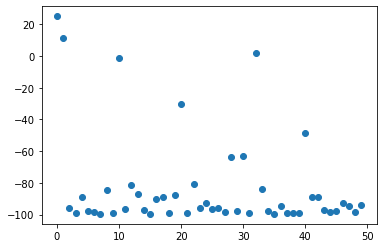

8373.9375
Traced<ConcreteArray(8373.9375)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(8373.9375, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


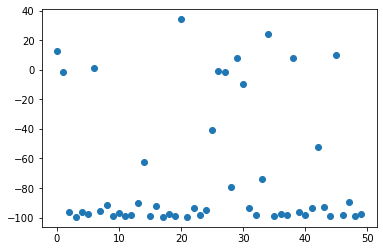

5.9087996
Traced<ConcreteArray(5.9087996)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.9087996, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


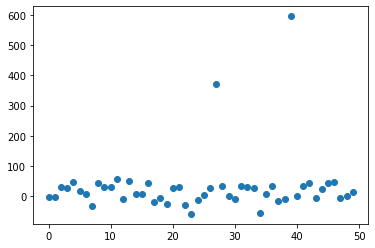

276.21964
Traced<ConcreteArray(276.21964)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(276.21964, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


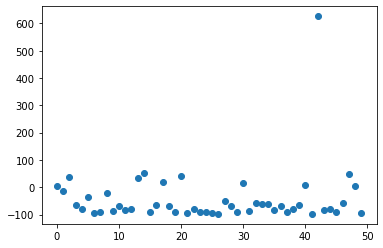

207.10599
Traced<ConcreteArray(207.10599)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(207.10599, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


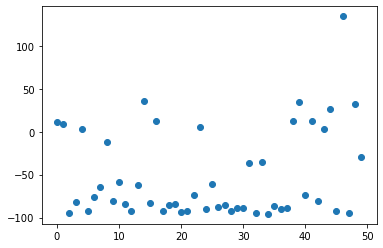

26802.17
Traced<ConcreteArray(26802.17)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(26802.17, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


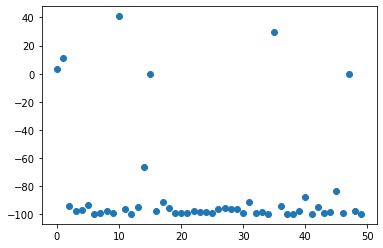

30355.441
Traced<ConcreteArray(30355.441)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(30355.441, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


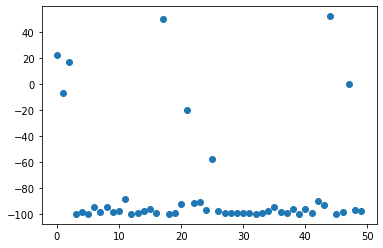

26659.898
Traced<ConcreteArray(26659.898)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(26659.898, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


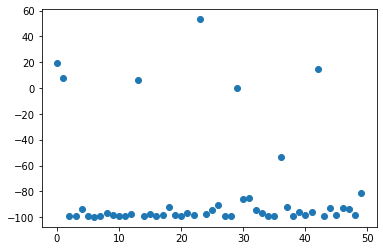

123.03
Traced<ConcreteArray(123.03)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(123.03, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


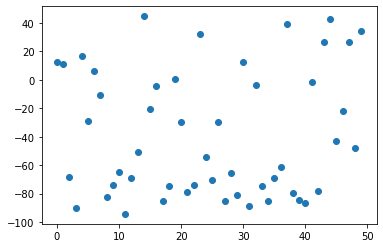

5353.511
Traced<ConcreteArray(5353.511)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5353.511, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


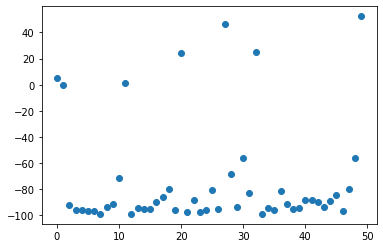

14.152011
Traced<ConcreteArray(14.152011)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(14.152011, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


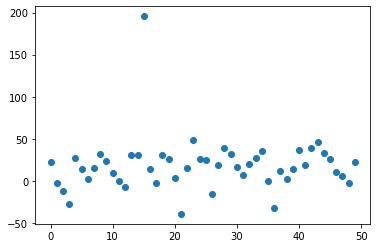

3.6355937
Traced<ConcreteArray(3.6355937)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6355937, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


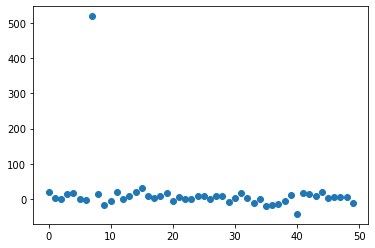

229.90753
Traced<ConcreteArray(229.90753)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(229.90753, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


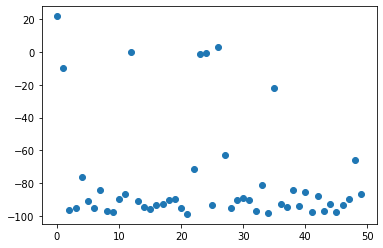

2.4400663
Traced<ConcreteArray(2.4400663)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4400663, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


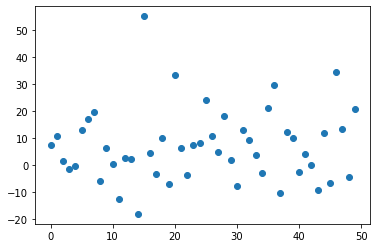

6612.1436
Traced<ConcreteArray(6612.1436)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6612.1436, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


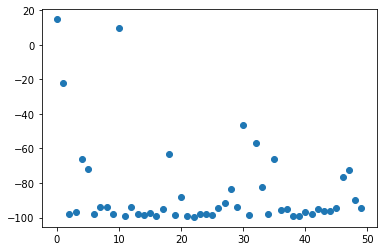

58.781906
Traced<ConcreteArray(58.781906)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(58.781906, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


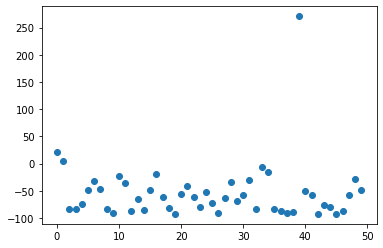

2.5467615
Traced<ConcreteArray(2.5467615)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5467615, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


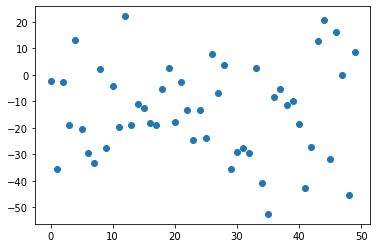

82.01014
Traced<ConcreteArray(82.01014)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(82.01014, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


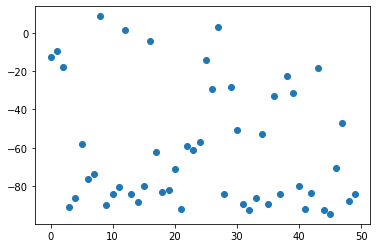

2.627366
Traced<ConcreteArray(2.627366)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.627366, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


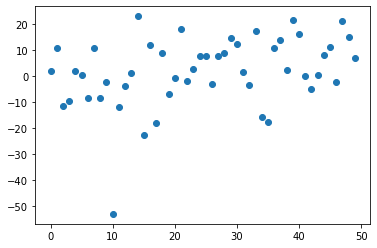

4.243797
Traced<ConcreteArray(4.243797)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.243797, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


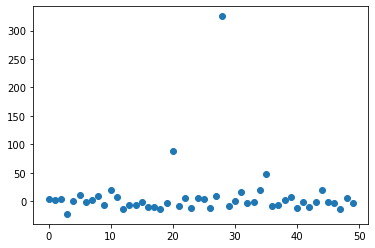

2.3815198
Traced<ConcreteArray(2.3815198)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3815198, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


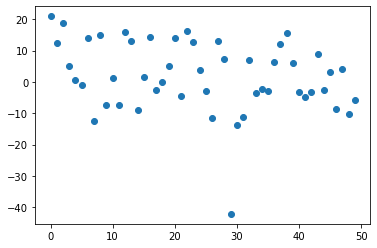

5.0057983
Traced<ConcreteArray(5.0057983)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.0057983, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


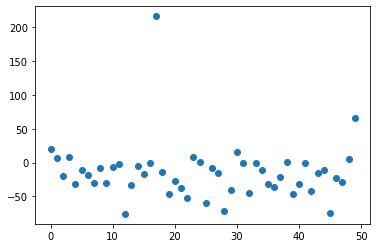

14215.615
Traced<ConcreteArray(14215.615)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(14215.615, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


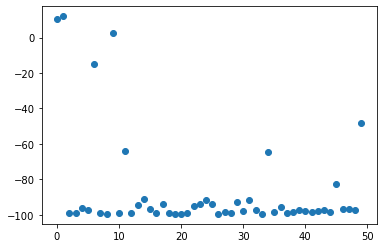

4.396806
Traced<ConcreteArray(4.396806)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.396806, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


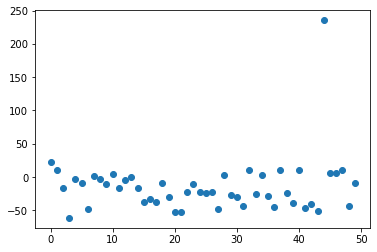

5781.32
Traced<ConcreteArray(5781.32)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5781.32, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


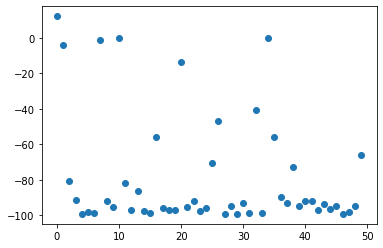

2.3816085
Traced<ConcreteArray(2.3816085)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3816085, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


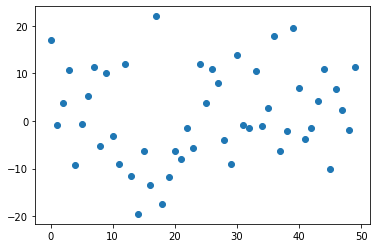

2.640536
Traced<ConcreteArray(2.640536)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.640536, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


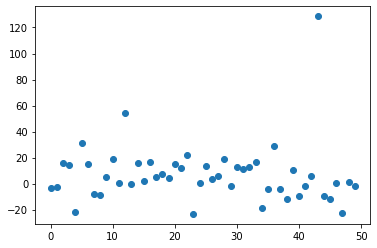

85.31888
Traced<ConcreteArray(85.31888)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(85.31888, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


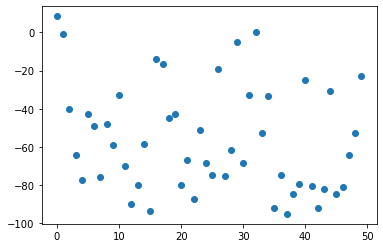

66.491104
Traced<ConcreteArray(66.491104)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(66.491104, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


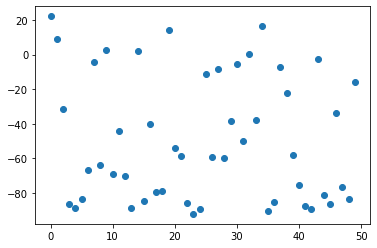

1747.6462
Traced<ConcreteArray(1747.6462)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1747.6462, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


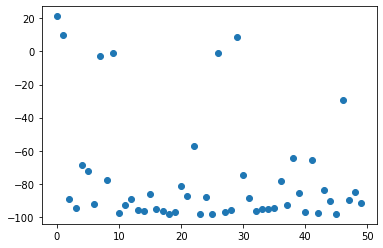

2.5244713
Traced<ConcreteArray(2.5244713)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5244713, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


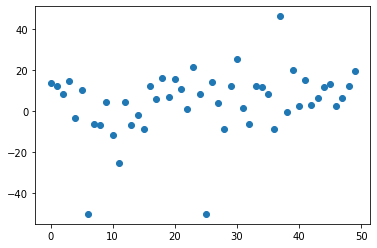

29.025154
Traced<ConcreteArray(29.025154)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(29.025154, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


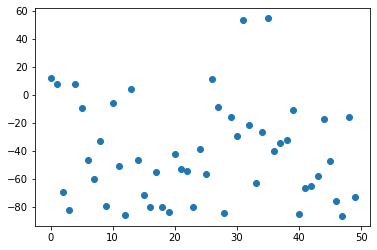

2.7544901
Traced<ConcreteArray(2.7544901)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7544901, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


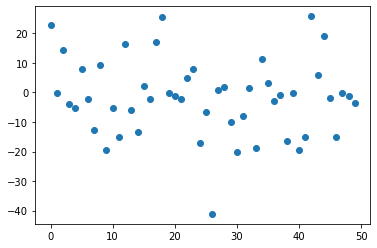

13.226785
Traced<ConcreteArray(13.226785)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(13.226785, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


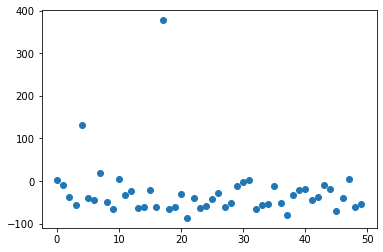

2.6444814
Traced<ConcreteArray(2.6444814)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6444814, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


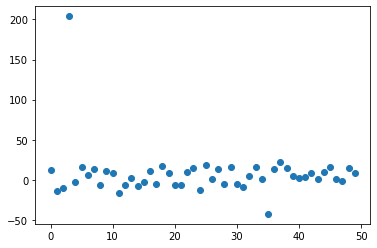

3.5142493
Traced<ConcreteArray(3.5142493)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5142493, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


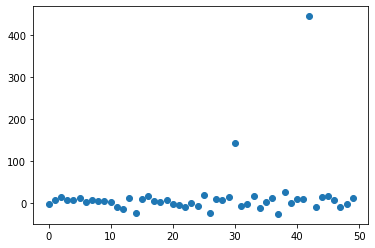

2.4581127
Traced<ConcreteArray(2.4581127)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4581127, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


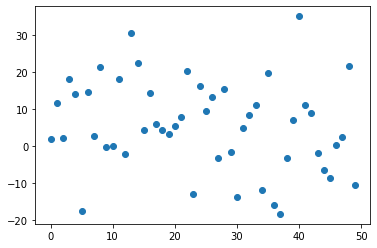

2.5770097
Traced<ConcreteArray(2.5770097)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5770097, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


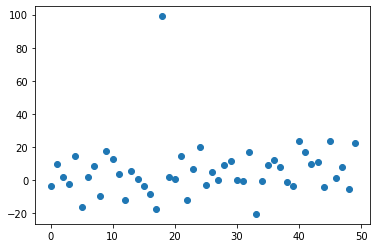

2.7463949
Traced<ConcreteArray(2.7463949)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7463949, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


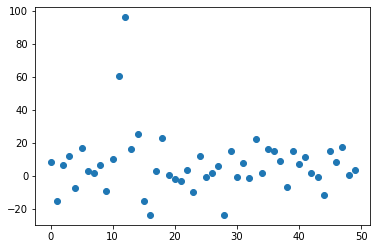

2.8746738
Traced<ConcreteArray(2.8746738)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8746738, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


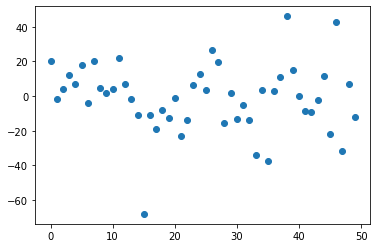

2.9789581
Traced<ConcreteArray(2.9789581)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9789581, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


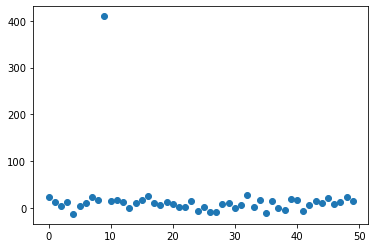

2.7329497
Traced<ConcreteArray(2.7329497)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7329497, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


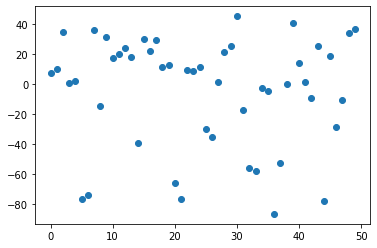

2.7498913
Traced<ConcreteArray(2.7498913)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7498913, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


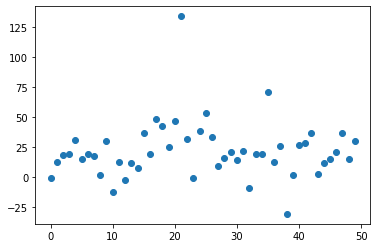

3.5719905
Traced<ConcreteArray(3.5719905)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5719905, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


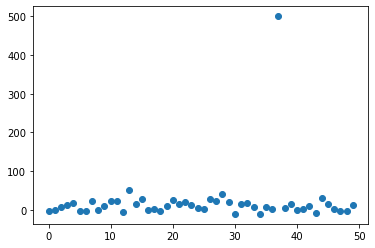

38.007107
Traced<ConcreteArray(38.007107)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(38.007107, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


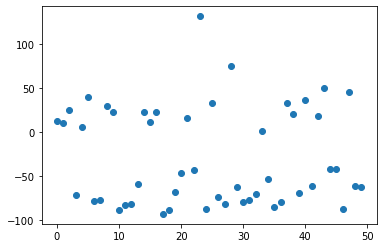

3.3432012
Traced<ConcreteArray(3.3432012)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3432012, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


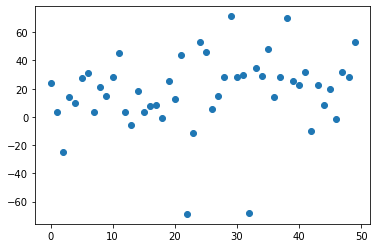

98.20146
Traced<ConcreteArray(98.20146)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(98.20146, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


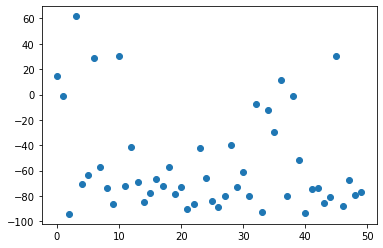

2.6575942
Traced<ConcreteArray(2.6575942)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6575942, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


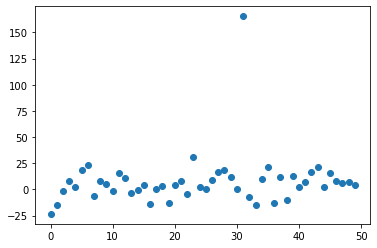

107.65799
Traced<ConcreteArray(107.65799)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(107.65799, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


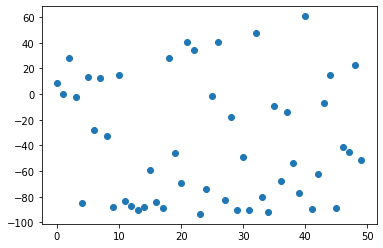

71.54644
Traced<ConcreteArray(71.54644)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(71.54644, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


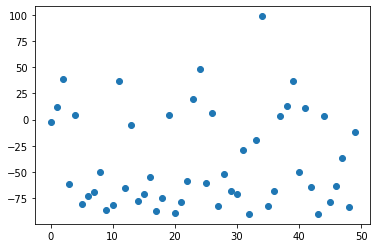

81.0488
Traced<ConcreteArray(81.0488)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(81.0488, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


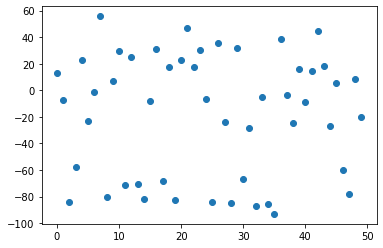

3.735544
Traced<ConcreteArray(3.735544)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.735544, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


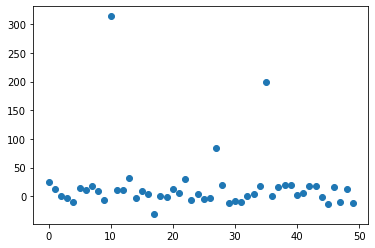

2.9315834
Traced<ConcreteArray(2.9315834)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9315834, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


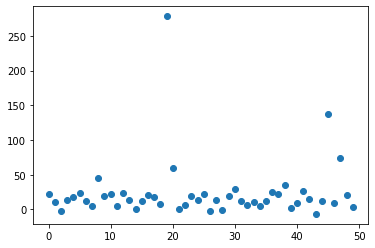

6.232742
Traced<ConcreteArray(6.232742)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.232742, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


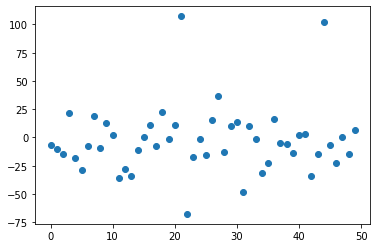

2.532686
Traced<ConcreteArray(2.532686)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.532686, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


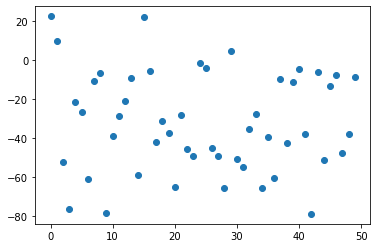

3.6020393
Traced<ConcreteArray(3.6020393)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6020393, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


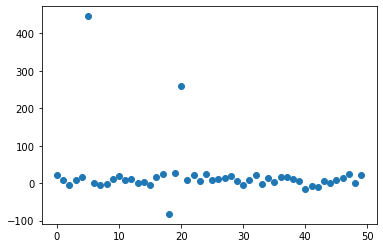

2.8158967
Traced<ConcreteArray(2.8158967)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8158967, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


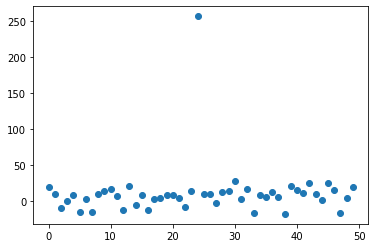

2.2344086
Traced<ConcreteArray(2.2344086)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2344086, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


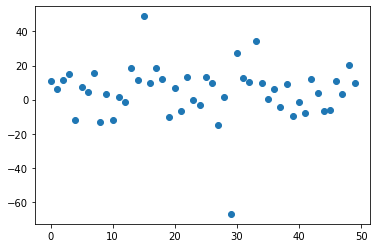

2.5756483
Traced<ConcreteArray(2.5756483)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5756483, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


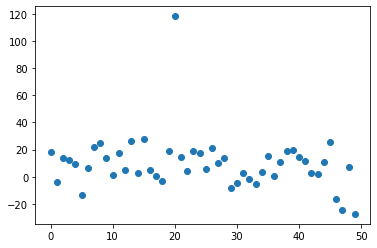

2.3421535
Traced<ConcreteArray(2.3421535)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3421535, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


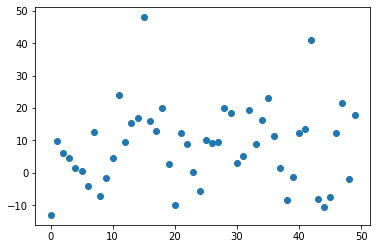

3.1173496
Traced<ConcreteArray(3.1173496)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1173496, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


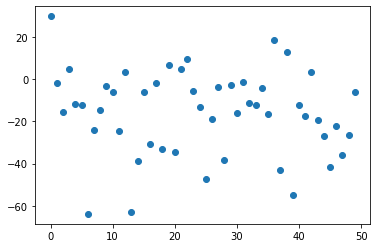

84.8784
Traced<ConcreteArray(84.8784)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(84.8784, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


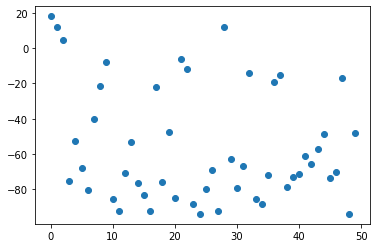

187.53734
Traced<ConcreteArray(187.53734)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(187.53734, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


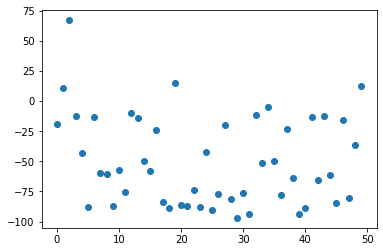

2.4694796
Traced<ConcreteArray(2.4694796)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4694796, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


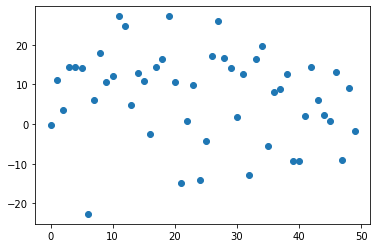

2.7395866
Traced<ConcreteArray(2.7395866)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7395866, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


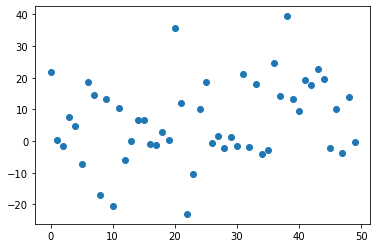

2.6236463
Traced<ConcreteArray(2.6236463)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6236463, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


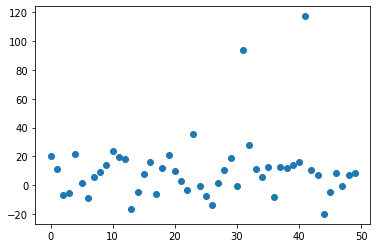

2.3954432
Traced<ConcreteArray(2.3954432)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3954432, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


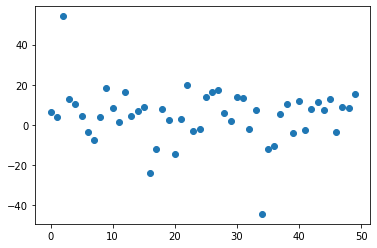

2.4564574
Traced<ConcreteArray(2.4564574)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4564574, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


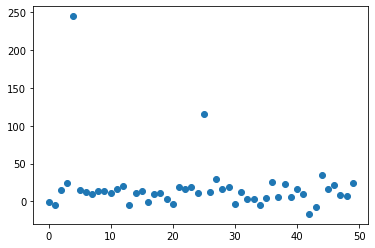

2.5874772
Traced<ConcreteArray(2.5874772)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5874772, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


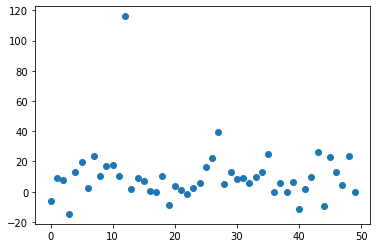

3.178326
Traced<ConcreteArray(3.178326)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.178326, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


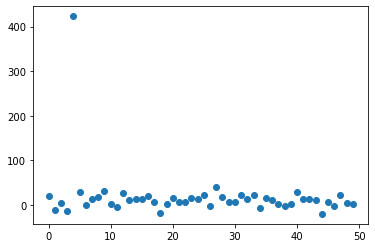

13.583601
Traced<ConcreteArray(13.583601)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(13.583601, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


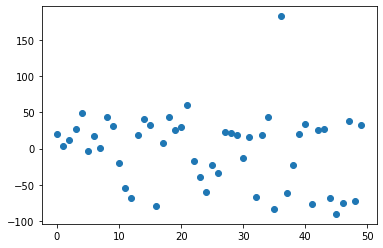

3.5537255
Traced<ConcreteArray(3.5537255)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5537255, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


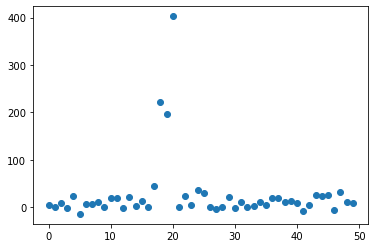

14.056513
Traced<ConcreteArray(14.056513)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(14.056513, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


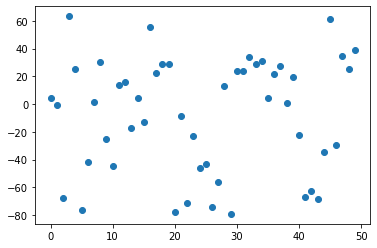

39.854565
Traced<ConcreteArray(39.854565)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(39.854565, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


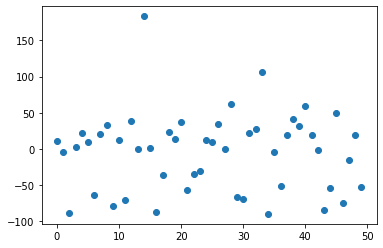

20.87137
Traced<ConcreteArray(20.87137)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(20.87137, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


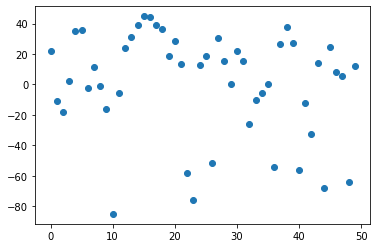

2.5476158
Traced<ConcreteArray(2.5476158)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5476158, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


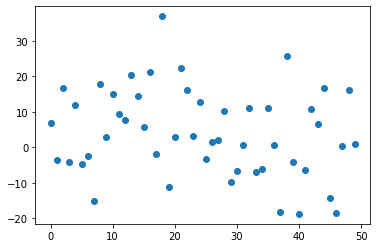

4.2328553
Traced<ConcreteArray(4.2328553)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.2328553, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


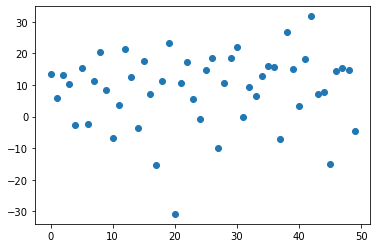

3.2596827
Traced<ConcreteArray(3.2596827)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2596827, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


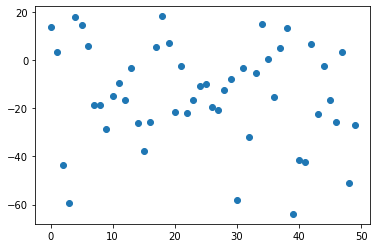

4.5809383
Traced<ConcreteArray(4.5809383)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.5809383, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


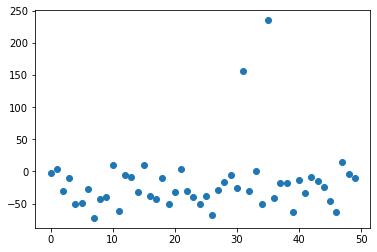

4.403353
Traced<ConcreteArray(4.403353)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.403353, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


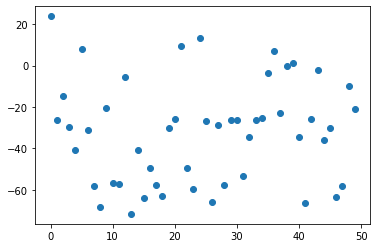

2.7077436
Traced<ConcreteArray(2.7077436)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7077436, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


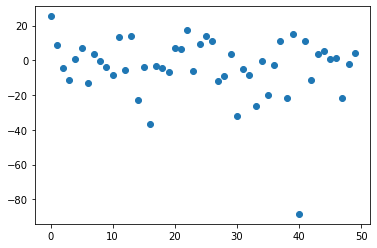

12.156567
Traced<ConcreteArray(12.156567)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(12.156567, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


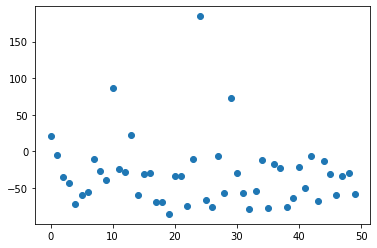

2.7131429
Traced<ConcreteArray(2.7131429)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7131429, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


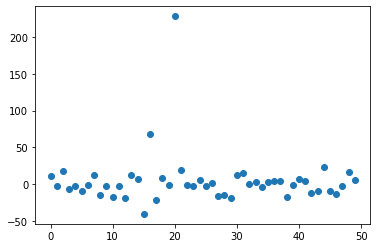

13.243285
Traced<ConcreteArray(13.243285)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(13.243285, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


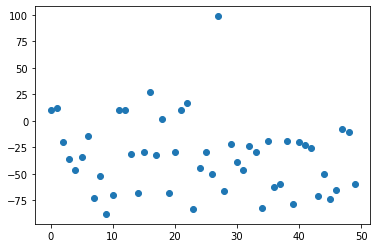

2.8510206
Traced<ConcreteArray(2.8510206)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8510206, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


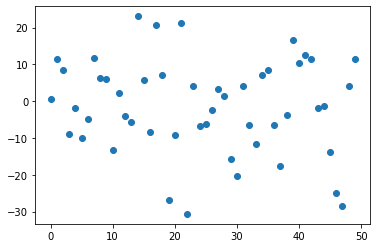

9.533421
Traced<ConcreteArray(9.533421)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(9.533421, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


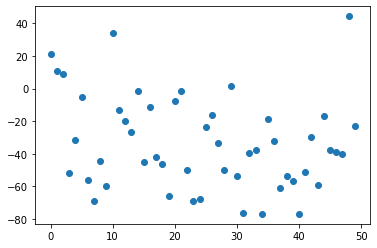

2.9761133
Traced<ConcreteArray(2.9761133)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9761133, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


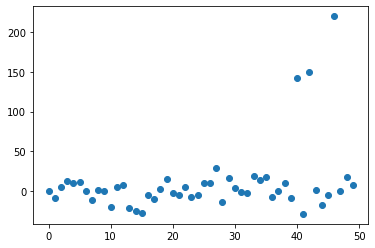

2.7849736
Traced<ConcreteArray(2.7849736)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7849736, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


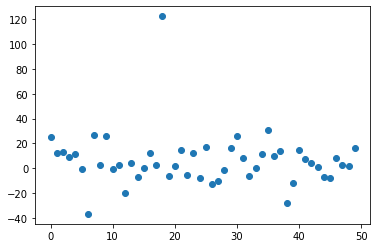

3.2696443
Traced<ConcreteArray(3.2696443)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2696443, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


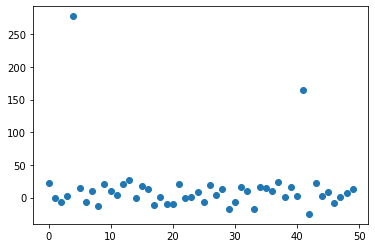

4.998924
Traced<ConcreteArray(4.998924)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.998924, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


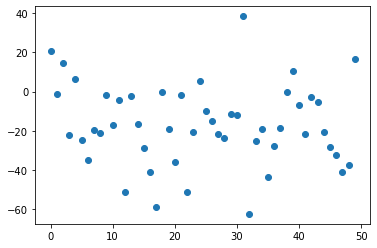

2.984664
Traced<ConcreteArray(2.984664)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.984664, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


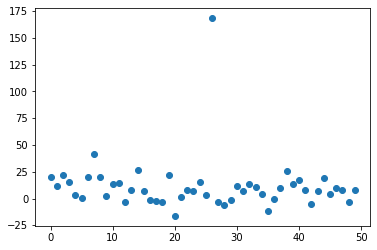

3.195261
Traced<ConcreteArray(3.195261)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.195261, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


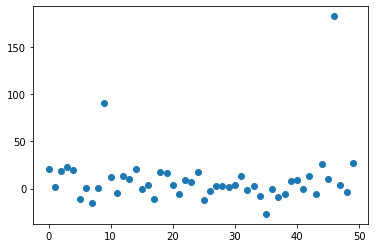

2.963241
Traced<ConcreteArray(2.963241)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.963241, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


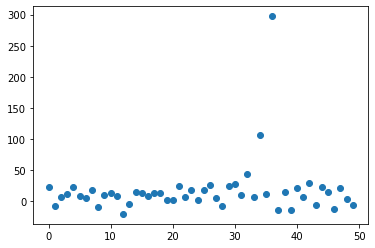

2.416101
Traced<ConcreteArray(2.416101)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.416101, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


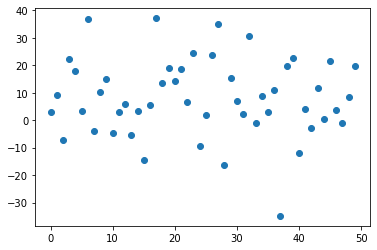

3.420127
Traced<ConcreteArray(3.420127)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.420127, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


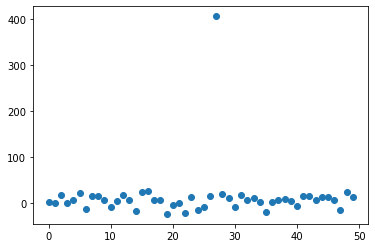

2.7702656
Traced<ConcreteArray(2.7702656)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7702656, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


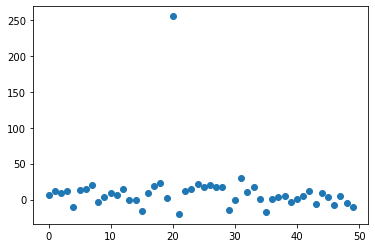

2.867475
Traced<ConcreteArray(2.867475)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.867475, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


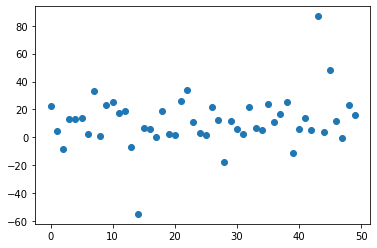

2.2621863
Traced<ConcreteArray(2.2621863)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2621863, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


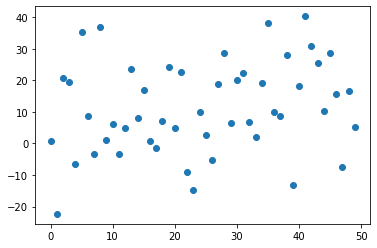

3.0423906
Traced<ConcreteArray(3.0423906)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0423906, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


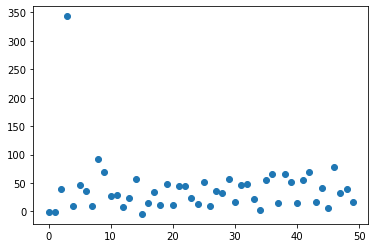

2.608996
Traced<ConcreteArray(2.608996)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.608996, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


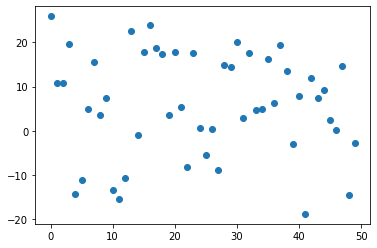

2.90952
Traced<ConcreteArray(2.90952)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.90952, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


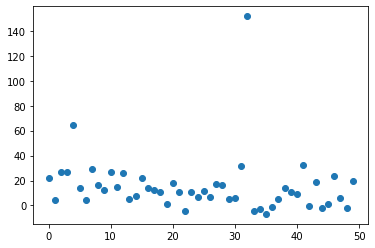

4.374001
Traced<ConcreteArray(4.374001)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.374001, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


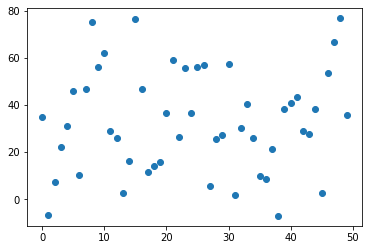

2.7601511
Traced<ConcreteArray(2.7601511)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7601511, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


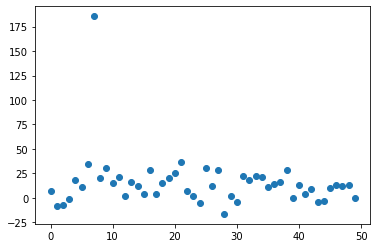

2.3093598
Traced<ConcreteArray(2.3093598)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3093598, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


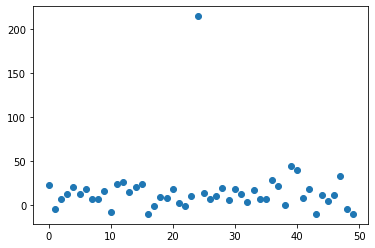

2.992422
Traced<ConcreteArray(2.992422)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.992422, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


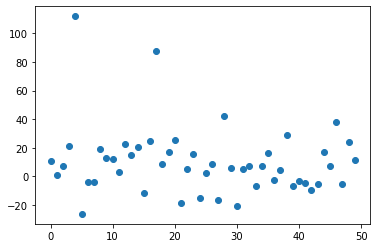

2.7952278
Traced<ConcreteArray(2.7952278)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7952278, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


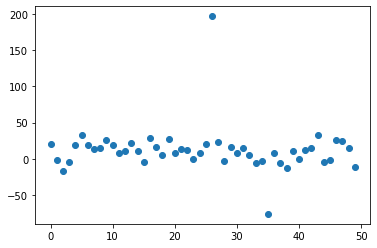

5.856216
Traced<ConcreteArray(5.856216)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.856216, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


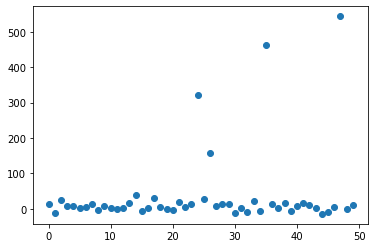

2.3637483
Traced<ConcreteArray(2.3637483)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3637483, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


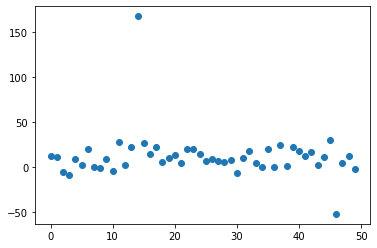

3.4043837
Traced<ConcreteArray(3.4043837)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4043837, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


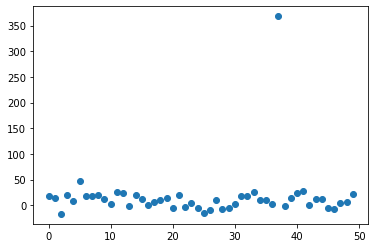

2.7469993
Traced<ConcreteArray(2.7469993)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7469993, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


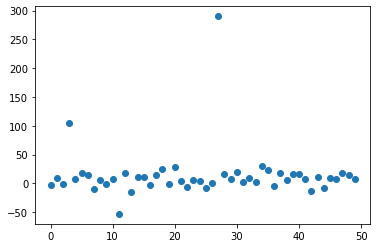

3.3291478
Traced<ConcreteArray(3.3291478)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3291478, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


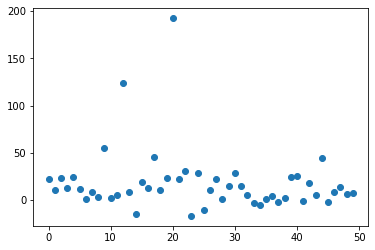

2.7037158
Traced<ConcreteArray(2.7037158)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7037158, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


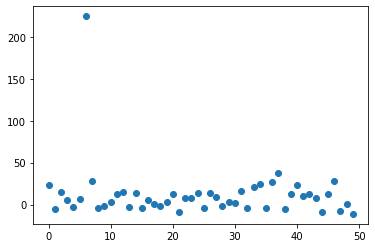

2.8822832
Traced<ConcreteArray(2.8822832)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8822832, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


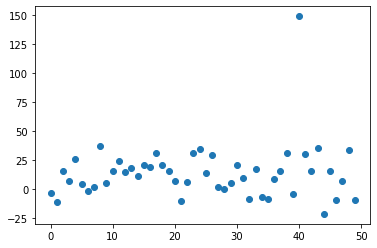

2.6566281
Traced<ConcreteArray(2.6566281)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6566281, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


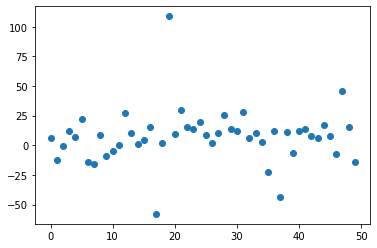

3.1740603
Traced<ConcreteArray(3.1740603)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1740603, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


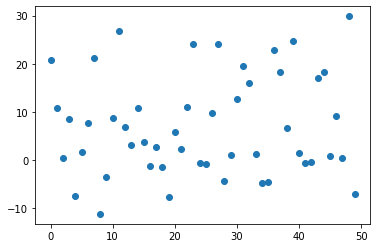

2.8272026
Traced<ConcreteArray(2.8272026)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8272026, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


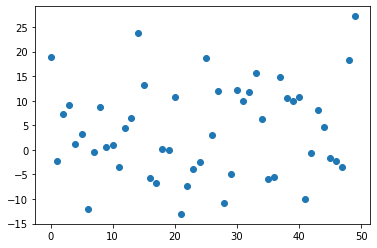

2.5329118
Traced<ConcreteArray(2.5329118)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5329118, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


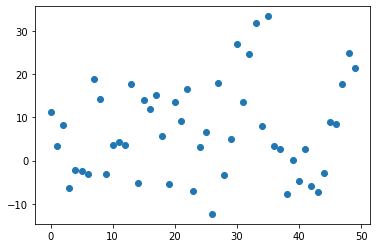

3.9204135
Traced<ConcreteArray(3.9204135)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9204135, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


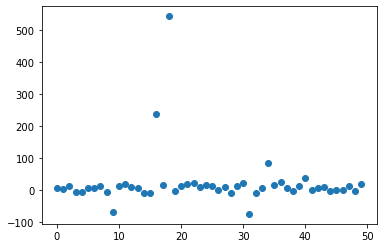

2.0255654
Traced<ConcreteArray(2.0255654)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.0255654, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


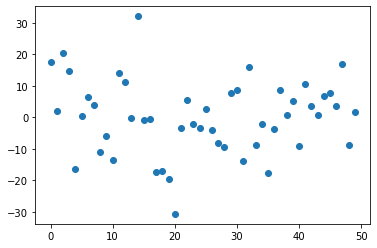

2.6239061
Traced<ConcreteArray(2.6239061)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6239061, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


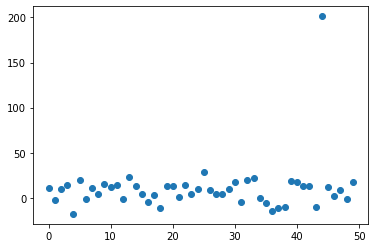

3.033906
Traced<ConcreteArray(3.033906)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.033906, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


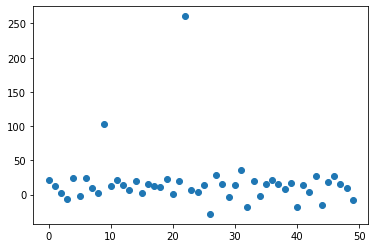

2.657635
Traced<ConcreteArray(2.657635)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.657635, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


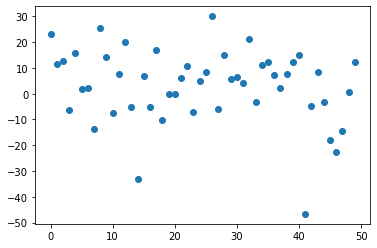

2.5026362
Traced<ConcreteArray(2.5026362)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5026362, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


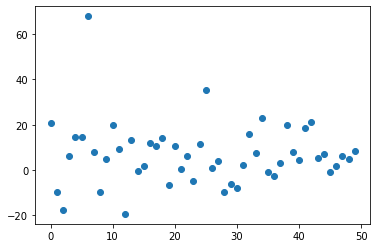

3.0707364
Traced<ConcreteArray(3.0707364)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0707364, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


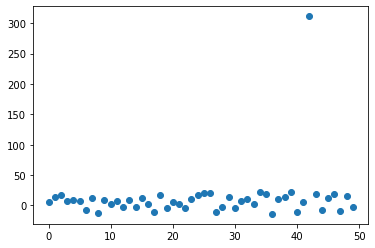

3.0614924
Traced<ConcreteArray(3.0614924)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0614924, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


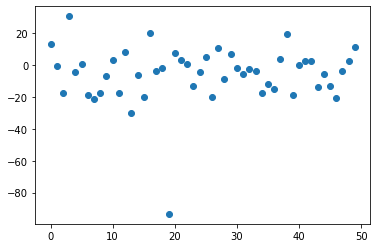

2.9809742
Traced<ConcreteArray(2.9809742)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9809742, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


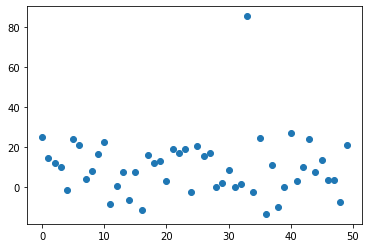

4.0453377
Traced<ConcreteArray(4.0453377)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.0453377, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


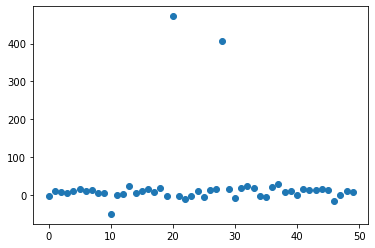

3.3426285
Traced<ConcreteArray(3.3426285)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3426285, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


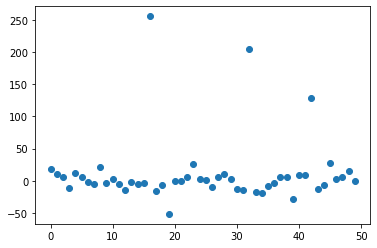

2.6353922
Traced<ConcreteArray(2.6353922)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6353922, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


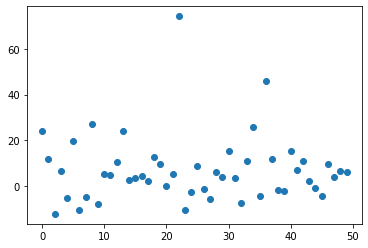

2.2888298
Traced<ConcreteArray(2.2888298)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2888298, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


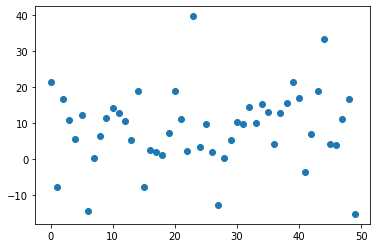

2.8501515
Traced<ConcreteArray(2.8501515)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8501515, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


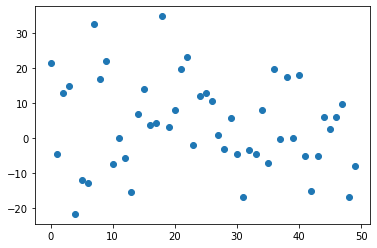

2.32231
Traced<ConcreteArray(2.32231)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.32231, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


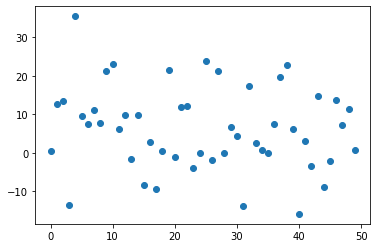

5.32467
Traced<ConcreteArray(5.32467)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.32467, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


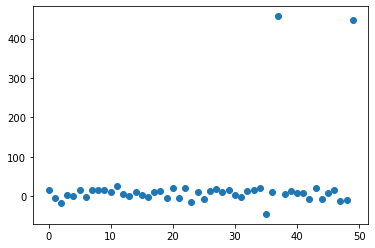

2.5219333
Traced<ConcreteArray(2.5219333)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5219333, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


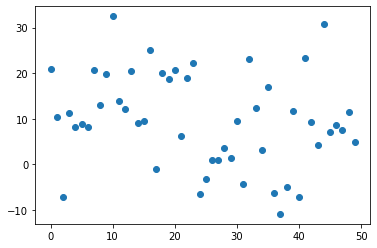

2.4243088
Traced<ConcreteArray(2.4243088)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4243088, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


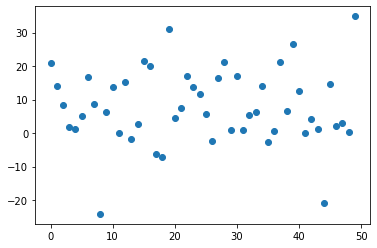

2.6097994
Traced<ConcreteArray(2.6097994)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6097994, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


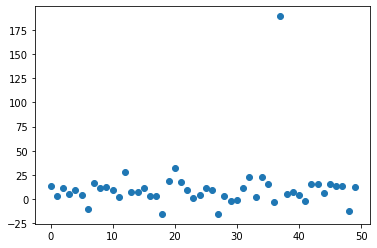

2.4196434
Traced<ConcreteArray(2.4196434)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4196434, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


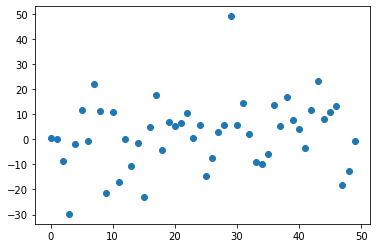

3.1616502
Traced<ConcreteArray(3.1616502)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1616502, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


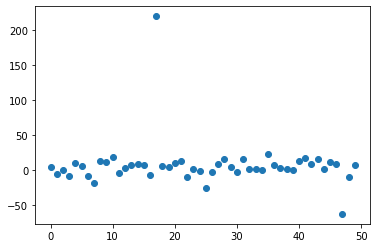

2.3639052
Traced<ConcreteArray(2.3639052)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3639052, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


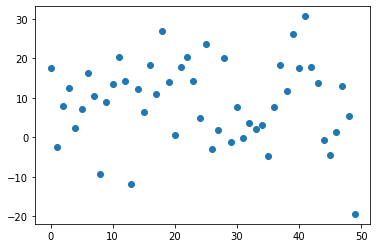

2.6505802
Traced<ConcreteArray(2.6505802)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6505802, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


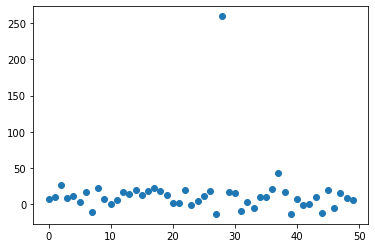

2.6924734
Traced<ConcreteArray(2.6924734)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6924734, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


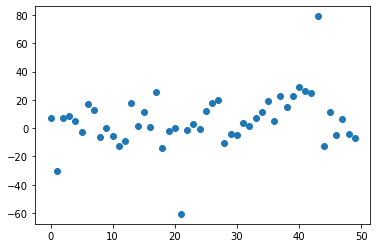

2.972098
Traced<ConcreteArray(2.972098)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.972098, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


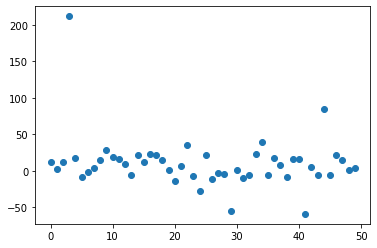

2.7612576
Traced<ConcreteArray(2.7612576)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7612576, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


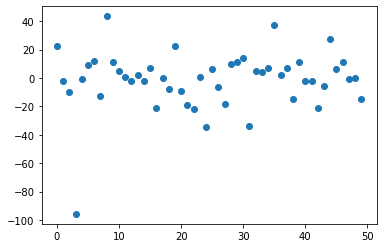

2.7027624
Traced<ConcreteArray(2.7027624)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7027624, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


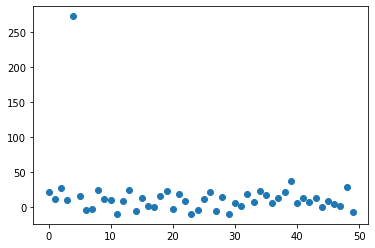

2.3086324
Traced<ConcreteArray(2.3086324)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3086324, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


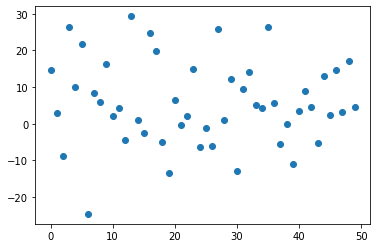

2.7660966
Traced<ConcreteArray(2.7660966)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7660966, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


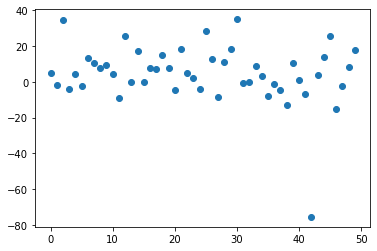

4.1117234
Traced<ConcreteArray(4.1117234)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.1117234, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


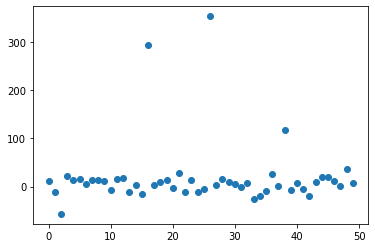

2.8326354
Traced<ConcreteArray(2.8326354)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8326354, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


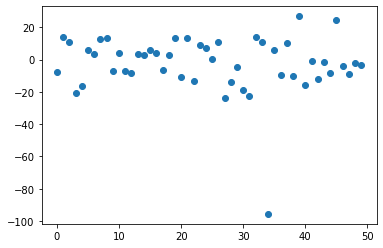

2.905517
Traced<ConcreteArray(2.905517)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.905517, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


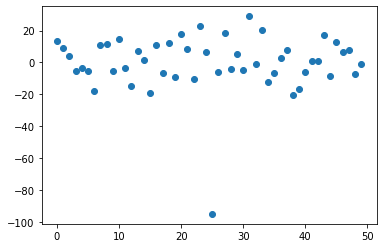

2.5332644
Traced<ConcreteArray(2.5332644)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5332644, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


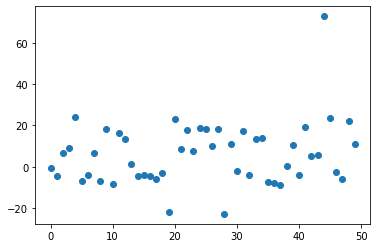

2.104646
Traced<ConcreteArray(2.104646)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.104646, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


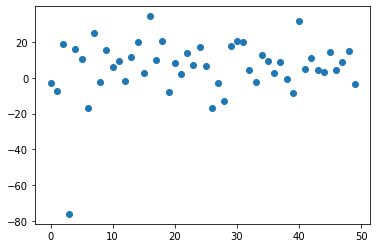

3.357667
Traced<ConcreteArray(3.357667)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.357667, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


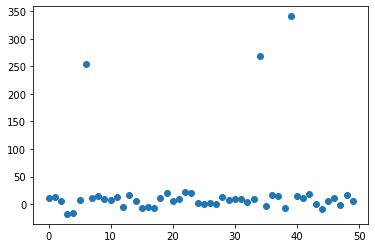

3.2309604
Traced<ConcreteArray(3.2309604)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2309604, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


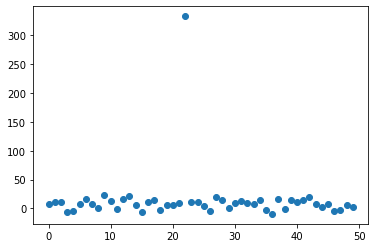

2.4752028
Traced<ConcreteArray(2.4752028)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4752028, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


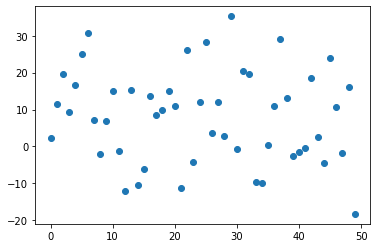

3.557201
Traced<ConcreteArray(3.557201)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.557201, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


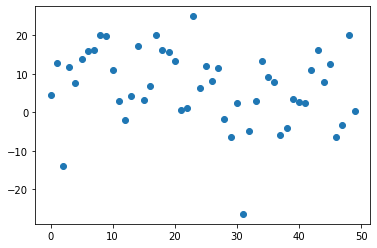

2.6968646
Traced<ConcreteArray(2.6968646)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6968646, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


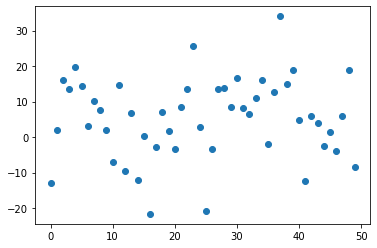

2.3012705
Traced<ConcreteArray(2.3012705)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3012705, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


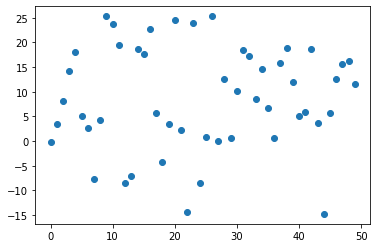

3.583373
Traced<ConcreteArray(3.583373)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.583373, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


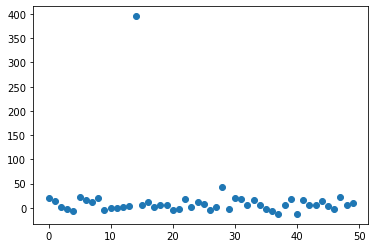

2.385017
Traced<ConcreteArray(2.385017)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.385017, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


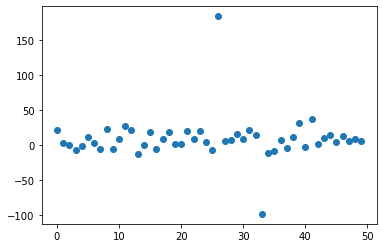

2.5828543
Traced<ConcreteArray(2.5828543)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5828543, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


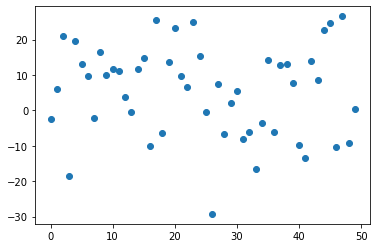

2.56406
Traced<ConcreteArray(2.56406)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.56406, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


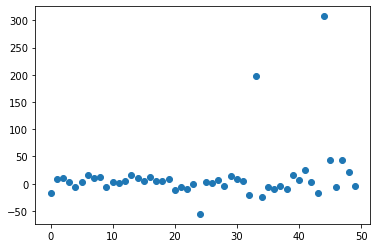

3.453056
Traced<ConcreteArray(3.453056)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.453056, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


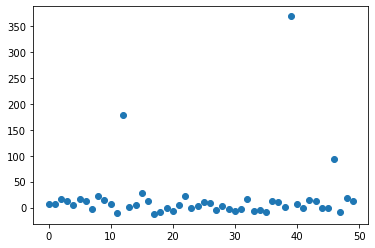

3.1022422
Traced<ConcreteArray(3.1022422)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1022422, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


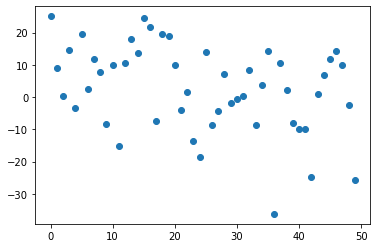

2.25316
Traced<ConcreteArray(2.25316)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.25316, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


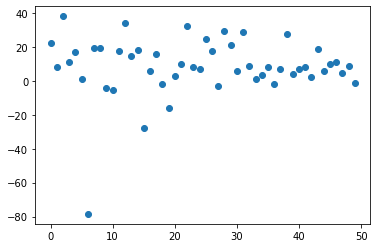

2.7556493
Traced<ConcreteArray(2.7556493)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7556493, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


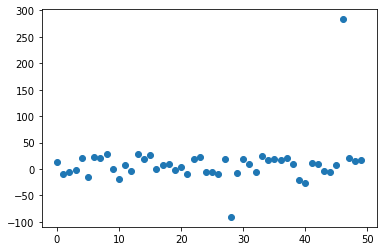

3.012779
Traced<ConcreteArray(3.012779)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.012779, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


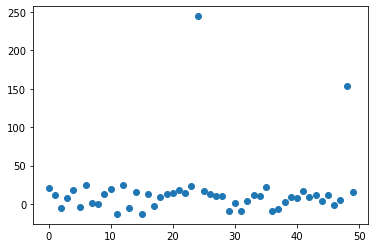

2.4172974
Traced<ConcreteArray(2.4172974)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4172974, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


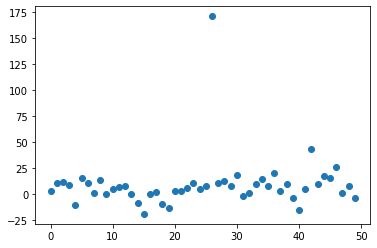

2.9602172
Traced<ConcreteArray(2.9602172)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9602172, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


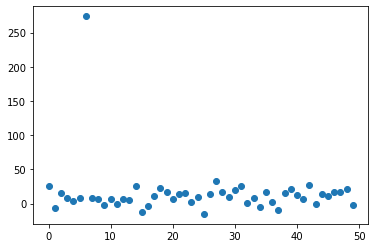

2.1291888
Traced<ConcreteArray(2.1291888)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1291888, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


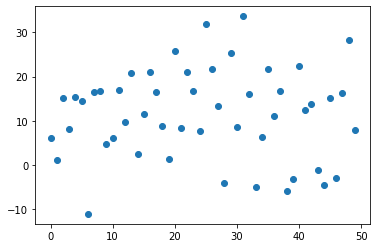

2.6105332
Traced<ConcreteArray(2.6105332)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6105332, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


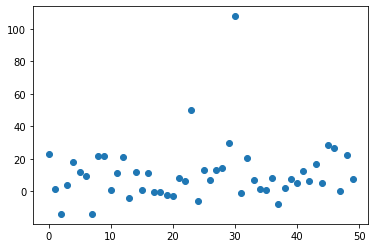

2.3028266
Traced<ConcreteArray(2.3028266)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3028266, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


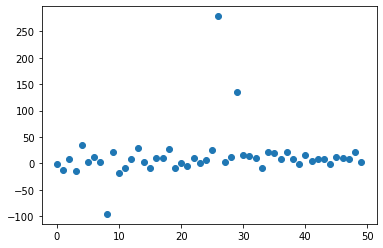

3.3775227
Traced<ConcreteArray(3.3775227)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3775227, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


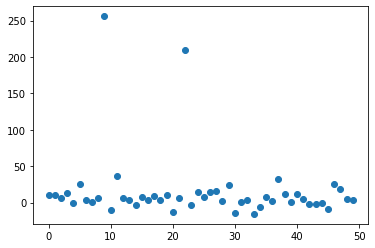

2.4756324
Traced<ConcreteArray(2.4756324)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4756324, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


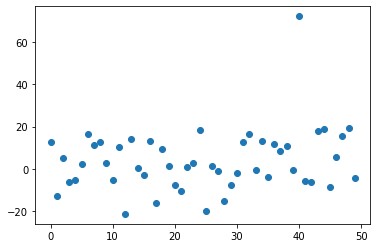

3.3138752
Traced<ConcreteArray(3.3138752)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3138752, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


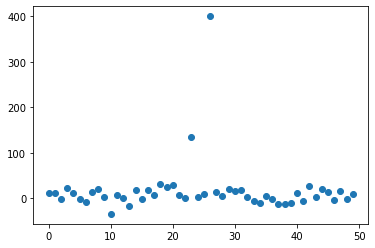

2.2206402
Traced<ConcreteArray(2.2206402)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2206402, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


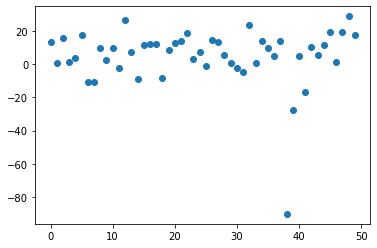

2.8799503
Traced<ConcreteArray(2.8799503)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8799503, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


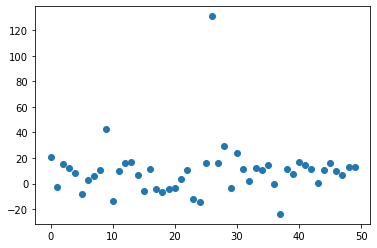

2.6325145
Traced<ConcreteArray(2.6325145)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6325145, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


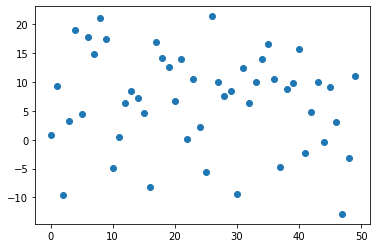

2.4893036
Traced<ConcreteArray(2.4893036)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4893036, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


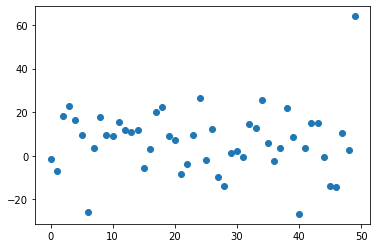

3.348116
Traced<ConcreteArray(3.348116)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.348116, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


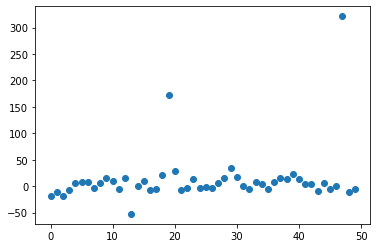

2.9997933
Traced<ConcreteArray(2.9997933)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9997933, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


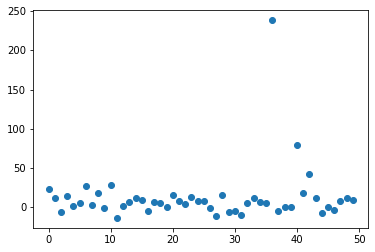

2.7464178
Traced<ConcreteArray(2.7464178)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7464178, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


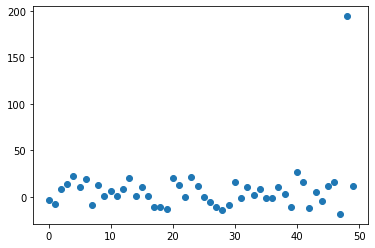

2.4515443
Traced<ConcreteArray(2.4515443)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4515443, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


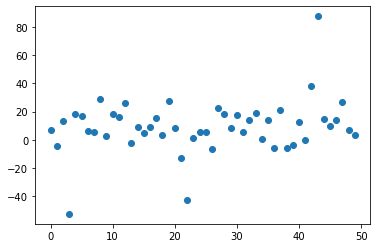

3.7977142
Traced<ConcreteArray(3.7977142)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.7977142, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


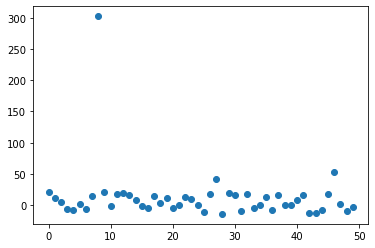

2.3983374
Traced<ConcreteArray(2.3983374)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3983374, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


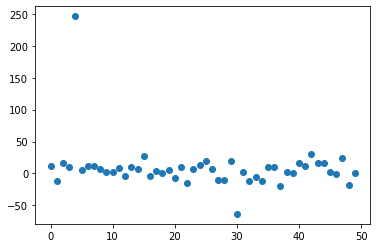

2.5499506
Traced<ConcreteArray(2.5499506)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5499506, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


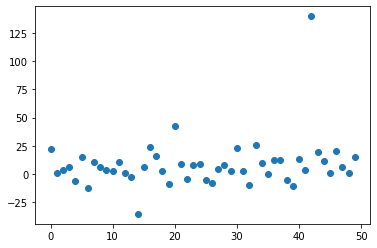

2.4505467
Traced<ConcreteArray(2.4505467)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4505467, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


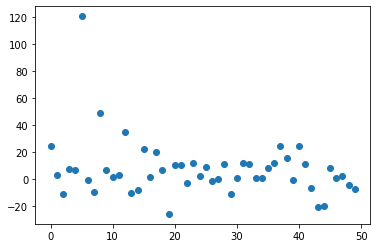

2.9045162
Traced<ConcreteArray(2.9045162)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9045162, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


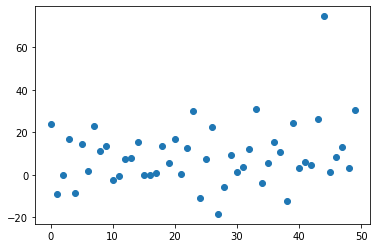

2.4687076
Traced<ConcreteArray(2.4687076)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4687076, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


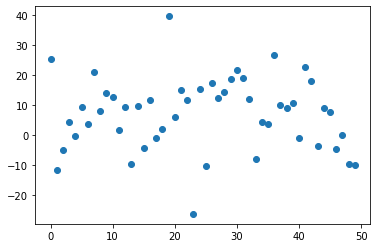

3.2438157
Traced<ConcreteArray(3.2438157)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2438157, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


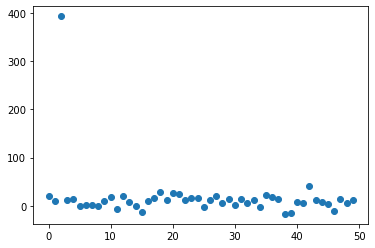

3.0124352
Traced<ConcreteArray(3.0124352)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0124352, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


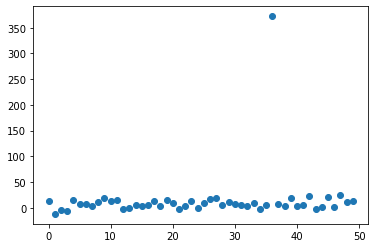

2.5414019
Traced<ConcreteArray(2.5414019)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5414019, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


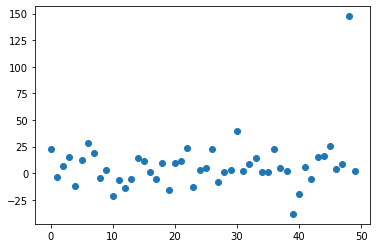

2.3790975
Traced<ConcreteArray(2.3790975)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3790975, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


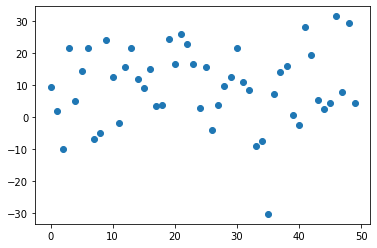

2.8403263
Traced<ConcreteArray(2.8403263)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8403263, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


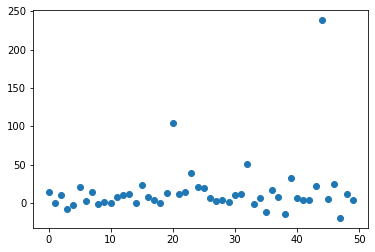

2.5761254
Traced<ConcreteArray(2.5761254)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5761254, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


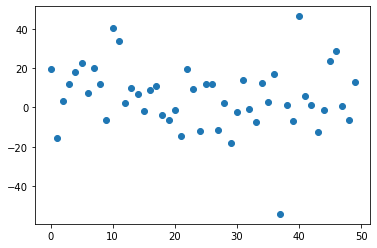

2.5548453
Traced<ConcreteArray(2.5548453)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5548453, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


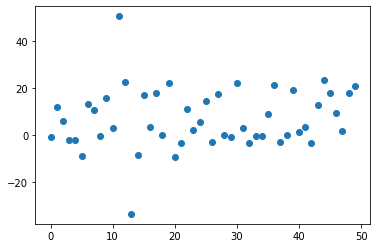

2.6789238
Traced<ConcreteArray(2.6789238)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6789238, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


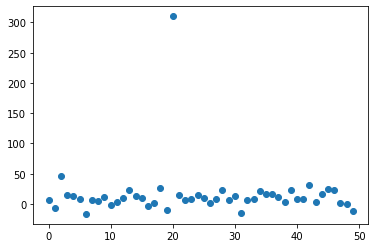

2.4504259
Traced<ConcreteArray(2.4504259)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4504259, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


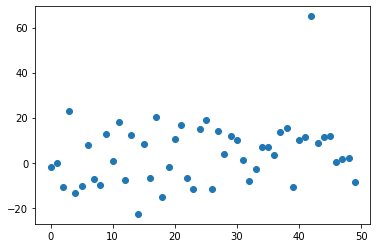

2.732111
Traced<ConcreteArray(2.732111)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.732111, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


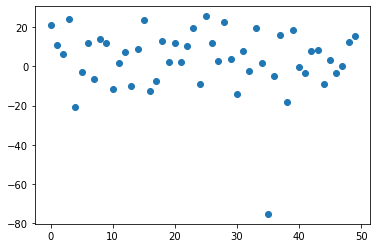

2.7730668
Traced<ConcreteArray(2.7730668)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7730668, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


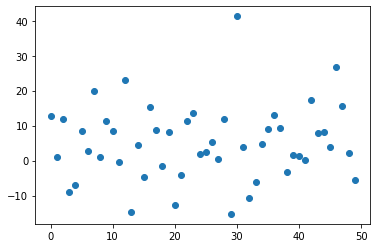

2.5315819
Traced<ConcreteArray(2.5315819)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5315819, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


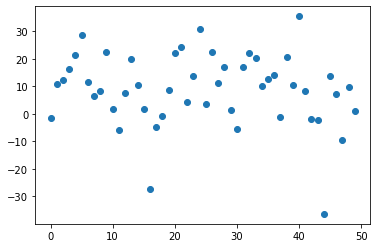

2.9411826
Traced<ConcreteArray(2.9411826)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9411826, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


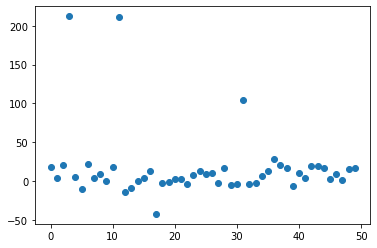

2.7386403
Traced<ConcreteArray(2.7386403)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7386403, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


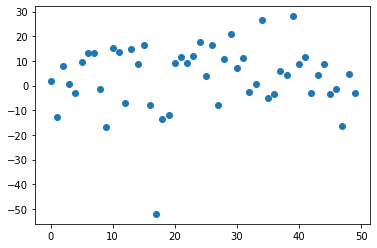

2.8357694
Traced<ConcreteArray(2.8357694)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8357694, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


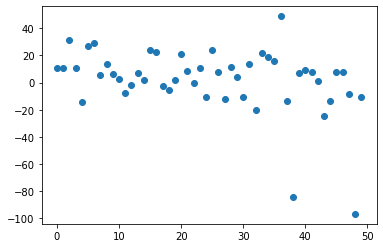

2.627425
Traced<ConcreteArray(2.627425)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.627425, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


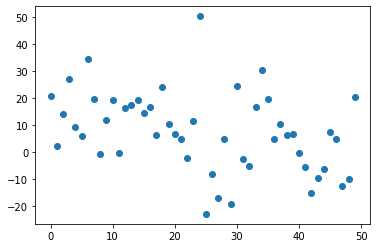

3.779646
Traced<ConcreteArray(3.779646)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.779646, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


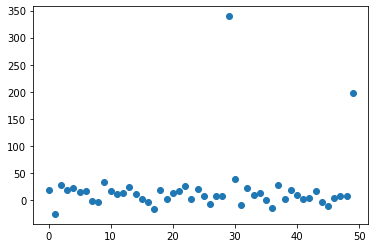

2.7723558
Traced<ConcreteArray(2.7723558)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7723558, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


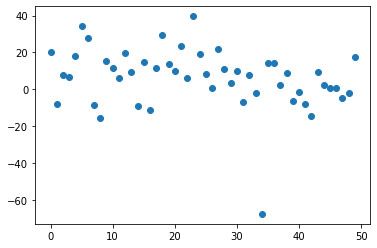

2.2625468
Traced<ConcreteArray(2.2625468)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2625468, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


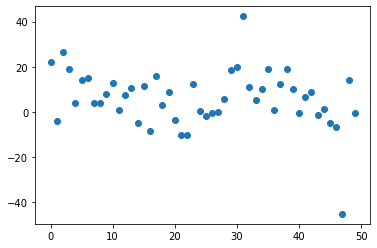

2.616611
Traced<ConcreteArray(2.616611)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.616611, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


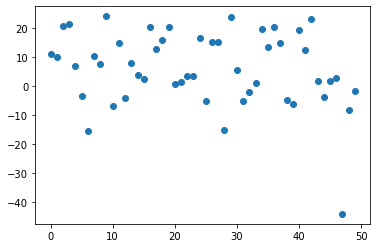

2.4450712
Traced<ConcreteArray(2.4450712)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4450712, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


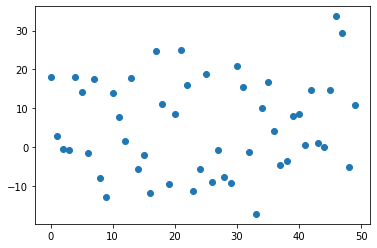

4.7746196
Traced<ConcreteArray(4.7746196)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.7746196, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


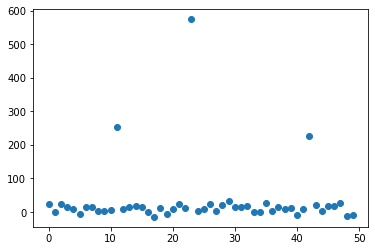

7.4250603
Traced<ConcreteArray(7.4250603)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(7.4250603, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


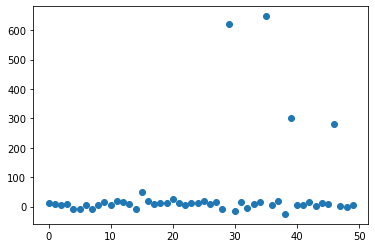

4.124933
Traced<ConcreteArray(4.124933)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.124933, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


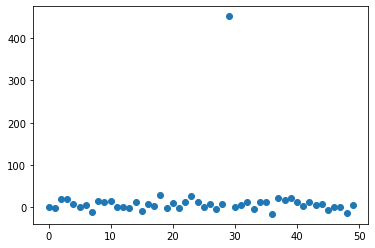

2.9753275
Traced<ConcreteArray(2.9753275)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9753275, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


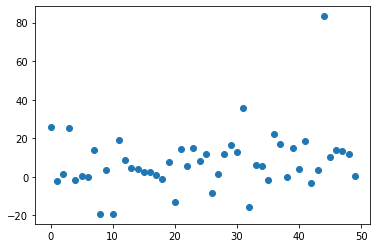

2.4632323
Traced<ConcreteArray(2.4632323)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4632323, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


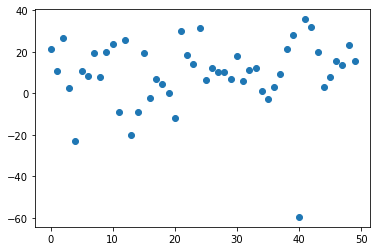

2.5656483
Traced<ConcreteArray(2.5656483)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5656483, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


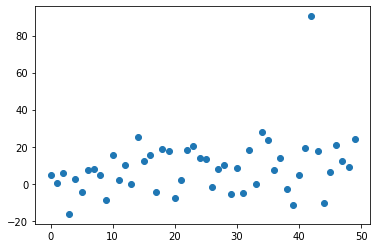

2.7552173
Traced<ConcreteArray(2.7552173)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7552173, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


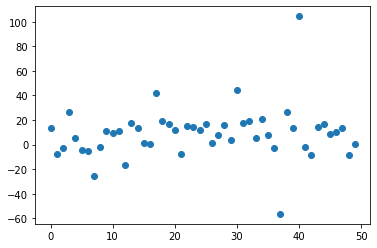

4.299143
Traced<ConcreteArray(4.299143)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.299143, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


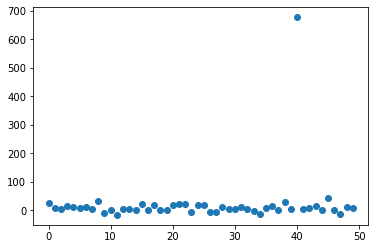

2.5886135
Traced<ConcreteArray(2.5886135)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5886135, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


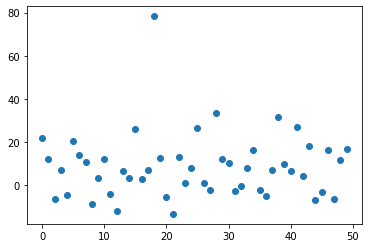

3.0648026
Traced<ConcreteArray(3.0648026)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0648026, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


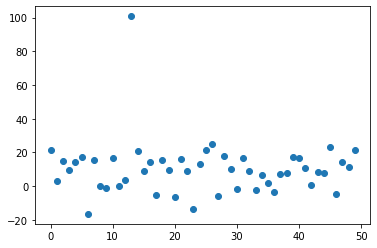

2.7159812
Traced<ConcreteArray(2.7159812)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7159812, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


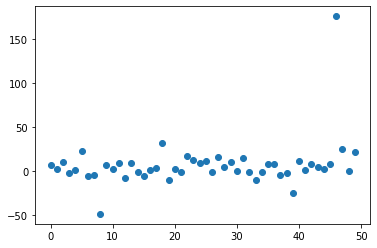

4.5021415
Traced<ConcreteArray(4.5021415)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.5021415, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


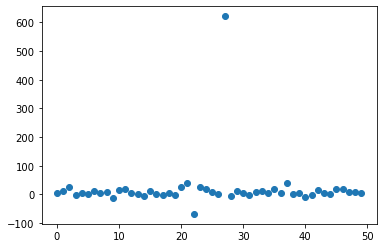

3.1683016
Traced<ConcreteArray(3.1683016)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1683016, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


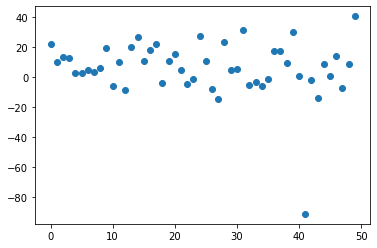

2.2546134
Traced<ConcreteArray(2.2546134)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2546134, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


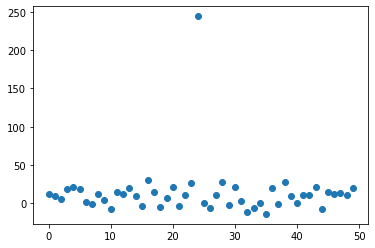

2.6928983
Traced<ConcreteArray(2.6928983)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6928983, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


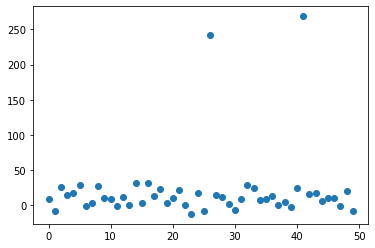

3.068853
Traced<ConcreteArray(3.068853)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.068853, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


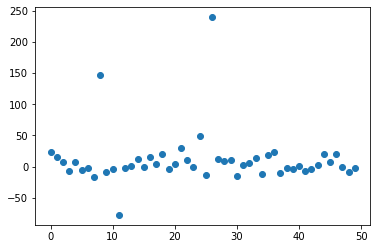

3.6718538
Traced<ConcreteArray(3.6718538)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6718538, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


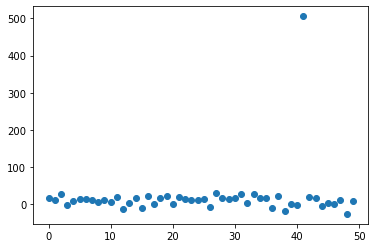

2.5825455
Traced<ConcreteArray(2.5825455)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5825455, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


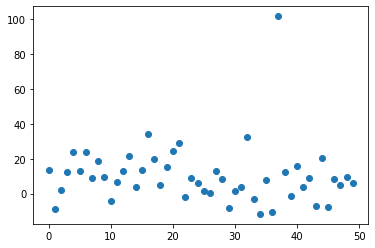

2.374281
Traced<ConcreteArray(2.374281)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.374281, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


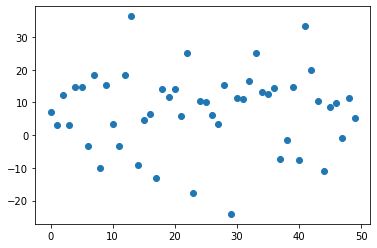

2.164076
Traced<ConcreteArray(2.164076)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.164076, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


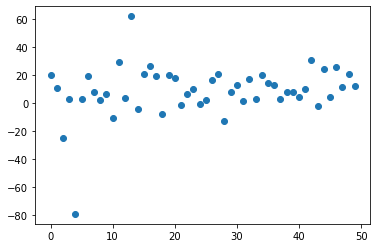

2.3533666
Traced<ConcreteArray(2.3533666)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3533666, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


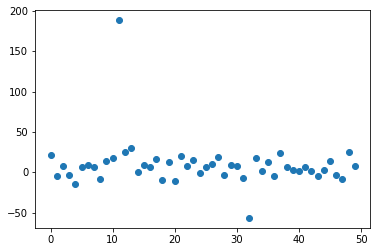

3.0073233
Traced<ConcreteArray(3.0073233)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0073233, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


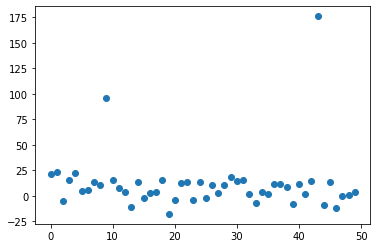

3.151268
Traced<ConcreteArray(3.151268)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.151268, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


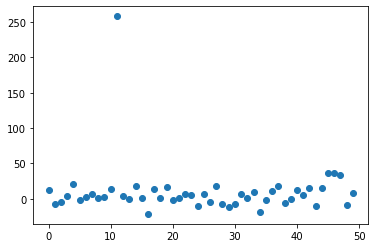

2.6364079
Traced<ConcreteArray(2.6364079)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6364079, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


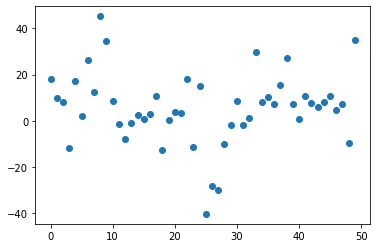

2.941309
Traced<ConcreteArray(2.941309)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.941309, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


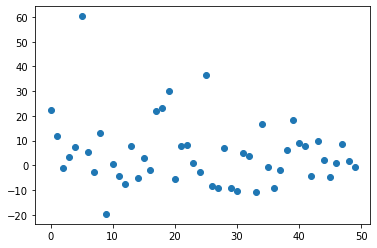

2.8385234
Traced<ConcreteArray(2.8385234)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8385234, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


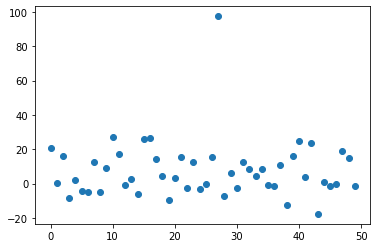

2.8307807
Traced<ConcreteArray(2.8307807)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8307807, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


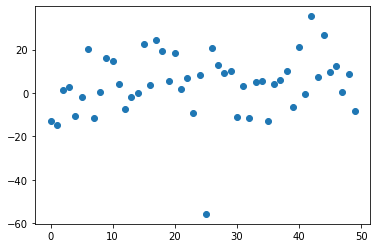

2.503662
Traced<ConcreteArray(2.503662)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.503662, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


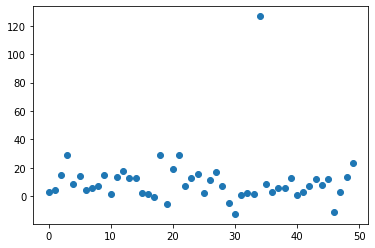

2.7273316
Traced<ConcreteArray(2.7273316)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7273316, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


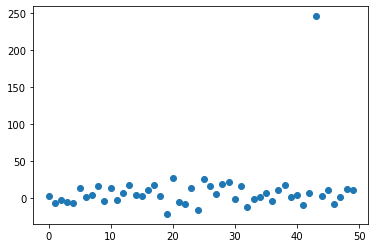

2.5571375
Traced<ConcreteArray(2.5571375)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5571375, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


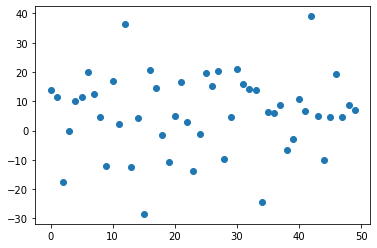

2.4926229
Traced<ConcreteArray(2.4926229)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4926229, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


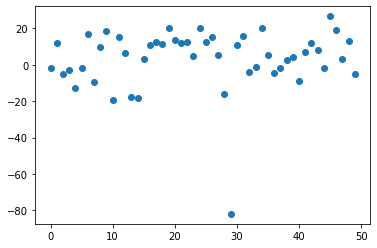

3.2864642
Traced<ConcreteArray(3.2864642)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2864642, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


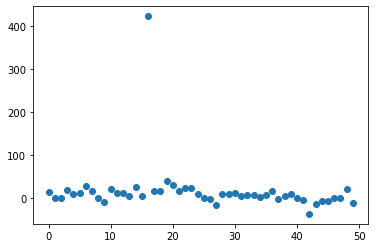

2.4466398
Traced<ConcreteArray(2.4466398)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4466398, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


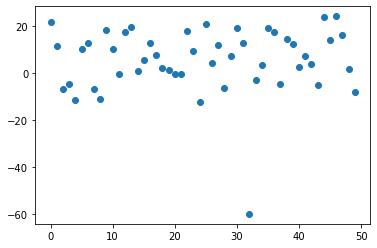

3.0719116
Traced<ConcreteArray(3.0719116)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0719116, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


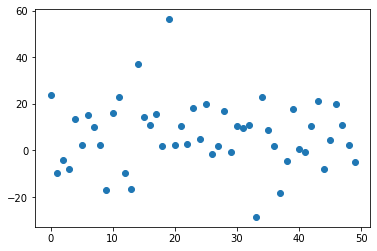

3.8003578
Traced<ConcreteArray(3.8003578)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8003578, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


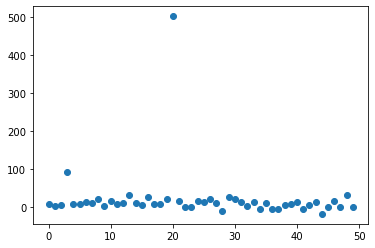

2.9074512
Traced<ConcreteArray(2.9074512)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9074512, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


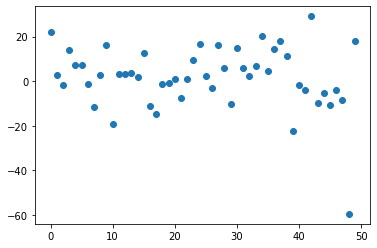

2.6926756
Traced<ConcreteArray(2.6926756)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6926756, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


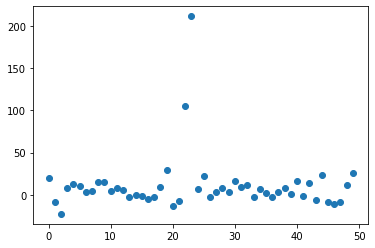

2.58933
Traced<ConcreteArray(2.58933)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.58933, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


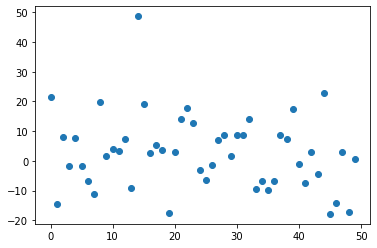

2.4024138
Traced<ConcreteArray(2.4024138)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4024138, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


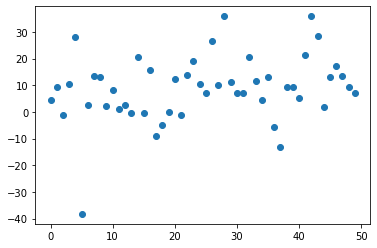

2.3245993
Traced<ConcreteArray(2.3245993)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3245993, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


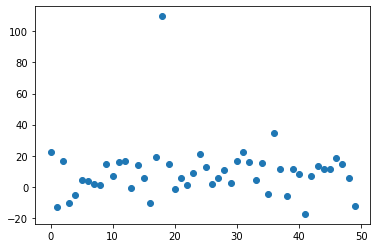

2.8776586
Traced<ConcreteArray(2.8776586)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8776586, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


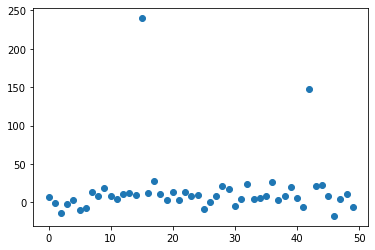

2.3682227
Traced<ConcreteArray(2.3682227)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3682227, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


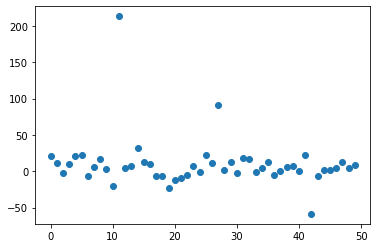

3.0629537
Traced<ConcreteArray(3.0629537)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0629537, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


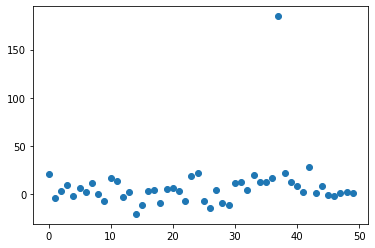

2.5664437
Traced<ConcreteArray(2.5664437)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5664437, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


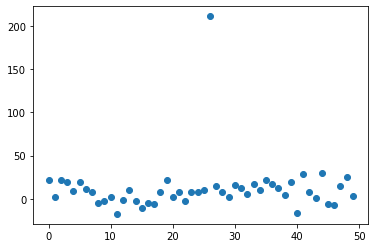

3.084693
Traced<ConcreteArray(3.084693)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.084693, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


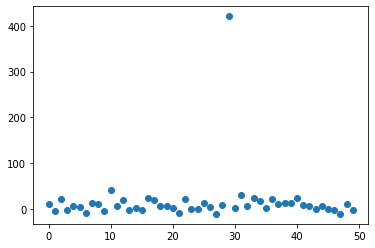

2.5804942
Traced<ConcreteArray(2.5804942)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5804942, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


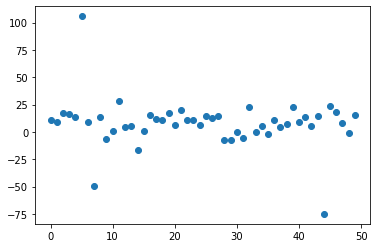

3.0926294
Traced<ConcreteArray(3.0926294)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0926294, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


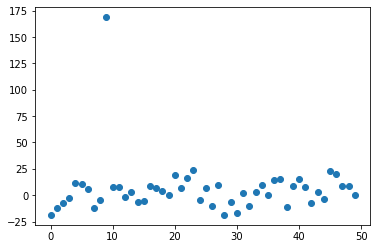

2.5928764
Traced<ConcreteArray(2.5928764)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5928764, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


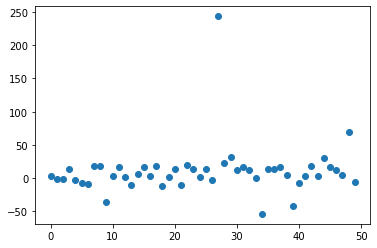

2.5930624
Traced<ConcreteArray(2.5930624)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5930624, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


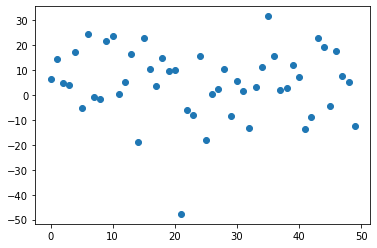

3.4441962
Traced<ConcreteArray(3.4441962)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4441962, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


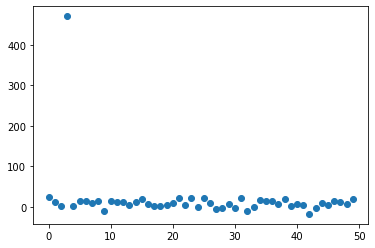

2.6045775
Traced<ConcreteArray(2.6045775)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6045775, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


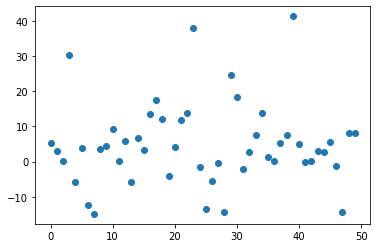

2.4845316
Traced<ConcreteArray(2.4845316)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4845316, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


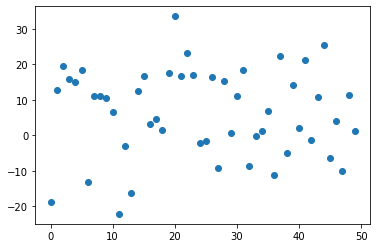

2.5943456
Traced<ConcreteArray(2.5943456)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5943456, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


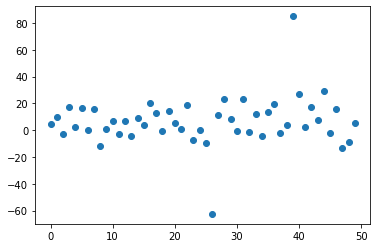

2.7353668
Traced<ConcreteArray(2.7353668)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7353668, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


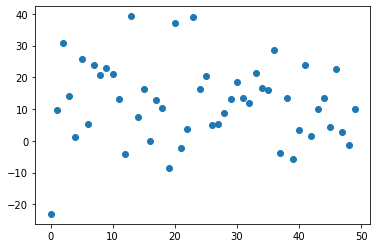

4.116027
Traced<ConcreteArray(4.116027)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.116027, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


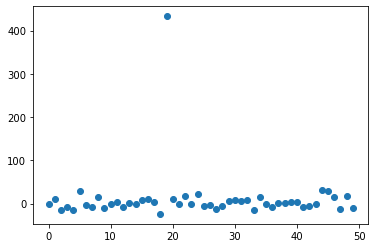

2.6016312
Traced<ConcreteArray(2.6016312)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6016312, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


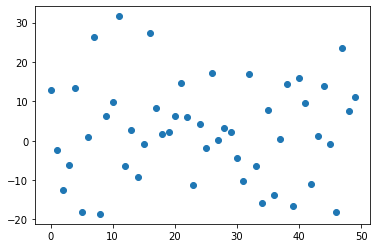

4.773516
Traced<ConcreteArray(4.773516)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.773516, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


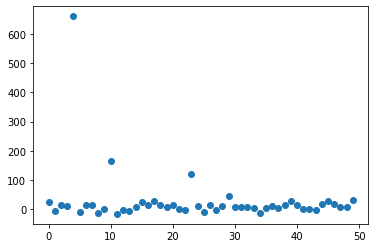

2.4198663
Traced<ConcreteArray(2.4198663)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4198663, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


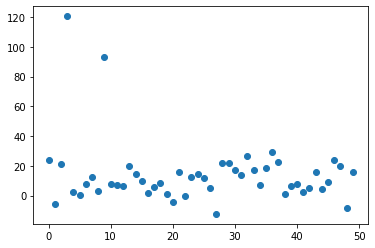

2.8394458
Traced<ConcreteArray(2.8394458)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8394458, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


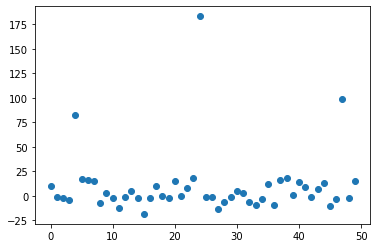

3.271538
Traced<ConcreteArray(3.271538)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.271538, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


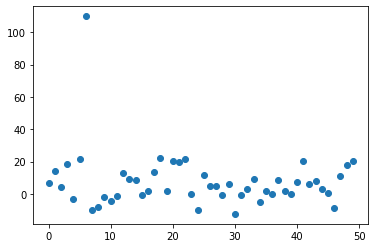

3.1567905
Traced<ConcreteArray(3.1567905)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1567905, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


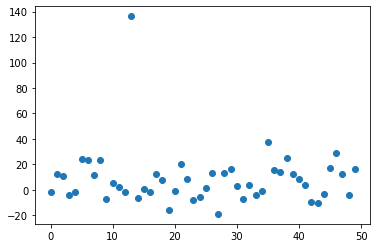

2.145184
Traced<ConcreteArray(2.145184)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.145184, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


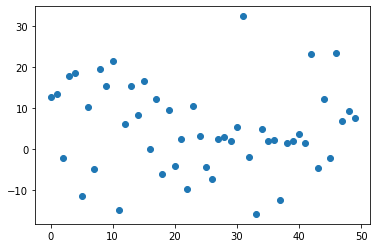

3.0686514
Traced<ConcreteArray(3.0686514)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0686514, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


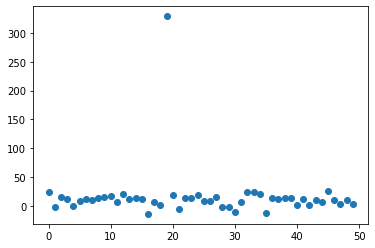

2.1788504
Traced<ConcreteArray(2.1788504)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1788504, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


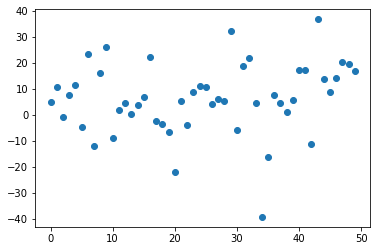

2.2604752
Traced<ConcreteArray(2.2604752)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2604752, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


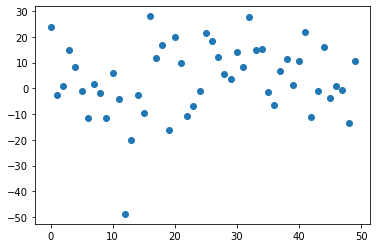

3.00807
Traced<ConcreteArray(3.00807)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.00807, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


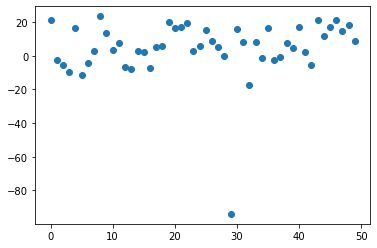

2.1726604
Traced<ConcreteArray(2.1726604)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1726604, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


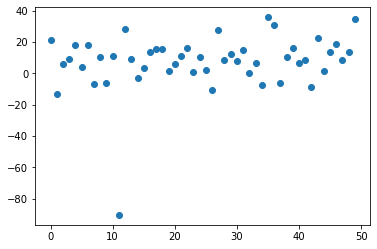

2.5784178
Traced<ConcreteArray(2.5784178)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5784178, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


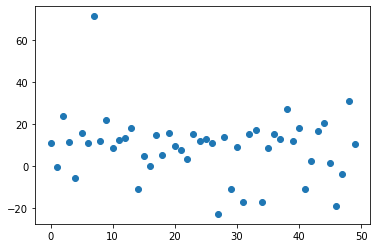

2.2766342
Traced<ConcreteArray(2.2766342)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2766342, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


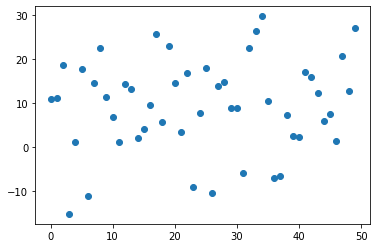

4.1845446
Traced<ConcreteArray(4.1845446)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.1845446, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


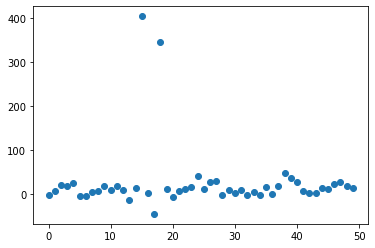

2.5707197
Traced<ConcreteArray(2.5707197)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5707197, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


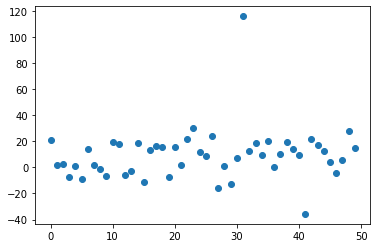

2.165191
Traced<ConcreteArray(2.165191)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.165191, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


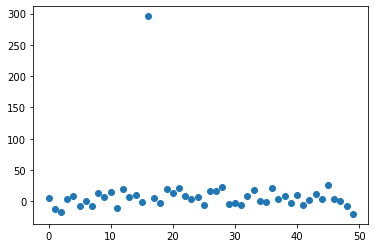

2.4864902
Traced<ConcreteArray(2.4864902)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4864902, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


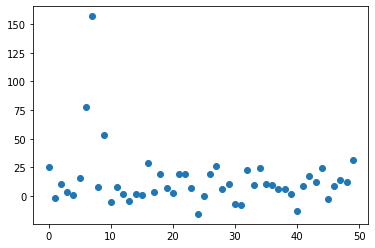

2.4257278
Traced<ConcreteArray(2.4257278)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4257278, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


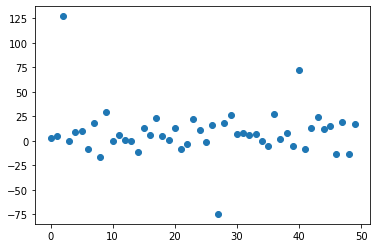

2.886545
Traced<ConcreteArray(2.886545)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.886545, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


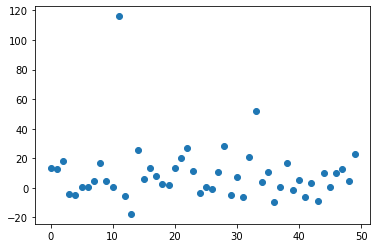

2.492856
Traced<ConcreteArray(2.492856)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.492856, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


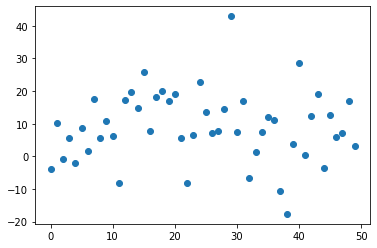

2.1675274
Traced<ConcreteArray(2.1675274)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1675274, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


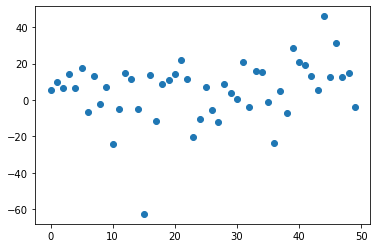

2.4483054
Traced<ConcreteArray(2.4483054)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4483054, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


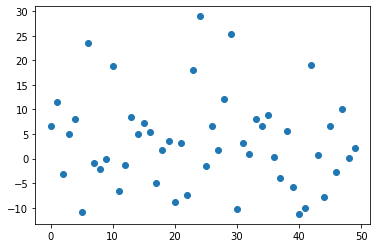

2.0222464
Traced<ConcreteArray(2.0222464)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.0222464, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


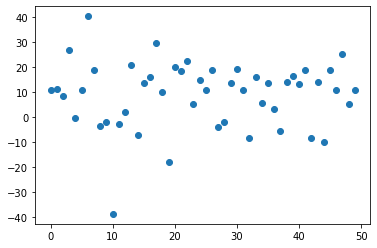

2.4387078
Traced<ConcreteArray(2.4387078)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4387078, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


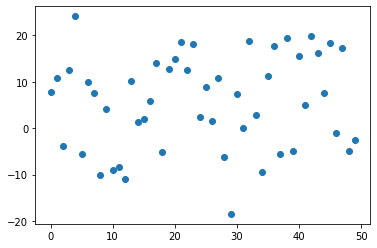

2.3862858
Traced<ConcreteArray(2.3862858)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3862858, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


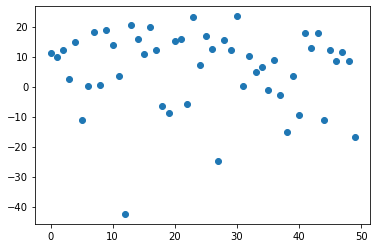

2.8274748
Traced<ConcreteArray(2.8274748)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8274748, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


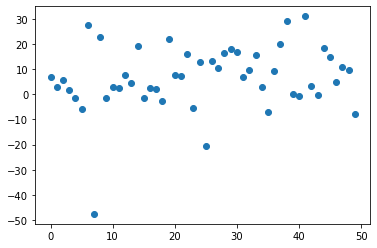

2.8871229
Traced<ConcreteArray(2.8871229)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8871229, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


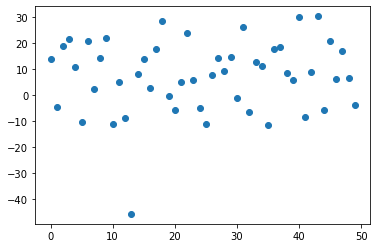

2.0685525
Traced<ConcreteArray(2.0685525)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.0685525, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


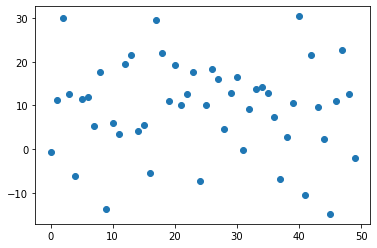

2.791292
Traced<ConcreteArray(2.791292)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.791292, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


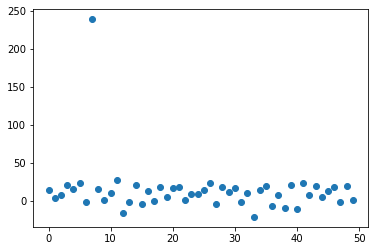

2.3726768
Traced<ConcreteArray(2.3726768)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3726768, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


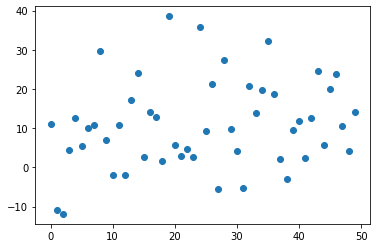

2.2866464
Traced<ConcreteArray(2.2866464)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2866464, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


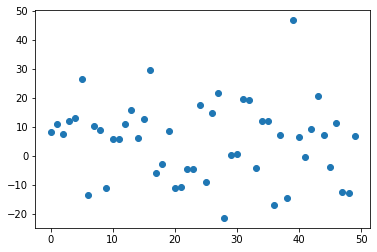

2.586559
Traced<ConcreteArray(2.586559)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.586559, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


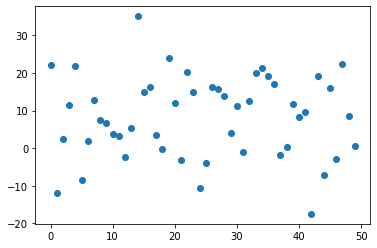

3.0123959
Traced<ConcreteArray(3.0123959)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0123959, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


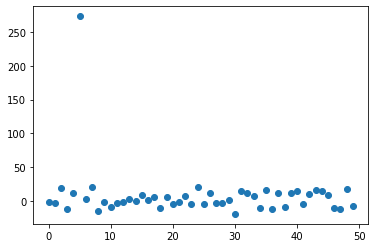

3.4798748
Traced<ConcreteArray(3.4798748)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4798748, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


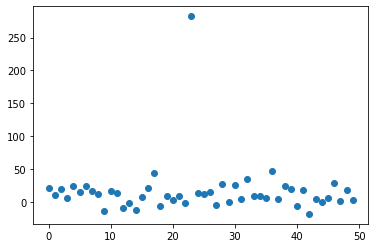

3.1900892
Traced<ConcreteArray(3.1900892)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1900892, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


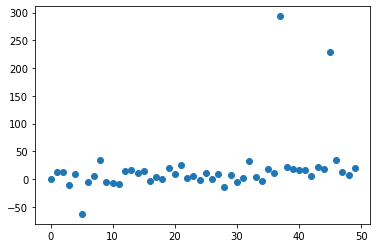

2.381932
Traced<ConcreteArray(2.381932)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.381932, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


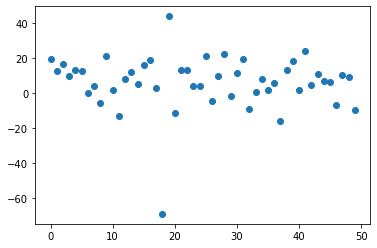

2.165243
Traced<ConcreteArray(2.165243)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.165243, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


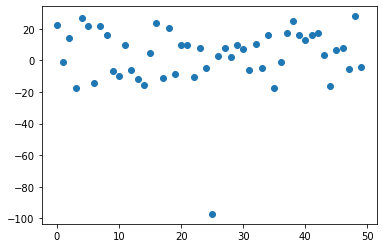

2.4379237
Traced<ConcreteArray(2.4379237)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4379237, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


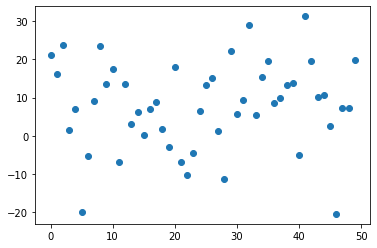

2.3480806
Traced<ConcreteArray(2.3480806)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3480806, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


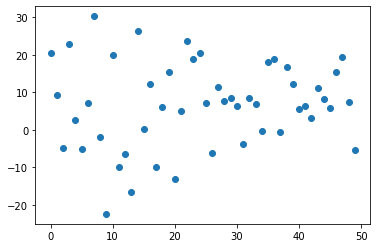

2.9427984
Traced<ConcreteArray(2.9427984)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9427984, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


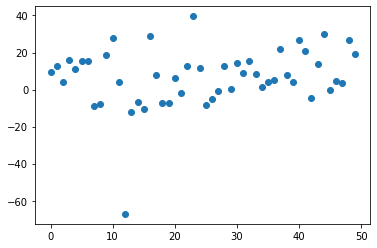

2.8914826
Traced<ConcreteArray(2.8914826)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8914826, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


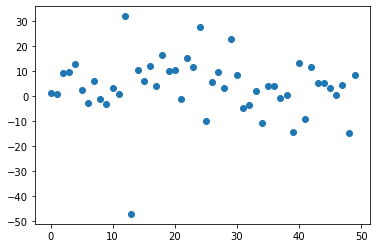

2.5849876
Traced<ConcreteArray(2.5849876)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5849876, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


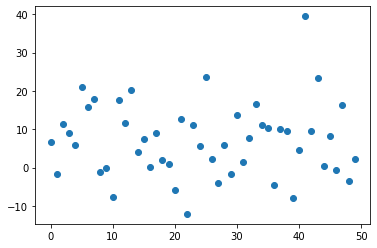

2.159285
Traced<ConcreteArray(2.159285)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.159285, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


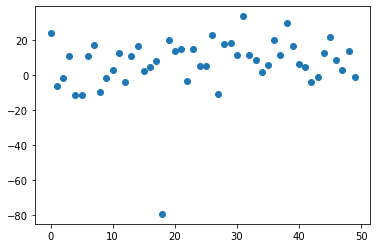

2.9182398
Traced<ConcreteArray(2.9182398)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9182398, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


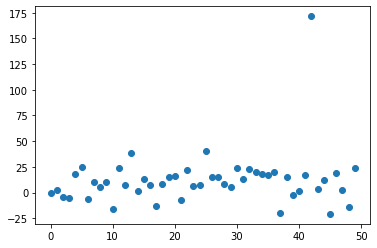

2.9650052
Traced<ConcreteArray(2.9650052)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9650052, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


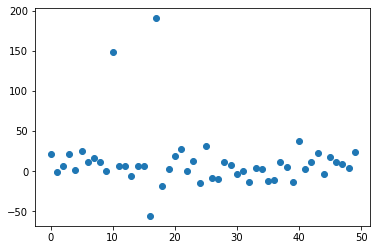

2.5409062
Traced<ConcreteArray(2.5409062)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5409062, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


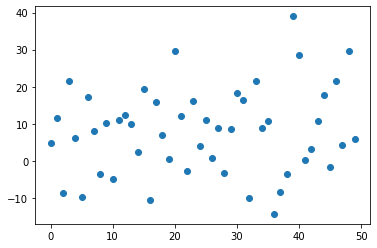

2.7583807
Traced<ConcreteArray(2.7583807)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7583807, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


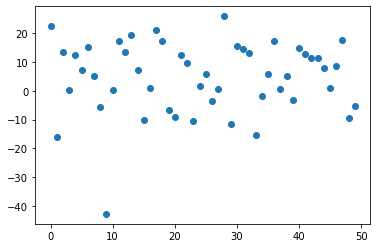

2.4378276
Traced<ConcreteArray(2.4378276)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4378276, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


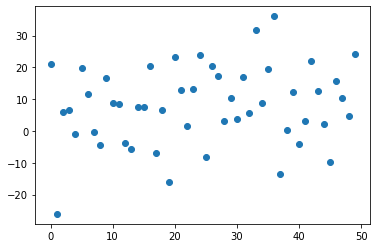

3.9432273
Traced<ConcreteArray(3.9432273)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9432273, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


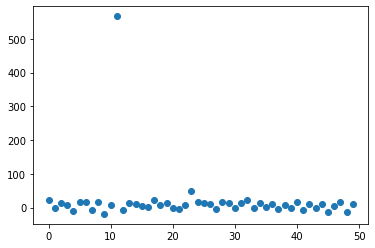

2.5216181
Traced<ConcreteArray(2.5216181)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5216181, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


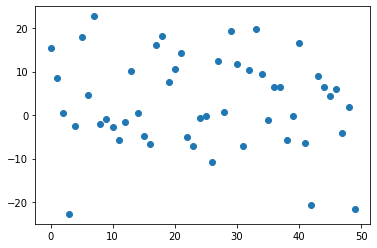

2.8387718
Traced<ConcreteArray(2.8387718)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8387718, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


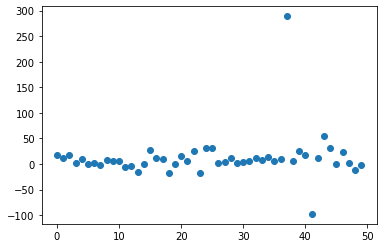

2.603433
Traced<ConcreteArray(2.603433)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.603433, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


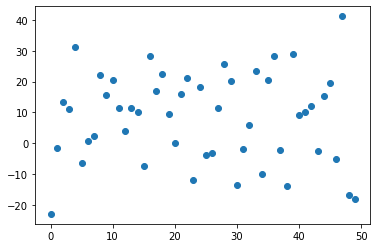

3.1298952
Traced<ConcreteArray(3.1298952)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1298952, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


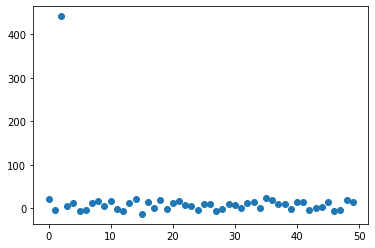

2.032868
Traced<ConcreteArray(2.032868)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.032868, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


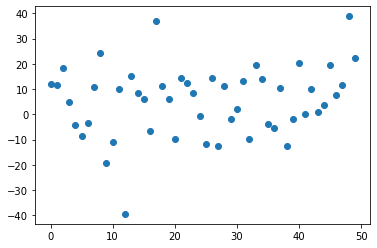

3.3443444
Traced<ConcreteArray(3.3443444)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3443444, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


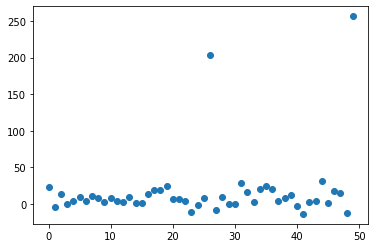

2.8325331
Traced<ConcreteArray(2.8325331)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8325331, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


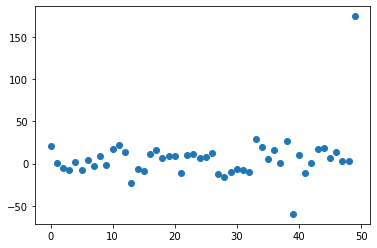

2.7391415
Traced<ConcreteArray(2.7391415)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7391415, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


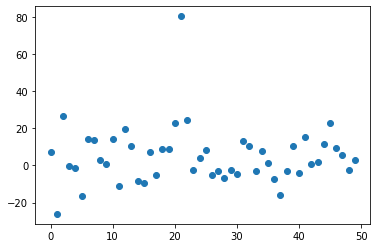

4.196841
Traced<ConcreteArray(4.196841)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.196841, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


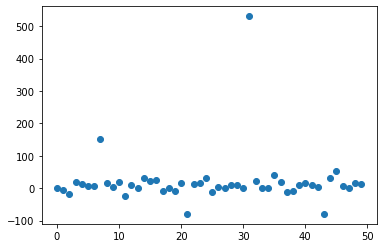

3.084137
Traced<ConcreteArray(3.084137)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.084137, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


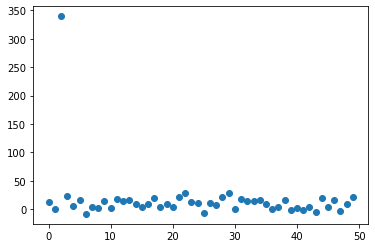

2.8228383
Traced<ConcreteArray(2.8228383)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8228383, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


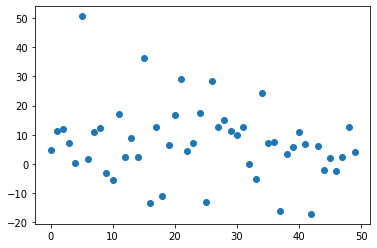

2.4564533
Traced<ConcreteArray(2.4564533)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4564533, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


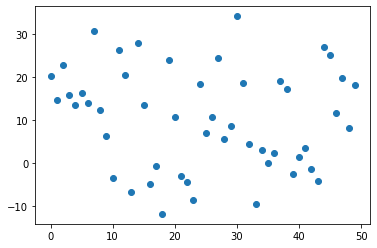

4.4517684
Traced<ConcreteArray(4.4517684)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.4517684, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


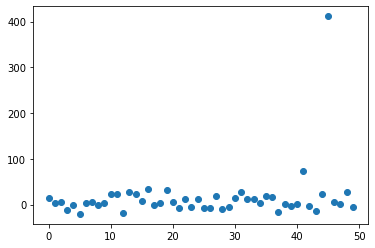

2.4722688
Traced<ConcreteArray(2.4722688)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4722688, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


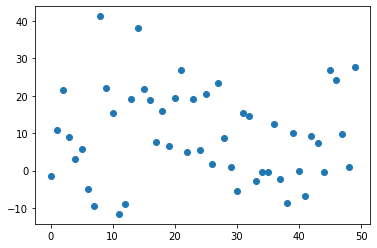

2.387393
Traced<ConcreteArray(2.387393)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.387393, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


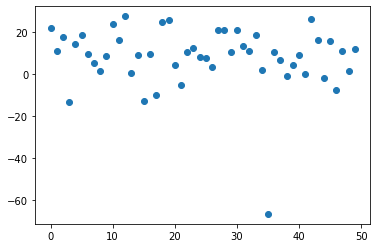

2.886709
Traced<ConcreteArray(2.886709)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.886709, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


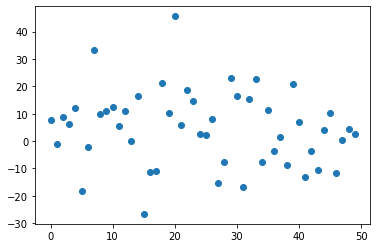

2.7285933
Traced<ConcreteArray(2.7285933)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7285933, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


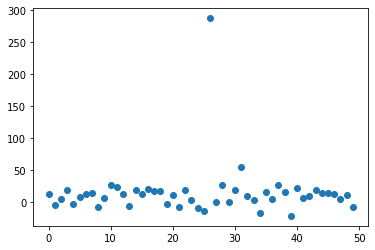

2.4750047
Traced<ConcreteArray(2.4750047)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4750047, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


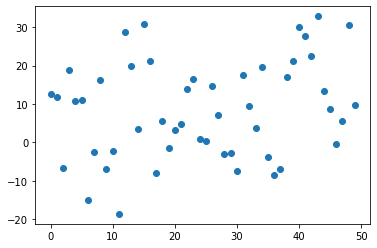

2.9960415
Traced<ConcreteArray(2.9960415)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9960415, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


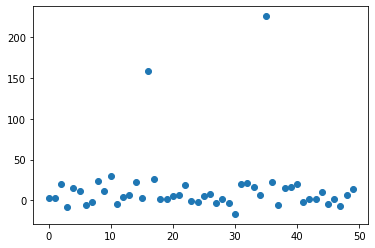

2.500884
Traced<ConcreteArray(2.500884)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.500884, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


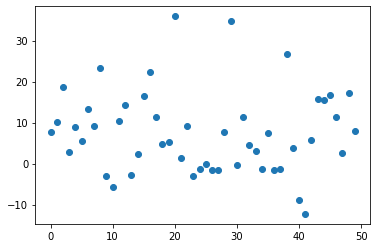

2.736961
Traced<ConcreteArray(2.736961)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.736961, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


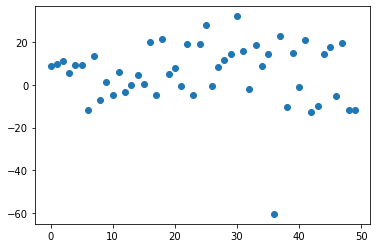

2.9486074
Traced<ConcreteArray(2.9486074)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9486074, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


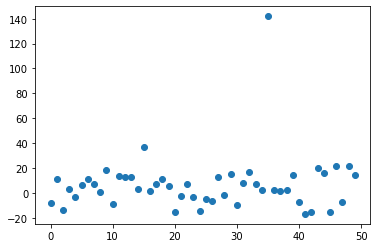

2.8640108
Traced<ConcreteArray(2.8640108)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8640108, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


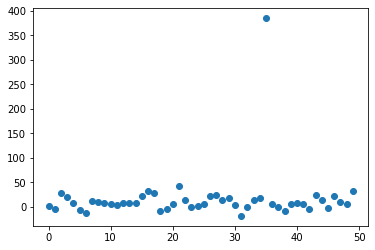

3.3131027
Traced<ConcreteArray(3.3131027)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3131027, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


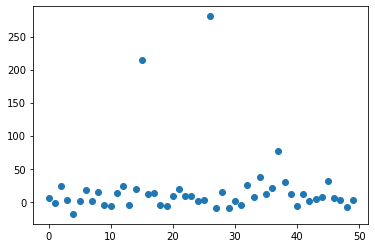

2.6271245
Traced<ConcreteArray(2.6271245)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6271245, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


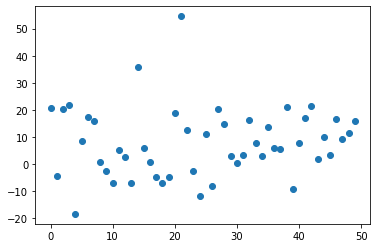

3.3180668
Traced<ConcreteArray(3.3180668)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3180668, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


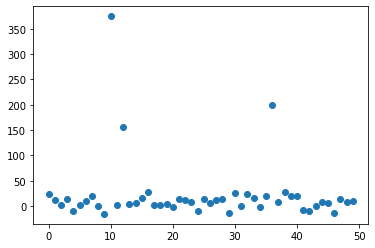

2.7488766
Traced<ConcreteArray(2.7488766)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7488766, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


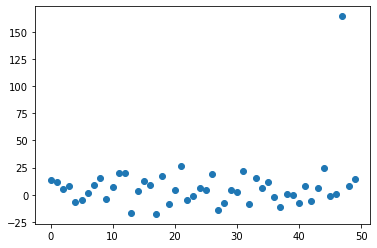

3.0313258
Traced<ConcreteArray(3.0313258)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0313258, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


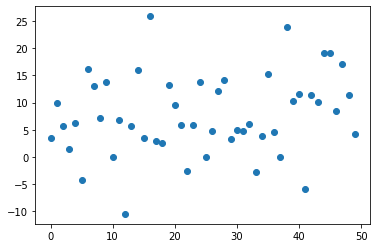

2.9613023
Traced<ConcreteArray(2.9613023)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9613023, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


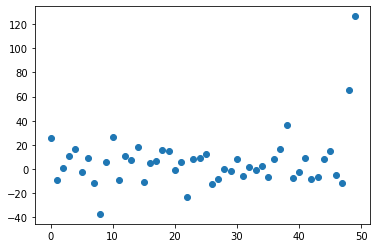

2.5581977
Traced<ConcreteArray(2.5581977)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5581977, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


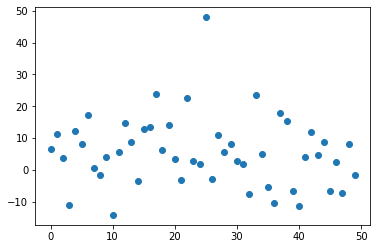

2.6485062
Traced<ConcreteArray(2.6485062)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6485062, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


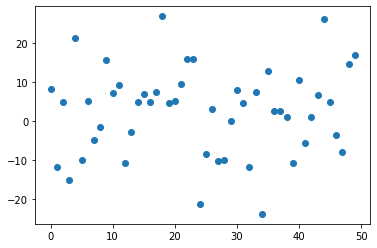

6.4626303
Traced<ConcreteArray(6.4626303)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(6.4626303, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


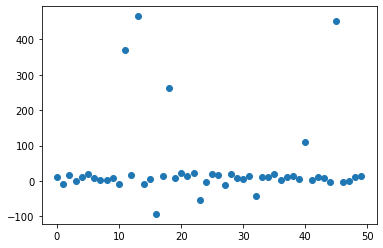

2.2627358
Traced<ConcreteArray(2.2627358)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2627358, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


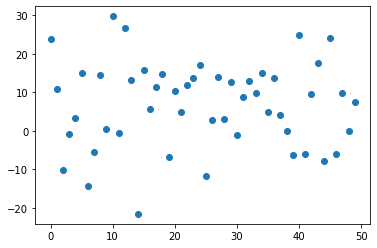

2.9517703
Traced<ConcreteArray(2.9517703)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9517703, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


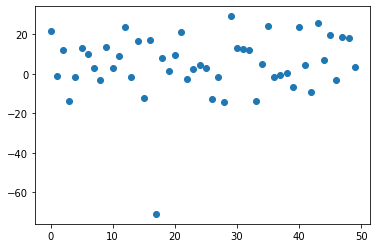

2.7939801
Traced<ConcreteArray(2.7939801)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7939801, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


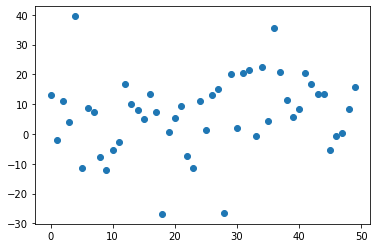

2.8605819
Traced<ConcreteArray(2.8605819)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8605819, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


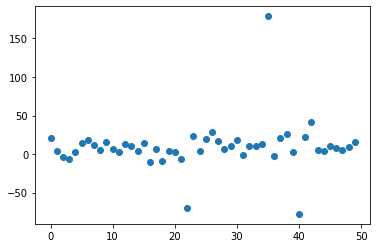

2.4277916
Traced<ConcreteArray(2.4277916)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4277916, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


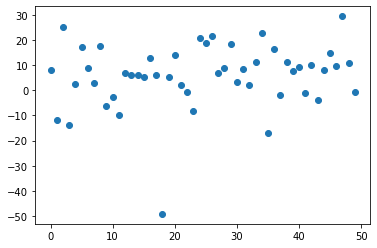

2.2600777
Traced<ConcreteArray(2.2600777)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2600777, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


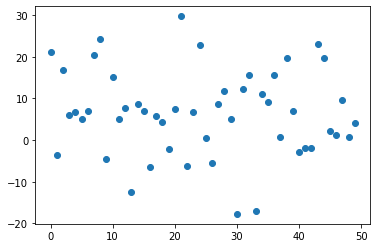

2.6239657
Traced<ConcreteArray(2.6239657)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6239657, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


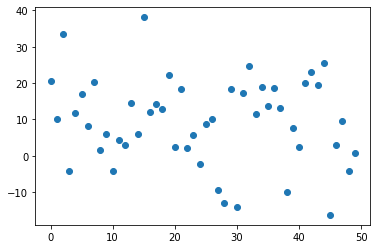

2.6919732
Traced<ConcreteArray(2.6919732)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6919732, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


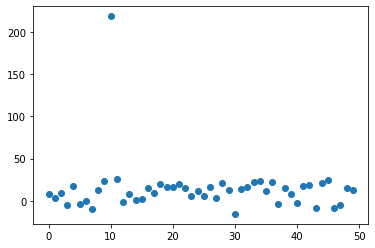

2.2885313
Traced<ConcreteArray(2.2885313)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2885313, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


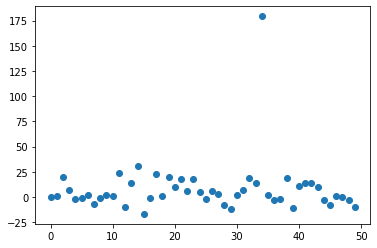

2.66188
Traced<ConcreteArray(2.66188)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.66188, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


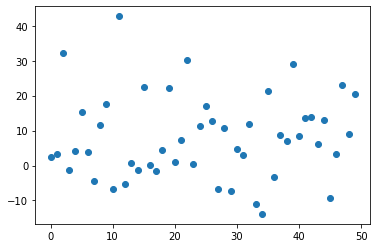

3.7618191
Traced<ConcreteArray(3.7618191)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.7618191, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


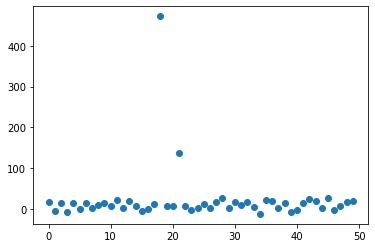

2.9097915
Traced<ConcreteArray(2.9097915)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9097915, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


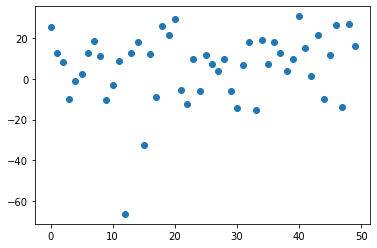

4.127679
Traced<ConcreteArray(4.127679)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.127679, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


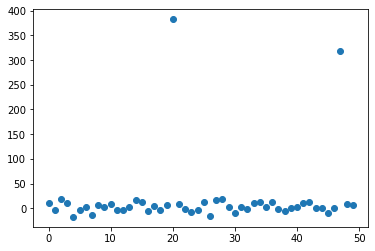

2.0258613
Traced<ConcreteArray(2.0258613)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.0258613, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


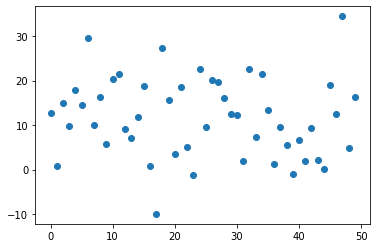

2.1486309
Traced<ConcreteArray(2.1486309)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1486309, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


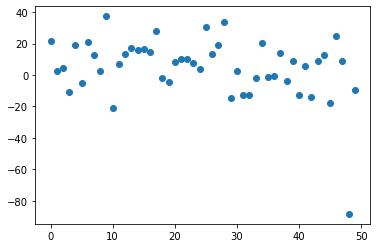

2.386289
Traced<ConcreteArray(2.386289)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.386289, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


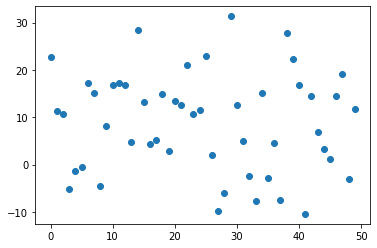

3.7762806
Traced<ConcreteArray(3.7762806)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.7762806, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


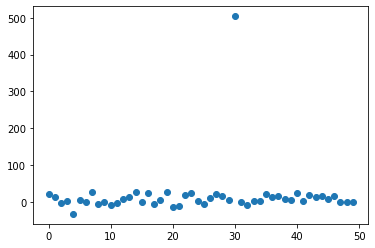

3.1874883
Traced<ConcreteArray(3.1874883)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1874883, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


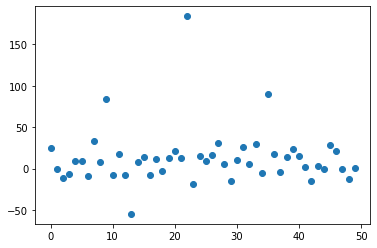

2.6967757
Traced<ConcreteArray(2.6967757)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6967757, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


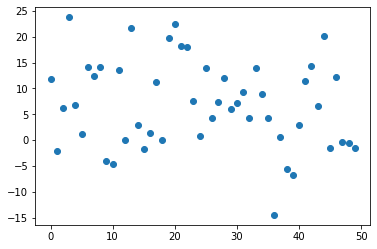

3.6478653
Traced<ConcreteArray(3.6478653)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6478653, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


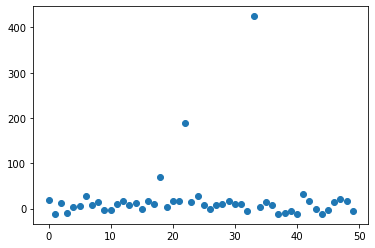

2.6227393
Traced<ConcreteArray(2.6227393)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6227393, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


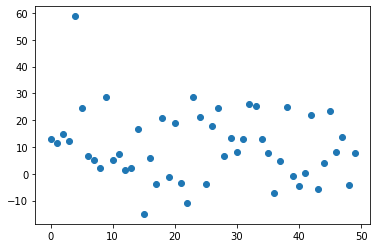

3.3830953
Traced<ConcreteArray(3.3830953)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3830953, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


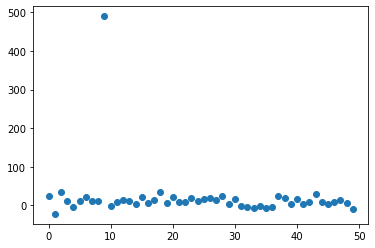

2.9759579
Traced<ConcreteArray(2.9759579)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9759579, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


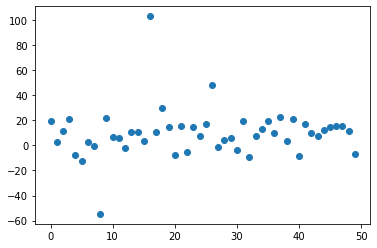

3.105671
Traced<ConcreteArray(3.105671)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.105671, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


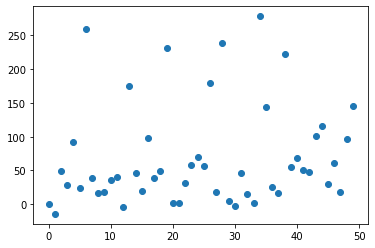

2.8057287
Traced<ConcreteArray(2.8057287)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8057287, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


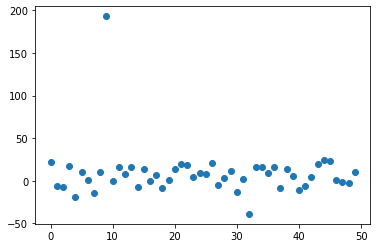

4.621168
Traced<ConcreteArray(4.621168)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.621168, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


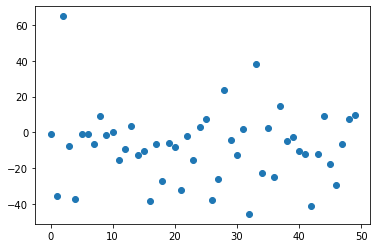

3.4221144
Traced<ConcreteArray(3.4221144)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4221144, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


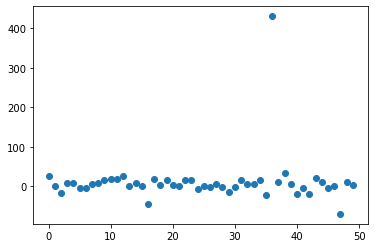

3.589586
Traced<ConcreteArray(3.589586)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.589586, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


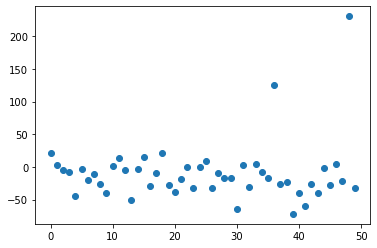

3.5499415
Traced<ConcreteArray(3.5499415)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5499415, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


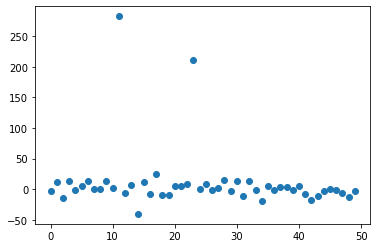

2.7284777
Traced<ConcreteArray(2.7284777)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7284777, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


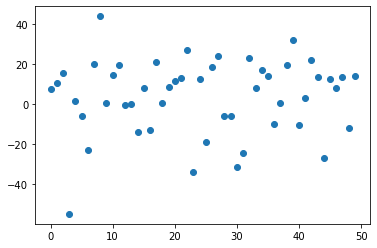

3.8390567
Traced<ConcreteArray(3.8390567)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8390567, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


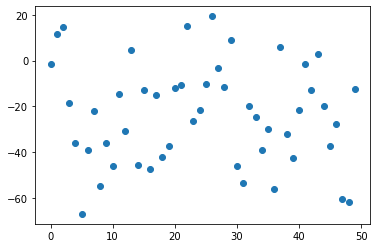

3.3075917
Traced<ConcreteArray(3.3075917)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3075917, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


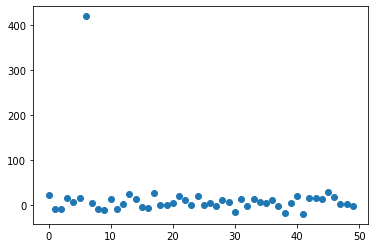

2.4336615
Traced<ConcreteArray(2.4336615)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4336615, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


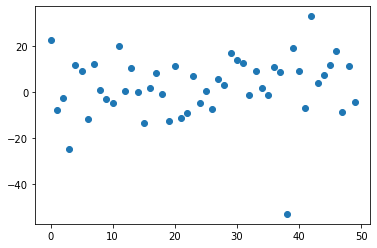

3.1662602
Traced<ConcreteArray(3.1662602)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1662602, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


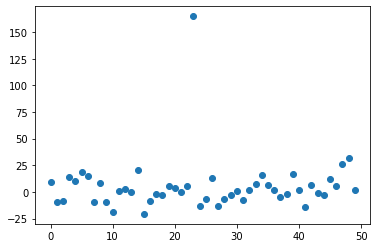

2.2309573
Traced<ConcreteArray(2.2309573)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2309573, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


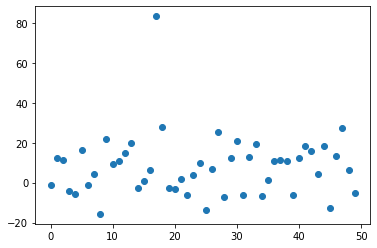

3.842639
Traced<ConcreteArray(3.842639)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.842639, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


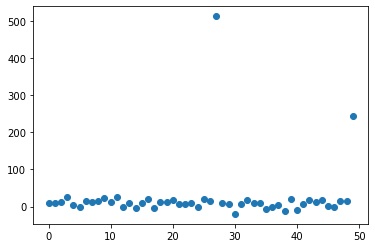

3.018197
Traced<ConcreteArray(3.018197)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.018197, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


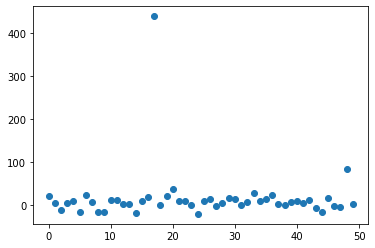

2.2222965
Traced<ConcreteArray(2.2222965)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2222965, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


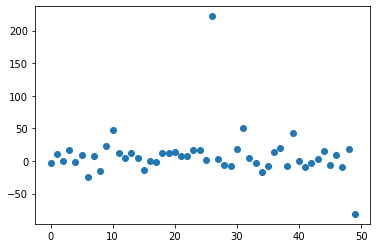

3.4318876
Traced<ConcreteArray(3.4318876)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4318876, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


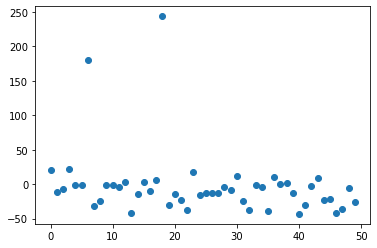

2.1343265
Traced<ConcreteArray(2.1343265)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1343265, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


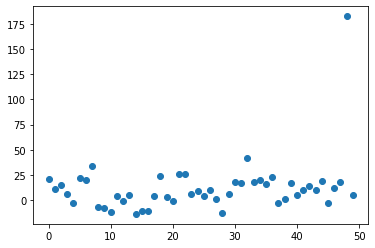

3.2444615
Traced<ConcreteArray(3.2444615)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2444615, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


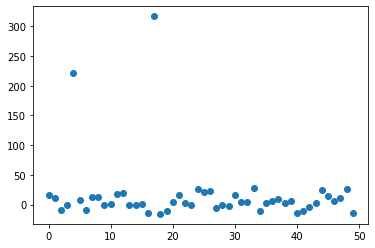

2.4901812
Traced<ConcreteArray(2.4901812)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4901812, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


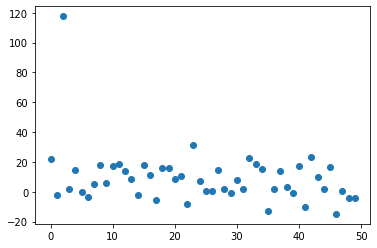

2.7470715
Traced<ConcreteArray(2.7470715)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7470715, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


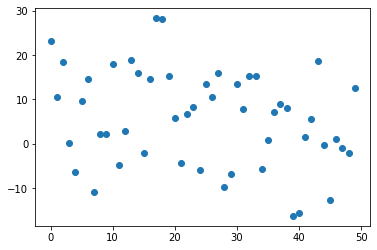

2.8494658
Traced<ConcreteArray(2.8494658)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8494658, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


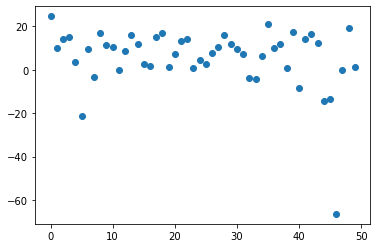

3.4432802
Traced<ConcreteArray(3.4432802)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4432802, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


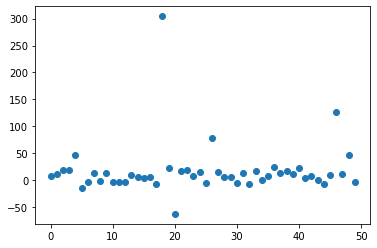

2.746835
Traced<ConcreteArray(2.746835)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.746835, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


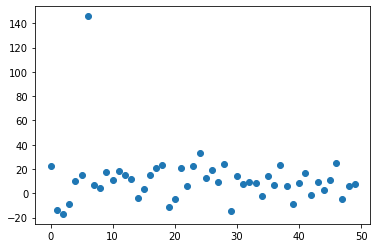

2.8930514
Traced<ConcreteArray(2.8930514)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8930514, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


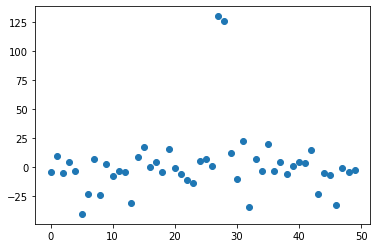

2.4272287
Traced<ConcreteArray(2.4272287)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4272287, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


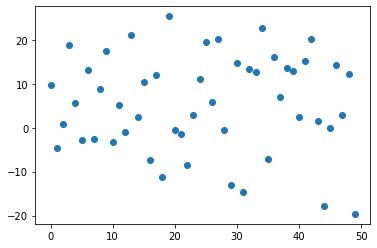

3.1375213
Traced<ConcreteArray(3.1375213)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1375213, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


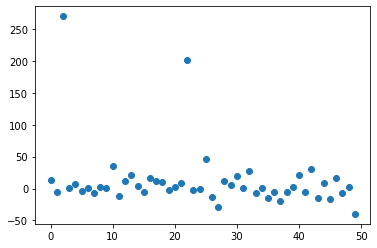

3.052958
Traced<ConcreteArray(3.052958)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.052958, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


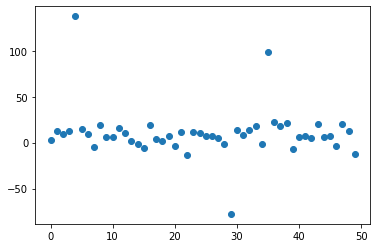

2.3468728
Traced<ConcreteArray(2.3468728)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3468728, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


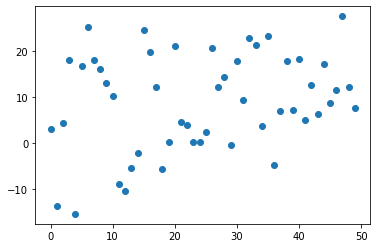

2.5424
Traced<ConcreteArray(2.5424)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5424, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


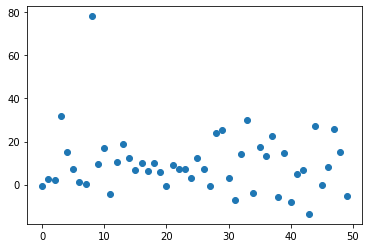

2.5745099
Traced<ConcreteArray(2.5745099)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5745099, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


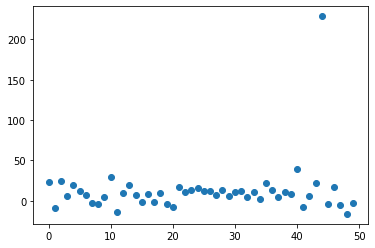

2.295409
Traced<ConcreteArray(2.295409)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.295409, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


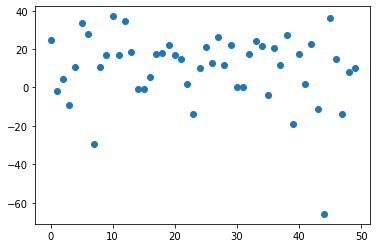

3.5849442
Traced<ConcreteArray(3.5849442)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5849442, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


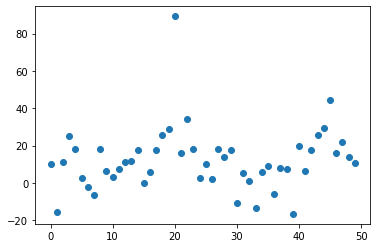

3.2919097
Traced<ConcreteArray(3.2919097)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2919097, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


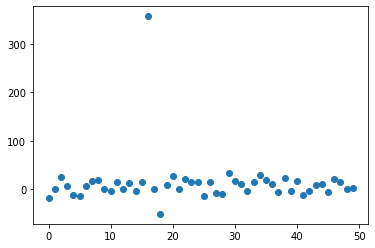

2.9493766
Traced<ConcreteArray(2.9493766)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9493766, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


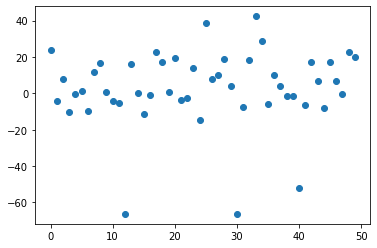

3.3910291
Traced<ConcreteArray(3.3910291)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3910291, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


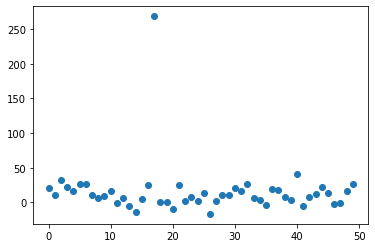

2.1746387
Traced<ConcreteArray(2.1746387)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1746387, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


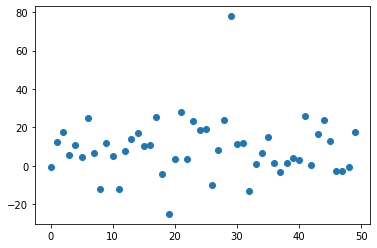

2.6084561
Traced<ConcreteArray(2.6084561)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6084561, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


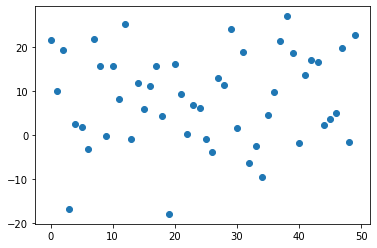

3.0451121
Traced<ConcreteArray(3.0451121)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0451121, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


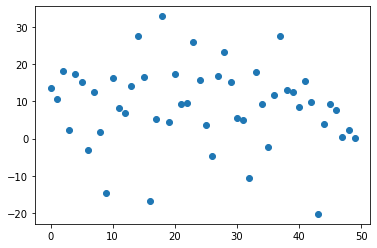

2.747107
Traced<ConcreteArray(2.747107)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.747107, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


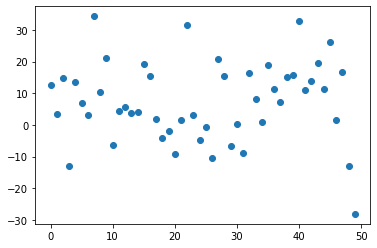

2.4774969
Traced<ConcreteArray(2.4774969)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4774969, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


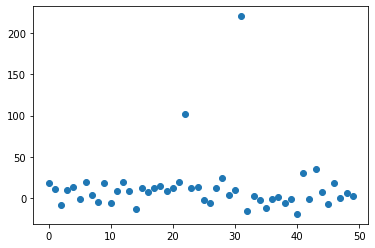

4.430522
Traced<ConcreteArray(4.430522)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.430522, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


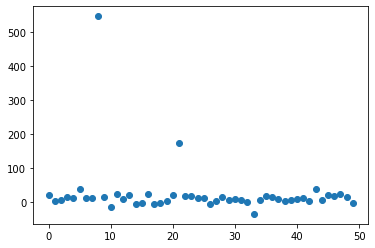

2.283935
Traced<ConcreteArray(2.283935)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.283935, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


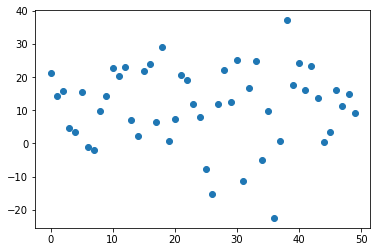

2.3283284
Traced<ConcreteArray(2.3283284)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3283284, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


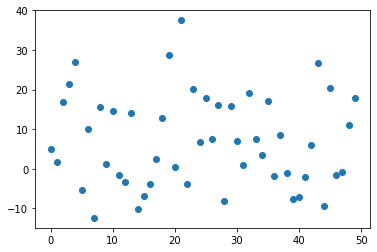

2.284636
Traced<ConcreteArray(2.284636)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.284636, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


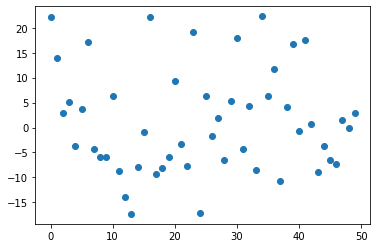

2.8856668
Traced<ConcreteArray(2.8856668)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8856668, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


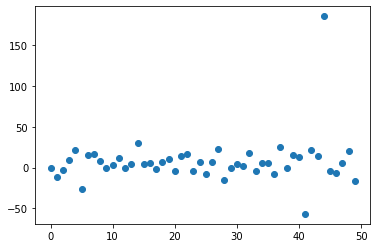

2.759124
Traced<ConcreteArray(2.759124)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.759124, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


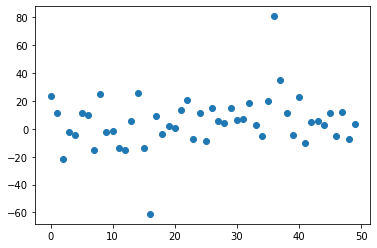

2.9755926
Traced<ConcreteArray(2.9755926)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9755926, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


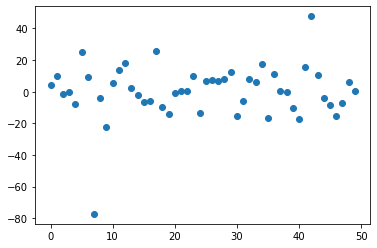

2.421832
Traced<ConcreteArray(2.421832)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.421832, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


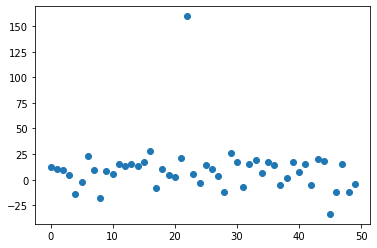

2.1264284
Traced<ConcreteArray(2.1264284)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1264284, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


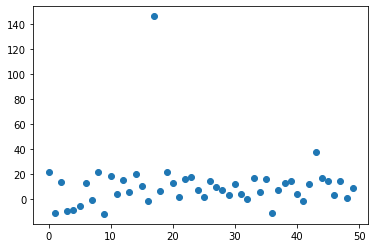

3.1565878
Traced<ConcreteArray(3.1565878)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1565878, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


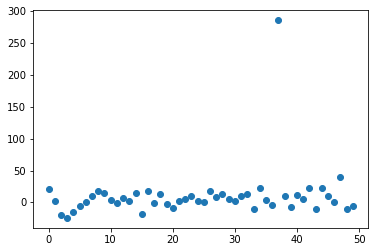

3.08987
Traced<ConcreteArray(3.08987)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.08987, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


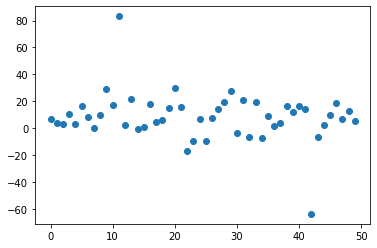

2.7918448
Traced<ConcreteArray(2.7918448)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7918448, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


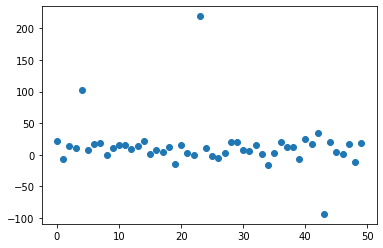

2.4758441
Traced<ConcreteArray(2.4758441)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4758441, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


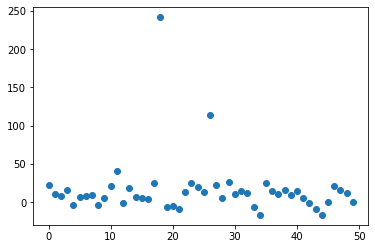

2.8224647
Traced<ConcreteArray(2.8224647)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8224647, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


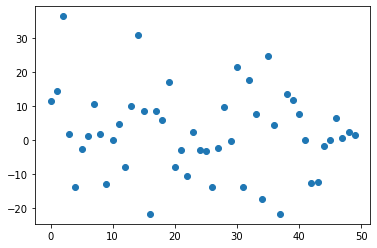

2.9194746
Traced<ConcreteArray(2.9194746)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9194746, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


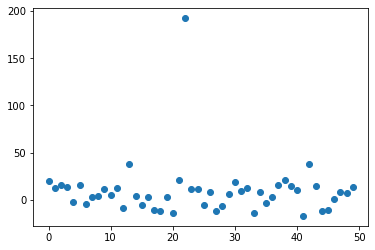

2.3544726
Traced<ConcreteArray(2.3544726)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3544726, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


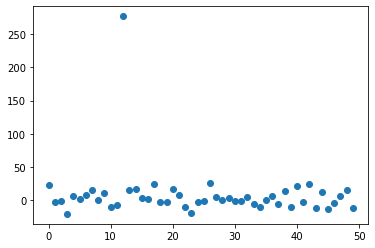

2.5572572
Traced<ConcreteArray(2.5572572)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5572572, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


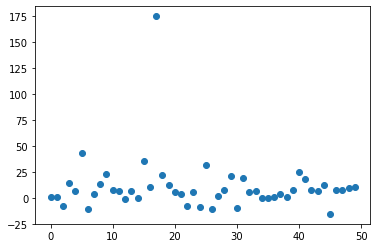

2.5019207
Traced<ConcreteArray(2.5019207)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5019207, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


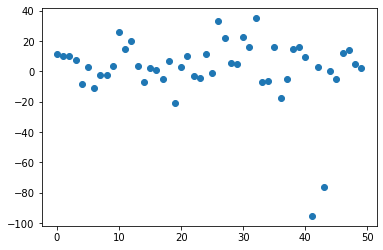

3.080254
Traced<ConcreteArray(3.080254)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.080254, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


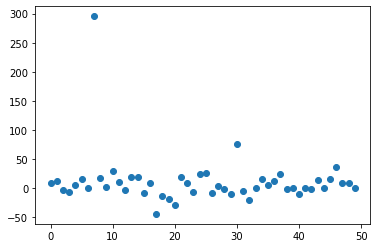

3.0661347
Traced<ConcreteArray(3.0661347)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0661347, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


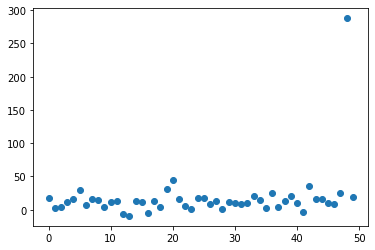

2.811778
Traced<ConcreteArray(2.811778)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.811778, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


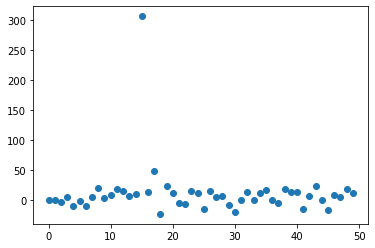

2.2584453
Traced<ConcreteArray(2.2584453)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2584453, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


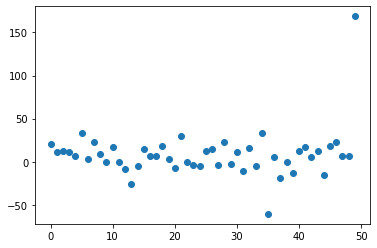

2.5854535
Traced<ConcreteArray(2.5854535)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5854535, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


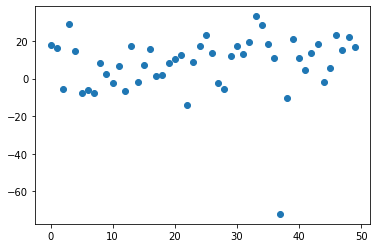

4.105359
Traced<ConcreteArray(4.105359)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.105359, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


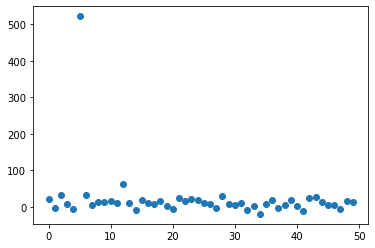

3.0826385
Traced<ConcreteArray(3.0826385)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0826385, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


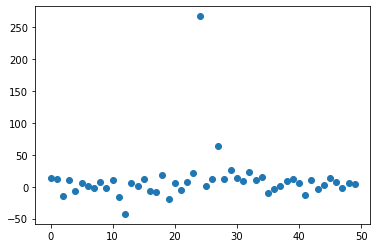

3.7467055
Traced<ConcreteArray(3.7467055)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.7467055, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


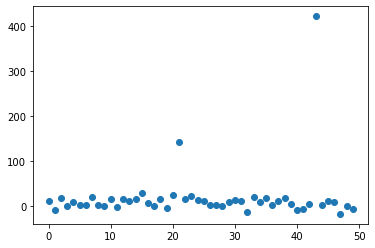

2.5463483
Traced<ConcreteArray(2.5463483)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5463483, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


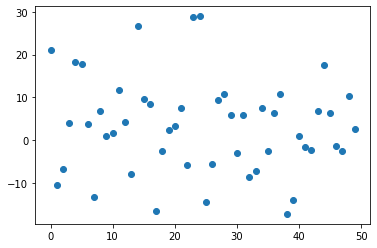

4.2886887
Traced<ConcreteArray(4.2886887)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.2886887, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


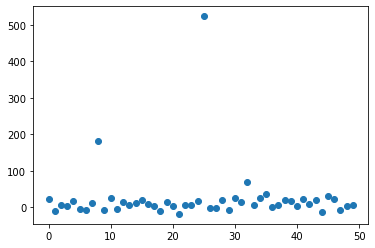

3.911797
Traced<ConcreteArray(3.911797)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.911797, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


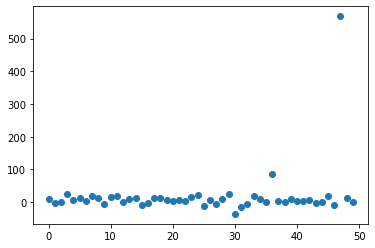

2.2959137
Traced<ConcreteArray(2.2959137)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2959137, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


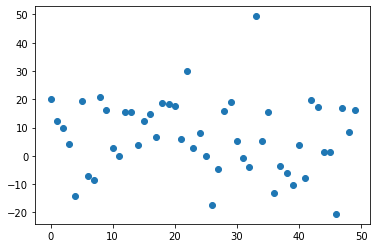

3.0512972
Traced<ConcreteArray(3.0512972)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0512972, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


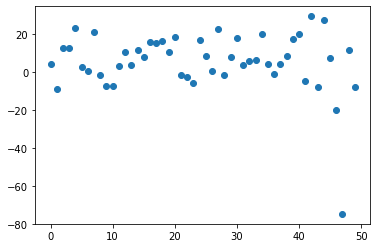

2.3350651
Traced<ConcreteArray(2.3350651)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3350651, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


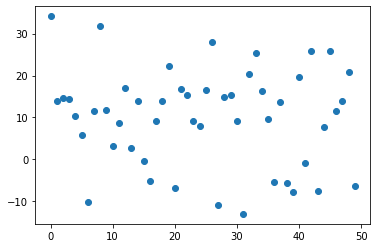

2.5575411
Traced<ConcreteArray(2.5575411)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5575411, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


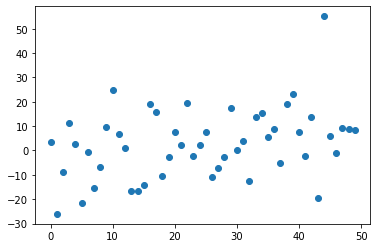

2.5131867
Traced<ConcreteArray(2.5131867)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5131867, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


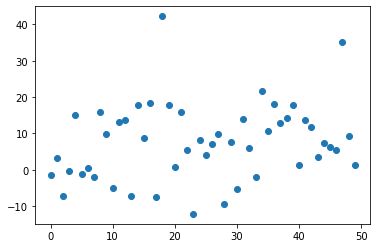

2.8795435
Traced<ConcreteArray(2.8795435)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8795435, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


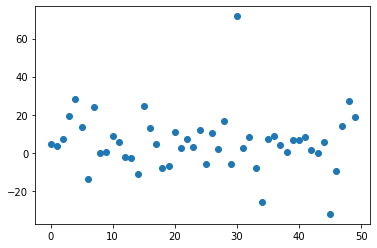

2.453205
Traced<ConcreteArray(2.453205)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.453205, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


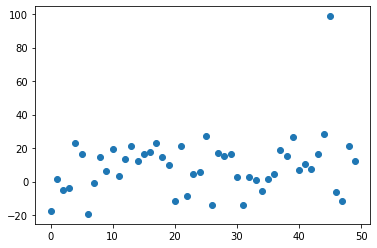

2.8834763
Traced<ConcreteArray(2.8834763)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8834763, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


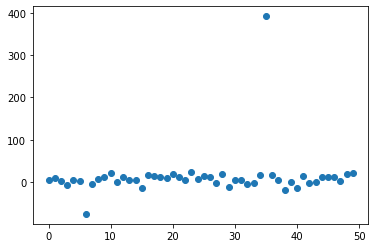

2.838406
Traced<ConcreteArray(2.838406)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.838406, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


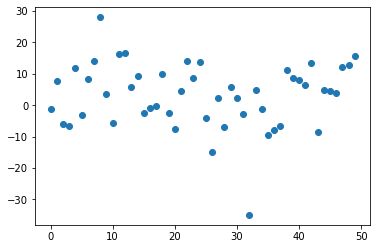

3.165477
Traced<ConcreteArray(3.165477)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.165477, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


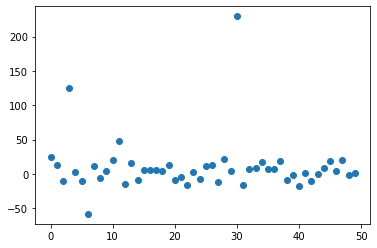

2.5150135
Traced<ConcreteArray(2.5150135)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5150135, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


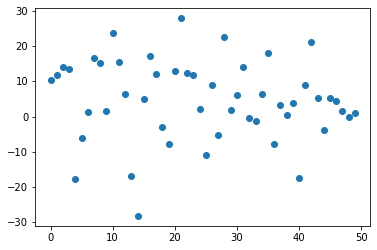

3.203341
Traced<ConcreteArray(3.203341)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.203341, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4159675
Traced<ConcreteArray(2.4159675)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4159675, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.6986096
Traced<ConcreteArray(3.6986096)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6986096, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.2062633
Traced<ConcreteArray(2.2062633)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2062633, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.8078988
Traced<ConcreteArray(3.8078988)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8078988, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


4.515965
Traced<ConcreteArray(4.515965)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.515965, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


4.3090205
Traced<ConcreteArray(4.3090205)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.3090205, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.3532696
Traced<ConcreteArray(3.3532696)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3532696, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7213705
Traced<ConcreteArray(2.7213705)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7213705, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7360623
Traced<ConcreteArray(2.7360623)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7360623, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.111105
Traced<ConcreteArray(2.111105)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.111105, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.598668
Traced<ConcreteArray(3.598668)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.598668, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.0179734
Traced<ConcreteArray(3.0179734)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0179734, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5566254
Traced<ConcreteArray(2.5566254)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5566254, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7491052
Traced<ConcreteArray(2.7491052)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7491052, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.9069436
Traced<ConcreteArray(2.9069436)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9069436, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8041148
Traced<ConcreteArray(2.8041148)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8041148, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4772704
Traced<ConcreteArray(2.4772704)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4772704, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4610007
Traced<ConcreteArray(2.4610007)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4610007, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.1829853
Traced<ConcreteArray(2.1829853)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1829853, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.6269467
Traced<ConcreteArray(3.6269467)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6269467, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.9049025
Traced<ConcreteArray(2.9049025)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9049025, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.702984
Traced<ConcreteArray(2.702984)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.702984, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5113256
Traced<ConcreteArray(2.5113256)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5113256, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.83283
Traced<ConcreteArray(2.83283)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.83283, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4602184
Traced<ConcreteArray(2.4602184)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4602184, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4996984
Traced<ConcreteArray(2.4996984)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4996984, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.3456373
Traced<ConcreteArray(3.3456373)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3456373, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.2479784
Traced<ConcreteArray(3.2479784)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2479784, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5179305
Traced<ConcreteArray(2.5179305)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5179305, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4074435
Traced<ConcreteArray(2.4074435)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4074435, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.3663924
Traced<ConcreteArray(3.3663924)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3663924, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.5074794
Traced<ConcreteArray(3.5074794)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5074794, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.53433
Traced<ConcreteArray(2.53433)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.53433, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7518353
Traced<ConcreteArray(2.7518353)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7518353, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.3005028
Traced<ConcreteArray(3.3005028)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3005028, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.3617468
Traced<ConcreteArray(3.3617468)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3617468, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.809926
Traced<ConcreteArray(3.809926)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.809926, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4347768
Traced<ConcreteArray(2.4347768)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4347768, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7883503
Traced<ConcreteArray(2.7883503)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7883503, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4853315
Traced<ConcreteArray(2.4853315)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4853315, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.0486257
Traced<ConcreteArray(3.0486257)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0486257, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5579982
Traced<ConcreteArray(2.5579982)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5579982, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6067824
Traced<ConcreteArray(2.6067824)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6067824, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.2969842
Traced<ConcreteArray(2.2969842)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2969842, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4417746
Traced<ConcreteArray(2.4417746)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4417746, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5353367
Traced<ConcreteArray(2.5353367)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5353367, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.257885
Traced<ConcreteArray(2.257885)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.257885, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6018152
Traced<ConcreteArray(2.6018152)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6018152, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6472056
Traced<ConcreteArray(2.6472056)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6472056, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4325092
Traced<ConcreteArray(2.4325092)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4325092, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.206522
Traced<ConcreteArray(3.206522)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.206522, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.368961
Traced<ConcreteArray(2.368961)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.368961, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5540142
Traced<ConcreteArray(2.5540142)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5540142, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.7403357
Traced<ConcreteArray(3.7403357)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.7403357, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5628822
Traced<ConcreteArray(2.5628822)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5628822, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.1260746
Traced<ConcreteArray(3.1260746)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1260746, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.452227
Traced<ConcreteArray(2.452227)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.452227, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.326589
Traced<ConcreteArray(2.326589)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.326589, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5035105
Traced<ConcreteArray(2.5035105)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5035105, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5287344
Traced<ConcreteArray(2.5287344)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5287344, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.06855
Traced<ConcreteArray(3.06855)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.06855, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3770814
Traced<ConcreteArray(2.3770814)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3770814, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5684218
Traced<ConcreteArray(2.5684218)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5684218, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.7731404
Traced<ConcreteArray(3.7731404)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.7731404, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.375813
Traced<ConcreteArray(2.375813)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.375813, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.718354
Traced<ConcreteArray(3.718354)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.718354, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4677598
Traced<ConcreteArray(2.4677598)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4677598, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.2096012
Traced<ConcreteArray(3.2096012)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2096012, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.1083782
Traced<ConcreteArray(3.1083782)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1083782, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5742736
Traced<ConcreteArray(2.5742736)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5742736, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5942435
Traced<ConcreteArray(2.5942435)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5942435, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7711504
Traced<ConcreteArray(2.7711504)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7711504, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5188842
Traced<ConcreteArray(2.5188842)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5188842, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5447598
Traced<ConcreteArray(2.5447598)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5447598, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.838097
Traced<ConcreteArray(2.838097)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.838097, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.6771455
Traced<ConcreteArray(3.6771455)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6771455, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4173958
Traced<ConcreteArray(2.4173958)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4173958, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.0404673
Traced<ConcreteArray(2.0404673)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.0404673, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.9281893
Traced<ConcreteArray(2.9281893)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9281893, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7223182
Traced<ConcreteArray(2.7223182)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7223182, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.995376
Traced<ConcreteArray(2.995376)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.995376, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.0797982
Traced<ConcreteArray(3.0797982)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0797982, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.924563
Traced<ConcreteArray(2.924563)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.924563, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5401967
Traced<ConcreteArray(2.5401967)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5401967, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.253198
Traced<ConcreteArray(3.253198)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.253198, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.008787
Traced<ConcreteArray(2.008787)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.008787, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7406998
Traced<ConcreteArray(2.7406998)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7406998, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.9551306
Traced<ConcreteArray(3.9551306)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9551306, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5433602
Traced<ConcreteArray(2.5433602)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5433602, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6576254
Traced<ConcreteArray(2.6576254)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6576254, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.65697
Traced<ConcreteArray(2.65697)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.65697, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.8512394
Traced<ConcreteArray(3.8512394)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8512394, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4606712
Traced<ConcreteArray(2.4606712)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4606712, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.1723008
Traced<ConcreteArray(2.1723008)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1723008, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.3667376
Traced<ConcreteArray(3.3667376)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3667376, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.6731288
Traced<ConcreteArray(3.6731288)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6731288, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


4.0916567
Traced<ConcreteArray(4.0916567)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.0916567, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3372946
Traced<ConcreteArray(2.3372946)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3372946, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


4.026826
Traced<ConcreteArray(4.026826)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.026826, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.1628556
Traced<ConcreteArray(2.1628556)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1628556, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8700924
Traced<ConcreteArray(2.8700924)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8700924, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.6747751
Traced<ConcreteArray(3.6747751)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6747751, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.0095456
Traced<ConcreteArray(3.0095456)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0095456, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5246413
Traced<ConcreteArray(2.5246413)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5246413, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.0603924
Traced<ConcreteArray(3.0603924)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0603924, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4510038
Traced<ConcreteArray(2.4510038)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4510038, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.388914
Traced<ConcreteArray(2.388914)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.388914, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7389371
Traced<ConcreteArray(2.7389371)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7389371, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5886602
Traced<ConcreteArray(2.5886602)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5886602, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3663101
Traced<ConcreteArray(2.3663101)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3663101, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8962083
Traced<ConcreteArray(2.8962083)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8962083, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


4.87054
Traced<ConcreteArray(4.87054)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.87054, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.787243
Traced<ConcreteArray(2.787243)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.787243, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.1221416
Traced<ConcreteArray(2.1221416)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1221416, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.747144
Traced<ConcreteArray(2.747144)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.747144, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8815634
Traced<ConcreteArray(2.8815634)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8815634, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8857179
Traced<ConcreteArray(2.8857179)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8857179, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6364915
Traced<ConcreteArray(2.6364915)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6364915, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.4205136
Traced<ConcreteArray(3.4205136)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4205136, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6736095
Traced<ConcreteArray(2.6736095)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6736095, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5319798
Traced<ConcreteArray(2.5319798)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5319798, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8001044
Traced<ConcreteArray(2.8001044)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8001044, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6185763
Traced<ConcreteArray(2.6185763)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6185763, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.347145
Traced<ConcreteArray(2.347145)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.347145, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4909
Traced<ConcreteArray(2.4909)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4909, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4950943
Traced<ConcreteArray(2.4950943)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4950943, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.0774422
Traced<ConcreteArray(3.0774422)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0774422, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.783112
Traced<ConcreteArray(2.783112)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.783112, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6485968
Traced<ConcreteArray(2.6485968)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6485968, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.390319
Traced<ConcreteArray(2.390319)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.390319, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.1888678
Traced<ConcreteArray(2.1888678)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1888678, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.726976
Traced<ConcreteArray(2.726976)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.726976, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.0462685
Traced<ConcreteArray(3.0462685)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0462685, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


5.0613413
Traced<ConcreteArray(5.0613413)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.0613413, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4400723
Traced<ConcreteArray(2.4400723)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4400723, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4240742
Traced<ConcreteArray(2.4240742)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4240742, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.015863
Traced<ConcreteArray(3.015863)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.015863, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.5500488
Traced<ConcreteArray(3.5500488)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5500488, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.635405
Traced<ConcreteArray(2.635405)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.635405, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.353785
Traced<ConcreteArray(2.353785)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.353785, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.623825
Traced<ConcreteArray(2.623825)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.623825, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7880871
Traced<ConcreteArray(2.7880871)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7880871, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.6320493
Traced<ConcreteArray(3.6320493)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6320493, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8803976
Traced<ConcreteArray(2.8803976)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8803976, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.5228481
Traced<ConcreteArray(3.5228481)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5228481, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5898037
Traced<ConcreteArray(2.5898037)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5898037, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3717227
Traced<ConcreteArray(2.3717227)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3717227, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5614028
Traced<ConcreteArray(2.5614028)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5614028, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7754102
Traced<ConcreteArray(2.7754102)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7754102, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5064764
Traced<ConcreteArray(2.5064764)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5064764, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3123178
Traced<ConcreteArray(2.3123178)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3123178, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6411839
Traced<ConcreteArray(2.6411839)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6411839, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7050686
Traced<ConcreteArray(2.7050686)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7050686, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4592733
Traced<ConcreteArray(2.4592733)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4592733, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6696432
Traced<ConcreteArray(2.6696432)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6696432, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.427533
Traced<ConcreteArray(3.427533)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.427533, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4951124
Traced<ConcreteArray(2.4951124)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4951124, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4341383
Traced<ConcreteArray(2.4341383)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4341383, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.9638557
Traced<ConcreteArray(2.9638557)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9638557, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.1978784
Traced<ConcreteArray(2.1978784)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1978784, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.012093
Traced<ConcreteArray(3.012093)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.012093, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5447829
Traced<ConcreteArray(2.5447829)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5447829, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.9864073
Traced<ConcreteArray(3.9864073)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9864073, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4618824
Traced<ConcreteArray(2.4618824)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4618824, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5560188
Traced<ConcreteArray(2.5560188)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5560188, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.9305549
Traced<ConcreteArray(3.9305549)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9305549, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5220764
Traced<ConcreteArray(2.5220764)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5220764, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5197744
Traced<ConcreteArray(2.5197744)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5197744, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.677155
Traced<ConcreteArray(2.677155)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.677155, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.1223676
Traced<ConcreteArray(2.1223676)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1223676, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.0574734
Traced<ConcreteArray(3.0574734)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0574734, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.289719
Traced<ConcreteArray(2.289719)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.289719, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8450115
Traced<ConcreteArray(2.8450115)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8450115, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


4.235564
Traced<ConcreteArray(4.235564)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.235564, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.2762492
Traced<ConcreteArray(2.2762492)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2762492, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.1066532
Traced<ConcreteArray(3.1066532)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1066532, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.9135716
Traced<ConcreteArray(3.9135716)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.9135716, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.2390168
Traced<ConcreteArray(2.2390168)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2390168, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3216593
Traced<ConcreteArray(2.3216593)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3216593, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.5126643
Traced<ConcreteArray(3.5126643)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5126643, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6335883
Traced<ConcreteArray(2.6335883)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6335883, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.1908917
Traced<ConcreteArray(2.1908917)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1908917, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4784336
Traced<ConcreteArray(2.4784336)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4784336, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.2455716
Traced<ConcreteArray(3.2455716)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2455716, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4855542
Traced<ConcreteArray(2.4855542)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4855542, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


5.0140095
Traced<ConcreteArray(5.0140095)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.0140095, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8952372
Traced<ConcreteArray(2.8952372)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8952372, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7558618
Traced<ConcreteArray(2.7558618)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7558618, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8467138
Traced<ConcreteArray(2.8467138)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8467138, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3578262
Traced<ConcreteArray(2.3578262)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3578262, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7488403
Traced<ConcreteArray(2.7488403)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7488403, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.6610684
Traced<ConcreteArray(3.6610684)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6610684, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.2344062
Traced<ConcreteArray(3.2344062)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2344062, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4108937
Traced<ConcreteArray(2.4108937)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4108937, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.0098174
Traced<ConcreteArray(3.0098174)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0098174, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7232559
Traced<ConcreteArray(2.7232559)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7232559, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.525772
Traced<ConcreteArray(2.525772)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.525772, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.190549
Traced<ConcreteArray(2.190549)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.190549, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.2793026
Traced<ConcreteArray(3.2793026)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2793026, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5319645
Traced<ConcreteArray(2.5319645)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5319645, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.9594808
Traced<ConcreteArray(2.9594808)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9594808, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6733186
Traced<ConcreteArray(2.6733186)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6733186, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.6933515
Traced<ConcreteArray(3.6933515)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.6933515, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.455307
Traced<ConcreteArray(2.455307)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.455307, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


1.9814261
Traced<ConcreteArray(1.9814261)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1.9814261, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.2128742
Traced<ConcreteArray(3.2128742)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2128742, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.5510955
Traced<ConcreteArray(3.5510955)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5510955, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3965619
Traced<ConcreteArray(2.3965619)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3965619, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.1630445
Traced<ConcreteArray(3.1630445)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1630445, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3252249
Traced<ConcreteArray(2.3252249)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3252249, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.2947755
Traced<ConcreteArray(2.2947755)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2947755, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.45055
Traced<ConcreteArray(3.45055)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.45055, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.8359163
Traced<ConcreteArray(3.8359163)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8359163, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3940315
Traced<ConcreteArray(2.3940315)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3940315, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.122693
Traced<ConcreteArray(3.122693)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.122693, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.9054422
Traced<ConcreteArray(2.9054422)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9054422, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.0975695
Traced<ConcreteArray(2.0975695)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.0975695, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.369716
Traced<ConcreteArray(2.369716)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.369716, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


4.115984
Traced<ConcreteArray(4.115984)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.115984, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.0180657
Traced<ConcreteArray(3.0180657)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0180657, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5815253
Traced<ConcreteArray(2.5815253)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5815253, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.0075183
Traced<ConcreteArray(3.0075183)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0075183, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.2796574
Traced<ConcreteArray(3.2796574)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2796574, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6797905
Traced<ConcreteArray(2.6797905)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6797905, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6340883
Traced<ConcreteArray(2.6340883)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6340883, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


5.211522
Traced<ConcreteArray(5.211522)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(5.211522, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.4828668
Traced<ConcreteArray(3.4828668)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4828668, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6187515
Traced<ConcreteArray(2.6187515)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6187515, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7916937
Traced<ConcreteArray(2.7916937)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7916937, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4852114
Traced<ConcreteArray(2.4852114)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4852114, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.1172051
Traced<ConcreteArray(3.1172051)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1172051, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4527395
Traced<ConcreteArray(2.4527395)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4527395, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.1384573
Traced<ConcreteArray(2.1384573)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1384573, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.746705
Traced<ConcreteArray(2.746705)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.746705, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.2579918
Traced<ConcreteArray(2.2579918)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2579918, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4199104
Traced<ConcreteArray(2.4199104)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4199104, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3312871
Traced<ConcreteArray(2.3312871)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3312871, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.124837
Traced<ConcreteArray(2.124837)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.124837, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.5121431
Traced<ConcreteArray(3.5121431)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5121431, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.1550076
Traced<ConcreteArray(2.1550076)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1550076, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.802341
Traced<ConcreteArray(2.802341)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.802341, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.9195423
Traced<ConcreteArray(2.9195423)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9195423, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5726964
Traced<ConcreteArray(2.5726964)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5726964, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.171715
Traced<ConcreteArray(2.171715)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.171715, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.3203003
Traced<ConcreteArray(3.3203003)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.3203003, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.9616518
Traced<ConcreteArray(2.9616518)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.9616518, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4998796
Traced<ConcreteArray(2.4998796)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4998796, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4501595
Traced<ConcreteArray(2.4501595)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4501595, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3097253
Traced<ConcreteArray(2.3097253)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3097253, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.70715
Traced<ConcreteArray(3.70715)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.70715, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.5199127
Traced<ConcreteArray(3.5199127)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.5199127, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6244752
Traced<ConcreteArray(2.6244752)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6244752, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.55518
Traced<ConcreteArray(2.55518)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.55518, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4882221
Traced<ConcreteArray(2.4882221)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4882221, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3882394
Traced<ConcreteArray(2.3882394)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3882394, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.783669
Traced<ConcreteArray(2.783669)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.783669, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.716791
Traced<ConcreteArray(2.716791)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.716791, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.333669
Traced<ConcreteArray(2.333669)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.333669, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


4.209266
Traced<ConcreteArray(4.209266)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.209266, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5067132
Traced<ConcreteArray(2.5067132)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5067132, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7411113
Traced<ConcreteArray(2.7411113)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7411113, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6450446
Traced<ConcreteArray(2.6450446)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6450446, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


4.017286
Traced<ConcreteArray(4.017286)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.017286, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.1833713
Traced<ConcreteArray(3.1833713)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.1833713, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.295897
Traced<ConcreteArray(2.295897)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.295897, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4814973
Traced<ConcreteArray(2.4814973)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4814973, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.2193656
Traced<ConcreteArray(3.2193656)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.2193656, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.774519
Traced<ConcreteArray(2.774519)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.774519, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4973693
Traced<ConcreteArray(2.4973693)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4973693, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.1449854
Traced<ConcreteArray(2.1449854)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1449854, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.468072
Traced<ConcreteArray(2.468072)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.468072, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5072956
Traced<ConcreteArray(2.5072956)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5072956, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7668655
Traced<ConcreteArray(2.7668655)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7668655, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5804353
Traced<ConcreteArray(2.5804353)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5804353, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3978786
Traced<ConcreteArray(2.3978786)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3978786, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3153107
Traced<ConcreteArray(2.3153107)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3153107, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8423486
Traced<ConcreteArray(2.8423486)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8423486, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5479586
Traced<ConcreteArray(2.5479586)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5479586, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5518785
Traced<ConcreteArray(2.5518785)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5518785, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.4864368
Traced<ConcreteArray(3.4864368)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.4864368, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8421724
Traced<ConcreteArray(2.8421724)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8421724, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7499475
Traced<ConcreteArray(2.7499475)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7499475, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8347232
Traced<ConcreteArray(2.8347232)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8347232, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3054476
Traced<ConcreteArray(2.3054476)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3054476, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.8962088
Traced<ConcreteArray(3.8962088)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.8962088, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7888896
Traced<ConcreteArray(2.7888896)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7888896, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.5105488
Traced<ConcreteArray(2.5105488)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.5105488, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.261107
Traced<ConcreteArray(2.261107)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.261107, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7459717
Traced<ConcreteArray(2.7459717)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7459717, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7556534
Traced<ConcreteArray(2.7556534)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7556534, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7659295
Traced<ConcreteArray(2.7659295)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7659295, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7721589
Traced<ConcreteArray(2.7721589)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7721589, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.4456756
Traced<ConcreteArray(2.4456756)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.4456756, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8578498
Traced<ConcreteArray(2.8578498)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8578498, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6392875
Traced<ConcreteArray(2.6392875)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6392875, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.0349
Traced<ConcreteArray(3.0349)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0349, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.004616
Traced<ConcreteArray(2.004616)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.004616, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.1703486
Traced<ConcreteArray(2.1703486)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.1703486, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


1.9850278
Traced<ConcreteArray(1.9850278)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(1.9850278, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6680794
Traced<ConcreteArray(2.6680794)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6680794, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.0220487
Traced<ConcreteArray(3.0220487)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0220487, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.062924
Traced<ConcreteArray(2.062924)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.062924, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3934774
Traced<ConcreteArray(2.3934774)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3934774, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8295586
Traced<ConcreteArray(2.8295586)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8295586, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


4.3340507
Traced<ConcreteArray(4.3340507)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(4.3340507, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.2438116
Traced<ConcreteArray(2.2438116)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2438116, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


3.0416124
Traced<ConcreteArray(3.0416124)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(3.0416124, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.2217321
Traced<ConcreteArray(2.2217321)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.2217321, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7112567
Traced<ConcreteArray(2.7112567)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7112567, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.0872946
Traced<ConcreteArray(2.0872946)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.0872946, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.6503525
Traced<ConcreteArray(2.6503525)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.6503525, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8127673
Traced<ConcreteArray(2.8127673)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8127673, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.8459814
Traced<ConcreteArray(2.8459814)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.8459814, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.59631
Traced<ConcreteArray(2.59631)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.59631, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.3442936
Traced<ConcreteArray(2.3442936)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.3442936, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


2.7396777
Traced<ConcreteArray(2.7396777)>with<JVPTrace(level=2/0)>
  with primal = DeviceArray(2.7396777, dtype=float32)
       tangent = Traced<ShapedArray(float32[]):JaxprTrace(level=1/0)>


In [28]:
#Run 4
opt_init, opt_update, get_params = optimizers.adam(step_size=1e-5)
new4_params,data_generator4=NN(batch_size,num_epochs,n,new3_params,1.2)

In [77]:
#Once you have loaded, you can run this cell to test the learning parameters. Note, 8254 represents the value of lambda
#for the exponential distribution which draws the imaginary parts of our random inputs. The network here is trained for values upto 10000

#Testing the learned parameters
a1,b1,c1=gen(batch_size,n,8254)
xs=net_apply(new4_params,b1)
ys=net_apply(new4_params, a1)
y=percentageloss(ys,xs)
x=np.arange(len(y))
plt.scatter(x, y)
plt.xlabel('points')
plt.ylabel('percentage difference')
plt.show()
#Most of the points lie within 20%. Obviously this can be improved, but we see that the NN is learning the correct features

In [13]:
import pickle
pickle.dump( new4_params , open( 'weights.pkl' , 'wb' ) )




NameError: name 'new4_params' is not defined

In [76]:
import pickle
new4_params = pickle.load( open( 'weights.pkl' , 'rb' ))